## Load dataset and tree info

In [ ]:
from sklearn.datasets import load_iris
import pandas as pd
from sklearn.preprocessing import StandardScaler
import numpy as np
from tensorflow.keras.layers import Dense, Input, concatenate, GRU, LSTM
from tensorflow.keras import backend as K
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import Model
from nltk.translate.bleu_score import sentence_bleu
from sklearn.datasets import make_classification

In [ ]:
np.random.seed(123)
x, y = make_classification(n_features=5, n_samples=500)

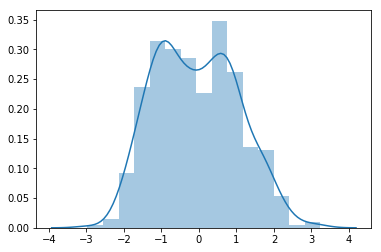

In [3]:
import seaborn as sns
%matplotlib inline
sns.distplot(x[:,0])

In [ ]:
synth_data = pd.DataFrame(x)
synth_data['target'] = y

In [33]:
synth_data.to_csv('synth_data.csv')

In [20]:
X_new

array([[-0.09071608, -0.05089942,  0.01104771, ..., -0.00930665,
         0.03840536,  0.00725152],
       [-0.05299949, -0.04364846,  0.01806382, ...,  0.01664761,
        -0.03014081, -0.01613207],
       [ 0.08598133,  0.03103344, -0.03801946, ..., -0.04601689,
         0.00824365,  0.0474764 ],
       ...,
       [ 0.06435473, -0.01703232, -0.00553911, ..., -0.03064393,
         0.01089513, -0.01650587],
       [ 0.06027869, -0.07690764, -0.08767211, ...,  0.09140463,
         0.00117877,  0.05327967],
       [ 0.02906169, -0.01965581, -0.07290819, ..., -0.03522004,
         0.01093855, -0.07641042]])

In [2]:
iris = load_iris()
X = iris['data']
y = iris['target']
scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)
## Scale at R level as well

In [10]:
scaler

StandardScaler(copy=True, with_mean=True, with_std=True)

In [8]:
synth_data.head()

,0,1,2,3,4,target
0,-0.871556,0.393837,0.345770,-1.393998,-0.605347,0
1,-1.268438,0.608599,-0.860427,-0.603976,-1.276196,0
2,-1.285581,0.589113,-1.135688,-1.726854,-0.984263,0
3,-0.115174,0.092246,1.066542,1.432904,-0.528526,1
4,0.876101,-0.462798,0.067267,-1.290150,1.355006,0


In [5]:
# df = pd.DataFrame(X)
df = synth_data

In [6]:
# bin_labels = pd.read_csv('../../data/raw/local_dt/local_iris_bin_labels.csv', delimiter=",")
# bin_labels = pd.read_csv('../../scripts/dert/test_iris_bin_labels_aug.csv', delimiter=",")
# bin_labels = pd.read_csv('../../scripts/dert/global_iris_bin_labels.csv', delimiter=",")
bin_labels = pd.read_csv('../../scripts/dert/local_synth_bins.csv', delimiter=",")

In [7]:
bin_labels.head()

,Unnamed: 0,values.global_bins.
0,A,-0.090835
1,AB,-0.823677
2,ABC,-0.239583
3,ABD,-0.224862
4,ABE,-0.360687


In [8]:
# bin_labels = bin_labels.rename(columns={"Unnamed: 0": "label", "label_list": "bins"})
bin_labels = bin_labels.rename(columns={"Unnamed: 0": "label", "values.global_bins.": "bins"})

In [9]:
bin_labels

,label,bins
0,A,-0.090835
1,AB,-0.823677
2,ABC,-0.239583
3,ABD,-0.224862
4,ABE,-0.360687
5,ABF,-1.395614
6,ABG,-0.211865
7,ABH,-0.238372
8,ABI,-0.701917
9,ABJ,0.604873


In [10]:
bin_labels

,label,bins
0,A,-0.090835
1,AB,-0.823677
2,ABC,-0.239583
3,ABD,-0.224862
4,ABE,-0.360687
5,ABF,-1.395614
6,ABG,-0.211865
7,ABH,-0.238372
8,ABI,-0.701917
9,ABJ,0.604873


In [11]:
# # path_df = pd.read_csv('../../data/raw/rpart_paths.csv', delimiter=",")
# # path_df = pd.read_csv('../../data/raw/test_paths.csv', delimiter=",")
# path_df = pd.read_csv('../../data/raw/local_dt/local_iris_paths.csv', delimiter=",")
# # path_df = pd.read_csv('../../scripts/dert/test_iris_paths_aug.csv', delimiter=",")
# # path_df = pd.read_csv('../../scripts/dert/global_iris_paths.csv', delimiter=",")
path_df = pd.read_csv('../../scripts/dert/local_synth_path.csv', delimiter=",")

In [12]:
# path_df = path_df.drop(["NA"], axis=1)
path_df = path_df.drop(["Unnamed: 0"], axis=1)
path_df = path_df.rename(columns={list(path_df)[0]: "new_col"})

In [13]:
# test_data = pd.concat([df, pd.DataFrame({'target':y}),path_df], axis=1)
test_data = pd.concat([df, path_df], axis=1)
# test_data = pd.concat([df, pd.DataFrame({'target':y})], axis=1)
# test_data = df

In [24]:
test_data

,0,1,2,3,4,target,new_col
0,-0.871556,0.393837,0.345770,-1.393998,-0.605347,0,"4A0,2B0"
1,-1.268438,0.608599,-0.860427,-0.603976,-1.276196,0,"4C0,4D1"
2,-1.285581,0.589113,-1.135688,-1.726854,-0.984263,0,4E0
3,-0.115174,0.092246,1.066542,1.432904,-0.528526,1,4F1
4,0.876101,-0.462798,0.067267,-1.290150,1.355006,0,"4G0,3H1"
5,0.955445,-0.407903,0.180957,2.487209,0.397611,1,"4I1,4J1"
6,1.675425,-0.846639,-1.543444,-0.922580,2.162834,0,4K0
7,-1.188705,0.578207,-0.181427,-0.249662,-1.283719,1,4L1
8,-2.101986,1.052618,-2.092102,0.772353,-2.606672,0,"4M0,4N1"
9,-0.254236,0.164874,2.555894,1.604298,-0.734342,1,4O1


In [19]:
path_df

,new_col
0,"4A0,2B0"
1,"4C0,4D1"
2,4E0
3,4F1
4,"4G0,3H1"
5,"4I1,4J1"
6,4K0
7,4L1
8,"4M0,4N1"
9,4O1


In [13]:
path_df

,new_col
0,3D0
1,3O0
2,3O0
3,3AK0
4,3AK0
5,3AU0
6,3D0
7,3AK0
8,3O0
9,3D0


In [10]:
test_data

,0,1,2,3,target,new_col
0,-0.900681,1.019004,-1.340227,-1.315444,0,3D0
1,-1.143017,-0.131979,-1.340227,-1.315444,0,3O0
2,-1.385353,0.328414,-1.397064,-1.315444,0,3O0
3,-1.506521,0.098217,-1.283389,-1.315444,0,3AK0
4,-1.021849,1.249201,-1.340227,-1.315444,0,3AK0
5,-0.537178,1.939791,-1.169714,-1.052180,0,3AU0
6,-1.506521,0.788808,-1.340227,-1.183812,0,3D0
7,-1.021849,0.788808,-1.283389,-1.315444,0,3AK0
8,-1.748856,-0.362176,-1.340227,-1.315444,0,3O0
9,-1.143017,0.098217,-1.283389,-1.447076,0,3D0


In [18]:
test_data

,0,1,2,3,target
0,-0.900681,1.019004,-1.340227,-1.315444,0
1,-1.143017,-0.131979,-1.340227,-1.315444,0
2,-1.385353,0.328414,-1.397064,-1.315444,0
3,-1.506521,0.098217,-1.283389,-1.315444,0
4,-1.021849,1.249201,-1.340227,-1.315444,0
5,-0.537178,1.939791,-1.169714,-1.052180,0
6,-1.506521,0.788808,-1.340227,-1.183812,0
7,-1.021849,0.788808,-1.283389,-1.315444,0
8,-1.748856,-0.362176,-1.340227,-1.315444,0
9,-1.143017,0.098217,-1.283389,-1.447076,0


### Transform path df

In [14]:
new_path = []
for i, val in test_data.iterrows():
    new_path.append(val['new_col'].split(sep=","))

In [15]:
new_path = []
for i, val in path_df.iterrows():
    new_path.append(val['new_col'].split(sep=","))

In [16]:
test_data.head()

,0,1,2,3,target,new_col
0,-0.900681,1.019004,-1.340227,-1.315444,0,3D0
1,-1.143017,-0.131979,-1.340227,-1.315444,0,3O0
2,-1.385353,0.328414,-1.397064,-1.315444,0,3O0
3,-1.506521,0.098217,-1.283389,-1.315444,0,3AK0
4,-1.021849,1.249201,-1.340227,-1.315444,0,3AK0


In [16]:
_ = [x.insert(0, 'S') for x in new_path]
_ = [x.append('E') for x in new_path]

In [17]:
new_path

[['S', '4A0', '2B0', 'E'],
 ['S', '4C0', '4D1', 'E'],
 ['S', '4E0', 'E'],
 ['S', '4F1', 'E'],
 ['S', '4G0', '3H1', 'E'],
 ['S', '4I1', '4J1', 'E'],
 ['S', '4K0', 'E'],
 ['S', '4L1', 'E'],
 ['S', '4M0', '4N1', 'E'],
 ['S', '4O1', 'E'],
 ['S', '4P0', 'E'],
 ['S', '4Q1', 'E'],
 ['S', '4R1', 'E'],
 ['S', '4S0', '5T1', 'E'],
 ['S', '4U1', '3V1', 'E'],
 ['S', '4W0', 'E'],
 ['S', '4X0', 'E'],
 ['S', '4Y1', 'E'],
 ['S', '4Z0', '4AB0', 'E'],
 ['S', '4AC1', '3AD0', 'E'],
 ['S', '4AE1', 'E'],
 ['S', '4AF0', 'E'],
 ['S', '4AG1', '2AH1', 'E'],
 ['S', '4AI1', '1AJ1', 'E'],
 ['S', '4AK1', '1AL1', 'E'],
 ['S', '4W1', 'E'],
 ['S', '4AM0', '4AN0', 'E'],
 ['S', '4AO0', '3AP0', 'E'],
 ['S', '4AQ0', '1AR1', 'E'],
 ['S', '4AS1', 'E'],
 ['S', '4AK0', 'E'],
 ['S', '4AT1', 'E'],
 ['S', '4AU0', '4AV0', 'E'],
 ['S', '4AW1', 'E'],
 ['S', '4AX1', 'E'],
 ['S', '4AY1', 'E'],
 ['S', '4AZ1', 'E'],
 ['S', '4BC1', 'E'],
 ['S', '4BD1', 'E'],
 ['S', '4BE0', 'E'],
 ['S', '4BF0', '1BG1', 'E'],
 ['S', '4BH0', 'E'],
 ['S', '4

In [18]:
# path_df['new_path'] = new_path
test_data['new_path'] = new_path

In [19]:
test_data = test_data.drop(["new_col"], axis=1)

In [20]:
test_data.head()

,0,1,2,3,4,target,new_path
0,-0.871556,0.393837,0.345770,-1.393998,-0.605347,0,"[S, 4A0, 2B0, E]"
1,-1.268438,0.608599,-0.860427,-0.603976,-1.276196,0,"[S, 4C0, 4D1, E]"
2,-1.285581,0.589113,-1.135688,-1.726854,-0.984263,0,"[S, 4E0, E]"
3,-0.115174,0.092246,1.066542,1.432904,-0.528526,1,"[S, 4F1, E]"
4,0.876101,-0.462798,0.067267,-1.290150,1.355006,0,"[S, 4G0, 3H1, E]"


In [22]:
# paths_lengths = np.array([len(xi)
#                           for xi in path_df.iloc[:,-1]])

In [21]:
paths_lengths = np.array([len(xi) for xi in test_data.iloc[:,-1]])

In [22]:
paths_lengths

array([4, 4, 3, 3, 4, 4, 3, 3, 4, 3, 3, 3, 3, 4, 4, 3, 3, 3, 4, 4, 3, 3,
       4, 4, 4, 3, 4, 4, 4, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3,
       3, 5, 3, 3, 3, 4, 4, 4, 3, 4, 3, 3, 3, 4, 3, 3, 4, 3, 4, 3, 4, 3,
       4, 3, 5, 4, 4, 4, 4, 3, 4, 3, 3, 3, 4, 4, 3, 3, 3, 3, 4, 3, 5, 3,
       3, 4, 4, 3, 3, 4, 4, 3, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4,
       4, 4, 4, 3, 4, 4, 3, 3, 4, 3, 4, 3, 4, 3, 4, 4, 4, 5, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 4, 3, 4, 3, 4, 4, 3, 4, 4, 4, 3, 4, 3, 3, 3, 3, 3,
       3, 3, 3, 4, 3, 4, 3, 3, 3, 3, 4, 4, 3, 4, 3, 4, 4, 4, 4, 3, 4, 3,
       3, 3, 3, 4, 4, 4, 3, 3, 4, 3, 3, 3, 4, 4, 3, 3, 5, 3, 3, 3, 3, 4,
       3, 4, 3, 3, 4, 3, 3, 3, 3, 3, 4, 3, 4, 4, 4, 5, 4, 3, 4, 3, 5, 3,
       3, 3, 4, 3, 3, 3, 3, 3, 3, 4, 3, 4, 4, 3, 3, 3, 4, 3, 3, 3, 3, 4,
       3, 3, 3, 4, 3, 4, 3, 4, 3, 3, 3, 3, 4, 3, 3, 4, 3, 3, 3, 4, 3, 4,
       3, 3, 3, 3, 3, 3, 4, 3, 4, 4, 3, 3, 4, 3, 4, 4, 4, 4, 3, 3, 3, 3,
       3, 4, 4, 3, 4, 5, 4, 4, 3, 4, 4, 3, 4, 4, 3,

In [23]:
paths_lengths
np.max(paths_lengths)

5

In [368]:
np.argmax(paths_lengths == 19)

52

### bins and paths checks

In [36]:
pd.__version__

'0.23.4'

In [24]:
feat_freq = pd.DataFrame(data=[1,2,3,4,5], columns=['feature'])

In [48]:
i

0

In [43]:
path_df.shape

(500, 1)

In [50]:
bin_labels.head()

,label,bins,freq
0,A,-0.090835,0
1,AB,-0.823677,0
2,ABC,-0.239583,0
3,ABD,-0.224862,0
4,ABE,-0.360687,0


In [25]:
import re
bin_freq = {}
bin_labels['freq'] = 0
feat_freq['freq'] = 0
feat_list = []
for i, val in path_df.iloc[:500,].iterrows():
    label_list = val['new_col'].split(',')
    for j, val2 in enumerate(label_list):
        temp = re.compile("(\d+)(\w+)(\d+)") 
        res = temp.match(val2).groups()
        bin_labels.loc[bin_labels['label'] == res[1], 'freq'] += 1
#         print(type(res[0]))
        feat_freq.loc[feat_freq['feature'] == int(res[0]), 'freq'] += 1
        feat_list.append(int(res[0]))

TypeError: unsupported operand type(s) for /: 'str' and 'int'

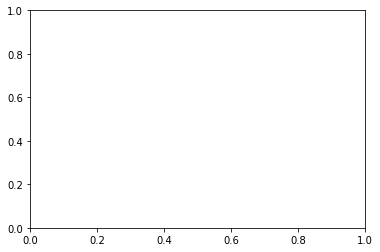

In [67]:
import seaborn as sns
sns.distplot(bin_labels['label'])

Using matplotlib backend: Qt5Agg


([array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 0., 0., 0.

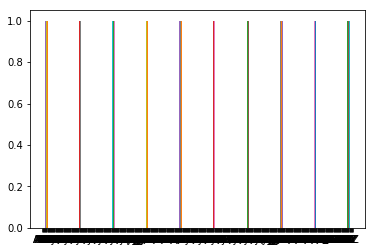

In [66]:
from matplotlib import pyplot as pplot
%matplotlib
pplot.hist(bin_labels['label'])

In [27]:
path_df.head(2)

,new_col
0,3D0
1,3O0


In [373]:
len(test_data.iloc[52,-1])

7

In [35]:
label_char = []
for _, i in enumerate(np.unique(test_data['new_path'])):
    for _, j in enumerate(i):
        if j not in label_char:
            label_char.append(j)

In [36]:
label_indices = { j : i for i, j in enumerate(label_char) }

In [37]:
label_indices

{'S': 0,
 '3AK0': 1,
 'E': 2,
 '3AK1': 3,
 '3H0': 4,
 '4AC0': 5,
 '3I0': 6,
 '1T1': 7,
 '4AV0': 8,
 '4B0': 9,
 '3T0': 10,
 '3AU0': 11,
 '3AU1': 12,
 '3BD0': 13,
 '3BD1': 14,
 '1BG1': 15,
 '3U0': 16,
 '3BJ1': 17,
 '4AI1': 18,
 '4AV1': 19,
 '3CM1': 20,
 '3I1': 21,
 '3D0': 22,
 '3D1': 23,
 '1U1': 24,
 '4N0': 25,
 '2AJ1': 26,
 '4AI0': 27,
 '3BG0': 28,
 '3AY0': 29,
 '1AX1': 30,
 '3H1': 31,
 '3T1': 32,
 '3U1': 33,
 '4AQ1': 34,
 '4N1': 35,
 '4B1': 36,
 '3O1': 37,
 '2AD1': 38,
 '3O0': 39,
 '3BJ0': 40,
 '3CD0': 41,
 '4BS0': 42,
 '2AW0': 43,
 '4AC1': 44,
 '1AF1': 45,
 '2F0': 46,
 '3BQ0': 47,
 '3J0': 48}

In [122]:
### Move to bottom trials

test_data = pd.concat([test_data, path_df.loc[:,'updated_path']], axis=1)
updated_path = []
for i, val in test_data.iterrows():
    updated_path.append(val['updated_path'].split(sep=","))

_ = [x.insert(0, 'S') for x in updated_path]
_ = [x.append('E') for x in updated_path]

test_data['updated_path'] = updated_path

# test_data = test_data.drop(["updated_path"], axis=1)

paths_lengths = np.array([len(xi) for xi in test_data.iloc[:,-1]])

label_char = []
for _, i in enumerate(np.unique(test_data['updated_path'])):
    for _, j in enumerate(i):
        if j not in label_char:
            label_char.append(j)

label_indices = { j : i for i, j in enumerate(label_char) }
indices_label = { i : j for i, j in enumerate(label_char) }

input_path_sequence = []
next_chars = []
features = []
paths_maxlen = np.max(paths_lengths)
# path_vocab_size = len(bin_labels) # How is this working? Validate!
path_vocab_size = len(indices_label) # Temporary test for local trees
feature_size = 4
for i in range(0, len(test_data)):
    # get the feature
    curr_feat = np.array([test_data.iloc[i, 0:4]])
    curr_path = test_data.iloc[i, -1]
    curr_path_len = len(curr_path)
    # curr_label = y[i]
    # curr_dec_feat = df.iloc[i, 6]
    for j in range(1, curr_path_len):
        features.append(curr_feat)
        input_path_sequence.append(curr_path[0:j])
        next_chars.append(curr_path[j])

## Vectorize inputs        

x_path = np.zeros(
    (len(input_path_sequence), paths_maxlen, path_vocab_size), dtype=np.bool)

path_latent_input = np.zeros(
    (len(input_path_sequence), feature_size), dtype=np.float)

y_path = np.zeros(
    (len(input_path_sequence), path_vocab_size), dtype=np.bool)

# print(input_path_sequence)
# print(len(input_path_sequence))
for i, sentence in enumerate(input_path_sequence):
    for t, char in enumerate(sentence):
        # x_path[i, t, self.char_indices[char]] = 1
        # print(bin_labels.index[bin_labels['label'] == char[1]])
        # index = bin_labels.index[bin_labels['label'] == char[1]].tolist()[0]
        x_path[i, t, label_indices[char]] = 1
    # y_path[i, char_indices[next_chars[i]]] = 1
    # index = bin_labels.index[bin_labels['label'] == next_chars[i][1]].tolist()[0]
    # y_path[i, index] = 1
    y_path[i, label_indices[next_chars[i]]] = 1
    path_latent_input[i, :] = features[i]

KeyError: 'the label [updated_path] is not in the [columns]'

In [220]:
test_data = test_data.drop(["updated_path"], axis=1)

In [23]:
len(label_indices)

117

In [43]:
indices_label = { i : j for i, j in enumerate(label_char) }
indices_label

{0: 'S',
 1: '3AK0',
 2: 'E',
 3: '3AK1',
 4: '3H0',
 5: '4AC0',
 6: '3I0',
 7: '1T1',
 8: '4AV0',
 9: '4B0',
 10: '3T0',
 11: '3AU0',
 12: '3AU1',
 13: '3BD0',
 14: '3BD1',
 15: '1BG1',
 16: '3U0',
 17: '3BJ1',
 18: '4AI1',
 19: '4AV1',
 20: '3CM1',
 21: '3I1',
 22: '3D0',
 23: '3D1',
 24: '1U1',
 25: '4N0',
 26: '2AJ1',
 27: '4AI0',
 28: '3BG0',
 29: '3AY0',
 30: '1AX1',
 31: '3H1',
 32: '3T1',
 33: '3U1',
 34: '4AQ1',
 35: '4N1',
 36: '4B1',
 37: '3O1',
 38: '2AD1',
 39: '3O0',
 40: '3BJ0',
 41: '3CD0',
 42: '4BS0',
 43: '2AW0',
 44: '4AC1',
 45: '1AF1',
 46: '2F0',
 47: '3BQ0',
 48: '3J0'}

In [40]:
bin_labels

,label,x,freq
0,AQ,1.45,1
1,AI,1.55,9
2,AC,1.60,3
3,N,1.65,22
4,AV,1.70,15
5,B,1.75,31
6,BS,1.80,1
7,AJ,2.25,2
8,BD,2.35,10
9,O,2.45,38


In [41]:
path_df

,new_col,updated_path
0,3D0,
1,3O0,
2,3O0,
3,3AK0,
4,3AK0,
5,3AU0,
6,3D0,
7,3AK0,
8,3O0,
9,3D0,


### Bins and features analysis

In [30]:
feat_freq = pd.DataFrame(data=[1,2,3,4], columns=['feature'])

In [31]:
feat_freq

,feature
0,1
1,2
2,3
3,4


In [33]:
path_df

,new_col
0,3D0
1,3O0
2,3O0
3,3AK0
4,3AK0
5,3AU0
6,3D0
7,3AK0
8,3O0
9,3D0


In [34]:
import re
bin_freq = {}
bin_labels['freq'] = 0
feat_freq['freq'] = 0
feat_list = []
for i, val in path_df.iloc[:150,].iterrows():
    label_list = val['new_col'].split(',')
    for j, val2 in enumerate(label_list):
        temp = re.compile("(\d+)(\w+)(\d+)") 
        res = temp.match(val2).groups()
        bin_labels.loc[bin_labels['label'] == res[1], 'freq'] += 1
#         print(type(res[0]))
        feat_freq.loc[feat_freq['feature'] == int(res[0]), 'freq'] += 1
        feat_list.append(int(res[0]))

In [35]:
feat_freq.sort_values(by='freq')

,feature,freq
1,2,5
0,1,15
3,4,82
2,3,189


<BarContainer object of 4 artists>

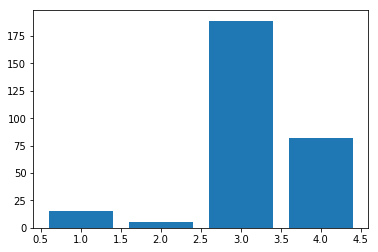

In [86]:
pyplot.bar(feat_freq['feature'], feat_freq['freq'])

In [53]:
iris['data'][:,1]

array([3.5, 3. , 3.2, 3.1, 3.6, 3.9, 3.4, 3.4, 2.9, 3.1, 3.7, 3.4, 3. ,
       3. , 4. , 4.4, 3.9, 3.5, 3.8, 3.8, 3.4, 3.7, 3.6, 3.3, 3.4, 3. ,
       3.4, 3.5, 3.4, 3.2, 3.1, 3.4, 4.1, 4.2, 3.1, 3.2, 3.5, 3.6, 3. ,
       3.4, 3.5, 2.3, 3.2, 3.5, 3.8, 3. , 3.8, 3.2, 3.7, 3.3, 3.2, 3.2,
       3.1, 2.3, 2.8, 2.8, 3.3, 2.4, 2.9, 2.7, 2. , 3. , 2.2, 2.9, 2.9,
       3.1, 3. , 2.7, 2.2, 2.5, 3.2, 2.8, 2.5, 2.8, 2.9, 3. , 2.8, 3. ,
       2.9, 2.6, 2.4, 2.4, 2.7, 2.7, 3. , 3.4, 3.1, 2.3, 3. , 2.5, 2.6,
       3. , 2.6, 2.3, 2.7, 3. , 2.9, 2.9, 2.5, 2.8, 3.3, 2.7, 3. , 2.9,
       3. , 3. , 2.5, 2.9, 2.5, 3.6, 3.2, 2.7, 3. , 2.5, 2.8, 3.2, 3. ,
       3.8, 2.6, 2.2, 3.2, 2.8, 2.8, 2.7, 3.3, 3.2, 2.8, 3. , 2.8, 3. ,
       2.8, 3.8, 2.8, 2.8, 2.6, 3. , 3.4, 3.1, 3. , 3.1, 3.1, 3.1, 2.7,
       3.2, 3.3, 3. , 2.5, 3. , 3.4, 3. ])

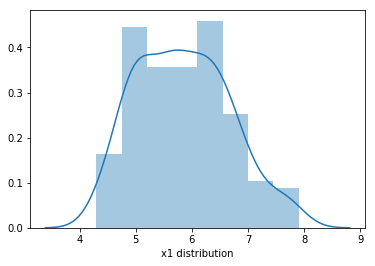

In [55]:
sns.distplot(iris['data'][:,0], axlabel="x1 distribution")

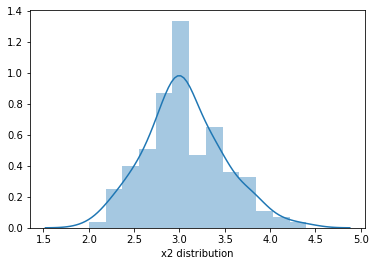

In [56]:
sns.distplot(iris['data'][:,1], axlabel="x2 distribution")

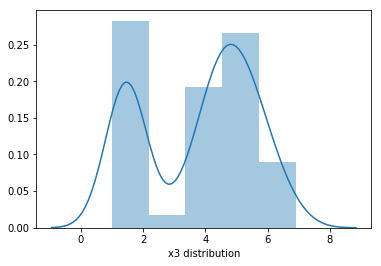

In [57]:
sns.distplot(iris['data'][:,2], axlabel="x3 distribution")

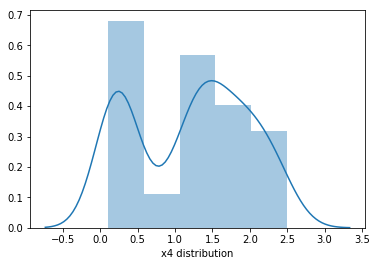

In [58]:
sns.distplot(iris['data'][:,3], axlabel="x4 distribution")

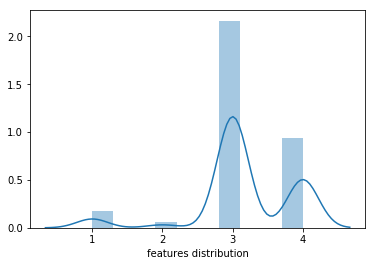

In [37]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
# plt.hist(feat_list)
sns.distplot(feat_list, axlabel="features distribution")

In [41]:
bin_labels.head()

,label,x,freq
0,A,0.70,0
1,B,1.75,31
2,C,1.85,0
3,D,2.60,31
4,E,3.05,0


In [43]:
_label = []
_bin = []
for i, val in bin_labels.iterrows():
    _label.append(val[0])
    _bin.append(float(val[1])) 

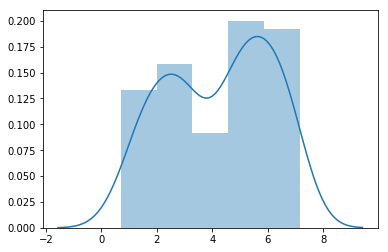

In [44]:
sns.distplot(_bin)

### Vectorize path sequences

In [44]:
input_path_sequence = []
next_chars = []
features = []
paths_maxlen = np.max(paths_lengths)
# path_vocab_size = len(bin_labels) # How is this working? Validate!
path_vocab_size = len(indices_label) # Temporary test for local trees
feature_size = 4
for i in range(0, len(test_data)):
    # get the feature
    curr_feat = np.array([test_data.iloc[i, 0:4]])
    curr_path = test_data.iloc[i, -1]
    curr_path_len = len(curr_path)
    # curr_label = y[i]
    # curr_dec_feat = df.iloc[i, 6]
    for j in range(1, curr_path_len):
        features.append(curr_feat)
        input_path_sequence.append(curr_path[0:j])
        next_chars.append(curr_path[j])

x_path = np.zeros(
    (len(input_path_sequence), paths_maxlen, path_vocab_size), dtype=np.bool)

path_latent_input = np.zeros(
    (len(input_path_sequence), feature_size), dtype=np.float)

y_path = np.zeros(
    (len(input_path_sequence), path_vocab_size), dtype=np.bool)

# print(input_path_sequence)
# print(len(input_path_sequence))
for i, sentence in enumerate(input_path_sequence):
    for t, char in enumerate(sentence):
        # x_path[i, t, self.char_indices[char]] = 1
        # print(bin_labels.index[bin_labels['label'] == char[1]])
        # index = bin_labels.index[bin_labels['label'] == char[1]].tolist()[0]
        x_path[i, t, label_indices[char]] = 1
    # y_path[i, char_indices[next_chars[i]]] = 1
    # index = bin_labels.index[bin_labels['label'] == next_chars[i][1]].tolist()[0]
    # y_path[i, index] = 1
    y_path[i, label_indices[next_chars[i]]] = 1
    path_latent_input[i, :] = features[i]
    
## Trouble with "S" and "E" index values.

In [45]:
len(input_path_sequence)

441

In [46]:
len(next_chars)

441

In [47]:
y_path.shape

(441, 49)

### Create and train label and rnn models

In [30]:
def _create_label_model(latent_dim=25, feature_size=5):
    input_layer = Input(shape=(feature_size,), name='ip_x')
    hidden_layer_x1 = Dense(20, activation='tanh',
                            name='hidden_x1')(input_layer)
    hidden_layer_x2 = Dense(20, activation='tanh',
                            name='hidden_x2')(hidden_layer_x1)
    hidden_layer_x3 = Dense(latent_dim, activation='tanh',
                            name='hidden_x3')(hidden_layer_x2)
    output_layer = Dense(len(np.unique(y)), activation='softmax',
                         name='op_x')(hidden_layer_x3)
    model = Model(input_layer, output_layer)
    return model

def _create_combined_model(initialize=True, rnn_cell='gru', latent_dim=100):

    label_model_latent = Input(shape=(latent_dim,), name='label_ip')
    path_input = Input(shape=(
        paths_maxlen, path_vocab_size), name='dec_feat_ip')
    if rnn_cell == 'gru':
        RNN = GRU
    else:
        RNN = LSTM

    decoder = RNN(latent_dim, return_state=False,
                  return_sequences=False, name='gru_seq')
    if initialize:
        decoder_outputs = decoder(
            path_input, initial_state=label_model_latent)
    else:
        decoder_outputs = decoder(path_input)

    merge_layer = concatenate(
        [label_model_latent, decoder_outputs], name='cat')
    output_chars = Dense(path_vocab_size,
                         activation='softmax', name='op_sent')(merge_layer)
    model = Model(
        [label_model_latent, path_input], output_chars)
    return model

In [20]:
# combined_model = _create_combined_model()
feature_size=4
label_model = _create_label_model()

In [8]:
label_model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
ip_x (InputLayer)            [(None, 4)]               0         
_________________________________________________________________
hidden_x1 (Dense)            (None, 20)                100       
_________________________________________________________________
hidden_x2 (Dense)            (None, 20)                420       
_________________________________________________________________
hidden_x3 (Dense)            (None, 15)                315       
_________________________________________________________________
op_x (Dense)                 (None, 3)                 48        
Total params: 883
Trainable params: 883
Non-trainable params: 0
_________________________________________________________________


In [72]:
plot_model(combined_model, to_file='model.png')

In [40]:
def get_hidden_x(x, model, layer_num=3):
    def get_hidden_x_inner(model, layer_num=layer_num):
        return K.function([model.layers[0].input], [model.layers[layer_num].output])
    return get_hidden_x_inner(model, layer_num=layer_num)([x])[0]

In [51]:
def fit_model():

    y_cat = to_categorical(y)

    label_model.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    label_model.fit(
        X, y_cat, batch_size=30, epochs=150, verbose=0, shuffle=True, validation_split=0.2)

    x_latent = get_hidden_x(path_latent_input, model=label_model)

    combined_model.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    combined_model.fit([x_latent, x_path], y_path,
                           batch_size=30, epochs=1000, verbose=1, shuffle=True)

In [52]:
fit_model()

Instructions for updating:
Use tf.cast instead.
Epoch 1/1000
441/441 [==============================] - 1s 1ms/step - loss: 3.9304 - acc: 0.0454
Epoch 2/1000
441/441 [==============================] - 0s 163us/step - loss: 3.8762 - acc: 0.0680
Epoch 3/1000
441/441 [==============================] - 0s 176us/step - loss: 3.8224 - acc: 0.0680
Epoch 4/1000
441/441 [==============================] - 0s 160us/step - loss: 3.7662 - acc: 0.0726
Epoch 5/1000
441/441 [==============================] - 0s 182us/step - loss: 3.7043 - acc: 0.0726
Epoch 6/1000
441/441 [==============================] - 0s 171us/step - loss: 3.6321 - acc: 0.0726
Epoch 7/1000
441/441 [==============================] - 0s 167us/step - loss: 3.5425 - acc: 0.0839
Epoch 8/1000
441/441 [==============================] - 0s 178us/step - loss: 3.4328 - acc: 0.1043
Epoch 9/1000
441/441 [==============================] - 0s 163us/step - loss: 3.3085 - acc: 0.1270
Epoch 10/1000
441/441 [==============================] - 0s 140

441/441 [==============================] - 0s 167us/step - loss: 1.8851 - acc: 0.4172
Epoch 162/1000
441/441 [==============================] - 0s 165us/step - loss: 1.8796 - acc: 0.4172
Epoch 163/1000
441/441 [==============================] - 0s 145us/step - loss: 1.8815 - acc: 0.4195
Epoch 164/1000
441/441 [==============================] - 0s 158us/step - loss: 1.8801 - acc: 0.4218
Epoch 165/1000
441/441 [==============================] - 0s 171us/step - loss: 1.8743 - acc: 0.4195
Epoch 166/1000
441/441 [==============================] - 0s 165us/step - loss: 1.8731 - acc: 0.4218
Epoch 167/1000
441/441 [==============================] - 0s 176us/step - loss: 1.8702 - acc: 0.4195
Epoch 168/1000
441/441 [==============================] - 0s 146us/step - loss: 1.8698 - acc: 0.4172
Epoch 169/1000
441/441 [==============================] - 0s 152us/step - loss: 1.8683 - acc: 0.4195
Epoch 170/1000
441/441 [==============================] - 0s 162us/step - loss: 1.8648 - acc: 0.4172
Epoch

441/441 [==============================] - 0s 165us/step - loss: 1.7257 - acc: 0.4512
Epoch 324/1000
441/441 [==============================] - 0s 161us/step - loss: 1.7227 - acc: 0.4535
Epoch 325/1000
441/441 [==============================] - 0s 158us/step - loss: 1.7251 - acc: 0.4467
Epoch 326/1000
441/441 [==============================] - 0s 143us/step - loss: 1.7260 - acc: 0.4512
Epoch 327/1000
441/441 [==============================] - 0s 155us/step - loss: 1.7229 - acc: 0.4467
Epoch 328/1000
441/441 [==============================] - 0s 145us/step - loss: 1.7221 - acc: 0.4467
Epoch 329/1000
441/441 [==============================] - 0s 157us/step - loss: 1.7265 - acc: 0.4444
Epoch 330/1000
441/441 [==============================] - 0s 163us/step - loss: 1.7226 - acc: 0.4512
Epoch 331/1000
441/441 [==============================] - 0s 172us/step - loss: 1.7201 - acc: 0.4444
Epoch 332/1000
441/441 [==============================] - 0s 146us/step - loss: 1.7198 - acc: 0.4467
Epoch

441/441 [==============================] - 0s 156us/step - loss: 1.5485 - acc: 0.5011
Epoch 486/1000
441/441 [==============================] - 0s 166us/step - loss: 1.5463 - acc: 0.4875
Epoch 487/1000
441/441 [==============================] - 0s 152us/step - loss: 1.5471 - acc: 0.5011
Epoch 488/1000
441/441 [==============================] - 0s 171us/step - loss: 1.5466 - acc: 0.4898
Epoch 489/1000
441/441 [==============================] - 0s 168us/step - loss: 1.5409 - acc: 0.4943
Epoch 490/1000
441/441 [==============================] - 0s 151us/step - loss: 1.5411 - acc: 0.4921
Epoch 491/1000
441/441 [==============================] - 0s 148us/step - loss: 1.5445 - acc: 0.4830
Epoch 492/1000
441/441 [==============================] - 0s 154us/step - loss: 1.5373 - acc: 0.4943
Epoch 493/1000
441/441 [==============================] - 0s 172us/step - loss: 1.5392 - acc: 0.5011
Epoch 494/1000
441/441 [==============================] - 0s 165us/step - loss: 1.5357 - acc: 0.4943
Epoch

441/441 [==============================] - 0s 187us/step - loss: 1.4656 - acc: 0.5057
Epoch 648/1000
441/441 [==============================] - 0s 183us/step - loss: 1.4671 - acc: 0.5011
Epoch 649/1000
441/441 [==============================] - 0s 148us/step - loss: 1.4639 - acc: 0.5034
Epoch 650/1000
441/441 [==============================] - 0s 150us/step - loss: 1.4632 - acc: 0.5079
Epoch 651/1000
441/441 [==============================] - 0s 153us/step - loss: 1.4643 - acc: 0.5057
Epoch 652/1000
441/441 [==============================] - 0s 141us/step - loss: 1.4671 - acc: 0.5011
Epoch 653/1000
441/441 [==============================] - 0s 144us/step - loss: 1.4670 - acc: 0.5102
Epoch 654/1000
441/441 [==============================] - 0s 149us/step - loss: 1.4719 - acc: 0.5079
Epoch 655/1000
441/441 [==============================] - 0s 152us/step - loss: 1.4717 - acc: 0.5011
Epoch 656/1000
441/441 [==============================] - 0s 153us/step - loss: 1.4682 - acc: 0.5011
Epoch

441/441 [==============================] - 0s 151us/step - loss: 1.4183 - acc: 0.5034
Epoch 810/1000
441/441 [==============================] - 0s 153us/step - loss: 1.4170 - acc: 0.5034
Epoch 811/1000
441/441 [==============================] - 0s 156us/step - loss: 1.4183 - acc: 0.5057
Epoch 812/1000
441/441 [==============================] - 0s 156us/step - loss: 1.4180 - acc: 0.5057
Epoch 813/1000
441/441 [==============================] - 0s 160us/step - loss: 1.4150 - acc: 0.5034
Epoch 814/1000
441/441 [==============================] - 0s 138us/step - loss: 1.4194 - acc: 0.5079
Epoch 815/1000
441/441 [==============================] - 0s 163us/step - loss: 1.4176 - acc: 0.5011
Epoch 816/1000
441/441 [==============================] - 0s 152us/step - loss: 1.4245 - acc: 0.5170
Epoch 817/1000
441/441 [==============================] - 0s 152us/step - loss: 1.4195 - acc: 0.5102
Epoch 818/1000
441/441 [==============================] - 0s 151us/step - loss: 1.4130 - acc: 0.5034
Epoch

441/441 [==============================] - 0s 147us/step - loss: 1.3822 - acc: 0.5125
Epoch 972/1000
441/441 [==============================] - 0s 158us/step - loss: 1.3849 - acc: 0.5079
Epoch 973/1000
441/441 [==============================] - 0s 151us/step - loss: 1.3958 - acc: 0.5170
Epoch 974/1000
441/441 [==============================] - 0s 153us/step - loss: 1.3951 - acc: 0.5034
Epoch 975/1000
441/441 [==============================] - 0s 173us/step - loss: 1.3867 - acc: 0.5147
Epoch 976/1000
441/441 [==============================] - 0s 146us/step - loss: 1.3831 - acc: 0.5079
Epoch 977/1000
441/441 [==============================] - 0s 139us/step - loss: 1.3783 - acc: 0.5034
Epoch 978/1000
441/441 [==============================] - 0s 165us/step - loss: 1.3805 - acc: 0.5057
Epoch 979/1000
441/441 [==============================] - 0s 144us/step - loss: 1.3848 - acc: 0.5102
Epoch 980/1000
441/441 [==============================] - 0s 157us/step - loss: 1.3861 - acc: 0.5125
Epoch

In [53]:
combined_model.summary() ## After increasing sample size and adding weights

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
label_ip (InputLayer)           (None, 5)            0                                            
__________________________________________________________________________________________________
dec_feat_ip (InputLayer)        (None, 7, 49)        0                                            
__________________________________________________________________________________________________
gru_seq (GRU)                   (None, 5)            825         dec_feat_ip[0][0]                
                                                                 label_ip[0][0]                   
__________________________________________________________________________________________________
cat (Concatenate)               (None, 10)           0           label_ip[0][0]                   
          

In [40]:
combined_model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
label_ip (InputLayer)           (None, 5)            0                                            
__________________________________________________________________________________________________
dec_feat_ip (InputLayer)        (None, 5, 117)       0                                            
__________________________________________________________________________________________________
gru_seq (GRU)                   (None, 5)            1845        dec_feat_ip[0][0]                
                                                                 label_ip[0][0]                   
__________________________________________________________________________________________________
cat (Concatenate)               (None, 10)           0           label_ip[0][0]                   
          

In [ ]:
def predict(x):
    latent_dim = 5
    x_f = x.reshape(1, feature_size)
    token = 'S'
    cont = True
    path = [token]
    x_path = np.zeros((1, paths_maxlen, path_vocab_size), dtype=np.bool)

    x_latent = get_hidden_x(x_f, model=label_model)
    x_latent = x_latent.reshape(1, latent_dim)
    x_path[0, 0, label_indices[token]] = 1
    pred = label_model.predict(x_f)
    label = [np.argmax(pred[0])]
    index = 1
    while cont & (index < paths_maxlen):
        pred = combined_model.predict([x_latent, x_path])
        char_index = np.argmax(pred[0])
        x_path[0, index, char_index] = 1
        next_char = indices_label[char_index]
        path.append(next_char)
        index += 1
        if next_char == 'E':
            cont = False
        # elif index == self.paths_maxlen - 1:
        #     path.append('E')

    if path[-1] != 'E':
        path.append('E')

    return [path, label]

### Path invariance method

In [42]:
def check_path(path): # Returns -1 if path traversed is wrong/non-existant
    # path = ''.join(path)
    path = path[1:-1]
    pred_features = []
    path_as_strings = []
    for i in range(len(path)):
        pred_features.append(int(path[i][:-1]))
        path_as_strings.append(path[i][-1])
        # if i%2 == 0:
        #     print('i -- ', i)
        #     print('path -- ', path)
        #     print('path[i] -- ', path[i])
        #     pred_features.append(int(path[i]))
        # else:
        #     path_as_strings.append(path[i])

    n_nodes = self.clf.tree_.node_count
    children_left = self.clf.tree_.children_left
    children_right = self.clf.tree_.children_right
    feature = self.clf.tree_.feature

    is_leaves = np.zeros(shape=n_nodes, dtype=bool)
    stack = [(0, -1)]
    while len(stack) > 0:
        node_id, parent_depth = stack.pop()
        # node_depth[node_id] = parent_depth + 1

        if (children_left[node_id] != children_right[node_id]):
            stack.append((children_left[node_id], parent_depth + 1))
            stack.append((children_right[node_id], parent_depth + 1))
        else:
            is_leaves[node_id] = True


    node = 0
    pred_target = -1
    subset_path = False
    for i in range(len(path_as_strings)):
        if path_as_strings[i] == 'L':
            if feature[node]+1 == pred_features[i]:
                node = children_left[node]
            # else:
                # pred_target = -1 # Remove for "subset" checks
                # break
        elif path_as_strings[i] == 'R':
            if feature[node]+1 == pred_features[i]:
                node = children_right[node]
            # else:
                # pred_target = -1 # Remove for "subset" checks
                # break
        if is_leaves[node]:
            for i, x in enumerate(self.clf.tree_.value[node][0]):
                if x > 0:
                    pred_target = i
            if i < len(path_as_strings):
                subset_path = True

    return pred_target, subset_path

In [43]:
path_df

,new_col
0,1G0
1,3J0
2,1U0
3,1AC0
4,1N0
5,1AO0
6,2Y1
7,1G0
8,3AK0
9,1V0


### Test model configuration

In [44]:
def score():
    count = []
    bleu_score = []
    j_coeff = []
    l_dist = []
    path_mismatch_count = []
    traverse_check_count = []
    order_mismatch_count = []
    subset_path_count = []
    for i in range(test_data.shape[0]):
        curr_feat = np.array([test_data.iloc[i, 0:X.shape[1]]])
        path, label = predict(curr_feat)
        actual_path = test_data.iloc[i, -1]

        actual_path_tok = [label_indices[char] for char in actual_path]
        pred_path_tok = [label_indices[char] for char in path]

        # j_coeff.append(super().get_j_coeff(actual_path_tok, pred_path_tok))

        print('actual vs predicted: ', test_data.iloc[i, -1], ' vs ', ' '.join(
            path), 'labels: ', y[i], label[0])
        count.append(y[i] == label[0])
        # print('Actual path -- ', actual_path)
        # print('Pred path -- ', path)
#         if actual_path != path:
#             print(' -- Path mismatch -- ')
#             if sorted(actual_path) == sorted(path):
#                 print(' -- Order mismatch -- ')
#                 order_mismatch_count.append(1)
#             else:
#                 path_mismatch_count.append(1)
#                 pred_target, subset_path = self.check_path(path)
#                 subset_path_count.append(subset_path)
#                 if pred_target != -1 and pred_target == self.df.iloc[i, self.X.shape[1]+1]:
#                     traverse_check_count.append(1)


        path = list(''.join(path))
        actual_path = list(''.join(test_data.iloc[i, -1]))
        bleu_score.append(sentence_bleu([actual_path], path))

#         lev_path = []
#         for i in range(len(path)):
#             if i in ['S','L','R','E']:
#                 lev_path.append(i)
#         l_dist.append(distance.levenshtein(
#             self.df.iloc[i, self.X.shape[1]].replace(' ', ''), ''.join(lev_path)))


    print('\nLabel accuracy - ', np.mean(count))
#     print('Path metric (Jaccard) - ', np.mean(j_coeff))
#     print('Path metric (Levenshtein) - ', np.mean(l_dist))
#     print('Path mismatch count - ', np.sum(path_mismatch_count))
#     print('Right traverse count - ', np.sum(traverse_check_count))
#     print('Order mismatch count - ', np.sum(order_mismatch_count))
#     print('Subset path count - ', np.sum(subset_path_count))
    print('Bleu score of paths - ', np.mean(bleu_score))

In [45]:
score()

actual vs predicted:  ['S', '1G0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3J0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '1U0', 'E']  vs  S 3F0 1G0 E labels:  0 0


/home/shakkeel/anaconda3/envs/test_imly/lib/python3.6/site-packages/nltk/translate/bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/home/shakkeel/anaconda3/envs/test_imly/lib/python3.6/site-packages/nltk/translate/bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


actual vs predicted:  ['S', '1AC0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '1N0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '1AO0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '2Y1', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '1G0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3AK0', 'E']  vs  S 3F0 1G0 E labels:  0 0


/home/shakkeel/anaconda3/envs/test_imly/lib/python3.6/site-packages/nltk/translate/bleu_score.py:523: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


actual vs predicted:  ['S', '1V0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3R0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3J0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3R0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3BJ0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3Y0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3X0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '1V0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3F0', '1BM0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '1BU0', '3BR0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3F0', '1G0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '1O0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '3BJ0', 'E']  vs  S 3F0 1G0 E labels:  0 0
actual vs predicted:  ['S', '1V0', '1AH0', 'E']  vs  S 3F0 1G0 E

actual vs predicted:  ['S', '1BU1', 'E']  vs  S 1AO1 1AV1 E labels:  2 2
actual vs predicted:  ['S', '1AO1', '1DG0', '2J0', 'E']  vs  S 1AO1 3U1 E labels:  2 2
actual vs predicted:  ['S', '3U1', 'E']  vs  S 1AO1 1AV1 E labels:  2 2
actual vs predicted:  ['S', '3Y1', '3U1', 'E']  vs  S 1AO1 1AV1 E labels:  2 2
actual vs predicted:  ['S', '2L0', '1DM1', 'E']  vs  S 1AO1 1AV1 E labels:  2 2
actual vs predicted:  ['S', '1AO1', '1P1', 'E']  vs  S 1AO1 3U1 E labels:  2 2
actual vs predicted:  ['S', '3CX1', 'E']  vs  S 1AO1 1AV1 E labels:  2 2
actual vs predicted:  ['S', '3F1', 'E']  vs  S 1AO1 3U1 E labels:  2 2
actual vs predicted:  ['S', '2AT0', '4AQ1', '1AD0', 'E']  vs  S 1AO1 1AC1 E labels:  2 2
actual vs predicted:  ['S', '2Y1', '1BF1', 'E']  vs  S 3T1 E labels:  2 1
actual vs predicted:  ['S', '2AM0', '1DS1', 'E']  vs  S 1AO1 1AV1 E labels:  2 2
actual vs predicted:  ['S', '4AF1', 'E']  vs  S 1O1 3CX0 E labels:  2 1
actual vs predicted:  ['S', '4AF1', 'E']  vs  S 1AO1 1AV1 E labels:  2

## Path invariance trials using rpart -- generic

In [133]:
## Import nnum, vnum, nodes, csplit, split_df,
## frame

splits = pd.read_csv('../../data/raw/splits.csv', delimiter=",", index_col=0)
csplit = pd.read_csv('../../data/raw/csplit.csv', delimiter=",")
frame = pd.read_csv('../../data/raw/frame.csv', delimiter=",",index_col=0)

# frame = frame.drop(["Unnamed: 0"], axis=1)
frame = frame.rename(columns={"var": "variable"})
# bin_labels = bin_labels.rename(columns={"Unnamed: 0": "label", "label_list": "bins"})

In [134]:
frame

,variable,n,wt,dev,yval,complexity,ncompete,nsurrogate,yval2.,yval2..1,yval2..2,yval2..3,yval2..4,yval2..5,yval2..6,yval2.nodeprob
1,Petal.Length,150,150,100,1,0.500,3,3,1.0,50.0,50.0,50.0,0.333333,0.333333,0.333333,1.000000
2,<leaf>,50,50,0,1,0.000,0,0,1.0,50.0,0.0,0.0,1.000000,0.000000,0.000000,0.333333
3,Petal.Width,100,100,50,2,0.440,3,3,2.0,0.0,50.0,50.0,0.000000,0.500000,0.500000,0.666667
6,Petal.Length,54,54,5,2,0.020,3,0,2.0,0.0,49.0,5.0,0.000000,0.907407,0.092593,0.360000
12,Petal.Width,48,48,1,2,0.010,3,0,2.0,0.0,47.0,1.0,0.000000,0.979167,0.020833,0.320000
24,<leaf>,47,47,0,2,0.000,0,0,2.0,0.0,47.0,0.0,0.000000,1.000000,0.000000,0.313333
25,<leaf>,1,1,0,3,0.000,0,0,3.0,0.0,0.0,1.0,0.000000,0.000000,1.000000,0.006667
13,Petal.Width,6,6,2,3,0.010,3,2,3.0,0.0,2.0,4.0,0.000000,0.333333,0.666667,0.040000
26,Sepal.Length,3,3,1,2,0.010,3,0,2.0,0.0,2.0,1.0,0.000000,0.666667,0.333333,0.020000
52,<leaf>,2,2,0,2,0.000,0,0,2.0,0.0,2.0,0.0,0.000000,1.000000,0.000000,0.013333


In [135]:
## Generate nnum, vnum, nodes(split_df and csplit - 2L if necessary)

temp_frame = frame

nc = temp_frame[["ncompete", "nsurrogate"]]

index = np.cumsum((frame[["variable"]]!="<leaf>").values + nc[["ncompete"]].values + nc[["nsurrogate"]].values)

index_df = pd.DataFrame((np.insert(index,0,0)+1)[:-1], columns=["i"], index=frame.index)

temp_frame = pd.concat([temp_frame, index_df], axis=1)

# temp_frame[temp_frame[["var"]]=="<leaf>"]
# temp_frame.where(temp_frame[["var"]]=="<leaf>")
# temp_frame.loc[temp_frame[["variable"]]=="<leaf>", "index"] = 0
temp_frame.i[temp_frame.variable == "<leaf>"] = 0

/home/shakkeel/anaconda3/envs/test_imly/lib/python3.6/site-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


In [136]:
temp_frame

,variable,n,wt,dev,yval,complexity,ncompete,nsurrogate,yval2.,yval2..1,yval2..2,yval2..3,yval2..4,yval2..5,yval2..6,yval2.nodeprob,i
1,Petal.Length,150,150,100,1,0.500,3,3,1.0,50.0,50.0,50.0,0.333333,0.333333,0.333333,1.000000,1
2,<leaf>,50,50,0,1,0.000,0,0,1.0,50.0,0.0,0.0,1.000000,0.000000,0.000000,0.333333,0
3,Petal.Width,100,100,50,2,0.440,3,3,2.0,0.0,50.0,50.0,0.000000,0.500000,0.500000,0.666667,8
6,Petal.Length,54,54,5,2,0.020,3,0,2.0,0.0,49.0,5.0,0.000000,0.907407,0.092593,0.360000,15
12,Petal.Width,48,48,1,2,0.010,3,0,2.0,0.0,47.0,1.0,0.000000,0.979167,0.020833,0.320000,19
24,<leaf>,47,47,0,2,0.000,0,0,2.0,0.0,47.0,0.0,0.000000,1.000000,0.000000,0.313333,0
25,<leaf>,1,1,0,3,0.000,0,0,3.0,0.0,0.0,1.0,0.000000,0.000000,1.000000,0.006667,0
13,Petal.Width,6,6,2,3,0.010,3,2,3.0,0.0,2.0,4.0,0.000000,0.333333,0.666667,0.040000,23
26,Sepal.Length,3,3,1,2,0.010,3,0,2.0,0.0,2.0,1.0,0.000000,0.666667,0.333333,0.020000,29
52,<leaf>,2,2,0,2,0.000,0,0,2.0,0.0,2.0,0.0,0.000000,1.000000,0.000000,0.013333,0


In [137]:
nodes = temp_frame[["n", "ncompete", "nsurrogate", "i"]]

In [138]:
nodes

,n,ncompete,nsurrogate,i
1,150,3,3,1
2,50,0,0,0
3,100,3,3,8
6,54,3,0,15
12,48,3,0,19
24,47,0,0,0
25,1,0,0,0
13,6,3,2,23
26,3,3,0,29
52,2,0,0,0


In [94]:
def load_tree_details(index): # Returns nnum, nodes, vnum, splits, temp_frame
    splits_dir = '../../data/raw/local_dt_df/splits'+'_'+str(index)+'.csv'
    frame_dir = '../../data/raw/local_dt_df/frame'+'_'+str(index)+'.csv'
    splits = pd.read_csv(splits_dir, delimiter=",", index_col=0)
    frame = pd.read_csv(frame_dir, delimiter=",",index_col=0)
    
    frame = frame.rename(columns={"var": "variable"})
    
    temp_frame = frame

    nc = temp_frame[["ncompete", "nsurrogate"]]

    index = np.cumsum((frame[["variable"]]!="<leaf>").values + nc[["ncompete"]].values + nc[["nsurrogate"]].values)

    index_df = pd.DataFrame((np.insert(index,0,0)+1)[:-1], columns=["i"], index=frame.index)

    temp_frame = pd.concat([temp_frame, index_df], axis=1)

    temp_frame.i[temp_frame.variable == "<leaf>"] = 0
    
    nodes = temp_frame[["n", "ncompete", "nsurrogate", "i"]]
    
    nnum = list(temp_frame.index)

    feature_names = ["Sepal.Length", "Sepal.Width", "Petal.Length", "Petal.Width"]

    vnum = list(map(feature_names.index, splits.index))
    
    return nnum, nodes, vnum, splits, temp_frame 

In [139]:
nnum = list(temp_frame.index) # row names of temp_frame

In [140]:
nnum

[1, 2, 3, 6, 12, 24, 25, 13, 26, 52, 53, 27, 7, 14, 28, 29, 15]

In [141]:
feature_names = ["Sepal.Length", "Sepal.Width", "Petal.Length", "Petal.Width"]

vnum = list(map(feature_names.index, splits.index))

In [64]:
nodes

,n,ncompete,nsurrogate,i
1,150,3,3,1
2,50,0,0,0
3,100,3,3,8
6,54,3,0,15
12,48,3,0,19
24,47,0,0,0
25,1,0,0,0
13,6,3,2,23
26,3,3,0,29
52,2,0,0,0


In [153]:
sample_path = ['S', '3A0', '4C1', '2AD1', 'E']

In [159]:
len(vnum)

38

In [160]:
len(nnum)

17

In [158]:
int(sample_path[1:-1][1][0])

4

In [92]:
def return_yval(path, index): # [1,0,0,0]
    nnum, nodes, vnum, splits, temp_frame = load_tree_details(index)
    path = path[1:-1]
    node = 0
    nspl = 1
    i = 0
    while nspl != 0:
        npos = nnum[node] # i)0, 
        nspl = nodes.iloc[npos-1][3] # i)1
        var = vnum[nspl]
        # ncat
        temp = splits.iloc[nspl][3]
        if nspl > 0:
            print("nspl succeeded")
            if  int(path[i][0]) != var:
                print("Wrong feature -- ", path[i][0], var)
                return False
                break
            elif int(path[i][-1]) == 0: # i)1
                direction = -1
                i+=1
            else:
                direction = 1
                i+=1

            if direction == -1:
                print(node)
                if node == 0:
                    node = 1
                node = 2 * node
            else:
                print(node)
                if node == 0:
                    node = 1
                node = 2 * node + 1
            if len(path) == 1:
                nspl = 0
        else:
            print('nspl failed')
            print("leaf node -- ", node)
            yval = temp_frame.iloc[node][4]
    return temp_frame.iloc[node][4]

In [144]:
nodes.iloc[0]

n             150
ncompete        3
nsurrogate      3
i               1
Name: 1, dtype: int64

In [166]:

path = [1,1,0,1]
a = [1,0,0,0]
b = [1,1,1]
c = [0]
d = [1,1,1,1,1,1,0]
e = [1,0,1,0,0]
return_yval(e)

nspl succeeded
0
nspl failed
leaf node --  3


2

In [161]:
return_yval(sample_path)

nspl succeeded
0
nspl failed
leaf node --  3


2

In [146]:
temp_frame

,variable,n,wt,dev,yval,complexity,ncompete,nsurrogate,yval2.,yval2..1,yval2..2,yval2..3,yval2..4,yval2..5,yval2..6,yval2.nodeprob,i
1,Petal.Length,150,150,100,1,0.500,3,3,1.0,50.0,50.0,50.0,0.333333,0.333333,0.333333,1.000000,1
2,<leaf>,50,50,0,1,0.000,0,0,1.0,50.0,0.0,0.0,1.000000,0.000000,0.000000,0.333333,0
3,Petal.Width,100,100,50,2,0.440,3,3,2.0,0.0,50.0,50.0,0.000000,0.500000,0.500000,0.666667,8
6,Petal.Length,54,54,5,2,0.020,3,0,2.0,0.0,49.0,5.0,0.000000,0.907407,0.092593,0.360000,15
12,Petal.Width,48,48,1,2,0.010,3,0,2.0,0.0,47.0,1.0,0.000000,0.979167,0.020833,0.320000,19
24,<leaf>,47,47,0,2,0.000,0,0,2.0,0.0,47.0,0.0,0.000000,1.000000,0.000000,0.313333,0
25,<leaf>,1,1,0,3,0.000,0,0,3.0,0.0,0.0,1.0,0.000000,0.000000,1.000000,0.006667,0
13,Petal.Width,6,6,2,3,0.010,3,2,3.0,0.0,2.0,4.0,0.000000,0.333333,0.666667,0.040000,23
26,Sepal.Length,3,3,1,2,0.010,3,0,2.0,0.0,2.0,1.0,0.000000,0.666667,0.333333,0.020000,29
52,<leaf>,2,2,0,2,0.000,0,0,2.0,0.0,2.0,0.0,0.000000,1.000000,0.000000,0.013333,0


In [147]:
splits

,count,ncat,improve,index,adj
Petal.Length,150,-1,50.000000,2.45,0.000000
Petal.Width,150,-1,50.000000,0.80,0.000000
Sepal.Length,150,-1,34.164050,5.45,0.000000
Sepal.Width,150,1,19.038508,3.35,0.000000
Petal.Width,0,-1,1.000000,0.80,1.000000
Sepal.Length,0,-1,0.920000,5.45,0.760000
Sepal.Width,0,1,0.833333,3.35,0.500000
Petal.Width,100,-1,38.969404,1.75,0.000000
Petal.Length,100,-1,37.353535,4.75,0.000000
Sepal.Length,100,-1,10.686869,6.15,0.000000


In [148]:
iris.target_names

array(['setosa', 'versicolor', 'virginica'], dtype='<U10')

#### Bin reduction trials

In [32]:
def get_bin_mappings(flow_matrix_dim, emd_index):
    # mapping_list = []
    mapping_dict = {}
    for i in range(flow_matrix_dim):
        for j in range(flow_matrix_dim):
            if emd_trials[emd_index]['flow_matrix'][i][j] != 0.0:
                # mapping_list.append([emd_trials[emd_index]['flow_matrix'][i][j], (i,j)])
                deep_set(mapping_dict, [i, j], emd_trials[emd_index]['flow_matrix'][i][j])
                
    return mapping_dict

In [12]:
import pyemd
import random
from sklearn.preprocessing import normalize
from scipy.spatial import distance as scipy_distance
from copy import copy
import numpy as np

# actual_bins = sorted([2.4, 5.4, 1.6, 9.7, 8.9])
actual_bins = sorted([17.8, 2.4, 5.4, 1.6, 9.7, 8.9, 11.3, 0.5, 3.3, 15.3])
# actual_freq = [10.0, 3.0, 4.0, 1.0, 5.0]
# actual_freq = normalize([actual_freq])
# actual_freq = actual_freq.tolist()[0]

# 1) Choosing reduced bins by random sampling
# 2) How to choose frequency of new bins?
#   - Uniform values
#   - Kernels
# 3) Obj func to retrieve reduced bins
# ext_bins = random.sample(actual_bins, 3)
# ext_bins

In [120]:
## Pyemd approach -- continuous var
dist_list = []
emd_trials = {}
for index in range(1000):
    ext_bins = sorted(np.random.uniform(actual_bins[0],actual_bins[-1], 3))
    ext_freq = []
    # actual_freq = [10.0, 3.0, 4.0, 1.0, 5.0]
    actual_freq = [10.0, 3.0, 4.0, 1.0, 5.0, 10.0, 3.0, 4.0, 1.0, 5.0]
    actual_freq_norm = normalize([actual_freq], norm='l1').reshape(10,)
    for i, x in enumerate(ext_bins):
        new_freq = []
        for j, b in enumerate(actual_bins):
            c = 1/(np.sqrt(2*np.pi))
            # dist = -(((x-b)**2)/2)
            dist = -((np.power((x-b),2))/2)
            d = np.exp(dist)
            w = c * d
            new_freq.append(w * actual_freq[j])
        ext_freq.append(sum(new_freq))

    combined_bins = copy(actual_bins)
    for _, val in enumerate(ext_bins):
        combined_bins.append(val)

    dist_matrix = np.zeros((13,13), dtype='float64')
    ## Distance
    for i, val in enumerate(combined_bins):
        for j, val_2 in enumerate(combined_bins):
            dist_matrix[i,j] = scipy_distance.euclidean(combined_bins[i], combined_bins[j])
    
    ext_freq_norm = normalize([ext_freq], norm='l1').reshape(3,)
    
    for i in range(len(actual_freq)):
        # ext_freq.insert(0, 0.0)
        ext_freq_norm = np.insert(ext_freq_norm, 0, 0.0)

    for i in range(len(ext_bins)):
        # actual_freq.append(0.0)
        actual_freq_norm = np.append(actual_freq_norm, 0.0)

    # ext_freq = np.array(ext_freq)    
    # actual_freq = np.array(actual_freq)
    
    emd_val, min_cost_flow = pyemd.emd_with_flow(actual_freq_norm, ext_freq_norm, dist_matrix)
    dist_list.append(emd_val)
    emd_trials.update({index:{'distance':emd_val, 'flow_matrix':min_cost_flow,
                             'actual_bins':actual_bins, 'actual_freq_norm':actual_freq_norm,
                             'ext_bins':ext_bins, 'ext_freq_norm':ext_freq_norm,
                             'dist_matrix': dist_matrix}})

In [121]:
actual_freq

[10.0, 3.0, 4.0, 1.0, 5.0, 10.0, 3.0, 4.0, 1.0, 5.0]

In [122]:
ext_freq

[1.3162660158574675, 0.5209963676861593, 2.009792259447329]

In [123]:
actual_freq_norm

array([0.2173913 , 0.06521739, 0.08695652, 0.02173913, 0.10869565,
       0.2173913 , 0.06521739, 0.08695652, 0.02173913, 0.10869565,
       0.        , 0.        , 0.        ])

In [124]:
ext_freq_norm

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.34214903, 0.13542734, 0.52242363])

In [125]:
min(dist_list)

1.2111874752214022

In [126]:
dist_list.index(min(dist_list))

425

In [128]:
emd_trials[425]['actual_bins']

[0.5, 1.6, 2.4, 3.3, 5.4, 8.9, 9.7, 11.3, 15.3, 17.8]

In [129]:
emd_trials[425]['ext_bins']

[0.9385060907250806, 9.345561451682828, 17.111083893285034]

In [131]:
for i in range(13):
    for j in range(13):
        if emd_trials[425]['flow_matrix'][i][j] != 0.0:
            print(emd_trials[425]['flow_matrix'][i][j], (i,j))

0.217391 (0, 10)
0.065217 (1, 10)
0.086957 (2, 10)
0.021739 (3, 10)
0.046495 (4, 10)
0.062201 (4, 11)
0.217391 (5, 11)
0.065217 (6, 11)
0.077296 (7, 11)
0.009661 (7, 12)
0.021739 (8, 12)
0.108696 (9, 12)


In [99]:
emd_trials[6017] ## w/ 10,000 trials

{'distance': 0.23798528644410086,
 'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 0.434783, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.124277, 0.006158, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.173913, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.005357, 0.038121],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.217391],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]],
 'actual_bins': [1.6, 2.4, 5.4, 8.9, 9.7],
 'actual_freq_norm': array([0.43478261, 0.13043478, 0.17391304, 0.04347826, 0.2173913 ,
        0.        , 0.        , 0.        ]),
 'ext_bins': [1.6064817771506419, 5.393405228969593, 9.322409378281648],
 'ext_freq_norm': array([0.        , 0.        , 0.        , 0.        , 0.        ,
        0.55905953, 0.18542895, 0.25551153]),
 'dist_matrix': array([[0.00000000e+00, 8.00000000e-01, 3.80000000e+00, 7.30000000e+00,
         8.10000000e+00, 6.48177715e-03, 3.79340523e+00, 7.72240938e+00],
        [8.00000000e

In [75]:
emd_trials[562] ## w/ 1000 trials

{'distance': 0.2447755192305009,
 'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 0.434783, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.124085, 0.00635, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.173062, 0.000851],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.043478],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.217391],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]],
 'ext_bin': [1.669313785130966, 5.607383172387225, 9.530849925961318],
 'ext_freq': [4.897789781010717, 1.5723296165685663, 2.2936506762020716],
 'dist_matrix': array([[0.        , 0.8       , 3.8       , 7.3       , 8.1       ,
         0.06931379, 4.00738317, 7.93084993],
        [0.8       , 0.        , 3.        , 6.5       , 7.3       ,
         0.73068621, 3.20738317, 7.13084993],
        [3.8       , 3.        , 0.        , 3.5       , 4.3       ,
         3.73068621, 0.20738317, 4.13084993],
        [7.3       , 6.5       , 3.5       , 0.        , 0.8

In [101]:
emd_trials[6017]['flow_matrix']

[[0.0, 0.0, 0.0, 0.0, 0.0, 0.434783, 0.0, 0.0],
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.124277, 0.006158, 0.0],
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.173913, 0.0],
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.005357, 0.038121],
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.217391],
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]]

In [105]:
emd_trials[6017]['flow_matrix'][1][1] != 0.0

False

In [106]:
for i in range(8):
    for j in range(8):
        if emd_trials[6017]['flow_matrix'][i][j] != 0.0:
            print(emd_trials[6017]['flow_matrix'][i][j], (i,j))

0.434783 (0, 5)
0.124277 (1, 5)
0.006158 (1, 6)
0.173913 (2, 6)
0.005357 (3, 6)
0.038121 (3, 7)
0.217391 (4, 7)


In [108]:
emd_trials[6017]['actual_bins']

[1.6, 2.4, 5.4, 8.9, 9.7]

In [109]:
emd_trials[6017]['ext_bins']

[1.6064817771506419, 5.393405228969593, 9.322409378281648]

In [100]:
emd_trials

{0: {'distance': 2.1380404013343006,
  'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 0.2628, 0.171983, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.130435, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.173913, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.043478, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.036143, 0.181247],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]],
  'actual_bins': [1.6, 2.4, 5.4, 8.9, 9.7],
  'actual_freq_norm': array([0.43478261, 0.13043478, 0.17391304, 0.04347826, 0.2173913 ,
         0.        , 0.        , 0.        ]),
  'ext_bins': [3.78925805791465, 4.685435402871269, 7.702180208333779],
  'ext_freq_norm': array([0.        , 0.        , 0.        , 0.        , 0.        ,
         0.39323538, 0.4255172 , 0.18124742]),
  'dist_matrix': array([[0.        , 0.8       , 3.8       , 7.3       , 8.1       ,
          2.18925806, 3.0854354 , 6.10218021],
         [0.8       , 0.        , 3. 

In [296]:
new_freq

[1.790667856900023,
 1.0738105227465606,
 0.06432139515484088,
 4.944241101512384e-09,
 1.4374118916223221e-10]

In [297]:
actual_bins

[1.6,
 2.4,
 5.4,
 8.9,
 9.7,
 2.196769471499167,
 5.8795597151350485,
 5.98261741551536]

In [341]:
emd_trials[dist_list.index(max(dist_list))]

{'distance': 175.8061351642649,
 'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.533209, 0.518282, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5491940000000001],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]],
 'ext_bin': [7.070223146830314, 7.115452473868924, 7.639984088218773],
 'ext_freq': array([0.        , 0.        , 0.        , 0.        , 0.        ,
        0.53320189, 0.5182754 , 0.54920463])}

In [342]:
emd_trials

{0: {'distance': 142.38472402642964,
  'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 1.613818, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.999994, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.640918, 2.296642],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]],
  'ext_bin': [5.362690351859676, 8.726272460942639, 9.61607149427512],
  'ext_freq': array([0.        , 0.        , 0.        , 0.        , 0.        ,
         1.61380982, 1.64091516, 2.29663962])},
 1: {'distance': 97.43179473427186,
  'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 4.899253, 4.913283, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.410406],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.

---

#### Trial 2 

In [11]:
def jaccard_score_inconsistent(x, y):
    intersection_cardinality = len(set.intersection(*[set(x), set(y)]))
    union_cardinality = len(set.union(*[set(x), set(y)]))
    return intersection_cardinality/float(union_cardinality)

def get_j_coeff(a, b):
    if len(a) != len(b):
        return jaccard_score_inconsistent(a, b)
    return jaccard_score(a, b, average='micro')

In [181]:
actual_bins = [['a'], ['b','c'], ['a','c'], ['b'], ['c']]
np.random.choice(actual_bins, 3, replace=False).tolist()

[['b'], ['b', 'c'], ['c']]

In [258]:
## Pyemd approach -- categorical var
'''
Max levels = 3; (a,b,c)
actual_bins = [(a), (b,c), (a,c), (b), (c)]
actual_freq = [10.0, 3.0, 4.0, 1.0, 5.0]
possible_out = [(a), (b), (c), (a,b), (a,c), (b,c)]
'''

actual_bins = [['a'], ['b','c'], ['a','c'], ['a','b'], ['c']]
possible_out = [['a'], ['b','c'], ['a','c'], ['a','b'], ['b'], ['c']]


dist_list = []
emd_trials = {}
for index in range(1000):
    ext_bins = np.random.choice(actual_bins, 3, replace=False).tolist()
    ext_freq = []
    # actual_freq = [10.0, 3.0, 4.0, 1.0, 5.0]
    actual_freq = [10.0, 3.0, 4.0, 1.0, 5.0]
    actual_freq_norm = normalize([actual_freq], norm='l1').reshape(5,)
    for i, x in enumerate(ext_bins):
        new_freq = []
        for j, b in enumerate(actual_bins):
            c = 1/(np.sqrt(2*np.pi))
            # dist = 1 - get_j_coeff(b, x) # Change distance metric
            dist = distance.levenshtein(b,x)
            dist = -((np.power(dist,2))/2)
            d = np.exp(dist)
            w = c * d
            new_freq.append(w * actual_freq[j])
        ext_freq.append(sum(new_freq))

    combined_bins = copy(actual_bins)
    for _, val in enumerate(ext_bins):
        combined_bins.append(val)

    dist_matrix = np.zeros((8,8), dtype='float64')
    ## Distance
    for i, val in enumerate(combined_bins):
        for j, val_2 in enumerate(combined_bins):
            # dist_matrix[i,j] = distance.euclidean(combined_bins[i], combined_bins[j])
            # dist_matrix[i,j] = get_j_coeff(combined_bins[i], combined_bins[j])
            dist_matrix[i,j] = distance.levenshtein(combined_bins[i], combined_bins[j])
    
    ext_freq_norm = normalize([ext_freq], norm='l1').reshape(3,)
    
    for i in range(len(actual_freq)):
        # ext_freq.insert(0, 0.0)
        ext_freq_norm = np.insert(ext_freq_norm, 0, 0.0)

    for i in range(len(ext_bins)):
        # actual_freq.append(0.0)
        actual_freq_norm = np.append(actual_freq_norm, 0.0)

    # ext_freq = np.array(ext_freq)    
    # actual_freq = np.array(actual_freq)
    
    emd_val, min_cost_flow = pyemd.emd_with_flow(actual_freq_norm, ext_freq_norm, dist_matrix)
    dist_list.append(emd_val)
    emd_trials.update({index:{'distance':emd_val, 'flow_matrix':min_cost_flow,
                             'actual_bins':actual_bins, 'actual_freq_norm':actual_freq_norm,
                             'ext_bins':ext_bins, 'ext_freq_norm':ext_freq_norm,
                             'dist_matrix': dist_matrix}})

In [235]:
??distance.levenshtein

In [193]:
len(ext_bins)

3

In [184]:
emd_trials

{0: {'distance': 0.21014473188400012,
  'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 0.144815, 0.0, 0.289968],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.130435, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.173913, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.043478],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.026073, 0.191318, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
   [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]],
  'actual_bins': [['a'], ['b', 'c'], ['a', 'c'], ['b'], ['c']],
  'actual_freq_norm': array([0.43478261, 0.13043478, 0.17391304, 0.04347826, 0.2173913 ,
         0.        , 0.        , 0.        ]),
  'ext_bins': [['b', 'c'], ['a', 'c'], ['c']],
  'ext_freq_norm': array([0.        , 0.        , 0.        , 0.        , 0.        ,
         0.34480139, 0.3217531 , 0.33344551]),
  'dist_matrix': array([[1.        , 0.        , 0.5       , 0.        , 0.        ,
          0.        , 0.5       , 0.        , 0.        , 0.        ],
         [0.   

In [259]:
dist_list.index(min(dist_list))

4

In [260]:
dist_list.index(max(dist_list))

30

In [261]:
min(dist_list)

0.26150600000000024

In [262]:
max(dist_list)

0.6521730000000008

In [263]:
emd_trials[4]

{'distance': 0.26150600000000024,
 'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.34719, 0.087593],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.108195, 0.0, 0.02224],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.173913],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.043478],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.217391, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]],
 'actual_bins': [['a'], ['b', 'c'], ['a', 'c'], ['a', 'b'], ['c']],
 'actual_freq_norm': array([0.43478261, 0.13043478, 0.17391304, 0.04347826, 0.2173913 ,
        0.        , 0.        , 0.        ]),
 'ext_bins': [['c'], ['a'], ['a', 'c']],
 'ext_freq_norm': array([0.        , 0.        , 0.        , 0.        , 0.        ,
        0.32558571, 0.34719023, 0.32722406]),
 'dist_matrix': array([[0., 2., 1., 1., 1., 1., 0., 1.],
        [2., 0., 1., 2., 1., 1., 2., 1.],
        [1., 1., 0., 1., 1., 1., 1., 0.],
        [1., 2., 1., 0., 2., 2., 1., 1.],
        

In [255]:
emd_trials[2]

{'distance': 0.6521740000000003,
 'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 0.222942, 0.211841, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.130435],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.173913, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.043478, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.073148, 0.144243],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]],
 'actual_bins': [['a'], ['b', 'c'], ['a', 'c'], ['b'], ['c']],
 'actual_freq_norm': array([0.43478261, 0.13043478, 0.17391304, 0.04347826, 0.2173913 ,
        0.        , 0.        , 0.        ]),
 'ext_bins': [['a', 'c'], ['b'], ['b', 'c']],
 'ext_freq_norm': array([0.        , 0.        , 0.        , 0.        , 0.        ,
        0.39685507, 0.32846688, 0.27467806]),
 'dist_matrix': array([[0., 2., 1., 1., 1., 1., 1., 2.],
        [2., 0., 1., 1., 1., 1., 1., 0.],
        [1., 1., 0., 2., 1., 0., 2., 1.],
        [1., 1., 2., 0., 1., 2., 0., 1.],
       

In [264]:
for i in range(8):
    for j in range(8):
        if emd_trials[4]['flow_matrix'][i][j] != 0.0:
            print(emd_trials[4]['flow_matrix'][i][j], (i,j))

0.34719 (0, 6)
0.087593 (0, 7)
0.108195 (1, 5)
0.02224 (1, 7)
0.173913 (2, 7)
0.043478 (3, 7)
0.217391 (4, 5)


In [265]:
print(emd_trials[4]['actual_bins'],'\n',
     emd_trials[4]['ext_bins'])

[['a'], ['b', 'c'], ['a', 'c'], ['a', 'b'], ['c']] 
 [['c'], ['a'], ['a', 'c']]


In [245]:
print(emd_trials[17]['actual_bins'],'\n',
     emd_trials[17]['ext_bins'])

[['a'], ['b', 'c'], ['a', 'c'], ['b'], ['c']] 
 [['b'], ['a'], ['c']]


In [246]:
for i in range(8):
    for j in range(8):
        if emd_trials[17]['flow_matrix'][i][j] != 0.0:
            print(emd_trials[17]['flow_matrix'][i][j], (i,j))

0.103891 (0, 5)
0.330892 (0, 7)
0.130435 (1, 6)
0.173913 (2, 5)
0.019446 (3, 6)
0.024032 (3, 7)
0.217391 (4, 6)


In [207]:
emd_trials[1]

{'distance': 1.1102230246251565e-16,
 'flow_matrix': [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.338448, 0.096335],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.130434, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.173913],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.043478, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.127237, 0.0, 0.090154],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]],
 'actual_bins': [['a'], ['b', 'c'], ['a', 'c'], ['b'], ['c']],
 'actual_freq_norm': array([0.43478261, 0.13043478, 0.17391304, 0.04347826, 0.2173913 ,
        0.        , 0.        , 0.        ]),
 'ext_bins': [['a'], ['b', 'c'], ['b']],
 'ext_freq_norm': array([0.        , 0.        , 0.        , 0.        , 0.        ,
        0.30114945, 0.33844827, 0.36040228]),
 'dist_matrix': array([[1.        , 0.        , 0.5       , 0.        , 0.        ,
         1.        , 0.        , 0.        ],
        [0.        , 1.        , 0.33333333, 0.5       , 0.5 

---

##### Path and bin conversions for dag_arch model

In [315]:
bin_labels.head()

,label,x
0,A,0.70
1,B,1.75
2,C,1.85
3,D,2.60
4,E,3.05


In [317]:
path_df.head()

,new_col
0,3D0
1,3O0
2,3O0
3,3AK0
4,3AK0


In [319]:
test_data.head()

,0,1,2,3,target,new_col
0,-0.900681,1.019004,-1.340227,-1.315444,0,3D0
1,-1.143017,-0.131979,-1.340227,-1.315444,0,3O0
2,-1.385353,0.328414,-1.397064,-1.315444,0,3O0
3,-1.506521,0.098217,-1.283389,-1.315444,0,3AK0
4,-1.021849,1.249201,-1.340227,-1.315444,0,3AK0


In [320]:
bin_freq = {}
bin_labels['freq'] = 0
for i, val in test_data.iterrows():
    label_list = val['new_col'].split(',')
    for j, val2 in enumerate(label_list):
        bin_labels.loc[bin_labels['label'] == val2[1:-1], 'freq'] += 1

In [321]:
bin_labels

,label,x,freq
0,A,0.70,0
1,B,1.75,31
2,C,1.85,0
3,D,2.60,31
4,E,3.05,0
5,F,3.15,1
6,G,3.25,0
7,H,4.75,25
8,I,4.85,24
9,J,5.30,1


In [34]:
path_df.head()

,new_col,paths
0,1,3A0
1,60,3A0
2,113,3A0
3,61,3A0
4,108,3A0


In [25]:
bin_labels.head()

,label,x,freq
0,A,0.70,0
1,B,1.75,31
2,C,1.85,0
3,D,2.60,31
4,E,3.05,0


In [322]:
bin_labels.loc[bin_labels['freq']!=0,].shape

(29, 3)

In [323]:
bin_labels = bin_labels.sort_values(by=['x']).reset_index(drop=True)

In [325]:
bin_labels = bin_labels.loc[bin_labels['freq'] != 0].reset_index(drop=True) ## Try fixing at R level.

In [326]:
bin_labels

,label,x,freq
0,AQ,1.45,1
1,AI,1.55,9
2,AC,1.60,3
3,N,1.65,22
4,AV,1.70,15
5,B,1.75,31
6,BS,1.80,1
7,AJ,2.25,2
8,BD,2.35,10
9,O,2.45,38


In [327]:
actual_bins = bin_labels['x'].tolist()

In [328]:
len(actual_bins)

29

In [32]:
type(actual_bins[1])

float

In [33]:
test_val = np.zeros((1234, 1234), dtype=float)

In [34]:
test_val.nbytes

12182048

In [329]:
import pyemd
import random
from sklearn.preprocessing import normalize
from scipy.spatial import distance as scipy_distance
from copy import copy
import numpy as np

dist_list = []
emd_trials = {}
for index in range(1000):
    ext_bins = sorted(np.random.uniform(actual_bins[0],actual_bins[-1], 20))
    ext_freq = []
    # actual_freq = [10.0, 3.0, 4.0, 1.0, 5.0]
    actual_freq = bin_labels['freq'].tolist()
    actual_freq_norm = normalize([actual_freq], norm='l1').reshape(29,)
    for i, x in enumerate(ext_bins):
        new_freq = []
        for j, b in enumerate(actual_bins):
            c = 1/(np.sqrt(2*np.pi))
            # dist = -(((x-b)**2)/2)
            dist = -((np.power((x-b),2))/2)
            d = np.exp(dist)
            w = c * d
            new_freq.append(w * actual_freq[j])
        ext_freq.append(sum(new_freq))

    combined_bins = copy(actual_bins)
    for _, val in enumerate(ext_bins):
        combined_bins.append(val)

    # dist_matrix = np.zeros((112,112), dtype='float64')
    dist_matrix = np.zeros((49,49), dtype='float64')
    ## Distance
    for i, val in enumerate(combined_bins):
        for j, val_2 in enumerate(combined_bins):
            dist_matrix[i,j] = scipy_distance.euclidean(combined_bins[i], combined_bins[j])
    
    ext_freq_norm = normalize([ext_freq], norm='l1').reshape(20,)
    
    for i in range(len(actual_freq)):
        # ext_freq.insert(0, 0.0)
        ext_freq_norm = np.insert(ext_freq_norm, 0, 0.0)

    for i in range(len(ext_bins)):
        # actual_freq.append(0.0)
        actual_freq_norm = np.append(actual_freq_norm, 0.0)

    # ext_freq = np.array(ext_freq)    
    # actual_freq = np.array(actual_freq)
    
    emd_val, min_cost_flow = pyemd.emd_with_flow(actual_freq_norm, ext_freq_norm, dist_matrix)
    dist_list.append(emd_val)
    emd_trials.update({index:{'distance':emd_val, 'flow_matrix':min_cost_flow,
                             'actual_bins':actual_bins, 'actual_freq_norm':actual_freq_norm,
                             'ext_bins':ext_bins, 'ext_freq_norm':ext_freq_norm,
                             'dist_matrix': dist_matrix}})

In [330]:
dist_list.index(min(dist_list))

936

In [331]:
min(dist_list)

0.23660336754000255

In [332]:
reduced_bins = emd_trials[936]['ext_bins']

In [333]:
len(reduced_bins)

20

In [40]:
np.array(emd_trials[15]['flow_matrix']).shape

(49, 49)

In [334]:
def get_bin_mappings(flow_matrix_dim, emd_index):
    # mapping_list = []
    mapping_dict = {}
    for i in range(flow_matrix_dim):
        for j in range(flow_matrix_dim):
            if emd_trials[emd_index]['flow_matrix'][i][j] != 0.0:
                # mapping_list.append([emd_trials[emd_index]['flow_matrix'][i][j], (i,j)])
                deep_set(mapping_dict, [i, j], emd_trials[emd_index]['flow_matrix'][i][j])
                
    return mapping_dict

In [335]:
from dict_deep import deep_set
bin_mappings = get_bin_mappings(49, 936)

In [336]:
bin_mappings

{0: {29: 0.0034360000000000007},
 1: {29: 0.030928000000000008},
 2: {29: 0.010309000000000002},
 3: {29: 0.009253000000000003,
  30: 0.058539000000000015,
  31: 0.007809000000000002},
 4: {31: 0.051546000000000015},
 5: {31: 0.0006580000000000002,
  32: 0.06411100000000002,
  33: 0.04176000000000001},
 6: {33: 0.0034360000000000007},
 7: {33: 0.0068730000000000015},
 8: {33: 0.014511000000000003, 34: 0.019853000000000006},
 9: {34: 0.04638500000000001,
  35: 0.06552100000000001,
  37: 0.003813000000000001,
  39: 0.014865000000000003},
 10: {36: 0.010614000000000002,
  37: 0.011410000000000003,
  39: 0.008904000000000002},
 11: {37: 0.0034360000000000007},
 12: {36: 0.04866300000000001, 38: 0.057866000000000015},
 13: {36: 0.0034360000000000007},
 14: {37: 0.04123700000000001},
 15: {39: 0.0034360000000000007},
 16: {41: 0.0034360000000000007},
 17: {40: 0.04212400000000001,
  41: 0.03871700000000001,
  42: 0.005070000000000002},
 18: {39: 0.010309000000000002},
 19: {39: 0.00461800000

In [337]:
from string import ascii_uppercase
labels = []
for i in range(len(ascii_uppercase)):
    labels.append(ascii_uppercase[i])
    
for i in range(len(ascii_uppercase)):
    if len(labels) >= 41:
        break
    for j in range(len(ascii_uppercase)):
        labels.append("".join([ascii_uppercase[i],ascii_uppercase[j]]))

In [338]:
len(labels)

52

In [339]:
bin_labels['new_bins'] = 0
bin_labels['new_index'] = 0
bin_labels['new_labels'] = ""

In [340]:
bin_labels.head()

,label,x,freq,new_bins,new_index,new_labels
0,AQ,1.45,1,0,0,
1,AI,1.55,9,0,0,
2,AC,1.60,3,0,0,
3,N,1.65,22,0,0,
4,AV,1.70,15,0,0,


In [48]:
len(reduced_bins)

20

In [341]:
import operator
for i, (k,val) in enumerate(bin_mappings.items()):
    reduced_bin_index = max(val.items(), key=operator.itemgetter(1))[0] - 29
    bin_labels.loc[k,'new_index'] = reduced_bin_index
    bin_labels.loc[k,'new_bins'] = reduced_bins[reduced_bin_index]
    bin_labels.loc[k,'new_labels'] = labels[reduced_bin_index]

In [342]:
bin_labels

,label,x,freq,new_bins,new_index,new_labels
0,AQ,1.45,1,1.456839,0,A
1,AI,1.55,9,1.456839,0,A
2,AC,1.60,3,1.456839,0,A
3,N,1.65,22,1.614398,1,B
4,AV,1.70,15,1.671559,2,C
5,B,1.75,31,1.868670,3,D
6,BS,1.80,1,2.081904,4,E
7,AJ,2.25,2,2.081904,4,E
8,BD,2.35,10,2.401155,5,F
9,O,2.45,38,2.474737,6,G


##### Updated paths 

In [343]:
path_df.head()

,new_col
0,3D0
1,3O0
2,3O0
3,3AK0
4,3AK0


In [344]:
path_df['updated_path'] = ""

In [345]:
path_df.head()

,new_col,updated_path
0,3D0,
1,3O0,
2,3O0,
3,3AK0,
4,3AK0,


In [346]:
bin_labels.head()

,label,x,freq,new_bins,new_index,new_labels
0,AQ,1.45,1,1.456839,0,A
1,AI,1.55,9,1.456839,0,A
2,AC,1.60,3,1.456839,0,A
3,N,1.65,22,1.614398,1,B
4,AV,1.70,15,1.671559,2,C


In [347]:
for i, val in path_df.iterrows():
    label_list = val['new_col'].split(',')
    updated_list = []
    for j, val2 in enumerate(label_list):
        # bin_labels.loc[bin_labels['label'] == val2[1:-1], 'freq'] += 1
        new_label = bin_labels.loc[bin_labels['label'] == val2[1:-1]]['new_labels'].values[0]
        updated_list.append(val2[0] + new_label + val2[-1])
        if len(updated_list)>1:
            path_df.loc[i,'updated_path'] = (',').join(updated_list)
        else:
            path_df.loc[i,'updated_path'] = updated_list[0]
        

In [348]:
path_df

,new_col,updated_path
0,3D0,3J0
1,3O0,3G0
2,3O0,3G0
3,3AK0,3I0
4,3AK0,3I0
5,3AU0,3I0
6,3D0,3J0
7,3AK0,3I0
8,3O0,3G0
9,3D0,3J0


In [57]:
bin_labels.head()

,label,x,freq,new_bins,new_index,new_labels
0,AQ,1.45,1,1.472253,0,A
1,AI,1.55,9,1.472253,0,A
2,AC,1.60,3,1.595900,2,C
3,N,1.65,22,1.595900,2,C
4,AV,1.70,15,1.588853,1,B


In [58]:
test_data.head()

,0,1,2,3,target,new_col
0,-0.900681,1.019004,-1.340227,-1.315444,0,3D0
1,-1.143017,-0.131979,-1.340227,-1.315444,0,3O0
2,-1.385353,0.328414,-1.397064,-1.315444,0,3O0
3,-1.506521,0.098217,-1.283389,-1.315444,0,3AK0
4,-1.021849,1.249201,-1.340227,-1.315444,0,3AK0


In [59]:
path_df.head()

,new_col,updated_path
0,3D0,3J0
1,3O0,3H0
2,3O0,3H0
3,3AK0,3G0
4,3AK0,3G0


In [349]:
test_data = test_data.drop(["new_col"], axis=1)
# test_data = test_data.drop(["updated_path"], axis=1)

In [61]:
test_data.head()

,0,1,2,3,target
0,-0.900681,1.019004,-1.340227,-1.315444,0
1,-1.143017,-0.131979,-1.340227,-1.315444,0
2,-1.385353,0.328414,-1.397064,-1.315444,0
3,-1.506521,0.098217,-1.283389,-1.315444,0
4,-1.021849,1.249201,-1.340227,-1.315444,0


In [62]:
paths_lengths.argmax()

NameError: name 'paths_lengths' is not defined

In [63]:
test_data.iloc[52,-1]

1

In [383]:
np.array([len(xi) for xi in test_data.iloc[:,-1]])

array([ 3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3, 11,
       11, 19, 11, 11, 11, 11,  7, 11,  7, 11, 11,  7, 11, 11, 15, 11, 11,
       11, 11, 11, 15, 15, 11, 11, 11, 15, 19,  7, 11,  7,  7, 11,  7, 11,
       11, 11, 15,  7,  7, 11, 11,  7, 15,  7, 11, 11, 11, 11,  7,  3,  7,
        7,  7,  7,  7, 11,  7,  7,  7, 11, 11,  7,  3,  7,  7,  7,  3,  7,
        7,  7,  3,  7,  7,  7,  7, 11,  7,  7,  7,  3,  3,  7,  7,  7,  7,
        3,  3, 11,  3,  7,  7,  3, 11,  3,  3,  7,  7,  7,  3])

In [377]:
### Move to bottom trials

test_data = pd.concat([test_data, path_df.loc[:,'updated_path']], axis=1)
updated_path = []
for i, val in test_data.iterrows():
    updated_path.append(val['updated_path'].split(sep=","))

_ = [x.insert(0, 'S') for x in updated_path]
_ = [x.append('E') for x in updated_path]

test_data['updated_path'] = updated_path

# test_data = test_data.drop(["updated_path"], axis=1)

paths_lengths = np.array([len(xi) for xi in test_data.iloc[:,-1]])

label_char = []
for _, i in enumerate(np.unique(test_data['updated_path'])):
    for _, j in enumerate(i):
        if j not in label_char:
            label_char.append(j)

label_indices = { j : i for i, j in enumerate(label_char) }
indices_label = { i : j for i, j in enumerate(label_char) }

input_path_sequence = []
next_chars = []
features = []
paths_maxlen = np.max(paths_lengths)
# path_vocab_size = len(bin_labels) # How is this working? Validate!
path_vocab_size = len(indices_label) # Temporary test for local trees
feature_size = 4
for i in range(0, len(test_data)):
    # get the feature
    curr_feat = np.array([test_data.iloc[i, 0:4]])
    curr_path = test_data.iloc[i, -1]
    curr_path_len = len(curr_path)
    # curr_label = y[i]
    # curr_dec_feat = df.iloc[i, 6]
    for j in range(1, curr_path_len):
        features.append(curr_feat)
        input_path_sequence.append(curr_path[0:j])
        next_chars.append(curr_path[j])

## Vectorize inputs        

x_path = np.zeros(
    (len(input_path_sequence), paths_maxlen, path_vocab_size), dtype=np.bool)

path_latent_input = np.zeros(
    (len(input_path_sequence), feature_size), dtype=np.float)

y_path = np.zeros(
    (len(input_path_sequence), path_vocab_size), dtype=np.bool)

# print(input_path_sequence)
# print(len(input_path_sequence))
for i, sentence in enumerate(input_path_sequence):
    for t, char in enumerate(sentence):
        # x_path[i, t, self.char_indices[char]] = 1
        # print(bin_labels.index[bin_labels['label'] == char[1]])
        # index = bin_labels.index[bin_labels['label'] == char[1]].tolist()[0]
        x_path[i, t, label_indices[char]] = 1
    # y_path[i, char_indices[next_chars[i]]] = 1
    # index = bin_labels.index[bin_labels['label'] == next_chars[i][1]].tolist()[0]
    # y_path[i, index] = 1
    y_path[i, label_indices[next_chars[i]]] = 1
    path_latent_input[i, :] = features[i]

AttributeError: 'Series' object has no attribute 'split'

In [351]:
test_data.head()

,0,1,2,3,target,updated_path
0,-0.900681,1.019004,-1.340227,-1.315444,0,"[S, 3J0, E]"
1,-1.143017,-0.131979,-1.340227,-1.315444,0,"[S, 3G0, E]"
2,-1.385353,0.328414,-1.397064,-1.315444,0,"[S, 3G0, E]"
3,-1.506521,0.098217,-1.283389,-1.315444,0,"[S, 3I0, E]"
4,-1.021849,1.249201,-1.340227,-1.315444,0,"[S, 3I0, E]"


##### Trials with bins reduced to 70 to 40
- label indices reduced from 117 to 89


In [235]:
combined_model_trial_2 = _create_combined_model()
label_model_trial_2 = _create_label_model()

def fit_model():

    y_cat = to_categorical(y)

    label_model_trial_2.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    label_model_trial_2.fit(
        X, y_cat, batch_size=30, epochs=150, verbose=1, shuffle=True, validation_split=0.2)

    x_latent = get_hidden_x(path_latent_input, model=label_model_trial_2)

    combined_model_trial_2.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    combined_model_trial_2.fit([x_latent, x_path], y_path,
                           batch_size=30, epochs=1000, verbose=1, shuffle=True)

In [237]:
x_path.shape

(379, 5, 89)

In [238]:
y_path.shape

(379, 89)

In [236]:
fit_model()

Train on 120 samples, validate on 30 samples
Epoch 1/150
120/120 [==============================] - 0s 3ms/step - loss: 1.1343 - acc: 0.3250 - val_loss: 1.1757 - val_acc: 0.4000
Epoch 2/150
120/120 [==============================] - 0s 43us/step - loss: 1.0254 - acc: 0.5000 - val_loss: 1.1400 - val_acc: 0.3667
Epoch 3/150
120/120 [==============================] - 0s 40us/step - loss: 0.9267 - acc: 0.6250 - val_loss: 1.1125 - val_acc: 0.2000
Epoch 4/150
120/120 [==============================] - 0s 37us/step - loss: 0.8458 - acc: 0.6333 - val_loss: 1.0942 - val_acc: 0.1000
Epoch 5/150
120/120 [==============================] - 0s 38us/step - loss: 0.7771 - acc: 0.6750 - val_loss: 1.0818 - val_acc: 0.0667
Epoch 6/150
120/120 [==============================] - 0s 42us/step - loss: 0.7206 - acc: 0.7583 - val_loss: 1.0737 - val_acc: 0.0667
Epoch 7/150
120/120 [==============================] - 0s 81us/step - loss: 0.6741 - acc: 0.7833 - val_loss: 1.0683 - val_acc: 0.0333
Epoch 8/150
120/12

120/120 [==============================] - 0s 54us/step - loss: 0.0700 - acc: 0.9917 - val_loss: 0.3733 - val_acc: 0.9000
Epoch 122/150
120/120 [==============================] - 0s 46us/step - loss: 0.0690 - acc: 0.9917 - val_loss: 0.3776 - val_acc: 0.9000
Epoch 123/150
120/120 [==============================] - 0s 36us/step - loss: 0.0679 - acc: 0.9917 - val_loss: 0.3854 - val_acc: 0.9000
Epoch 124/150
120/120 [==============================] - 0s 45us/step - loss: 0.0670 - acc: 0.9917 - val_loss: 0.3920 - val_acc: 0.9000
Epoch 125/150
120/120 [==============================] - 0s 38us/step - loss: 0.0663 - acc: 0.9917 - val_loss: 0.3935 - val_acc: 0.9000
Epoch 126/150
120/120 [==============================] - 0s 46us/step - loss: 0.0653 - acc: 0.9917 - val_loss: 0.3927 - val_acc: 0.9000
Epoch 127/150
120/120 [==============================] - 0s 42us/step - loss: 0.0645 - acc: 0.9917 - val_loss: 0.3920 - val_acc: 0.9000
Epoch 128/150
120/120 [==============================] - 0s 63

379/379 [==============================] - 0s 112us/step - loss: 2.3622 - acc: 0.4169
Epoch 124/1000
379/379 [==============================] - 0s 117us/step - loss: 2.3560 - acc: 0.4169
Epoch 125/1000
379/379 [==============================] - 0s 111us/step - loss: 2.3514 - acc: 0.4169
Epoch 126/1000
379/379 [==============================] - 0s 116us/step - loss: 2.3479 - acc: 0.4222
Epoch 127/1000
379/379 [==============================] - 0s 108us/step - loss: 2.3423 - acc: 0.4195
Epoch 128/1000
379/379 [==============================] - 0s 126us/step - loss: 2.3382 - acc: 0.4222
Epoch 129/1000
379/379 [==============================] - 0s 127us/step - loss: 2.3340 - acc: 0.4195
Epoch 130/1000
379/379 [==============================] - 0s 105us/step - loss: 2.3296 - acc: 0.4222
Epoch 131/1000
379/379 [==============================] - 0s 131us/step - loss: 2.3241 - acc: 0.4195
Epoch 132/1000
379/379 [==============================] - 0s 108us/step - loss: 2.3224 - acc: 0.4222
Epoch

379/379 [==============================] - 0s 100us/step - loss: 2.0457 - acc: 0.4512
Epoch 286/1000
379/379 [==============================] - 0s 108us/step - loss: 2.0474 - acc: 0.4459
Epoch 287/1000
379/379 [==============================] - 0s 116us/step - loss: 2.0455 - acc: 0.4459
Epoch 288/1000
379/379 [==============================] - 0s 127us/step - loss: 2.0451 - acc: 0.4485
Epoch 289/1000
379/379 [==============================] - 0s 116us/step - loss: 2.0428 - acc: 0.4485
Epoch 290/1000
379/379 [==============================] - 0s 116us/step - loss: 2.0417 - acc: 0.4459
Epoch 291/1000
379/379 [==============================] - 0s 109us/step - loss: 2.0404 - acc: 0.4459
Epoch 292/1000
379/379 [==============================] - 0s 112us/step - loss: 2.0394 - acc: 0.4512
Epoch 293/1000
379/379 [==============================] - 0s 108us/step - loss: 2.0384 - acc: 0.4459
Epoch 294/1000
379/379 [==============================] - 0s 121us/step - loss: 2.0407 - acc: 0.4538
Epoch

379/379 [==============================] - 0s 87us/step - loss: 1.9035 - acc: 0.4776
Epoch 448/1000
379/379 [==============================] - 0s 86us/step - loss: 1.9051 - acc: 0.4776
Epoch 449/1000
379/379 [==============================] - 0s 106us/step - loss: 1.9016 - acc: 0.4828
Epoch 450/1000
379/379 [==============================] - 0s 103us/step - loss: 1.9014 - acc: 0.4855
Epoch 451/1000
379/379 [==============================] - 0s 105us/step - loss: 1.9009 - acc: 0.4855
Epoch 452/1000
379/379 [==============================] - 0s 91us/step - loss: 1.8990 - acc: 0.4881
Epoch 453/1000
379/379 [==============================] - 0s 109us/step - loss: 1.8988 - acc: 0.4828
Epoch 454/1000
379/379 [==============================] - 0s 101us/step - loss: 1.8976 - acc: 0.4828
Epoch 455/1000
379/379 [==============================] - 0s 120us/step - loss: 1.8974 - acc: 0.4828
Epoch 456/1000
379/379 [==============================] - 0s 106us/step - loss: 1.8963 - acc: 0.4855
Epoch 45

379/379 [==============================] - 0s 102us/step - loss: 1.8111 - acc: 0.4960
Epoch 610/1000
379/379 [==============================] - 0s 93us/step - loss: 1.8105 - acc: 0.4987
Epoch 611/1000
379/379 [==============================] - 0s 109us/step - loss: 1.8096 - acc: 0.4960
Epoch 612/1000
379/379 [==============================] - 0s 103us/step - loss: 1.8092 - acc: 0.4908
Epoch 613/1000
379/379 [==============================] - 0s 100us/step - loss: 1.8085 - acc: 0.4934
Epoch 614/1000
379/379 [==============================] - 0s 96us/step - loss: 1.8083 - acc: 0.5013
Epoch 615/1000
379/379 [==============================] - 0s 106us/step - loss: 1.8095 - acc: 0.5013
Epoch 616/1000
379/379 [==============================] - 0s 104us/step - loss: 1.8102 - acc: 0.4960
Epoch 617/1000
379/379 [==============================] - 0s 108us/step - loss: 1.8090 - acc: 0.4987
Epoch 618/1000
379/379 [==============================] - 0s 91us/step - loss: 1.8095 - acc: 0.4987
Epoch 61

Epoch 771/1000
379/379 [==============================] - 0s 103us/step - loss: 1.7405 - acc: 0.5172
Epoch 772/1000
379/379 [==============================] - 0s 117us/step - loss: 1.7426 - acc: 0.5145
Epoch 773/1000
379/379 [==============================] - 0s 103us/step - loss: 1.7400 - acc: 0.5145
Epoch 774/1000
379/379 [==============================] - 0s 107us/step - loss: 1.7414 - acc: 0.5145
Epoch 775/1000
379/379 [==============================] - 0s 103us/step - loss: 1.7388 - acc: 0.5172
Epoch 776/1000
379/379 [==============================] - 0s 109us/step - loss: 1.7388 - acc: 0.5172
Epoch 777/1000
379/379 [==============================] - 0s 98us/step - loss: 1.7378 - acc: 0.5172
Epoch 778/1000
379/379 [==============================] - 0s 105us/step - loss: 1.7377 - acc: 0.5172
Epoch 779/1000
379/379 [==============================] - 0s 120us/step - loss: 1.7372 - acc: 0.5172
Epoch 780/1000
379/379 [==============================] - 0s 122us/step - loss: 1.7369 - acc

379/379 [==============================] - 0s 112us/step - loss: 1.6844 - acc: 0.5251
Epoch 934/1000
379/379 [==============================] - 0s 105us/step - loss: 1.6859 - acc: 0.5172
Epoch 935/1000
379/379 [==============================] - 0s 102us/step - loss: 1.6859 - acc: 0.5224
Epoch 936/1000
379/379 [==============================] - 0s 106us/step - loss: 1.6840 - acc: 0.5198
Epoch 937/1000
379/379 [==============================] - 0s 96us/step - loss: 1.6822 - acc: 0.5224
Epoch 938/1000
379/379 [==============================] - 0s 100us/step - loss: 1.6812 - acc: 0.5224
Epoch 939/1000
379/379 [==============================] - 0s 103us/step - loss: 1.6828 - acc: 0.5198
Epoch 940/1000
379/379 [==============================] - 0s 118us/step - loss: 1.6812 - acc: 0.5251
Epoch 941/1000
379/379 [==============================] - 0s 99us/step - loss: 1.6800 - acc: 0.5277
Epoch 942/1000
379/379 [==============================] - 0s 119us/step - loss: 1.6790 - acc: 0.5251
Epoch 9

In [319]:
combined_model_trial_2.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
label_ip (InputLayer)           (None, 5)            0                                            
__________________________________________________________________________________________________
dec_feat_ip (InputLayer)        (None, 5, 89)        0                                            
__________________________________________________________________________________________________
gru_seq (GRU)                   (None, 5)            1425        dec_feat_ip[0][0]                
                                                                 label_ip[0][0]                   
__________________________________________________________________________________________________
cat (Concatenate)               (None, 10)           0           label_ip[0][0]                   
          

##### Bins reduced from 70 to 20

In [274]:
label_indices

{'S': 0,
 '1N1': 1,
 '3N0': 2,
 'E': 3,
 '1O0': 4,
 '1O1': 5,
 '1T0': 6,
 '3K1': 7,
 '1P0': 8,
 '1P1': 9,
 '3K0': 10,
 '3M0': 11,
 '3N1': 12,
 '4B0': 13,
 '1Q0': 14,
 '1Q1': 15,
 '1T1': 16,
 '3L1': 17,
 '4B1': 18,
 '1R0': 19,
 '2F1': 20,
 '1R1': 21,
 '3M1': 22,
 '1S0': 23,
 '2F0': 24,
 '1S1': 25,
 '2G0': 26,
 '2G1': 27,
 '2H0': 28,
 '2H1': 29,
 '2I0': 30,
 '2D1': 31,
 '4A0': 32,
 '2I1': 33,
 '2J0': 34,
 '3C0': 35,
 '3C1': 36,
 '3D0': 37,
 '3D1': 38,
 '3E0': 39,
 '3E1': 40,
 '3F0': 41,
 '3G1': 42,
 '3H0': 43,
 '3I0': 44,
 '3J0': 45,
 '1M1': 46,
 '3J1': 47,
 '3L0': 48,
 '1M0': 49,
 '3O0': 50,
 '3P0': 51,
 '4A1': 52,
 '2J1': 53}

In [283]:
path_df

,new_col,updated_path
0,"1G0,2D1","1R0,2F1"
1,"3E0,1K0","3K0,1O0"
2,1P0,1Q0
3,3C0,3F0
4,"3Z0,1K0","3K0,1O0"
5,2AE1,2I1
6,2J1,2G1
7,3AL0,3E0
8,3C0,3F0
9,1AG0,1S0


In [69]:
combined_model_trial_3 = _create_combined_model()
label_model_trial_3 = _create_label_model()

def fit_model():

    y_cat = to_categorical(y)

    label_model_trial_3.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    label_model_trial_3.fit(
        X, y_cat, batch_size=30, epochs=150, verbose=1, shuffle=True, validation_split=0.2)

    x_latent = get_hidden_x(path_latent_input, model=label_model_trial_3)

    combined_model_trial_3.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    combined_model_trial_3.fit([x_latent, x_path], y_path,
                           batch_size=30, epochs=1000, verbose=1, shuffle=True)

NameError: name '_create_combined_model' is not defined

In [318]:
combined_model_trial_3.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
label_ip (InputLayer)           (None, 5)            0                                            
__________________________________________________________________________________________________
dec_feat_ip (InputLayer)        (None, 5, 54)        0                                            
__________________________________________________________________________________________________
gru_seq (GRU)                   (None, 5)            900         dec_feat_ip[0][0]                
                                                                 label_ip[0][0]                   
__________________________________________________________________________________________________
cat (Concatenate)               (None, 10)           0           label_ip[0][0]                   
          

In [282]:
paths_maxlen

5

In [275]:
x_path.shape

(379, 5, 54)

In [276]:
y_path.shape

(379, 54)

In [278]:
len(input_path_sequence)

379

In [280]:
fit_model()

Train on 120 samples, validate on 30 samples
Epoch 1/150
120/120 [==============================] - 1s 5ms/step - loss: 1.4385 - acc: 0.1083 - val_loss: 1.2760 - val_acc: 0.0000e+00
Epoch 2/150
120/120 [==============================] - 0s 54us/step - loss: 1.3011 - acc: 0.2333 - val_loss: 1.1481 - val_acc: 0.1000
Epoch 3/150
120/120 [==============================] - 0s 51us/step - loss: 1.1929 - acc: 0.3417 - val_loss: 1.0400 - val_acc: 0.4333
Epoch 4/150
120/120 [==============================] - 0s 74us/step - loss: 1.0993 - acc: 0.4417 - val_loss: 0.9510 - val_acc: 0.7333
Epoch 5/150
120/120 [==============================] - 0s 76us/step - loss: 1.0241 - acc: 0.5167 - val_loss: 0.8772 - val_acc: 0.9000
Epoch 6/150
120/120 [==============================] - 0s 59us/step - loss: 0.9549 - acc: 0.5750 - val_loss: 0.8164 - val_acc: 0.9667
Epoch 7/150
120/120 [==============================] - 0s 104us/step - loss: 0.8953 - acc: 0.5833 - val_loss: 0.7686 - val_acc: 1.0000
Epoch 8/150
1

120/120 [==============================] - 0s 42us/step - loss: 0.0816 - acc: 0.9917 - val_loss: 0.3289 - val_acc: 0.8667
Epoch 122/150
120/120 [==============================] - 0s 45us/step - loss: 0.0806 - acc: 0.9917 - val_loss: 0.3260 - val_acc: 0.8667
Epoch 123/150
120/120 [==============================] - 0s 45us/step - loss: 0.0798 - acc: 0.9917 - val_loss: 0.3298 - val_acc: 0.8667
Epoch 124/150
120/120 [==============================] - 0s 54us/step - loss: 0.0790 - acc: 0.9917 - val_loss: 0.3301 - val_acc: 0.8667
Epoch 125/150
120/120 [==============================] - 0s 38us/step - loss: 0.0785 - acc: 0.9917 - val_loss: 0.3247 - val_acc: 0.8667
Epoch 126/150
120/120 [==============================] - 0s 50us/step - loss: 0.0776 - acc: 0.9917 - val_loss: 0.3295 - val_acc: 0.8667
Epoch 127/150
120/120 [==============================] - 0s 52us/step - loss: 0.0768 - acc: 0.9917 - val_loss: 0.3319 - val_acc: 0.8667
Epoch 128/150
120/120 [==============================] - 0s 42

379/379 [==============================] - 0s 141us/step - loss: 2.1433 - acc: 0.4301
Epoch 124/1000
379/379 [==============================] - 0s 131us/step - loss: 2.1402 - acc: 0.4380
Epoch 125/1000
379/379 [==============================] - 0s 143us/step - loss: 2.1380 - acc: 0.4354
Epoch 126/1000
379/379 [==============================] - 0s 140us/step - loss: 2.1354 - acc: 0.4301
Epoch 127/1000
379/379 [==============================] - 0s 107us/step - loss: 2.1327 - acc: 0.4354
Epoch 128/1000
379/379 [==============================] - 0s 135us/step - loss: 2.1302 - acc: 0.4354
Epoch 129/1000
379/379 [==============================] - 0s 122us/step - loss: 2.1280 - acc: 0.4354
Epoch 130/1000
379/379 [==============================] - 0s 126us/step - loss: 2.1259 - acc: 0.4380
Epoch 131/1000
379/379 [==============================] - 0s 120us/step - loss: 2.1234 - acc: 0.4406
Epoch 132/1000
379/379 [==============================] - 0s 130us/step - loss: 2.1207 - acc: 0.4301
Epoch

379/379 [==============================] - 0s 140us/step - loss: 1.9656 - acc: 0.4485
Epoch 286/1000
379/379 [==============================] - 0s 116us/step - loss: 1.9652 - acc: 0.4512
Epoch 287/1000
379/379 [==============================] - 0s 139us/step - loss: 1.9651 - acc: 0.4538
Epoch 288/1000
379/379 [==============================] - 0s 113us/step - loss: 1.9638 - acc: 0.4406
Epoch 289/1000
379/379 [==============================] - 0s 111us/step - loss: 1.9625 - acc: 0.4512
Epoch 290/1000
379/379 [==============================] - 0s 115us/step - loss: 1.9619 - acc: 0.4538
Epoch 291/1000
379/379 [==============================] - 0s 137us/step - loss: 1.9626 - acc: 0.4512
Epoch 292/1000
379/379 [==============================] - 0s 130us/step - loss: 1.9613 - acc: 0.4459
Epoch 293/1000
379/379 [==============================] - 0s 121us/step - loss: 1.9600 - acc: 0.4485
Epoch 294/1000
379/379 [==============================] - 0s 136us/step - loss: 1.9595 - acc: 0.4591
Epoch

379/379 [==============================] - 0s 116us/step - loss: 1.8647 - acc: 0.4538
Epoch 448/1000
379/379 [==============================] - 0s 112us/step - loss: 1.8664 - acc: 0.4538
Epoch 449/1000
379/379 [==============================] - 0s 118us/step - loss: 1.8646 - acc: 0.4538
Epoch 450/1000
379/379 [==============================] - 0s 113us/step - loss: 1.8634 - acc: 0.4565
Epoch 451/1000
379/379 [==============================] - 0s 122us/step - loss: 1.8630 - acc: 0.4565
Epoch 452/1000
379/379 [==============================] - 0s 129us/step - loss: 1.8632 - acc: 0.4512
Epoch 453/1000
379/379 [==============================] - 0s 118us/step - loss: 1.8614 - acc: 0.4565
Epoch 454/1000
379/379 [==============================] - 0s 106us/step - loss: 1.8616 - acc: 0.4565
Epoch 455/1000
379/379 [==============================] - 0s 111us/step - loss: 1.8610 - acc: 0.4512
Epoch 456/1000
379/379 [==============================] - 0s 121us/step - loss: 1.8611 - acc: 0.4538
Epoch

379/379 [==============================] - 0s 127us/step - loss: 1.7748 - acc: 0.4749
Epoch 610/1000
379/379 [==============================] - 0s 114us/step - loss: 1.7750 - acc: 0.4723
Epoch 611/1000
379/379 [==============================] - 0s 127us/step - loss: 1.7730 - acc: 0.4749
Epoch 612/1000
379/379 [==============================] - 0s 119us/step - loss: 1.7734 - acc: 0.4723
Epoch 613/1000
379/379 [==============================] - 0s 131us/step - loss: 1.7718 - acc: 0.4749
Epoch 614/1000
379/379 [==============================] - 0s 136us/step - loss: 1.7722 - acc: 0.4749
Epoch 615/1000
379/379 [==============================] - 0s 122us/step - loss: 1.7725 - acc: 0.4749
Epoch 616/1000
379/379 [==============================] - 0s 119us/step - loss: 1.7699 - acc: 0.4776
Epoch 617/1000
379/379 [==============================] - 0s 118us/step - loss: 1.7706 - acc: 0.4776
Epoch 618/1000
379/379 [==============================] - 0s 124us/step - loss: 1.7694 - acc: 0.4749
Epoch

379/379 [==============================] - 0s 129us/step - loss: 1.6997 - acc: 0.4960
Epoch 772/1000
379/379 [==============================] - 0s 98us/step - loss: 1.6990 - acc: 0.4987
Epoch 773/1000
379/379 [==============================] - 0s 123us/step - loss: 1.6982 - acc: 0.5013
Epoch 774/1000
379/379 [==============================] - 0s 109us/step - loss: 1.6986 - acc: 0.4987
Epoch 775/1000
379/379 [==============================] - 0s 127us/step - loss: 1.6974 - acc: 0.4908
Epoch 776/1000
379/379 [==============================] - 0s 113us/step - loss: 1.6980 - acc: 0.5013
Epoch 777/1000
379/379 [==============================] - 0s 127us/step - loss: 1.6961 - acc: 0.4987
Epoch 778/1000
379/379 [==============================] - 0s 112us/step - loss: 1.6962 - acc: 0.4987
Epoch 779/1000
379/379 [==============================] - 0s 117us/step - loss: 1.6959 - acc: 0.4987
Epoch 780/1000
379/379 [==============================] - 0s 111us/step - loss: 1.6958 - acc: 0.4987
Epoch 

379/379 [==============================] - 0s 126us/step - loss: 1.6451 - acc: 0.5092
Epoch 934/1000
379/379 [==============================] - 0s 116us/step - loss: 1.6447 - acc: 0.5119
Epoch 935/1000
379/379 [==============================] - 0s 122us/step - loss: 1.6445 - acc: 0.5119
Epoch 936/1000
379/379 [==============================] - 0s 124us/step - loss: 1.6443 - acc: 0.5145
Epoch 937/1000
379/379 [==============================] - 0s 116us/step - loss: 1.6441 - acc: 0.5092
Epoch 938/1000
379/379 [==============================] - 0s 128us/step - loss: 1.6451 - acc: 0.5040
Epoch 939/1000
379/379 [==============================] - 0s 123us/step - loss: 1.6442 - acc: 0.5066
Epoch 940/1000
379/379 [==============================] - 0s 121us/step - loss: 1.6436 - acc: 0.5092
Epoch 941/1000
379/379 [==============================] - 0s 116us/step - loss: 1.6420 - acc: 0.5092
Epoch 942/1000
379/379 [==============================] - 0s 108us/step - loss: 1.6416 - acc: 0.5092
Epoch

##### Bins reduced from 70 to 10

In [314]:
label_indices

{'S': 0,
 '1G1': 1,
 '1J0': 2,
 'E': 3,
 '3G0': 4,
 '1H0': 5,
 '1H1': 6,
 '3F0': 7,
 '3F1': 8,
 '3G1': 9,
 '4A0': 10,
 '1I0': 11,
 '2D0': 12,
 '2D1': 13,
 '1I1': 14,
 '1J1': 15,
 '4A1': 16,
 '2C1': 17,
 '2E0': 18,
 '2B1': 19,
 '2E1': 20,
 '3B0': 21,
 '3B1': 22,
 '3C0': 23,
 '3C1': 24,
 '3D0': 25,
 '3E0': 26,
 '3E1': 27,
 '1G0': 28,
 '3H0': 29}

In [315]:
path_df

,new_col,updated_path
0,"1G0,2D1","1I0,2D1"
1,"3E0,1K0","3F0,1H0"
2,1P0,1H0
3,3C0,3C0
4,"3Z0,1K0","3F0,1H0"
5,2AE1,2E1
6,2J1,2D1
7,3AL0,3C0
8,3C0,3C0
9,1AG0,1I0


In [321]:
combined_model_trial_4 = _create_combined_model()
label_model_trial_4 = _create_label_model()

def fit_model():

    y_cat = to_categorical(y)

    label_model_trial_4.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    label_model_trial_4.fit(
        X, y_cat, batch_size=30, epochs=150, verbose=1, shuffle=True, validation_split=0.2)

    x_latent = get_hidden_x(path_latent_input, model=label_model_trial_4)

    combined_model_trial_4.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    combined_model_trial_4.fit([x_latent, x_path], y_path,
                           batch_size=30, epochs=1000, verbose=1, shuffle=True)

In [322]:
fit_model()

Train on 120 samples, validate on 30 samples
Epoch 1/150
120/120 [==============================] - 1s 5ms/step - loss: 1.1326 - acc: 0.3583 - val_loss: 0.8648 - val_acc: 0.7000
Epoch 2/150
120/120 [==============================] - 0s 38us/step - loss: 0.9859 - acc: 0.4917 - val_loss: 0.9205 - val_acc: 0.6333
Epoch 3/150
120/120 [==============================] - 0s 40us/step - loss: 0.8784 - acc: 0.6833 - val_loss: 0.9834 - val_acc: 0.5667
Epoch 4/150
120/120 [==============================] - 0s 51us/step - loss: 0.7972 - acc: 0.7833 - val_loss: 1.0466 - val_acc: 0.4667
Epoch 5/150
120/120 [==============================] - 0s 50us/step - loss: 0.7326 - acc: 0.8083 - val_loss: 1.0968 - val_acc: 0.3667
Epoch 6/150
120/120 [==============================] - 0s 65us/step - loss: 0.6849 - acc: 0.8083 - val_loss: 1.1381 - val_acc: 0.3000
Epoch 7/150
120/120 [==============================] - 0s 65us/step - loss: 0.6451 - acc: 0.8167 - val_loss: 1.1530 - val_acc: 0.2333
Epoch 8/150
120/12

120/120 [==============================] - 0s 44us/step - loss: 0.0828 - acc: 0.9917 - val_loss: 0.3851 - val_acc: 0.8333
Epoch 122/150
120/120 [==============================] - 0s 44us/step - loss: 0.0817 - acc: 1.0000 - val_loss: 0.3819 - val_acc: 0.8333
Epoch 123/150
120/120 [==============================] - 0s 43us/step - loss: 0.0808 - acc: 0.9917 - val_loss: 0.3785 - val_acc: 0.8667
Epoch 124/150
120/120 [==============================] - 0s 76us/step - loss: 0.0799 - acc: 0.9917 - val_loss: 0.3728 - val_acc: 0.8667
Epoch 125/150
120/120 [==============================] - 0s 68us/step - loss: 0.0792 - acc: 0.9917 - val_loss: 0.3661 - val_acc: 0.8667
Epoch 126/150
120/120 [==============================] - 0s 62us/step - loss: 0.0785 - acc: 0.9917 - val_loss: 0.3743 - val_acc: 0.8667
Epoch 127/150
120/120 [==============================] - 0s 57us/step - loss: 0.0775 - acc: 0.9917 - val_loss: 0.3743 - val_acc: 0.8667
Epoch 128/150
120/120 [==============================] - 0s 70

379/379 [==============================] - 0s 103us/step - loss: 1.7329 - acc: 0.4723
Epoch 124/1000
379/379 [==============================] - 0s 107us/step - loss: 1.7312 - acc: 0.4697
Epoch 125/1000
379/379 [==============================] - 0s 127us/step - loss: 1.7297 - acc: 0.4723
Epoch 126/1000
379/379 [==============================] - 0s 111us/step - loss: 1.7286 - acc: 0.4723
Epoch 127/1000
379/379 [==============================] - 0s 127us/step - loss: 1.7258 - acc: 0.4697
Epoch 128/1000
379/379 [==============================] - 0s 120us/step - loss: 1.7256 - acc: 0.4723
Epoch 129/1000
379/379 [==============================] - 0s 114us/step - loss: 1.7269 - acc: 0.4723
Epoch 130/1000
379/379 [==============================] - 0s 113us/step - loss: 1.7236 - acc: 0.4723
Epoch 131/1000
379/379 [==============================] - 0s 114us/step - loss: 1.7213 - acc: 0.4697
Epoch 132/1000
379/379 [==============================] - 0s 130us/step - loss: 1.7201 - acc: 0.4697
Epoch

379/379 [==============================] - 0s 128us/step - loss: 1.5141 - acc: 0.5092
Epoch 286/1000
379/379 [==============================] - 0s 129us/step - loss: 1.5131 - acc: 0.5172
Epoch 287/1000
379/379 [==============================] - 0s 113us/step - loss: 1.5110 - acc: 0.5172
Epoch 288/1000
379/379 [==============================] - 0s 120us/step - loss: 1.5096 - acc: 0.5119
Epoch 289/1000
379/379 [==============================] - 0s 115us/step - loss: 1.5082 - acc: 0.5145
Epoch 290/1000
379/379 [==============================] - 0s 129us/step - loss: 1.5049 - acc: 0.5145
Epoch 291/1000
379/379 [==============================] - 0s 120us/step - loss: 1.5066 - acc: 0.5119
Epoch 292/1000
379/379 [==============================] - 0s 131us/step - loss: 1.5021 - acc: 0.5119
Epoch 293/1000
379/379 [==============================] - 0s 121us/step - loss: 1.4997 - acc: 0.5145
Epoch 294/1000
379/379 [==============================] - 0s 113us/step - loss: 1.4987 - acc: 0.5172
Epoch

379/379 [==============================] - 0s 120us/step - loss: 1.3500 - acc: 0.5594
Epoch 448/1000
379/379 [==============================] - 0s 125us/step - loss: 1.3499 - acc: 0.5541
Epoch 449/1000
379/379 [==============================] - 0s 138us/step - loss: 1.3480 - acc: 0.5567
Epoch 450/1000
379/379 [==============================] - 0s 121us/step - loss: 1.3479 - acc: 0.5594
Epoch 451/1000
379/379 [==============================] - 0s 125us/step - loss: 1.3494 - acc: 0.5594
Epoch 452/1000
379/379 [==============================] - 0s 133us/step - loss: 1.3473 - acc: 0.5567
Epoch 453/1000
379/379 [==============================] - 0s 135us/step - loss: 1.3472 - acc: 0.5620
Epoch 454/1000
379/379 [==============================] - 0s 120us/step - loss: 1.3462 - acc: 0.5567
Epoch 455/1000
379/379 [==============================] - 0s 129us/step - loss: 1.3457 - acc: 0.5567
Epoch 456/1000
379/379 [==============================] - 0s 119us/step - loss: 1.3451 - acc: 0.5594
Epoch

379/379 [==============================] - 0s 125us/step - loss: 1.2961 - acc: 0.5646
Epoch 610/1000
379/379 [==============================] - 0s 118us/step - loss: 1.2943 - acc: 0.5673
Epoch 611/1000
379/379 [==============================] - 0s 116us/step - loss: 1.2958 - acc: 0.5673
Epoch 612/1000
379/379 [==============================] - 0s 125us/step - loss: 1.2951 - acc: 0.5646
Epoch 613/1000
379/379 [==============================] - 0s 131us/step - loss: 1.2951 - acc: 0.5673
Epoch 614/1000
379/379 [==============================] - 0s 123us/step - loss: 1.2945 - acc: 0.5673
Epoch 615/1000
379/379 [==============================] - 0s 136us/step - loss: 1.2946 - acc: 0.5673
Epoch 616/1000
379/379 [==============================] - 0s 125us/step - loss: 1.2950 - acc: 0.5699
Epoch 617/1000
379/379 [==============================] - 0s 141us/step - loss: 1.2933 - acc: 0.5699
Epoch 618/1000
379/379 [==============================] - 0s 118us/step - loss: 1.2946 - acc: 0.5620
Epoch

379/379 [==============================] - 0s 134us/step - loss: 1.2561 - acc: 0.5805
Epoch 772/1000
379/379 [==============================] - 0s 130us/step - loss: 1.2550 - acc: 0.5805
Epoch 773/1000
379/379 [==============================] - 0s 134us/step - loss: 1.2551 - acc: 0.5778
Epoch 774/1000
379/379 [==============================] - 0s 130us/step - loss: 1.2559 - acc: 0.5805
Epoch 775/1000
379/379 [==============================] - 0s 141us/step - loss: 1.2555 - acc: 0.5805
Epoch 776/1000
379/379 [==============================] - 0s 144us/step - loss: 1.2551 - acc: 0.5805
Epoch 777/1000
379/379 [==============================] - 0s 151us/step - loss: 1.2537 - acc: 0.5805
Epoch 778/1000
379/379 [==============================] - 0s 130us/step - loss: 1.2539 - acc: 0.5805
Epoch 779/1000
379/379 [==============================] - 0s 145us/step - loss: 1.2541 - acc: 0.5805
Epoch 780/1000
379/379 [==============================] - 0s 136us/step - loss: 1.2530 - acc: 0.5805
Epoch

379/379 [==============================] - 0s 129us/step - loss: 1.2234 - acc: 0.5858
Epoch 934/1000
379/379 [==============================] - 0s 117us/step - loss: 1.2246 - acc: 0.5805
Epoch 935/1000
379/379 [==============================] - 0s 140us/step - loss: 1.2215 - acc: 0.5831
Epoch 936/1000
379/379 [==============================] - 0s 123us/step - loss: 1.2224 - acc: 0.5831
Epoch 937/1000
379/379 [==============================] - 0s 134us/step - loss: 1.2241 - acc: 0.5805
Epoch 938/1000
379/379 [==============================] - 0s 139us/step - loss: 1.2218 - acc: 0.5831
Epoch 939/1000
379/379 [==============================] - 0s 130us/step - loss: 1.2220 - acc: 0.5805
Epoch 940/1000
379/379 [==============================] - 0s 133us/step - loss: 1.2202 - acc: 0.5778
Epoch 941/1000
379/379 [==============================] - 0s 120us/step - loss: 1.2209 - acc: 0.5805
Epoch 942/1000
379/379 [==============================] - 0s 126us/step - loss: 1.2240 - acc: 0.5884
Epoch

In [317]:
x_path.shape

(379, 5, 30)

In [320]:
y_path.shape

(379, 30)

In [323]:
combined_model_trial_4.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
label_ip (InputLayer)           (None, 5)            0                                            
__________________________________________________________________________________________________
dec_feat_ip (InputLayer)        (None, 5, 30)        0                                            
__________________________________________________________________________________________________
gru_seq (GRU)                   (None, 5)            540         dec_feat_ip[0][0]                
                                                                 label_ip[0][0]                   
__________________________________________________________________________________________________
cat (Concatenate)               (None, 10)           0           label_ip[0][0]                   
          

##### Bins reduced from 70 to 5

In [55]:
label_indices

{'S': 0,
 '1D0': 1,
 '2B1': 2,
 'E': 3,
 '1D1': 4,
 '1E0': 5,
 '1E1': 6,
 '3C0': 7,
 '3C1': 8,
 '3D0': 9,
 '3D1': 10,
 '4A0': 11,
 '4A1': 12,
 '2B0': 13,
 '2A1': 14,
 '2C0': 15,
 '3A0': 16,
 '3A1': 17,
 '3B0': 18,
 '3B1': 19,
 '1C0': 20,
 '1C1': 21,
 '2C1': 22}

In [57]:
path_df.head(15)

,new_col,updated_path
0,"1G0,2D1","1E0,2B1"
1,"3E0,1K0","3C0,1D0"
2,1P0,1D0
3,3C0,3A0
4,"3Z0,1K0","3C0,1D0"
5,2AE1,2B1
6,2J1,2B1
7,3AL0,3A0
8,3C0,3A0
9,1AG0,1E0


In [354]:
path_df

,new_col,updated_path
0,"1G0,2D1","1D0,2B1"
1,"3E0,1K0","3C0,1D0"
2,1P0,1D0
3,3C0,3A0
4,"3Z0,1K0","3C0,1D0"
5,2AE1,2B1
6,2J1,2B1
7,3AL0,3A0
8,3C0,3A0
9,1AG0,1E0


In [58]:
path_latent_input.shape

(379, 4)

In [38]:
path_df.head()

,new_col,updated_path
0,3D0,
1,3O0,
2,3O0,
3,3AK0,
4,3AK0,


In [39]:
np.unique(path_df.loc[:,'new_col'], return_counts=True)

(array(['3AK0', '3AK1,3H0,4AC0', '3AK1,3I0,1T1', '3AK1,3I0,4AV0',
        '3AK1,4B0,3T0', '3AU0', '3AU1,3H0', '3AU1,3H0,1T1', '3BD0',
        '3BD1,3I0,4AV0', '3BD1,4B0,1BG1,3U0', '3BD1,4B0,3T0,1T1',
        '3BJ1,4AI1', '3BJ1,4AV1', '3CM1,3I1,4AV1', '3D0', '3D1,3H0',
        '3D1,3T0,1U1', '3D1,3T0,4N0', '3D1,3U0,4B0,1T1,2AJ1',
        '3D1,4AI0,3BG0', '3D1,4B0,3AY0', '3D1,4B0,3AY0,1AX1,2AJ1',
        '3D1,4B0,3U0,1T1', '3D1,4N0,3T0', '3H1', '3H1,3I1', '3H1,3T1',
        '3H1,3U1', '3H1,4AI1', '3H1,4AI1,3I1', '3H1,4AQ1,4N1', '3H1,4B1',
        '3H1,4N1', '3I0,3AK1,4N0', '3I0,3BD1', '3I0,3BD1,4N0', '3I0,3O1',
        '3I1,2AD1', '3I1,4AV1', '3I1,4B1', '3O0', '3O1,3BJ0', '3O1,3H0',
        '3O1,3H0,4AC0', '3O1,3I0,1BG1', '3O1,3T0', '3O1,4AI0,3CD0',
        '3O1,4B0,3AY0,1T1', '3O1,4B0,3U0', '3O1,4B0,3U0,1T1',
        '3O1,4N0,3AY0', '3O1,4N0,3T0', '3T0,3O1,4BS0', '3T1,2AW0',
        '3T1,4AV1', '3U0,3AU1,3T0', '4AC1,3U1', '4AI1,4B1,1AF1',
        '4AI1,4B1,3I1', '4AI1,4N1,2F0', '4AV0,3A

In [78]:
np.unique(path_df.loc[:,'updated_path'], return_counts=True)

(array(['1D0', '1D0,2B1', '1D1', '1D1,1E0', '1D1,1E1', '1D1,3C0',
        '1D1,3C1', '1D1,3D0', '1D1,3D1', '1D1,4A0', '1D1,4A1', '1E0',
        '1E0,1D0', '1E0,1D1', '1E0,2B0', '1E0,2B1', '1E1', '1E1,3C1',
        '1E1,3D0', '2B0,1E0', '2B0,1E1', '2B0,2A1,1E1', '2B0,3C0',
        '2B0,4A0', '2B1', '2B1,1D1', '2B1,1E0', '2C0,3C0', '3A0',
        '3A1,1E0', '3A1,1E1', '3A1,2B0', '3A1,3C0', '3A1,3C1', '3A1,3D0',
        '3B0', '3B1,1E0', '3B1,1E1', '3B1,3D0', '3B1,4A0', '3C0',
        '3C0,1C0', '3C0,1C1', '3C0,1D0', '3C0,1D1', '3C0,1E1', '3C0,2B0',
        '3C0,2B1', '3C1', '3D0', '3D0,1D0', '3D0,1D1', '3D0,2B0', '3D1',
        '4A0,1D1', '4A0,2C1', '4A1'], dtype=object),
 array([11,  1,  5,  4,  1,  3,  3,  1,  2,  1,  1,  2,  2,  2,  1,  1,  8,
         2,  1,  4,  1,  1,  1,  1,  4,  1,  2,  2, 10,  3,  1,  1,  3,  1,
         1,  6,  1,  1,  1,  1,  1,  1,  1,  4,  7,  1,  3,  3, 18,  2,  1,
         1,  1,  2,  1,  1,  3]))

In [71]:
combined_model_trial_5 = _create_combined_model()
label_model_trial_5 = _create_label_model()

def fit_model():

    y_cat = to_categorical(y)

    label_model_trial_5.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    label_model_trial_5.fit(
        X, y_cat, batch_size=30, epochs=150, verbose=1, shuffle=True, validation_split=0.2)

    x_latent = get_hidden_x(path_latent_input, model=label_model_trial_5)

    combined_model_trial_5.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    combined_model_trial_5.fit([x_latent, x_path], y_path,
                           batch_size=30, epochs=400, verbose=1)

In [63]:
x_path.shape

(379, 5, 23)

In [64]:
y_path.shape

(379, 23)

In [72]:
fit_model()

Train on 120 samples, validate on 30 samples
Epoch 1/150
120/120 [==============================] - 0s 4ms/step - loss: 1.0632 - acc: 0.4750 - val_loss: 1.1369 - val_acc: 0.0000e+00
Epoch 2/150
120/120 [==============================] - 0s 62us/step - loss: 0.9239 - acc: 0.6000 - val_loss: 1.1298 - val_acc: 0.0333
Epoch 3/150
120/120 [==============================] - 0s 53us/step - loss: 0.8170 - acc: 0.6250 - val_loss: 1.1319 - val_acc: 0.0000e+00
Epoch 4/150
120/120 [==============================] - 0s 56us/step - loss: 0.7304 - acc: 0.7250 - val_loss: 1.1406 - val_acc: 0.0000e+00
Epoch 5/150
120/120 [==============================] - 0s 76us/step - loss: 0.6642 - acc: 0.7667 - val_loss: 1.1509 - val_acc: 0.0000e+00
Epoch 6/150
120/120 [==============================] - 0s 44us/step - loss: 0.6153 - acc: 0.8083 - val_loss: 1.1626 - val_acc: 0.0000e+00
Epoch 7/150
120/120 [==============================] - 0s 77us/step - loss: 0.5762 - acc: 0.8167 - val_loss: 1.1716 - val_acc: 0.000

120/120 [==============================] - 0s 86us/step - loss: 0.2893 - acc: 0.8417 - val_loss: 0.9351 - val_acc: 0.0333
Epoch 61/150
120/120 [==============================] - 0s 51us/step - loss: 0.2867 - acc: 0.8417 - val_loss: 0.9295 - val_acc: 0.0333
Epoch 62/150
120/120 [==============================] - 0s 33us/step - loss: 0.2838 - acc: 0.8417 - val_loss: 0.9242 - val_acc: 0.0333
Epoch 63/150
120/120 [==============================] - 0s 36us/step - loss: 0.2812 - acc: 0.8417 - val_loss: 0.9186 - val_acc: 0.0333
Epoch 64/150
120/120 [==============================] - 0s 67us/step - loss: 0.2784 - acc: 0.8417 - val_loss: 0.9043 - val_acc: 0.0333
Epoch 65/150
120/120 [==============================] - 0s 45us/step - loss: 0.2754 - acc: 0.8500 - val_loss: 0.8983 - val_acc: 0.0333
Epoch 66/150
120/120 [==============================] - 0s 48us/step - loss: 0.2727 - acc: 0.8500 - val_loss: 0.8864 - val_acc: 0.0333
Epoch 67/150
120/120 [==============================] - 0s 41us/step

379/379 [==============================] - 0s 126us/step - loss: 1.9012 - acc: 0.3958
Epoch 42/400
379/379 [==============================] - 0s 99us/step - loss: 1.8917 - acc: 0.3958
Epoch 43/400
379/379 [==============================] - 0s 110us/step - loss: 1.8825 - acc: 0.3958
Epoch 44/400
379/379 [==============================] - 0s 109us/step - loss: 1.8720 - acc: 0.4063
Epoch 45/400
379/379 [==============================] - 0s 120us/step - loss: 1.8615 - acc: 0.4116
Epoch 46/400
379/379 [==============================] - 0s 127us/step - loss: 1.8511 - acc: 0.4169
Epoch 47/400
379/379 [==============================] - 0s 116us/step - loss: 1.8398 - acc: 0.4169
Epoch 48/400
379/379 [==============================] - 0s 112us/step - loss: 1.8282 - acc: 0.4169
Epoch 49/400
379/379 [==============================] - 0s 106us/step - loss: 1.8163 - acc: 0.4090
Epoch 50/400
379/379 [==============================] - 0s 126us/step - loss: 1.8034 - acc: 0.4063
Epoch 51/400
379/379 [==

379/379 [==============================] - 0s 133us/step - loss: 1.1918 - acc: 0.5831
Epoch 206/400
379/379 [==============================] - 0s 125us/step - loss: 1.1904 - acc: 0.5805
Epoch 207/400
379/379 [==============================] - 0s 100us/step - loss: 1.1891 - acc: 0.5805
Epoch 208/400
379/379 [==============================] - 0s 127us/step - loss: 1.1875 - acc: 0.5831
Epoch 209/400
379/379 [==============================] - 0s 122us/step - loss: 1.1868 - acc: 0.5831
Epoch 210/400
379/379 [==============================] - 0s 101us/step - loss: 1.1868 - acc: 0.5831
Epoch 211/400
379/379 [==============================] - 0s 119us/step - loss: 1.1854 - acc: 0.5831
Epoch 212/400
379/379 [==============================] - 0s 107us/step - loss: 1.1841 - acc: 0.5858
Epoch 213/400
379/379 [==============================] - 0s 106us/step - loss: 1.1837 - acc: 0.5831
Epoch 214/400
379/379 [==============================] - 0s 101us/step - loss: 1.1846 - acc: 0.5778
Epoch 215/400


379/379 [==============================] - 0s 105us/step - loss: 1.1398 - acc: 0.5858
Epoch 288/400
379/379 [==============================] - 0s 109us/step - loss: 1.1362 - acc: 0.5910
Epoch 289/400
379/379 [==============================] - 0s 104us/step - loss: 1.1383 - acc: 0.5963
Epoch 290/400
379/379 [==============================] - 0s 95us/step - loss: 1.1362 - acc: 0.5937
Epoch 291/400
379/379 [==============================] - 0s 99us/step - loss: 1.1354 - acc: 0.5884
Epoch 292/400
379/379 [==============================] - 0s 114us/step - loss: 1.1364 - acc: 0.5884
Epoch 293/400
379/379 [==============================] - 0s 99us/step - loss: 1.1356 - acc: 0.5910
Epoch 294/400
379/379 [==============================] - 0s 99us/step - loss: 1.1355 - acc: 0.5910
Epoch 295/400
379/379 [==============================] - 0s 118us/step - loss: 1.1343 - acc: 0.5937
Epoch 296/400
379/379 [==============================] - 0s 114us/step - loss: 1.1353 - acc: 0.5910
Epoch 297/400
379/

In [68]:
combined_model_trial_5.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
label_ip (InputLayer)           (None, 5)            0                                            
__________________________________________________________________________________________________
dec_feat_ip (InputLayer)        (None, 5, 23)        0                                            
__________________________________________________________________________________________________
gru_seq (GRU)                   (None, 5)            435         dec_feat_ip[0][0]                
                                                                 label_ip[0][0]                   
__________________________________________________________________________________________________
cat (Concatenate)               (None, 10)           0           label_ip[0][0]                   
          

In [ ]:
## Merging bins
# 1) Extract frequency
# 2) Reduce using EMD
# 3) Map to reduced bins using EMD flow
# 4) Update 'paths' using 'bin_labels'
# 5) Train RNN

In [365]:
test_dict = {20:{
    126: 0.81,
    124: 0.91,
    121: 0.43
}}

In [377]:
import operator

max(test_dict[20].items(), key=operator.itemgetter(1))[0]

126

In [360]:
test_dict.update({20:{127:0.45}})

In [361]:
test_dict

{20: {127: 0.45}}

In [363]:
test_dict.pop(20)

{127: 0.45}

In [376]:
from dict_deep import deep_get, deep_set, deep_del
deep_set(test_dict, [20, 126], 0.99)

1

In [374]:
test_dict

{20: {126: 0.45, 124: 0.91, 121: 0.43, 127: 0.45}}

##### Bin reduction on weighted dt model

In [66]:
feature_size = 4

In [312]:
X[2]

array([-1.38535265,  0.32841405, -1.39706395, -1.3154443 ])

In [314]:
test_data.to_csv('iris_with_paths.csv')

In [88]:
y.shape

(500,)

In [31]:
from tensorflow.keras.utils import to_categorical
# combined_model_trial_6 = _create_combined_model()
label_model_trial_6 = _create_label_model()
feature_size = 5
def fit_model():

    y_cat = to_categorical(y)

    label_model_trial_6.compile(
        optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    label_model_trial_6.fit(
        x, y_cat, batch_size=30, epochs=150, verbose=1, shuffle=True, validation_split=0.2)

#     x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

#     combined_model_trial_6.compile(
#         optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
#     combined_model_trial_6.fit([x_latent, x_path], y_path,
#                            batch_size=30, epochs=50, verbose=1, shuffle=True)

In [32]:
fit_model()

Train on 400 samples, validate on 100 samples
Epoch 1/150
400/400 [==============================] - 2s 4ms/sample - loss: 0.8448 - accuracy: 0.3875 - val_loss: 0.6566 - val_accuracy: 0.6500
Epoch 2/150
400/400 [==============================] - 0s 84us/sample - loss: 0.5415 - accuracy: 0.8025 - val_loss: 0.4495 - val_accuracy: 0.8600
Epoch 3/150
400/400 [==============================] - 0s 88us/sample - loss: 0.3763 - accuracy: 0.8800 - val_loss: 0.3446 - val_accuracy: 0.9100
Epoch 4/150
400/400 [==============================] - 0s 77us/sample - loss: 0.2990 - accuracy: 0.8900 - val_loss: 0.2947 - val_accuracy: 0.9000
Epoch 5/150
400/400 [==============================] - 0s 91us/sample - loss: 0.2590 - accuracy: 0.8950 - val_loss: 0.2698 - val_accuracy: 0.9100
Epoch 6/150
400/400 [==============================] - 0s 78us/sample - loss: 0.2404 - accuracy: 0.8950 - val_loss: 0.2571 - val_accuracy: 0.9200
Epoch 7/150
400/400 [==============================] - 0s 92us/sample - loss: 0

Epoch 112/150
400/400 [==============================] - 0s 55us/sample - loss: 0.1289 - accuracy: 0.9375 - val_loss: 0.2331 - val_accuracy: 0.9200
Epoch 113/150
400/400 [==============================] - 0s 78us/sample - loss: 0.1250 - accuracy: 0.9375 - val_loss: 0.2352 - val_accuracy: 0.9200
Epoch 114/150
400/400 [==============================] - 0s 39us/sample - loss: 0.1259 - accuracy: 0.9375 - val_loss: 0.2330 - val_accuracy: 0.9100
Epoch 115/150
400/400 [==============================] - 0s 78us/sample - loss: 0.1246 - accuracy: 0.9475 - val_loss: 0.2339 - val_accuracy: 0.9200
Epoch 116/150
400/400 [==============================] - 0s 55us/sample - loss: 0.1225 - accuracy: 0.9375 - val_loss: 0.2368 - val_accuracy: 0.9200
Epoch 117/150
400/400 [==============================] - 0s 78us/sample - loss: 0.1237 - accuracy: 0.9450 - val_loss: 0.2332 - val_accuracy: 0.9100
Epoch 118/150
400/400 [==============================] - 0s 39us/sample - loss: 0.1364 - accuracy: 0.9475 - val_

In [79]:
!pip show numpy

Name: numpy
Version: 1.16.1
Summary: NumPy is the fundamental package for array computing with Python.
Home-page: https://www.numpy.org
Author: Travis E. Oliphant et al.
Author-email: None
License: BSD
Location: c:\users\shakk\anaconda2\envs\py36\lib\site-packages
Requires: 
Required-by: scipy, Keras-Preprocessing, winmltools, Theano, tf2onnx, tensorflow, tensorflow-gpu, tensorboard, tables, seaborn, scikit-learn, PyWavelets, pytest-doctestplus, pytest-arraydiff, pyemd, patsy, pandas, opt-einsum, onnxmltools, onnx, odo, numexpr, numba, np-utils, mkl-random, mkl-fft, matplotlib, Lasagne, Keras, Keras-Applications, hyperopt, h5py, foolbox, eagerpy, datashape, Bottleneck, bokeh, bkcharts, astropy


In [80]:
!pip install numpy==1.16.4

  Found existing installation: numpy 1.16.1
    Uninstalling numpy-1.16.1:
      Successfully uninstalled numpy-1.16.1


winmltools 1.3.0 has requirement numpy==1.15.4, but you'll have numpy 1.16.4 which is incompatible.
winmltools 1.3.0 has requirement protobuf==3.6.1, but you'll have protobuf 3.11.3 which is incompatible.
tensorflow-gpu 1.12.0 has requirement tensorboard<1.13.0,>=1.12.0, but you'll have tensorboard 2.0.2 which is incompatible.
tensorboard 2.0.2 has requirement grpcio>=1.24.3, but you'll have grpcio 1.16.1 which is incompatible.
Could not install packages due to an EnvironmentError: [WinError 5] Access is denied: 'c:\\users\\shakk\\anaconda2\\envs\\py36\\lib\\site-packages\\numpy\\~libs\\libopenblas.IPBC74C7KURV7CB2PKT5Z5FNR3SIBV4J.gfortran-win_amd64.dll'
Consider using the `--user` option or check the permissions.

You are using pip version 19.0.2, however version 20.0.2 is available.
You should consider upgrading via the 'python -m pip install --upgrade pip' command.


In [81]:
!pip show numpy

Name: numpy
Version: 1.16.4
Summary: NumPy is the fundamental package for array computing with Python.
Home-page: https://www.numpy.org
Author: Travis E. Oliphant et al.
Author-email: None
License: BSD
Location: c:\users\shakk\anaconda2\envs\py36\lib\site-packages
Requires: 
Required-by: scipy, Keras-Preprocessing, winmltools, Theano, tf2onnx, tensorflow, tensorflow-gpu, tensorboard, tables, seaborn, scikit-learn, PyWavelets, pytest-doctestplus, pytest-arraydiff, pyemd, patsy, pandas, opt-einsum, onnxmltools, onnx, odo, numexpr, numba, np-utils, mkl-random, mkl-fft, matplotlib, Lasagne, Keras, Keras-Applications, hyperopt, h5py, foolbox, eagerpy, datashape, Bottleneck, bokeh, bkcharts, astropy


In [83]:
import numpy as np

In [74]:
fit_model()

Train on 120 samples, validate on 30 samples
Epoch 1/150
120/120 [==============================] - 2s 14ms/sample - loss: 1.2763 - accuracy: 0.1083 - val_loss: 1.4577 - val_accuracy: 0.0667
Epoch 2/150
120/120 [==============================] - 0s 268us/sample - loss: 1.1503 - accuracy: 0.3583 - val_loss: 1.3516 - val_accuracy: 0.1333
Epoch 3/150
120/120 [==============================] - 0s 100us/sample - loss: 1.0425 - accuracy: 0.5667 - val_loss: 1.2500 - val_accuracy: 0.1667
Epoch 4/150
120/120 [==============================] - 0s 158us/sample - loss: 0.9463 - accuracy: 0.8083 - val_loss: 1.1559 - val_accuracy: 0.2000
Epoch 5/150
120/120 [==============================] - 0s 166us/sample - loss: 0.8616 - accuracy: 0.8167 - val_loss: 1.0671 - val_accuracy: 0.3000
Epoch 6/150
120/120 [==============================] - 0s 191us/sample - loss: 0.7889 - accuracy: 0.8417 - val_loss: 0.9811 - val_accuracy: 0.5000
Epoch 7/150
120/120 [==============================] - 0s 224us/sample - l

120/120 [==============================] - 0s 108us/sample - loss: 0.0957 - accuracy: 1.0000 - val_loss: 0.3566 - val_accuracy: 0.8667
Epoch 112/150
120/120 [==============================] - 0s 108us/sample - loss: 0.0945 - accuracy: 1.0000 - val_loss: 0.3593 - val_accuracy: 0.8667
Epoch 113/150
120/120 [==============================] - 0s 108us/sample - loss: 0.0937 - accuracy: 1.0000 - val_loss: 0.3501 - val_accuracy: 0.8667
Epoch 114/150
120/120 [==============================] - 0s 125us/sample - loss: 0.0923 - accuracy: 1.0000 - val_loss: 0.3555 - val_accuracy: 0.8667
Epoch 115/150
120/120 [==============================] - 0s 125us/sample - loss: 0.0915 - accuracy: 1.0000 - val_loss: 0.3665 - val_accuracy: 0.8667
Epoch 116/150
120/120 [==============================] - 0s 116us/sample - loss: 0.0905 - accuracy: 1.0000 - val_loss: 0.3722 - val_accuracy: 0.8333
Epoch 117/150
120/120 [==============================] - 0s 125us/sample - loss: 0.0900 - accuracy: 1.0000 - val_loss: 0

In [1]:
bin_labels

NameError: name 'bin_labels' is not defined

In [96]:
np.unique(path_df.loc[:,'new_col'], return_counts=True)

(array(['3AK0', '3AK1,3H0,4AC0', '3AK1,3I0,1T1', '3AK1,3I0,4AV0',
        '3AK1,4B0,3T0', '3AU0', '3AU1,3H0', '3AU1,3H0,1T1', '3BD0',
        '3BD1,3I0,4AV0', '3BD1,4B0,1BG1,3U0', '3BD1,4B0,3T0,1T1',
        '3BJ1,4AI1', '3BJ1,4AV1', '3CM1,3I1,4AV1', '3D0', '3D1,3H0',
        '3D1,3T0,1U1', '3D1,3T0,4N0', '3D1,3U0,4B0,1T1,2AJ1',
        '3D1,4AI0,3BG0', '3D1,4B0,3AY0', '3D1,4B0,3AY0,1AX1,2AJ1',
        '3D1,4B0,3U0,1T1', '3D1,4N0,3T0', '3H1', '3H1,3I1', '3H1,3T1',
        '3H1,3U1', '3H1,4AI1', '3H1,4AI1,3I1', '3H1,4AQ1,4N1', '3H1,4B1',
        '3H1,4N1', '3I0,3AK1,4N0', '3I0,3BD1', '3I0,3BD1,4N0', '3I0,3O1',
        '3I1,2AD1', '3I1,4AV1', '3I1,4B1', '3O0', '3O1,3BJ0', '3O1,3H0',
        '3O1,3H0,4AC0', '3O1,3I0,1BG1', '3O1,3T0', '3O1,4AI0,3CD0',
        '3O1,4B0,3AY0,1T1', '3O1,4B0,3U0', '3O1,4B0,3U0,1T1',
        '3O1,4N0,3AY0', '3O1,4N0,3T0', '3T0,3O1,4BS0', '3T1,2AW0',
        '3T1,4AV1', '3U0,3AU1,3T0', '4AC1,3U1', '4AI1,4B1,1AF1',
        '4AI1,4B1,3I1', '4AI1,4N1,2F0', '4AV0,3A

In [99]:
## Check label frequency

label_indices

path

{'S': 0,
 '3C0': 1,
 'E': 2,
 '3C1': 3,
 '3F0': 4,
 '4A0': 5,
 '3G0': 6,
 '1H1': 7,
 '4C0': 8,
 '4B0': 9,
 '3I0': 10,
 '3H0': 11,
 '3D0': 12,
 '3D1': 13,
 '3J0': 14,
 '3E0': 15,
 '3E1': 16,
 '1I1': 17,
 '2C1': 18,
 '1J1': 19,
 '3F1': 20,
 '3G1': 21,
 '4C1': 22,
 '3H1': 23,
 '3I1': 24,
 '4A1': 25,
 '4B1': 26,
 '2E0': 27,
 '2F0': 28}

In [97]:
np.unique(path_df.loc[:,'updated_path'], return_counts=True)

(array(['3C0', '3C1,3F0,4A0', '3C1,3G0,1H1', '3C1,3G0,4C0',
        '3C1,4B0,1H1,3I0', '3C1,4B0,3H0', '3C1,4B0,3H0,1H1', '3D0',
        '3D1,3F0', '3D1,3F0,4A0', '3D1,3G0', '3D1,3G0,1H1', '3D1,3H0',
        '3D1,4A0,3H0', '3D1,4A0,3I0', '3D1,4A0,3J0', '3D1,4B0,3I0',
        '3D1,4B0,3I0,1H1', '3E0', '3E1,3F0', '3E1,3F0,1H1', '3E1,3H0,1I1',
        '3E1,3H0,4A0', '3E1,3I0,4B0,1H1,2C1', '3E1,4A0,3H0', '3E1,4B0,3I0',
        '3E1,4B0,3I0,1H1', '3E1,4B0,3I0,1J1,2C1', '3F1', '3F1,3G1',
        '3F1,3G1,4C1', '3F1,3H1', '3F1,3I1', '3F1,4A1', '3F1,4A1,3G1',
        '3F1,4A1,4A1', '3F1,4B1', '3G0,3C1', '3G0,3C1,4A0', '3G0,3D1',
        '3G1,2C1', '3G1,4A1', '3G1,4B1', '3G1,4C1', '3H0,3D1,4B0',
        '3H1,2E0', '3H1,4C1', '3I0,3E1,3H0', '4A0,3C1', '4A0,3C1,3H0',
        '4A0,3D1,3H0', '4A1', '4A1,1J1', '4A1,3G1', '4A1,3I1',
        '4A1,4A1,2F0', '4A1,4B1', '4A1,4B1,1J1', '4A1,4B1,3G1', '4B0,3C1',
        '4B0,3D1,3I0', '4B0,3E1,1H1,3H0', '4B0,3E1,3H0', '4B0,3E1,3J0',
        '4B1', '4B1,3G1'

In [125]:
label_freq = {}
count = 0
for i in (path_df.loc[:,'updated_path']):
    for j in i.split(','):
        try:
            label_freq.update({j:label_freq[j]+1})
        except KeyError:
            label_freq.update({j:1})

In [131]:
label_freq

{'3E0': 25,
 '3D0': 20,
 '3C0': 5,
 '4B0': 16,
 '3E1': 18,
 '3H0': 16,
 '3F0': 10,
 '1H1': 11,
 '3I0': 12,
 '1J1': 3,
 '2C1': 3,
 '4A0': 14,
 '3D1': 18,
 '4C0': 4,
 '3G0': 9,
 '3C1': 14,
 '1I1': 1,
 '3J0': 2,
 '3F1': 16,
 '4B1': 16,
 '3H1': 4,
 '4C1': 11,
 '3G1': 18,
 '4A1': 21,
 '2F0': 1,
 '3I1': 2,
 '2E0': 1}

In [133]:
x_path.shape

(441, 7, 29)

In [136]:
label_freq_2 = {}
count = 0
for i in (path_df.loc[:,'updated_path']):
    for j in i.split(','):
        try:
            label_freq_2.update({j[0:-1]:label_freq_2[j[0:-1]]+1})
        except KeyError:
            label_freq_2.update({j[0:-1]:1})

In [137]:
label_freq_2

{'3E': 43,
 '3D': 38,
 '3C': 19,
 '4B': 32,
 '3H': 20,
 '3F': 26,
 '1H': 11,
 '3I': 14,
 '1J': 3,
 '2C': 3,
 '4A': 35,
 '4C': 15,
 '3G': 27,
 '1I': 1,
 '3J': 2,
 '2F': 1,
 '2E': 1}

##### RNN architecture changes

In [52]:
label_freq = {}
count = 0
for i in (path_df.loc[:,'updated_path']):
    for j in i.split(','):
        try:
            label_freq.update({j:label_freq[j]+1})
        except KeyError:
            label_freq.update({j:1})

In [53]:
label_freq

{'3J0': 19,
 '3G0': 20,
 '3H0': 3,
 '3I0': 6,
 '3E0': 2,
 '4C0': 15,
 '3J1': 12,
 '3S0': 15,
 '3I1': 6,
 '3M0': 10,
 '1S1': 10,
 '3T0': 5,
 '2F1': 2,
 '4A0': 10,
 '3G1': 18,
 '3Q0': 2,
 '4B0': 4,
 '3P0': 1,
 '3O0': 8,
 '1Q1': 2,
 '3H1': 6,
 '4E0': 4,
 '3L0': 1,
 '1R1': 1,
 '3E1': 8,
 '3R0': 7,
 '4D0': 1,
 '3M1': 15,
 '4C1': 16,
 '3S1': 4,
 '4B1': 11,
 '3O1': 16,
 '4E1': 9,
 '4A1': 12,
 '2J0': 2,
 '2H1': 1,
 '3N1': 1,
 '3R1': 2,
 '3L1': 2,
 '1T1': 2}

In [54]:
path_df.loc[:, 'updated_path'].head()

0    3J0
1    3G0
2    3G0
3    3H0
4    3H0
Name: updated_path, dtype: object

In [56]:
label_freq = {}
count = 0
for i in (path_df.loc[:,'updated_path']):
    for j in i.split(','):
        try:
            label_freq.update({j[1:-1]:label_freq[j[1:-1]]+1})
        except KeyError:
            label_freq.update({j[1:-1]:1})

In [57]:
label_freq

{'I': 32,
 'G': 38,
 'F': 19,
 'J': 12,
 'C': 31,
 'Q': 28,
 'N': 25,
 'T': 8,
 'S': 11,
 'E': 6,
 'A': 23,
 'R': 4,
 'D': 16,
 'P': 24,
 'O': 4,
 'B': 9,
 'K': 1}

In [57]:
label_freq = {}
count = 0
for i in (path_df.loc[:,'new_col']):
    for j in i.split(','):
        try:
            label_freq.update({j[1:-1]:label_freq[j[1:-1]]+1})
        except KeyError:
            label_freq.update({j[1:-1]:1})

In [58]:
label_freq

{'D': 31,
 'O': 38,
 'AK': 9,
 'AU': 12,
 'BD': 10,
 'B': 31,
 'T': 27,
 'H': 25,
 'AY': 4,
 'AX': 1,
 'AJ': 2,
 'N': 22,
 'BG': 4,
 'AV': 15,
 'BQ': 1,
 'I': 24,
 'AC': 3,
 'BJ': 3,
 'U': 10,
 'J': 1,
 'AI': 9,
 'CD': 1,
 'BS': 1,
 'F': 1,
 'AD': 1,
 'CM': 1,
 'AW': 1,
 'AF': 2,
 'AQ': 1}

In [59]:
import matplotlib.pyplot as plt

plt.bar(label_freq.keys(), label_freq.values(), 2, color='g')

<BarContainer object of 29 artists>

In [37]:
bin_labels

,label,values.global_bins.,freq
0,A,2.55,42
1,AB,5.45,105
2,AC,2.75,3
3,AD,6.35,26
4,AE,5.30,110
5,AF,4.65,27
6,AG,2.45,22
7,AH,4.85,68
8,AI,1.65,60
9,AJ,3.20,32


In [355]:
bin_labels.head(1)

,label,x,freq,new_bins,new_index,new_labels
0,AQ,1.45,1,1.456839,0,A


In [16]:
bin_labels.head(1)

,label,x
0,A,0.7


In [33]:
feature_indices = {
    'S': 0,
    '1': 1,
    '2': 2,
    '3': 3,
    '4': 4,
    '5': 5,
    'E': 6
}

dir_indices = {
    'S': 0,
    'E': 1,
    '0': 2,
    '1': 3
}
bin_indices = {0:0, 1:1}
# bin_indices.update({val: index+2 for index, val in enumerate(np.unique(bin_labels['new_labels']))})
bin_indices.update({val: index+2 for index, val in enumerate(np.unique(bin_labels['label']))})

In [69]:
len(np.unique(bin_labels.iloc[:,1]))

583

In [18]:
len(np.unique(bin_labels.iloc[:,1]))

93

In [70]:
len(bin_indices)

585

In [71]:
len(feature_indices)

7

In [359]:
np.unique(bin_labels['new_labels'])

array(['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M',
       'N', 'P', 'Q', 'R', 'S', 'T'], dtype=object)

In [72]:
shuffle_data = test_data.sample(frac=1).reset_index(drop=True)

In [20]:
path_df.head()

,new_col
0,3D0
1,3O0
2,3O0
3,3AK0
4,3AK0


In [47]:
path_df.head(2)

,new_col,paths,new_path
0,1,3A0,"[S, 3A0, E]"
1,60,3A0,"[S, 3A0, E]"


In [48]:
bin_labels.head(2)

,label,values.global_bins.,freq
0,A,2.55,42
1,AB,5.45,105


In [360]:
test_data.head(2)

,0,1,2,3,target,updated_path
0,-0.900681,1.019004,-1.340227,-1.315444,0,"[S, 3J0, E]"
1,-1.143017,-0.131979,-1.340227,-1.315444,0,"[S, 3G0, E]"


##### Vectorization

In [ ]:
test_data.head(2)

In [34]:
feature_vocab_size = 7
bin_vocab_size = 585
dir_vocab_size = 4
latent_dim = 25

input_path_sequence = []
next_chars = []
features = []
paths_maxlen = np.max(paths_lengths)
# path_vocab_size = len(bin_labels) # How is this working? Validate!
# path_vocab_size = len(indices_label) # Temporary test for local trees
feature_size = 5
for i in range(0, len(test_data)):
# for i in range(0, len(shuffle_data[:140])):
    # get the feature
    curr_feat = np.array([test_data.iloc[i, 0:feature_size]])
    curr_path = test_data.iloc[i, -1]
    curr_path_len = len(curr_path)
    for j in range(1, curr_path_len):
        features.append(curr_feat)
        input_path_sequence.append(curr_path[0:j])
        next_chars.append(curr_path[j])

# x_path = np.zeros((len(input_path_sequence), paths_maxlen, path_vocab_size), dtype=np.bool)

x_feat = np.zeros((len(input_path_sequence), paths_maxlen, feature_vocab_size), dtype=np.bool)

x_bin = np.zeros((len(input_path_sequence), paths_maxlen, bin_vocab_size), dtype=np.bool)
# x_bin = np.zeros((len(input_path_sequence), bin_vocab_size), dtype=np.float)

x_dir = np.zeros((len(input_path_sequence), paths_maxlen, dir_vocab_size), dtype=np.bool)



path_latent_input = np.zeros((len(input_path_sequence), feature_size), dtype=np.float)

# y_path = np.zeros((len(input_path_sequence), path_vocab_size), dtype=np.bool)

y_feat = np.zeros((len(input_path_sequence), feature_vocab_size), dtype=np.bool)

y_bin = np.zeros((len(input_path_sequence), bin_vocab_size), dtype=np.float)

y_dir = np.zeros((len(input_path_sequence), dir_vocab_size), dtype=np.bool)

y_bin_regression = np.zeros((len(input_path_sequence), 1), dtype=np.float32)

for i, sentence in enumerate(input_path_sequence):
    for t, char in enumerate(sentence):
        if char == 'S':
            x_feat[i, t, feature_indices[char]] = 1
            x_bin[i, t, 0] = 1
            # x_bin[i, 0] = 1
            x_dir[i, t, 0] = 1
        else:
            x_feat[i, t, feature_indices[char[0]]] = 1
            x_bin[i, t, bin_indices[char[1:-1]]] = 1
            # x_bin[i, bin_indices[char[1:-1]]] = 1
            x_dir[i, t, dir_indices[char[-1]]] = 1
    if next_chars[i] == 'E':
        y_feat[i, feature_indices[next_chars[i]]] = 1
        y_bin[i, 1] = 1 ## Cross check
        y_bin_regression[i,0] = 0
        y_dir[i, 1] = 1 ## Cross check
    else:
#         temp_label = next_chars[i][1:-1]
#         temp_bin = bin_labels.filter(items=['new_bins', 'new_labels'])
#         cutpoint = temp_bin.loc[temp_bin['new_labels'] == temp_label,].reset_index()['new_bins'][0]
        y_feat[i, feature_indices[next_chars[i][0]]] = 1
        y_bin[i, bin_indices[next_chars[i][1:-1]]] = 1
#         y_bin_regression[i,0] = cutpoint
        y_dir[i, dir_indices[next_chars[i][-1]]] = 1
    # y_path[i, label_indices[next_chars[i]]] = 1
    path_latent_input[i, :] = features[i]
    
## Trouble with "S" and "E" index values.

In [35]:
x_bin.shape

(1226, 5, 585)

In [82]:
feature_vocab_size = 6
bin_vocab_size = 76
dir_vocab_size = 4
latent_dim = 15

input_path_sequence = []
next_chars = []
features = []
paths_maxlen = np.max(paths_lengths)
# path_vocab_size = len(bin_labels) # How is this working? Validate!
# path_vocab_size = len(indices_label) # Temporary test for local trees
feature_size = 4
for i in range(0, len(path_df)):
# for i in range(0, len(shuffle_data[:140])):
    # get the feature
    # curr_feat = np.array([test_data.iloc[i, 0:4]])
    if path_df.iloc[i,0]<150:
        curr_feat = np.array([test_data.iloc[path_df.iloc[i,0]-1,0:4]])
        curr_path = path_df.iloc[i, -1]
        curr_path_len = len(curr_path)
        for j in range(1, curr_path_len):
            features.append(curr_feat)
            input_path_sequence.append(curr_path[0:j])
            next_chars.append(curr_path[j])

# x_path = np.zeros((len(input_path_sequence), paths_maxlen, path_vocab_size), dtype=np.bool)

x_feat = np.zeros((len(input_path_sequence), paths_maxlen, feature_vocab_size), dtype=np.bool)

x_bin = np.zeros((len(input_path_sequence), paths_maxlen, bin_vocab_size), dtype=np.bool)

x_dir = np.zeros((len(input_path_sequence), paths_maxlen, dir_vocab_size), dtype=np.bool)



path_latent_input = np.zeros((len(input_path_sequence), feature_size), dtype=np.float)

# y_path = np.zeros((len(input_path_sequence), path_vocab_size), dtype=np.bool)

y_feat = np.zeros((len(input_path_sequence), feature_vocab_size), dtype=np.bool)

y_bin = np.zeros((len(input_path_sequence), bin_vocab_size), dtype=np.bool)

y_dir = np.zeros((len(input_path_sequence), dir_vocab_size), dtype=np.bool)

y_bin_regression = np.zeros((len(input_path_sequence), 1), dtype=np.float32)

for i, sentence in enumerate(input_path_sequence):
    for t, char in enumerate(sentence):
        if char == 'S':
            x_feat[i, t, feature_indices[char]] = 1
            x_bin[i, t, 0] = 1
            x_dir[i, t, 0] = 1
        else:
            x_feat[i, t, feature_indices[char[0]]] = 1
            x_bin[i, t, bin_indices[char[1:-1]]] = 1
            x_dir[i, t, dir_indices[char[-1]]] = 1
    if next_chars[i] == 'E':
        y_feat[i, feature_indices[next_chars[i]]] = 1
        y_bin[i, 1] = 1 ## Cross check
        y_bin_regression[i,0] = 0
        y_dir[i, 1] = 1 ## Cross check
    else:
        # temp_label = next_chars[i][1:-1]
        # temp_bin = bin_labels.filter(items=['new_bins', 'new_labels'])
        # cutpoint = temp_bin.loc[temp_bin['new_labels'] == temp_label,].reset_index()['new_bins'][0]
        y_feat[i, feature_indices[next_chars[i][0]]] = 1
        y_bin[i, bin_indices[next_chars[i][1:-1]]] = 1
        # y_bin_regression[i,0] = cutpoint
        y_dir[i, dir_indices[next_chars[i][-1]]] = 1
    # y_path[i, label_indices[next_chars[i]]] = 1
    path_latent_input[i, :] = features[i]
    
## Trouble with "S" and "E" index values.

In [56]:
len(input_path_sequence)

441

In [57]:
y_bin.shape

(441, 95)

In [58]:
x_bin.shape

(441, 95)

In [66]:
x_feat.shape

(441, 7, 6)

In [65]:
y_feat.shape

(441, 6)

In [88]:
y_dir.shape

(4215, 4)

In [287]:
# bin_labels.head()
next_chars[1]

'E'

In [276]:
temp_bin['new_labels']

0     A
1     A
2     A
3     E
4     B
5     D
6     E
7     E
8     G
9     F
10    H
11    H
12    I
13    I
14    J
15    K
16    K
17    L
18    M
19    N
20    N
21    P
22    Q
23    R
24    T
25    S
26    S
27    S
28    T
Name: new_labels, dtype: object

In [286]:
temp_bin = bin_labels.filter(items=['new_index', 'new_labels'])

label = 'T'

temp_bin.loc[temp_bin['new_labels'] == label,].reset_index()['new_index'][0]

19

In [61]:
test_data.iloc[1,-1]

['S', '3F0', 'E']

In [62]:
input_path_sequence

[['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3H0'],
 ['S'],
 ['S', '3H0'],
 ['S'],
 ['S', '3J0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3H0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3G0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3J0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3J0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3G0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3J0'],
 ['S'],
 ['

In [76]:
y_bin.shape

(441, 21)

In [77]:
y_bin.dtype

dtype('bool')

In [64]:
x_bin.shape

(441, 7, 20)

In [78]:
path_latent_input.shape

(441, 4)

In [79]:
path_latent_input.shape

(441, 4)

In [80]:
x_path.shape

(441, 7, 43)

In [59]:
path_vocab_size

40

In [156]:
from keras.layers import Masking


label_model_latent = Input(shape=(latent_dim,), name='x_ip')

feature_input = Input(shape=(paths_maxlen, feature_vocab_size), name='feat_ip')

bin_input = Input(shape=(paths_maxlen, bin_vocab_size), name='bin_ip')

direction_input = Input(shape=(paths_maxlen, dir_vocab_size), name='dir_ip')

# masked_bin_input = Masking(mask_value=x_bin[0])(bin_input)

# masked_direction_input = Masking(mask_value=x_dir[0])(direction_input)

# if rnn_cell == 'gru':
#     RNN = GRU
# else:
RNN = GRU

decoder_1 = RNN(latent_dim, return_state=False, return_sequences=False, name='gru_1')

decoder_2 = RNN(latent_dim, return_state=False, return_sequences=False, name='gru_2')

decoder_3 = RNN(latent_dim, return_state=False, return_sequences=False, name='gru_3')
# if initialize:
decoder_1_outputs = decoder_1(feature_input, initial_state=label_model_latent)

# decoder_2_outputs = decoder_2(bin_input, initial_state=label_model_latent)
decoder_2_outputs = decoder_2(bin_input, initial_state=label_model_latent)

# decoder_3_outputs = decoder_3(direction_input, initial_state=label_model_latent)
decoder_3_outputs = decoder_3(direction_input, initial_state=label_model_latent)

# else:
#     decoder_outputs = decoder(path_input)

merge_layer_1 = concatenate([label_model_latent, decoder_1_outputs], name='merge_1')

merge_layer_2 = concatenate([label_model_latent, decoder_2_outputs], name='merge_2')

merge_layer_3 = concatenate([label_model_latent, decoder_3_outputs], name='merge_3')

output_feature = Dense(feature_vocab_size, activation='softmax', name='op_feat')(merge_layer_1)

output_bin = Dense(bin_vocab_size, activation='softmax', name='op_bin')(merge_layer_2)

output_dir = Dense(dir_vocab_size, activation='softmax', name='op_dir')(merge_layer_3)

model = Model([label_model_latent, feature_input, bin_input, direction_input], [output_feature, output_bin, output_dir])

In [117]:
## Approach 2 -- linking 3 subsequent rnns
# from keras.layers import Reshape, Flatten
# import wandb
# from wandb.keras import WandbCallback
# wandb.init(project="dert")


label_model_latent = Input(shape=(latent_dim,), name='x_ip')

feature_input = Input(shape=(paths_maxlen, feature_vocab_size), name='feat_ip')

bin_input = Input(shape=(paths_maxlen, bin_vocab_size), name='bin_ip')

direction_input = Input(shape=(paths_maxlen, dir_vocab_size), name='dir_ip')

# masked_bin_input = Masking(mask_value=x_bin[0])(bin_input)

# masked_direction_input = Masking(mask_value=x_dir[0])(direction_input)

# if rnn_cell == 'gru':
#     RNN = GRU
# else:
RNN = GRU

decoder_1 = RNN(latent_dim, return_state=False, return_sequences=True, name='gru_1')

decoder_1_outputs = decoder_1(feature_input, initial_state=label_model_latent)

decoder_1b_outputs = RNN(latent_dim, return_state=False, return_sequences=True, name='gru_1b')(decoder_1_outputs)

decoder_1c_outputs = RNN(latent_dim, return_state=False, return_sequences=True, name='gru_1c')(decoder_1b_outputs)

decoder_2 = RNN(latent_dim, return_state=False, return_sequences=True, name='gru_2')

concat_gru_1_2 = concatenate([bin_input, decoder_1c_outputs], name='gru_1_2')

decoder_2_outputs = decoder_2(concat_gru_1_2, initial_state=label_model_latent)

decoder_2b_outputs = RNN(latent_dim, return_state=False, return_sequences=True, name='gru_2b')(decoder_2_outputs)

decoder_2c_outputs = RNN(latent_dim, return_state=False, return_sequences=True, name='gru_2c')(decoder_2b_outputs)

decoder_3 = RNN(latent_dim, return_state=False, return_sequences=False, name='gru_3')

concat_gru_1_2_3 = concatenate([direction_input, decoder_1_outputs, decoder_2_outputs], name='gru_1_2_3')

decoder_3_outputs = decoder_3(concat_gru_1_2_3, initial_state=label_model_latent)
# if initialize:

# bin_concat_input = concatenate([bin_input, test_output], name='feat_rnn/bin_ip')

# decoder_2_outputs = decoder_2(bin_input, initial_state=label_model_latent)
# decoder_2_outputs = decoder_2(bin_concat_input, initial_state=label_model_latent)
# decoder_2_outputs = decoder_2(bin_input, initial_state=label_model_latent)

# dir_concat_input = concatenate([direction_input, decoder_1_outputs, decoder_2_outputs], name='dir_ip + bin_rnn + feat_rnn')

# decoder_3_outputs = decoder_3(direction_input, initial_state=label_model_latent)
# decoder_3_outputs = decoder_3(dir_concat_input, initial_state=label_model_latent)

# else:
#     decoder_outputs = decoder(path_input)


flatten_gru_1 = Flatten()(decoder_1c_outputs)
merge_layer_1 = concatenate([label_model_latent, flatten_gru_1], name='merge_1')

flatten_gru_2 = Flatten()(decoder_2c_outputs)
merge_layer_2 = concatenate([label_model_latent, flatten_gru_2], name='merge_2')

merge_layer_3 = concatenate([label_model_latent, decoder_3_outputs], name='merge_3')

output_feature = Dense(feature_vocab_size, activation='softmax', name='op_feat')(merge_layer_1)

output_bin = Dense(bin_vocab_size, activation='softmax', name='op_bin')(merge_layer_2)

# test_layer = Flatten()(decoder_3)

output_dir = Dense(dir_vocab_size, activation='softmax', name='op_dir')(merge_layer_3)

model = Model([label_model_latent, feature_input, bin_input, direction_input], [output_feature, output_bin, output_dir])

In [118]:
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
x_ip (InputLayer)               [(None, 15)]         0                                            
__________________________________________________________________________________________________
feat_ip (InputLayer)            [(None, 7, 6)]       0                                            
__________________________________________________________________________________________________
gru_1 (GRU)                     (None, 7, 15)        1035        feat_ip[0][0]                    
                                                                 x_ip[0][0]                       
__________________________________________________________________________________________________
gru_1b (GRU)                    (None, 7, 15)        1440        gru_1[0][0]                

In [221]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
x_ip (InputLayer)               (None, 10)           0                                            
__________________________________________________________________________________________________
feat_ip (InputLayer)            (None, 7, 6)         0                                            
__________________________________________________________________________________________________
gru_1 (GRU)                     (None, 7, 10)        510         feat_ip[0][0]                    
                                                                 x_ip[0][0]                       
__________________________________________________________________________________________________
bin_ip (InputLayer)             (None, 7, 20)        0                                            
__________

In [89]:
model.summary()

NameError: name 'model' is not defined

In [91]:
def get_hidden_x(x, model, layer_num=3):
    def get_hidden_x_inner(model, layer_num=layer_num):
        return K.function([model.layers[0].input], [model.layers[layer_num].output])
    return get_hidden_x_inner(model, layer_num=layer_num)([x])[0]

In [ ]:
## nas setup 
# Stack count
# latent_dim
# dropout - variants

In [119]:
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=80, epochs=3000, verbose=1)
#          callbacks=[WandbCallback()])
## dag_arch

Train on 441 samples
Epoch 1/3000
441/441 [==============================] - 17s 38ms/sample - loss: 6.6273 - op_feat_loss: 1.8126 - op_bin_loss: 3.0519 - op_dir_loss: 1.7506 - op_feat_accuracy: 0.1338 - op_bin_accuracy: 0.0476 - op_dir_accuracy: 0.1723
Epoch 2/3000
441/441 [==============================] - 0s 626us/sample - loss: 6.3417 - op_feat_loss: 1.7033 - op_bin_loss: 2.9516 - op_dir_loss: 1.6721 - op_feat_accuracy: 0.3968 - op_bin_accuracy: 0.0635 - op_dir_accuracy: 0.1723
Epoch 3/3000
441/441 [==============================] - 0s 371us/sample - loss: 6.0330 - op_feat_loss: 1.5974 - op_bin_loss: 2.8293 - op_dir_loss: 1.5946 - op_feat_accuracy: 0.4989 - op_bin_accuracy: 0.1655 - op_dir_accuracy: 0.1723
Epoch 4/3000
441/441 [==============================] - 0s 251us/sample - loss: 5.6843 - op_feat_loss: 1.4820 - op_bin_loss: 2.6865 - op_dir_loss: 1.5015 - op_feat_accuracy: 0.4649 - op_bin_accuracy: 0.2834 - op_dir_accuracy: 0.1723
Epoch 5/3000
441/441 [=========================

441/441 [==============================] - 0s 240us/sample - loss: 2.4060 - op_feat_loss: 0.6079 - op_bin_loss: 1.4725 - op_dir_loss: 0.3612 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.4943 - op_dir_accuracy: 0.8639
Epoch 71/3000
441/441 [==============================] - 0s 240us/sample - loss: 2.4070 - op_feat_loss: 0.5844 - op_bin_loss: 1.4346 - op_dir_loss: 0.3500 - op_feat_accuracy: 0.7596 - op_bin_accuracy: 0.4966 - op_dir_accuracy: 0.8617
Epoch 72/3000
441/441 [==============================] - 0s 262us/sample - loss: 2.3948 - op_feat_loss: 0.5966 - op_bin_loss: 1.4594 - op_dir_loss: 0.3589 - op_feat_accuracy: 0.7619 - op_bin_accuracy: 0.5034 - op_dir_accuracy: 0.8685
Epoch 73/3000
441/441 [==============================] - 0s 247us/sample - loss: 2.3884 - op_feat_loss: 0.5979 - op_bin_loss: 1.4556 - op_dir_loss: 0.3471 - op_feat_accuracy: 0.7619 - op_bin_accuracy: 0.4898 - op_dir_accuracy: 0.8639
Epoch 74/3000
441/441 [==============================] - 0s 249us/sample - los

441/441 [==============================] - 0s 224us/sample - loss: 2.2037 - op_feat_loss: 0.5678 - op_bin_loss: 1.3441 - op_dir_loss: 0.2810 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.5170 - op_dir_accuracy: 0.8889
Epoch 106/3000
441/441 [==============================] - 0s 224us/sample - loss: 2.2092 - op_feat_loss: 0.5809 - op_bin_loss: 1.3449 - op_dir_loss: 0.2898 - op_feat_accuracy: 0.7596 - op_bin_accuracy: 0.5170 - op_dir_accuracy: 0.8776
Epoch 107/3000
441/441 [==============================] - 0s 225us/sample - loss: 2.2065 - op_feat_loss: 0.5724 - op_bin_loss: 1.3476 - op_dir_loss: 0.2911 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.5329 - op_dir_accuracy: 0.8934
Epoch 108/3000
441/441 [==============================] - 0s 225us/sample - loss: 2.1836 - op_feat_loss: 0.5700 - op_bin_loss: 1.3311 - op_dir_loss: 0.2798 - op_feat_accuracy: 0.7710 - op_bin_accuracy: 0.5147 - op_dir_accuracy: 0.8798
Epoch 109/3000
441/441 [==============================] - 0s 240us/sample -

441/441 [==============================] - 0s 231us/sample - loss: 1.9512 - op_feat_loss: 0.5390 - op_bin_loss: 1.1830 - op_dir_loss: 0.1998 - op_feat_accuracy: 0.7778 - op_bin_accuracy: 0.5510 - op_dir_accuracy: 0.9116
Epoch 174/3000
441/441 [==============================] - 0s 225us/sample - loss: 1.9466 - op_feat_loss: 0.5506 - op_bin_loss: 1.1947 - op_dir_loss: 0.2047 - op_feat_accuracy: 0.7664 - op_bin_accuracy: 0.5329 - op_dir_accuracy: 0.9116
Epoch 175/3000
441/441 [==============================] - 0s 386us/sample - loss: 1.9491 - op_feat_loss: 0.5677 - op_bin_loss: 1.2220 - op_dir_loss: 0.2026 - op_feat_accuracy: 0.7687 - op_bin_accuracy: 0.5420 - op_dir_accuracy: 0.9161
Epoch 176/3000
441/441 [==============================] - 0s 245us/sample - loss: 1.9247 - op_feat_loss: 0.5379 - op_bin_loss: 1.1701 - op_dir_loss: 0.1923 - op_feat_accuracy: 0.7732 - op_bin_accuracy: 0.5510 - op_dir_accuracy: 0.9116
Epoch 177/3000
441/441 [==============================] - 0s 228us/sample -

441/441 [==============================] - 0s 240us/sample - loss: 1.7683 - op_feat_loss: 0.5316 - op_bin_loss: 1.0813 - op_dir_loss: 0.1643 - op_feat_accuracy: 0.7619 - op_bin_accuracy: 0.5805 - op_dir_accuracy: 0.9320
Epoch 242/3000
441/441 [==============================] - 0s 237us/sample - loss: 1.7501 - op_feat_loss: 0.5191 - op_bin_loss: 1.0845 - op_dir_loss: 0.1468 - op_feat_accuracy: 0.7710 - op_bin_accuracy: 0.5850 - op_dir_accuracy: 0.9342
Epoch 243/3000
441/441 [==============================] - 0s 242us/sample - loss: 1.7668 - op_feat_loss: 0.5169 - op_bin_loss: 1.0821 - op_dir_loss: 0.1546 - op_feat_accuracy: 0.7710 - op_bin_accuracy: 0.5873 - op_dir_accuracy: 0.9297
Epoch 244/3000
441/441 [==============================] - 0s 228us/sample - loss: 1.7754 - op_feat_loss: 0.5176 - op_bin_loss: 1.1168 - op_dir_loss: 0.1692 - op_feat_accuracy: 0.7755 - op_bin_accuracy: 0.5964 - op_dir_accuracy: 0.9252
Epoch 245/3000
441/441 [==============================] - 0s 226us/sample -

441/441 [==============================] - 0s 238us/sample - loss: 1.6188 - op_feat_loss: 0.5069 - op_bin_loss: 0.9810 - op_dir_loss: 0.1280 - op_feat_accuracy: 0.7778 - op_bin_accuracy: 0.6122 - op_dir_accuracy: 0.9365
Epoch 310/3000
441/441 [==============================] - 0s 306us/sample - loss: 1.6240 - op_feat_loss: 0.5123 - op_bin_loss: 0.9830 - op_dir_loss: 0.1272 - op_feat_accuracy: 0.7800 - op_bin_accuracy: 0.6304 - op_dir_accuracy: 0.9320
Epoch 311/3000
441/441 [==============================] - 0s 326us/sample - loss: 1.6297 - op_feat_loss: 0.5028 - op_bin_loss: 0.9954 - op_dir_loss: 0.1363 - op_feat_accuracy: 0.7619 - op_bin_accuracy: 0.6213 - op_dir_accuracy: 0.9320
Epoch 312/3000
441/441 [==============================] - 0s 339us/sample - loss: 1.6236 - op_feat_loss: 0.5061 - op_bin_loss: 0.9884 - op_dir_loss: 0.1275 - op_feat_accuracy: 0.7732 - op_bin_accuracy: 0.6168 - op_dir_accuracy: 0.9433
Epoch 313/3000
441/441 [==============================] - 0s 303us/sample -

441/441 [==============================] - 0s 254us/sample - loss: 1.5616 - op_feat_loss: 0.4942 - op_bin_loss: 0.9256 - op_dir_loss: 0.1271 - op_feat_accuracy: 0.7755 - op_bin_accuracy: 0.6508 - op_dir_accuracy: 0.9433
Epoch 378/3000
441/441 [==============================] - 0s 242us/sample - loss: 1.5262 - op_feat_loss: 0.4929 - op_bin_loss: 0.8998 - op_dir_loss: 0.1172 - op_feat_accuracy: 0.7778 - op_bin_accuracy: 0.6508 - op_dir_accuracy: 0.9410
Epoch 379/3000
441/441 [==============================] - 0s 289us/sample - loss: 1.5088 - op_feat_loss: 0.4881 - op_bin_loss: 0.8828 - op_dir_loss: 0.1145 - op_feat_accuracy: 0.7755 - op_bin_accuracy: 0.6621 - op_dir_accuracy: 0.9410
Epoch 380/3000
441/441 [==============================] - 0s 296us/sample - loss: 1.5152 - op_feat_loss: 0.4953 - op_bin_loss: 0.9283 - op_dir_loss: 0.1146 - op_feat_accuracy: 0.7755 - op_bin_accuracy: 0.6599 - op_dir_accuracy: 0.9456
Epoch 381/3000
441/441 [==============================] - 0s 260us/sample -

441/441 [==============================] - 0s 256us/sample - loss: 1.4199 - op_feat_loss: 0.4812 - op_bin_loss: 0.8182 - op_dir_loss: 0.1075 - op_feat_accuracy: 0.7937 - op_bin_accuracy: 0.6757 - op_dir_accuracy: 0.9456
Epoch 446/3000
441/441 [==============================] - 0s 276us/sample - loss: 1.4190 - op_feat_loss: 0.5013 - op_bin_loss: 0.8337 - op_dir_loss: 0.1027 - op_feat_accuracy: 0.7800 - op_bin_accuracy: 0.6893 - op_dir_accuracy: 0.9478
Epoch 447/3000
441/441 [==============================] - 0s 317us/sample - loss: 1.4194 - op_feat_loss: 0.5008 - op_bin_loss: 0.8161 - op_dir_loss: 0.0981 - op_feat_accuracy: 0.7778 - op_bin_accuracy: 0.6712 - op_dir_accuracy: 0.9478
Epoch 448/3000
441/441 [==============================] - 0s 278us/sample - loss: 1.4055 - op_feat_loss: 0.4864 - op_bin_loss: 0.8176 - op_dir_loss: 0.0938 - op_feat_accuracy: 0.7846 - op_bin_accuracy: 0.6848 - op_dir_accuracy: 0.9524
Epoch 449/3000
441/441 [==============================] - 0s 283us/sample -

441/441 [==============================] - 0s 265us/sample - loss: 1.3739 - op_feat_loss: 0.5005 - op_bin_loss: 0.7914 - op_dir_loss: 0.1053 - op_feat_accuracy: 0.7868 - op_bin_accuracy: 0.6871 - op_dir_accuracy: 0.9410
Epoch 514/3000
441/441 [==============================] - 0s 256us/sample - loss: 1.3911 - op_feat_loss: 0.4853 - op_bin_loss: 0.7843 - op_dir_loss: 0.1058 - op_feat_accuracy: 0.7846 - op_bin_accuracy: 0.6689 - op_dir_accuracy: 0.9433
Epoch 515/3000
441/441 [==============================] - 0s 251us/sample - loss: 1.3731 - op_feat_loss: 0.4813 - op_bin_loss: 0.7933 - op_dir_loss: 0.0981 - op_feat_accuracy: 0.7687 - op_bin_accuracy: 0.6916 - op_dir_accuracy: 0.9501
Epoch 516/3000
441/441 [==============================] - 0s 247us/sample - loss: 1.4395 - op_feat_loss: 0.4932 - op_bin_loss: 0.8457 - op_dir_loss: 0.1043 - op_feat_accuracy: 0.7823 - op_bin_accuracy: 0.6689 - op_dir_accuracy: 0.9524
Epoch 517/3000
441/441 [==============================] - 0s 258us/sample -

441/441 [==============================] - 0s 237us/sample - loss: 1.2730 - op_feat_loss: 0.4541 - op_bin_loss: 0.7014 - op_dir_loss: 0.0872 - op_feat_accuracy: 0.7868 - op_bin_accuracy: 0.7120 - op_dir_accuracy: 0.9478
Epoch 582/3000
441/441 [==============================] - 0s 242us/sample - loss: 1.2740 - op_feat_loss: 0.4736 - op_bin_loss: 0.7231 - op_dir_loss: 0.0895 - op_feat_accuracy: 0.7846 - op_bin_accuracy: 0.7188 - op_dir_accuracy: 0.9501
Epoch 583/3000
441/441 [==============================] - 0s 236us/sample - loss: 1.2936 - op_feat_loss: 0.4767 - op_bin_loss: 0.7376 - op_dir_loss: 0.0880 - op_feat_accuracy: 0.7937 - op_bin_accuracy: 0.7007 - op_dir_accuracy: 0.9569
Epoch 584/3000
441/441 [==============================] - 0s 225us/sample - loss: 1.2821 - op_feat_loss: 0.4713 - op_bin_loss: 0.7347 - op_dir_loss: 0.0836 - op_feat_accuracy: 0.7891 - op_bin_accuracy: 0.7188 - op_dir_accuracy: 0.9478
Epoch 585/3000
441/441 [==============================] - 0s 235us/sample -

441/441 [==============================] - 0s 247us/sample - loss: 1.1878 - op_feat_loss: 0.4460 - op_bin_loss: 0.6682 - op_dir_loss: 0.0784 - op_feat_accuracy: 0.7846 - op_bin_accuracy: 0.7370 - op_dir_accuracy: 0.9615
Epoch 650/3000
441/441 [==============================] - 0s 240us/sample - loss: 1.1823 - op_feat_loss: 0.4463 - op_bin_loss: 0.6592 - op_dir_loss: 0.0776 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.7415 - op_dir_accuracy: 0.9615
Epoch 651/3000
441/441 [==============================] - 0s 274us/sample - loss: 1.2058 - op_feat_loss: 0.4585 - op_bin_loss: 0.6553 - op_dir_loss: 0.0845 - op_feat_accuracy: 0.7868 - op_bin_accuracy: 0.7551 - op_dir_accuracy: 0.9524
Epoch 652/3000
441/441 [==============================] - 0s 271us/sample - loss: 1.2594 - op_feat_loss: 0.4501 - op_bin_loss: 0.6883 - op_dir_loss: 0.0992 - op_feat_accuracy: 0.7937 - op_bin_accuracy: 0.7234 - op_dir_accuracy: 0.9456
Epoch 653/3000
441/441 [==============================] - 0s 251us/sample -

441/441 [==============================] - 0s 292us/sample - loss: 1.1293 - op_feat_loss: 0.4438 - op_bin_loss: 0.6040 - op_dir_loss: 0.0785 - op_feat_accuracy: 0.7914 - op_bin_accuracy: 0.7687 - op_dir_accuracy: 0.9569
Epoch 718/3000
441/441 [==============================] - 0s 312us/sample - loss: 1.1538 - op_feat_loss: 0.4447 - op_bin_loss: 0.6307 - op_dir_loss: 0.0794 - op_feat_accuracy: 0.7891 - op_bin_accuracy: 0.7596 - op_dir_accuracy: 0.9478
Epoch 719/3000
441/441 [==============================] - 0s 330us/sample - loss: 1.1547 - op_feat_loss: 0.4518 - op_bin_loss: 0.6211 - op_dir_loss: 0.0830 - op_feat_accuracy: 0.7937 - op_bin_accuracy: 0.7574 - op_dir_accuracy: 0.9546
Epoch 720/3000
441/441 [==============================] - 0s 285us/sample - loss: 1.1490 - op_feat_loss: 0.4373 - op_bin_loss: 0.6334 - op_dir_loss: 0.0771 - op_feat_accuracy: 0.7868 - op_bin_accuracy: 0.7438 - op_dir_accuracy: 0.9637
Epoch 721/3000
441/441 [==============================] - 0s 321us/sample -

441/441 [==============================] - 0s 265us/sample - loss: 1.1144 - op_feat_loss: 0.4291 - op_bin_loss: 0.5965 - op_dir_loss: 0.0681 - op_feat_accuracy: 0.7891 - op_bin_accuracy: 0.7596 - op_dir_accuracy: 0.9705
Epoch 786/3000
441/441 [==============================] - 0s 258us/sample - loss: 1.1079 - op_feat_loss: 0.4362 - op_bin_loss: 0.6050 - op_dir_loss: 0.0706 - op_feat_accuracy: 0.7846 - op_bin_accuracy: 0.7619 - op_dir_accuracy: 0.9637
Epoch 787/3000
441/441 [==============================] - 0s 251us/sample - loss: 1.1007 - op_feat_loss: 0.4374 - op_bin_loss: 0.5947 - op_dir_loss: 0.0712 - op_feat_accuracy: 0.7891 - op_bin_accuracy: 0.7596 - op_dir_accuracy: 0.9660
Epoch 788/3000
441/441 [==============================] - 0s 265us/sample - loss: 1.1047 - op_feat_loss: 0.4436 - op_bin_loss: 0.6132 - op_dir_loss: 0.0829 - op_feat_accuracy: 0.7868 - op_bin_accuracy: 0.7687 - op_dir_accuracy: 0.9637
Epoch 789/3000
441/441 [==============================] - 0s 269us/sample -

441/441 [==============================] - 0s 312us/sample - loss: 1.0430 - op_feat_loss: 0.4395 - op_bin_loss: 0.5374 - op_dir_loss: 0.0706 - op_feat_accuracy: 0.7868 - op_bin_accuracy: 0.7778 - op_dir_accuracy: 0.9637
Epoch 854/3000
441/441 [==============================] - 0s 228us/sample - loss: 1.0413 - op_feat_loss: 0.4223 - op_bin_loss: 0.5678 - op_dir_loss: 0.0685 - op_feat_accuracy: 0.7823 - op_bin_accuracy: 0.7823 - op_dir_accuracy: 0.9660
Epoch 855/3000
441/441 [==============================] - 0s 340us/sample - loss: 1.0535 - op_feat_loss: 0.4284 - op_bin_loss: 0.5672 - op_dir_loss: 0.0826 - op_feat_accuracy: 0.7868 - op_bin_accuracy: 0.7823 - op_dir_accuracy: 0.9637
Epoch 856/3000
441/441 [==============================] - 0s 321us/sample - loss: 1.0842 - op_feat_loss: 0.4250 - op_bin_loss: 0.5697 - op_dir_loss: 0.0794 - op_feat_accuracy: 0.7823 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.9660
Epoch 857/3000
441/441 [==============================] - 0s 295us/sample -

441/441 [==============================] - 0s 233us/sample - loss: 0.9824 - op_feat_loss: 0.4211 - op_bin_loss: 0.5112 - op_dir_loss: 0.0590 - op_feat_accuracy: 0.7914 - op_bin_accuracy: 0.8027 - op_dir_accuracy: 0.9728
Epoch 922/3000
441/441 [==============================] - 0s 251us/sample - loss: 0.9888 - op_feat_loss: 0.4119 - op_bin_loss: 0.5162 - op_dir_loss: 0.0606 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.7937 - op_dir_accuracy: 0.9683
Epoch 923/3000
441/441 [==============================] - 0s 248us/sample - loss: 0.9903 - op_feat_loss: 0.4163 - op_bin_loss: 0.5207 - op_dir_loss: 0.0601 - op_feat_accuracy: 0.7891 - op_bin_accuracy: 0.7982 - op_dir_accuracy: 0.9705
Epoch 924/3000
441/441 [==============================] - 0s 241us/sample - loss: 0.9934 - op_feat_loss: 0.4196 - op_bin_loss: 0.5102 - op_dir_loss: 0.0609 - op_feat_accuracy: 0.7891 - op_bin_accuracy: 0.8005 - op_dir_accuracy: 0.9728
Epoch 925/3000
441/441 [==============================] - 0s 248us/sample -

441/441 [==============================] - 0s 265us/sample - loss: 0.9652 - op_feat_loss: 0.4073 - op_bin_loss: 0.5132 - op_dir_loss: 0.0595 - op_feat_accuracy: 0.8005 - op_bin_accuracy: 0.7982 - op_dir_accuracy: 0.9705
Epoch 990/3000
441/441 [==============================] - 0s 240us/sample - loss: 0.9813 - op_feat_loss: 0.3960 - op_bin_loss: 0.5062 - op_dir_loss: 0.0587 - op_feat_accuracy: 0.7982 - op_bin_accuracy: 0.7823 - op_dir_accuracy: 0.9705
Epoch 991/3000
441/441 [==============================] - 0s 317us/sample - loss: 1.0290 - op_feat_loss: 0.4138 - op_bin_loss: 0.5566 - op_dir_loss: 0.0722 - op_feat_accuracy: 0.7937 - op_bin_accuracy: 0.7891 - op_dir_accuracy: 0.9592
Epoch 992/3000
441/441 [==============================] - 0s 407us/sample - loss: 1.0077 - op_feat_loss: 0.4090 - op_bin_loss: 0.5250 - op_dir_loss: 0.0748 - op_feat_accuracy: 0.7982 - op_bin_accuracy: 0.7823 - op_dir_accuracy: 0.9524
Epoch 993/3000
441/441 [==============================] - 0s 298us/sample -

441/441 [==============================] - 0s 299us/sample - loss: 0.9456 - op_feat_loss: 0.3987 - op_bin_loss: 0.4817 - op_dir_loss: 0.0660 - op_feat_accuracy: 0.8050 - op_bin_accuracy: 0.7982 - op_dir_accuracy: 0.9705
Epoch 1057/3000
441/441 [==============================] - 0s 320us/sample - loss: 0.9412 - op_feat_loss: 0.3978 - op_bin_loss: 0.4860 - op_dir_loss: 0.0642 - op_feat_accuracy: 0.8005 - op_bin_accuracy: 0.8141 - op_dir_accuracy: 0.9637
Epoch 1058/3000
441/441 [==============================] - 0s 308us/sample - loss: 0.9432 - op_feat_loss: 0.4051 - op_bin_loss: 0.4858 - op_dir_loss: 0.0726 - op_feat_accuracy: 0.8027 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.9660
Epoch 1059/3000
441/441 [==============================] - 0s 256us/sample - loss: 0.9395 - op_feat_loss: 0.4039 - op_bin_loss: 0.4999 - op_dir_loss: 0.0540 - op_feat_accuracy: 0.8027 - op_bin_accuracy: 0.8095 - op_dir_accuracy: 0.9705
Epoch 1060/3000
441/441 [==============================] - 0s 274us/samp

441/441 [==============================] - 0s 328us/sample - loss: 0.8884 - op_feat_loss: 0.3868 - op_bin_loss: 0.4711 - op_dir_loss: 0.0466 - op_feat_accuracy: 0.8118 - op_bin_accuracy: 0.8209 - op_dir_accuracy: 0.9773
Epoch 1125/3000
441/441 [==============================] - 0s 335us/sample - loss: 0.8919 - op_feat_loss: 0.3837 - op_bin_loss: 0.4616 - op_dir_loss: 0.0520 - op_feat_accuracy: 0.8095 - op_bin_accuracy: 0.8277 - op_dir_accuracy: 0.9773
Epoch 1126/3000
441/441 [==============================] - 0s 355us/sample - loss: 0.8867 - op_feat_loss: 0.3864 - op_bin_loss: 0.4565 - op_dir_loss: 0.0539 - op_feat_accuracy: 0.8118 - op_bin_accuracy: 0.8209 - op_dir_accuracy: 0.9728
Epoch 1127/3000
441/441 [==============================] - 0s 369us/sample - loss: 0.8875 - op_feat_loss: 0.3846 - op_bin_loss: 0.4508 - op_dir_loss: 0.0517 - op_feat_accuracy: 0.8073 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.9773
Epoch 1128/3000
441/441 [==============================] - 0s 328us/samp

441/441 [==============================] - 0s 276us/sample - loss: 0.8790 - op_feat_loss: 0.3754 - op_bin_loss: 0.4403 - op_dir_loss: 0.0580 - op_feat_accuracy: 0.8118 - op_bin_accuracy: 0.8209 - op_dir_accuracy: 0.9728
Epoch 1193/3000
441/441 [==============================] - 0s 240us/sample - loss: 0.8616 - op_feat_loss: 0.3736 - op_bin_loss: 0.4443 - op_dir_loss: 0.0464 - op_feat_accuracy: 0.8186 - op_bin_accuracy: 0.8345 - op_dir_accuracy: 0.9773
Epoch 1194/3000
441/441 [==============================] - 0s 234us/sample - loss: 0.8650 - op_feat_loss: 0.3832 - op_bin_loss: 0.4382 - op_dir_loss: 0.0480 - op_feat_accuracy: 0.8231 - op_bin_accuracy: 0.8322 - op_dir_accuracy: 0.9773
Epoch 1195/3000
441/441 [==============================] - 0s 256us/sample - loss: 0.8716 - op_feat_loss: 0.3752 - op_bin_loss: 0.4392 - op_dir_loss: 0.0559 - op_feat_accuracy: 0.8118 - op_bin_accuracy: 0.8299 - op_dir_accuracy: 0.9683
Epoch 1196/3000
441/441 [==============================] - 0s 228us/samp

441/441 [==============================] - 0s 337us/sample - loss: 0.8587 - op_feat_loss: 0.3710 - op_bin_loss: 0.4297 - op_dir_loss: 0.0557 - op_feat_accuracy: 0.8118 - op_bin_accuracy: 0.8186 - op_dir_accuracy: 0.9705
Epoch 1261/3000
441/441 [==============================] - 0s 269us/sample - loss: 0.8860 - op_feat_loss: 0.3697 - op_bin_loss: 0.4654 - op_dir_loss: 0.0568 - op_feat_accuracy: 0.8050 - op_bin_accuracy: 0.8186 - op_dir_accuracy: 0.9705
Epoch 1262/3000
441/441 [==============================] - 0s 292us/sample - loss: 0.8753 - op_feat_loss: 0.3709 - op_bin_loss: 0.4557 - op_dir_loss: 0.0567 - op_feat_accuracy: 0.8141 - op_bin_accuracy: 0.8095 - op_dir_accuracy: 0.9751
Epoch 1263/3000
441/441 [==============================] - 0s 317us/sample - loss: 0.8511 - op_feat_loss: 0.3773 - op_bin_loss: 0.4381 - op_dir_loss: 0.0530 - op_feat_accuracy: 0.8095 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.9819
Epoch 1264/3000
441/441 [==============================] - 0s 340us/samp

441/441 [==============================] - 0s 247us/sample - loss: 0.8161 - op_feat_loss: 0.3601 - op_bin_loss: 0.4100 - op_dir_loss: 0.0429 - op_feat_accuracy: 0.8118 - op_bin_accuracy: 0.8345 - op_dir_accuracy: 0.9819
Epoch 1329/3000
441/441 [==============================] - 0s 261us/sample - loss: 0.8165 - op_feat_loss: 0.3566 - op_bin_loss: 0.4107 - op_dir_loss: 0.0502 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.8413 - op_dir_accuracy: 0.9751
Epoch 1330/3000
441/441 [==============================] - 0s 238us/sample - loss: 0.8042 - op_feat_loss: 0.3613 - op_bin_loss: 0.4037 - op_dir_loss: 0.0430 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.8503 - op_dir_accuracy: 0.9796
Epoch 1331/3000
441/441 [==============================] - 0s 238us/sample - loss: 0.8097 - op_feat_loss: 0.3596 - op_bin_loss: 0.3985 - op_dir_loss: 0.0465 - op_feat_accuracy: 0.8118 - op_bin_accuracy: 0.8345 - op_dir_accuracy: 0.9796
Epoch 1332/3000
441/441 [==============================] - 0s 242us/samp

441/441 [==============================] - 0s 254us/sample - loss: 0.8142 - op_feat_loss: 0.3613 - op_bin_loss: 0.4052 - op_dir_loss: 0.0579 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.8458 - op_dir_accuracy: 0.9705
Epoch 1397/3000
441/441 [==============================] - 0s 256us/sample - loss: 0.7951 - op_feat_loss: 0.3441 - op_bin_loss: 0.4000 - op_dir_loss: 0.0446 - op_feat_accuracy: 0.8209 - op_bin_accuracy: 0.8390 - op_dir_accuracy: 0.9773
Epoch 1398/3000
441/441 [==============================] - 0s 238us/sample - loss: 0.7937 - op_feat_loss: 0.3461 - op_bin_loss: 0.3929 - op_dir_loss: 0.0461 - op_feat_accuracy: 0.8209 - op_bin_accuracy: 0.8277 - op_dir_accuracy: 0.9796
Epoch 1399/3000
441/441 [==============================] - 0s 251us/sample - loss: 0.7995 - op_feat_loss: 0.3617 - op_bin_loss: 0.4054 - op_dir_loss: 0.0417 - op_feat_accuracy: 0.8231 - op_bin_accuracy: 0.8458 - op_dir_accuracy: 0.9796
Epoch 1400/3000
441/441 [==============================] - 0s 244us/samp

441/441 [==============================] - 0s 260us/sample - loss: 0.8109 - op_feat_loss: 0.3356 - op_bin_loss: 0.4456 - op_dir_loss: 0.0477 - op_feat_accuracy: 0.8345 - op_bin_accuracy: 0.8322 - op_dir_accuracy: 0.9751
Epoch 1464/3000
441/441 [==============================] - 0s 247us/sample - loss: 0.7816 - op_feat_loss: 0.3452 - op_bin_loss: 0.3899 - op_dir_loss: 0.0441 - op_feat_accuracy: 0.8277 - op_bin_accuracy: 0.8435 - op_dir_accuracy: 0.9819
Epoch 1465/3000
441/441 [==============================] - 0s 260us/sample - loss: 0.8015 - op_feat_loss: 0.3429 - op_bin_loss: 0.3972 - op_dir_loss: 0.0610 - op_feat_accuracy: 0.8254 - op_bin_accuracy: 0.8413 - op_dir_accuracy: 0.9751
Epoch 1466/3000
441/441 [==============================] - 0s 255us/sample - loss: 0.7777 - op_feat_loss: 0.3584 - op_bin_loss: 0.3797 - op_dir_loss: 0.0467 - op_feat_accuracy: 0.8141 - op_bin_accuracy: 0.8481 - op_dir_accuracy: 0.9751
Epoch 1467/3000
441/441 [==============================] - 0s 255us/samp

441/441 [==============================] - 0s 323us/sample - loss: 0.8465 - op_feat_loss: 0.3509 - op_bin_loss: 0.4629 - op_dir_loss: 0.0502 - op_feat_accuracy: 0.8118 - op_bin_accuracy: 0.8254 - op_dir_accuracy: 0.9796
Epoch 1532/3000
441/441 [==============================] - 0s 294us/sample - loss: 0.7847 - op_feat_loss: 0.3355 - op_bin_loss: 0.4034 - op_dir_loss: 0.0431 - op_feat_accuracy: 0.8299 - op_bin_accuracy: 0.8390 - op_dir_accuracy: 0.9841
Epoch 1533/3000
441/441 [==============================] - 0s 244us/sample - loss: 0.7739 - op_feat_loss: 0.3377 - op_bin_loss: 0.3961 - op_dir_loss: 0.0425 - op_feat_accuracy: 0.8322 - op_bin_accuracy: 0.8413 - op_dir_accuracy: 0.9796
Epoch 1534/3000
441/441 [==============================] - 0s 240us/sample - loss: 0.7638 - op_feat_loss: 0.3329 - op_bin_loss: 0.3810 - op_dir_loss: 0.0434 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.8435 - op_dir_accuracy: 0.9819
Epoch 1535/3000
441/441 [==============================] - 0s 241us/samp

441/441 [==============================] - 0s 235us/sample - loss: 0.7203 - op_feat_loss: 0.3285 - op_bin_loss: 0.3732 - op_dir_loss: 0.0473 - op_feat_accuracy: 0.8345 - op_bin_accuracy: 0.8526 - op_dir_accuracy: 0.9819
Epoch 1600/3000
441/441 [==============================] - 0s 243us/sample - loss: 0.7366 - op_feat_loss: 0.3397 - op_bin_loss: 0.3675 - op_dir_loss: 0.0467 - op_feat_accuracy: 0.8345 - op_bin_accuracy: 0.8526 - op_dir_accuracy: 0.9796
Epoch 1601/3000
441/441 [==============================] - 0s 249us/sample - loss: 0.7399 - op_feat_loss: 0.3247 - op_bin_loss: 0.3735 - op_dir_loss: 0.0419 - op_feat_accuracy: 0.8390 - op_bin_accuracy: 0.8322 - op_dir_accuracy: 0.9796
Epoch 1602/3000
441/441 [==============================] - 0s 233us/sample - loss: 0.7531 - op_feat_loss: 0.3400 - op_bin_loss: 0.3884 - op_dir_loss: 0.0348 - op_feat_accuracy: 0.8299 - op_bin_accuracy: 0.8526 - op_dir_accuracy: 0.9887
Epoch 1603/3000
441/441 [==============================] - 0s 234us/samp

441/441 [==============================] - 0s 253us/sample - loss: 0.7708 - op_feat_loss: 0.3228 - op_bin_loss: 0.3796 - op_dir_loss: 0.0771 - op_feat_accuracy: 0.8458 - op_bin_accuracy: 0.8299 - op_dir_accuracy: 0.9728
Epoch 1668/3000
441/441 [==============================] - 0s 239us/sample - loss: 0.7903 - op_feat_loss: 0.3390 - op_bin_loss: 0.3848 - op_dir_loss: 0.0724 - op_feat_accuracy: 0.8322 - op_bin_accuracy: 0.8390 - op_dir_accuracy: 0.9705
Epoch 1669/3000
441/441 [==============================] - 0s 238us/sample - loss: 0.7404 - op_feat_loss: 0.3111 - op_bin_loss: 0.3707 - op_dir_loss: 0.0655 - op_feat_accuracy: 0.8345 - op_bin_accuracy: 0.8526 - op_dir_accuracy: 0.9773
Epoch 1670/3000
441/441 [==============================] - 0s 253us/sample - loss: 0.7402 - op_feat_loss: 0.3226 - op_bin_loss: 0.3677 - op_dir_loss: 0.0417 - op_feat_accuracy: 0.8345 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.9796
Epoch 1671/3000
441/441 [==============================] - 0s 253us/samp

441/441 [==============================] - 0s 249us/sample - loss: 0.6774 - op_feat_loss: 0.3027 - op_bin_loss: 0.3490 - op_dir_loss: 0.0285 - op_feat_accuracy: 0.8458 - op_bin_accuracy: 0.8594 - op_dir_accuracy: 0.9909
Epoch 1736/3000
441/441 [==============================] - 0s 236us/sample - loss: 0.6729 - op_feat_loss: 0.3076 - op_bin_loss: 0.3278 - op_dir_loss: 0.0306 - op_feat_accuracy: 0.8458 - op_bin_accuracy: 0.8662 - op_dir_accuracy: 0.9909
Epoch 1737/3000
441/441 [==============================] - 0s 229us/sample - loss: 0.6773 - op_feat_loss: 0.3127 - op_bin_loss: 0.3236 - op_dir_loss: 0.0329 - op_feat_accuracy: 0.8526 - op_bin_accuracy: 0.8617 - op_dir_accuracy: 0.9864
Epoch 1738/3000
441/441 [==============================] - 0s 240us/sample - loss: 0.6735 - op_feat_loss: 0.3110 - op_bin_loss: 0.3423 - op_dir_loss: 0.0310 - op_feat_accuracy: 0.8549 - op_bin_accuracy: 0.8617 - op_dir_accuracy: 0.9887
Epoch 1739/3000
441/441 [==============================] - 0s 249us/samp

441/441 [==============================] - 0s 252us/sample - loss: 0.6681 - op_feat_loss: 0.3010 - op_bin_loss: 0.3442 - op_dir_loss: 0.0334 - op_feat_accuracy: 0.8549 - op_bin_accuracy: 0.8571 - op_dir_accuracy: 0.9909
Epoch 1804/3000
441/441 [==============================] - 0s 245us/sample - loss: 0.6693 - op_feat_loss: 0.3124 - op_bin_loss: 0.3464 - op_dir_loss: 0.0330 - op_feat_accuracy: 0.8503 - op_bin_accuracy: 0.8549 - op_dir_accuracy: 0.9909
Epoch 1805/3000
441/441 [==============================] - 0s 239us/sample - loss: 0.6747 - op_feat_loss: 0.2998 - op_bin_loss: 0.3410 - op_dir_loss: 0.0285 - op_feat_accuracy: 0.8503 - op_bin_accuracy: 0.8662 - op_dir_accuracy: 0.9909
Epoch 1806/3000
441/441 [==============================] - 0s 240us/sample - loss: 0.6603 - op_feat_loss: 0.2983 - op_bin_loss: 0.3376 - op_dir_loss: 0.0331 - op_feat_accuracy: 0.8526 - op_bin_accuracy: 0.8639 - op_dir_accuracy: 0.9887
Epoch 1807/3000
441/441 [==============================] - 0s 237us/samp

441/441 [==============================] - 0s 285us/sample - loss: 0.6398 - op_feat_loss: 0.2914 - op_bin_loss: 0.3193 - op_dir_loss: 0.0265 - op_feat_accuracy: 0.8707 - op_bin_accuracy: 0.8639 - op_dir_accuracy: 0.9909
Epoch 1872/3000
441/441 [==============================] - 0s 224us/sample - loss: 0.6363 - op_feat_loss: 0.2891 - op_bin_loss: 0.3248 - op_dir_loss: 0.0261 - op_feat_accuracy: 0.8617 - op_bin_accuracy: 0.8617 - op_dir_accuracy: 0.9909
Epoch 1873/3000
441/441 [==============================] - 0s 226us/sample - loss: 0.6340 - op_feat_loss: 0.2945 - op_bin_loss: 0.3017 - op_dir_loss: 0.0246 - op_feat_accuracy: 0.8549 - op_bin_accuracy: 0.8776 - op_dir_accuracy: 0.9909
Epoch 1874/3000
441/441 [==============================] - 0s 233us/sample - loss: 0.6415 - op_feat_loss: 0.2990 - op_bin_loss: 0.3114 - op_dir_loss: 0.0298 - op_feat_accuracy: 0.8549 - op_bin_accuracy: 0.8617 - op_dir_accuracy: 0.9909
Epoch 1875/3000
441/441 [==============================] - 0s 234us/samp

441/441 [==============================] - 0s 237us/sample - loss: 0.6669 - op_feat_loss: 0.2967 - op_bin_loss: 0.3819 - op_dir_loss: 0.0303 - op_feat_accuracy: 0.8685 - op_bin_accuracy: 0.8730 - op_dir_accuracy: 0.9909
Epoch 1940/3000
441/441 [==============================] - 0s 224us/sample - loss: 0.6647 - op_feat_loss: 0.2996 - op_bin_loss: 0.3421 - op_dir_loss: 0.0294 - op_feat_accuracy: 0.8662 - op_bin_accuracy: 0.8662 - op_dir_accuracy: 0.9909
Epoch 1941/3000
441/441 [==============================] - 0s 226us/sample - loss: 0.6633 - op_feat_loss: 0.2992 - op_bin_loss: 0.3269 - op_dir_loss: 0.0275 - op_feat_accuracy: 0.8707 - op_bin_accuracy: 0.8639 - op_dir_accuracy: 0.9909
Epoch 1942/3000
441/441 [==============================] - 0s 269us/sample - loss: 0.6479 - op_feat_loss: 0.2828 - op_bin_loss: 0.3260 - op_dir_loss: 0.0258 - op_feat_accuracy: 0.8685 - op_bin_accuracy: 0.8685 - op_dir_accuracy: 0.9909
Epoch 1943/3000
441/441 [==============================] - 0s 233us/samp

441/441 [==============================] - 0s 308us/sample - loss: 0.6270 - op_feat_loss: 0.2929 - op_bin_loss: 0.2997 - op_dir_loss: 0.0296 - op_feat_accuracy: 0.8685 - op_bin_accuracy: 0.8707 - op_dir_accuracy: 0.9909
Epoch 2008/3000
441/441 [==============================] - 0s 283us/sample - loss: 0.6351 - op_feat_loss: 0.2834 - op_bin_loss: 0.3302 - op_dir_loss: 0.0291 - op_feat_accuracy: 0.8594 - op_bin_accuracy: 0.8753 - op_dir_accuracy: 0.9864
Epoch 2009/3000
441/441 [==============================] - 0s 294us/sample - loss: 0.6086 - op_feat_loss: 0.2644 - op_bin_loss: 0.3048 - op_dir_loss: 0.0234 - op_feat_accuracy: 0.8753 - op_bin_accuracy: 0.8844 - op_dir_accuracy: 0.9909
Epoch 2010/3000
441/441 [==============================] - 0s 258us/sample - loss: 0.6102 - op_feat_loss: 0.2843 - op_bin_loss: 0.3039 - op_dir_loss: 0.0269 - op_feat_accuracy: 0.8798 - op_bin_accuracy: 0.8821 - op_dir_accuracy: 0.9909
Epoch 2011/3000
441/441 [==============================] - 0s 253us/samp

441/441 [==============================] - 0s 262us/sample - loss: 0.5845 - op_feat_loss: 0.2648 - op_bin_loss: 0.2926 - op_dir_loss: 0.0290 - op_feat_accuracy: 0.8707 - op_bin_accuracy: 0.8844 - op_dir_accuracy: 0.9909
Epoch 2076/3000
441/441 [==============================] - 0s 235us/sample - loss: 0.5941 - op_feat_loss: 0.2674 - op_bin_loss: 0.3005 - op_dir_loss: 0.0266 - op_feat_accuracy: 0.8753 - op_bin_accuracy: 0.8866 - op_dir_accuracy: 0.9909
Epoch 2077/3000
441/441 [==============================] - 0s 316us/sample - loss: 0.5991 - op_feat_loss: 0.2721 - op_bin_loss: 0.2991 - op_dir_loss: 0.0226 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8821 - op_dir_accuracy: 0.9909
Epoch 2078/3000
441/441 [==============================] - 0s 333us/sample - loss: 0.5877 - op_feat_loss: 0.2673 - op_bin_loss: 0.3081 - op_dir_loss: 0.0243 - op_feat_accuracy: 0.8639 - op_bin_accuracy: 0.8866 - op_dir_accuracy: 0.9887
Epoch 2079/3000
441/441 [==============================] - 0s 253us/samp

441/441 [==============================] - 0s 246us/sample - loss: 0.5783 - op_feat_loss: 0.2698 - op_bin_loss: 0.2845 - op_dir_loss: 0.0272 - op_feat_accuracy: 0.8821 - op_bin_accuracy: 0.8821 - op_dir_accuracy: 0.9887
Epoch 2144/3000
441/441 [==============================] - 0s 287us/sample - loss: 0.5788 - op_feat_loss: 0.2589 - op_bin_loss: 0.2988 - op_dir_loss: 0.0237 - op_feat_accuracy: 0.8844 - op_bin_accuracy: 0.8798 - op_dir_accuracy: 0.9909
Epoch 2145/3000
441/441 [==============================] - 0s 278us/sample - loss: 0.5826 - op_feat_loss: 0.2642 - op_bin_loss: 0.2986 - op_dir_loss: 0.0264 - op_feat_accuracy: 0.8912 - op_bin_accuracy: 0.8798 - op_dir_accuracy: 0.9909
Epoch 2146/3000
441/441 [==============================] - 0s 265us/sample - loss: 0.5806 - op_feat_loss: 0.2581 - op_bin_loss: 0.2980 - op_dir_loss: 0.0241 - op_feat_accuracy: 0.8753 - op_bin_accuracy: 0.8707 - op_dir_accuracy: 0.9909
Epoch 2147/3000
441/441 [==============================] - 0s 251us/samp

441/441 [==============================] - 0s 244us/sample - loss: 0.5499 - op_feat_loss: 0.2462 - op_bin_loss: 0.2732 - op_dir_loss: 0.0277 - op_feat_accuracy: 0.8934 - op_bin_accuracy: 0.9002 - op_dir_accuracy: 0.9909
Epoch 2212/3000
441/441 [==============================] - 0s 240us/sample - loss: 0.5516 - op_feat_loss: 0.2520 - op_bin_loss: 0.2816 - op_dir_loss: 0.0220 - op_feat_accuracy: 0.8821 - op_bin_accuracy: 0.8912 - op_dir_accuracy: 0.9887
Epoch 2213/3000
441/441 [==============================] - 0s 235us/sample - loss: 0.5653 - op_feat_loss: 0.2584 - op_bin_loss: 0.2881 - op_dir_loss: 0.0231 - op_feat_accuracy: 0.8821 - op_bin_accuracy: 0.8844 - op_dir_accuracy: 0.9887
Epoch 2214/3000
441/441 [==============================] - 0s 233us/sample - loss: 0.5802 - op_feat_loss: 0.2805 - op_bin_loss: 0.2843 - op_dir_loss: 0.0246 - op_feat_accuracy: 0.8934 - op_bin_accuracy: 0.8821 - op_dir_accuracy: 0.9887
Epoch 2215/3000
441/441 [==============================] - 0s 231us/samp

441/441 [==============================] - 0s 233us/sample - loss: 0.5510 - op_feat_loss: 0.2487 - op_bin_loss: 0.2818 - op_dir_loss: 0.0263 - op_feat_accuracy: 0.8957 - op_bin_accuracy: 0.8889 - op_dir_accuracy: 0.9887
Epoch 2280/3000
441/441 [==============================] - 0s 236us/sample - loss: 0.5478 - op_feat_loss: 0.2452 - op_bin_loss: 0.2839 - op_dir_loss: 0.0263 - op_feat_accuracy: 0.8889 - op_bin_accuracy: 0.8934 - op_dir_accuracy: 0.9909
Epoch 2281/3000
441/441 [==============================] - 0s 229us/sample - loss: 0.5603 - op_feat_loss: 0.2486 - op_bin_loss: 0.2906 - op_dir_loss: 0.0265 - op_feat_accuracy: 0.8957 - op_bin_accuracy: 0.8844 - op_dir_accuracy: 0.9909
Epoch 2282/3000
441/441 [==============================] - 0s 233us/sample - loss: 0.5445 - op_feat_loss: 0.2426 - op_bin_loss: 0.2913 - op_dir_loss: 0.0228 - op_feat_accuracy: 0.8889 - op_bin_accuracy: 0.8844 - op_dir_accuracy: 0.9909
Epoch 2283/3000
441/441 [==============================] - 0s 236us/samp

441/441 [==============================] - 0s 332us/sample - loss: 0.5360 - op_feat_loss: 0.2388 - op_bin_loss: 0.2698 - op_dir_loss: 0.0219 - op_feat_accuracy: 0.8980 - op_bin_accuracy: 0.8798 - op_dir_accuracy: 0.9909
Epoch 2348/3000
441/441 [==============================] - 0s 335us/sample - loss: 0.5361 - op_feat_loss: 0.2346 - op_bin_loss: 0.2691 - op_dir_loss: 0.0247 - op_feat_accuracy: 0.9025 - op_bin_accuracy: 0.8798 - op_dir_accuracy: 0.9887
Epoch 2349/3000
441/441 [==============================] - 0s 299us/sample - loss: 0.5265 - op_feat_loss: 0.2326 - op_bin_loss: 0.2669 - op_dir_loss: 0.0261 - op_feat_accuracy: 0.8980 - op_bin_accuracy: 0.8866 - op_dir_accuracy: 0.9887
Epoch 2350/3000
441/441 [==============================] - 0s 247us/sample - loss: 0.5257 - op_feat_loss: 0.2311 - op_bin_loss: 0.2588 - op_dir_loss: 0.0236 - op_feat_accuracy: 0.9093 - op_bin_accuracy: 0.8957 - op_dir_accuracy: 0.9909
Epoch 2351/3000
441/441 [==============================] - 0s 251us/samp

441/441 [==============================] - 0s 328us/sample - loss: 0.6333 - op_feat_loss: 0.2472 - op_bin_loss: 0.3467 - op_dir_loss: 0.0292 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8571 - op_dir_accuracy: 0.9887
Epoch 2416/3000
441/441 [==============================] - 0s 285us/sample - loss: 0.5658 - op_feat_loss: 0.2419 - op_bin_loss: 0.2963 - op_dir_loss: 0.0368 - op_feat_accuracy: 0.9025 - op_bin_accuracy: 0.8707 - op_dir_accuracy: 0.9841
Epoch 2417/3000
441/441 [==============================] - 0s 289us/sample - loss: 0.5488 - op_feat_loss: 0.2293 - op_bin_loss: 0.2912 - op_dir_loss: 0.0286 - op_feat_accuracy: 0.8980 - op_bin_accuracy: 0.8844 - op_dir_accuracy: 0.9887
Epoch 2418/3000
441/441 [==============================] - 0s 308us/sample - loss: 0.5493 - op_feat_loss: 0.2371 - op_bin_loss: 0.2871 - op_dir_loss: 0.0264 - op_feat_accuracy: 0.8866 - op_bin_accuracy: 0.8753 - op_dir_accuracy: 0.9887
Epoch 2419/3000
441/441 [==============================] - 0s 299us/samp

441/441 [==============================] - 0s 303us/sample - loss: 0.4929 - op_feat_loss: 0.2117 - op_bin_loss: 0.2665 - op_dir_loss: 0.0192 - op_feat_accuracy: 0.9116 - op_bin_accuracy: 0.8957 - op_dir_accuracy: 0.9932
Epoch 2484/3000
441/441 [==============================] - 0s 283us/sample - loss: 0.4914 - op_feat_loss: 0.2178 - op_bin_loss: 0.2545 - op_dir_loss: 0.0227 - op_feat_accuracy: 0.9116 - op_bin_accuracy: 0.8912 - op_dir_accuracy: 0.9909
Epoch 2485/3000
441/441 [==============================] - 0s 301us/sample - loss: 0.4971 - op_feat_loss: 0.2104 - op_bin_loss: 0.2642 - op_dir_loss: 0.0195 - op_feat_accuracy: 0.9138 - op_bin_accuracy: 0.8912 - op_dir_accuracy: 0.9932
Epoch 2486/3000
441/441 [==============================] - 0s 299us/sample - loss: 0.4990 - op_feat_loss: 0.2243 - op_bin_loss: 0.2557 - op_dir_loss: 0.0229 - op_feat_accuracy: 0.9138 - op_bin_accuracy: 0.8957 - op_dir_accuracy: 0.9932
Epoch 2487/3000
441/441 [==============================] - 0s 269us/samp

441/441 [==============================] - 0s 242us/sample - loss: 0.4708 - op_feat_loss: 0.1990 - op_bin_loss: 0.2452 - op_dir_loss: 0.0194 - op_feat_accuracy: 0.9297 - op_bin_accuracy: 0.8912 - op_dir_accuracy: 0.9932
Epoch 2552/3000
441/441 [==============================] - 0s 233us/sample - loss: 0.4810 - op_feat_loss: 0.2130 - op_bin_loss: 0.2600 - op_dir_loss: 0.0225 - op_feat_accuracy: 0.9229 - op_bin_accuracy: 0.8934 - op_dir_accuracy: 0.9909
Epoch 2553/3000
441/441 [==============================] - 0s 233us/sample - loss: 0.4884 - op_feat_loss: 0.2057 - op_bin_loss: 0.2600 - op_dir_loss: 0.0207 - op_feat_accuracy: 0.9116 - op_bin_accuracy: 0.8934 - op_dir_accuracy: 0.9909
Epoch 2554/3000
441/441 [==============================] - 0s 231us/sample - loss: 0.4796 - op_feat_loss: 0.2016 - op_bin_loss: 0.2558 - op_dir_loss: 0.0177 - op_feat_accuracy: 0.9138 - op_bin_accuracy: 0.8912 - op_dir_accuracy: 0.9932
Epoch 2555/3000
441/441 [==============================] - 0s 233us/samp

441/441 [==============================] - 0s 278us/sample - loss: 0.6844 - op_feat_loss: 0.2278 - op_bin_loss: 0.2900 - op_dir_loss: 0.1619 - op_feat_accuracy: 0.9093 - op_bin_accuracy: 0.8707 - op_dir_accuracy: 0.9546
Epoch 2620/3000
441/441 [==============================] - 0s 274us/sample - loss: 0.5899 - op_feat_loss: 0.2211 - op_bin_loss: 0.2944 - op_dir_loss: 0.0679 - op_feat_accuracy: 0.9070 - op_bin_accuracy: 0.8753 - op_dir_accuracy: 0.9773
Epoch 2621/3000
441/441 [==============================] - 0s 276us/sample - loss: 0.5854 - op_feat_loss: 0.2323 - op_bin_loss: 0.2777 - op_dir_loss: 0.0603 - op_feat_accuracy: 0.8934 - op_bin_accuracy: 0.8866 - op_dir_accuracy: 0.9819
Epoch 2622/3000
441/441 [==============================] - 0s 273us/sample - loss: 0.5802 - op_feat_loss: 0.1992 - op_bin_loss: 0.3359 - op_dir_loss: 0.0403 - op_feat_accuracy: 0.9184 - op_bin_accuracy: 0.8617 - op_dir_accuracy: 0.9819
Epoch 2623/3000
441/441 [==============================] - 0s 285us/samp

441/441 [==============================] - 0s 231us/sample - loss: 0.4570 - op_feat_loss: 0.1962 - op_bin_loss: 0.2462 - op_dir_loss: 0.0154 - op_feat_accuracy: 0.9297 - op_bin_accuracy: 0.8957 - op_dir_accuracy: 0.9932
Epoch 2688/3000
441/441 [==============================] - 0s 233us/sample - loss: 0.4454 - op_feat_loss: 0.1814 - op_bin_loss: 0.2307 - op_dir_loss: 0.0167 - op_feat_accuracy: 0.9252 - op_bin_accuracy: 0.9002 - op_dir_accuracy: 0.9932
Epoch 2689/3000
441/441 [==============================] - 0s 240us/sample - loss: 0.4466 - op_feat_loss: 0.1833 - op_bin_loss: 0.2565 - op_dir_loss: 0.0157 - op_feat_accuracy: 0.9274 - op_bin_accuracy: 0.8957 - op_dir_accuracy: 0.9932
Epoch 2690/3000
441/441 [==============================] - 0s 240us/sample - loss: 0.4441 - op_feat_loss: 0.1833 - op_bin_loss: 0.2513 - op_dir_loss: 0.0163 - op_feat_accuracy: 0.9252 - op_bin_accuracy: 0.8934 - op_dir_accuracy: 0.9932
Epoch 2691/3000
441/441 [==============================] - 0s 233us/samp

441/441 [==============================] - 0s 279us/sample - loss: 0.4419 - op_feat_loss: 0.1842 - op_bin_loss: 0.2453 - op_dir_loss: 0.0180 - op_feat_accuracy: 0.9297 - op_bin_accuracy: 0.9002 - op_dir_accuracy: 0.9909
Epoch 2756/3000
441/441 [==============================] - 0s 269us/sample - loss: 0.4372 - op_feat_loss: 0.1888 - op_bin_loss: 0.2343 - op_dir_loss: 0.0183 - op_feat_accuracy: 0.9274 - op_bin_accuracy: 0.9070 - op_dir_accuracy: 0.9932
Epoch 2757/3000
441/441 [==============================] - 0s 296us/sample - loss: 0.4388 - op_feat_loss: 0.1828 - op_bin_loss: 0.2320 - op_dir_loss: 0.0151 - op_feat_accuracy: 0.9365 - op_bin_accuracy: 0.9025 - op_dir_accuracy: 0.9909
Epoch 2758/3000
441/441 [==============================] - 0s 276us/sample - loss: 0.4372 - op_feat_loss: 0.1800 - op_bin_loss: 0.2509 - op_dir_loss: 0.0164 - op_feat_accuracy: 0.9274 - op_bin_accuracy: 0.8980 - op_dir_accuracy: 0.9932
Epoch 2759/3000
441/441 [==============================] - 0s 240us/samp

441/441 [==============================] - 0s 247us/sample - loss: 0.4566 - op_feat_loss: 0.1743 - op_bin_loss: 0.2415 - op_dir_loss: 0.0344 - op_feat_accuracy: 0.9297 - op_bin_accuracy: 0.8934 - op_dir_accuracy: 0.9864
Epoch 2824/3000
441/441 [==============================] - 0s 235us/sample - loss: 0.4620 - op_feat_loss: 0.1756 - op_bin_loss: 0.2560 - op_dir_loss: 0.0254 - op_feat_accuracy: 0.9342 - op_bin_accuracy: 0.8889 - op_dir_accuracy: 0.9887
Epoch 2825/3000
441/441 [==============================] - 0s 236us/sample - loss: 0.4769 - op_feat_loss: 0.1740 - op_bin_loss: 0.2892 - op_dir_loss: 0.0284 - op_feat_accuracy: 0.9274 - op_bin_accuracy: 0.8912 - op_dir_accuracy: 0.9819
Epoch 2826/3000
441/441 [==============================] - 0s 229us/sample - loss: 0.4589 - op_feat_loss: 0.1833 - op_bin_loss: 0.2695 - op_dir_loss: 0.0142 - op_feat_accuracy: 0.9342 - op_bin_accuracy: 0.8889 - op_dir_accuracy: 0.9955
Epoch 2827/3000
441/441 [==============================] - 0s 234us/samp

441/441 [==============================] - 0s 279us/sample - loss: 0.4010 - op_feat_loss: 0.1614 - op_bin_loss: 0.2213 - op_dir_loss: 0.0105 - op_feat_accuracy: 0.9388 - op_bin_accuracy: 0.9138 - op_dir_accuracy: 0.9955
Epoch 2892/3000
441/441 [==============================] - 0s 269us/sample - loss: 0.4029 - op_feat_loss: 0.1616 - op_bin_loss: 0.2374 - op_dir_loss: 0.0163 - op_feat_accuracy: 0.9365 - op_bin_accuracy: 0.9116 - op_dir_accuracy: 0.9932
Epoch 2893/3000
441/441 [==============================] - 0s 265us/sample - loss: 0.4205 - op_feat_loss: 0.1655 - op_bin_loss: 0.2511 - op_dir_loss: 0.0145 - op_feat_accuracy: 0.9388 - op_bin_accuracy: 0.9002 - op_dir_accuracy: 0.9932
Epoch 2894/3000
441/441 [==============================] - 0s 265us/sample - loss: 0.4207 - op_feat_loss: 0.1768 - op_bin_loss: 0.2379 - op_dir_loss: 0.0091 - op_feat_accuracy: 0.9274 - op_bin_accuracy: 0.8934 - op_dir_accuracy: 0.9977
Epoch 2895/3000
441/441 [==============================] - 0s 242us/samp

441/441 [==============================] - 0s 235us/sample - loss: 0.3885 - op_feat_loss: 0.1556 - op_bin_loss: 0.2246 - op_dir_loss: 0.0113 - op_feat_accuracy: 0.9456 - op_bin_accuracy: 0.9025 - op_dir_accuracy: 0.9932
Epoch 2960/3000
441/441 [==============================] - 0s 235us/sample - loss: 0.4086 - op_feat_loss: 0.1639 - op_bin_loss: 0.2285 - op_dir_loss: 0.0175 - op_feat_accuracy: 0.9410 - op_bin_accuracy: 0.9025 - op_dir_accuracy: 0.9932
Epoch 2961/3000
441/441 [==============================] - 0s 235us/sample - loss: 0.3979 - op_feat_loss: 0.1528 - op_bin_loss: 0.2409 - op_dir_loss: 0.0105 - op_feat_accuracy: 0.9388 - op_bin_accuracy: 0.8798 - op_dir_accuracy: 0.9955
Epoch 2962/3000
441/441 [==============================] - 0s 276us/sample - loss: 0.4045 - op_feat_loss: 0.1593 - op_bin_loss: 0.2389 - op_dir_loss: 0.0097 - op_feat_accuracy: 0.9388 - op_bin_accuracy: 0.9025 - op_dir_accuracy: 0.9977
Epoch 2963/3000
441/441 [==============================] - 0s 253us/samp

In [309]:
import wandb
from wandb.keras import WandbCallback
wandb.init(project="dert", name="multiple dropouts w/ activity regularization")

wandb: Wandb version 0.8.32 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade
E0416 16:42:15.788140  9724 run_manager.py:972] Failed to connect to W&B servers after 10 seconds.                    Letting user process proceed while attempting to reconnect.


W&B Run: https://app.wandb.ai/shakkeel_mlsquare/dert/runs/xbhi0dbu

In [259]:
y_bin.shape

(441, 20)

##### Approach 5

In [94]:
x_bin.shape

(4215, 5, 76)

In [36]:
## Approach 5 -- classification
from tensorflow.keras.layers import Reshape, Flatten, Bidirectional, Input, concatenate, LSTM, Dense, BatchNormalization, Dropout
from tensorflow.keras import Model
from tensorflow.keras.regularizers import l1

batch_size = 8

label_model_latent = Input(shape=(latent_dim,), name='x_ip')

feature_input = Input(shape=(paths_maxlen, feature_vocab_size), name='feat_ip')

# bin_input = Input(batch_shape=(batch_size, paths_maxlen, bin_vocab_size), name='bin_ip')
bin_input = Input(shape=(paths_maxlen, bin_vocab_size,), name='bin_ip')

direction_input = Input(shape=(paths_maxlen, dir_vocab_size), name='dir_ip')

RNN = LSTM

merge_input = concatenate([feature_input, bin_input, direction_input], name='merge_ip')

# decoder_1 = Bidirectional(RNN(latent_dim, return_state=False, activity_regularizer=l1(0.001),
#                               dropout=0.5, stateful=True, name='lstm_1'))

decoder_1 = RNN(latent_dim, return_state=False, activity_regularizer=l1(0.001),
                              dropout=0.5, name='lstm_1')

# decoder_1_outputs = decoder_1(merge_input, initial_state=[label_model_latent, label_model_latent, label_model_latent, label_model_latent])

decoder_1_outputs = decoder_1(merge_input, initial_state=[label_model_latent, label_model_latent])
# decoder_2 = Bidirectional(RNN(latent_dim, return_state=False, name='lstm_2'))

# decoder_2_outputs = decoder_2(decoder_1_outputs, initial_state=[label_model_latent, label_model_latent, label_model_latent, label_model_latent])

bn = BatchNormalization(momentum=0.0)(decoder_1_outputs)

hidden_1 = Dense(10, activation='softmax',activity_regularizer=l1(0.001), name='h_1')(bn)

dp_1 = Dropout(0.5)(hidden_1)
# hidden_2 = Dense(100, activation='softmax', name='h_2')(hidden_1)

feat_hidden_1 = Dense(50, activation='softmax', activity_regularizer=l1(0.001), name='f_1')(dp_1)
dp_feat = Dropout(0.5)(feat_hidden_1)
output_feature = Dense(feature_vocab_size, activation='softmax',activity_regularizer=l1(0.001) , name='op_feat')(dp_feat)

# merge_2 = concatenate([dp_1, bin_input])

bin_hidden_1 = Dense(100, activation='softmax',activity_regularizer=l1(0.001), name='b_1')(dp_1)
bin_hidden_2 = Dense(200, activation='softmax',activity_regularizer=l1(0.001), name='b_2')(bin_hidden_1)
dp_bin = Dropout(0.5)(bin_hidden_2)
output_bin = Dense(bin_vocab_size, activation='softmax',activity_regularizer=l1(0.001), name='op_bin')(dp_bin)

output_dir = Dense(dir_vocab_size, activation='softmax',activity_regularizer=l1(0.001), name='op_dir')(dp_1)

model = Model([label_model_latent, feature_input, bin_input, direction_input], [output_feature, output_bin, output_dir])

In [37]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
feat_ip (InputLayer)            [(None, 5, 7)]       0                                            
__________________________________________________________________________________________________
bin_ip (InputLayer)             [(None, 5, 585)]     0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             [(None, 5, 4)]       0                                            
__________________________________________________________________________________________________
merge_ip (Concatenate)          (None, 5, 596)       0           feat_ip[0][0]                    
                                                                 bin_ip[0][0]               

In [38]:
model.save('test__.h5')

In [41]:
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy',
              metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=128,
                    epochs=5000, verbose=1, validation_split=0.2)

Train on 980 samples, validate on 246 samples
Epoch 1/5000
980/980 [==============================] - 4s 4ms/sample - loss: 9.6309 - op_feat_loss: 1.9337 - op_bin_loss: 6.3669 - op_dir_loss: 1.3190 - op_feat_accuracy: 0.1633 - op_bin_accuracy: 0.1143 - op_dir_accuracy: 0.3378 - val_loss: 9.5700 - val_op_feat_loss: 1.9224 - val_op_bin_loss: 6.3630 - val_op_dir_loss: 1.2753 - val_op_feat_accuracy: 0.3740 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.4431
Epoch 2/5000
980/980 [==============================] - 0s 141us/sample - loss: 9.5616 - op_feat_loss: 1.9136 - op_bin_loss: 6.3551 - op_dir_loss: 1.2834 - op_feat_accuracy: 0.3347 - op_bin_accuracy: 0.4041 - op_dir_accuracy: 0.3908 - val_loss: 9.5144 - val_op_feat_loss: 1.9030 - val_op_bin_loss: 6.3571 - val_op_dir_loss: 1.2448 - val_op_feat_accuracy: 0.5285 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.5081
Epoch 3/5000
980/980 [==============================] - 0s 150us/sample - loss: 9.5037 - op_feat_loss: 1.8920 - 

980/980 [==============================] - 0s 141us/sample - loss: 8.3669 - op_feat_loss: 1.4135 - op_bin_loss: 5.9819 - op_dir_loss: 0.9652 - op_feat_accuracy: 0.5959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.6755 - val_loss: 8.4673 - val_op_feat_loss: 1.4197 - val_op_bin_loss: 6.1759 - val_op_dir_loss: 0.8617 - val_op_feat_accuracy: 0.7276 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 40/5000
980/980 [==============================] - 0s 173us/sample - loss: 8.3258 - op_feat_loss: 1.4119 - op_bin_loss: 5.9725 - op_dir_loss: 0.9349 - op_feat_accuracy: 0.5918 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.6796 - val_loss: 8.4514 - val_op_feat_loss: 1.4115 - val_op_bin_loss: 6.1708 - val_op_dir_loss: 0.8593 - val_op_feat_accuracy: 0.7073 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 41/5000
980/980 [==============================] - 0s 150us/sample - loss: 8.3214 - op_feat_loss: 1.4048 - op_bin_loss: 5.9614 - op_dir_loss: 0.9487 - op_feat_acc

980/980 [==============================] - 0s 156us/sample - loss: 7.6139 - op_feat_loss: 1.2108 - op_bin_loss: 5.6082 - op_dir_loss: 0.7901 - op_feat_accuracy: 0.6357 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7153 - val_loss: 7.9734 - val_op_feat_loss: 1.2206 - val_op_bin_loss: 5.9735 - val_op_dir_loss: 0.7673 - val_op_feat_accuracy: 0.7602 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 78/5000
980/980 [==============================] - 0s 131us/sample - loss: 7.6190 - op_feat_loss: 1.2073 - op_bin_loss: 5.5912 - op_dir_loss: 0.8070 - op_feat_accuracy: 0.6673 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7102 - val_loss: 7.9328 - val_op_feat_loss: 1.2171 - val_op_bin_loss: 5.9680 - val_op_dir_loss: 0.7364 - val_op_feat_accuracy: 0.7602 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 79/5000
980/980 [==============================] - 0s 135us/sample - loss: 7.5609 - op_feat_loss: 1.2002 - op_bin_loss: 5.5794 - op_dir_loss: 0.7638 - op_feat_acc

980/980 [==============================] - 0s 131us/sample - loss: 7.0114 - op_feat_loss: 1.0636 - op_bin_loss: 5.2386 - op_dir_loss: 0.7015 - op_feat_accuracy: 0.7153 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 7.5418 - val_op_feat_loss: 1.0691 - val_op_bin_loss: 5.7600 - val_op_dir_loss: 0.6999 - val_op_feat_accuracy: 0.7561 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 116/5000
980/980 [==============================] - 0s 142us/sample - loss: 7.0404 - op_feat_loss: 1.0762 - op_bin_loss: 5.2191 - op_dir_loss: 0.7397 - op_feat_accuracy: 0.6990 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7214 - val_loss: 7.5391 - val_op_feat_loss: 1.0645 - val_op_bin_loss: 5.7543 - val_op_dir_loss: 0.7075 - val_op_feat_accuracy: 0.7602 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 117/5000
980/980 [==============================] - 0s 182us/sample - loss: 7.0158 - op_feat_loss: 1.0609 - op_bin_loss: 5.2050 - op_dir_loss: 0.7397 - op_feat_a

980/980 [==============================] - 0s 141us/sample - loss: 6.5259 - op_feat_loss: 0.9797 - op_bin_loss: 4.8653 - op_dir_loss: 0.6698 - op_feat_accuracy: 0.7112 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7418 - val_loss: 7.1780 - val_op_feat_loss: 0.9419 - val_op_bin_loss: 5.5555 - val_op_dir_loss: 0.6656 - val_op_feat_accuracy: 0.7642 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 154/5000
980/980 [==============================] - 0s 150us/sample - loss: 6.5183 - op_feat_loss: 0.9718 - op_bin_loss: 4.8713 - op_dir_loss: 0.6791 - op_feat_accuracy: 0.7306 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7510 - val_loss: 7.1856 - val_op_feat_loss: 0.9419 - val_op_bin_loss: 5.5507 - val_op_dir_loss: 0.6780 - val_op_feat_accuracy: 0.7724 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 155/5000
980/980 [==============================] - 0s 141us/sample - loss: 6.5084 - op_feat_loss: 0.9761 - op_bin_loss: 4.8503 - op_dir_loss: 0.6775 - op_feat_a

980/980 [==============================] - 0s 150us/sample - loss: 6.2440 - op_feat_loss: 0.9673 - op_bin_loss: 4.5938 - op_dir_loss: 0.6824 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7286 - val_loss: 6.9910 - val_op_feat_loss: 0.8914 - val_op_bin_loss: 5.4132 - val_op_dir_loss: 0.6704 - val_op_feat_accuracy: 0.7805 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 192/5000
980/980 [==============================] - 0s 173us/sample - loss: 6.1407 - op_feat_loss: 0.9127 - op_bin_loss: 4.5832 - op_dir_loss: 0.6432 - op_feat_accuracy: 0.7418 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7510 - val_loss: 7.0430 - val_op_feat_loss: 0.9188 - val_op_bin_loss: 5.4112 - val_op_dir_loss: 0.6983 - val_op_feat_accuracy: 0.7642 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7480
Epoch 193/5000
980/980 [==============================] - 0s 134us/sample - loss: 6.1819 - op_feat_loss: 0.9425 - op_bin_loss: 4.5807 - op_dir_loss: 0.6552 - op_feat_a

980/980 [==============================] - 0s 141us/sample - loss: 5.9884 - op_feat_loss: 0.8899 - op_bin_loss: 4.4265 - op_dir_loss: 0.6372 - op_feat_accuracy: 0.7378 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7633 - val_loss: 6.8602 - val_op_feat_loss: 0.8738 - val_op_bin_loss: 5.3553 - val_op_dir_loss: 0.6156 - val_op_feat_accuracy: 0.7439 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 230/5000
980/980 [==============================] - 0s 149us/sample - loss: 5.9289 - op_feat_loss: 0.8720 - op_bin_loss: 4.4427 - op_dir_loss: 0.6109 - op_feat_accuracy: 0.7633 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7694 - val_loss: 6.8849 - val_op_feat_loss: 0.8694 - val_op_bin_loss: 5.3561 - val_op_dir_loss: 0.6429 - val_op_feat_accuracy: 0.7642 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 231/5000
980/980 [==============================] - 0s 146us/sample - loss: 5.9776 - op_feat_loss: 0.8961 - op_bin_loss: 4.4563 - op_dir_loss: 0.6213 - op_feat_a

980/980 [==============================] - 0s 118us/sample - loss: 5.7816 - op_feat_loss: 0.8394 - op_bin_loss: 4.3210 - op_dir_loss: 0.5743 - op_feat_accuracy: 0.7561 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7735 - val_loss: 6.8339 - val_op_feat_loss: 0.8560 - val_op_bin_loss: 5.3275 - val_op_dir_loss: 0.6353 - val_op_feat_accuracy: 0.7561 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 268/5000
980/980 [==============================] - 0s 141us/sample - loss: 5.8310 - op_feat_loss: 0.8537 - op_bin_loss: 4.3846 - op_dir_loss: 0.5789 - op_feat_accuracy: 0.7653 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7796 - val_loss: 6.8365 - val_op_feat_loss: 0.8622 - val_op_bin_loss: 5.3265 - val_op_dir_loss: 0.6325 - val_op_feat_accuracy: 0.7520 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 269/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.8166 - op_feat_loss: 0.8605 - op_bin_loss: 4.3540 - op_dir_loss: 0.5898 - op_feat_a

980/980 [==============================] - 0s 130us/sample - loss: 5.7287 - op_feat_loss: 0.8624 - op_bin_loss: 4.2819 - op_dir_loss: 0.5984 - op_feat_accuracy: 0.7541 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7724 - val_loss: 6.7513 - val_op_feat_loss: 0.8369 - val_op_bin_loss: 5.2737 - val_op_dir_loss: 0.6231 - val_op_feat_accuracy: 0.7683 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 306/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.7304 - op_feat_loss: 0.8512 - op_bin_loss: 4.2819 - op_dir_loss: 0.5940 - op_feat_accuracy: 0.7541 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7745 - val_loss: 6.7729 - val_op_feat_loss: 0.8439 - val_op_bin_loss: 5.2741 - val_op_dir_loss: 0.6380 - val_op_feat_accuracy: 0.7642 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 307/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.7286 - op_feat_loss: 0.8548 - op_bin_loss: 4.2687 - op_dir_loss: 0.5853 - op_feat_a

980/980 [==============================] - 0s 124us/sample - loss: 5.6295 - op_feat_loss: 0.8317 - op_bin_loss: 4.2087 - op_dir_loss: 0.5755 - op_feat_accuracy: 0.7673 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7735 - val_loss: 6.7222 - val_op_feat_loss: 0.8422 - val_op_bin_loss: 5.2219 - val_op_dir_loss: 0.6408 - val_op_feat_accuracy: 0.7642 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 344/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.5350 - op_feat_loss: 0.8105 - op_bin_loss: 4.1811 - op_dir_loss: 0.5321 - op_feat_accuracy: 0.7643 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7959 - val_loss: 6.7138 - val_op_feat_loss: 0.8403 - val_op_bin_loss: 5.2193 - val_op_dir_loss: 0.6375 - val_op_feat_accuracy: 0.7561 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 345/5000
980/980 [==============================] - 0s 150us/sample - loss: 5.6947 - op_feat_loss: 0.8650 - op_bin_loss: 4.1958 - op_dir_loss: 0.6228 - op_feat_a

980/980 [==============================] - 0s 189us/sample - loss: 5.4946 - op_feat_loss: 0.7841 - op_bin_loss: 4.1374 - op_dir_loss: 0.5589 - op_feat_accuracy: 0.7796 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7786 - val_loss: 6.6773 - val_op_feat_loss: 0.8146 - val_op_bin_loss: 5.2147 - val_op_dir_loss: 0.6288 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 382/5000
980/980 [==============================] - 0s 205us/sample - loss: 5.5715 - op_feat_loss: 0.8088 - op_bin_loss: 4.1385 - op_dir_loss: 0.6216 - op_feat_accuracy: 0.7592 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7551 - val_loss: 6.6648 - val_op_feat_loss: 0.8161 - val_op_bin_loss: 5.2144 - val_op_dir_loss: 0.6178 - val_op_feat_accuracy: 0.7724 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 383/5000
980/980 [==============================] - 0s 141us/sample - loss: 5.4995 - op_feat_loss: 0.7901 - op_bin_loss: 4.0983 - op_dir_loss: 0.5739 - op_feat_a

980/980 [==============================] - 0s 134us/sample - loss: 5.4855 - op_feat_loss: 0.7920 - op_bin_loss: 4.0997 - op_dir_loss: 0.5797 - op_feat_accuracy: 0.7663 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7622 - val_loss: 6.7296 - val_op_feat_loss: 0.8116 - val_op_bin_loss: 5.2571 - val_op_dir_loss: 0.6408 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 420/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.5069 - op_feat_loss: 0.7980 - op_bin_loss: 4.0729 - op_dir_loss: 0.6093 - op_feat_accuracy: 0.7490 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7694 - val_loss: 6.7582 - val_op_feat_loss: 0.8194 - val_op_bin_loss: 5.2638 - val_op_dir_loss: 0.6609 - val_op_feat_accuracy: 0.7683 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7480
Epoch 421/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.4528 - op_feat_loss: 0.7909 - op_bin_loss: 4.1018 - op_dir_loss: 0.5588 - op_feat_a

Epoch 438/5000
980/980 [==============================] - 0s 128us/sample - loss: 5.4182 - op_feat_loss: 0.7924 - op_bin_loss: 4.0314 - op_dir_loss: 0.5677 - op_feat_accuracy: 0.7745 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7724 - val_loss: 6.7475 - val_op_feat_loss: 0.8095 - val_op_bin_loss: 5.2804 - val_op_dir_loss: 0.6404 - val_op_feat_accuracy: 0.7846 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 439/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.5369 - op_feat_loss: 0.8130 - op_bin_loss: 4.0830 - op_dir_loss: 0.6354 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7694 - val_loss: 6.7463 - val_op_feat_loss: 0.8075 - val_op_bin_loss: 5.2834 - val_op_dir_loss: 0.6347 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 440/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.3862 - op_feat_loss: 0.7468 - op_bin_loss: 4.0713 - op_dir_loss: 0.5

980/980 [==============================] - 0s 150us/sample - loss: 5.4207 - op_feat_loss: 0.7842 - op_bin_loss: 4.0482 - op_dir_loss: 0.5893 - op_feat_accuracy: 0.7694 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7786 - val_loss: 6.7932 - val_op_feat_loss: 0.7939 - val_op_bin_loss: 5.3481 - val_op_dir_loss: 0.6299 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 477/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.3070 - op_feat_loss: 0.7501 - op_bin_loss: 3.9976 - op_dir_loss: 0.5371 - op_feat_accuracy: 0.7816 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7847 - val_loss: 6.8856 - val_op_feat_loss: 0.8189 - val_op_bin_loss: 5.3833 - val_op_dir_loss: 0.6663 - val_op_feat_accuracy: 0.7846 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7439
Epoch 478/5000
980/980 [==============================] - 0s 205us/sample - loss: 5.3498 - op_feat_loss: 0.7748 - op_bin_loss: 4.0017 - op_dir_loss: 0.5595 - op_feat_a

Epoch 495/5000
980/980 [==============================] - 0s 253us/sample - loss: 5.3409 - op_feat_loss: 0.7477 - op_bin_loss: 4.0159 - op_dir_loss: 0.5428 - op_feat_accuracy: 0.7724 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7806 - val_loss: 6.8757 - val_op_feat_loss: 0.8024 - val_op_bin_loss: 5.4111 - val_op_dir_loss: 0.6405 - val_op_feat_accuracy: 0.7886 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 496/5000
980/980 [==============================] - 0s 131us/sample - loss: 5.3370 - op_feat_loss: 0.7406 - op_bin_loss: 4.0164 - op_dir_loss: 0.5481 - op_feat_accuracy: 0.7673 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7694 - val_loss: 6.8375 - val_op_feat_loss: 0.7861 - val_op_bin_loss: 5.3979 - val_op_dir_loss: 0.6321 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 497/5000
980/980 [==============================] - 0s 221us/sample - loss: 5.3359 - op_feat_loss: 0.7459 - op_bin_loss: 4.0080 - op_dir_loss: 0.5

980/980 [==============================] - 0s 170us/sample - loss: 5.3760 - op_feat_loss: 0.7525 - op_bin_loss: 4.0043 - op_dir_loss: 0.5896 - op_feat_accuracy: 0.7612 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7765 - val_loss: 6.9889 - val_op_feat_loss: 0.8072 - val_op_bin_loss: 5.5131 - val_op_dir_loss: 0.6461 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 534/5000
980/980 [==============================] - 0s 152us/sample - loss: 5.3764 - op_feat_loss: 0.7768 - op_bin_loss: 3.9889 - op_dir_loss: 0.5842 - op_feat_accuracy: 0.7673 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7786 - val_loss: 6.9878 - val_op_feat_loss: 0.8067 - val_op_bin_loss: 5.5090 - val_op_dir_loss: 0.6486 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 535/5000
980/980 [==============================] - 0s 138us/sample - loss: 5.3674 - op_feat_loss: 0.7616 - op_bin_loss: 4.0157 - op_dir_loss: 0.5734 - op_feat_a

Epoch 571/5000
980/980 [==============================] - 0s 132us/sample - loss: 5.2489 - op_feat_loss: 0.7347 - op_bin_loss: 3.9593 - op_dir_loss: 0.5347 - op_feat_accuracy: 0.7765 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7959 - val_loss: 7.0448 - val_op_feat_loss: 0.7855 - val_op_bin_loss: 5.5984 - val_op_dir_loss: 0.6404 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 572/5000
980/980 [==============================] - 0s 114us/sample - loss: 5.1841 - op_feat_loss: 0.7085 - op_bin_loss: 3.9467 - op_dir_loss: 0.5182 - op_feat_accuracy: 0.8051 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.8031 - val_loss: 7.0918 - val_op_feat_loss: 0.8025 - val_op_bin_loss: 5.6159 - val_op_dir_loss: 0.6528 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 573/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.2902 - op_feat_loss: 0.7409 - op_bin_loss: 3.9707 - op_dir_loss: 0.5

980/980 [==============================] - 0s 130us/sample - loss: 5.2674 - op_feat_loss: 0.7335 - op_bin_loss: 3.9424 - op_dir_loss: 0.5552 - op_feat_accuracy: 0.7776 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7867 - val_loss: 7.1342 - val_op_feat_loss: 0.7830 - val_op_bin_loss: 5.6949 - val_op_dir_loss: 0.6374 - val_op_feat_accuracy: 0.7886 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 610/5000
980/980 [==============================] - 0s 127us/sample - loss: 5.2044 - op_feat_loss: 0.7103 - op_bin_loss: 3.9550 - op_dir_loss: 0.5476 - op_feat_accuracy: 0.7816 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7980 - val_loss: 7.2565 - val_op_feat_loss: 0.8298 - val_op_bin_loss: 5.7146 - val_op_dir_loss: 0.6885 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 611/5000
980/980 [==============================] - 0s 122us/sample - loss: 5.2942 - op_feat_loss: 0.7561 - op_bin_loss: 3.9904 - op_dir_loss: 0.5767 - op_feat_a

980/980 [==============================] - 0s 150us/sample - loss: 5.3387 - op_feat_loss: 0.7799 - op_bin_loss: 3.9735 - op_dir_loss: 0.5830 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7776 - val_loss: 7.3684 - val_op_feat_loss: 0.8464 - val_op_bin_loss: 5.7927 - val_op_dir_loss: 0.7027 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 648/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.2944 - op_feat_loss: 0.7369 - op_bin_loss: 3.9729 - op_dir_loss: 0.5747 - op_feat_accuracy: 0.7714 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7755 - val_loss: 7.2697 - val_op_feat_loss: 0.7995 - val_op_bin_loss: 5.7781 - val_op_dir_loss: 0.6689 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7520
Epoch 649/5000
980/980 [==============================] - 0s 150us/sample - loss: 5.3059 - op_feat_loss: 0.7476 - op_bin_loss: 3.9763 - op_dir_loss: 0.5927 - op_feat_a

980/980 [==============================] - 0s 141us/sample - loss: 5.2625 - op_feat_loss: 0.7348 - op_bin_loss: 3.9498 - op_dir_loss: 0.5758 - op_feat_accuracy: 0.7653 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7929 - val_loss: 7.3633 - val_op_feat_loss: 0.8095 - val_op_bin_loss: 5.8679 - val_op_dir_loss: 0.6610 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 686/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.2804 - op_feat_loss: 0.7276 - op_bin_loss: 3.9668 - op_dir_loss: 0.5759 - op_feat_accuracy: 0.7704 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7765 - val_loss: 7.3521 - val_op_feat_loss: 0.8005 - val_op_bin_loss: 5.8686 - val_op_dir_loss: 0.6591 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 687/5000
980/980 [==============================] - 0s 141us/sample - loss: 5.2247 - op_feat_loss: 0.7082 - op_bin_loss: 3.9523 - op_dir_loss: 0.5481 - op_feat_a

980/980 [==============================] - 0s 207us/sample - loss: 5.2117 - op_feat_loss: 0.7147 - op_bin_loss: 3.9306 - op_dir_loss: 0.5698 - op_feat_accuracy: 0.7653 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7888 - val_loss: 7.4997 - val_op_feat_loss: 0.8299 - val_op_bin_loss: 5.9567 - val_op_dir_loss: 0.6865 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 724/5000
980/980 [==============================] - 0s 165us/sample - loss: 5.2719 - op_feat_loss: 0.7435 - op_bin_loss: 3.9580 - op_dir_loss: 0.5594 - op_feat_accuracy: 0.7663 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7949 - val_loss: 7.4271 - val_op_feat_loss: 0.7987 - val_op_bin_loss: 5.9380 - val_op_dir_loss: 0.6665 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 725/5000
980/980 [==============================] - 0s 138us/sample - loss: 5.2602 - op_feat_loss: 0.7385 - op_bin_loss: 3.9560 - op_dir_loss: 0.5649 - op_feat_a

980/980 [==============================] - 0s 125us/sample - loss: 5.0922 - op_feat_loss: 0.6789 - op_bin_loss: 3.8968 - op_dir_loss: 0.5205 - op_feat_accuracy: 0.8020 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.8031 - val_loss: 7.5563 - val_op_feat_loss: 0.8258 - val_op_bin_loss: 6.0330 - val_op_dir_loss: 0.6714 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 762/5000
980/980 [==============================] - 0s 124us/sample - loss: 5.1403 - op_feat_loss: 0.7230 - op_bin_loss: 3.9118 - op_dir_loss: 0.5106 - op_feat_accuracy: 0.7796 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7908 - val_loss: 7.4360 - val_op_feat_loss: 0.7763 - val_op_bin_loss: 6.0111 - val_op_dir_loss: 0.6254 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 763/5000
980/980 [==============================] - 0s 120us/sample - loss: 5.2396 - op_feat_loss: 0.7347 - op_bin_loss: 3.9298 - op_dir_loss: 0.5599 - op_feat_a

Epoch 799/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.2323 - op_feat_loss: 0.7375 - op_bin_loss: 3.9493 - op_dir_loss: 0.5570 - op_feat_accuracy: 0.7663 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7714 - val_loss: 7.6719 - val_op_feat_loss: 0.8416 - val_op_bin_loss: 6.1109 - val_op_dir_loss: 0.6921 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 800/5000
980/980 [==============================] - 0s 141us/sample - loss: 5.3462 - op_feat_loss: 0.7740 - op_bin_loss: 3.9493 - op_dir_loss: 0.6135 - op_feat_accuracy: 0.7571 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7663 - val_loss: 7.6208 - val_op_feat_loss: 0.8184 - val_op_bin_loss: 6.1045 - val_op_dir_loss: 0.6733 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 801/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.1760 - op_feat_loss: 0.7075 - op_bin_loss: 3.9365 - op_dir_loss: 0.5

980/980 [==============================] - 0s 134us/sample - loss: 5.1394 - op_feat_loss: 0.7034 - op_bin_loss: 3.9048 - op_dir_loss: 0.5306 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.8010 - val_loss: 7.7750 - val_op_feat_loss: 0.8441 - val_op_bin_loss: 6.1873 - val_op_dir_loss: 0.7175 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 838/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.1220 - op_feat_loss: 0.6878 - op_bin_loss: 3.8824 - op_dir_loss: 0.5175 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7867 - val_loss: 7.6105 - val_op_feat_loss: 0.7746 - val_op_bin_loss: 6.1828 - val_op_dir_loss: 0.6361 - val_op_feat_accuracy: 0.7886 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 839/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.1193 - op_feat_loss: 0.6815 - op_bin_loss: 3.8890 - op_dir_loss: 0.5325 - op_feat_a

980/980 [==============================] - 0s 141us/sample - loss: 5.2142 - op_feat_loss: 0.7283 - op_bin_loss: 3.9254 - op_dir_loss: 0.5602 - op_feat_accuracy: 0.7776 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7786 - val_loss: 7.8116 - val_op_feat_loss: 0.8356 - val_op_bin_loss: 6.2477 - val_op_dir_loss: 0.7015 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7886
Epoch 876/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.1938 - op_feat_loss: 0.7126 - op_bin_loss: 3.8856 - op_dir_loss: 0.5469 - op_feat_accuracy: 0.7847 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7888 - val_loss: 7.6224 - val_op_feat_loss: 0.7570 - val_op_bin_loss: 6.2139 - val_op_dir_loss: 0.6316 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 877/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.1684 - op_feat_loss: 0.7063 - op_bin_loss: 3.9087 - op_dir_loss: 0.5510 - op_feat_a

980/980 [==============================] - 0s 133us/sample - loss: 5.1386 - op_feat_loss: 0.7020 - op_bin_loss: 3.8987 - op_dir_loss: 0.5166 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7898 - val_loss: 7.8185 - val_op_feat_loss: 0.8111 - val_op_bin_loss: 6.2962 - val_op_dir_loss: 0.6873 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 914/5000
980/980 [==============================] - 0s 127us/sample - loss: 5.2255 - op_feat_loss: 0.7228 - op_bin_loss: 3.9166 - op_dir_loss: 0.5717 - op_feat_accuracy: 0.7704 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7755 - val_loss: 7.7498 - val_op_feat_loss: 0.7838 - val_op_bin_loss: 6.2810 - val_op_dir_loss: 0.6629 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 915/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.0501 - op_feat_loss: 0.6531 - op_bin_loss: 3.8935 - op_dir_loss: 0.5115 - op_feat_a

980/980 [==============================] - 0s 160us/sample - loss: 5.2034 - op_feat_loss: 0.7090 - op_bin_loss: 3.9019 - op_dir_loss: 0.5741 - op_feat_accuracy: 0.7745 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7663 - val_loss: 7.8350 - val_op_feat_loss: 0.7998 - val_op_bin_loss: 6.3397 - val_op_dir_loss: 0.6690 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 952/5000
980/980 [==============================] - 0s 122us/sample - loss: 5.2562 - op_feat_loss: 0.7634 - op_bin_loss: 3.9165 - op_dir_loss: 0.5712 - op_feat_accuracy: 0.7816 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7735 - val_loss: 7.8152 - val_op_feat_loss: 0.7893 - val_op_bin_loss: 6.3440 - val_op_dir_loss: 0.6557 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 953/5000
980/980 [==============================] - 0s 141us/sample - loss: 5.2487 - op_feat_loss: 0.7298 - op_bin_loss: 3.9196 - op_dir_loss: 0.5849 - op_feat_a

980/980 [==============================] - 0s 125us/sample - loss: 5.1704 - op_feat_loss: 0.7042 - op_bin_loss: 3.9025 - op_dir_loss: 0.5574 - op_feat_accuracy: 0.7786 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7694 - val_loss: 7.8157 - val_op_feat_loss: 0.7694 - val_op_bin_loss: 6.3778 - val_op_dir_loss: 0.6459 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 990/5000
980/980 [==============================] - 0s 123us/sample - loss: 5.1342 - op_feat_loss: 0.6974 - op_bin_loss: 3.8663 - op_dir_loss: 0.5479 - op_feat_accuracy: 0.7837 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7735 - val_loss: 7.7861 - val_op_feat_loss: 0.7563 - val_op_bin_loss: 6.3717 - val_op_dir_loss: 0.6367 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 991/5000
980/980 [==============================] - 0s 123us/sample - loss: 5.0983 - op_feat_loss: 0.6849 - op_bin_loss: 3.8960 - op_dir_loss: 0.5203 - op_feat_a

980/980 [==============================] - 0s 124us/sample - loss: 5.1169 - op_feat_loss: 0.6964 - op_bin_loss: 3.8709 - op_dir_loss: 0.5494 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7694 - val_loss: 7.9495 - val_op_feat_loss: 0.7968 - val_op_bin_loss: 6.4583 - val_op_dir_loss: 0.6677 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1028/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.1126 - op_feat_loss: 0.6768 - op_bin_loss: 3.8930 - op_dir_loss: 0.5425 - op_feat_accuracy: 0.7908 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7765 - val_loss: 8.0199 - val_op_feat_loss: 0.8237 - val_op_bin_loss: 6.4782 - val_op_dir_loss: 0.6899 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 1029/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.1344 - op_feat_loss: 0.6891 - op_bin_loss: 3.8758 - op_dir_loss: 0.5513 - op_feat

980/980 [==============================] - 0s 124us/sample - loss: 5.2518 - op_feat_loss: 0.7511 - op_bin_loss: 3.9268 - op_dir_loss: 0.5697 - op_feat_accuracy: 0.7592 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7582 - val_loss: 8.1406 - val_op_feat_loss: 0.8386 - val_op_bin_loss: 6.5415 - val_op_dir_loss: 0.7328 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 1066/5000
980/980 [==============================] - 0s 120us/sample - loss: 5.2399 - op_feat_loss: 0.7344 - op_bin_loss: 3.9294 - op_dir_loss: 0.6079 - op_feat_accuracy: 0.7755 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7582 - val_loss: 8.0471 - val_op_feat_loss: 0.8106 - val_op_bin_loss: 6.5255 - val_op_dir_loss: 0.6828 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 1067/5000
980/980 [==============================] - 0s 113us/sample - loss: 5.2105 - op_feat_loss: 0.7311 - op_bin_loss: 3.8917 - op_dir_loss: 0.5751 - op_feat

980/980 [==============================] - 0s 118us/sample - loss: 5.1915 - op_feat_loss: 0.7176 - op_bin_loss: 3.9076 - op_dir_loss: 0.5770 - op_feat_accuracy: 0.7755 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7571 - val_loss: 8.2226 - val_op_feat_loss: 0.8457 - val_op_bin_loss: 6.6122 - val_op_dir_loss: 0.7361 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1104/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.1425 - op_feat_loss: 0.7069 - op_bin_loss: 3.8763 - op_dir_loss: 0.5443 - op_feat_accuracy: 0.7745 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7704 - val_loss: 8.0733 - val_op_feat_loss: 0.7930 - val_op_bin_loss: 6.5675 - val_op_dir_loss: 0.6899 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 1105/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.1456 - op_feat_loss: 0.7008 - op_bin_loss: 3.8780 - op_dir_loss: 0.5627 - op_feat

980/980 [==============================] - 0s 134us/sample - loss: 5.1225 - op_feat_loss: 0.6954 - op_bin_loss: 3.8446 - op_dir_loss: 0.5696 - op_feat_accuracy: 0.7765 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 8.1517 - val_op_feat_loss: 0.7953 - val_op_bin_loss: 6.6407 - val_op_dir_loss: 0.6906 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 1142/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.0766 - op_feat_loss: 0.6886 - op_bin_loss: 3.8134 - op_dir_loss: 0.5329 - op_feat_accuracy: 0.7867 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7724 - val_loss: 8.0926 - val_op_feat_loss: 0.7746 - val_op_bin_loss: 6.6206 - val_op_dir_loss: 0.6756 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7520
Epoch 1143/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.1333 - op_feat_loss: 0.7142 - op_bin_loss: 3.8583 - op_dir_loss: 0.5501 - op_feat

980/980 [==============================] - 0s 150us/sample - loss: 5.0377 - op_feat_loss: 0.6625 - op_bin_loss: 3.8361 - op_dir_loss: 0.5404 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7714 - val_loss: 8.1707 - val_op_feat_loss: 0.7825 - val_op_bin_loss: 6.6953 - val_op_dir_loss: 0.6632 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1180/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.1685 - op_feat_loss: 0.6968 - op_bin_loss: 3.8523 - op_dir_loss: 0.5843 - op_feat_accuracy: 0.7673 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7459 - val_loss: 8.0289 - val_op_feat_loss: 0.7305 - val_op_bin_loss: 6.6328 - val_op_dir_loss: 0.6420 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 1181/5000
980/980 [==============================] - 0s 141us/sample - loss: 5.1177 - op_feat_loss: 0.6909 - op_bin_loss: 3.8593 - op_dir_loss: 0.5545 - op_feat

980/980 [==============================] - 0s 126us/sample - loss: 5.1611 - op_feat_loss: 0.7027 - op_bin_loss: 3.8395 - op_dir_loss: 0.5831 - op_feat_accuracy: 0.7796 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7429 - val_loss: 8.3419 - val_op_feat_loss: 0.8056 - val_op_bin_loss: 6.8032 - val_op_dir_loss: 0.7083 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1218/5000
980/980 [==============================] - 0s 126us/sample - loss: 5.0459 - op_feat_loss: 0.6934 - op_bin_loss: 3.8205 - op_dir_loss: 0.5265 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 8.2290 - val_op_feat_loss: 0.7715 - val_op_bin_loss: 6.7672 - val_op_dir_loss: 0.6637 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 1219/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.0781 - op_feat_loss: 0.6814 - op_bin_loss: 3.8481 - op_dir_loss: 0.5534 - op_feat

980/980 [==============================] - 0s 142us/sample - loss: 5.0927 - op_feat_loss: 0.6771 - op_bin_loss: 3.8476 - op_dir_loss: 0.5621 - op_feat_accuracy: 0.7837 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7449 - val_loss: 8.4483 - val_op_feat_loss: 0.8149 - val_op_bin_loss: 6.8820 - val_op_dir_loss: 0.7249 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1256/5000
980/980 [==============================] - 0s 133us/sample - loss: 5.0894 - op_feat_loss: 0.6863 - op_bin_loss: 3.8511 - op_dir_loss: 0.5688 - op_feat_accuracy: 0.7847 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7561 - val_loss: 8.5056 - val_op_feat_loss: 0.8303 - val_op_bin_loss: 6.9036 - val_op_dir_loss: 0.7430 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 1257/5000
980/980 [==============================] - 0s 131us/sample - loss: 5.0597 - op_feat_loss: 0.6572 - op_bin_loss: 3.8431 - op_dir_loss: 0.5650 - op_feat

980/980 [==============================] - 0s 134us/sample - loss: 5.0660 - op_feat_loss: 0.6768 - op_bin_loss: 3.8139 - op_dir_loss: 0.5497 - op_feat_accuracy: 0.7888 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7684 - val_loss: 8.4884 - val_op_feat_loss: 0.8062 - val_op_bin_loss: 6.9432 - val_op_dir_loss: 0.7158 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1294/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.0247 - op_feat_loss: 0.6545 - op_bin_loss: 3.8109 - op_dir_loss: 0.5443 - op_feat_accuracy: 0.7837 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 8.4433 - val_op_feat_loss: 0.7910 - val_op_bin_loss: 6.9367 - val_op_dir_loss: 0.6896 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1295/5000
980/980 [==============================] - 0s 127us/sample - loss: 5.0558 - op_feat_loss: 0.6673 - op_bin_loss: 3.8159 - op_dir_loss: 0.5536 - op_feat

980/980 [==============================] - 0s 134us/sample - loss: 4.9624 - op_feat_loss: 0.6474 - op_bin_loss: 3.7869 - op_dir_loss: 0.5196 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7592 - val_loss: 8.5131 - val_op_feat_loss: 0.7911 - val_op_bin_loss: 7.0233 - val_op_dir_loss: 0.6779 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7480
Epoch 1332/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9458 - op_feat_loss: 0.6451 - op_bin_loss: 3.7931 - op_dir_loss: 0.5145 - op_feat_accuracy: 0.8020 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7857 - val_loss: 8.7386 - val_op_feat_loss: 0.8606 - val_op_bin_loss: 7.0952 - val_op_dir_loss: 0.7516 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1333/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.1580 - op_feat_loss: 0.7186 - op_bin_loss: 3.8368 - op_dir_loss: 0.5827 - op_feat

980/980 [==============================] - 0s 134us/sample - loss: 4.9847 - op_feat_loss: 0.6492 - op_bin_loss: 3.7745 - op_dir_loss: 0.5385 - op_feat_accuracy: 0.7929 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7388 - val_loss: 8.5400 - val_op_feat_loss: 0.7731 - val_op_bin_loss: 7.0643 - val_op_dir_loss: 0.6780 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1370/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9458 - op_feat_loss: 0.6393 - op_bin_loss: 3.7705 - op_dir_loss: 0.5169 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7459 - val_loss: 8.6325 - val_op_feat_loss: 0.8039 - val_op_bin_loss: 7.0884 - val_op_dir_loss: 0.7139 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1371/5000
980/980 [==============================] - 0s 124us/sample - loss: 5.0824 - op_feat_loss: 0.6868 - op_bin_loss: 3.8271 - op_dir_loss: 0.5653 - op_feat

980/980 [==============================] - 0s 134us/sample - loss: 5.0093 - op_feat_loss: 0.6544 - op_bin_loss: 3.7988 - op_dir_loss: 0.5549 - op_feat_accuracy: 0.7765 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7378 - val_loss: 8.6338 - val_op_feat_loss: 0.7834 - val_op_bin_loss: 7.1309 - val_op_dir_loss: 0.6909 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 1408/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.0653 - op_feat_loss: 0.6843 - op_bin_loss: 3.8346 - op_dir_loss: 0.5675 - op_feat_accuracy: 0.7745 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 8.6731 - val_op_feat_loss: 0.7949 - val_op_bin_loss: 7.1502 - val_op_dir_loss: 0.6977 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1409/5000
980/980 [==============================] - 0s 141us/sample - loss: 5.0476 - op_feat_loss: 0.6822 - op_bin_loss: 3.8029 - op_dir_loss: 0.5628 - op_feat

980/980 [==============================] - 0s 127us/sample - loss: 5.0067 - op_feat_loss: 0.6520 - op_bin_loss: 3.7981 - op_dir_loss: 0.5415 - op_feat_accuracy: 0.7918 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7459 - val_loss: 8.8402 - val_op_feat_loss: 0.8286 - val_op_bin_loss: 7.2573 - val_op_dir_loss: 0.7217 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1446/5000
980/980 [==============================] - 0s 126us/sample - loss: 4.9728 - op_feat_loss: 0.6507 - op_bin_loss: 3.8060 - op_dir_loss: 0.5256 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7612 - val_loss: 8.6824 - val_op_feat_loss: 0.7758 - val_op_bin_loss: 7.2043 - val_op_dir_loss: 0.6742 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 1447/5000
980/980 [==============================] - 0s 126us/sample - loss: 4.9357 - op_feat_loss: 0.6067 - op_bin_loss: 3.7832 - op_dir_loss: 0.5290 - op_feat

980/980 [==============================] - 0s 118us/sample - loss: 5.1045 - op_feat_loss: 0.6969 - op_bin_loss: 3.8302 - op_dir_loss: 0.5779 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7265 - val_loss: 9.0612 - val_op_feat_loss: 0.8734 - val_op_bin_loss: 7.3759 - val_op_dir_loss: 0.7810 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1484/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.0851 - op_feat_loss: 0.6942 - op_bin_loss: 3.8230 - op_dir_loss: 0.5665 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7337 - val_loss: 8.8836 - val_op_feat_loss: 0.8135 - val_op_bin_loss: 7.3277 - val_op_dir_loss: 0.7125 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1485/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.0408 - op_feat_loss: 0.6696 - op_bin_loss: 3.8162 - op_dir_loss: 0.5605 - op_feat

980/980 [==============================] - 0s 125us/sample - loss: 4.9656 - op_feat_loss: 0.6472 - op_bin_loss: 3.7613 - op_dir_loss: 0.5313 - op_feat_accuracy: 0.7908 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7531 - val_loss: 8.7890 - val_op_feat_loss: 0.7683 - val_op_bin_loss: 7.3232 - val_op_dir_loss: 0.6714 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1522/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9800 - op_feat_loss: 0.6646 - op_bin_loss: 3.7894 - op_dir_loss: 0.5226 - op_feat_accuracy: 0.7969 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7500 - val_loss: 8.9372 - val_op_feat_loss: 0.8107 - val_op_bin_loss: 7.3794 - val_op_dir_loss: 0.7164 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1523/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.1000 - op_feat_loss: 0.7018 - op_bin_loss: 3.7956 - op_dir_loss: 0.5737 - op_feat

Epoch 1540/5000
980/980 [==============================] - 0s 115us/sample - loss: 4.8931 - op_feat_loss: 0.6274 - op_bin_loss: 3.7385 - op_dir_loss: 0.5086 - op_feat_accuracy: 0.8071 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7480 - val_loss: 8.8166 - val_op_feat_loss: 0.7633 - val_op_bin_loss: 7.3613 - val_op_dir_loss: 0.6665 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1541/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.0650 - op_feat_loss: 0.6795 - op_bin_loss: 3.8003 - op_dir_loss: 0.5906 - op_feat_accuracy: 0.7837 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7480 - val_loss: 9.0013 - val_op_feat_loss: 0.8187 - val_op_bin_loss: 7.4330 - val_op_dir_loss: 0.7185 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1542/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.0315 - op_feat_loss: 0.6777 - op_bin_loss: 3.8072 - op_dir_loss: 

980/980 [==============================] - 0s 132us/sample - loss: 4.9399 - op_feat_loss: 0.6263 - op_bin_loss: 3.7621 - op_dir_loss: 0.5349 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7643 - val_loss: 9.1210 - val_op_feat_loss: 0.8393 - val_op_bin_loss: 7.5032 - val_op_dir_loss: 0.7471 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1579/5000
980/980 [==============================] - 0s 122us/sample - loss: 5.0527 - op_feat_loss: 0.6592 - op_bin_loss: 3.7813 - op_dir_loss: 0.5832 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7092 - val_loss: 9.0023 - val_op_feat_loss: 0.8040 - val_op_bin_loss: 7.4627 - val_op_dir_loss: 0.7072 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1580/5000
980/980 [==============================] - 0s 141us/sample - loss: 5.0094 - op_feat_loss: 0.6726 - op_bin_loss: 3.7945 - op_dir_loss: 0.5435 - op_feat

980/980 [==============================] - 0s 134us/sample - loss: 5.0180 - op_feat_loss: 0.6657 - op_bin_loss: 3.7839 - op_dir_loss: 0.5591 - op_feat_accuracy: 0.7816 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7327 - val_loss: 9.0833 - val_op_feat_loss: 0.8075 - val_op_bin_loss: 7.5388 - val_op_dir_loss: 0.7054 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7886
Epoch 1617/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9708 - op_feat_loss: 0.6475 - op_bin_loss: 3.7787 - op_dir_loss: 0.5254 - op_feat_accuracy: 0.7918 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7510 - val_loss: 8.9638 - val_op_feat_loss: 0.7711 - val_op_bin_loss: 7.4881 - val_op_dir_loss: 0.6748 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 1618/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9937 - op_feat_loss: 0.6620 - op_bin_loss: 3.7724 - op_dir_loss: 0.5482 - op_feat

980/980 [==============================] - 0s 127us/sample - loss: 4.9695 - op_feat_loss: 0.6554 - op_bin_loss: 3.7680 - op_dir_loss: 0.5247 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7500 - val_loss: 8.9919 - val_op_feat_loss: 0.7623 - val_op_bin_loss: 7.5274 - val_op_dir_loss: 0.6751 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1655/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9735 - op_feat_loss: 0.6596 - op_bin_loss: 3.8124 - op_dir_loss: 0.5330 - op_feat_accuracy: 0.7867 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7418 - val_loss: 9.2904 - val_op_feat_loss: 0.8536 - val_op_bin_loss: 7.6430 - val_op_dir_loss: 0.7605 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1656/5000
980/980 [==============================] - 0s 126us/sample - loss: 5.0146 - op_feat_loss: 0.6609 - op_bin_loss: 3.8055 - op_dir_loss: 0.5585 - op_feat

980/980 [==============================] - 0s 118us/sample - loss: 4.9751 - op_feat_loss: 0.6332 - op_bin_loss: 3.7819 - op_dir_loss: 0.5471 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7449 - val_loss: 9.1116 - val_op_feat_loss: 0.7763 - val_op_bin_loss: 7.6054 - val_op_dir_loss: 0.6998 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1693/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9369 - op_feat_loss: 0.6282 - op_bin_loss: 3.7541 - op_dir_loss: 0.5435 - op_feat_accuracy: 0.7867 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7459 - val_loss: 9.1287 - val_op_feat_loss: 0.7814 - val_op_bin_loss: 7.6222 - val_op_dir_loss: 0.6957 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 1694/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9871 - op_feat_loss: 0.6655 - op_bin_loss: 3.8162 - op_dir_loss: 0.5373 - op_feat

980/980 [==============================] - 0s 130us/sample - loss: 4.9259 - op_feat_loss: 0.6389 - op_bin_loss: 3.7701 - op_dir_loss: 0.5288 - op_feat_accuracy: 0.8082 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7531 - val_loss: 9.3711 - val_op_feat_loss: 0.8467 - val_op_bin_loss: 7.7341 - val_op_dir_loss: 0.7569 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1731/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9879 - op_feat_loss: 0.6532 - op_bin_loss: 3.7654 - op_dir_loss: 0.5501 - op_feat_accuracy: 0.7847 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7265 - val_loss: 9.3466 - val_op_feat_loss: 0.8364 - val_op_bin_loss: 7.7376 - val_op_dir_loss: 0.7458 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1732/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.0146 - op_feat_loss: 0.6630 - op_bin_loss: 3.7840 - op_dir_loss: 0.5779 - op_feat

980/980 [==============================] - 0s 134us/sample - loss: 4.9657 - op_feat_loss: 0.6533 - op_bin_loss: 3.7659 - op_dir_loss: 0.5558 - op_feat_accuracy: 0.7929 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7439 - val_loss: 9.4134 - val_op_feat_loss: 0.8374 - val_op_bin_loss: 7.7975 - val_op_dir_loss: 0.7451 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1769/5000
980/980 [==============================] - 0s 140us/sample - loss: 4.9060 - op_feat_loss: 0.6322 - op_bin_loss: 3.7628 - op_dir_loss: 0.5088 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7684 - val_loss: 9.4798 - val_op_feat_loss: 0.8586 - val_op_bin_loss: 7.8261 - val_op_dir_loss: 0.7602 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 1770/5000
980/980 [==============================] - 0s 125us/sample - loss: 5.0723 - op_feat_loss: 0.7075 - op_bin_loss: 3.8060 - op_dir_loss: 0.5793 - op_feat

980/980 [==============================] - 0s 124us/sample - loss: 5.0465 - op_feat_loss: 0.6657 - op_bin_loss: 3.7809 - op_dir_loss: 0.5753 - op_feat_accuracy: 0.7745 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7204 - val_loss: 9.2930 - val_op_feat_loss: 0.7857 - val_op_bin_loss: 7.7750 - val_op_dir_loss: 0.7004 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1807/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9523 - op_feat_loss: 0.6603 - op_bin_loss: 3.7763 - op_dir_loss: 0.5262 - op_feat_accuracy: 0.7776 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7663 - val_loss: 9.5767 - val_op_feat_loss: 0.8721 - val_op_bin_loss: 7.8798 - val_op_dir_loss: 0.7890 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 1808/5000
980/980 [==============================] - 0s 127us/sample - loss: 5.0006 - op_feat_loss: 0.6505 - op_bin_loss: 3.7854 - op_dir_loss: 0.5602 - op_feat

980/980 [==============================] - 0s 141us/sample - loss: 5.0543 - op_feat_loss: 0.6918 - op_bin_loss: 3.7869 - op_dir_loss: 0.5659 - op_feat_accuracy: 0.7888 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7459 - val_loss: 9.4566 - val_op_feat_loss: 0.8192 - val_op_bin_loss: 7.8885 - val_op_dir_loss: 0.7178 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1845/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9227 - op_feat_loss: 0.6254 - op_bin_loss: 3.7241 - op_dir_loss: 0.5460 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7429 - val_loss: 9.3699 - val_op_feat_loss: 0.7918 - val_op_bin_loss: 7.8436 - val_op_dir_loss: 0.7032 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 1846/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9284 - op_feat_loss: 0.6325 - op_bin_loss: 3.7508 - op_dir_loss: 0.5452 - op_feat

980/980 [==============================] - 0s 118us/sample - loss: 4.9628 - op_feat_loss: 0.6392 - op_bin_loss: 3.7248 - op_dir_loss: 0.5500 - op_feat_accuracy: 0.7969 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7418 - val_loss: 9.3534 - val_op_feat_loss: 0.7646 - val_op_bin_loss: 7.8795 - val_op_dir_loss: 0.6802 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 1883/5000
980/980 [==============================] - 0s 189us/sample - loss: 4.9244 - op_feat_loss: 0.6143 - op_bin_loss: 3.7472 - op_dir_loss: 0.5461 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7418 - val_loss: 9.4995 - val_op_feat_loss: 0.8094 - val_op_bin_loss: 7.9294 - val_op_dir_loss: 0.7277 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1884/5000
980/980 [==============================] - 0s 189us/sample - loss: 4.9752 - op_feat_loss: 0.6428 - op_bin_loss: 3.7681 - op_dir_loss: 0.5448 - op_feat

980/980 [==============================] - 0s 124us/sample - loss: 4.9063 - op_feat_loss: 0.6404 - op_bin_loss: 3.7267 - op_dir_loss: 0.5330 - op_feat_accuracy: 0.7929 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7622 - val_loss: 9.6440 - val_op_feat_loss: 0.8353 - val_op_bin_loss: 8.0385 - val_op_dir_loss: 0.7366 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 1921/5000
980/980 [==============================] - 0s 123us/sample - loss: 4.9541 - op_feat_loss: 0.6482 - op_bin_loss: 3.7674 - op_dir_loss: 0.5483 - op_feat_accuracy: 0.7888 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7316 - val_loss: 9.7812 - val_op_feat_loss: 0.8851 - val_op_bin_loss: 8.0736 - val_op_dir_loss: 0.7882 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1922/5000
980/980 [==============================] - 0s 124us/sample - loss: 5.0050 - op_feat_loss: 0.6619 - op_bin_loss: 3.7914 - op_dir_loss: 0.5690 - op_feat

980/980 [==============================] - 0s 125us/sample - loss: 4.9138 - op_feat_loss: 0.6290 - op_bin_loss: 3.7586 - op_dir_loss: 0.5357 - op_feat_accuracy: 0.7990 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 10.0322 - val_op_feat_loss: 0.9500 - val_op_bin_loss: 8.1670 - val_op_dir_loss: 0.8775 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 1959/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9031 - op_feat_loss: 0.6090 - op_bin_loss: 3.7158 - op_dir_loss: 0.5479 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7398 - val_loss: 9.7296 - val_op_feat_loss: 0.8584 - val_op_bin_loss: 8.0895 - val_op_dir_loss: 0.7523 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1960/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9479 - op_feat_loss: 0.6267 - op_bin_loss: 3.7447 - op_dir_loss: 0.5461 - op_fea

980/980 [==============================] - 0s 125us/sample - loss: 4.9601 - op_feat_loss: 0.6447 - op_bin_loss: 3.7562 - op_dir_loss: 0.5550 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7337 - val_loss: 9.8336 - val_op_feat_loss: 0.8734 - val_op_bin_loss: 8.1509 - val_op_dir_loss: 0.7732 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 1997/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.0096 - op_feat_loss: 0.6759 - op_bin_loss: 3.7942 - op_dir_loss: 0.5527 - op_feat_accuracy: 0.7827 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7500 - val_loss: 9.7461 - val_op_feat_loss: 0.8418 - val_op_bin_loss: 8.1248 - val_op_dir_loss: 0.7421 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 1998/5000
980/980 [==============================] - 0s 127us/sample - loss: 5.0297 - op_feat_loss: 0.6905 - op_bin_loss: 3.7895 - op_dir_loss: 0.5777 - op_feat

Epoch 2015/5000
980/980 [==============================] - 0s 123us/sample - loss: 4.8694 - op_feat_loss: 0.5971 - op_bin_loss: 3.7126 - op_dir_loss: 0.5319 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7541 - val_loss: 9.7137 - val_op_feat_loss: 0.8210 - val_op_bin_loss: 8.1266 - val_op_dir_loss: 0.7332 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 2016/5000
980/980 [==============================] - 0s 124us/sample - loss: 4.8596 - op_feat_loss: 0.5997 - op_bin_loss: 3.7459 - op_dir_loss: 0.5124 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 9.9433 - val_op_feat_loss: 0.8976 - val_op_bin_loss: 8.2088 - val_op_dir_loss: 0.8006 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2017/5000
980/980 [==============================] - 0s 123us/sample - loss: 4.8671 - op_feat_loss: 0.6115 - op_bin_loss: 3.7245 - op_dir_loss: 

980/980 [==============================] - 0s 125us/sample - loss: 4.9815 - op_feat_loss: 0.6581 - op_bin_loss: 3.7466 - op_dir_loss: 0.5405 - op_feat_accuracy: 0.7827 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7337 - val_loss: 9.6164 - val_op_feat_loss: 0.7761 - val_op_bin_loss: 8.1095 - val_op_dir_loss: 0.7016 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 2054/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9721 - op_feat_loss: 0.6480 - op_bin_loss: 3.7176 - op_dir_loss: 0.5601 - op_feat_accuracy: 0.7929 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7439 - val_loss: 9.7050 - val_op_feat_loss: 0.8065 - val_op_bin_loss: 8.1619 - val_op_dir_loss: 0.7074 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 2055/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.0244 - op_feat_loss: 0.6631 - op_bin_loss: 3.7822 - op_dir_loss: 0.5713 - op_feat

980/980 [==============================] - 0s 118us/sample - loss: 4.9607 - op_feat_loss: 0.6593 - op_bin_loss: 3.7497 - op_dir_loss: 0.5388 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7388 - val_loss: 9.9663 - val_op_feat_loss: 0.8702 - val_op_bin_loss: 8.2893 - val_op_dir_loss: 0.7708 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 2092/5000
980/980 [==============================] - 0s 139us/sample - loss: 4.9305 - op_feat_loss: 0.6403 - op_bin_loss: 3.7676 - op_dir_loss: 0.5488 - op_feat_accuracy: 0.7888 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7286 - val_loss: 10.0267 - val_op_feat_loss: 0.8822 - val_op_bin_loss: 8.3011 - val_op_dir_loss: 0.8057 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2093/5000
980/980 [==============================] - 0s 119us/sample - loss: 4.8853 - op_feat_loss: 0.6042 - op_bin_loss: 3.7142 - op_dir_loss: 0.5250 - op_fea

980/980 [==============================] - 0s 118us/sample - loss: 4.9707 - op_feat_loss: 0.6622 - op_bin_loss: 3.7418 - op_dir_loss: 0.5429 - op_feat_accuracy: 0.7918 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7449 - val_loss: 9.8699 - val_op_feat_loss: 0.8256 - val_op_bin_loss: 8.2896 - val_op_dir_loss: 0.7216 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2130/5000
980/980 [==============================] - 0s 141us/sample - loss: 4.9144 - op_feat_loss: 0.6284 - op_bin_loss: 3.7242 - op_dir_loss: 0.5442 - op_feat_accuracy: 0.7867 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7449 - val_loss: 9.9868 - val_op_feat_loss: 0.8579 - val_op_bin_loss: 8.3223 - val_op_dir_loss: 0.7698 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 2131/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9892 - op_feat_loss: 0.6688 - op_bin_loss: 3.7696 - op_dir_loss: 0.5671 - op_feat

980/980 [==============================] - 0s 134us/sample - loss: 4.9853 - op_feat_loss: 0.6630 - op_bin_loss: 3.7705 - op_dir_loss: 0.5766 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7173 - val_loss: 10.1262 - val_op_feat_loss: 0.8844 - val_op_bin_loss: 8.4189 - val_op_dir_loss: 0.7877 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2168/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.0041 - op_feat_loss: 0.6560 - op_bin_loss: 3.7643 - op_dir_loss: 0.5709 - op_feat_accuracy: 0.7714 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7204 - val_loss: 10.0135 - val_op_feat_loss: 0.8506 - val_op_bin_loss: 8.3759 - val_op_dir_loss: 0.7517 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 2169/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9574 - op_feat_loss: 0.6419 - op_bin_loss: 3.7377 - op_dir_loss: 0.5657 - op_fe

980/980 [==============================] - 0s 125us/sample - loss: 4.9662 - op_feat_loss: 0.6518 - op_bin_loss: 3.7408 - op_dir_loss: 0.5638 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7224 - val_loss: 10.0220 - val_op_feat_loss: 0.8351 - val_op_bin_loss: 8.4001 - val_op_dir_loss: 0.7519 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 2206/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9231 - op_feat_loss: 0.6443 - op_bin_loss: 3.7319 - op_dir_loss: 0.5453 - op_feat_accuracy: 0.7806 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7398 - val_loss: 10.2296 - val_op_feat_loss: 0.8985 - val_op_bin_loss: 8.4716 - val_op_dir_loss: 0.8212 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2207/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8981 - op_feat_loss: 0.6206 - op_bin_loss: 3.7466 - op_dir_loss: 0.5498 - op_fe

980/980 [==============================] - 0s 125us/sample - loss: 4.9984 - op_feat_loss: 0.6509 - op_bin_loss: 3.7177 - op_dir_loss: 0.5862 - op_feat_accuracy: 0.7755 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7143 - val_loss: 10.1458 - val_op_feat_loss: 0.8644 - val_op_bin_loss: 8.4910 - val_op_dir_loss: 0.7583 - val_op_feat_accuracy: 0.7886 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 2244/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8938 - op_feat_loss: 0.6276 - op_bin_loss: 3.7157 - op_dir_loss: 0.5519 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7439 - val_loss: 10.2171 - val_op_feat_loss: 0.8801 - val_op_bin_loss: 8.5107 - val_op_dir_loss: 0.7885 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2245/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9488 - op_feat_loss: 0.6432 - op_bin_loss: 3.7155 - op_dir_loss: 0.5422 - op_fe

980/980 [==============================] - 0s 118us/sample - loss: 4.9944 - op_feat_loss: 0.6876 - op_bin_loss: 3.7688 - op_dir_loss: 0.5536 - op_feat_accuracy: 0.7694 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7357 - val_loss: 10.2527 - val_op_feat_loss: 0.8835 - val_op_bin_loss: 8.5519 - val_op_dir_loss: 0.7785 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 2282/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9512 - op_feat_loss: 0.6558 - op_bin_loss: 3.7628 - op_dir_loss: 0.5554 - op_feat_accuracy: 0.7918 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7408 - val_loss: 10.4486 - val_op_feat_loss: 0.9490 - val_op_bin_loss: 8.6137 - val_op_dir_loss: 0.8452 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2283/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.8850 - op_feat_loss: 0.6141 - op_bin_loss: 3.7021 - op_dir_loss: 0.5387 - op_fe

980/980 [==============================] - 0s 128us/sample - loss: 4.9563 - op_feat_loss: 0.6565 - op_bin_loss: 3.7236 - op_dir_loss: 0.5557 - op_feat_accuracy: 0.7827 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7316 - val_loss: 10.1421 - val_op_feat_loss: 0.8307 - val_op_bin_loss: 8.5277 - val_op_dir_loss: 0.7479 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7439
Epoch 2320/5000
980/980 [==============================] - 0s 122us/sample - loss: 4.8979 - op_feat_loss: 0.6328 - op_bin_loss: 3.7340 - op_dir_loss: 0.5347 - op_feat_accuracy: 0.7816 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7439 - val_loss: 10.2088 - val_op_feat_loss: 0.8495 - val_op_bin_loss: 8.5655 - val_op_dir_loss: 0.7567 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 2321/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9168 - op_feat_loss: 0.6231 - op_bin_loss: 3.7292 - op_dir_loss: 0.5675 - op_fe

980/980 [==============================] - 0s 150us/sample - loss: 4.8808 - op_feat_loss: 0.6268 - op_bin_loss: 3.7193 - op_dir_loss: 0.5347 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7439 - val_loss: 10.5450 - val_op_feat_loss: 0.9503 - val_op_bin_loss: 8.7178 - val_op_dir_loss: 0.8371 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2358/5000
980/980 [==============================] - 0s 166us/sample - loss: 4.7932 - op_feat_loss: 0.5976 - op_bin_loss: 3.6792 - op_dir_loss: 0.5015 - op_feat_accuracy: 0.8051 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7510 - val_loss: 10.3892 - val_op_feat_loss: 0.8971 - val_op_bin_loss: 8.6908 - val_op_dir_loss: 0.7658 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2359/5000
980/980 [==============================] - 0s 145us/sample - loss: 4.8636 - op_feat_loss: 0.6104 - op_bin_loss: 3.7363 - op_dir_loss: 0.5371 - op_fe

980/980 [==============================] - 0s 123us/sample - loss: 4.9481 - op_feat_loss: 0.6617 - op_bin_loss: 3.7275 - op_dir_loss: 0.5583 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7347 - val_loss: 10.5049 - val_op_feat_loss: 0.9185 - val_op_bin_loss: 8.7433 - val_op_dir_loss: 0.8048 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2396/5000
980/980 [==============================] - 0s 122us/sample - loss: 4.9043 - op_feat_loss: 0.6351 - op_bin_loss: 3.7284 - op_dir_loss: 0.5493 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7510 - val_loss: 10.5012 - val_op_feat_loss: 0.9153 - val_op_bin_loss: 8.7390 - val_op_dir_loss: 0.8088 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 2397/5000
980/980 [==============================] - 0s 119us/sample - loss: 4.7848 - op_feat_loss: 0.5832 - op_bin_loss: 3.6800 - op_dir_loss: 0.4947 - op_fe

980/980 [==============================] - 0s 125us/sample - loss: 4.9383 - op_feat_loss: 0.6404 - op_bin_loss: 3.7166 - op_dir_loss: 0.5659 - op_feat_accuracy: 0.7918 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7347 - val_loss: 10.3505 - val_op_feat_loss: 0.8515 - val_op_bin_loss: 8.7090 - val_op_dir_loss: 0.7568 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2434/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9357 - op_feat_loss: 0.6348 - op_bin_loss: 3.7471 - op_dir_loss: 0.5704 - op_feat_accuracy: 0.7888 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7265 - val_loss: 10.3868 - val_op_feat_loss: 0.8582 - val_op_bin_loss: 8.7159 - val_op_dir_loss: 0.7758 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2435/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9488 - op_feat_loss: 0.6335 - op_bin_loss: 3.7150 - op_dir_loss: 0.5666 - op_fe

980/980 [==============================] - 0s 118us/sample - loss: 4.9739 - op_feat_loss: 0.6585 - op_bin_loss: 3.7613 - op_dir_loss: 0.5606 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7265 - val_loss: 10.6971 - val_op_feat_loss: 0.9557 - val_op_bin_loss: 8.8582 - val_op_dir_loss: 0.8434 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 2472/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8935 - op_feat_loss: 0.6172 - op_bin_loss: 3.7111 - op_dir_loss: 0.5506 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7357 - val_loss: 10.4164 - val_op_feat_loss: 0.8557 - val_op_bin_loss: 8.7705 - val_op_dir_loss: 0.7531 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 2473/5000
980/980 [==============================] - 0s 118us/sample - loss: 5.0051 - op_feat_loss: 0.6612 - op_bin_loss: 3.7696 - op_dir_loss: 0.5857 - op_fe

980/980 [==============================] - 0s 149us/sample - loss: 4.8215 - op_feat_loss: 0.6018 - op_bin_loss: 3.6907 - op_dir_loss: 0.5217 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7265 - val_loss: 10.4868 - val_op_feat_loss: 0.8614 - val_op_bin_loss: 8.8299 - val_op_dir_loss: 0.7595 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 2510/5000
980/980 [==============================] - 0s 130us/sample - loss: 5.0180 - op_feat_loss: 0.6843 - op_bin_loss: 3.7689 - op_dir_loss: 0.5853 - op_feat_accuracy: 0.8010 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7082 - val_loss: 10.6461 - val_op_feat_loss: 0.9221 - val_op_bin_loss: 8.8836 - val_op_dir_loss: 0.7999 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 2511/5000
980/980 [==============================] - 0s 130us/sample - loss: 4.8685 - op_feat_loss: 0.6074 - op_bin_loss: 3.6864 - op_dir_loss: 0.5375 - op_fe

980/980 [==============================] - 0s 133us/sample - loss: 4.9046 - op_feat_loss: 0.6380 - op_bin_loss: 3.6999 - op_dir_loss: 0.5532 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 10.5588 - val_op_feat_loss: 0.8753 - val_op_bin_loss: 8.8825 - val_op_dir_loss: 0.7615 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2548/5000
980/980 [==============================] - 0s 119us/sample - loss: 4.9316 - op_feat_loss: 0.6367 - op_bin_loss: 3.7051 - op_dir_loss: 0.5604 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7173 - val_loss: 10.5862 - val_op_feat_loss: 0.8907 - val_op_bin_loss: 8.8983 - val_op_dir_loss: 0.7614 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2549/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9007 - op_feat_loss: 0.6263 - op_bin_loss: 3.7032 - op_dir_loss: 0.5514 - op_fe

980/980 [==============================] - 0s 131us/sample - loss: 4.8685 - op_feat_loss: 0.6144 - op_bin_loss: 3.7186 - op_dir_loss: 0.5362 - op_feat_accuracy: 0.7857 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7490 - val_loss: 10.4777 - val_op_feat_loss: 0.8275 - val_op_bin_loss: 8.8788 - val_op_dir_loss: 0.7337 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2586/5000
980/980 [==============================] - 0s 126us/sample - loss: 4.9030 - op_feat_loss: 0.6448 - op_bin_loss: 3.7323 - op_dir_loss: 0.5385 - op_feat_accuracy: 0.7847 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7398 - val_loss: 10.5495 - val_op_feat_loss: 0.8523 - val_op_bin_loss: 8.9004 - val_op_dir_loss: 0.7587 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 2587/5000
980/980 [==============================] - 0s 131us/sample - loss: 4.8356 - op_feat_loss: 0.6032 - op_bin_loss: 3.7203 - op_dir_loss: 0.5151 - op_fe

Epoch 2623/5000
980/980 [==============================] - 0s 124us/sample - loss: 4.8088 - op_feat_loss: 0.6016 - op_bin_loss: 3.6902 - op_dir_loss: 0.5139 - op_feat_accuracy: 0.8031 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7541 - val_loss: 10.6160 - val_op_feat_loss: 0.8631 - val_op_bin_loss: 8.9644 - val_op_dir_loss: 0.7516 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2624/5000
980/980 [==============================] - 0s 141us/sample - loss: 5.0009 - op_feat_loss: 0.6658 - op_bin_loss: 3.7559 - op_dir_loss: 0.5751 - op_feat_accuracy: 0.7857 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7316 - val_loss: 10.7038 - val_op_feat_loss: 0.8912 - val_op_bin_loss: 8.9817 - val_op_dir_loss: 0.7906 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2625/5000
980/980 [==============================] - 0s 139us/sample - loss: 4.7956 - op_feat_loss: 0.5979 - op_bin_loss: 3.6835 - op_dir_loss

980/980 [==============================] - 0s 126us/sample - loss: 4.8113 - op_feat_loss: 0.5935 - op_bin_loss: 3.6671 - op_dir_loss: 0.5352 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 10.7996 - val_op_feat_loss: 0.9168 - val_op_bin_loss: 9.0446 - val_op_dir_loss: 0.8024 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 2662/5000
980/980 [==============================] - 0s 137us/sample - loss: 4.9802 - op_feat_loss: 0.6608 - op_bin_loss: 3.7492 - op_dir_loss: 0.5546 - op_feat_accuracy: 0.7816 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7265 - val_loss: 10.7266 - val_op_feat_loss: 0.8905 - val_op_bin_loss: 9.0072 - val_op_dir_loss: 0.7886 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2663/5000
980/980 [==============================] - 0s 135us/sample - loss: 4.9100 - op_feat_loss: 0.6287 - op_bin_loss: 3.7398 - op_dir_loss: 0.5373 - op_fe

980/980 [==============================] - 0s 134us/sample - loss: 4.8581 - op_feat_loss: 0.6074 - op_bin_loss: 3.6988 - op_dir_loss: 0.5334 - op_feat_accuracy: 0.7990 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7439 - val_loss: 10.8655 - val_op_feat_loss: 0.9165 - val_op_bin_loss: 9.0998 - val_op_dir_loss: 0.8070 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2700/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9432 - op_feat_loss: 0.6414 - op_bin_loss: 3.7327 - op_dir_loss: 0.5486 - op_feat_accuracy: 0.8031 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7255 - val_loss: 10.9527 - val_op_feat_loss: 0.9564 - val_op_bin_loss: 9.1261 - val_op_dir_loss: 0.8288 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2701/5000
980/980 [==============================] - 0s 141us/sample - loss: 4.9578 - op_feat_loss: 0.6571 - op_bin_loss: 3.7457 - op_dir_loss: 0.5574 - op_fe

980/980 [==============================] - 0s 126us/sample - loss: 4.8446 - op_feat_loss: 0.6111 - op_bin_loss: 3.6990 - op_dir_loss: 0.5237 - op_feat_accuracy: 0.7969 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7561 - val_loss: 10.8409 - val_op_feat_loss: 0.8988 - val_op_bin_loss: 9.1233 - val_op_dir_loss: 0.7796 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2738/5000
980/980 [==============================] - 0s 126us/sample - loss: 4.9514 - op_feat_loss: 0.6399 - op_bin_loss: 3.7149 - op_dir_loss: 0.5924 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7163 - val_loss: 10.6962 - val_op_feat_loss: 0.8477 - val_op_bin_loss: 9.0695 - val_op_dir_loss: 0.7399 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 2739/5000
980/980 [==============================] - 0s 127us/sample - loss: 4.8425 - op_feat_loss: 0.5966 - op_bin_loss: 3.7065 - op_dir_loss: 0.5403 - op_fe

980/980 [==============================] - 0s 134us/sample - loss: 4.8827 - op_feat_loss: 0.6198 - op_bin_loss: 3.7277 - op_dir_loss: 0.5501 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7418 - val_loss: 10.8855 - val_op_feat_loss: 0.9003 - val_op_bin_loss: 9.1550 - val_op_dir_loss: 0.7890 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2776/5000
980/980 [==============================] - 0s 141us/sample - loss: 4.8833 - op_feat_loss: 0.6315 - op_bin_loss: 3.7086 - op_dir_loss: 0.5280 - op_feat_accuracy: 0.7837 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7224 - val_loss: 10.6564 - val_op_feat_loss: 0.8229 - val_op_bin_loss: 9.0711 - val_op_dir_loss: 0.7245 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 2777/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8567 - op_feat_loss: 0.6086 - op_bin_loss: 3.6947 - op_dir_loss: 0.5394 - op_fe

980/980 [==============================] - 0s 123us/sample - loss: 4.9601 - op_feat_loss: 0.6497 - op_bin_loss: 3.7397 - op_dir_loss: 0.5809 - op_feat_accuracy: 0.7929 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7245 - val_loss: 10.8164 - val_op_feat_loss: 0.8643 - val_op_bin_loss: 9.1553 - val_op_dir_loss: 0.7558 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2814/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8844 - op_feat_loss: 0.6197 - op_bin_loss: 3.7294 - op_dir_loss: 0.5434 - op_feat_accuracy: 0.8000 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7418 - val_loss: 10.8541 - val_op_feat_loss: 0.8694 - val_op_bin_loss: 9.1668 - val_op_dir_loss: 0.7773 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 2815/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9220 - op_feat_loss: 0.6335 - op_bin_loss: 3.7188 - op_dir_loss: 0.5624 - op_fe

Epoch 2832/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9834 - op_feat_loss: 0.6731 - op_bin_loss: 3.7324 - op_dir_loss: 0.5942 - op_feat_accuracy: 0.7765 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7296 - val_loss: 10.9837 - val_op_feat_loss: 0.9132 - val_op_bin_loss: 9.2258 - val_op_dir_loss: 0.8053 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2833/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8806 - op_feat_loss: 0.6187 - op_bin_loss: 3.7212 - op_dir_loss: 0.5363 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7490 - val_loss: 10.9129 - val_op_feat_loss: 0.8922 - val_op_bin_loss: 9.2026 - val_op_dir_loss: 0.7778 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 2834/5000
980/980 [==============================] - 0s 144us/sample - loss: 4.8376 - op_feat_loss: 0.5957 - op_bin_loss: 3.7082 - op_dir_loss

980/980 [==============================] - 0s 129us/sample - loss: 4.8336 - op_feat_loss: 0.6001 - op_bin_loss: 3.6712 - op_dir_loss: 0.5151 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 10.9075 - val_op_feat_loss: 0.8836 - val_op_bin_loss: 9.2073 - val_op_dir_loss: 0.7790 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7520
Epoch 2871/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9665 - op_feat_loss: 0.6516 - op_bin_loss: 3.7304 - op_dir_loss: 0.5853 - op_feat_accuracy: 0.7786 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7194 - val_loss: 10.8988 - val_op_feat_loss: 0.8717 - val_op_bin_loss: 9.2221 - val_op_dir_loss: 0.7661 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2872/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.8428 - op_feat_loss: 0.6057 - op_bin_loss: 3.7067 - op_dir_loss: 0.5324 - op_fe

980/980 [==============================] - 0s 118us/sample - loss: 4.8376 - op_feat_loss: 0.6176 - op_bin_loss: 3.7096 - op_dir_loss: 0.4980 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7480 - val_loss: 10.9431 - val_op_feat_loss: 0.8849 - val_op_bin_loss: 9.2608 - val_op_dir_loss: 0.7576 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2909/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9595 - op_feat_loss: 0.6628 - op_bin_loss: 3.7296 - op_dir_loss: 0.5621 - op_feat_accuracy: 0.7827 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7276 - val_loss: 10.8702 - val_op_feat_loss: 0.8539 - val_op_bin_loss: 9.2351 - val_op_dir_loss: 0.7432 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 2910/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8033 - op_feat_loss: 0.5926 - op_bin_loss: 3.6893 - op_dir_loss: 0.5164 - op_fe

980/980 [==============================] - 0s 126us/sample - loss: 4.8700 - op_feat_loss: 0.6125 - op_bin_loss: 3.6973 - op_dir_loss: 0.5539 - op_feat_accuracy: 0.7990 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7388 - val_loss: 11.0214 - val_op_feat_loss: 0.8958 - val_op_bin_loss: 9.3132 - val_op_dir_loss: 0.7723 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2947/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.8772 - op_feat_loss: 0.6085 - op_bin_loss: 3.7098 - op_dir_loss: 0.5464 - op_feat_accuracy: 0.8020 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7347 - val_loss: 10.9431 - val_op_feat_loss: 0.8691 - val_op_bin_loss: 9.2821 - val_op_dir_loss: 0.7513 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 2948/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.8674 - op_feat_loss: 0.6063 - op_bin_loss: 3.6906 - op_dir_loss: 0.5456 - op_fe

980/980 [==============================] - 0s 124us/sample - loss: 4.9561 - op_feat_loss: 0.6426 - op_bin_loss: 3.7080 - op_dir_loss: 0.5742 - op_feat_accuracy: 0.7908 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7224 - val_loss: 10.9112 - val_op_feat_loss: 0.8509 - val_op_bin_loss: 9.2908 - val_op_dir_loss: 0.7310 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 2985/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.0273 - op_feat_loss: 0.6697 - op_bin_loss: 3.7714 - op_dir_loss: 0.5801 - op_feat_accuracy: 0.7796 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7122 - val_loss: 11.0496 - val_op_feat_loss: 0.8892 - val_op_bin_loss: 9.3505 - val_op_dir_loss: 0.7687 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 2986/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.8630 - op_feat_loss: 0.6176 - op_bin_loss: 3.6800 - op_dir_loss: 0.5495 - op_fe

Epoch 3003/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8987 - op_feat_loss: 0.6300 - op_bin_loss: 3.6984 - op_dir_loss: 0.5613 - op_feat_accuracy: 0.8000 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7102 - val_loss: 10.9501 - val_op_feat_loss: 0.8629 - val_op_bin_loss: 9.3203 - val_op_dir_loss: 0.7282 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3004/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9052 - op_feat_loss: 0.6254 - op_bin_loss: 3.7051 - op_dir_loss: 0.5426 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 10.9934 - val_op_feat_loss: 0.8777 - val_op_bin_loss: 9.3289 - val_op_dir_loss: 0.7473 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 3005/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8358 - op_feat_loss: 0.6107 - op_bin_loss: 3.6808 - op_dir_loss

Epoch 3041/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9489 - op_feat_loss: 0.6372 - op_bin_loss: 3.7386 - op_dir_loss: 0.5699 - op_feat_accuracy: 0.7857 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7235 - val_loss: 11.2242 - val_op_feat_loss: 0.9372 - val_op_bin_loss: 9.4151 - val_op_dir_loss: 0.8271 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7886
Epoch 3042/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.7977 - op_feat_loss: 0.6096 - op_bin_loss: 3.6598 - op_dir_loss: 0.5015 - op_feat_accuracy: 0.8020 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7531 - val_loss: 11.0221 - val_op_feat_loss: 0.8665 - val_op_bin_loss: 9.3570 - val_op_dir_loss: 0.7580 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3043/5000
980/980 [==============================] - 0s 134us/sample - loss: 5.0109 - op_feat_loss: 0.6686 - op_bin_loss: 3.7709 - op_dir_loss

980/980 [==============================] - 0s 153us/sample - loss: 4.9161 - op_feat_loss: 0.6365 - op_bin_loss: 3.6948 - op_dir_loss: 0.5458 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7286 - val_loss: 10.9864 - val_op_feat_loss: 0.8440 - val_op_bin_loss: 9.3676 - val_op_dir_loss: 0.7376 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 3080/5000
980/980 [==============================] - 0s 135us/sample - loss: 4.8623 - op_feat_loss: 0.6343 - op_bin_loss: 3.7156 - op_dir_loss: 0.5243 - op_feat_accuracy: 0.7929 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7673 - val_loss: 10.9695 - val_op_feat_loss: 0.8305 - val_op_bin_loss: 9.3847 - val_op_dir_loss: 0.7131 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3081/5000
980/980 [==============================] - 0s 130us/sample - loss: 4.8201 - op_feat_loss: 0.5933 - op_bin_loss: 3.6993 - op_dir_loss: 0.5164 - op_fe

980/980 [==============================] - 0s 134us/sample - loss: 4.9355 - op_feat_loss: 0.6461 - op_bin_loss: 3.7384 - op_dir_loss: 0.5589 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 11.1589 - val_op_feat_loss: 0.8931 - val_op_bin_loss: 9.4386 - val_op_dir_loss: 0.7857 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 3118/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8278 - op_feat_loss: 0.6093 - op_bin_loss: 3.6692 - op_dir_loss: 0.5330 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7337 - val_loss: 11.2568 - val_op_feat_loss: 0.9332 - val_op_bin_loss: 9.4767 - val_op_dir_loss: 0.8038 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3119/5000
980/980 [==============================] - 0s 150us/sample - loss: 4.8124 - op_feat_loss: 0.6012 - op_bin_loss: 3.6829 - op_dir_loss: 0.5071 - op_fe

980/980 [==============================] - 0s 125us/sample - loss: 4.9355 - op_feat_loss: 0.6200 - op_bin_loss: 3.7282 - op_dir_loss: 0.5633 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7265 - val_loss: 11.1960 - val_op_feat_loss: 0.8982 - val_op_bin_loss: 9.4710 - val_op_dir_loss: 0.7854 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3156/5000
980/980 [==============================] - 0s 131us/sample - loss: 4.7464 - op_feat_loss: 0.5722 - op_bin_loss: 3.6613 - op_dir_loss: 0.4961 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 11.2251 - val_op_feat_loss: 0.9138 - val_op_bin_loss: 9.4773 - val_op_dir_loss: 0.7919 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 3157/5000
980/980 [==============================] - 0s 136us/sample - loss: 4.8349 - op_feat_loss: 0.5988 - op_bin_loss: 3.6919 - op_dir_loss: 0.5066 - op_fe

980/980 [==============================] - 0s 134us/sample - loss: 4.8656 - op_feat_loss: 0.6142 - op_bin_loss: 3.7124 - op_dir_loss: 0.5471 - op_feat_accuracy: 0.8010 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7214 - val_loss: 11.3697 - val_op_feat_loss: 0.9568 - val_op_bin_loss: 9.5434 - val_op_dir_loss: 0.8256 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3194/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8563 - op_feat_loss: 0.6213 - op_bin_loss: 3.6933 - op_dir_loss: 0.5280 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7347 - val_loss: 11.2190 - val_op_feat_loss: 0.8973 - val_op_bin_loss: 9.5166 - val_op_dir_loss: 0.7630 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3195/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.9028 - op_feat_loss: 0.6161 - op_bin_loss: 3.6852 - op_dir_loss: 0.5548 - op_fe

980/980 [==============================] - 0s 132us/sample - loss: 4.8545 - op_feat_loss: 0.6158 - op_bin_loss: 3.6844 - op_dir_loss: 0.5314 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7388 - val_loss: 11.3359 - val_op_feat_loss: 0.9333 - val_op_bin_loss: 9.5568 - val_op_dir_loss: 0.8045 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 3232/5000
980/980 [==============================] - 0s 127us/sample - loss: 4.7840 - op_feat_loss: 0.5875 - op_bin_loss: 3.6588 - op_dir_loss: 0.5285 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7469 - val_loss: 11.0464 - val_op_feat_loss: 0.8329 - val_op_bin_loss: 9.4417 - val_op_dir_loss: 0.7314 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3233/5000
980/980 [==============================] - 0s 129us/sample - loss: 4.8587 - op_feat_loss: 0.6168 - op_bin_loss: 3.7318 - op_dir_loss: 0.5326 - op_fe

980/980 [==============================] - 0s 118us/sample - loss: 4.7561 - op_feat_loss: 0.5835 - op_bin_loss: 3.6633 - op_dir_loss: 0.4973 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7592 - val_loss: 11.2085 - val_op_feat_loss: 0.8678 - val_op_bin_loss: 9.5362 - val_op_dir_loss: 0.7619 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 3270/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.8639 - op_feat_loss: 0.6223 - op_bin_loss: 3.7058 - op_dir_loss: 0.5136 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7582 - val_loss: 11.2754 - val_op_feat_loss: 0.9003 - val_op_bin_loss: 9.5554 - val_op_dir_loss: 0.7758 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3271/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.7926 - op_feat_loss: 0.5932 - op_bin_loss: 3.6773 - op_dir_loss: 0.5169 - op_fe

980/980 [==============================] - 0s 132us/sample - loss: 4.8725 - op_feat_loss: 0.6257 - op_bin_loss: 3.7248 - op_dir_loss: 0.5181 - op_feat_accuracy: 0.7969 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7490 - val_loss: 11.3503 - val_op_feat_loss: 0.9316 - val_op_bin_loss: 9.5744 - val_op_dir_loss: 0.7982 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 3308/5000
980/980 [==============================] - 0s 127us/sample - loss: 4.7631 - op_feat_loss: 0.5773 - op_bin_loss: 3.6683 - op_dir_loss: 0.4934 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7510 - val_loss: 11.2957 - val_op_feat_loss: 0.9121 - val_op_bin_loss: 9.5779 - val_op_dir_loss: 0.7639 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 3309/5000
980/980 [==============================] - 0s 127us/sample - loss: 4.8493 - op_feat_loss: 0.6174 - op_bin_loss: 3.6843 - op_dir_loss: 0.5425 - op_fe

Epoch 3345/5000
980/980 [==============================] - 0s 116us/sample - loss: 4.8287 - op_feat_loss: 0.6000 - op_bin_loss: 3.6901 - op_dir_loss: 0.5214 - op_feat_accuracy: 0.8092 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7551 - val_loss: 11.2120 - val_op_feat_loss: 0.8718 - val_op_bin_loss: 9.5537 - val_op_dir_loss: 0.7456 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3346/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9163 - op_feat_loss: 0.6512 - op_bin_loss: 3.7259 - op_dir_loss: 0.5676 - op_feat_accuracy: 0.7867 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7194 - val_loss: 11.2999 - val_op_feat_loss: 0.8971 - val_op_bin_loss: 9.5722 - val_op_dir_loss: 0.7862 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 3347/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.8504 - op_feat_loss: 0.6207 - op_bin_loss: 3.7024 - op_dir_loss

980/980 [==============================] - 0s 124us/sample - loss: 4.7882 - op_feat_loss: 0.5956 - op_bin_loss: 3.6619 - op_dir_loss: 0.5129 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7490 - val_loss: 11.2589 - val_op_feat_loss: 0.8849 - val_op_bin_loss: 9.5910 - val_op_dir_loss: 0.7463 - val_op_feat_accuracy: 0.7886 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 3384/5000
980/980 [==============================] - 0s 120us/sample - loss: 4.9258 - op_feat_loss: 0.6332 - op_bin_loss: 3.7084 - op_dir_loss: 0.5714 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7265 - val_loss: 11.4545 - val_op_feat_loss: 0.9464 - val_op_bin_loss: 9.6468 - val_op_dir_loss: 0.8187 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3385/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8019 - op_feat_loss: 0.6089 - op_bin_loss: 3.6921 - op_dir_loss: 0.5021 - op_fe

980/980 [==============================] - 0s 125us/sample - loss: 4.8281 - op_feat_loss: 0.6216 - op_bin_loss: 3.6794 - op_dir_loss: 0.5277 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7490 - val_loss: 11.3582 - val_op_feat_loss: 0.9071 - val_op_bin_loss: 9.6289 - val_op_dir_loss: 0.7791 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3422/5000
980/980 [==============================] - 0s 123us/sample - loss: 4.7855 - op_feat_loss: 0.5881 - op_bin_loss: 3.6718 - op_dir_loss: 0.5111 - op_feat_accuracy: 0.8051 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7592 - val_loss: 11.3934 - val_op_feat_loss: 0.9311 - val_op_bin_loss: 9.6441 - val_op_dir_loss: 0.7764 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 3423/5000
980/980 [==============================] - 0s 123us/sample - loss: 4.7875 - op_feat_loss: 0.5843 - op_bin_loss: 3.6532 - op_dir_loss: 0.5273 - op_fe

980/980 [==============================] - 0s 134us/sample - loss: 4.7821 - op_feat_loss: 0.5857 - op_bin_loss: 3.6754 - op_dir_loss: 0.5094 - op_feat_accuracy: 0.8031 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7439 - val_loss: 11.4157 - val_op_feat_loss: 0.9121 - val_op_bin_loss: 9.6741 - val_op_dir_loss: 0.7889 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3460/5000
980/980 [==============================] - 0s 124us/sample - loss: 4.9182 - op_feat_loss: 0.6369 - op_bin_loss: 3.7219 - op_dir_loss: 0.5607 - op_feat_accuracy: 0.7847 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 11.3305 - val_op_feat_loss: 0.8820 - val_op_bin_loss: 9.6430 - val_op_dir_loss: 0.7625 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3461/5000
980/980 [==============================] - 0s 122us/sample - loss: 4.8502 - op_feat_loss: 0.6160 - op_bin_loss: 3.6938 - op_dir_loss: 0.5343 - op_fe

980/980 [==============================] - 0s 134us/sample - loss: 4.8722 - op_feat_loss: 0.6075 - op_bin_loss: 3.7160 - op_dir_loss: 0.5517 - op_feat_accuracy: 0.8051 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7327 - val_loss: 11.5115 - val_op_feat_loss: 0.9494 - val_op_bin_loss: 9.6997 - val_op_dir_loss: 0.8169 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3498/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8062 - op_feat_loss: 0.5814 - op_bin_loss: 3.6976 - op_dir_loss: 0.5163 - op_feat_accuracy: 0.8102 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7500 - val_loss: 11.4841 - val_op_feat_loss: 0.9374 - val_op_bin_loss: 9.7075 - val_op_dir_loss: 0.7956 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 3499/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.7790 - op_feat_loss: 0.5925 - op_bin_loss: 3.6756 - op_dir_loss: 0.5094 - op_fe

980/980 [==============================] - 0s 118us/sample - loss: 4.9218 - op_feat_loss: 0.6507 - op_bin_loss: 3.7001 - op_dir_loss: 0.5496 - op_feat_accuracy: 0.7847 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 11.5268 - val_op_feat_loss: 0.9522 - val_op_bin_loss: 9.7321 - val_op_dir_loss: 0.8006 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 3536/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9027 - op_feat_loss: 0.6546 - op_bin_loss: 3.7204 - op_dir_loss: 0.5264 - op_feat_accuracy: 0.7796 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7439 - val_loss: 11.3734 - val_op_feat_loss: 0.8865 - val_op_bin_loss: 9.6898 - val_op_dir_loss: 0.7545 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3537/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.7916 - op_feat_loss: 0.5809 - op_bin_loss: 3.6691 - op_dir_loss: 0.5182 - op_fe

980/980 [==============================] - 0s 166us/sample - loss: 4.8980 - op_feat_loss: 0.6162 - op_bin_loss: 3.7168 - op_dir_loss: 0.5639 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7347 - val_loss: 11.5837 - val_op_feat_loss: 0.9634 - val_op_bin_loss: 9.7561 - val_op_dir_loss: 0.8185 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3574/5000
980/980 [==============================] - 0s 166us/sample - loss: 4.9383 - op_feat_loss: 0.6295 - op_bin_loss: 3.7269 - op_dir_loss: 0.5805 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7327 - val_loss: 11.8786 - val_op_feat_loss: 1.0691 - val_op_bin_loss: 9.8139 - val_op_dir_loss: 0.9474 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3575/5000
980/980 [==============================] - 0s 157us/sample - loss: 4.9049 - op_feat_loss: 0.6308 - op_bin_loss: 3.7250 - op_dir_loss: 0.5545 - op_fe

980/980 [==============================] - 0s 126us/sample - loss: 4.9845 - op_feat_loss: 0.6355 - op_bin_loss: 3.7584 - op_dir_loss: 0.5995 - op_feat_accuracy: 0.7837 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7112 - val_loss: 11.4732 - val_op_feat_loss: 0.9103 - val_op_bin_loss: 9.7475 - val_op_dir_loss: 0.7721 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3612/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8576 - op_feat_loss: 0.5984 - op_bin_loss: 3.7205 - op_dir_loss: 0.5350 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7276 - val_loss: 11.4100 - val_op_feat_loss: 0.8844 - val_op_bin_loss: 9.7296 - val_op_dir_loss: 0.7545 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3613/5000
980/980 [==============================] - 0s 138us/sample - loss: 4.8820 - op_feat_loss: 0.6232 - op_bin_loss: 3.7102 - op_dir_loss: 0.5514 - op_fe

980/980 [==============================] - 0s 134us/sample - loss: 4.7726 - op_feat_loss: 0.5936 - op_bin_loss: 3.6571 - op_dir_loss: 0.5041 - op_feat_accuracy: 0.8071 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7531 - val_loss: 11.4326 - val_op_feat_loss: 0.8920 - val_op_bin_loss: 9.7612 - val_op_dir_loss: 0.7391 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3650/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.7543 - op_feat_loss: 0.5970 - op_bin_loss: 3.6970 - op_dir_loss: 0.4834 - op_feat_accuracy: 0.8102 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7765 - val_loss: 11.5198 - val_op_feat_loss: 0.9199 - val_op_bin_loss: 9.7714 - val_op_dir_loss: 0.7838 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3651/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.7693 - op_feat_loss: 0.5893 - op_bin_loss: 3.6736 - op_dir_loss: 0.5176 - op_fe

980/980 [==============================] - 0s 141us/sample - loss: 4.9546 - op_feat_loss: 0.6590 - op_bin_loss: 3.7122 - op_dir_loss: 0.5599 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7347 - val_loss: 11.4286 - val_op_feat_loss: 0.8919 - val_op_bin_loss: 9.7548 - val_op_dir_loss: 0.7428 - val_op_feat_accuracy: 0.7886 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 3688/5000
980/980 [==============================] - 0s 229us/sample - loss: 4.9226 - op_feat_loss: 0.6315 - op_bin_loss: 3.7036 - op_dir_loss: 0.5751 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7143 - val_loss: 11.6580 - val_op_feat_loss: 0.9757 - val_op_bin_loss: 9.8234 - val_op_dir_loss: 0.8157 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 3689/5000
980/980 [==============================] - 0s 179us/sample - loss: 4.8611 - op_feat_loss: 0.5969 - op_bin_loss: 3.6945 - op_dir_loss: 0.5482 - op_fe

980/980 [==============================] - 0s 134us/sample - loss: 4.8077 - op_feat_loss: 0.5941 - op_bin_loss: 3.6767 - op_dir_loss: 0.5264 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 11.4264 - val_op_feat_loss: 0.8760 - val_op_bin_loss: 9.7614 - val_op_dir_loss: 0.7471 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3726/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8268 - op_feat_loss: 0.5991 - op_bin_loss: 3.6784 - op_dir_loss: 0.5346 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7224 - val_loss: 11.4893 - val_op_feat_loss: 0.9067 - val_op_bin_loss: 9.7783 - val_op_dir_loss: 0.7613 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3727/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.7960 - op_feat_loss: 0.5991 - op_bin_loss: 3.6758 - op_dir_loss: 0.5120 - op_fe

980/980 [==============================] - 0s 221us/sample - loss: 4.9179 - op_feat_loss: 0.6338 - op_bin_loss: 3.7207 - op_dir_loss: 0.5673 - op_feat_accuracy: 0.7918 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7082 - val_loss: 11.6949 - val_op_feat_loss: 0.9663 - val_op_bin_loss: 9.8688 - val_op_dir_loss: 0.8140 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3764/5000
980/980 [==============================] - 0s 275us/sample - loss: 4.9164 - op_feat_loss: 0.6206 - op_bin_loss: 3.6853 - op_dir_loss: 0.5679 - op_feat_accuracy: 0.7990 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7031 - val_loss: 11.4338 - val_op_feat_loss: 0.8704 - val_op_bin_loss: 9.7863 - val_op_dir_loss: 0.7375 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 3765/5000
980/980 [==============================] - 0s 189us/sample - loss: 4.8915 - op_feat_loss: 0.6310 - op_bin_loss: 3.6892 - op_dir_loss: 0.5535 - op_fe

980/980 [==============================] - 0s 157us/sample - loss: 4.8618 - op_feat_loss: 0.6093 - op_bin_loss: 3.6991 - op_dir_loss: 0.5628 - op_feat_accuracy: 0.7837 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7173 - val_loss: 11.6643 - val_op_feat_loss: 0.9554 - val_op_bin_loss: 9.8444 - val_op_dir_loss: 0.8179 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3802/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8588 - op_feat_loss: 0.6200 - op_bin_loss: 3.7096 - op_dir_loss: 0.5387 - op_feat_accuracy: 0.7969 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7388 - val_loss: 11.5639 - val_op_feat_loss: 0.9147 - val_op_bin_loss: 9.8171 - val_op_dir_loss: 0.7874 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 3803/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8309 - op_feat_loss: 0.5994 - op_bin_loss: 3.6873 - op_dir_loss: 0.5235 - op_fe

980/980 [==============================] - 0s 152us/sample - loss: 4.8337 - op_feat_loss: 0.5992 - op_bin_loss: 3.6875 - op_dir_loss: 0.5231 - op_feat_accuracy: 0.8010 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7255 - val_loss: 11.5610 - val_op_feat_loss: 0.9146 - val_op_bin_loss: 9.8427 - val_op_dir_loss: 0.7604 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7561
Epoch 3840/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.8116 - op_feat_loss: 0.5903 - op_bin_loss: 3.7162 - op_dir_loss: 0.5119 - op_feat_accuracy: 0.8061 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7357 - val_loss: 11.6167 - val_op_feat_loss: 0.9438 - val_op_bin_loss: 9.8498 - val_op_dir_loss: 0.7779 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 3841/5000
980/980 [==============================] - 0s 130us/sample - loss: 4.8099 - op_feat_loss: 0.6092 - op_bin_loss: 3.6647 - op_dir_loss: 0.5144 - op_fe

Epoch 3858/5000
980/980 [==============================] - 0s 175us/sample - loss: 4.9019 - op_feat_loss: 0.6463 - op_bin_loss: 3.6867 - op_dir_loss: 0.5574 - op_feat_accuracy: 0.7857 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7163 - val_loss: 11.5914 - val_op_feat_loss: 0.9237 - val_op_bin_loss: 9.8614 - val_op_dir_loss: 0.7620 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 3859/5000
980/980 [==============================] - 0s 183us/sample - loss: 4.8561 - op_feat_loss: 0.6272 - op_bin_loss: 3.7052 - op_dir_loss: 0.5122 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7531 - val_loss: 11.7290 - val_op_feat_loss: 0.9725 - val_op_bin_loss: 9.8879 - val_op_dir_loss: 0.8225 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3860/5000
980/980 [==============================] - 0s 185us/sample - loss: 4.7921 - op_feat_loss: 0.5856 - op_bin_loss: 3.6528 - op_dir_loss

980/980 [==============================] - 0s 131us/sample - loss: 4.8198 - op_feat_loss: 0.5966 - op_bin_loss: 3.6912 - op_dir_loss: 0.5016 - op_feat_accuracy: 0.8082 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7571 - val_loss: 11.5177 - val_op_feat_loss: 0.9004 - val_op_bin_loss: 9.8465 - val_op_dir_loss: 0.7320 - val_op_feat_accuracy: 0.7886 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 3897/5000
980/980 [==============================] - 0s 140us/sample - loss: 4.8057 - op_feat_loss: 0.6015 - op_bin_loss: 3.6634 - op_dir_loss: 0.5401 - op_feat_accuracy: 0.8092 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7408 - val_loss: 11.7292 - val_op_feat_loss: 0.9833 - val_op_bin_loss: 9.8882 - val_op_dir_loss: 0.8122 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 3898/5000
980/980 [==============================] - 0s 146us/sample - loss: 4.7787 - op_feat_loss: 0.5816 - op_bin_loss: 3.6796 - op_dir_loss: 0.4986 - op_fe

980/980 [==============================] - 0s 189us/sample - loss: 4.8937 - op_feat_loss: 0.6376 - op_bin_loss: 3.7255 - op_dir_loss: 0.5448 - op_feat_accuracy: 0.7908 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7163 - val_loss: 11.7146 - val_op_feat_loss: 0.9526 - val_op_bin_loss: 9.9086 - val_op_dir_loss: 0.8060 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 3935/5000
980/980 [==============================] - 0s 157us/sample - loss: 4.7956 - op_feat_loss: 0.5908 - op_bin_loss: 3.6977 - op_dir_loss: 0.5087 - op_feat_accuracy: 0.8020 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7480 - val_loss: 11.6324 - val_op_feat_loss: 0.9440 - val_op_bin_loss: 9.8820 - val_op_dir_loss: 0.7616 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 3936/5000
980/980 [==============================] - 0s 166us/sample - loss: 4.9047 - op_feat_loss: 0.6190 - op_bin_loss: 3.7269 - op_dir_loss: 0.5471 - op_fe

980/980 [==============================] - 0s 135us/sample - loss: 4.7858 - op_feat_loss: 0.5868 - op_bin_loss: 3.6873 - op_dir_loss: 0.4973 - op_feat_accuracy: 0.7990 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7531 - val_loss: 11.4850 - val_op_feat_loss: 0.8611 - val_op_bin_loss: 9.8478 - val_op_dir_loss: 0.7329 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 3973/5000
980/980 [==============================] - 0s 148us/sample - loss: 4.9694 - op_feat_loss: 0.6617 - op_bin_loss: 3.7175 - op_dir_loss: 0.5658 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7051 - val_loss: 11.6991 - val_op_feat_loss: 0.9466 - val_op_bin_loss: 9.9235 - val_op_dir_loss: 0.7885 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 3974/5000
980/980 [==============================] - 0s 140us/sample - loss: 4.8027 - op_feat_loss: 0.5953 - op_bin_loss: 3.6783 - op_dir_loss: 0.5230 - op_fe

980/980 [==============================] - 0s 123us/sample - loss: 4.8158 - op_feat_loss: 0.6075 - op_bin_loss: 3.6711 - op_dir_loss: 0.5184 - op_feat_accuracy: 0.7908 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 11.6757 - val_op_feat_loss: 0.9453 - val_op_bin_loss: 9.9076 - val_op_dir_loss: 0.7770 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4011/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9249 - op_feat_loss: 0.6449 - op_bin_loss: 3.7113 - op_dir_loss: 0.5544 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7276 - val_loss: 11.5702 - val_op_feat_loss: 0.8989 - val_op_bin_loss: 9.8810 - val_op_dir_loss: 0.7440 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 4012/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.9452 - op_feat_loss: 0.6344 - op_bin_loss: 3.7154 - op_dir_loss: 0.5807 - op_fe

980/980 [==============================] - 0s 134us/sample - loss: 4.7646 - op_feat_loss: 0.5722 - op_bin_loss: 3.6520 - op_dir_loss: 0.5169 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7327 - val_loss: 11.6149 - val_op_feat_loss: 0.9119 - val_op_bin_loss: 9.9151 - val_op_dir_loss: 0.7449 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4049/5000
980/980 [==============================] - 0s 141us/sample - loss: 4.8332 - op_feat_loss: 0.6162 - op_bin_loss: 3.6917 - op_dir_loss: 0.5391 - op_feat_accuracy: 0.8000 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7316 - val_loss: 11.8189 - val_op_feat_loss: 0.9917 - val_op_bin_loss: 9.9601 - val_op_dir_loss: 0.8201 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 4050/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.7861 - op_feat_loss: 0.5992 - op_bin_loss: 3.6721 - op_dir_loss: 0.5188 - op_fe

980/980 [==============================] - 0s 125us/sample - loss: 4.7569 - op_feat_loss: 0.5881 - op_bin_loss: 3.6560 - op_dir_loss: 0.4939 - op_feat_accuracy: 0.7969 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7357 - val_loss: 11.6894 - val_op_feat_loss: 0.9364 - val_op_bin_loss: 9.9215 - val_op_dir_loss: 0.7875 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4087/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8553 - op_feat_loss: 0.6251 - op_bin_loss: 3.6983 - op_dir_loss: 0.5250 - op_feat_accuracy: 0.7847 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7245 - val_loss: 11.6584 - val_op_feat_loss: 0.9159 - val_op_bin_loss: 9.9211 - val_op_dir_loss: 0.7774 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 4088/5000
980/980 [==============================] - 0s 129us/sample - loss: 4.8738 - op_feat_loss: 0.6308 - op_bin_loss: 3.7069 - op_dir_loss: 0.5303 - op_fe

980/980 [==============================] - 0s 125us/sample - loss: 4.8913 - op_feat_loss: 0.6341 - op_bin_loss: 3.6914 - op_dir_loss: 0.5472 - op_feat_accuracy: 0.7888 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7235 - val_loss: 11.7779 - val_op_feat_loss: 0.9623 - val_op_bin_loss: 9.9624 - val_op_dir_loss: 0.8095 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 4125/5000
980/980 [==============================] - 0s 123us/sample - loss: 4.9629 - op_feat_loss: 0.6392 - op_bin_loss: 3.7187 - op_dir_loss: 0.5763 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7122 - val_loss: 11.6836 - val_op_feat_loss: 0.9283 - val_op_bin_loss: 9.9311 - val_op_dir_loss: 0.7806 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7642
Epoch 4126/5000
980/980 [==============================] - 0s 115us/sample - loss: 4.8375 - op_feat_loss: 0.6062 - op_bin_loss: 3.7028 - op_dir_loss: 0.5367 - op_fe

980/980 [==============================] - 0s 150us/sample - loss: 4.8300 - op_feat_loss: 0.5978 - op_bin_loss: 3.6706 - op_dir_loss: 0.5227 - op_feat_accuracy: 0.8031 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 11.6637 - val_op_feat_loss: 0.9157 - val_op_bin_loss: 9.9386 - val_op_dir_loss: 0.7689 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7602
Epoch 4163/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8028 - op_feat_loss: 0.5935 - op_bin_loss: 3.6924 - op_dir_loss: 0.5224 - op_feat_accuracy: 0.8031 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7296 - val_loss: 11.8049 - val_op_feat_loss: 0.9624 - val_op_bin_loss: 9.9848 - val_op_dir_loss: 0.8111 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 4164/5000
980/980 [==============================] - 0s 189us/sample - loss: 4.7846 - op_feat_loss: 0.5873 - op_bin_loss: 3.6842 - op_dir_loss: 0.5065 - op_fe

980/980 [==============================] - 0s 189us/sample - loss: 4.8563 - op_feat_loss: 0.6200 - op_bin_loss: 3.6895 - op_dir_loss: 0.5318 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7378 - val_loss: 11.8578 - val_op_feat_loss: 0.9834 - val_op_bin_loss: 10.0182 - val_op_dir_loss: 0.8101 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 4201/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.8257 - op_feat_loss: 0.6127 - op_bin_loss: 3.6942 - op_dir_loss: 0.5141 - op_feat_accuracy: 0.8061 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 12.0384 - val_op_feat_loss: 1.0516 - val_op_bin_loss: 10.0530 - val_op_dir_loss: 0.8857 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4202/5000
980/980 [==============================] - 0s 129us/sample - loss: 4.7896 - op_feat_loss: 0.5909 - op_bin_loss: 3.6490 - op_dir_loss: 0.5153 - op_

Epoch 4219/5000
980/980 [==============================] - 0s 130us/sample - loss: 4.8083 - op_feat_loss: 0.6102 - op_bin_loss: 3.6456 - op_dir_loss: 0.5166 - op_feat_accuracy: 0.8061 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7316 - val_loss: 11.6367 - val_op_feat_loss: 0.8974 - val_op_bin_loss: 9.9706 - val_op_dir_loss: 0.7272 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4220/5000
980/980 [==============================] - 0s 126us/sample - loss: 4.7657 - op_feat_loss: 0.5811 - op_bin_loss: 3.6614 - op_dir_loss: 0.5086 - op_feat_accuracy: 0.8061 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7459 - val_loss: 11.6427 - val_op_feat_loss: 0.9030 - val_op_bin_loss: 9.9732 - val_op_dir_loss: 0.7248 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4221/5000
980/980 [==============================] - 0s 141us/sample - loss: 4.8459 - op_feat_loss: 0.6178 - op_bin_loss: 3.6822 - op_dir_loss

980/980 [==============================] - 0s 131us/sample - loss: 4.8749 - op_feat_loss: 0.6231 - op_bin_loss: 3.7209 - op_dir_loss: 0.5345 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7316 - val_loss: 11.9068 - val_op_feat_loss: 0.9935 - val_op_bin_loss: 10.0464 - val_op_dir_loss: 0.8221 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4258/5000
980/980 [==============================] - 0s 138us/sample - loss: 4.8921 - op_feat_loss: 0.6303 - op_bin_loss: 3.7134 - op_dir_loss: 0.5443 - op_feat_accuracy: 0.7857 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7367 - val_loss: 11.8056 - val_op_feat_loss: 0.9544 - val_op_bin_loss: 10.0211 - val_op_dir_loss: 0.7845 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 4259/5000
980/980 [==============================] - 0s 150us/sample - loss: 4.8249 - op_feat_loss: 0.6012 - op_bin_loss: 3.6787 - op_dir_loss: 0.5272 - op_

980/980 [==============================] - 0s 129us/sample - loss: 4.8075 - op_feat_loss: 0.5918 - op_bin_loss: 3.6904 - op_dir_loss: 0.5190 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 11.6877 - val_op_feat_loss: 0.9045 - val_op_bin_loss: 9.9972 - val_op_dir_loss: 0.7420 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4296/5000
980/980 [==============================] - 0s 131us/sample - loss: 4.8575 - op_feat_loss: 0.6063 - op_bin_loss: 3.6831 - op_dir_loss: 0.5357 - op_feat_accuracy: 0.7949 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7367 - val_loss: 11.7506 - val_op_feat_loss: 0.9288 - val_op_bin_loss: 10.0167 - val_op_dir_loss: 0.7620 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4297/5000
980/980 [==============================] - 0s 129us/sample - loss: 4.8767 - op_feat_loss: 0.6102 - op_bin_loss: 3.6958 - op_dir_loss: 0.5669 - op_f

980/980 [==============================] - 0s 142us/sample - loss: 4.8447 - op_feat_loss: 0.6177 - op_bin_loss: 3.6904 - op_dir_loss: 0.5293 - op_feat_accuracy: 0.8000 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7194 - val_loss: 11.8878 - val_op_feat_loss: 0.9745 - val_op_bin_loss: 10.0586 - val_op_dir_loss: 0.8104 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 4334/5000
980/980 [==============================] - 0s 133us/sample - loss: 4.7949 - op_feat_loss: 0.5950 - op_bin_loss: 3.6409 - op_dir_loss: 0.5169 - op_feat_accuracy: 0.7939 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7367 - val_loss: 11.6798 - val_op_feat_loss: 0.8935 - val_op_bin_loss: 10.0065 - val_op_dir_loss: 0.7378 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4335/5000
980/980 [==============================] - 0s 150us/sample - loss: 4.7967 - op_feat_loss: 0.5918 - op_bin_loss: 3.6781 - op_dir_loss: 0.5152 - op_

980/980 [==============================] - 0s 147us/sample - loss: 4.8452 - op_feat_loss: 0.6219 - op_bin_loss: 3.7018 - op_dir_loss: 0.5532 - op_feat_accuracy: 0.7918 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7378 - val_loss: 12.0196 - val_op_feat_loss: 1.0270 - val_op_bin_loss: 10.0862 - val_op_dir_loss: 0.8595 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4372/5000
980/980 [==============================] - 0s 147us/sample - loss: 4.8095 - op_feat_loss: 0.5989 - op_bin_loss: 3.6725 - op_dir_loss: 0.5199 - op_feat_accuracy: 0.8020 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 11.8765 - val_op_feat_loss: 0.9670 - val_op_bin_loss: 10.0663 - val_op_dir_loss: 0.7995 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4373/5000
980/980 [==============================] - 0s 137us/sample - loss: 4.9580 - op_feat_loss: 0.6382 - op_bin_loss: 3.7430 - op_dir_loss: 0.5695 - op_

980/980 [==============================] - 0s 220us/sample - loss: 4.7415 - op_feat_loss: 0.5716 - op_bin_loss: 3.6737 - op_dir_loss: 0.4984 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7531 - val_loss: 12.1048 - val_op_feat_loss: 1.0578 - val_op_bin_loss: 10.1125 - val_op_dir_loss: 0.8855 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4410/5000
980/980 [==============================] - 0s 138us/sample - loss: 4.9404 - op_feat_loss: 0.6448 - op_bin_loss: 3.7194 - op_dir_loss: 0.5573 - op_feat_accuracy: 0.7847 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7276 - val_loss: 11.8614 - val_op_feat_loss: 0.9612 - val_op_bin_loss: 10.0690 - val_op_dir_loss: 0.7855 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 4411/5000
980/980 [==============================] - 0s 126us/sample - loss: 4.7270 - op_feat_loss: 0.5758 - op_bin_loss: 3.6416 - op_dir_loss: 0.4846 - op_

980/980 [==============================] - 0s 116us/sample - loss: 4.8518 - op_feat_loss: 0.6155 - op_bin_loss: 3.6593 - op_dir_loss: 0.5524 - op_feat_accuracy: 0.8031 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7245 - val_loss: 11.9072 - val_op_feat_loss: 0.9746 - val_op_bin_loss: 10.0889 - val_op_dir_loss: 0.8002 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4448/5000
980/980 [==============================] - 0s 133us/sample - loss: 4.8720 - op_feat_loss: 0.6141 - op_bin_loss: 3.6843 - op_dir_loss: 0.5359 - op_feat_accuracy: 0.8031 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7316 - val_loss: 11.7721 - val_op_feat_loss: 0.9238 - val_op_bin_loss: 10.0463 - val_op_dir_loss: 0.7600 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 4449/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9204 - op_feat_loss: 0.6475 - op_bin_loss: 3.6984 - op_dir_loss: 0.5569 - op_

980/980 [==============================] - 0s 134us/sample - loss: 4.8510 - op_feat_loss: 0.6147 - op_bin_loss: 3.7096 - op_dir_loss: 0.5268 - op_feat_accuracy: 0.7765 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7357 - val_loss: 11.9936 - val_op_feat_loss: 1.0071 - val_op_bin_loss: 10.1118 - val_op_dir_loss: 0.8287 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4486/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8792 - op_feat_loss: 0.6294 - op_bin_loss: 3.6869 - op_dir_loss: 0.5582 - op_feat_accuracy: 0.8092 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7255 - val_loss: 11.9263 - val_op_feat_loss: 0.9826 - val_op_bin_loss: 10.0993 - val_op_dir_loss: 0.7994 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 4487/5000
980/980 [==============================] - 0s 116us/sample - loss: 4.8799 - op_feat_loss: 0.6446 - op_bin_loss: 3.6918 - op_dir_loss: 0.5366 - op_

980/980 [==============================] - 0s 125us/sample - loss: 4.8523 - op_feat_loss: 0.6042 - op_bin_loss: 3.6757 - op_dir_loss: 0.5481 - op_feat_accuracy: 0.8020 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7306 - val_loss: 11.8204 - val_op_feat_loss: 0.9380 - val_op_bin_loss: 10.0868 - val_op_dir_loss: 0.7521 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4524/5000
980/980 [==============================] - ETA: 0s - loss: 4.8748 - op_feat_loss: 0.6169 - op_bin_loss: 3.6930 - op_dir_loss: 0.5557 - op_feat_accuracy: 0.7878 - op_bin_accuracy: 0.4089 - op_dir_accuracy: 0.720 - 0s 120us/sample - loss: 4.9168 - op_feat_loss: 0.6338 - op_bin_loss: 3.7067 - op_dir_loss: 0.5595 - op_feat_accuracy: 0.7837 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7163 - val_loss: 11.8163 - val_op_feat_loss: 0.9241 - val_op_bin_loss: 10.0779 - val_op_dir_loss: 0.7699 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy:

Epoch 4542/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.7857 - op_feat_loss: 0.5932 - op_bin_loss: 3.6765 - op_dir_loss: 0.5172 - op_feat_accuracy: 0.8041 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7469 - val_loss: 12.0177 - val_op_feat_loss: 1.0156 - val_op_bin_loss: 10.1351 - val_op_dir_loss: 0.8213 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4543/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8278 - op_feat_loss: 0.6009 - op_bin_loss: 3.7064 - op_dir_loss: 0.5306 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7316 - val_loss: 12.1003 - val_op_feat_loss: 1.0487 - val_op_bin_loss: 10.1323 - val_op_dir_loss: 0.8706 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 4544/5000
980/980 [==============================] - 0s 141us/sample - loss: 4.8114 - op_feat_loss: 0.6093 - op_bin_loss: 3.6649 - op_dir_lo

980/980 [==============================] - 0s 118us/sample - loss: 4.9154 - op_feat_loss: 0.6371 - op_bin_loss: 3.7231 - op_dir_loss: 0.5754 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7337 - val_loss: 12.0781 - val_op_feat_loss: 1.0236 - val_op_bin_loss: 10.1493 - val_op_dir_loss: 0.8582 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4581/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.7651 - op_feat_loss: 0.5862 - op_bin_loss: 3.6610 - op_dir_loss: 0.5048 - op_feat_accuracy: 0.8061 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7378 - val_loss: 12.2051 - val_op_feat_loss: 1.0824 - val_op_bin_loss: 10.1660 - val_op_dir_loss: 0.9079 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4582/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.7471 - op_feat_loss: 0.5736 - op_bin_loss: 3.6511 - op_dir_loss: 0.4936 - op_

Epoch 4599/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8020 - op_feat_loss: 0.5993 - op_bin_loss: 3.6703 - op_dir_loss: 0.5260 - op_feat_accuracy: 0.8010 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7327 - val_loss: 12.0878 - val_op_feat_loss: 1.0357 - val_op_bin_loss: 10.1530 - val_op_dir_loss: 0.8516 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4600/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.7745 - op_feat_loss: 0.5922 - op_bin_loss: 3.6381 - op_dir_loss: 0.5224 - op_feat_accuracy: 0.8051 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7439 - val_loss: 11.8690 - val_op_feat_loss: 0.9433 - val_op_bin_loss: 10.1128 - val_op_dir_loss: 0.7676 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 4601/5000
980/980 [==============================] - 0s 118us/sample - loss: 4.8081 - op_feat_loss: 0.6020 - op_bin_loss: 3.6591 - op_dir_lo

980/980 [==============================] - 0s 134us/sample - loss: 4.7802 - op_feat_loss: 0.5786 - op_bin_loss: 3.6610 - op_dir_loss: 0.5062 - op_feat_accuracy: 0.8031 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7337 - val_loss: 11.7535 - val_op_feat_loss: 0.8943 - val_op_bin_loss: 10.0896 - val_op_dir_loss: 0.7270 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4638/5000
980/980 [==============================] - 0s 141us/sample - loss: 4.9181 - op_feat_loss: 0.6400 - op_bin_loss: 3.7396 - op_dir_loss: 0.5729 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7286 - val_loss: 12.0631 - val_op_feat_loss: 1.0159 - val_op_bin_loss: 10.1566 - val_op_dir_loss: 0.8427 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 4639/5000
980/980 [==============================] - 0s 150us/sample - loss: 4.8572 - op_feat_loss: 0.6233 - op_bin_loss: 3.6848 - op_dir_loss: 0.5473 - op_

980/980 [==============================] - 0s 137us/sample - loss: 4.9297 - op_feat_loss: 0.6442 - op_bin_loss: 3.6990 - op_dir_loss: 0.5662 - op_feat_accuracy: 0.7816 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7122 - val_loss: 11.8329 - val_op_feat_loss: 0.9191 - val_op_bin_loss: 10.1154 - val_op_dir_loss: 0.7546 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 4676/5000
980/980 [==============================] - 0s 120us/sample - loss: 4.8588 - op_feat_loss: 0.6259 - op_bin_loss: 3.6763 - op_dir_loss: 0.5423 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7388 - val_loss: 11.8399 - val_op_feat_loss: 0.9277 - val_op_bin_loss: 10.1221 - val_op_dir_loss: 0.7465 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 4677/5000
980/980 [==============================] - 0s 138us/sample - loss: 4.8034 - op_feat_loss: 0.5975 - op_bin_loss: 3.6779 - op_dir_loss: 0.5301 - op_

980/980 [==============================] - 0s 143us/sample - loss: 4.8115 - op_feat_loss: 0.6022 - op_bin_loss: 3.6588 - op_dir_loss: 0.5365 - op_feat_accuracy: 0.8071 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7388 - val_loss: 12.0270 - val_op_feat_loss: 1.0043 - val_op_bin_loss: 10.1561 - val_op_dir_loss: 0.8207 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7724
Epoch 4714/5000
980/980 [==============================] - 0s 125us/sample - loss: 4.9052 - op_feat_loss: 0.6391 - op_bin_loss: 3.7187 - op_dir_loss: 0.5367 - op_feat_accuracy: 0.7980 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7347 - val_loss: 11.9506 - val_op_feat_loss: 0.9687 - val_op_bin_loss: 10.1476 - val_op_dir_loss: 0.7894 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7683
Epoch 4715/5000
980/980 [==============================] - 0s 133us/sample - loss: 4.7955 - op_feat_loss: 0.5833 - op_bin_loss: 3.6741 - op_dir_loss: 0.5370 - op_

980/980 [==============================] - 0s 133us/sample - loss: 4.8302 - op_feat_loss: 0.6051 - op_bin_loss: 3.6961 - op_dir_loss: 0.5317 - op_feat_accuracy: 0.7969 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7347 - val_loss: 11.9826 - val_op_feat_loss: 0.9782 - val_op_bin_loss: 10.1556 - val_op_dir_loss: 0.8022 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7886
Epoch 4752/5000
980/980 [==============================] - 0s 129us/sample - loss: 4.7417 - op_feat_loss: 0.5725 - op_bin_loss: 3.6544 - op_dir_loss: 0.5068 - op_feat_accuracy: 0.8061 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7347 - val_loss: 12.0426 - val_op_feat_loss: 1.0102 - val_op_bin_loss: 10.1605 - val_op_dir_loss: 0.8245 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 4753/5000
980/980 [==============================] - 0s 134us/sample - loss: 4.8307 - op_feat_loss: 0.6136 - op_bin_loss: 3.6923 - op_dir_loss: 0.5263 - op_

980/980 [==============================] - 0s 150us/sample - loss: 4.8075 - op_feat_loss: 0.5994 - op_bin_loss: 3.6741 - op_dir_loss: 0.5352 - op_feat_accuracy: 0.8020 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7398 - val_loss: 12.0316 - val_op_feat_loss: 0.9981 - val_op_bin_loss: 10.1801 - val_op_dir_loss: 0.8073 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 4790/5000
980/980 [==============================] - 0s 150us/sample - loss: 4.6841 - op_feat_loss: 0.5462 - op_bin_loss: 3.6317 - op_dir_loss: 0.4819 - op_feat_accuracy: 0.8102 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7653 - val_loss: 12.0831 - val_op_feat_loss: 1.0185 - val_op_bin_loss: 10.1806 - val_op_dir_loss: 0.8385 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7927
Epoch 4791/5000
980/980 [==============================] - 0s 141us/sample - loss: 4.9184 - op_feat_loss: 0.6206 - op_bin_loss: 3.7337 - op_dir_loss: 0.5537 - op_

980/980 [==============================] - 0s 186us/sample - loss: 4.9084 - op_feat_loss: 0.6267 - op_bin_loss: 3.7160 - op_dir_loss: 0.5465 - op_feat_accuracy: 0.7847 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7143 - val_loss: 12.0693 - val_op_feat_loss: 1.0101 - val_op_bin_loss: 10.1835 - val_op_dir_loss: 0.8294 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 4828/5000
980/980 [==============================] - 0s 202us/sample - loss: 4.8565 - op_feat_loss: 0.6007 - op_bin_loss: 3.6759 - op_dir_loss: 0.5472 - op_feat_accuracy: 0.8000 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7459 - val_loss: 12.0432 - val_op_feat_loss: 1.0027 - val_op_bin_loss: 10.1885 - val_op_dir_loss: 0.8073 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 4829/5000
980/980 [==============================] - 0s 194us/sample - loss: 4.8391 - op_feat_loss: 0.5950 - op_bin_loss: 3.6871 - op_dir_loss: 0.5461 - op_

980/980 [==============================] - 0s 173us/sample - loss: 4.9020 - op_feat_loss: 0.6381 - op_bin_loss: 3.6968 - op_dir_loss: 0.5689 - op_feat_accuracy: 0.7888 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7112 - val_loss: 12.0623 - val_op_feat_loss: 1.0098 - val_op_bin_loss: 10.1879 - val_op_dir_loss: 0.8178 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 4866/5000
980/980 [==============================] - 0s 189us/sample - loss: 4.8828 - op_feat_loss: 0.6312 - op_bin_loss: 3.6792 - op_dir_loss: 0.5559 - op_feat_accuracy: 0.7969 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7224 - val_loss: 12.0358 - val_op_feat_loss: 1.0013 - val_op_bin_loss: 10.1886 - val_op_dir_loss: 0.7994 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 4867/5000
980/980 [==============================] - 0s 166us/sample - loss: 4.8032 - op_feat_loss: 0.5837 - op_bin_loss: 3.6831 - op_dir_loss: 0.5163 - op_

980/980 [==============================] - 0s 127us/sample - loss: 4.8490 - op_feat_loss: 0.6115 - op_bin_loss: 3.7224 - op_dir_loss: 0.5368 - op_feat_accuracy: 0.8112 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7327 - val_loss: 12.0028 - val_op_feat_loss: 0.9801 - val_op_bin_loss: 10.1962 - val_op_dir_loss: 0.7803 - val_op_feat_accuracy: 0.8008 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7846
Epoch 4904/5000
980/980 [==============================] - 0s 127us/sample - loss: 4.9069 - op_feat_loss: 0.6190 - op_bin_loss: 3.7031 - op_dir_loss: 0.5572 - op_feat_accuracy: 0.8020 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7235 - val_loss: 12.0564 - val_op_feat_loss: 0.9994 - val_op_bin_loss: 10.2107 - val_op_dir_loss: 0.8014 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7805
Epoch 4905/5000
980/980 [==============================] - 0s 152us/sample - loss: 4.8943 - op_feat_loss: 0.6390 - op_bin_loss: 3.7073 - op_dir_loss: 0.5453 - op_

980/980 [==============================] - 0s 173us/sample - loss: 4.7692 - op_feat_loss: 0.5865 - op_bin_loss: 3.6799 - op_dir_loss: 0.5158 - op_feat_accuracy: 0.8173 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7520 - val_loss: 12.2452 - val_op_feat_loss: 1.0741 - val_op_bin_loss: 10.2414 - val_op_dir_loss: 0.8835 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7764
Epoch 4942/5000
980/980 [==============================] - 0s 157us/sample - loss: 4.8265 - op_feat_loss: 0.6075 - op_bin_loss: 3.6780 - op_dir_loss: 0.5341 - op_feat_accuracy: 0.8031 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7429 - val_loss: 12.1743 - val_op_feat_loss: 1.0466 - val_op_bin_loss: 10.2319 - val_op_dir_loss: 0.8501 - val_op_feat_accuracy: 0.7927 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7886
Epoch 4943/5000
980/980 [==============================] - 0s 166us/sample - loss: 4.7539 - op_feat_loss: 0.5750 - op_bin_loss: 3.6682 - op_dir_loss: 0.5322 - op_

980/980 [==============================] - 0s 128us/sample - loss: 4.8183 - op_feat_loss: 0.6007 - op_bin_loss: 3.6806 - op_dir_loss: 0.5527 - op_feat_accuracy: 0.7990 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7286 - val_loss: 12.0440 - val_op_feat_loss: 0.9995 - val_op_bin_loss: 10.2010 - val_op_dir_loss: 0.7982 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7886
Epoch 4980/5000
980/980 [==============================] - 0s 126us/sample - loss: 4.7480 - op_feat_loss: 0.5699 - op_bin_loss: 3.6687 - op_dir_loss: 0.5066 - op_feat_accuracy: 0.8112 - op_bin_accuracy: 0.4082 - op_dir_accuracy: 0.7429 - val_loss: 12.0283 - val_op_feat_loss: 0.9944 - val_op_bin_loss: 10.2074 - val_op_dir_loss: 0.7810 - val_op_feat_accuracy: 0.7967 - val_op_bin_accuracy: 0.4065 - val_op_dir_accuracy: 0.7886
Epoch 4981/5000
980/980 [==============================] - 0s 126us/sample - loss: 4.7368 - op_feat_loss: 0.5731 - op_bin_loss: 3.6667 - op_dir_loss: 0.4871 - op_

In [43]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
feat_ip (InputLayer)            [(None, 5, 7)]       0                                            
__________________________________________________________________________________________________
bin_ip (InputLayer)             [(None, 5, 585)]     0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             [(None, 5, 4)]       0                                            
__________________________________________________________________________________________________
merge_ip (Concatenate)          (None, 5, 596)       0           feat_ip[0][0]                    
                                                                 bin_ip[0][0]               

In [58]:
from tensorflow.keras import Sequential
from tensorflow.keras.optimizers import Adam
model_test = Sequential()
model_test.add(LSTM(100, input_shape=(5, 585), return_sequences=True))
model_test.add(LSTM(100, return_sequences=True))
model_test.add(LSTM(100))
model_test.add(Dense(100))
model_test.add(Dense(200))
model_test.add(Dense(585))
model_test.compile(loss='categorical_crossentropy', optimizer=Adam(lr=0.0001), metrics=['accuracy'])
model_test.fit(x_bin, y_bin, epochs=100, batch_size=32, verbose=1)

Train on 1226 samples
Epoch 1/100
1226/1226 [==============================] - 5s 4ms/sample - loss: 10.9873 - accuracy: 0.0016
Epoch 2/100
1226/1226 [==============================] - 1s 435us/sample - loss: 11.6552 - accuracy: 0.0016
Epoch 3/100
1226/1226 [==============================] - 1s 413us/sample - loss: 12.3326 - accuracy: 0.0016
Epoch 4/100
1226/1226 [==============================] - 1s 457us/sample - loss: 11.1524 - accuracy: 0.0016
Epoch 5/100
1226/1226 [==============================] - 1s 472us/sample - loss: 9.7754 - accuracy: 0.0016
Epoch 6/100
1226/1226 [==============================] - 1s 477us/sample - loss: 9.4535 - accuracy: 0.0016
Epoch 7/100
1226/1226 [==============================] - 1s 502us/sample - loss: 7.9606 - accuracy: 0.0016 - loss: 7.7193 - accuracy: 0.
Epoch 8/100
1226/1226 [==============================] - 1s 527us/sample - loss: 10.0460 - accuracy: 0.0016
Epoch 9/100
1226/1226 [==============================] - 1s 580us/sample - loss: 8.7364 -

In [77]:
np.unique(x_bin[200][1], return_index=True)

(array([False,  True]), array([  0, 321], dtype=int64))

In [71]:
bin_indices

{0: 0,
 1: 1,
 'A': 2,
 'AB': 3,
 'ABC': 4,
 'ABD': 5,
 'ABE': 6,
 'ABF': 7,
 'ABG': 8,
 'ABH': 9,
 'ABI': 10,
 'ABJ': 11,
 'ABK': 12,
 'ABL': 13,
 'ABM': 14,
 'ABN': 15,
 'ABO': 16,
 'ABP': 17,
 'ABQ': 18,
 'ABR': 19,
 'ABS': 20,
 'ABT': 21,
 'ABU': 22,
 'ABV': 23,
 'ABW': 24,
 'ABX': 25,
 'ABY': 26,
 'ABZ': 27,
 'AC': 28,
 'ACD': 29,
 'ACE': 30,
 'ACF': 31,
 'ACG': 32,
 'ACH': 33,
 'ACI': 34,
 'ACJ': 35,
 'ACK': 36,
 'ACL': 37,
 'ACM': 38,
 'ACN': 39,
 'ACO': 40,
 'ACP': 41,
 'ACQ': 42,
 'ACR': 43,
 'ACS': 44,
 'ACT': 45,
 'ACU': 46,
 'ACV': 47,
 'ACW': 48,
 'ACX': 49,
 'ACY': 50,
 'ACZ': 51,
 'AD': 52,
 'ADE': 53,
 'ADF': 54,
 'ADG': 55,
 'ADH': 56,
 'ADI': 57,
 'ADJ': 58,
 'ADK': 59,
 'ADL': 60,
 'ADM': 61,
 'ADN': 62,
 'ADO': 63,
 'ADP': 64,
 'ADQ': 65,
 'ADR': 66,
 'ADS': 67,
 'ADT': 68,
 'ADU': 69,
 'ADV': 70,
 'ADW': 71,
 'ADX': 72,
 'ADY': 73,
 'ADZ': 74,
 'AE': 75,
 'AEF': 76,
 'AEG': 77,
 'AEH': 78,
 'AEI': 79,
 'AEJ': 80,
 'AEK': 81,
 'AEL': 82,
 'AEM': 83,
 'AEN': 84,
 'AE

In [82]:
np.unique(y_bin[201], return_index=True)

(array([0., 1.]), array([  0, 322], dtype=int64))

In [83]:
input_path_sequence[202]

['S', '4DQ1']

In [63]:
bin_indices

{0: 0,
 1: 1,
 'A': 2,
 'AB': 3,
 'ABC': 4,
 'ABD': 5,
 'ABE': 6,
 'ABF': 7,
 'ABG': 8,
 'ABH': 9,
 'ABI': 10,
 'ABJ': 11,
 'ABK': 12,
 'ABL': 13,
 'ABM': 14,
 'ABN': 15,
 'ABO': 16,
 'ABP': 17,
 'ABQ': 18,
 'ABR': 19,
 'ABS': 20,
 'ABT': 21,
 'ABU': 22,
 'ABV': 23,
 'ABW': 24,
 'ABX': 25,
 'ABY': 26,
 'ABZ': 27,
 'AC': 28,
 'ACD': 29,
 'ACE': 30,
 'ACF': 31,
 'ACG': 32,
 'ACH': 33,
 'ACI': 34,
 'ACJ': 35,
 'ACK': 36,
 'ACL': 37,
 'ACM': 38,
 'ACN': 39,
 'ACO': 40,
 'ACP': 41,
 'ACQ': 42,
 'ACR': 43,
 'ACS': 44,
 'ACT': 45,
 'ACU': 46,
 'ACV': 47,
 'ACW': 48,
 'ACX': 49,
 'ACY': 50,
 'ACZ': 51,
 'AD': 52,
 'ADE': 53,
 'ADF': 54,
 'ADG': 55,
 'ADH': 56,
 'ADI': 57,
 'ADJ': 58,
 'ADK': 59,
 'ADL': 60,
 'ADM': 61,
 'ADN': 62,
 'ADO': 63,
 'ADP': 64,
 'ADQ': 65,
 'ADR': 66,
 'ADS': 67,
 'ADT': 68,
 'ADU': 69,
 'ADV': 70,
 'ADW': 71,
 'ADX': 72,
 'ADY': 73,
 'ADZ': 74,
 'AE': 75,
 'AEF': 76,
 'AEG': 77,
 'AEH': 78,
 'AEI': 79,
 'AEJ': 80,
 'AEK': 81,
 'AEL': 82,
 'AEM': 83,
 'AEN': 84,
 'AE

In [67]:
## Approach 5 -- classification/only feat and dir as sequence
from tensorflow.keras.layers import Reshape, Flatten, Bidirectional, Input, concatenate, LSTM, Dense, BatchNormalization, Dropout
from tensorflow.keras import Model
from tensorflow.keras.regularizers import l1

## Add dropout 
## glorot 
## early stopping
## bins as regular classification

batch_size = 8

label_model_latent = Input(shape=(latent_dim,), name='x_ip')
label_ip_dropout = Dropout(0.5)(label_model_latent)

feature_input = Input(shape=(paths_maxlen, feature_vocab_size), name='feat_ip')
feature_ip_dropout = Dropout(0.5)(feature_input)

bin_input = Input(shape=(bin_vocab_size,), name='bin_ip')
bin_ip_dropout = Dropout(0.5)(bin_input)

direction_input = Input(shape=(paths_maxlen, dir_vocab_size), name='dir_ip')
dir_ip_dropout = Dropout(0.1)(direction_input)

RNN = LSTM

merge_input = concatenate([feature_ip_dropout, dir_ip_dropout], name='merge_ip')

# decoder_1 = Bidirectional(RNN(latent_dim, return_state=False, activity_regularizer=l1(0.001),
#                               dropout=0.5, stateful=True, name='lstm_1'))

decoder_1 = RNN(latent_dim, return_state=False, activity_regularizer=l1(0.001),
                              dropout=0.2, name='lstm_1')

# decoder_1_outputs = decoder_1(merge_input, initial_state=[label_model_latent, label_model_latent, label_model_latent, label_model_latent])

decoder_1_outputs = decoder_1(merge_input, initial_state=[label_ip_dropout, label_ip_dropout])
# decoder_2 = Bidirectional(RNN(latent_dim, return_state=False, name='lstm_2'))

# decoder_2_outputs = decoder_2(decoder_1_outputs, initial_state=[label_model_latent, label_model_latent, label_model_latent, label_model_latent])

bn = BatchNormalization(momentum=0.0)(decoder_1_outputs)

hidden_1 = Dense(10, activation='softmax',activity_regularizer=l1(0.001), name='h_1')(bn)

dp_1 = Dropout(0.2)(hidden_1)
# hidden_2 = Dense(100, activation='softmax', name='h_2')(hidden_1)

feat_hidden_1 = Dense(70, activation='softmax', activity_regularizer=l1(0.001), name='f_1')(dp_1)
dp_feat = Dropout(0.2)(feat_hidden_1)
output_feature = Dense(feature_vocab_size, activation='softmax',activity_regularizer=l1(0.001) , name='op_feat')(dp_feat)

# flatten_bin = Flatten()(bin_ip_dropout)
merge_2 = concatenate([dp_1, bin_ip_dropout], name='merge_2')
bin_hidden_1 = Dense(10, activation='softmax',activity_regularizer=l1(0.001), name='b_1')(merge_2)
bin_hidden_2 = Dense(10, activation='softmax',activity_regularizer=l1(0.001), name='b_2')(bin_hidden_1)
dp_bin = Dropout(0.5)(bin_hidden_2)
output_bin = Dense(bin_vocab_size, activation='softmax',activity_regularizer=l1(0.001), name='op_bin')(dp_bin)

output_dir = Dense(dir_vocab_size, activation='softmax',activity_regularizer=l1(0.001), name='op_dir')(dp_1)

model = Model([label_model_latent, feature_input, bin_input, direction_input], [output_feature, output_bin, output_dir])

In [68]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
feat_ip (InputLayer)            [(None, 7, 6)]       0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             [(None, 7, 4)]       0                                            
__________________________________________________________________________________________________
dropout_1 (Dropout)             (None, 7, 6)         0           feat_ip[0][0]                    
__________________________________________________________________________________________________
dropout_3 (Dropout)             (None, 7, 4)         0           dir_ip[0][0]                     
______________________________________________________________________________________________

In [69]:
model.save("test_iris_model.h5")

In [279]:
!pip3 install pydot

You are using pip version 19.0.2, however version 20.1b1 is available.
You should consider upgrading via the 'python -m pip install --upgrade pip' command.


In [281]:
import pydot

In [282]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model.png')

Failed to import pydot. You must install pydot and graphviz for `pydotprint` to work.


In [406]:
model.summary()

Model: "model_36"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
feat_ip (InputLayer)            [(None, 7, 6)]       0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             [(None, 7, 4)]       0                                            
__________________________________________________________________________________________________
dropout_115 (Dropout)           (None, 7, 6)         0           feat_ip[0][0]                    
__________________________________________________________________________________________________
dropout_117 (Dropout)           (None, 7, 4)         0           dir_ip[0][0]                     
___________________________________________________________________________________________

In [216]:
model.summary()

Model: "model_25"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
feat_ip (InputLayer)            [(8, 7, 6)]          0                                            
__________________________________________________________________________________________________
bin_ip (InputLayer)             [(8, 7, 10)]         0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             [(8, 7, 4)]          0                                            
__________________________________________________________________________________________________
merge_ip (Concatenate)          (8, 7, 20)           0           feat_ip[0][0]                    
                                                                 bin_ip[0][0]              

In [240]:
## Approach 5(regression) -- two bilstm rnn, multi output model, multi dense
from tensorflow.keras.layers import Reshape, Flatten, Bidirectional, Input, concatenate, LSTM, Dense, BatchNormalization, Dropout
from tensorflow.keras import Model
from tensorflow.keras.regularizers import l1

batch_size = 8

label_model_latent = Input(batch_shape=(batch_size, latent_dim), name='x_ip')

feature_input = Input(batch_shape=(batch_size, paths_maxlen, feature_vocab_size), name='feat_ip')

bin_input = Input(batch_shape=(batch_size, paths_maxlen, bin_vocab_size), name='bin_ip')
  
direction_input = Input(batch_shape=(batch_size, paths_maxlen, dir_vocab_size), name='dir_ip')

RNN = LSTM

merge_input = concatenate([feature_input, bin_input, direction_input], name='merge_ip')

decoder_1 = Bidirectional(RNN(latent_dim, return_state=False, activity_regularizer=l1(0.001),
                              dropout=0.5, stateful=True, name='lstm_1'))

decoder_1_outputs = decoder_1(merge_input, initial_state=[label_model_latent, label_model_latent, label_model_latent, label_model_latent])

# decoder_2 = Bidirectional(RNN(latent_dim, return_state=False, name='lstm_2'))

# decoder_2_outputs = decoder_2(decoder_1_outputs, initial_state=[label_model_latent, label_model_latent, label_model_latent, label_model_latent])

bn = BatchNormalization(momentum=0.0)(decoder_1_outputs)

hidden_1 = Dense(100, activation='softmax',activity_regularizer=l1(0.001), name='h_1')(bn)

dp_1 = Dropout(0.5)(hidden_1)
# hidden_2 = Dense(100, activation='softmax', name='h_2')(hidden_1)

feat_hidden_1 = Dense(30, activation='softmax', activity_regularizer=l1(0.001), name='f_1')(dp_1)
dp_feat = Dropout(0.5)(feat_hidden_1)
output_feature = Dense(feature_vocab_size, activation='softmax',activity_regularizer=l1(0.001) , name='op_feat')(dp_feat)

bin_hidden_1 = Dense(10, activation='linear', name='b_1')(dp_1)
bin_hidden_2 = Dense(10, activation='linear', name='b_2')(bin_hidden_1)
# dp_bin = Dropout(0.2)(bin_hidden_2)
output_bin = Dense(1, activation='linear', name='op_bin')(bin_hidden_2)

output_dir = Dense(dir_vocab_size, activation='softmax',activity_regularizer=l1(0.001), name='op_dir')(dp_1)

test_model = Model([label_model_latent, feature_input, bin_input, direction_input], [output_feature, output_bin, output_dir])

In [241]:
test_model.summary()

Model: "model_31"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
feat_ip (InputLayer)            [(8, 7, 6)]          0                                            
__________________________________________________________________________________________________
bin_ip (InputLayer)             [(8, 7, 10)]         0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             [(8, 7, 4)]          0                                            
__________________________________________________________________________________________________
merge_ip (Concatenate)          (8, 7, 20)           0           feat_ip[0][0]                    
                                                                 bin_ip[0][0]              

In [116]:
# import keras.backend as K
def custom_mse(y_true, y_pred):
        return K.sqrt(K.sum(K.square(y_pred*K.cast(y_true>0, "float32") - y_true), axis=-1) / K.sum(K.cast(y_true>0, "float32") ))

In [120]:
import tensorflow as tf

In [122]:
def my_filtered_mse(y_true, y_pred):
    #Return Mean Squared Error for a subset of values
    error = y_pred - y_true
    error = tf.gather(error, tf.where(tf.not_equal(y_true, 0.0))) #Don't include errors when y_true is zero
    # The previous like throws the error : TypeError: 'Tensor' object does not support item assignment
    return K.mean(K.square(error))

In [133]:
model.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
feat_ip (InputLayer)            [(5, 7, 6)]          0                                            
__________________________________________________________________________________________________
bin_ip (InputLayer)             [(5, 7, 10)]         0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             [(5, 7, 4)]          0                                            
__________________________________________________________________________________________________
merge_ip (Concatenate)          (5, 7, 20)           0           feat_ip[0][0]                    
                                                                 bin_ip[0][0]               

In [134]:
X

array([[-9.00681170e-01,  1.01900435e+00, -1.34022653e+00,
        -1.31544430e+00],
       [-1.14301691e+00, -1.31979479e-01, -1.34022653e+00,
        -1.31544430e+00],
       [-1.38535265e+00,  3.28414053e-01, -1.39706395e+00,
        -1.31544430e+00],
       [-1.50652052e+00,  9.82172869e-02, -1.28338910e+00,
        -1.31544430e+00],
       [-1.02184904e+00,  1.24920112e+00, -1.34022653e+00,
        -1.31544430e+00],
       [-5.37177559e-01,  1.93979142e+00, -1.16971425e+00,
        -1.05217993e+00],
       [-1.50652052e+00,  7.88807586e-01, -1.34022653e+00,
        -1.18381211e+00],
       [-1.02184904e+00,  7.88807586e-01, -1.28338910e+00,
        -1.31544430e+00],
       [-1.74885626e+00, -3.62176246e-01, -1.34022653e+00,
        -1.31544430e+00],
       [-1.14301691e+00,  9.82172869e-02, -1.28338910e+00,
        -1.44707648e+00],
       [-5.37177559e-01,  1.47939788e+00, -1.28338910e+00,
        -1.31544430e+00],
       [-1.26418478e+00,  7.88807586e-01, -1.22655167e+00,
      

In [320]:
y1, y2, y3 = model.predict([x_latent, x_feat.astype(float), x_bin.astype(float), x_dir.astype(float)])

In [324]:
y2

array([[2.3314695 ],
       [0.23565722],
       [2.331483  ],
       [0.2450645 ],
       [2.3314726 ],
       [0.24522781],
       [2.331477  ],
       [0.24052978],
       [2.3314664 ],
       [0.24066663],
       [2.3314629 ],
       [0.24050474],
       [2.331468  ],
       [0.23567867],
       [2.331472  ],
       [0.24059296],
       [2.3314812 ],
       [0.24508047],
       [2.3314805 ],
       [0.23548388],
       [2.3314679 ],
       [0.24531627],
       [2.3314712 ],
       [0.245255  ],
       [2.331481  ],
       [0.23547769],
       [2.331473  ],
       [0.23561382],
       [2.3314621 ],
       [0.24541497],
       [2.3314562 ],
       [0.24552059],
       [2.3314614 ],
       [0.2357781 ],
       [2.3314688 ],
       [0.23981833],
       [2.3314683 ],
       [0.24529767],
       [2.3314633 ],
       [0.24538755],
       [2.33148   ],
       [0.23544717],
       [2.3314645 ],
       [0.23572445],
       [2.331463  ],
       [0.24539518],
       [2.3314786 ],
       [0.235

In [105]:
y_bin_regression

array([[2.95049133],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.51881471],
       [0.        ],
       [2.51881471],
       [0.        ],
       [2.78111884],
       [0.        ],
       [2.95049133],
       [0.        ],
       [2.51881471],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.95049133],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.95049133],
       [0.        ],
       [2.95049133],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.95049133],
       [0.        ],
       [2.29131043],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.95049133],
       [0.        ],
       [2.95049133],
       [0.        ],
       [2.5799662 ],
       [0.        ],
       [2.95049133],
       [0.   

In [99]:
from tensorflow.keras.optimizers import SGD

In [48]:
y_bin.shape

(441, 95)

In [49]:
y_bin_regression.shape

(441, 1)

In [76]:
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy',
              metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=batch_size,
                    epochs=5000, verbose=1, validation_split=0.2)

Train on 352 samples, validate on 89 samples
Epoch 1/5000
352/352 [==============================] - 5s 13ms/sample - loss: 7.6023 - op_feat_loss: 1.7634 - op_bin_loss: 4.5036 - op_dir_loss: 1.3278 - op_feat_accuracy: 0.3750 - op_bin_accuracy: 0.0341 - op_dir_accuracy: 0.4091 - val_loss: 7.4933 - val_op_feat_loss: 1.7437 - val_op_bin_loss: 4.4458 - val_op_dir_loss: 1.2937 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.5056
Epoch 2/5000
352/352 [==============================] - 0s 610us/sample - loss: 7.3951 - op_feat_loss: 1.6961 - op_bin_loss: 4.3935 - op_dir_loss: 1.2979 - op_feat_accuracy: 0.4631 - op_bin_accuracy: 0.1193 - op_dir_accuracy: 0.3807 - val_loss: 7.3307 - val_op_feat_loss: 1.6924 - val_op_bin_loss: 4.3447 - val_op_dir_loss: 1.2793 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.5393
Epoch 3/5000
352/352 [==============================] - 0s 640us/sample - loss: 7.2108 - op_feat_loss: 1.6347 - 

352/352 [==============================] - 0s 601us/sample - loss: 4.7560 - op_feat_loss: 1.1472 - op_bin_loss: 2.6746 - op_dir_loss: 0.9266 - op_feat_accuracy: 0.5000 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.5625 - val_loss: 5.0923 - val_op_feat_loss: 1.3674 - val_op_bin_loss: 2.7548 - val_op_dir_loss: 0.9493 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 40/5000
352/352 [==============================] - 0s 535us/sample - loss: 4.7338 - op_feat_loss: 1.1459 - op_bin_loss: 2.6916 - op_dir_loss: 0.8886 - op_feat_accuracy: 0.5312 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.5852 - val_loss: 5.1009 - val_op_feat_loss: 1.3576 - val_op_bin_loss: 2.7479 - val_op_dir_loss: 0.9681 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6742
Epoch 41/5000
352/352 [==============================] - 0s 564us/sample - loss: 4.6680 - op_feat_loss: 1.1279 - op_bin_loss: 2.6610 - op_dir_loss: 0.8715 - op_feat_acc

352/352 [==============================] - 0s 544us/sample - loss: 4.2812 - op_feat_loss: 0.9592 - op_bin_loss: 2.5222 - op_dir_loss: 0.7920 - op_feat_accuracy: 0.6619 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.6278 - val_loss: 4.8811 - val_op_feat_loss: 1.3022 - val_op_bin_loss: 2.6605 - val_op_dir_loss: 0.9445 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6742
Epoch 78/5000
352/352 [==============================] - 0s 533us/sample - loss: 4.3416 - op_feat_loss: 0.9802 - op_bin_loss: 2.4960 - op_dir_loss: 0.8575 - op_feat_accuracy: 0.6250 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.5852 - val_loss: 4.8357 - val_op_feat_loss: 1.3326 - val_op_bin_loss: 2.6602 - val_op_dir_loss: 0.9033 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 79/5000
352/352 [==============================] - 0s 526us/sample - loss: 4.2986 - op_feat_loss: 0.9889 - op_bin_loss: 2.4987 - op_dir_loss: 0.8032 - op_feat_acc

352/352 [==============================] - 0s 648us/sample - loss: 4.0407 - op_feat_loss: 0.9341 - op_bin_loss: 2.3228 - op_dir_loss: 0.7758 - op_feat_accuracy: 0.6420 - op_bin_accuracy: 0.3693 - op_dir_accuracy: 0.6591 - val_loss: 4.4925 - val_op_feat_loss: 1.1719 - val_op_bin_loss: 2.5246 - val_op_dir_loss: 0.8108 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7303
Epoch 116/5000
352/352 [==============================] - 0s 751us/sample - loss: 4.0208 - op_feat_loss: 0.9352 - op_bin_loss: 2.2919 - op_dir_loss: 0.7856 - op_feat_accuracy: 0.6506 - op_bin_accuracy: 0.3608 - op_dir_accuracy: 0.6676 - val_loss: 4.5837 - val_op_feat_loss: 1.2234 - val_op_bin_loss: 2.5461 - val_op_dir_loss: 0.8682 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7079
Epoch 117/5000
352/352 [==============================] - 0s 572us/sample - loss: 3.9802 - op_feat_loss: 0.9333 - op_bin_loss: 2.2910 - op_dir_loss: 0.7478 - op_feat_a

352/352 [==============================] - 0s 530us/sample - loss: 3.8293 - op_feat_loss: 0.8915 - op_bin_loss: 2.2191 - op_dir_loss: 0.7106 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.3778 - op_dir_accuracy: 0.7045 - val_loss: 4.4670 - val_op_feat_loss: 1.1045 - val_op_bin_loss: 2.4702 - val_op_dir_loss: 0.8115 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7191
Epoch 154/5000
352/352 [==============================] - 0s 544us/sample - loss: 3.8236 - op_feat_loss: 0.8851 - op_bin_loss: 2.2201 - op_dir_loss: 0.7103 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.3665 - op_dir_accuracy: 0.7330 - val_loss: 4.5033 - val_op_feat_loss: 1.2251 - val_op_bin_loss: 2.5812 - val_op_dir_loss: 0.8221 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3034 - val_op_dir_accuracy: 0.7978
Epoch 155/5000
352/352 [==============================] - 0s 576us/sample - loss: 3.9572 - op_feat_loss: 0.9274 - op_bin_loss: 2.2420 - op_dir_loss: 0.7797 - op_feat_a

352/352 [==============================] - 0s 705us/sample - loss: 3.8083 - op_feat_loss: 0.9120 - op_bin_loss: 2.1768 - op_dir_loss: 0.7114 - op_feat_accuracy: 0.6733 - op_bin_accuracy: 0.3949 - op_dir_accuracy: 0.7216 - val_loss: 4.6340 - val_op_feat_loss: 1.2417 - val_op_bin_loss: 2.6443 - val_op_dir_loss: 0.8927 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.7191
Epoch 192/5000
352/352 [==============================] - 0s 654us/sample - loss: 3.7525 - op_feat_loss: 0.8698 - op_bin_loss: 2.1645 - op_dir_loss: 0.7101 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.3892 - op_dir_accuracy: 0.6875 - val_loss: 4.4701 - val_op_feat_loss: 1.2180 - val_op_bin_loss: 2.6527 - val_op_dir_loss: 0.7949 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.7528
Epoch 193/5000
352/352 [==============================] - 0s 561us/sample - loss: 3.7685 - op_feat_loss: 0.8705 - op_bin_loss: 2.1769 - op_dir_loss: 0.7130 - op_feat_a

352/352 [==============================] - 0s 715us/sample - loss: 3.7201 - op_feat_loss: 0.8326 - op_bin_loss: 2.2052 - op_dir_loss: 0.6742 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.3778 - op_dir_accuracy: 0.7017 - val_loss: 4.4130 - val_op_feat_loss: 1.1025 - val_op_bin_loss: 2.6326 - val_op_dir_loss: 0.7390 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3034 - val_op_dir_accuracy: 0.7303
Epoch 230/5000
352/352 [==============================] - 0s 675us/sample - loss: 3.7339 - op_feat_loss: 0.8764 - op_bin_loss: 2.1297 - op_dir_loss: 0.7197 - op_feat_accuracy: 0.6761 - op_bin_accuracy: 0.3949 - op_dir_accuracy: 0.6932 - val_loss: 4.2180 - val_op_feat_loss: 1.0095 - val_op_bin_loss: 2.5387 - val_op_dir_loss: 0.6201 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 231/5000
352/352 [==============================] - 0s 819us/sample - loss: 3.6229 - op_feat_loss: 0.8279 - op_bin_loss: 2.1242 - op_dir_loss: 0.6627 - op_feat_a

352/352 [==============================] - 0s 551us/sample - loss: 3.6646 - op_feat_loss: 0.8439 - op_bin_loss: 2.1061 - op_dir_loss: 0.7065 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.3864 - op_dir_accuracy: 0.7273 - val_loss: 4.2417 - val_op_feat_loss: 1.0147 - val_op_bin_loss: 2.5866 - val_op_dir_loss: 0.6194 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 268/5000
352/352 [==============================] - 0s 578us/sample - loss: 3.7456 - op_feat_loss: 0.8689 - op_bin_loss: 2.1640 - op_dir_loss: 0.7047 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.3636 - op_dir_accuracy: 0.7301 - val_loss: 4.1925 - val_op_feat_loss: 1.0182 - val_op_bin_loss: 2.6139 - val_op_dir_loss: 0.5667 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8427
Epoch 269/5000
352/352 [==============================] - 0s 561us/sample - loss: 3.7357 - op_feat_loss: 0.8510 - op_bin_loss: 2.1633 - op_dir_loss: 0.7132 - op_feat_a

352/352 [==============================] - 0s 522us/sample - loss: 3.7540 - op_feat_loss: 0.8565 - op_bin_loss: 2.1887 - op_dir_loss: 0.7008 - op_feat_accuracy: 0.6705 - op_bin_accuracy: 0.3722 - op_dir_accuracy: 0.7330 - val_loss: 4.4179 - val_op_feat_loss: 1.0196 - val_op_bin_loss: 2.5319 - val_op_dir_loss: 0.6484 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7865
Epoch 306/5000
352/352 [==============================] - 0s 635us/sample - loss: 3.6998 - op_feat_loss: 0.8650 - op_bin_loss: 2.1289 - op_dir_loss: 0.6979 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.3864 - op_dir_accuracy: 0.7159 - val_loss: 4.4870 - val_op_feat_loss: 1.1244 - val_op_bin_loss: 2.7561 - val_op_dir_loss: 0.7214 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.7416
Epoch 307/5000
352/352 [==============================] - 0s 572us/sample - loss: 3.6754 - op_feat_loss: 0.8466 - op_bin_loss: 2.1312 - op_dir_loss: 0.6895 - op_feat_a

352/352 [==============================] - 0s 542us/sample - loss: 3.5483 - op_feat_loss: 0.7979 - op_bin_loss: 2.0747 - op_dir_loss: 0.6675 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7102 - val_loss: 4.3655 - val_op_feat_loss: 1.0512 - val_op_bin_loss: 2.7002 - val_op_dir_loss: 0.6521 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 344/5000
352/352 [==============================] - 0s 501us/sample - loss: 3.6744 - op_feat_loss: 0.8348 - op_bin_loss: 2.1372 - op_dir_loss: 0.6942 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.3977 - op_dir_accuracy: 0.7188 - val_loss: 4.2472 - val_op_feat_loss: 0.9881 - val_op_bin_loss: 2.5892 - val_op_dir_loss: 0.6160 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 345/5000
352/352 [==============================] - 0s 496us/sample - loss: 3.6275 - op_feat_loss: 0.8434 - op_bin_loss: 2.0752 - op_dir_loss: 0.7008 - op_feat_a

352/352 [==============================] - 0s 714us/sample - loss: 3.6155 - op_feat_loss: 0.8365 - op_bin_loss: 2.0923 - op_dir_loss: 0.6785 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.7500 - val_loss: 4.2967 - val_op_feat_loss: 1.0062 - val_op_bin_loss: 2.6950 - val_op_dir_loss: 0.6047 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7865
Epoch 382/5000
352/352 [==============================] - 0s 533us/sample - loss: 3.6222 - op_feat_loss: 0.8145 - op_bin_loss: 2.1211 - op_dir_loss: 0.6785 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7159 - val_loss: 4.3879 - val_op_feat_loss: 0.9691 - val_op_bin_loss: 2.6019 - val_op_dir_loss: 0.6948 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 383/5000
352/352 [==============================] - 0s 513us/sample - loss: 3.5853 - op_feat_loss: 0.8111 - op_bin_loss: 2.1003 - op_dir_loss: 0.6658 - op_feat_a

352/352 [==============================] - 0s 666us/sample - loss: 3.7113 - op_feat_loss: 0.8550 - op_bin_loss: 2.1417 - op_dir_loss: 0.7064 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7045 - val_loss: 4.3296 - val_op_feat_loss: 1.0099 - val_op_bin_loss: 2.7129 - val_op_dir_loss: 0.6129 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 420/5000
352/352 [==============================] - 0s 606us/sample - loss: 3.4702 - op_feat_loss: 0.7760 - op_bin_loss: 2.0434 - op_dir_loss: 0.6427 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7443 - val_loss: 4.3574 - val_op_feat_loss: 0.9576 - val_op_bin_loss: 2.6190 - val_op_dir_loss: 0.6420 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8090
Epoch 421/5000
352/352 [==============================] - 0s 551us/sample - loss: 3.7304 - op_feat_loss: 0.8747 - op_bin_loss: 2.1390 - op_dir_loss: 0.7086 - op_feat_a

352/352 [==============================] - 0s 502us/sample - loss: 3.6187 - op_feat_loss: 0.8083 - op_bin_loss: 2.1172 - op_dir_loss: 0.6850 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.6818 - val_loss: 4.4039 - val_op_feat_loss: 1.0155 - val_op_bin_loss: 2.7589 - val_op_dir_loss: 0.6384 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7865
Epoch 458/5000
352/352 [==============================] - 0s 516us/sample - loss: 3.6753 - op_feat_loss: 0.8280 - op_bin_loss: 2.1149 - op_dir_loss: 0.7244 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.3864 - op_dir_accuracy: 0.6847 - val_loss: 4.3351 - val_op_feat_loss: 0.9805 - val_op_bin_loss: 2.6916 - val_op_dir_loss: 0.6227 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7865
Epoch 459/5000
352/352 [==============================] - 0s 502us/sample - loss: 3.7707 - op_feat_loss: 0.8701 - op_bin_loss: 2.1927 - op_dir_loss: 0.6998 - op_feat_a

352/352 [==============================] - 0s 723us/sample - loss: 3.6365 - op_feat_loss: 0.8377 - op_bin_loss: 2.0822 - op_dir_loss: 0.7085 - op_feat_accuracy: 0.6648 - op_bin_accuracy: 0.3835 - op_dir_accuracy: 0.6847 - val_loss: 4.4699 - val_op_feat_loss: 0.9527 - val_op_bin_loss: 2.6734 - val_op_dir_loss: 0.6921 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 496/5000
352/352 [==============================] - 0s 609us/sample - loss: 3.5413 - op_feat_loss: 0.8073 - op_bin_loss: 2.0575 - op_dir_loss: 0.6683 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7273 - val_loss: 4.3741 - val_op_feat_loss: 1.0038 - val_op_bin_loss: 2.7874 - val_op_dir_loss: 0.5840 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8090
Epoch 497/5000
352/352 [==============================] - 0s 615us/sample - loss: 3.6101 - op_feat_loss: 0.8452 - op_bin_loss: 2.0404 - op_dir_loss: 0.7164 - op_feat_a

352/352 [==============================] - 0s 521us/sample - loss: 3.5591 - op_feat_loss: 0.8039 - op_bin_loss: 2.0670 - op_dir_loss: 0.6800 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7244 - val_loss: 4.4648 - val_op_feat_loss: 1.0807 - val_op_bin_loss: 2.7547 - val_op_dir_loss: 0.6430 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 534/5000
352/352 [==============================] - 0s 561us/sample - loss: 3.5024 - op_feat_loss: 0.7910 - op_bin_loss: 2.0611 - op_dir_loss: 0.6422 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7216 - val_loss: 4.4524 - val_op_feat_loss: 1.0523 - val_op_bin_loss: 2.8097 - val_op_dir_loss: 0.6240 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 535/5000
352/352 [==============================] - 0s 551us/sample - loss: 3.5611 - op_feat_loss: 0.8183 - op_bin_loss: 2.0700 - op_dir_loss: 0.6647 - op_feat_a

352/352 [==============================] - 0s 555us/sample - loss: 3.4277 - op_feat_loss: 0.8032 - op_bin_loss: 1.9941 - op_dir_loss: 0.6222 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7301 - val_loss: 4.5421 - val_op_feat_loss: 0.9973 - val_op_bin_loss: 2.7333 - val_op_dir_loss: 0.6847 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7865
Epoch 572/5000
352/352 [==============================] - 0s 514us/sample - loss: 3.4190 - op_feat_loss: 0.7598 - op_bin_loss: 2.0355 - op_dir_loss: 0.6156 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7415 - val_loss: 4.4018 - val_op_feat_loss: 1.0462 - val_op_bin_loss: 2.7470 - val_op_dir_loss: 0.6224 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 573/5000
352/352 [==============================] - 0s 500us/sample - loss: 3.4609 - op_feat_loss: 0.7784 - op_bin_loss: 2.0209 - op_dir_loss: 0.6535 - op_feat_a

352/352 [==============================] - 0s 527us/sample - loss: 3.5553 - op_feat_loss: 0.8253 - op_bin_loss: 2.0291 - op_dir_loss: 0.6927 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7017 - val_loss: 4.4170 - val_op_feat_loss: 1.0352 - val_op_bin_loss: 2.7650 - val_op_dir_loss: 0.6317 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 610/5000
352/352 [==============================] - 0s 505us/sample - loss: 3.4158 - op_feat_loss: 0.7723 - op_bin_loss: 1.9978 - op_dir_loss: 0.6375 - op_feat_accuracy: 0.7330 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7273 - val_loss: 4.4605 - val_op_feat_loss: 1.0748 - val_op_bin_loss: 2.7570 - val_op_dir_loss: 0.6354 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8090
Epoch 611/5000
352/352 [==============================] - 0s 505us/sample - loss: 3.5077 - op_feat_loss: 0.7957 - op_bin_loss: 2.0426 - op_dir_loss: 0.6612 - op_feat_a

352/352 [==============================] - 0s 685us/sample - loss: 3.4523 - op_feat_loss: 0.7959 - op_bin_loss: 2.0115 - op_dir_loss: 0.6367 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7472 - val_loss: 4.5285 - val_op_feat_loss: 1.0576 - val_op_bin_loss: 2.8344 - val_op_dir_loss: 0.6626 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7416
Epoch 648/5000
352/352 [==============================] - 0s 762us/sample - loss: 3.5367 - op_feat_loss: 0.8161 - op_bin_loss: 2.0240 - op_dir_loss: 0.6884 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7074 - val_loss: 4.4531 - val_op_feat_loss: 1.0327 - val_op_bin_loss: 2.7838 - val_op_dir_loss: 0.6557 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 649/5000
352/352 [==============================] - 0s 677us/sample - loss: 3.7204 - op_feat_loss: 0.8754 - op_bin_loss: 2.0979 - op_dir_loss: 0.7389 - op_feat_a

352/352 [==============================] - 0s 537us/sample - loss: 3.4672 - op_feat_loss: 0.7743 - op_bin_loss: 2.0111 - op_dir_loss: 0.6736 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7273 - val_loss: 4.4563 - val_op_feat_loss: 1.0639 - val_op_bin_loss: 2.7557 - val_op_dir_loss: 0.6237 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8202
Epoch 686/5000
352/352 [==============================] - 0s 506us/sample - loss: 3.5349 - op_feat_loss: 0.8346 - op_bin_loss: 1.9782 - op_dir_loss: 0.7139 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.6761 - val_loss: 4.5474 - val_op_feat_loss: 1.0499 - val_op_bin_loss: 2.8988 - val_op_dir_loss: 0.6425 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 687/5000
352/352 [==============================] - 0s 510us/sample - loss: 3.5475 - op_feat_loss: 0.8265 - op_bin_loss: 2.0340 - op_dir_loss: 0.6788 - op_feat_a

352/352 [==============================] - 0s 506us/sample - loss: 3.5952 - op_feat_loss: 0.8474 - op_bin_loss: 2.0214 - op_dir_loss: 0.7182 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.6932 - val_loss: 4.4602 - val_op_feat_loss: 1.0225 - val_op_bin_loss: 2.7623 - val_op_dir_loss: 0.6503 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 724/5000
352/352 [==============================] - 0s 538us/sample - loss: 3.5586 - op_feat_loss: 0.8419 - op_bin_loss: 2.0006 - op_dir_loss: 0.7079 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.6932 - val_loss: 4.5230 - val_op_feat_loss: 1.0450 - val_op_bin_loss: 2.8283 - val_op_dir_loss: 0.6813 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 725/5000
352/352 [==============================] - 0s 514us/sample - loss: 3.4150 - op_feat_loss: 0.7841 - op_bin_loss: 2.0125 - op_dir_loss: 0.6102 - op_feat_a

352/352 [==============================] - 0s 530us/sample - loss: 3.3596 - op_feat_loss: 0.7651 - op_bin_loss: 1.9762 - op_dir_loss: 0.6100 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7443 - val_loss: 4.4608 - val_op_feat_loss: 1.0344 - val_op_bin_loss: 2.8189 - val_op_dir_loss: 0.6502 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 762/5000
352/352 [==============================] - 0s 533us/sample - loss: 3.5875 - op_feat_loss: 0.8466 - op_bin_loss: 2.0131 - op_dir_loss: 0.7196 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.6733 - val_loss: 4.5523 - val_op_feat_loss: 1.0803 - val_op_bin_loss: 2.7667 - val_op_dir_loss: 0.7084 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7416
Epoch 763/5000
352/352 [==============================] - 0s 796us/sample - loss: 3.2758 - op_feat_loss: 0.7350 - op_bin_loss: 1.9591 - op_dir_loss: 0.5735 - op_feat_a

352/352 [==============================] - 0s 510us/sample - loss: 3.4426 - op_feat_loss: 0.8097 - op_bin_loss: 1.9464 - op_dir_loss: 0.6784 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7301 - val_loss: 4.5035 - val_op_feat_loss: 1.0284 - val_op_bin_loss: 2.8555 - val_op_dir_loss: 0.6534 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 800/5000
352/352 [==============================] - 0s 541us/sample - loss: 3.2893 - op_feat_loss: 0.7403 - op_bin_loss: 1.9221 - op_dir_loss: 0.6187 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7443 - val_loss: 4.4515 - val_op_feat_loss: 1.0357 - val_op_bin_loss: 2.7843 - val_op_dir_loss: 0.6532 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 801/5000
352/352 [==============================] - 0s 508us/sample - loss: 3.4196 - op_feat_loss: 0.7715 - op_bin_loss: 1.9680 - op_dir_loss: 0.6719 - op_feat_a

352/352 [==============================] - 0s 539us/sample - loss: 3.4233 - op_feat_loss: 0.7941 - op_bin_loss: 1.9539 - op_dir_loss: 0.6671 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.6989 - val_loss: 4.4316 - val_op_feat_loss: 0.9993 - val_op_bin_loss: 2.7679 - val_op_dir_loss: 0.6576 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 838/5000
352/352 [==============================] - 0s 572us/sample - loss: 3.5281 - op_feat_loss: 0.8154 - op_bin_loss: 2.0389 - op_dir_loss: 0.6656 - op_feat_accuracy: 0.6619 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7216 - val_loss: 4.4998 - val_op_feat_loss: 1.0454 - val_op_bin_loss: 2.8526 - val_op_dir_loss: 0.6381 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 839/5000
352/352 [==============================] - 0s 520us/sample - loss: 3.4960 - op_feat_loss: 0.8288 - op_bin_loss: 1.9845 - op_dir_loss: 0.6745 - op_feat_a

352/352 [==============================] - 0s 583us/sample - loss: 3.5116 - op_feat_loss: 0.8245 - op_bin_loss: 1.9972 - op_dir_loss: 0.6817 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7102 - val_loss: 4.4600 - val_op_feat_loss: 1.0423 - val_op_bin_loss: 2.7831 - val_op_dir_loss: 0.6628 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 876/5000
352/352 [==============================] - 0s 536us/sample - loss: 3.3825 - op_feat_loss: 0.7547 - op_bin_loss: 1.9838 - op_dir_loss: 0.6358 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7358 - val_loss: 4.4887 - val_op_feat_loss: 1.0140 - val_op_bin_loss: 2.7450 - val_op_dir_loss: 0.6772 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7416
Epoch 877/5000
352/352 [==============================] - 0s 537us/sample - loss: 3.4398 - op_feat_loss: 0.7668 - op_bin_loss: 1.9730 - op_dir_loss: 0.6918 - op_feat_a

352/352 [==============================] - 0s 510us/sample - loss: 3.5403 - op_feat_loss: 0.8125 - op_bin_loss: 2.0042 - op_dir_loss: 0.7154 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7273 - val_loss: 4.6292 - val_op_feat_loss: 0.9726 - val_op_bin_loss: 2.7788 - val_op_dir_loss: 0.7046 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.6854
Epoch 914/5000
352/352 [==============================] - 0s 507us/sample - loss: 3.5505 - op_feat_loss: 0.8137 - op_bin_loss: 2.0388 - op_dir_loss: 0.6898 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.3835 - op_dir_accuracy: 0.7273 - val_loss: 4.4793 - val_op_feat_loss: 1.0490 - val_op_bin_loss: 2.8156 - val_op_dir_loss: 0.6745 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 915/5000
352/352 [==============================] - 0s 551us/sample - loss: 3.3880 - op_feat_loss: 0.7620 - op_bin_loss: 1.9639 - op_dir_loss: 0.6538 - op_feat_a

352/352 [==============================] - 0s 513us/sample - loss: 3.3360 - op_feat_loss: 0.7738 - op_bin_loss: 1.9222 - op_dir_loss: 0.6318 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7415 - val_loss: 4.4797 - val_op_feat_loss: 1.0493 - val_op_bin_loss: 2.7821 - val_op_dir_loss: 0.6826 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 952/5000
352/352 [==============================] - 0s 551us/sample - loss: 3.5510 - op_feat_loss: 0.8238 - op_bin_loss: 2.0140 - op_dir_loss: 0.7050 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.3977 - op_dir_accuracy: 0.7216 - val_loss: 4.5024 - val_op_feat_loss: 1.0632 - val_op_bin_loss: 2.8479 - val_op_dir_loss: 0.6493 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 953/5000
352/352 [==============================] - 0s 503us/sample - loss: 3.4579 - op_feat_loss: 0.8161 - op_bin_loss: 1.9562 - op_dir_loss: 0.6773 - op_feat_a

352/352 [==============================] - 0s 606us/sample - loss: 3.4794 - op_feat_loss: 0.8290 - op_bin_loss: 1.9618 - op_dir_loss: 0.6804 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.6903 - val_loss: 4.4434 - val_op_feat_loss: 1.0492 - val_op_bin_loss: 2.7977 - val_op_dir_loss: 0.6527 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7865
Epoch 990/5000
352/352 [==============================] - 0s 533us/sample - loss: 3.2586 - op_feat_loss: 0.7506 - op_bin_loss: 1.8944 - op_dir_loss: 0.6054 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7500 - val_loss: 4.4011 - val_op_feat_loss: 1.0421 - val_op_bin_loss: 2.7926 - val_op_dir_loss: 0.6268 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7978
Epoch 991/5000
352/352 [==============================] - 0s 558us/sample - loss: 3.4857 - op_feat_loss: 0.8188 - op_bin_loss: 1.9820 - op_dir_loss: 0.6767 - op_feat_a

352/352 [==============================] - 0s 802us/sample - loss: 3.2618 - op_feat_loss: 0.7485 - op_bin_loss: 1.9191 - op_dir_loss: 0.5859 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7614 - val_loss: 4.4989 - val_op_feat_loss: 1.0845 - val_op_bin_loss: 2.7973 - val_op_dir_loss: 0.6703 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7753
Epoch 1028/5000
352/352 [==============================] - 0s 720us/sample - loss: 3.4029 - op_feat_loss: 0.7948 - op_bin_loss: 1.9434 - op_dir_loss: 0.6565 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7102 - val_loss: 4.4497 - val_op_feat_loss: 1.0256 - val_op_bin_loss: 2.8383 - val_op_dir_loss: 0.6393 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7528
Epoch 1029/5000
352/352 [==============================] - 0s 620us/sample - loss: 3.3815 - op_feat_loss: 0.7922 - op_bin_loss: 1.9263 - op_dir_loss: 0.6547 - op_feat

352/352 [==============================] - 0s 541us/sample - loss: 3.3026 - op_feat_loss: 0.7662 - op_bin_loss: 1.9126 - op_dir_loss: 0.6156 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7670 - val_loss: 4.4179 - val_op_feat_loss: 0.9926 - val_op_bin_loss: 2.7281 - val_op_dir_loss: 0.6490 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 1066/5000
352/352 [==============================] - 0s 609us/sample - loss: 3.4514 - op_feat_loss: 0.7801 - op_bin_loss: 2.0011 - op_dir_loss: 0.6620 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7557 - val_loss: 4.3917 - val_op_feat_loss: 1.0422 - val_op_bin_loss: 2.8069 - val_op_dir_loss: 0.6144 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3034 - val_op_dir_accuracy: 0.7978
Epoch 1067/5000
352/352 [==============================] - 0s 621us/sample - loss: 3.3470 - op_feat_loss: 0.7964 - op_bin_loss: 1.8942 - op_dir_loss: 0.6481 - op_feat

352/352 [==============================] - 0s 891us/sample - loss: 3.3858 - op_feat_loss: 0.7735 - op_bin_loss: 1.9675 - op_dir_loss: 0.6366 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7273 - val_loss: 4.4883 - val_op_feat_loss: 1.0418 - val_op_bin_loss: 2.8405 - val_op_dir_loss: 0.6696 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7640
Epoch 1104/5000
352/352 [==============================] - 0s 824us/sample - loss: 3.4683 - op_feat_loss: 0.8160 - op_bin_loss: 1.9385 - op_dir_loss: 0.7055 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.6818 - val_loss: 4.5332 - val_op_feat_loss: 1.0648 - val_op_bin_loss: 2.8322 - val_op_dir_loss: 0.6927 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7416
Epoch 1105/5000
352/352 [==============================] - 0s 573us/sample - loss: 3.4020 - op_feat_loss: 0.7772 - op_bin_loss: 1.9393 - op_dir_loss: 0.6772 - op_feat

352/352 [==============================] - 0s 555us/sample - loss: 3.4216 - op_feat_loss: 0.7996 - op_bin_loss: 1.9683 - op_dir_loss: 0.6454 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7443 - val_loss: 4.4474 - val_op_feat_loss: 1.0429 - val_op_bin_loss: 2.7902 - val_op_dir_loss: 0.6647 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7865
Epoch 1142/5000
352/352 [==============================] - 0s 559us/sample - loss: 3.3327 - op_feat_loss: 0.7528 - op_bin_loss: 1.9330 - op_dir_loss: 0.6387 - op_feat_accuracy: 0.7301 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7358 - val_loss: 4.4614 - val_op_feat_loss: 1.0452 - val_op_bin_loss: 2.7998 - val_op_dir_loss: 0.6732 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7640
Epoch 1143/5000
352/352 [==============================] - 0s 544us/sample - loss: 3.2683 - op_feat_loss: 0.7715 - op_bin_loss: 1.8396 - op_dir_loss: 0.6490 - op_feat

352/352 [==============================] - 0s 536us/sample - loss: 3.2955 - op_feat_loss: 0.7346 - op_bin_loss: 1.9025 - op_dir_loss: 0.6501 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7045 - val_loss: 4.5110 - val_op_feat_loss: 1.0550 - val_op_bin_loss: 2.8084 - val_op_dir_loss: 0.6993 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3034 - val_op_dir_accuracy: 0.7416
Epoch 1180/5000
352/352 [==============================] - 0s 575us/sample - loss: 3.3911 - op_feat_loss: 0.7855 - op_bin_loss: 1.9253 - op_dir_loss: 0.6721 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7159 - val_loss: 4.4722 - val_op_feat_loss: 1.0290 - val_op_bin_loss: 2.8389 - val_op_dir_loss: 0.6568 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3034 - val_op_dir_accuracy: 0.7528
Epoch 1181/5000
352/352 [==============================] - 0s 597us/sample - loss: 3.4228 - op_feat_loss: 0.8230 - op_bin_loss: 1.9424 - op_dir_loss: 0.6491 - op_feat

352/352 [==============================] - 0s 592us/sample - loss: 3.2393 - op_feat_loss: 0.7571 - op_bin_loss: 1.8443 - op_dir_loss: 0.6296 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4432 - op_dir_accuracy: 0.7301 - val_loss: 4.4288 - val_op_feat_loss: 1.0172 - val_op_bin_loss: 2.7670 - val_op_dir_loss: 0.6513 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7753
Epoch 1218/5000
352/352 [==============================] - 0s 568us/sample - loss: 3.3641 - op_feat_loss: 0.7807 - op_bin_loss: 1.9003 - op_dir_loss: 0.6748 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7301 - val_loss: 4.6062 - val_op_feat_loss: 1.0008 - val_op_bin_loss: 2.7557 - val_op_dir_loss: 0.6668 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.6966
Epoch 1219/5000
352/352 [==============================] - 0s 562us/sample - loss: 3.3229 - op_feat_loss: 0.7978 - op_bin_loss: 1.9120 - op_dir_loss: 0.6048 - op_feat

352/352 [==============================] - 0s 576us/sample - loss: 3.3756 - op_feat_loss: 0.7824 - op_bin_loss: 1.9256 - op_dir_loss: 0.6593 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7415 - val_loss: 4.4429 - val_op_feat_loss: 1.0513 - val_op_bin_loss: 2.7979 - val_op_dir_loss: 0.6648 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3034 - val_op_dir_accuracy: 0.7640
Epoch 1256/5000
352/352 [==============================] - 0s 664us/sample - loss: 3.3470 - op_feat_loss: 0.7579 - op_bin_loss: 1.9079 - op_dir_loss: 0.6730 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7102 - val_loss: 4.4348 - val_op_feat_loss: 1.0142 - val_op_bin_loss: 2.7851 - val_op_dir_loss: 0.6560 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7640
Epoch 1257/5000
352/352 [==============================] - 0s 564us/sample - loss: 3.3590 - op_feat_loss: 0.7770 - op_bin_loss: 1.9352 - op_dir_loss: 0.6385 - op_feat

352/352 [==============================] - 0s 583us/sample - loss: 3.4098 - op_feat_loss: 0.7898 - op_bin_loss: 1.8999 - op_dir_loss: 0.7118 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7045 - val_loss: 4.5126 - val_op_feat_loss: 1.0589 - val_op_bin_loss: 2.8143 - val_op_dir_loss: 0.6901 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7416
Epoch 1294/5000
352/352 [==============================] - 0s 555us/sample - loss: 3.3855 - op_feat_loss: 0.7881 - op_bin_loss: 1.9129 - op_dir_loss: 0.6762 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7102 - val_loss: 4.6335 - val_op_feat_loss: 1.1022 - val_op_bin_loss: 2.8022 - val_op_dir_loss: 0.7267 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7865
Epoch 1295/5000
352/352 [==============================] - 0s 558us/sample - loss: 3.3067 - op_feat_loss: 0.7340 - op_bin_loss: 1.9530 - op_dir_loss: 0.6114 - op_feat

Epoch 1312/5000
352/352 [==============================] - 0s 556us/sample - loss: 3.3689 - op_feat_loss: 0.7605 - op_bin_loss: 1.9464 - op_dir_loss: 0.6537 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.6932 - val_loss: 4.5084 - val_op_feat_loss: 1.0479 - val_op_bin_loss: 2.7858 - val_op_dir_loss: 0.6892 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7416
Epoch 1313/5000
352/352 [==============================] - 0s 533us/sample - loss: 3.3379 - op_feat_loss: 0.7694 - op_bin_loss: 1.9142 - op_dir_loss: 0.6459 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7415 - val_loss: 4.5121 - val_op_feat_loss: 1.0620 - val_op_bin_loss: 2.8544 - val_op_dir_loss: 0.6548 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7528
Epoch 1314/5000
352/352 [==============================] - 0s 600us/sample - loss: 3.3337 - op_feat_loss: 0.7621 - op_bin_loss: 1.9075 - op_dir_loss: 

352/352 [==============================] - 0s 649us/sample - loss: 3.2453 - op_feat_loss: 0.7173 - op_bin_loss: 1.8847 - op_dir_loss: 0.6350 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7102 - val_loss: 4.5055 - val_op_feat_loss: 1.0675 - val_op_bin_loss: 2.8674 - val_op_dir_loss: 0.6494 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7528
Epoch 1351/5000
352/352 [==============================] - 0s 839us/sample - loss: 3.3490 - op_feat_loss: 0.7650 - op_bin_loss: 1.9115 - op_dir_loss: 0.6643 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7188 - val_loss: 4.5367 - val_op_feat_loss: 1.0672 - val_op_bin_loss: 2.8730 - val_op_dir_loss: 0.6764 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7528
Epoch 1352/5000
352/352 [==============================] - 0s 711us/sample - loss: 3.3937 - op_feat_loss: 0.8023 - op_bin_loss: 1.9283 - op_dir_loss: 0.6549 - op_feat

352/352 [==============================] - 0s 670us/sample - loss: 3.2994 - op_feat_loss: 0.7631 - op_bin_loss: 1.8957 - op_dir_loss: 0.6323 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7472 - val_loss: 4.5497 - val_op_feat_loss: 1.0659 - val_op_bin_loss: 2.8434 - val_op_dir_loss: 0.7028 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7416
Epoch 1389/5000
352/352 [==============================] - 0s 655us/sample - loss: 3.3743 - op_feat_loss: 0.7949 - op_bin_loss: 1.9330 - op_dir_loss: 0.6382 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7500 - val_loss: 4.5569 - val_op_feat_loss: 1.0739 - val_op_bin_loss: 2.8776 - val_op_dir_loss: 0.6758 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7528
Epoch 1390/5000
352/352 [==============================] - 0s 586us/sample - loss: 3.1072 - op_feat_loss: 0.7035 - op_bin_loss: 1.7969 - op_dir_loss: 0.5985 - op_feat

352/352 [==============================] - 0s 525us/sample - loss: 3.3681 - op_feat_loss: 0.7921 - op_bin_loss: 1.9185 - op_dir_loss: 0.6491 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7188 - val_loss: 4.4711 - val_op_feat_loss: 1.0663 - val_op_bin_loss: 2.8453 - val_op_dir_loss: 0.6229 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 1427/5000
352/352 [==============================] - 0s 654us/sample - loss: 3.1175 - op_feat_loss: 0.7021 - op_bin_loss: 1.7924 - op_dir_loss: 0.6148 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4517 - op_dir_accuracy: 0.7358 - val_loss: 4.5740 - val_op_feat_loss: 1.0732 - val_op_bin_loss: 2.8902 - val_op_dir_loss: 0.6856 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7640
Epoch 1428/5000
352/352 [==============================] - 0s 654us/sample - loss: 3.3366 - op_feat_loss: 0.7825 - op_bin_loss: 1.8659 - op_dir_loss: 0.6799 - op_feat

352/352 [==============================] - 0s 535us/sample - loss: 3.1879 - op_feat_loss: 0.7030 - op_bin_loss: 1.8617 - op_dir_loss: 0.6149 - op_feat_accuracy: 0.7301 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7386 - val_loss: 4.5691 - val_op_feat_loss: 1.0842 - val_op_bin_loss: 2.8788 - val_op_dir_loss: 0.6892 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7416
Epoch 1465/5000
352/352 [==============================] - 0s 530us/sample - loss: 3.2046 - op_feat_loss: 0.7313 - op_bin_loss: 1.8516 - op_dir_loss: 0.6135 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7301 - val_loss: 4.5343 - val_op_feat_loss: 1.0599 - val_op_bin_loss: 2.8543 - val_op_dir_loss: 0.6932 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7978
Epoch 1466/5000
352/352 [==============================] - 0s 524us/sample - loss: 3.2452 - op_feat_loss: 0.7432 - op_bin_loss: 1.8550 - op_dir_loss: 0.6387 - op_feat

352/352 [==============================] - 0s 519us/sample - loss: 3.2064 - op_feat_loss: 0.7337 - op_bin_loss: 1.8676 - op_dir_loss: 0.5969 - op_feat_accuracy: 0.7330 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7472 - val_loss: 4.6252 - val_op_feat_loss: 1.1149 - val_op_bin_loss: 2.8594 - val_op_dir_loss: 0.7151 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 1503/5000
352/352 [==============================] - 0s 520us/sample - loss: 3.3331 - op_feat_loss: 0.7932 - op_bin_loss: 1.8789 - op_dir_loss: 0.6527 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7528 - val_loss: 4.6450 - val_op_feat_loss: 1.0937 - val_op_bin_loss: 2.9538 - val_op_dir_loss: 0.7006 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7528
Epoch 1504/5000
352/352 [==============================] - 0s 538us/sample - loss: 3.4378 - op_feat_loss: 0.7992 - op_bin_loss: 1.9454 - op_dir_loss: 0.6848 - op_feat

352/352 [==============================] - 0s 654us/sample - loss: 3.2549 - op_feat_loss: 0.7537 - op_bin_loss: 1.8923 - op_dir_loss: 0.6006 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7273 - val_loss: 4.4980 - val_op_feat_loss: 1.0428 - val_op_bin_loss: 2.8710 - val_op_dir_loss: 0.6632 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7753
Epoch 1541/5000
352/352 [==============================] - 0s 555us/sample - loss: 3.2920 - op_feat_loss: 0.7672 - op_bin_loss: 1.8685 - op_dir_loss: 0.6480 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7301 - val_loss: 4.4820 - val_op_feat_loss: 1.0476 - val_op_bin_loss: 2.8657 - val_op_dir_loss: 0.6499 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7753
Epoch 1542/5000
352/352 [==============================] - 0s 779us/sample - loss: 3.2610 - op_feat_loss: 0.7627 - op_bin_loss: 1.8652 - op_dir_loss: 0.6249 - op_feat

Epoch 1559/5000
352/352 [==============================] - 0s 521us/sample - loss: 3.3943 - op_feat_loss: 0.7659 - op_bin_loss: 1.9486 - op_dir_loss: 0.6715 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7045 - val_loss: 4.4880 - val_op_feat_loss: 1.0499 - val_op_bin_loss: 2.8476 - val_op_dir_loss: 0.6521 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 1560/5000
352/352 [==============================] - 0s 523us/sample - loss: 3.2793 - op_feat_loss: 0.7532 - op_bin_loss: 1.8761 - op_dir_loss: 0.6418 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7472 - val_loss: 4.5812 - val_op_feat_loss: 1.0865 - val_op_bin_loss: 2.9143 - val_op_dir_loss: 0.6796 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7753
Epoch 1561/5000
352/352 [==============================] - 0s 512us/sample - loss: 3.3896 - op_feat_loss: 0.7771 - op_bin_loss: 1.9497 - op_dir_loss: 

352/352 [==============================] - 0s 581us/sample - loss: 3.2972 - op_feat_loss: 0.7619 - op_bin_loss: 1.8836 - op_dir_loss: 0.6433 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7415 - val_loss: 4.5787 - val_op_feat_loss: 1.0604 - val_op_bin_loss: 2.8248 - val_op_dir_loss: 0.7089 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 1598/5000
352/352 [==============================] - 0s 757us/sample - loss: 3.2156 - op_feat_loss: 0.7347 - op_bin_loss: 1.8695 - op_dir_loss: 0.6031 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7330 - val_loss: 4.5188 - val_op_feat_loss: 1.0612 - val_op_bin_loss: 2.8427 - val_op_dir_loss: 0.6686 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 1599/5000
352/352 [==============================] - 0s 709us/sample - loss: 3.3135 - op_feat_loss: 0.7680 - op_bin_loss: 1.9064 - op_dir_loss: 0.6308 - op_feat

352/352 [==============================] - 0s 500us/sample - loss: 3.1805 - op_feat_loss: 0.7136 - op_bin_loss: 1.8705 - op_dir_loss: 0.5881 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4489 - op_dir_accuracy: 0.7585 - val_loss: 4.5032 - val_op_feat_loss: 1.0617 - val_op_bin_loss: 2.8269 - val_op_dir_loss: 0.6820 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 1636/5000
352/352 [==============================] - 0s 544us/sample - loss: 3.3009 - op_feat_loss: 0.7670 - op_bin_loss: 1.8837 - op_dir_loss: 0.6419 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7472 - val_loss: 4.6781 - val_op_feat_loss: 1.1060 - val_op_bin_loss: 2.9118 - val_op_dir_loss: 0.7074 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7753
Epoch 1637/5000
352/352 [==============================] - 0s 691us/sample - loss: 3.3565 - op_feat_loss: 0.8155 - op_bin_loss: 1.8930 - op_dir_loss: 0.6396 - op_feat

352/352 [==============================] - 0s 504us/sample - loss: 3.3014 - op_feat_loss: 0.7580 - op_bin_loss: 1.8929 - op_dir_loss: 0.6422 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4432 - op_dir_accuracy: 0.7443 - val_loss: 4.6073 - val_op_feat_loss: 1.0910 - val_op_bin_loss: 2.9014 - val_op_dir_loss: 0.6983 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7528
Epoch 1674/5000
352/352 [==============================] - 0s 511us/sample - loss: 3.2349 - op_feat_loss: 0.7414 - op_bin_loss: 1.8811 - op_dir_loss: 0.6041 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7273 - val_loss: 4.5699 - val_op_feat_loss: 1.0808 - val_op_bin_loss: 2.8615 - val_op_dir_loss: 0.6988 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 1675/5000
352/352 [==============================] - 0s 516us/sample - loss: 3.3220 - op_feat_loss: 0.7783 - op_bin_loss: 1.8843 - op_dir_loss: 0.6511 - op_feat

352/352 [==============================] - 0s 555us/sample - loss: 3.2570 - op_feat_loss: 0.7591 - op_bin_loss: 1.8593 - op_dir_loss: 0.6303 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7273 - val_loss: 4.5775 - val_op_feat_loss: 1.0690 - val_op_bin_loss: 2.8894 - val_op_dir_loss: 0.6904 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 1712/5000
352/352 [==============================] - 0s 652us/sample - loss: 3.2859 - op_feat_loss: 0.7425 - op_bin_loss: 1.8985 - op_dir_loss: 0.6366 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4432 - op_dir_accuracy: 0.7358 - val_loss: 4.5882 - val_op_feat_loss: 1.0874 - val_op_bin_loss: 2.8746 - val_op_dir_loss: 0.7012 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7416
Epoch 1713/5000
352/352 [==============================] - 0s 819us/sample - loss: 3.1479 - op_feat_loss: 0.7179 - op_bin_loss: 1.8335 - op_dir_loss: 0.5881 - op_feat

352/352 [==============================] - 0s 686us/sample - loss: 3.3439 - op_feat_loss: 0.7663 - op_bin_loss: 1.8947 - op_dir_loss: 0.6746 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7131 - val_loss: 4.5463 - val_op_feat_loss: 1.0722 - val_op_bin_loss: 2.8608 - val_op_dir_loss: 0.6836 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 1750/5000
352/352 [==============================] - 0s 527us/sample - loss: 3.3192 - op_feat_loss: 0.7453 - op_bin_loss: 1.9325 - op_dir_loss: 0.6331 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7216 - val_loss: 4.5922 - val_op_feat_loss: 1.0852 - val_op_bin_loss: 2.8554 - val_op_dir_loss: 0.7056 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7416
Epoch 1751/5000
352/352 [==============================] - 0s 555us/sample - loss: 3.3108 - op_feat_loss: 0.7614 - op_bin_loss: 1.8972 - op_dir_loss: 0.6439 - op_feat

352/352 [==============================] - 0s 514us/sample - loss: 3.3341 - op_feat_loss: 0.7910 - op_bin_loss: 1.8814 - op_dir_loss: 0.6534 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7358 - val_loss: 4.5584 - val_op_feat_loss: 1.0669 - val_op_bin_loss: 2.9009 - val_op_dir_loss: 0.6694 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 1788/5000
352/352 [==============================] - 0s 533us/sample - loss: 3.2326 - op_feat_loss: 0.7433 - op_bin_loss: 1.8528 - op_dir_loss: 0.6282 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4375 - op_dir_accuracy: 0.7244 - val_loss: 4.5663 - val_op_feat_loss: 1.0744 - val_op_bin_loss: 2.8856 - val_op_dir_loss: 0.6816 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 1789/5000
352/352 [==============================] - 0s 509us/sample - loss: 3.4115 - op_feat_loss: 0.7417 - op_bin_loss: 2.0083 - op_dir_loss: 0.6532 - op_feat

352/352 [==============================] - 0s 765us/sample - loss: 3.2970 - op_feat_loss: 0.7716 - op_bin_loss: 1.8624 - op_dir_loss: 0.6548 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7500 - val_loss: 4.6448 - val_op_feat_loss: 1.1035 - val_op_bin_loss: 2.9702 - val_op_dir_loss: 0.6636 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7528
Epoch 1826/5000
352/352 [==============================] - 0s 678us/sample - loss: 3.1650 - op_feat_loss: 0.7305 - op_bin_loss: 1.8186 - op_dir_loss: 0.6076 - op_feat_accuracy: 0.7330 - op_bin_accuracy: 0.4460 - op_dir_accuracy: 0.7472 - val_loss: 4.6019 - val_op_feat_loss: 1.0902 - val_op_bin_loss: 2.9145 - val_op_dir_loss: 0.6819 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 1827/5000
352/352 [==============================] - 0s 506us/sample - loss: 3.3866 - op_feat_loss: 0.7666 - op_bin_loss: 1.9537 - op_dir_loss: 0.6580 - op_feat

352/352 [==============================] - 0s 547us/sample - loss: 3.4637 - op_feat_loss: 0.8154 - op_bin_loss: 1.9286 - op_dir_loss: 0.7115 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7131 - val_loss: 4.5394 - val_op_feat_loss: 1.0653 - val_op_bin_loss: 2.8831 - val_op_dir_loss: 0.6756 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 1864/5000
352/352 [==============================] - 0s 507us/sample - loss: 3.2872 - op_feat_loss: 0.7848 - op_bin_loss: 1.8463 - op_dir_loss: 0.6477 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4517 - op_dir_accuracy: 0.7244 - val_loss: 4.5753 - val_op_feat_loss: 1.0696 - val_op_bin_loss: 2.9023 - val_op_dir_loss: 0.6853 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7640
Epoch 1865/5000
352/352 [==============================] - 0s 496us/sample - loss: 3.4220 - op_feat_loss: 0.8021 - op_bin_loss: 1.9278 - op_dir_loss: 0.6838 - op_feat

352/352 [==============================] - 0s 502us/sample - loss: 3.2516 - op_feat_loss: 0.7474 - op_bin_loss: 1.8516 - op_dir_loss: 0.6443 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7415 - val_loss: 4.6739 - val_op_feat_loss: 1.1237 - val_op_bin_loss: 2.9890 - val_op_dir_loss: 0.7007 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7528
Epoch 1902/5000
352/352 [==============================] - 0s 512us/sample - loss: 3.2811 - op_feat_loss: 0.7638 - op_bin_loss: 1.8748 - op_dir_loss: 0.6343 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7358 - val_loss: 4.5147 - val_op_feat_loss: 1.0706 - val_op_bin_loss: 2.8855 - val_op_dir_loss: 0.6556 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 1903/5000
352/352 [==============================] - 0s 553us/sample - loss: 3.2971 - op_feat_loss: 0.7567 - op_bin_loss: 1.8779 - op_dir_loss: 0.6542 - op_feat

352/352 [==============================] - 0s 510us/sample - loss: 3.4529 - op_feat_loss: 0.7965 - op_bin_loss: 1.9687 - op_dir_loss: 0.6795 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.3920 - op_dir_accuracy: 0.7273 - val_loss: 4.5255 - val_op_feat_loss: 1.0607 - val_op_bin_loss: 2.8784 - val_op_dir_loss: 0.6605 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 1940/5000
352/352 [==============================] - 0s 508us/sample - loss: 3.3502 - op_feat_loss: 0.7744 - op_bin_loss: 1.9247 - op_dir_loss: 0.6428 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7301 - val_loss: 4.5046 - val_op_feat_loss: 1.0553 - val_op_bin_loss: 2.8654 - val_op_dir_loss: 0.6559 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 1941/5000
352/352 [==============================] - 0s 508us/sample - loss: 3.1657 - op_feat_loss: 0.7176 - op_bin_loss: 1.8258 - op_dir_loss: 0.6141 - op_feat

352/352 [==============================] - 0s 515us/sample - loss: 3.3966 - op_feat_loss: 0.7706 - op_bin_loss: 1.9653 - op_dir_loss: 0.6524 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7159 - val_loss: 4.6008 - val_op_feat_loss: 1.0775 - val_op_bin_loss: 2.8583 - val_op_dir_loss: 0.7082 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7528
Epoch 1978/5000
352/352 [==============================] - 0s 525us/sample - loss: 3.2142 - op_feat_loss: 0.7362 - op_bin_loss: 1.8669 - op_dir_loss: 0.6028 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7614 - val_loss: 4.4771 - val_op_feat_loss: 1.0692 - val_op_bin_loss: 2.8321 - val_op_dir_loss: 0.6551 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 1979/5000
352/352 [==============================] - 0s 503us/sample - loss: 3.2010 - op_feat_loss: 0.7361 - op_bin_loss: 1.8364 - op_dir_loss: 0.6202 - op_feat

352/352 [==============================] - 0s 530us/sample - loss: 3.3105 - op_feat_loss: 0.7630 - op_bin_loss: 1.9084 - op_dir_loss: 0.6308 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7273 - val_loss: 4.5941 - val_op_feat_loss: 1.0924 - val_op_bin_loss: 2.9277 - val_op_dir_loss: 0.6643 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2016/5000
352/352 [==============================] - 0s 708us/sample - loss: 3.3920 - op_feat_loss: 0.7785 - op_bin_loss: 1.9365 - op_dir_loss: 0.6687 - op_feat_accuracy: 0.6733 - op_bin_accuracy: 0.3920 - op_dir_accuracy: 0.6733 - val_loss: 4.5953 - val_op_feat_loss: 1.0807 - val_op_bin_loss: 2.8933 - val_op_dir_loss: 0.6967 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2017/5000
352/352 [==============================] - 0s 632us/sample - loss: 3.2834 - op_feat_loss: 0.7460 - op_bin_loss: 1.8707 - op_dir_loss: 0.6584 - op_feat

352/352 [==============================] - 0s 496us/sample - loss: 3.1629 - op_feat_loss: 0.7085 - op_bin_loss: 1.8552 - op_dir_loss: 0.5909 - op_feat_accuracy: 0.7301 - op_bin_accuracy: 0.4574 - op_dir_accuracy: 0.7330 - val_loss: 4.4978 - val_op_feat_loss: 1.0558 - val_op_bin_loss: 2.8638 - val_op_dir_loss: 0.6385 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 2054/5000
352/352 [==============================] - 0s 508us/sample - loss: 3.2825 - op_feat_loss: 0.7408 - op_bin_loss: 1.8993 - op_dir_loss: 0.6341 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7415 - val_loss: 4.5221 - val_op_feat_loss: 1.0843 - val_op_bin_loss: 2.8586 - val_op_dir_loss: 0.6631 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2055/5000
352/352 [==============================] - 0s 516us/sample - loss: 3.1603 - op_feat_loss: 0.7243 - op_bin_loss: 1.8320 - op_dir_loss: 0.5956 - op_feat

352/352 [==============================] - 0s 523us/sample - loss: 3.4519 - op_feat_loss: 0.8123 - op_bin_loss: 1.9535 - op_dir_loss: 0.6777 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7074 - val_loss: 4.4693 - val_op_feat_loss: 1.0637 - val_op_bin_loss: 2.8660 - val_op_dir_loss: 0.6217 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8090
Epoch 2092/5000
352/352 [==============================] - 0s 502us/sample - loss: 3.4365 - op_feat_loss: 0.7847 - op_bin_loss: 1.9477 - op_dir_loss: 0.6957 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.6960 - val_loss: 4.5314 - val_op_feat_loss: 1.0649 - val_op_bin_loss: 2.8516 - val_op_dir_loss: 0.6742 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 2093/5000
352/352 [==============================] - 0s 511us/sample - loss: 3.2850 - op_feat_loss: 0.7752 - op_bin_loss: 1.8797 - op_dir_loss: 0.6217 - op_feat

352/352 [==============================] - 0s 531us/sample - loss: 3.3337 - op_feat_loss: 0.7871 - op_bin_loss: 1.8925 - op_dir_loss: 0.6458 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7301 - val_loss: 4.5178 - val_op_feat_loss: 1.0799 - val_op_bin_loss: 2.9069 - val_op_dir_loss: 0.6244 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2130/5000
352/352 [==============================] - 0s 560us/sample - loss: 3.2992 - op_feat_loss: 0.7612 - op_bin_loss: 1.8748 - op_dir_loss: 0.6549 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4574 - op_dir_accuracy: 0.7244 - val_loss: 4.5908 - val_op_feat_loss: 1.0801 - val_op_bin_loss: 2.8934 - val_op_dir_loss: 0.7038 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2131/5000
352/352 [==============================] - 0s 530us/sample - loss: 3.2484 - op_feat_loss: 0.7745 - op_bin_loss: 1.8591 - op_dir_loss: 0.6064 - op_feat

352/352 [==============================] - 0s 539us/sample - loss: 3.1551 - op_feat_loss: 0.6956 - op_bin_loss: 1.8644 - op_dir_loss: 0.5869 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7528 - val_loss: 4.4697 - val_op_feat_loss: 1.0616 - val_op_bin_loss: 2.8617 - val_op_dir_loss: 0.6281 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2168/5000
352/352 [==============================] - 0s 598us/sample - loss: 3.3855 - op_feat_loss: 0.7803 - op_bin_loss: 1.9151 - op_dir_loss: 0.6818 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.6847 - val_loss: 4.4556 - val_op_feat_loss: 1.0617 - val_op_bin_loss: 2.8604 - val_op_dir_loss: 0.6159 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2169/5000
352/352 [==============================] - 0s 655us/sample - loss: 3.3079 - op_feat_loss: 0.7708 - op_bin_loss: 1.8887 - op_dir_loss: 0.6400 - op_feat

352/352 [==============================] - 0s 666us/sample - loss: 3.3102 - op_feat_loss: 0.7652 - op_bin_loss: 1.8810 - op_dir_loss: 0.6557 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7358 - val_loss: 4.5642 - val_op_feat_loss: 1.0637 - val_op_bin_loss: 2.9248 - val_op_dir_loss: 0.6649 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 2206/5000
352/352 [==============================] - 0s 637us/sample - loss: 3.3033 - op_feat_loss: 0.7887 - op_bin_loss: 1.8886 - op_dir_loss: 0.6178 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7443 - val_loss: 4.5486 - val_op_feat_loss: 1.0631 - val_op_bin_loss: 2.8815 - val_op_dir_loss: 0.6857 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2207/5000
352/352 [==============================] - 0s 629us/sample - loss: 3.2207 - op_feat_loss: 0.7454 - op_bin_loss: 1.8541 - op_dir_loss: 0.6129 - op_feat

352/352 [==============================] - 0s 526us/sample - loss: 3.3166 - op_feat_loss: 0.7444 - op_bin_loss: 1.9232 - op_dir_loss: 0.6407 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.3892 - op_dir_accuracy: 0.7528 - val_loss: 4.5210 - val_op_feat_loss: 1.0758 - val_op_bin_loss: 2.8769 - val_op_dir_loss: 0.6596 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 2244/5000
352/352 [==============================] - 0s 540us/sample - loss: 3.3059 - op_feat_loss: 0.7567 - op_bin_loss: 1.9008 - op_dir_loss: 0.6400 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7159 - val_loss: 4.6625 - val_op_feat_loss: 1.0542 - val_op_bin_loss: 2.9252 - val_op_dir_loss: 0.6957 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7640
Epoch 2245/5000
352/352 [==============================] - 0s 501us/sample - loss: 3.2359 - op_feat_loss: 0.7845 - op_bin_loss: 1.8055 - op_dir_loss: 0.6375 - op_feat

Epoch 2281/5000
352/352 [==============================] - 0s 657us/sample - loss: 3.2295 - op_feat_loss: 0.7637 - op_bin_loss: 1.8253 - op_dir_loss: 0.6321 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7244 - val_loss: 4.7345 - val_op_feat_loss: 1.0795 - val_op_bin_loss: 2.8838 - val_op_dir_loss: 0.7165 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7640
Epoch 2282/5000
352/352 [==============================] - 0s 550us/sample - loss: 3.2962 - op_feat_loss: 0.7697 - op_bin_loss: 1.8765 - op_dir_loss: 0.6417 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.7472 - val_loss: 4.5468 - val_op_feat_loss: 1.0728 - val_op_bin_loss: 2.8815 - val_op_dir_loss: 0.6614 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2283/5000
352/352 [==============================] - 0s 689us/sample - loss: 3.3062 - op_feat_loss: 0.7712 - op_bin_loss: 1.8723 - op_dir_loss: 

352/352 [==============================] - 0s 502us/sample - loss: 3.2881 - op_feat_loss: 0.7603 - op_bin_loss: 1.8481 - op_dir_loss: 0.6714 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4460 - op_dir_accuracy: 0.7188 - val_loss: 4.5159 - val_op_feat_loss: 1.0415 - val_op_bin_loss: 2.8841 - val_op_dir_loss: 0.6427 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2320/5000
352/352 [==============================] - 0s 521us/sample - loss: 3.4663 - op_feat_loss: 0.8125 - op_bin_loss: 1.9576 - op_dir_loss: 0.6879 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.6733 - val_loss: 4.5475 - val_op_feat_loss: 1.0520 - val_op_bin_loss: 2.8743 - val_op_dir_loss: 0.6670 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2321/5000
352/352 [==============================] - 0s 591us/sample - loss: 3.2419 - op_feat_loss: 0.7289 - op_bin_loss: 1.8964 - op_dir_loss: 0.6082 - op_feat

352/352 [==============================] - 0s 664us/sample - loss: 3.3497 - op_feat_loss: 0.7865 - op_bin_loss: 1.9116 - op_dir_loss: 0.6433 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7386 - val_loss: 4.6820 - val_op_feat_loss: 1.0816 - val_op_bin_loss: 2.9053 - val_op_dir_loss: 0.7513 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2358/5000
352/352 [==============================] - 0s 572us/sample - loss: 3.3509 - op_feat_loss: 0.7811 - op_bin_loss: 1.8863 - op_dir_loss: 0.6753 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.7045 - val_loss: 4.5695 - val_op_feat_loss: 1.0567 - val_op_bin_loss: 2.9008 - val_op_dir_loss: 0.6876 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2359/5000
352/352 [==============================] - 0s 525us/sample - loss: 3.3356 - op_feat_loss: 0.7859 - op_bin_loss: 1.8817 - op_dir_loss: 0.6597 - op_feat

352/352 [==============================] - 0s 519us/sample - loss: 3.3341 - op_feat_loss: 0.7415 - op_bin_loss: 1.8946 - op_dir_loss: 0.6897 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7244 - val_loss: 4.4998 - val_op_feat_loss: 1.0692 - val_op_bin_loss: 2.8822 - val_op_dir_loss: 0.6132 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 2396/5000
352/352 [==============================] - 0s 502us/sample - loss: 3.2115 - op_feat_loss: 0.7285 - op_bin_loss: 1.8517 - op_dir_loss: 0.6230 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7358 - val_loss: 4.5384 - val_op_feat_loss: 1.0789 - val_op_bin_loss: 2.8760 - val_op_dir_loss: 0.6432 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2397/5000
352/352 [==============================] - 0s 517us/sample - loss: 3.4741 - op_feat_loss: 0.8178 - op_bin_loss: 1.9614 - op_dir_loss: 0.6866 - op_feat

352/352 [==============================] - 0s 524us/sample - loss: 3.4656 - op_feat_loss: 0.8026 - op_bin_loss: 1.9427 - op_dir_loss: 0.7121 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.6847 - val_loss: 4.5477 - val_op_feat_loss: 1.0579 - val_op_bin_loss: 2.8806 - val_op_dir_loss: 0.6762 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2434/5000
352/352 [==============================] - 0s 507us/sample - loss: 3.1507 - op_feat_loss: 0.7379 - op_bin_loss: 1.8237 - op_dir_loss: 0.5808 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7756 - val_loss: 4.5688 - val_op_feat_loss: 1.0646 - val_op_bin_loss: 2.9387 - val_op_dir_loss: 0.6506 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2435/5000
352/352 [==============================] - 0s 572us/sample - loss: 3.2230 - op_feat_loss: 0.7459 - op_bin_loss: 1.8401 - op_dir_loss: 0.6286 - op_feat

352/352 [==============================] - 0s 496us/sample - loss: 3.2639 - op_feat_loss: 0.7659 - op_bin_loss: 1.8650 - op_dir_loss: 0.6247 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7472 - val_loss: 4.6390 - val_op_feat_loss: 1.0873 - val_op_bin_loss: 2.9126 - val_op_dir_loss: 0.7046 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2472/5000
352/352 [==============================] - 0s 530us/sample - loss: 3.1791 - op_feat_loss: 0.7254 - op_bin_loss: 1.8453 - op_dir_loss: 0.6001 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7472 - val_loss: 4.5522 - val_op_feat_loss: 1.0683 - val_op_bin_loss: 2.8850 - val_op_dir_loss: 0.6724 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2473/5000
352/352 [==============================] - 0s 557us/sample - loss: 3.2587 - op_feat_loss: 0.7432 - op_bin_loss: 1.8707 - op_dir_loss: 0.6364 - op_feat

352/352 [==============================] - 0s 507us/sample - loss: 3.1552 - op_feat_loss: 0.7086 - op_bin_loss: 1.8083 - op_dir_loss: 0.6301 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4517 - op_dir_accuracy: 0.7443 - val_loss: 4.5506 - val_op_feat_loss: 1.0611 - val_op_bin_loss: 2.8878 - val_op_dir_loss: 0.6693 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2510/5000
352/352 [==============================] - 0s 515us/sample - loss: 3.1853 - op_feat_loss: 0.7246 - op_bin_loss: 1.8142 - op_dir_loss: 0.6382 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7585 - val_loss: 4.8886 - val_op_feat_loss: 1.1333 - val_op_bin_loss: 2.8973 - val_op_dir_loss: 0.9016 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7416
Epoch 2511/5000
352/352 [==============================] - 0s 534us/sample - loss: 3.2856 - op_feat_loss: 0.7776 - op_bin_loss: 1.8585 - op_dir_loss: 0.6412 - op_feat

352/352 [==============================] - 0s 501us/sample - loss: 3.1361 - op_feat_loss: 0.6989 - op_bin_loss: 1.8177 - op_dir_loss: 0.6112 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7273 - val_loss: 4.5575 - val_op_feat_loss: 1.0617 - val_op_bin_loss: 2.8879 - val_op_dir_loss: 0.6683 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2548/5000
352/352 [==============================] - 0s 499us/sample - loss: 3.2091 - op_feat_loss: 0.7430 - op_bin_loss: 1.8317 - op_dir_loss: 0.6261 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7500 - val_loss: 4.6059 - val_op_feat_loss: 1.0757 - val_op_bin_loss: 2.8949 - val_op_dir_loss: 0.6790 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2549/5000
352/352 [==============================] - 0s 499us/sample - loss: 3.2310 - op_feat_loss: 0.7499 - op_bin_loss: 1.8448 - op_dir_loss: 0.6281 - op_feat

352/352 [==============================] - 0s 655us/sample - loss: 3.1259 - op_feat_loss: 0.7196 - op_bin_loss: 1.7832 - op_dir_loss: 0.6148 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7358 - val_loss: 4.5242 - val_op_feat_loss: 1.0677 - val_op_bin_loss: 2.8447 - val_op_dir_loss: 0.6699 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 2586/5000
352/352 [==============================] - 0s 581us/sample - loss: 3.3544 - op_feat_loss: 0.7604 - op_bin_loss: 1.9005 - op_dir_loss: 0.6853 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.6932 - val_loss: 4.5818 - val_op_feat_loss: 1.0473 - val_op_bin_loss: 2.8883 - val_op_dir_loss: 0.6779 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7528
Epoch 2587/5000
352/352 [==============================] - 0s 498us/sample - loss: 3.3539 - op_feat_loss: 0.7846 - op_bin_loss: 1.8949 - op_dir_loss: 0.6661 - op_feat

352/352 [==============================] - 0s 593us/sample - loss: 3.3780 - op_feat_loss: 0.7769 - op_bin_loss: 1.9219 - op_dir_loss: 0.6709 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7244 - val_loss: 4.5472 - val_op_feat_loss: 1.0730 - val_op_bin_loss: 2.8622 - val_op_dir_loss: 0.6786 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2624/5000
352/352 [==============================] - 0s 527us/sample - loss: 3.2722 - op_feat_loss: 0.7552 - op_bin_loss: 1.8858 - op_dir_loss: 0.6230 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.3977 - op_dir_accuracy: 0.7358 - val_loss: 4.5648 - val_op_feat_loss: 1.0782 - val_op_bin_loss: 2.8600 - val_op_dir_loss: 0.6927 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2625/5000
352/352 [==============================] - 0s 657us/sample - loss: 3.1502 - op_feat_loss: 0.7301 - op_bin_loss: 1.7956 - op_dir_loss: 0.6163 - op_feat

352/352 [==============================] - 0s 532us/sample - loss: 3.2873 - op_feat_loss: 0.7793 - op_bin_loss: 1.8450 - op_dir_loss: 0.6547 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7131 - val_loss: 4.5284 - val_op_feat_loss: 1.0690 - val_op_bin_loss: 2.8905 - val_op_dir_loss: 0.6363 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 2662/5000
352/352 [==============================] - 0s 496us/sample - loss: 3.4063 - op_feat_loss: 0.8134 - op_bin_loss: 1.9296 - op_dir_loss: 0.6550 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.3892 - op_dir_accuracy: 0.7017 - val_loss: 4.5384 - val_op_feat_loss: 1.0742 - val_op_bin_loss: 2.8589 - val_op_dir_loss: 0.6684 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2663/5000
352/352 [==============================] - 0s 523us/sample - loss: 3.2600 - op_feat_loss: 0.7519 - op_bin_loss: 1.8503 - op_dir_loss: 0.6496 - op_feat

Epoch 2680/5000
352/352 [==============================] - 0s 511us/sample - loss: 3.3234 - op_feat_loss: 0.7635 - op_bin_loss: 1.9130 - op_dir_loss: 0.6386 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7386 - val_loss: 4.5192 - val_op_feat_loss: 1.0636 - val_op_bin_loss: 2.8700 - val_op_dir_loss: 0.6512 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2681/5000
352/352 [==============================] - 0s 518us/sample - loss: 3.2504 - op_feat_loss: 0.7441 - op_bin_loss: 1.8627 - op_dir_loss: 0.6353 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7216 - val_loss: 4.4985 - val_op_feat_loss: 1.0426 - val_op_bin_loss: 2.8643 - val_op_dir_loss: 0.6567 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2682/5000
352/352 [==============================] - 0s 509us/sample - loss: 3.3220 - op_feat_loss: 0.7671 - op_bin_loss: 1.9080 - op_dir_loss: 

Epoch 2718/5000
352/352 [==============================] - 0s 575us/sample - loss: 3.3683 - op_feat_loss: 0.7686 - op_bin_loss: 1.9250 - op_dir_loss: 0.6665 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7102 - val_loss: 4.4955 - val_op_feat_loss: 1.0462 - val_op_bin_loss: 2.8846 - val_op_dir_loss: 0.6335 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2719/5000
352/352 [==============================] - 0s 649us/sample - loss: 3.1456 - op_feat_loss: 0.7097 - op_bin_loss: 1.8086 - op_dir_loss: 0.6190 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7074 - val_loss: 4.4699 - val_op_feat_loss: 1.0406 - val_op_bin_loss: 2.8534 - val_op_dir_loss: 0.6337 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2720/5000
352/352 [==============================] - 0s 532us/sample - loss: 3.3936 - op_feat_loss: 0.7892 - op_bin_loss: 1.9259 - op_dir_loss: 

352/352 [==============================] - 0s 623us/sample - loss: 3.4188 - op_feat_loss: 0.7881 - op_bin_loss: 1.9221 - op_dir_loss: 0.7004 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7017 - val_loss: 4.6382 - val_op_feat_loss: 1.0879 - val_op_bin_loss: 2.8644 - val_op_dir_loss: 0.7517 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2757/5000
352/352 [==============================] - 0s 666us/sample - loss: 3.2913 - op_feat_loss: 0.7600 - op_bin_loss: 1.9008 - op_dir_loss: 0.6222 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7358 - val_loss: 4.4843 - val_op_feat_loss: 1.0616 - val_op_bin_loss: 2.8670 - val_op_dir_loss: 0.6381 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2758/5000
352/352 [==============================] - 0s 535us/sample - loss: 3.4195 - op_feat_loss: 0.7980 - op_bin_loss: 1.9148 - op_dir_loss: 0.6984 - op_feat

352/352 [==============================] - 0s 524us/sample - loss: 3.2799 - op_feat_loss: 0.7676 - op_bin_loss: 1.8673 - op_dir_loss: 0.6367 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7102 - val_loss: 4.5378 - val_op_feat_loss: 1.0747 - val_op_bin_loss: 2.8647 - val_op_dir_loss: 0.6725 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2795/5000
352/352 [==============================] - 0s 697us/sample - loss: 3.2663 - op_feat_loss: 0.7827 - op_bin_loss: 1.8405 - op_dir_loss: 0.6349 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7244 - val_loss: 4.5993 - val_op_feat_loss: 1.0709 - val_op_bin_loss: 2.8822 - val_op_dir_loss: 0.7114 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 2796/5000
352/352 [==============================] - 0s 530us/sample - loss: 3.2566 - op_feat_loss: 0.7450 - op_bin_loss: 1.8628 - op_dir_loss: 0.6405 - op_feat

352/352 [==============================] - 0s 705us/sample - loss: 3.1890 - op_feat_loss: 0.7164 - op_bin_loss: 1.8356 - op_dir_loss: 0.6288 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7386 - val_loss: 4.5112 - val_op_feat_loss: 1.0720 - val_op_bin_loss: 2.8942 - val_op_dir_loss: 0.6480 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2833/5000
352/352 [==============================] - 0s 654us/sample - loss: 3.0975 - op_feat_loss: 0.7048 - op_bin_loss: 1.7884 - op_dir_loss: 0.5960 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7528 - val_loss: 4.5194 - val_op_feat_loss: 1.0920 - val_op_bin_loss: 2.8370 - val_op_dir_loss: 0.6717 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 2834/5000
352/352 [==============================] - 0s 652us/sample - loss: 3.2421 - op_feat_loss: 0.7538 - op_bin_loss: 1.8159 - op_dir_loss: 0.6641 - op_feat

352/352 [==============================] - 0s 637us/sample - loss: 3.3356 - op_feat_loss: 0.7836 - op_bin_loss: 1.8711 - op_dir_loss: 0.6726 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.6875 - val_loss: 4.5454 - val_op_feat_loss: 1.0509 - val_op_bin_loss: 2.8718 - val_op_dir_loss: 0.6863 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2871/5000
352/352 [==============================] - 0s 572us/sample - loss: 3.2524 - op_feat_loss: 0.7469 - op_bin_loss: 1.8568 - op_dir_loss: 0.6405 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7330 - val_loss: 4.5828 - val_op_feat_loss: 1.0830 - val_op_bin_loss: 2.8768 - val_op_dir_loss: 0.6871 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2872/5000
352/352 [==============================] - 0s 674us/sample - loss: 3.3422 - op_feat_loss: 0.7743 - op_bin_loss: 1.9146 - op_dir_loss: 0.6451 - op_feat

352/352 [==============================] - 0s 530us/sample - loss: 3.1384 - op_feat_loss: 0.7216 - op_bin_loss: 1.8036 - op_dir_loss: 0.6050 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7670 - val_loss: 4.5202 - val_op_feat_loss: 1.0634 - val_op_bin_loss: 2.8601 - val_op_dir_loss: 0.6773 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2909/5000
352/352 [==============================] - 0s 561us/sample - loss: 3.3202 - op_feat_loss: 0.7838 - op_bin_loss: 1.8907 - op_dir_loss: 0.6374 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7244 - val_loss: 4.5335 - val_op_feat_loss: 1.0629 - val_op_bin_loss: 2.8582 - val_op_dir_loss: 0.6826 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2910/5000
352/352 [==============================] - 0s 626us/sample - loss: 3.2250 - op_feat_loss: 0.7355 - op_bin_loss: 1.8431 - op_dir_loss: 0.6381 - op_feat

352/352 [==============================] - 0s 584us/sample - loss: 3.1636 - op_feat_loss: 0.7141 - op_bin_loss: 1.8175 - op_dir_loss: 0.6236 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4432 - op_dir_accuracy: 0.7301 - val_loss: 4.5122 - val_op_feat_loss: 1.0639 - val_op_bin_loss: 2.8762 - val_op_dir_loss: 0.6449 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 2947/5000
352/352 [==============================] - 0s 605us/sample - loss: 3.2355 - op_feat_loss: 0.7538 - op_bin_loss: 1.8304 - op_dir_loss: 0.6429 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7358 - val_loss: 4.5425 - val_op_feat_loss: 1.0706 - val_op_bin_loss: 2.8607 - val_op_dir_loss: 0.6800 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 2948/5000
352/352 [==============================] - 0s 575us/sample - loss: 3.1720 - op_feat_loss: 0.7349 - op_bin_loss: 1.8218 - op_dir_loss: 0.6070 - op_feat

352/352 [==============================] - 0s 517us/sample - loss: 3.2499 - op_feat_loss: 0.7506 - op_bin_loss: 1.8737 - op_dir_loss: 0.6173 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7159 - val_loss: 4.5263 - val_op_feat_loss: 1.0636 - val_op_bin_loss: 2.8587 - val_op_dir_loss: 0.6804 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 2985/5000
352/352 [==============================] - 0s 518us/sample - loss: 3.3412 - op_feat_loss: 0.7801 - op_bin_loss: 1.8691 - op_dir_loss: 0.6838 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7188 - val_loss: 4.4920 - val_op_feat_loss: 1.0630 - val_op_bin_loss: 2.8697 - val_op_dir_loss: 0.6435 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 2986/5000
352/352 [==============================] - 0s 518us/sample - loss: 3.2651 - op_feat_loss: 0.7728 - op_bin_loss: 1.8493 - op_dir_loss: 0.6348 - op_feat

352/352 [==============================] - 0s 591us/sample - loss: 3.2165 - op_feat_loss: 0.7385 - op_bin_loss: 1.8472 - op_dir_loss: 0.6225 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4375 - op_dir_accuracy: 0.7358 - val_loss: 4.4900 - val_op_feat_loss: 1.0593 - val_op_bin_loss: 2.8590 - val_op_dir_loss: 0.6518 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3023/5000
352/352 [==============================] - 0s 703us/sample - loss: 3.3796 - op_feat_loss: 0.7988 - op_bin_loss: 1.8964 - op_dir_loss: 0.6762 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.3864 - op_dir_accuracy: 0.7074 - val_loss: 4.5430 - val_op_feat_loss: 1.0576 - val_op_bin_loss: 2.8591 - val_op_dir_loss: 0.6860 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 3024/5000
352/352 [==============================] - 0s 626us/sample - loss: 3.1559 - op_feat_loss: 0.7097 - op_bin_loss: 1.8201 - op_dir_loss: 0.6178 - op_feat

352/352 [==============================] - 0s 512us/sample - loss: 3.2465 - op_feat_loss: 0.7482 - op_bin_loss: 1.8832 - op_dir_loss: 0.6068 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.7528 - val_loss: 4.5485 - val_op_feat_loss: 1.0687 - val_op_bin_loss: 2.8763 - val_op_dir_loss: 0.6611 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 3061/5000
352/352 [==============================] - 0s 523us/sample - loss: 3.3594 - op_feat_loss: 0.8100 - op_bin_loss: 1.8667 - op_dir_loss: 0.6745 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7301 - val_loss: 4.5190 - val_op_feat_loss: 1.0678 - val_op_bin_loss: 2.8702 - val_op_dir_loss: 0.6571 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3062/5000
352/352 [==============================] - 0s 544us/sample - loss: 3.3544 - op_feat_loss: 0.7635 - op_bin_loss: 1.9226 - op_dir_loss: 0.6600 - op_feat

352/352 [==============================] - 0s 539us/sample - loss: 3.3398 - op_feat_loss: 0.7842 - op_bin_loss: 1.8647 - op_dir_loss: 0.6826 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7045 - val_loss: 4.5225 - val_op_feat_loss: 1.0542 - val_op_bin_loss: 2.8982 - val_op_dir_loss: 0.6405 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3099/5000
352/352 [==============================] - 0s 528us/sample - loss: 3.2707 - op_feat_loss: 0.7660 - op_bin_loss: 1.8448 - op_dir_loss: 0.6516 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7301 - val_loss: 4.6370 - val_op_feat_loss: 1.0582 - val_op_bin_loss: 2.8894 - val_op_dir_loss: 0.6811 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7416
Epoch 3100/5000
352/352 [==============================] - 0s 656us/sample - loss: 3.2550 - op_feat_loss: 0.7505 - op_bin_loss: 1.8253 - op_dir_loss: 0.6709 - op_feat

352/352 [==============================] - 0s 646us/sample - loss: 3.2353 - op_feat_loss: 0.7806 - op_bin_loss: 1.8254 - op_dir_loss: 0.6210 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7386 - val_loss: 4.5610 - val_op_feat_loss: 1.0766 - val_op_bin_loss: 2.8738 - val_op_dir_loss: 0.6802 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 3137/5000
352/352 [==============================] - 0s 649us/sample - loss: 3.2807 - op_feat_loss: 0.7528 - op_bin_loss: 1.8789 - op_dir_loss: 0.6406 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7415 - val_loss: 4.5299 - val_op_feat_loss: 1.0758 - val_op_bin_loss: 2.8814 - val_op_dir_loss: 0.6592 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 3138/5000
352/352 [==============================] - 0s 578us/sample - loss: 3.2515 - op_feat_loss: 0.7366 - op_bin_loss: 1.8726 - op_dir_loss: 0.6340 - op_feat

352/352 [==============================] - 0s 527us/sample - loss: 3.3283 - op_feat_loss: 0.7999 - op_bin_loss: 1.8718 - op_dir_loss: 0.6483 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7102 - val_loss: 4.5256 - val_op_feat_loss: 1.0682 - val_op_bin_loss: 2.8798 - val_op_dir_loss: 0.6568 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3175/5000
352/352 [==============================] - 0s 529us/sample - loss: 3.1208 - op_feat_loss: 0.6974 - op_bin_loss: 1.8006 - op_dir_loss: 0.6145 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4460 - op_dir_accuracy: 0.7301 - val_loss: 4.5026 - val_op_feat_loss: 1.0661 - val_op_bin_loss: 2.8601 - val_op_dir_loss: 0.6640 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 3176/5000
352/352 [==============================] - 0s 521us/sample - loss: 3.2287 - op_feat_loss: 0.7313 - op_bin_loss: 1.8779 - op_dir_loss: 0.6111 - op_feat

352/352 [==============================] - 0s 518us/sample - loss: 3.2467 - op_feat_loss: 0.7666 - op_bin_loss: 1.8333 - op_dir_loss: 0.6385 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7330 - val_loss: 4.6375 - val_op_feat_loss: 1.0857 - val_op_bin_loss: 2.9256 - val_op_dir_loss: 0.7278 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 3213/5000
352/352 [==============================] - 0s 544us/sample - loss: 3.1909 - op_feat_loss: 0.7676 - op_bin_loss: 1.8003 - op_dir_loss: 0.6147 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7415 - val_loss: 4.5772 - val_op_feat_loss: 1.0735 - val_op_bin_loss: 2.8830 - val_op_dir_loss: 0.6889 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 3214/5000
352/352 [==============================] - 0s 496us/sample - loss: 3.2266 - op_feat_loss: 0.7301 - op_bin_loss: 1.8524 - op_dir_loss: 0.6357 - op_feat

352/352 [==============================] - 0s 524us/sample - loss: 3.2264 - op_feat_loss: 0.7429 - op_bin_loss: 1.8631 - op_dir_loss: 0.6121 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7273 - val_loss: 4.5225 - val_op_feat_loss: 1.0581 - val_op_bin_loss: 2.8670 - val_op_dir_loss: 0.6828 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 3251/5000
352/352 [==============================] - 0s 609us/sample - loss: 3.2308 - op_feat_loss: 0.7623 - op_bin_loss: 1.7925 - op_dir_loss: 0.6676 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4517 - op_dir_accuracy: 0.7415 - val_loss: 4.5077 - val_op_feat_loss: 1.0473 - val_op_bin_loss: 2.8765 - val_op_dir_loss: 0.6758 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 3252/5000
352/352 [==============================] - 0s 535us/sample - loss: 3.2617 - op_feat_loss: 0.7577 - op_bin_loss: 1.8886 - op_dir_loss: 0.6071 - op_feat

352/352 [==============================] - 0s 504us/sample - loss: 3.1865 - op_feat_loss: 0.7382 - op_bin_loss: 1.8526 - op_dir_loss: 0.5875 - op_feat_accuracy: 0.7330 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7415 - val_loss: 4.5082 - val_op_feat_loss: 1.0625 - val_op_bin_loss: 2.8896 - val_op_dir_loss: 0.6573 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3289/5000
352/352 [==============================] - 0s 603us/sample - loss: 3.3961 - op_feat_loss: 0.8096 - op_bin_loss: 1.8779 - op_dir_loss: 0.7003 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.3920 - op_dir_accuracy: 0.7102 - val_loss: 4.5267 - val_op_feat_loss: 1.0628 - val_op_bin_loss: 2.8851 - val_op_dir_loss: 0.6686 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3290/5000
352/352 [==============================] - 0s 544us/sample - loss: 3.1877 - op_feat_loss: 0.7752 - op_bin_loss: 1.8069 - op_dir_loss: 0.5974 - op_feat

352/352 [==============================] - 0s 521us/sample - loss: 3.1679 - op_feat_loss: 0.7549 - op_bin_loss: 1.7706 - op_dir_loss: 0.6341 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7528 - val_loss: 4.6108 - val_op_feat_loss: 1.0679 - val_op_bin_loss: 2.8787 - val_op_dir_loss: 0.7010 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 3327/5000
352/352 [==============================] - 0s 527us/sample - loss: 3.3050 - op_feat_loss: 0.7595 - op_bin_loss: 1.8747 - op_dir_loss: 0.6625 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.4460 - op_dir_accuracy: 0.7017 - val_loss: 4.5522 - val_op_feat_loss: 1.0676 - val_op_bin_loss: 2.8836 - val_op_dir_loss: 0.6667 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 3328/5000
352/352 [==============================] - 0s 552us/sample - loss: 3.2697 - op_feat_loss: 0.7702 - op_bin_loss: 1.8596 - op_dir_loss: 0.6316 - op_feat

Epoch 3345/5000
352/352 [==============================] - 0s 539us/sample - loss: 3.1835 - op_feat_loss: 0.7182 - op_bin_loss: 1.8714 - op_dir_loss: 0.5856 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7528 - val_loss: 4.5247 - val_op_feat_loss: 1.0595 - val_op_bin_loss: 2.8651 - val_op_dir_loss: 0.6670 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8090
Epoch 3346/5000
352/352 [==============================] - 0s 552us/sample - loss: 3.2132 - op_feat_loss: 0.7234 - op_bin_loss: 1.8842 - op_dir_loss: 0.5973 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7273 - val_loss: 4.4956 - val_op_feat_loss: 1.0580 - val_op_bin_loss: 2.8619 - val_op_dir_loss: 0.6458 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8090
Epoch 3347/5000
352/352 [==============================] - 0s 495us/sample - loss: 3.1514 - op_feat_loss: 0.7174 - op_bin_loss: 1.7879 - op_dir_loss: 

352/352 [==============================] - 0s 495us/sample - loss: 3.1920 - op_feat_loss: 0.7453 - op_bin_loss: 1.8109 - op_dir_loss: 0.6275 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7415 - val_loss: 4.4840 - val_op_feat_loss: 1.0469 - val_op_bin_loss: 2.8597 - val_op_dir_loss: 0.6527 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 3384/5000
352/352 [==============================] - 0s 495us/sample - loss: 3.2005 - op_feat_loss: 0.7464 - op_bin_loss: 1.8070 - op_dir_loss: 0.6388 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7358 - val_loss: 4.4728 - val_op_feat_loss: 1.0607 - val_op_bin_loss: 2.8540 - val_op_dir_loss: 0.6343 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 3385/5000
352/352 [==============================] - 0s 521us/sample - loss: 3.2329 - op_feat_loss: 0.7486 - op_bin_loss: 1.8496 - op_dir_loss: 0.6264 - op_feat

352/352 [==============================] - 0s 539us/sample - loss: 3.4661 - op_feat_loss: 0.7906 - op_bin_loss: 1.9775 - op_dir_loss: 0.6898 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7074 - val_loss: 4.5151 - val_op_feat_loss: 1.0734 - val_op_bin_loss: 2.8852 - val_op_dir_loss: 0.6397 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3422/5000
352/352 [==============================] - 0s 535us/sample - loss: 3.2402 - op_feat_loss: 0.7523 - op_bin_loss: 1.8361 - op_dir_loss: 0.6435 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7216 - val_loss: 4.5081 - val_op_feat_loss: 1.0693 - val_op_bin_loss: 2.8851 - val_op_dir_loss: 0.6360 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 3423/5000
352/352 [==============================] - 0s 595us/sample - loss: 3.3902 - op_feat_loss: 0.8362 - op_bin_loss: 1.8698 - op_dir_loss: 0.6758 - op_feat

Epoch 3459/5000
352/352 [==============================] - 0s 527us/sample - loss: 3.2162 - op_feat_loss: 0.7000 - op_bin_loss: 1.8774 - op_dir_loss: 0.6304 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7472 - val_loss: 4.4940 - val_op_feat_loss: 1.0654 - val_op_bin_loss: 2.8801 - val_op_dir_loss: 0.6342 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 3460/5000
352/352 [==============================] - 0s 494us/sample - loss: 3.2885 - op_feat_loss: 0.7780 - op_bin_loss: 1.8333 - op_dir_loss: 0.6689 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7131 - val_loss: 4.5163 - val_op_feat_loss: 1.0610 - val_op_bin_loss: 2.8832 - val_op_dir_loss: 0.6492 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3461/5000
352/352 [==============================] - 0s 521us/sample - loss: 3.1921 - op_feat_loss: 0.7292 - op_bin_loss: 1.8081 - op_dir_loss: 

352/352 [==============================] - 0s 518us/sample - loss: 3.3756 - op_feat_loss: 0.7981 - op_bin_loss: 1.8913 - op_dir_loss: 0.6779 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7159 - val_loss: 4.6679 - val_op_feat_loss: 1.1154 - val_op_bin_loss: 2.8993 - val_op_dir_loss: 0.7354 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.6742
Epoch 3498/5000
352/352 [==============================] - 0s 516us/sample - loss: 3.1910 - op_feat_loss: 0.7208 - op_bin_loss: 1.8623 - op_dir_loss: 0.5996 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7386 - val_loss: 4.5615 - val_op_feat_loss: 1.0799 - val_op_bin_loss: 2.9029 - val_op_dir_loss: 0.6624 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 3499/5000
352/352 [==============================] - 0s 496us/sample - loss: 3.2761 - op_feat_loss: 0.7534 - op_bin_loss: 1.8545 - op_dir_loss: 0.6600 - op_feat

352/352 [==============================] - 0s 527us/sample - loss: 3.3525 - op_feat_loss: 0.7707 - op_bin_loss: 1.9091 - op_dir_loss: 0.6644 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7500 - val_loss: 4.5494 - val_op_feat_loss: 1.0669 - val_op_bin_loss: 2.8829 - val_op_dir_loss: 0.6735 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 3536/5000
352/352 [==============================] - 0s 504us/sample - loss: 3.3127 - op_feat_loss: 0.7682 - op_bin_loss: 1.8564 - op_dir_loss: 0.6798 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7159 - val_loss: 4.5287 - val_op_feat_loss: 1.0629 - val_op_bin_loss: 2.8857 - val_op_dir_loss: 0.6561 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 3537/5000
352/352 [==============================] - 0s 573us/sample - loss: 3.1696 - op_feat_loss: 0.7197 - op_bin_loss: 1.7949 - op_dir_loss: 0.6466 - op_feat

352/352 [==============================] - 0s 603us/sample - loss: 3.1384 - op_feat_loss: 0.7236 - op_bin_loss: 1.7922 - op_dir_loss: 0.6144 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4432 - op_dir_accuracy: 0.7358 - val_loss: 4.5317 - val_op_feat_loss: 1.0586 - val_op_bin_loss: 2.8781 - val_op_dir_loss: 0.6852 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 3574/5000
352/352 [==============================] - 0s 586us/sample - loss: 3.2877 - op_feat_loss: 0.7760 - op_bin_loss: 1.8650 - op_dir_loss: 0.6384 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7301 - val_loss: 4.5651 - val_op_feat_loss: 1.0454 - val_op_bin_loss: 2.8904 - val_op_dir_loss: 0.6860 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 3575/5000
352/352 [==============================] - 0s 547us/sample - loss: 3.1610 - op_feat_loss: 0.7159 - op_bin_loss: 1.8244 - op_dir_loss: 0.6124 - op_feat

352/352 [==============================] - 0s 615us/sample - loss: 3.1861 - op_feat_loss: 0.7344 - op_bin_loss: 1.8105 - op_dir_loss: 0.6330 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.4375 - op_dir_accuracy: 0.7386 - val_loss: 4.5158 - val_op_feat_loss: 1.0681 - val_op_bin_loss: 2.8828 - val_op_dir_loss: 0.6666 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 3612/5000
352/352 [==============================] - 0s 578us/sample - loss: 3.3576 - op_feat_loss: 0.7708 - op_bin_loss: 1.9097 - op_dir_loss: 0.6688 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7216 - val_loss: 4.5139 - val_op_feat_loss: 1.0703 - val_op_bin_loss: 2.8936 - val_op_dir_loss: 0.6546 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7865
Epoch 3613/5000
352/352 [==============================] - 0s 561us/sample - loss: 3.3343 - op_feat_loss: 0.8218 - op_bin_loss: 1.8251 - op_dir_loss: 0.6791 - op_feat

352/352 [==============================] - 0s 541us/sample - loss: 3.1674 - op_feat_loss: 0.7154 - op_bin_loss: 1.8320 - op_dir_loss: 0.6118 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7074 - val_loss: 4.4748 - val_op_feat_loss: 1.0527 - val_op_bin_loss: 2.8914 - val_op_dir_loss: 0.6321 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8090
Epoch 3650/5000
352/352 [==============================] - 0s 575us/sample - loss: 3.2077 - op_feat_loss: 0.7498 - op_bin_loss: 1.8543 - op_dir_loss: 0.5952 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7330 - val_loss: 4.5201 - val_op_feat_loss: 1.0665 - val_op_bin_loss: 2.8883 - val_op_dir_loss: 0.6618 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3651/5000
352/352 [==============================] - 0s 592us/sample - loss: 3.2844 - op_feat_loss: 0.7559 - op_bin_loss: 1.8805 - op_dir_loss: 0.6397 - op_feat

352/352 [==============================] - 0s 578us/sample - loss: 3.1557 - op_feat_loss: 0.7327 - op_bin_loss: 1.7926 - op_dir_loss: 0.6221 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4432 - op_dir_accuracy: 0.7386 - val_loss: 4.4787 - val_op_feat_loss: 1.0495 - val_op_bin_loss: 2.8732 - val_op_dir_loss: 0.6402 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 3688/5000
352/352 [==============================] - 0s 625us/sample - loss: 3.3226 - op_feat_loss: 0.7944 - op_bin_loss: 1.8700 - op_dir_loss: 0.6499 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7330 - val_loss: 4.5640 - val_op_feat_loss: 1.0677 - val_op_bin_loss: 2.8822 - val_op_dir_loss: 0.6829 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 3689/5000
352/352 [==============================] - 0s 544us/sample - loss: 3.1498 - op_feat_loss: 0.6853 - op_bin_loss: 1.8630 - op_dir_loss: 0.5932 - op_feat

352/352 [==============================] - 0s 598us/sample - loss: 3.4329 - op_feat_loss: 0.8163 - op_bin_loss: 1.8990 - op_dir_loss: 0.7093 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.6875 - val_loss: 4.4981 - val_op_feat_loss: 1.0569 - val_op_bin_loss: 2.8730 - val_op_dir_loss: 0.6456 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3726/5000
352/352 [==============================] - 0s 613us/sample - loss: 3.1801 - op_feat_loss: 0.7356 - op_bin_loss: 1.8175 - op_dir_loss: 0.6187 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7614 - val_loss: 4.4828 - val_op_feat_loss: 1.0269 - val_op_bin_loss: 2.8894 - val_op_dir_loss: 0.6387 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 3727/5000
352/352 [==============================] - 0s 601us/sample - loss: 3.2742 - op_feat_loss: 0.7564 - op_bin_loss: 1.8557 - op_dir_loss: 0.6538 - op_feat

352/352 [==============================] - 0s 606us/sample - loss: 3.1692 - op_feat_loss: 0.7301 - op_bin_loss: 1.8007 - op_dir_loss: 0.6301 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7642 - val_loss: 4.5031 - val_op_feat_loss: 1.0541 - val_op_bin_loss: 2.8797 - val_op_dir_loss: 0.6400 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3764/5000
352/352 [==============================] - 0s 584us/sample - loss: 3.3585 - op_feat_loss: 0.7952 - op_bin_loss: 1.8658 - op_dir_loss: 0.6893 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7045 - val_loss: 4.5186 - val_op_feat_loss: 1.0443 - val_op_bin_loss: 2.8770 - val_op_dir_loss: 0.6563 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 3765/5000
352/352 [==============================] - 0s 593us/sample - loss: 3.2555 - op_feat_loss: 0.7264 - op_bin_loss: 1.8978 - op_dir_loss: 0.6230 - op_feat

352/352 [==============================] - 0s 536us/sample - loss: 3.2664 - op_feat_loss: 0.7761 - op_bin_loss: 1.8154 - op_dir_loss: 0.6666 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7216 - val_loss: 4.6851 - val_op_feat_loss: 1.1205 - val_op_bin_loss: 2.9730 - val_op_dir_loss: 0.7287 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7753
Epoch 3802/5000
352/352 [==============================] - 0s 592us/sample - loss: 3.2631 - op_feat_loss: 0.7794 - op_bin_loss: 1.8405 - op_dir_loss: 0.6349 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7216 - val_loss: 4.5310 - val_op_feat_loss: 1.0726 - val_op_bin_loss: 2.8919 - val_op_dir_loss: 0.6429 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8202
Epoch 3803/5000
352/352 [==============================] - 0s 618us/sample - loss: 3.0922 - op_feat_loss: 0.6917 - op_bin_loss: 1.8277 - op_dir_loss: 0.5645 - op_feat

352/352 [==============================] - 0s 590us/sample - loss: 3.1588 - op_feat_loss: 0.7301 - op_bin_loss: 1.7968 - op_dir_loss: 0.6236 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7330 - val_loss: 4.5239 - val_op_feat_loss: 1.0583 - val_op_bin_loss: 2.8747 - val_op_dir_loss: 0.6701 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3840/5000
352/352 [==============================] - 0s 626us/sample - loss: 3.1579 - op_feat_loss: 0.7199 - op_bin_loss: 1.8090 - op_dir_loss: 0.6207 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7330 - val_loss: 4.5618 - val_op_feat_loss: 1.0532 - val_op_bin_loss: 2.8775 - val_op_dir_loss: 0.7094 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 3841/5000
352/352 [==============================] - 0s 552us/sample - loss: 3.2841 - op_feat_loss: 0.7499 - op_bin_loss: 1.8781 - op_dir_loss: 0.6478 - op_feat

352/352 [==============================] - 0s 558us/sample - loss: 3.2486 - op_feat_loss: 0.7285 - op_bin_loss: 1.8771 - op_dir_loss: 0.6347 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4375 - op_dir_accuracy: 0.6989 - val_loss: 4.7197 - val_op_feat_loss: 1.1466 - val_op_bin_loss: 3.0645 - val_op_dir_loss: 0.6799 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7978
Epoch 3878/5000
352/352 [==============================] - 0s 537us/sample - loss: 3.2735 - op_feat_loss: 0.7568 - op_bin_loss: 1.8311 - op_dir_loss: 0.6774 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7216 - val_loss: 4.4578 - val_op_feat_loss: 1.0507 - val_op_bin_loss: 2.8749 - val_op_dir_loss: 0.6256 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8202
Epoch 3879/5000
352/352 [==============================] - 0s 572us/sample - loss: 3.2375 - op_feat_loss: 0.7541 - op_bin_loss: 1.7947 - op_dir_loss: 0.6804 - op_feat

352/352 [==============================] - 0s 656us/sample - loss: 3.2348 - op_feat_loss: 0.7238 - op_bin_loss: 1.8980 - op_dir_loss: 0.6048 - op_feat_accuracy: 0.7330 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7500 - val_loss: 4.4462 - val_op_feat_loss: 1.0280 - val_op_bin_loss: 2.8824 - val_op_dir_loss: 0.6161 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8090
Epoch 3916/5000
352/352 [==============================] - 0s 810us/sample - loss: 3.2879 - op_feat_loss: 0.7757 - op_bin_loss: 1.8498 - op_dir_loss: 0.6541 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7443 - val_loss: 4.4954 - val_op_feat_loss: 1.0736 - val_op_bin_loss: 2.8756 - val_op_dir_loss: 0.6318 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7865
Epoch 3917/5000
352/352 [==============================] - 0s 694us/sample - loss: 3.3095 - op_feat_loss: 0.7762 - op_bin_loss: 1.8589 - op_dir_loss: 0.6661 - op_feat

352/352 [==============================] - 0s 629us/sample - loss: 3.4350 - op_feat_loss: 0.8046 - op_bin_loss: 1.9190 - op_dir_loss: 0.7031 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7074 - val_loss: 4.6023 - val_op_feat_loss: 1.0791 - val_op_bin_loss: 2.8923 - val_op_dir_loss: 0.6860 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 3954/5000
352/352 [==============================] - 0s 595us/sample - loss: 3.2947 - op_feat_loss: 0.7795 - op_bin_loss: 1.8513 - op_dir_loss: 0.6557 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7386 - val_loss: 4.5415 - val_op_feat_loss: 1.0566 - val_op_bin_loss: 2.9054 - val_op_dir_loss: 0.6636 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 3955/5000
352/352 [==============================] - 0s 593us/sample - loss: 3.1983 - op_feat_loss: 0.7309 - op_bin_loss: 1.8511 - op_dir_loss: 0.6080 - op_feat

352/352 [==============================] - 0s 711us/sample - loss: 3.3500 - op_feat_loss: 0.7915 - op_bin_loss: 1.8656 - op_dir_loss: 0.6845 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7017 - val_loss: 4.5455 - val_op_feat_loss: 1.0684 - val_op_bin_loss: 2.8760 - val_op_dir_loss: 0.6737 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 3992/5000
352/352 [==============================] - 0s 649us/sample - loss: 3.2343 - op_feat_loss: 0.7619 - op_bin_loss: 1.8177 - op_dir_loss: 0.6464 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7330 - val_loss: 4.6145 - val_op_feat_loss: 1.0645 - val_op_bin_loss: 2.8868 - val_op_dir_loss: 0.7267 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 3993/5000
352/352 [==============================] - 0s 657us/sample - loss: 3.1261 - op_feat_loss: 0.7152 - op_bin_loss: 1.8042 - op_dir_loss: 0.5984 - op_feat

352/352 [==============================] - 0s 612us/sample - loss: 3.2252 - op_feat_loss: 0.7706 - op_bin_loss: 1.8316 - op_dir_loss: 0.6147 - op_feat_accuracy: 0.6733 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7273 - val_loss: 4.5682 - val_op_feat_loss: 1.0530 - val_op_bin_loss: 2.8997 - val_op_dir_loss: 0.6858 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 4030/5000
352/352 [==============================] - 0s 625us/sample - loss: 3.1782 - op_feat_loss: 0.6985 - op_bin_loss: 1.8778 - op_dir_loss: 0.5936 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7500 - val_loss: 4.5547 - val_op_feat_loss: 1.0503 - val_op_bin_loss: 2.9117 - val_op_dir_loss: 0.6705 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4031/5000
352/352 [==============================] - 0s 657us/sample - loss: 3.1034 - op_feat_loss: 0.7316 - op_bin_loss: 1.7803 - op_dir_loss: 0.5832 - op_feat

352/352 [==============================] - 0s 646us/sample - loss: 3.2534 - op_feat_loss: 0.7440 - op_bin_loss: 1.8614 - op_dir_loss: 0.6397 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7074 - val_loss: 4.5968 - val_op_feat_loss: 1.0826 - val_op_bin_loss: 2.8923 - val_op_dir_loss: 0.6835 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 4068/5000
352/352 [==============================] - 0s 734us/sample - loss: 3.1972 - op_feat_loss: 0.7283 - op_bin_loss: 1.8322 - op_dir_loss: 0.6285 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7216 - val_loss: 4.5272 - val_op_feat_loss: 1.0567 - val_op_bin_loss: 2.8977 - val_op_dir_loss: 0.6815 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 4069/5000
352/352 [==============================] - 0s 712us/sample - loss: 3.2484 - op_feat_loss: 0.7578 - op_bin_loss: 1.8400 - op_dir_loss: 0.6424 - op_feat

352/352 [==============================] - 0s 827us/sample - loss: 3.2271 - op_feat_loss: 0.7635 - op_bin_loss: 1.7986 - op_dir_loss: 0.6567 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7159 - val_loss: 4.5896 - val_op_feat_loss: 1.0899 - val_op_bin_loss: 2.9069 - val_op_dir_loss: 0.6761 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4106/5000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2601 - op_feat_loss: 0.7676 - op_bin_loss: 1.8271 - op_dir_loss: 0.6572 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7159 - val_loss: 4.6468 - val_op_feat_loss: 1.0985 - val_op_bin_loss: 2.9528 - val_op_dir_loss: 0.7070 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 4107/5000
352/352 [==============================] - 1s 1ms/sample - loss: 3.2992 - op_feat_loss: 0.7591 - op_bin_loss: 1.8565 - op_dir_loss: 0.6753 - op_feat_acc

352/352 [==============================] - 0s 615us/sample - loss: 3.2758 - op_feat_loss: 0.7784 - op_bin_loss: 1.8751 - op_dir_loss: 0.6141 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7330 - val_loss: 4.5714 - val_op_feat_loss: 1.0821 - val_op_bin_loss: 2.9450 - val_op_dir_loss: 0.6610 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7865
Epoch 4144/5000
352/352 [==============================] - 0s 648us/sample - loss: 3.1657 - op_feat_loss: 0.7164 - op_bin_loss: 1.8692 - op_dir_loss: 0.5717 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7528 - val_loss: 4.5637 - val_op_feat_loss: 1.0793 - val_op_bin_loss: 2.9155 - val_op_dir_loss: 0.6666 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 4145/5000
352/352 [==============================] - 0s 623us/sample - loss: 3.1796 - op_feat_loss: 0.7538 - op_bin_loss: 1.8179 - op_dir_loss: 0.5997 - op_feat

352/352 [==============================] - 0s 670us/sample - loss: 3.1179 - op_feat_loss: 0.7033 - op_bin_loss: 1.7726 - op_dir_loss: 0.6338 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4460 - op_dir_accuracy: 0.7500 - val_loss: 4.6203 - val_op_feat_loss: 1.0868 - val_op_bin_loss: 2.8944 - val_op_dir_loss: 0.7238 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 4182/5000
352/352 [==============================] - 0s 972us/sample - loss: 3.2565 - op_feat_loss: 0.7386 - op_bin_loss: 1.8672 - op_dir_loss: 0.6424 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7244 - val_loss: 4.5731 - val_op_feat_loss: 1.0766 - val_op_bin_loss: 2.8898 - val_op_dir_loss: 0.6920 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 4183/5000
352/352 [==============================] - 0s 615us/sample - loss: 3.1832 - op_feat_loss: 0.7511 - op_bin_loss: 1.8098 - op_dir_loss: 0.6140 - op_feat

352/352 [==============================] - 0s 949us/sample - loss: 3.1506 - op_feat_loss: 0.7233 - op_bin_loss: 1.7983 - op_dir_loss: 0.6206 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7614 - val_loss: 4.5309 - val_op_feat_loss: 1.0589 - val_op_bin_loss: 2.8807 - val_op_dir_loss: 0.6596 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4220/5000
352/352 [==============================] - 0s 722us/sample - loss: 3.1479 - op_feat_loss: 0.7488 - op_bin_loss: 1.7717 - op_dir_loss: 0.6192 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4460 - op_dir_accuracy: 0.7386 - val_loss: 4.5332 - val_op_feat_loss: 1.0667 - val_op_bin_loss: 2.8729 - val_op_dir_loss: 0.6660 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4221/5000
352/352 [==============================] - 0s 759us/sample - loss: 3.1492 - op_feat_loss: 0.7539 - op_bin_loss: 1.7812 - op_dir_loss: 0.6059 - op_feat

352/352 [==============================] - 0s 646us/sample - loss: 3.2073 - op_feat_loss: 0.7492 - op_bin_loss: 1.7807 - op_dir_loss: 0.6691 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7131 - val_loss: 4.4454 - val_op_feat_loss: 1.0474 - val_op_bin_loss: 2.8807 - val_op_dir_loss: 0.5976 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8202
Epoch 4258/5000
352/352 [==============================] - 0s 731us/sample - loss: 3.1816 - op_feat_loss: 0.7411 - op_bin_loss: 1.8022 - op_dir_loss: 0.6300 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7386 - val_loss: 4.4353 - val_op_feat_loss: 1.0226 - val_op_bin_loss: 2.8928 - val_op_dir_loss: 0.6063 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8090
Epoch 4259/5000
352/352 [==============================] - 0s 614us/sample - loss: 3.3443 - op_feat_loss: 0.7724 - op_bin_loss: 1.9496 - op_dir_loss: 0.6140 - op_feat

352/352 [==============================] - 0s 822us/sample - loss: 3.2454 - op_feat_loss: 0.7402 - op_bin_loss: 1.8690 - op_dir_loss: 0.6279 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7102 - val_loss: 4.4886 - val_op_feat_loss: 1.0631 - val_op_bin_loss: 2.8839 - val_op_dir_loss: 0.6222 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8090
Epoch 4296/5000
352/352 [==============================] - 0s 635us/sample - loss: 3.2420 - op_feat_loss: 0.7613 - op_bin_loss: 1.8316 - op_dir_loss: 0.6407 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7188 - val_loss: 4.5221 - val_op_feat_loss: 1.0612 - val_op_bin_loss: 2.8701 - val_op_dir_loss: 0.6703 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4297/5000
352/352 [==============================] - 0s 802us/sample - loss: 3.2600 - op_feat_loss: 0.7585 - op_bin_loss: 1.8244 - op_dir_loss: 0.6688 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 3.1889 - op_feat_loss: 0.7677 - op_bin_loss: 1.8303 - op_dir_loss: 0.5826 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7244 - val_loss: 4.5156 - val_op_feat_loss: 1.0647 - val_op_bin_loss: 2.9088 - val_op_dir_loss: 0.6322 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 4334/5000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2833 - op_feat_loss: 0.7760 - op_bin_loss: 1.8540 - op_dir_loss: 0.6450 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7102 - val_loss: 4.6127 - val_op_feat_loss: 1.0706 - val_op_bin_loss: 2.9034 - val_op_dir_loss: 0.7191 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4335/5000
352/352 [==============================] - 0s 737us/sample - loss: 3.2898 - op_feat_loss: 0.7455 - op_bin_loss: 1.8769 - op_dir_loss: 0.6592 - op_feat_acc

352/352 [==============================] - 0s 670us/sample - loss: 3.2944 - op_feat_loss: 0.7566 - op_bin_loss: 1.8542 - op_dir_loss: 0.6753 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7102 - val_loss: 4.7203 - val_op_feat_loss: 1.1077 - val_op_bin_loss: 2.8922 - val_op_dir_loss: 0.7814 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 4372/5000
352/352 [==============================] - 0s 660us/sample - loss: 3.1882 - op_feat_loss: 0.7476 - op_bin_loss: 1.8356 - op_dir_loss: 0.5967 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7500 - val_loss: 4.5280 - val_op_feat_loss: 1.0667 - val_op_bin_loss: 2.9062 - val_op_dir_loss: 0.6392 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 4373/5000
352/352 [==============================] - 0s 620us/sample - loss: 3.2289 - op_feat_loss: 0.7512 - op_bin_loss: 1.8363 - op_dir_loss: 0.6331 - op_feat

352/352 [==============================] - 0s 791us/sample - loss: 3.3142 - op_feat_loss: 0.7695 - op_bin_loss: 1.8545 - op_dir_loss: 0.6819 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7188 - val_loss: 4.5542 - val_op_feat_loss: 1.0607 - val_op_bin_loss: 2.8926 - val_op_dir_loss: 0.6587 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4410/5000
352/352 [==============================] - 0s 836us/sample - loss: 3.2329 - op_feat_loss: 0.7381 - op_bin_loss: 1.8455 - op_dir_loss: 0.6411 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7074 - val_loss: 4.5115 - val_op_feat_loss: 1.0477 - val_op_bin_loss: 2.9189 - val_op_dir_loss: 0.6427 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 4411/5000
352/352 [==============================] - 0s 584us/sample - loss: 3.2645 - op_feat_loss: 0.7509 - op_bin_loss: 1.8558 - op_dir_loss: 0.6495 - op_feat

352/352 [==============================] - 0s 694us/sample - loss: 3.1462 - op_feat_loss: 0.7161 - op_bin_loss: 1.7984 - op_dir_loss: 0.6235 - op_feat_accuracy: 0.7472 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7585 - val_loss: 4.5524 - val_op_feat_loss: 1.0688 - val_op_bin_loss: 2.8915 - val_op_dir_loss: 0.6665 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4448/5000
352/352 [==============================] - 0s 561us/sample - loss: 3.2625 - op_feat_loss: 0.7675 - op_bin_loss: 1.8263 - op_dir_loss: 0.6605 - op_feat_accuracy: 0.6705 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7188 - val_loss: 4.5479 - val_op_feat_loss: 1.0639 - val_op_bin_loss: 2.8889 - val_op_dir_loss: 0.6681 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4449/5000
352/352 [==============================] - 0s 589us/sample - loss: 3.2260 - op_feat_loss: 0.7440 - op_bin_loss: 1.8182 - op_dir_loss: 0.6555 - op_feat

352/352 [==============================] - 0s 590us/sample - loss: 3.2353 - op_feat_loss: 0.7258 - op_bin_loss: 1.8822 - op_dir_loss: 0.6190 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7330 - val_loss: 4.5781 - val_op_feat_loss: 1.0465 - val_op_bin_loss: 2.9671 - val_op_dir_loss: 0.6592 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 4486/5000
352/352 [==============================] - 0s 580us/sample - loss: 3.2296 - op_feat_loss: 0.7593 - op_bin_loss: 1.8061 - op_dir_loss: 0.6560 - op_feat_accuracy: 0.6761 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.6932 - val_loss: 4.4821 - val_op_feat_loss: 1.0245 - val_op_bin_loss: 2.8882 - val_op_dir_loss: 0.6398 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 4487/5000
352/352 [==============================] - 0s 604us/sample - loss: 3.3462 - op_feat_loss: 0.8212 - op_bin_loss: 1.8020 - op_dir_loss: 0.7146 - op_feat

352/352 [==============================] - 0s 623us/sample - loss: 3.2526 - op_feat_loss: 0.7793 - op_bin_loss: 1.8298 - op_dir_loss: 0.6352 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7386 - val_loss: 4.5299 - val_op_feat_loss: 1.0665 - val_op_bin_loss: 2.8731 - val_op_dir_loss: 0.6592 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4524/5000
352/352 [==============================] - 0s 751us/sample - loss: 3.1559 - op_feat_loss: 0.7109 - op_bin_loss: 1.8290 - op_dir_loss: 0.6076 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7330 - val_loss: 4.5202 - val_op_feat_loss: 1.0591 - val_op_bin_loss: 2.8813 - val_op_dir_loss: 0.6510 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4525/5000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2382 - op_feat_loss: 0.7725 - op_bin_loss: 1.8332 - op_dir_loss: 0.6241 - op_feat_a

352/352 [==============================] - 0s 595us/sample - loss: 3.4859 - op_feat_loss: 0.8043 - op_bin_loss: 1.9627 - op_dir_loss: 0.7107 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7188 - val_loss: 4.5528 - val_op_feat_loss: 1.0159 - val_op_bin_loss: 2.8940 - val_op_dir_loss: 0.6584 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4562/5000
352/352 [==============================] - 0s 615us/sample - loss: 3.2595 - op_feat_loss: 0.7572 - op_bin_loss: 1.8348 - op_dir_loss: 0.6593 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7131 - val_loss: 4.5153 - val_op_feat_loss: 1.0570 - val_op_bin_loss: 2.8827 - val_op_dir_loss: 0.6437 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4563/5000
352/352 [==============================] - 0s 643us/sample - loss: 3.2821 - op_feat_loss: 0.7700 - op_bin_loss: 1.8339 - op_dir_loss: 0.6699 - op_feat

352/352 [==============================] - 0s 598us/sample - loss: 3.2348 - op_feat_loss: 0.7632 - op_bin_loss: 1.8141 - op_dir_loss: 0.6492 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7159 - val_loss: 4.5669 - val_op_feat_loss: 1.0558 - val_op_bin_loss: 2.8879 - val_op_dir_loss: 0.6909 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 4600/5000
352/352 [==============================] - 0s 839us/sample - loss: 3.1155 - op_feat_loss: 0.7056 - op_bin_loss: 1.8139 - op_dir_loss: 0.5876 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4432 - op_dir_accuracy: 0.7216 - val_loss: 4.5162 - val_op_feat_loss: 1.0600 - val_op_bin_loss: 2.8909 - val_op_dir_loss: 0.6373 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 4601/5000
352/352 [==============================] - 0s 1ms/sample - loss: 3.3355 - op_feat_loss: 0.7896 - op_bin_loss: 1.8659 - op_dir_loss: 0.6717 - op_feat_a

352/352 [==============================] - 0s 572us/sample - loss: 3.0699 - op_feat_loss: 0.7240 - op_bin_loss: 1.7338 - op_dir_loss: 0.6038 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7273 - val_loss: 4.6593 - val_op_feat_loss: 1.0847 - val_op_bin_loss: 2.9077 - val_op_dir_loss: 0.7097 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4638/5000
352/352 [==============================] - 0s 564us/sample - loss: 3.3822 - op_feat_loss: 0.7927 - op_bin_loss: 1.9394 - op_dir_loss: 0.6418 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.3977 - op_dir_accuracy: 0.7188 - val_loss: 4.5768 - val_op_feat_loss: 1.0736 - val_op_bin_loss: 2.8983 - val_op_dir_loss: 0.6744 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4639/5000
352/352 [==============================] - 0s 581us/sample - loss: 3.2187 - op_feat_loss: 0.7261 - op_bin_loss: 1.8643 - op_dir_loss: 0.6200 - op_feat

352/352 [==============================] - 0s 587us/sample - loss: 3.0929 - op_feat_loss: 0.7298 - op_bin_loss: 1.7833 - op_dir_loss: 0.5716 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7614 - val_loss: 4.5851 - val_op_feat_loss: 1.0889 - val_op_bin_loss: 2.9218 - val_op_dir_loss: 0.6636 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 4676/5000
352/352 [==============================] - 0s 663us/sample - loss: 3.2377 - op_feat_loss: 0.7529 - op_bin_loss: 1.8085 - op_dir_loss: 0.6680 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7102 - val_loss: 4.5154 - val_op_feat_loss: 1.0675 - val_op_bin_loss: 2.9016 - val_op_dir_loss: 0.6404 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 4677/5000
352/352 [==============================] - 0s 1ms/sample - loss: 3.1850 - op_feat_loss: 0.7433 - op_bin_loss: 1.8172 - op_dir_loss: 0.6162 - op_feat_a

352/352 [==============================] - 0s 677us/sample - loss: 3.1672 - op_feat_loss: 0.7214 - op_bin_loss: 1.8335 - op_dir_loss: 0.6040 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.7443 - val_loss: 4.5146 - val_op_feat_loss: 1.0662 - val_op_bin_loss: 2.9170 - val_op_dir_loss: 0.6158 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7978
Epoch 4714/5000
352/352 [==============================] - 0s 626us/sample - loss: 3.1539 - op_feat_loss: 0.7290 - op_bin_loss: 1.8063 - op_dir_loss: 0.6103 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7557 - val_loss: 4.5453 - val_op_feat_loss: 1.0652 - val_op_bin_loss: 2.9177 - val_op_dir_loss: 0.6528 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4715/5000
352/352 [==============================] - 0s 603us/sample - loss: 3.1546 - op_feat_loss: 0.7102 - op_bin_loss: 1.8488 - op_dir_loss: 0.5872 - op_feat

352/352 [==============================] - 0s 609us/sample - loss: 3.2021 - op_feat_loss: 0.7145 - op_bin_loss: 1.8515 - op_dir_loss: 0.6279 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7159 - val_loss: 4.5382 - val_op_feat_loss: 1.0574 - val_op_bin_loss: 2.9057 - val_op_dir_loss: 0.6503 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7640
Epoch 4752/5000
352/352 [==============================] - 0s 623us/sample - loss: 3.2293 - op_feat_loss: 0.7418 - op_bin_loss: 1.8221 - op_dir_loss: 0.6572 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7415 - val_loss: 4.6255 - val_op_feat_loss: 1.0645 - val_op_bin_loss: 2.9731 - val_op_dir_loss: 0.6853 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7640
Epoch 4753/5000
352/352 [==============================] - 0s 623us/sample - loss: 3.1520 - op_feat_loss: 0.7501 - op_bin_loss: 1.7909 - op_dir_loss: 0.6027 - op_feat

352/352 [==============================] - 0s 683us/sample - loss: 3.1285 - op_feat_loss: 0.7240 - op_bin_loss: 1.7976 - op_dir_loss: 0.5986 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7443 - val_loss: 4.6010 - val_op_feat_loss: 1.0517 - val_op_bin_loss: 2.8828 - val_op_dir_loss: 0.7063 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 4790/5000
352/352 [==============================] - 0s 623us/sample - loss: 3.1611 - op_feat_loss: 0.7107 - op_bin_loss: 1.8322 - op_dir_loss: 0.6099 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7415 - val_loss: 4.5500 - val_op_feat_loss: 1.0497 - val_op_bin_loss: 2.8922 - val_op_dir_loss: 0.6648 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4791/5000
352/352 [==============================] - 0s 663us/sample - loss: 3.1149 - op_feat_loss: 0.7227 - op_bin_loss: 1.7883 - op_dir_loss: 0.5957 - op_feat

352/352 [==============================] - 0s 616us/sample - loss: 3.2187 - op_feat_loss: 0.7360 - op_bin_loss: 1.8338 - op_dir_loss: 0.6406 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.7358 - val_loss: 4.6317 - val_op_feat_loss: 1.0612 - val_op_bin_loss: 2.8994 - val_op_dir_loss: 0.7269 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 4828/5000
352/352 [==============================] - 0s 643us/sample - loss: 3.2636 - op_feat_loss: 0.7476 - op_bin_loss: 1.8448 - op_dir_loss: 0.6629 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.6847 - val_loss: 4.6475 - val_op_feat_loss: 1.0812 - val_op_bin_loss: 2.9078 - val_op_dir_loss: 0.7397 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 4829/5000
352/352 [==============================] - 0s 595us/sample - loss: 3.4208 - op_feat_loss: 0.8194 - op_bin_loss: 1.8973 - op_dir_loss: 0.6959 - op_feat

Epoch 4865/5000
352/352 [==============================] - 0s 782us/sample - loss: 3.2795 - op_feat_loss: 0.7409 - op_bin_loss: 1.9086 - op_dir_loss: 0.6217 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.3722 - op_dir_accuracy: 0.7301 - val_loss: 4.4836 - val_op_feat_loss: 1.0562 - val_op_bin_loss: 2.8938 - val_op_dir_loss: 0.6275 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8090
Epoch 4866/5000
352/352 [==============================] - 0s 691us/sample - loss: 3.2484 - op_feat_loss: 0.7613 - op_bin_loss: 1.8341 - op_dir_loss: 0.6447 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7358 - val_loss: 4.4999 - val_op_feat_loss: 1.0454 - val_op_bin_loss: 2.8879 - val_op_dir_loss: 0.6623 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7865
Epoch 4867/5000
352/352 [==============================] - 0s 666us/sample - loss: 3.2289 - op_feat_loss: 0.7555 - op_bin_loss: 1.8227 - op_dir_loss: 

352/352 [==============================] - 0s 652us/sample - loss: 3.2097 - op_feat_loss: 0.7427 - op_bin_loss: 1.8318 - op_dir_loss: 0.6269 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4517 - op_dir_accuracy: 0.7386 - val_loss: 4.5180 - val_op_feat_loss: 1.0605 - val_op_bin_loss: 2.9050 - val_op_dir_loss: 0.6467 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4904/5000
352/352 [==============================] - 0s 652us/sample - loss: 3.2287 - op_feat_loss: 0.7312 - op_bin_loss: 1.8608 - op_dir_loss: 0.6284 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7386 - val_loss: 4.6647 - val_op_feat_loss: 1.0883 - val_op_bin_loss: 2.9262 - val_op_dir_loss: 0.7518 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 4905/5000
352/352 [==============================] - 0s 689us/sample - loss: 3.3694 - op_feat_loss: 0.7920 - op_bin_loss: 1.8558 - op_dir_loss: 0.7133 - op_feat

352/352 [==============================] - 0s 807us/sample - loss: 3.1852 - op_feat_loss: 0.7370 - op_bin_loss: 1.8091 - op_dir_loss: 0.6308 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7301 - val_loss: 4.5969 - val_op_feat_loss: 1.0694 - val_op_bin_loss: 2.9264 - val_op_dir_loss: 0.6660 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 4942/5000
352/352 [==============================] - 0s 762us/sample - loss: 3.2167 - op_feat_loss: 0.7586 - op_bin_loss: 1.8044 - op_dir_loss: 0.6455 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7188 - val_loss: 4.5817 - val_op_feat_loss: 1.0717 - val_op_bin_loss: 2.9214 - val_op_dir_loss: 0.6727 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 4943/5000
352/352 [==============================] - 0s 677us/sample - loss: 3.1831 - op_feat_loss: 0.7256 - op_bin_loss: 1.8065 - op_dir_loss: 0.6428 - op_feat

352/352 [==============================] - 0s 819us/sample - loss: 3.2100 - op_feat_loss: 0.7493 - op_bin_loss: 1.8388 - op_dir_loss: 0.6137 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7188 - val_loss: 4.5603 - val_op_feat_loss: 1.0703 - val_op_bin_loss: 2.8800 - val_op_dir_loss: 0.6839 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 4980/5000
352/352 [==============================] - 0s 602us/sample - loss: 3.2564 - op_feat_loss: 0.7473 - op_bin_loss: 1.8538 - op_dir_loss: 0.6470 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7301 - val_loss: 4.4827 - val_op_feat_loss: 1.0435 - val_op_bin_loss: 2.8980 - val_op_dir_loss: 0.6208 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.8202
Epoch 4981/5000
352/352 [==============================] - 0s 674us/sample - loss: 3.1927 - op_feat_loss: 0.7126 - op_bin_loss: 1.8666 - op_dir_loss: 0.6052 - op_feat

In [82]:
history.history.keys()

dict_keys(['loss', 'op_feat_loss', 'op_bin_loss', 'op_dir_loss', 'op_feat_accuracy', 'op_bin_accuracy', 'op_dir_accuracy', 'val_loss', 'val_op_feat_loss', 'val_op_bin_loss', 'val_op_dir_loss', 'val_op_feat_accuracy', 'val_op_bin_accuracy', 'val_op_dir_accuracy'])

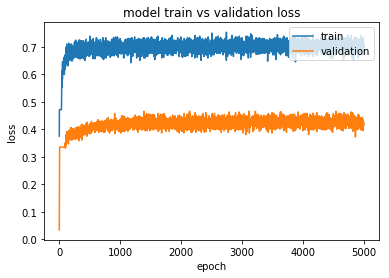

In [85]:
from matplotlib import pyplot
pyplot.plot(history.history['op_feat_accuracy'])
pyplot.plot(history.history['op_bin_accuracy'])
pyplot.title('model train vs validation loss')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

In [51]:
# from keras import backend as K
from tensorflow.keras import losses

def ordinal_loss(y_true, y_pred):
    weights = K.cast(K.abs(K.argmax(y_true, axis=1) - K.argmax(y_pred, axis=1))/(K.int_shape(y_pred)[1] - 1), dtype='float32')
    return (1.0 + weights) * losses.categorical_crossentropy(y_true, y_pred)

In [59]:
## Using ordinal loss
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss=['categorical_crossentropy', ordinal_loss, 'categorical_crossentropy'],
              metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=batch_size,
                    epochs=500, verbose=1, validation_split=0.2)

Train on 352 samples, validate on 89 samples
Epoch 1/500
352/352 [==============================] - 4s 11ms/sample - loss: 9.3873 - op_feat_loss: 1.7528 - op_bin_loss: 6.3168 - op_dir_loss: 1.3103 - op_feat_accuracy: 0.3125 - op_bin_accuracy: 0.0739 - op_dir_accuracy: 0.3011 - val_loss: 9.0333 - val_op_feat_loss: 1.7261 - val_op_bin_loss: 5.9405 - val_op_dir_loss: 1.2467 - val_op_feat_accuracy: 0.3596 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6067
Epoch 2/500
352/352 [==============================] - 0s 708us/sample - loss: 9.1498 - op_feat_loss: 1.6846 - op_bin_loss: 6.1899 - op_dir_loss: 1.2679 - op_feat_accuracy: 0.3580 - op_bin_accuracy: 0.2443 - op_dir_accuracy: 0.3665 - val_loss: 8.8230 - val_op_feat_loss: 1.6770 - val_op_bin_loss: 5.8125 - val_op_dir_loss: 1.2096 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6067
Epoch 3/500
352/352 [==============================] - 0s 564us/sample - loss: 9.0323 - op_feat_loss: 1.6245 - op_

352/352 [==============================] - 0s 566us/sample - loss: 6.0169 - op_feat_loss: 1.1380 - op_bin_loss: 3.9184 - op_dir_loss: 0.9528 - op_feat_accuracy: 0.5199 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.5511 - val_loss: 6.3235 - val_op_feat_loss: 1.3532 - val_op_bin_loss: 3.8969 - val_op_dir_loss: 0.8839 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6966
Epoch 40/500
352/352 [==============================] - 0s 573us/sample - loss: 6.0405 - op_feat_loss: 1.1347 - op_bin_loss: 3.9468 - op_dir_loss: 0.9513 - op_feat_accuracy: 0.5398 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.5568 - val_loss: 6.4811 - val_op_feat_loss: 1.3774 - val_op_bin_loss: 3.8911 - val_op_dir_loss: 1.0700 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.5281
Epoch 41/500
352/352 [==============================] - 0s 595us/sample - loss: 5.9849 - op_feat_loss: 1.1314 - op_bin_loss: 3.8955 - op_dir_loss: 0.9503 - op_feat_accur

352/352 [==============================] - 0s 487us/sample - loss: 5.5213 - op_feat_loss: 0.9844 - op_bin_loss: 3.7105 - op_dir_loss: 0.8188 - op_feat_accuracy: 0.6562 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.6534 - val_loss: 6.2075 - val_op_feat_loss: 1.3747 - val_op_bin_loss: 3.7947 - val_op_dir_loss: 1.0148 - val_op_feat_accuracy: 0.3371 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6742
Epoch 78/500
352/352 [==============================] - 0s 557us/sample - loss: 5.5963 - op_feat_loss: 1.0147 - op_bin_loss: 3.6948 - op_dir_loss: 0.8791 - op_feat_accuracy: 0.6307 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.6193 - val_loss: 5.9034 - val_op_feat_loss: 1.2105 - val_op_bin_loss: 3.7960 - val_op_dir_loss: 0.8424 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 79/500
352/352 [==============================] - 0s 500us/sample - loss: 5.5416 - op_feat_loss: 0.9959 - op_bin_loss: 3.7093 - op_dir_loss: 0.8288 - op_feat_accur

352/352 [==============================] - 0s 564us/sample - loss: 5.3195 - op_feat_loss: 0.9344 - op_bin_loss: 3.6229 - op_dir_loss: 0.7545 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.6932 - val_loss: 5.8198 - val_op_feat_loss: 1.1160 - val_op_bin_loss: 3.7719 - val_op_dir_loss: 0.7360 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7079
Epoch 116/500
352/352 [==============================] - 0s 570us/sample - loss: 5.4055 - op_feat_loss: 0.9834 - op_bin_loss: 3.5940 - op_dir_loss: 0.8204 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.6591 - val_loss: 5.8913 - val_op_feat_loss: 1.2431 - val_op_bin_loss: 3.7776 - val_op_dir_loss: 0.8701 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 117/500
352/352 [==============================] - 0s 521us/sample - loss: 5.3545 - op_feat_loss: 0.9622 - op_bin_loss: 3.6051 - op_dir_loss: 0.7795 - op_feat_acc

352/352 [==============================] - 0s 555us/sample - loss: 4.7899 - op_feat_loss: 0.8741 - op_bin_loss: 3.1839 - op_dir_loss: 0.7241 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.3807 - op_dir_accuracy: 0.7301 - val_loss: 5.8566 - val_op_feat_loss: 1.1755 - val_op_bin_loss: 3.5970 - val_op_dir_loss: 0.7676 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7191
Epoch 154/500
352/352 [==============================] - 0s 576us/sample - loss: 4.8930 - op_feat_loss: 0.9421 - op_bin_loss: 3.1809 - op_dir_loss: 0.7622 - op_feat_accuracy: 0.6619 - op_bin_accuracy: 0.3949 - op_dir_accuracy: 0.6591 - val_loss: 5.5686 - val_op_feat_loss: 1.2698 - val_op_bin_loss: 3.6654 - val_op_dir_loss: 0.8682 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7640
Epoch 155/500
352/352 [==============================] - 0s 589us/sample - loss: 4.9452 - op_feat_loss: 0.8879 - op_bin_loss: 3.3231 - op_dir_loss: 0.7264 - op_feat_acc

352/352 [==============================] - 0s 643us/sample - loss: 4.8286 - op_feat_loss: 0.9256 - op_bin_loss: 3.1566 - op_dir_loss: 0.7386 - op_feat_accuracy: 0.6705 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7017 - val_loss: 5.2913 - val_op_feat_loss: 1.1640 - val_op_bin_loss: 3.3547 - val_op_dir_loss: 0.7820 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7753
Epoch 173/500
352/352 [==============================] - 0s 584us/sample - loss: 4.7677 - op_feat_loss: 0.9152 - op_bin_loss: 3.1348 - op_dir_loss: 0.7100 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.3949 - op_dir_accuracy: 0.7386 - val_loss: 5.5376 - val_op_feat_loss: 1.2173 - val_op_bin_loss: 3.6051 - val_op_dir_loss: 0.8790 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7303
Epoch 174/500
352/352 [==============================] - 0s 626us/sample - loss: 4.8393 - op_feat_loss: 0.8956 - op_bin_loss: 3.1764 - op_dir_loss: 0.7596 - op_feat_acc

352/352 [==============================] - 0s 655us/sample - loss: 4.7538 - op_feat_loss: 0.8573 - op_bin_loss: 3.1379 - op_dir_loss: 0.7508 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.3750 - op_dir_accuracy: 0.7188 - val_loss: 6.0922 - val_op_feat_loss: 1.4180 - val_op_bin_loss: 3.9377 - val_op_dir_loss: 1.0375 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.6742
Epoch 211/500
352/352 [==============================] - 0s 618us/sample - loss: 4.7890 - op_feat_loss: 0.8834 - op_bin_loss: 3.1625 - op_dir_loss: 0.7353 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.3807 - op_dir_accuracy: 0.6903 - val_loss: 5.3084 - val_op_feat_loss: 1.0533 - val_op_bin_loss: 3.4200 - val_op_dir_loss: 0.6269 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 212/500
352/352 [==============================] - 0s 580us/sample - loss: 4.7966 - op_feat_loss: 0.9076 - op_bin_loss: 3.1147 - op_dir_loss: 0.7664 - op_feat_acc

352/352 [==============================] - 0s 507us/sample - loss: 4.7233 - op_feat_loss: 0.8733 - op_bin_loss: 3.1078 - op_dir_loss: 0.7343 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.3807 - op_dir_accuracy: 0.6932 - val_loss: 5.2941 - val_op_feat_loss: 1.1119 - val_op_bin_loss: 3.4961 - val_op_dir_loss: 0.6901 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7191
Epoch 249/500
352/352 [==============================] - 0s 504us/sample - loss: 4.7476 - op_feat_loss: 0.9253 - op_bin_loss: 3.0504 - op_dir_loss: 0.7639 - op_feat_accuracy: 0.6733 - op_bin_accuracy: 0.3920 - op_dir_accuracy: 0.7045 - val_loss: 5.4662 - val_op_feat_loss: 1.1718 - val_op_bin_loss: 3.7334 - val_op_dir_loss: 0.7551 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7753
Epoch 250/500
352/352 [==============================] - 0s 504us/sample - loss: 4.6472 - op_feat_loss: 0.8523 - op_bin_loss: 3.0576 - op_dir_loss: 0.7293 - op_feat_acc

352/352 [==============================] - 0s 496us/sample - loss: 4.4198 - op_feat_loss: 0.8251 - op_bin_loss: 2.9126 - op_dir_loss: 0.6741 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7045 - val_loss: 5.9186 - val_op_feat_loss: 1.3537 - val_op_bin_loss: 3.9801 - val_op_dir_loss: 0.9168 - val_op_feat_accuracy: 0.3596 - val_op_bin_accuracy: 0.2584 - val_op_dir_accuracy: 0.7191
Epoch 287/500
352/352 [==============================] - 0s 527us/sample - loss: 4.6671 - op_feat_loss: 0.8816 - op_bin_loss: 3.0557 - op_dir_loss: 0.7218 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.3807 - op_dir_accuracy: 0.7131 - val_loss: 5.1816 - val_op_feat_loss: 1.0688 - val_op_bin_loss: 3.4111 - val_op_dir_loss: 0.6626 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7753
Epoch 288/500
352/352 [==============================] - 0s 555us/sample - loss: 4.7744 - op_feat_loss: 0.9272 - op_bin_loss: 3.0628 - op_dir_loss: 0.7764 - op_feat_acc

352/352 [==============================] - 0s 554us/sample - loss: 4.6109 - op_feat_loss: 0.8678 - op_bin_loss: 3.0229 - op_dir_loss: 0.7120 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.3864 - op_dir_accuracy: 0.7188 - val_loss: 5.0997 - val_op_feat_loss: 1.0179 - val_op_bin_loss: 3.4515 - val_op_dir_loss: 0.5907 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.8315
Epoch 325/500
352/352 [==============================] - 0s 572us/sample - loss: 4.4421 - op_feat_loss: 0.8145 - op_bin_loss: 2.9592 - op_dir_loss: 0.6603 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7330 - val_loss: 5.3040 - val_op_feat_loss: 1.0739 - val_op_bin_loss: 3.7495 - val_op_dir_loss: 0.6373 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.8315
Epoch 326/500
352/352 [==============================] - 0s 518us/sample - loss: 4.7769 - op_feat_loss: 0.9041 - op_bin_loss: 3.1013 - op_dir_loss: 0.7632 - op_feat_acc

352/352 [==============================] - 0s 575us/sample - loss: 4.4866 - op_feat_loss: 0.8242 - op_bin_loss: 2.9769 - op_dir_loss: 0.6772 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.3949 - op_dir_accuracy: 0.7358 - val_loss: 5.3697 - val_op_feat_loss: 1.1079 - val_op_bin_loss: 3.5636 - val_op_dir_loss: 0.6931 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7640
Epoch 363/500
352/352 [==============================] - 0s 561us/sample - loss: 4.6778 - op_feat_loss: 0.8761 - op_bin_loss: 3.0550 - op_dir_loss: 0.7384 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.3949 - op_dir_accuracy: 0.6960 - val_loss: 5.3616 - val_op_feat_loss: 1.0902 - val_op_bin_loss: 3.6380 - val_op_dir_loss: 0.6434 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7978
Epoch 364/500
352/352 [==============================] - 0s 540us/sample - loss: 4.4544 - op_feat_loss: 0.8174 - op_bin_loss: 2.9306 - op_dir_loss: 0.6981 - op_feat_acc

352/352 [==============================] - 0s 623us/sample - loss: 4.4504 - op_feat_loss: 0.8387 - op_bin_loss: 2.9244 - op_dir_loss: 0.6789 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.7273 - val_loss: 5.2707 - val_op_feat_loss: 1.0658 - val_op_bin_loss: 3.5421 - val_op_dir_loss: 0.6513 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7753
Epoch 401/500
352/352 [==============================] - 0s 592us/sample - loss: 4.5775 - op_feat_loss: 0.8649 - op_bin_loss: 3.0085 - op_dir_loss: 0.6956 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.3977 - op_dir_accuracy: 0.7102 - val_loss: 5.4130 - val_op_feat_loss: 1.0955 - val_op_bin_loss: 3.6679 - val_op_dir_loss: 0.6566 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7978
Epoch 402/500
352/352 [==============================] - 0s 570us/sample - loss: 4.3914 - op_feat_loss: 0.8102 - op_bin_loss: 2.8983 - op_dir_loss: 0.6745 - op_feat_acc

352/352 [==============================] - 0s 606us/sample - loss: 4.3920 - op_feat_loss: 0.8128 - op_bin_loss: 2.9164 - op_dir_loss: 0.6543 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.7500 - val_loss: 5.1687 - val_op_feat_loss: 1.0236 - val_op_bin_loss: 3.4489 - val_op_dir_loss: 0.6263 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 439/500
352/352 [==============================] - 0s 538us/sample - loss: 4.4170 - op_feat_loss: 0.8075 - op_bin_loss: 2.9499 - op_dir_loss: 0.6511 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4034 - op_dir_accuracy: 0.7443 - val_loss: 5.1921 - val_op_feat_loss: 1.0164 - val_op_bin_loss: 3.4396 - val_op_dir_loss: 0.6344 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 440/500
352/352 [==============================] - 0s 538us/sample - loss: 4.5120 - op_feat_loss: 0.8400 - op_bin_loss: 2.9750 - op_dir_loss: 0.6885 - op_feat_acc

352/352 [==============================] - 0s 513us/sample - loss: 4.4331 - op_feat_loss: 0.8037 - op_bin_loss: 2.9239 - op_dir_loss: 0.6970 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.3977 - op_dir_accuracy: 0.7045 - val_loss: 5.1935 - val_op_feat_loss: 1.0093 - val_op_bin_loss: 3.5239 - val_op_dir_loss: 0.5840 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8090
Epoch 477/500
352/352 [==============================] - 0s 565us/sample - loss: 4.4808 - op_feat_loss: 0.8518 - op_bin_loss: 2.9157 - op_dir_loss: 0.7047 - op_feat_accuracy: 0.6705 - op_bin_accuracy: 0.3977 - op_dir_accuracy: 0.7045 - val_loss: 5.1510 - val_op_feat_loss: 1.0306 - val_op_bin_loss: 3.4305 - val_op_dir_loss: 0.6201 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7303
Epoch 478/500
352/352 [==============================] - 0s 541us/sample - loss: 4.5665 - op_feat_loss: 0.8650 - op_bin_loss: 2.9779 - op_dir_loss: 0.7150 - op_feat_acc

In [50]:
## Using cat loss
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy',
              metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=batch_size,
                    epochs=500, verbose=1, validation_split=0.2)

Train on 352 samples, validate on 89 samples
Epoch 1/500
352/352 [==============================] - 5s 13ms/sample - loss: 7.6286 - op_feat_loss: 1.7461 - op_bin_loss: 4.4839 - op_dir_loss: 1.3911 - op_feat_accuracy: 0.4744 - op_bin_accuracy: 0.1420 - op_dir_accuracy: 0.2443 - val_loss: 7.5516 - val_op_feat_loss: 1.7376 - val_op_bin_loss: 4.4148 - val_op_dir_loss: 1.3770 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.3483
Epoch 2/500
352/352 [==============================] - 0s 595us/sample - loss: 7.4231 - op_feat_loss: 1.6791 - op_bin_loss: 4.3784 - op_dir_loss: 1.3581 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.2898 - op_dir_accuracy: 0.2841 - val_loss: 7.3867 - val_op_feat_loss: 1.6888 - val_op_bin_loss: 4.3154 - val_op_dir_loss: 1.3592 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.3483
Epoch 3/500
352/352 [==============================] - 0s 543us/sample - loss: 7.2184 - op_feat_loss: 1.6191 - op_

352/352 [==============================] - 0s 518us/sample - loss: 4.7525 - op_feat_loss: 1.1224 - op_bin_loss: 2.6896 - op_dir_loss: 0.9326 - op_feat_accuracy: 0.4943 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.5710 - val_loss: 4.9359 - val_op_feat_loss: 1.3149 - val_op_bin_loss: 2.7551 - val_op_dir_loss: 0.8310 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8090
Epoch 40/500
352/352 [==============================] - 0s 575us/sample - loss: 4.7055 - op_feat_loss: 1.1140 - op_bin_loss: 2.6896 - op_dir_loss: 0.8940 - op_feat_accuracy: 0.5312 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.5966 - val_loss: 4.8918 - val_op_feat_loss: 1.3073 - val_op_bin_loss: 2.7476 - val_op_dir_loss: 0.8018 - val_op_feat_accuracy: 0.2697 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8315
Epoch 41/500
352/352 [==============================] - 0s 522us/sample - loss: 4.6897 - op_feat_loss: 1.1123 - op_bin_loss: 2.6478 - op_dir_loss: 0.9217 - op_feat_accur

352/352 [==============================] - 0s 561us/sample - loss: 4.3515 - op_feat_loss: 0.9901 - op_bin_loss: 2.5293 - op_dir_loss: 0.8240 - op_feat_accuracy: 0.6136 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.6591 - val_loss: 4.7411 - val_op_feat_loss: 1.2565 - val_op_bin_loss: 2.6712 - val_op_dir_loss: 0.8390 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 78/500
352/352 [==============================] - 0s 513us/sample - loss: 4.3806 - op_feat_loss: 1.0117 - op_bin_loss: 2.5162 - op_dir_loss: 0.8446 - op_feat_accuracy: 0.6136 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.6108 - val_loss: 5.0127 - val_op_feat_loss: 1.4071 - val_op_bin_loss: 2.6709 - val_op_dir_loss: 0.9899 - val_op_feat_accuracy: 0.3258 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6517
Epoch 79/500
352/352 [==============================] - 0s 527us/sample - loss: 4.2526 - op_feat_loss: 0.9285 - op_bin_loss: 2.5282 - op_dir_loss: 0.7878 - op_feat_accur

352/352 [==============================] - 0s 511us/sample - loss: 4.1563 - op_feat_loss: 0.9773 - op_bin_loss: 2.3633 - op_dir_loss: 0.8075 - op_feat_accuracy: 0.6364 - op_bin_accuracy: 0.3580 - op_dir_accuracy: 0.6648 - val_loss: 4.4942 - val_op_feat_loss: 1.1888 - val_op_bin_loss: 2.5787 - val_op_dir_loss: 0.7625 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 116/500
352/352 [==============================] - 0s 583us/sample - loss: 4.1177 - op_feat_loss: 0.9610 - op_bin_loss: 2.3611 - op_dir_loss: 0.7875 - op_feat_accuracy: 0.6364 - op_bin_accuracy: 0.3722 - op_dir_accuracy: 0.6733 - val_loss: 4.6987 - val_op_feat_loss: 1.3243 - val_op_bin_loss: 2.6033 - val_op_dir_loss: 0.8794 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 117/500
352/352 [==============================] - 0s 516us/sample - loss: 4.0890 - op_feat_loss: 0.9437 - op_bin_loss: 2.3662 - op_dir_loss: 0.7709 - op_feat_acc

352/352 [==============================] - 0s 513us/sample - loss: 3.9768 - op_feat_loss: 0.9161 - op_bin_loss: 2.2739 - op_dir_loss: 0.7787 - op_feat_accuracy: 0.6733 - op_bin_accuracy: 0.3580 - op_dir_accuracy: 0.6108 - val_loss: 4.9330 - val_op_feat_loss: 1.2807 - val_op_bin_loss: 2.5693 - val_op_dir_loss: 1.1038 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.4045
Epoch 154/500
352/352 [==============================] - 0s 501us/sample - loss: 3.9813 - op_feat_loss: 0.9547 - op_bin_loss: 2.2514 - op_dir_loss: 0.7670 - op_feat_accuracy: 0.6420 - op_bin_accuracy: 0.3665 - op_dir_accuracy: 0.6761 - val_loss: 4.3480 - val_op_feat_loss: 1.0632 - val_op_bin_loss: 2.4820 - val_op_dir_loss: 0.6628 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7079
Epoch 155/500
352/352 [==============================] - 0s 535us/sample - loss: 4.1030 - op_feat_loss: 0.9781 - op_bin_loss: 2.3031 - op_dir_loss: 0.8137 - op_feat_acc

352/352 [==============================] - 0s 550us/sample - loss: 3.8864 - op_feat_loss: 0.9220 - op_bin_loss: 2.1907 - op_dir_loss: 0.7656 - op_feat_accuracy: 0.6619 - op_bin_accuracy: 0.3949 - op_dir_accuracy: 0.6790 - val_loss: 4.6168 - val_op_feat_loss: 1.3076 - val_op_bin_loss: 2.6518 - val_op_dir_loss: 0.8677 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.7640
Epoch 192/500
352/352 [==============================] - 0s 555us/sample - loss: 3.8020 - op_feat_loss: 0.8674 - op_bin_loss: 2.2106 - op_dir_loss: 0.7159 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.3608 - op_dir_accuracy: 0.6960 - val_loss: 4.4248 - val_op_feat_loss: 1.2240 - val_op_bin_loss: 2.6175 - val_op_dir_loss: 0.7559 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7865
Epoch 193/500
352/352 [==============================] - 0s 527us/sample - loss: 4.1083 - op_feat_loss: 0.9670 - op_bin_loss: 2.2844 - op_dir_loss: 0.8487 - op_feat_acc

352/352 [==============================] - 0s 569us/sample - loss: 3.8880 - op_feat_loss: 0.8923 - op_bin_loss: 2.2460 - op_dir_loss: 0.7415 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.3551 - op_dir_accuracy: 0.6989 - val_loss: 4.6143 - val_op_feat_loss: 1.1260 - val_op_bin_loss: 2.5485 - val_op_dir_loss: 0.7610 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6854
Epoch 230/500
352/352 [==============================] - 0s 482us/sample - loss: 3.7900 - op_feat_loss: 0.8655 - op_bin_loss: 2.1972 - op_dir_loss: 0.7191 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.3892 - op_dir_accuracy: 0.7017 - val_loss: 4.2934 - val_op_feat_loss: 1.0586 - val_op_bin_loss: 2.5455 - val_op_dir_loss: 0.6059 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8202
Epoch 231/500
352/352 [==============================] - 0s 551us/sample - loss: 3.8076 - op_feat_loss: 0.8870 - op_bin_loss: 2.1682 - op_dir_loss: 0.7443 - op_feat_acc

352/352 [==============================] - 0s 530us/sample - loss: 3.8300 - op_feat_loss: 0.8898 - op_bin_loss: 2.2038 - op_dir_loss: 0.7281 - op_feat_accuracy: 0.6591 - op_bin_accuracy: 0.3920 - op_dir_accuracy: 0.6818 - val_loss: 4.3406 - val_op_feat_loss: 1.1233 - val_op_bin_loss: 2.6453 - val_op_dir_loss: 0.6719 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7528
Epoch 268/500
352/352 [==============================] - 0s 530us/sample - loss: 3.6937 - op_feat_loss: 0.8410 - op_bin_loss: 2.1758 - op_dir_loss: 0.6686 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.3920 - op_dir_accuracy: 0.7102 - val_loss: 4.3894 - val_op_feat_loss: 1.1715 - val_op_bin_loss: 2.6742 - val_op_dir_loss: 0.7017 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7303
Epoch 269/500
352/352 [==============================] - 0s 525us/sample - loss: 3.7685 - op_feat_loss: 0.8558 - op_bin_loss: 2.2134 - op_dir_loss: 0.6911 - op_feat_acc

352/352 [==============================] - 0s 493us/sample - loss: 3.6829 - op_feat_loss: 0.8589 - op_bin_loss: 2.1425 - op_dir_loss: 0.6731 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.3920 - op_dir_accuracy: 0.7159 - val_loss: 4.5266 - val_op_feat_loss: 1.0888 - val_op_bin_loss: 2.5906 - val_op_dir_loss: 0.7256 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7191
Epoch 306/500
352/352 [==============================] - 0s 525us/sample - loss: 3.7120 - op_feat_loss: 0.8707 - op_bin_loss: 2.1309 - op_dir_loss: 0.7021 - op_feat_accuracy: 0.6705 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.6932 - val_loss: 4.4584 - val_op_feat_loss: 1.1900 - val_op_bin_loss: 2.7228 - val_op_dir_loss: 0.7322 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7528
Epoch 307/500
352/352 [==============================] - 0s 560us/sample - loss: 3.7340 - op_feat_loss: 0.8626 - op_bin_loss: 2.1555 - op_dir_loss: 0.7076 - op_feat_acc

352/352 [==============================] - 0s 525us/sample - loss: 3.7879 - op_feat_loss: 0.8601 - op_bin_loss: 2.1783 - op_dir_loss: 0.7411 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.3722 - op_dir_accuracy: 0.6761 - val_loss: 4.6458 - val_op_feat_loss: 1.1394 - val_op_bin_loss: 2.6911 - val_op_dir_loss: 0.8546 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.6966
Epoch 344/500
352/352 [==============================] - 0s 555us/sample - loss: 3.6599 - op_feat_loss: 0.8503 - op_bin_loss: 2.1015 - op_dir_loss: 0.6997 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.3892 - op_dir_accuracy: 0.6932 - val_loss: 4.3921 - val_op_feat_loss: 1.1225 - val_op_bin_loss: 2.7078 - val_op_dir_loss: 0.6442 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7753
Epoch 345/500
352/352 [==============================] - 0s 513us/sample - loss: 3.6319 - op_feat_loss: 0.8256 - op_bin_loss: 2.1091 - op_dir_loss: 0.6888 - op_feat_acc

352/352 [==============================] - 0s 511us/sample - loss: 3.6395 - op_feat_loss: 0.8408 - op_bin_loss: 2.1220 - op_dir_loss: 0.6683 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.3920 - op_dir_accuracy: 0.7102 - val_loss: 4.3571 - val_op_feat_loss: 1.0666 - val_op_bin_loss: 2.7077 - val_op_dir_loss: 0.6264 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7640
Epoch 382/500
352/352 [==============================] - 0s 539us/sample - loss: 3.7336 - op_feat_loss: 0.8595 - op_bin_loss: 2.1224 - op_dir_loss: 0.7433 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.6733 - val_loss: 4.7666 - val_op_feat_loss: 1.2746 - val_op_bin_loss: 2.8592 - val_op_dir_loss: 0.8527 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.7416
Epoch 383/500
352/352 [==============================] - 0s 558us/sample - loss: 3.6558 - op_feat_loss: 0.8187 - op_bin_loss: 2.1129 - op_dir_loss: 0.7159 - op_feat_acc

352/352 [==============================] - 0s 557us/sample - loss: 3.7549 - op_feat_loss: 0.8704 - op_bin_loss: 2.1553 - op_dir_loss: 0.7208 - op_feat_accuracy: 0.6619 - op_bin_accuracy: 0.3807 - op_dir_accuracy: 0.6676 - val_loss: 4.5065 - val_op_feat_loss: 1.1676 - val_op_bin_loss: 2.7926 - val_op_dir_loss: 0.6847 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7753
Epoch 420/500
352/352 [==============================] - 0s 538us/sample - loss: 3.6421 - op_feat_loss: 0.8484 - op_bin_loss: 2.0889 - op_dir_loss: 0.6964 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7074 - val_loss: 4.5757 - val_op_feat_loss: 1.1823 - val_op_bin_loss: 2.8097 - val_op_dir_loss: 0.7188 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7640
Epoch 421/500
352/352 [==============================] - 0s 518us/sample - loss: 3.6269 - op_feat_loss: 0.8221 - op_bin_loss: 2.1147 - op_dir_loss: 0.6817 - op_feat_acc

352/352 [==============================] - 0s 524us/sample - loss: 3.7019 - op_feat_loss: 0.8758 - op_bin_loss: 2.1102 - op_dir_loss: 0.7074 - op_feat_accuracy: 0.6506 - op_bin_accuracy: 0.3864 - op_dir_accuracy: 0.6790 - val_loss: 4.6349 - val_op_feat_loss: 1.1539 - val_op_bin_loss: 2.7815 - val_op_dir_loss: 0.7922 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7191
Epoch 458/500
352/352 [==============================] - 0s 527us/sample - loss: 3.5223 - op_feat_loss: 0.7817 - op_bin_loss: 2.0457 - op_dir_loss: 0.6864 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.6847 - val_loss: 4.6528 - val_op_feat_loss: 1.1255 - val_op_bin_loss: 2.7501 - val_op_dir_loss: 0.7915 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7191
Epoch 459/500
352/352 [==============================] - 0s 512us/sample - loss: 3.5776 - op_feat_loss: 0.8078 - op_bin_loss: 2.0700 - op_dir_loss: 0.6913 - op_feat_acc

352/352 [==============================] - 0s 538us/sample - loss: 3.4548 - op_feat_loss: 0.8041 - op_bin_loss: 2.0238 - op_dir_loss: 0.6184 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7330 - val_loss: 4.9157 - val_op_feat_loss: 1.3676 - val_op_bin_loss: 2.9683 - val_op_dir_loss: 0.8959 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2584 - val_op_dir_accuracy: 0.7753
Epoch 496/500
352/352 [==============================] - 0s 539us/sample - loss: 3.6188 - op_feat_loss: 0.8280 - op_bin_loss: 2.0822 - op_dir_loss: 0.7001 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.3807 - op_dir_accuracy: 0.6790 - val_loss: 4.3836 - val_op_feat_loss: 1.0539 - val_op_bin_loss: 2.6857 - val_op_dir_loss: 0.6246 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 497/500
352/352 [==============================] - 0s 510us/sample - loss: 3.4913 - op_feat_loss: 0.8063 - op_bin_loss: 2.0395 - op_dir_loss: 0.6371 - op_feat_acc

In [132]:
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

sgd = SGD(lr=0.0001, clipvalue=0.5)
test_model.compile(optimizer=sgd, loss=['categorical_crossentropy',my_filtered_mse, 'categorical_crossentropy'],
              metrics=['accuracy'])
history = test_model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin_regression, y_dir],batch_size=batch_size,
                    epochs=500, verbose=1, validation_split=0.2)
#           callbacks=[WandbCallback()])

Train on 352 samples, validate on 89 samples
Epoch 1/500
352/352 [==============================] - 42s 119ms/sample - loss: 13.0974 - op_feat_loss: 1.7858 - op_bin_loss: 9.9179 - op_dir_loss: 1.3874 - op_feat_accuracy: 0.1420 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.2102 - val_loss: nan - val_op_feat_loss: 1.7687 - val_op_bin_loss: nan - val_op_dir_loss: 1.3864 - val_op_feat_accuracy: 0.3483 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.2697
Epoch 2/500
352/352 [==============================] - 0s 799us/sample - loss: 12.6917 - op_feat_loss: 1.7864 - op_bin_loss: 9.5105 - op_dir_loss: 1.3885 - op_feat_accuracy: 0.1420 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.2159 - val_loss: nan - val_op_feat_loss: 1.7684 - val_op_bin_loss: nan - val_op_dir_loss: 1.3913 - val_op_feat_accuracy: 0.3483 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.2022
Epoch 3/500
352/352 [==============================] - 0s 621us/sample - loss: 11.7815 - op_feat_loss: 1.7878 - op_bin_los

352/352 [==============================] - 0s 594us/sample - loss: 6.3236 - op_feat_loss: 1.7364 - op_bin_loss: 3.2067 - op_dir_loss: 1.3743 - op_feat_accuracy: 0.2472 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3494 - val_loss: nan - val_op_feat_loss: 1.7467 - val_op_bin_loss: nan - val_op_dir_loss: 1.3813 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0562
Epoch 40/500
352/352 [==============================] - 0s 623us/sample - loss: 6.1015 - op_feat_loss: 1.7442 - op_bin_loss: 2.9771 - op_dir_loss: 1.3739 - op_feat_accuracy: 0.2159 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3551 - val_loss: nan - val_op_feat_loss: 1.7463 - val_op_bin_loss: nan - val_op_dir_loss: 1.3820 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0337
Epoch 41/500
352/352 [==============================] - 0s 618us/sample - loss: 5.8410 - op_feat_loss: 1.7404 - op_bin_loss: 2.7198 - op_dir_loss: 1.3746 - op_feat_a

352/352 [==============================] - 0s 590us/sample - loss: 5.9608 - op_feat_loss: 1.7118 - op_bin_loss: 2.8806 - op_dir_loss: 1.3622 - op_feat_accuracy: 0.3324 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3636 - val_loss: nan - val_op_feat_loss: 1.7262 - val_op_bin_loss: nan - val_op_dir_loss: 1.3742 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0337
Epoch 78/500
352/352 [==============================] - 0s 577us/sample - loss: 6.0195 - op_feat_loss: 1.7091 - op_bin_loss: 2.9427 - op_dir_loss: 1.3614 - op_feat_accuracy: 0.3381 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3438 - val_loss: nan - val_op_feat_loss: 1.7254 - val_op_bin_loss: nan - val_op_dir_loss: 1.3725 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0337
Epoch 79/500
352/352 [==============================] - 0s 640us/sample - loss: 5.6539 - op_feat_loss: 1.7131 - op_bin_loss: 2.5760 - op_dir_loss: 1.3585 - op_feat_a

352/352 [==============================] - 0s 628us/sample - loss: 5.9965 - op_feat_loss: 1.6896 - op_bin_loss: 2.9532 - op_dir_loss: 1.3474 - op_feat_accuracy: 0.3494 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3722 - val_loss: nan - val_op_feat_loss: 1.7075 - val_op_bin_loss: nan - val_op_dir_loss: 1.3648 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 116/500
352/352 [==============================] - 0s 604us/sample - loss: 5.7705 - op_feat_loss: 1.6866 - op_bin_loss: 2.7284 - op_dir_loss: 1.3492 - op_feat_accuracy: 0.3239 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3551 - val_loss: nan - val_op_feat_loss: 1.7070 - val_op_bin_loss: nan - val_op_dir_loss: 1.3662 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 117/500
352/352 [==============================] - 0s 592us/sample - loss: nan - op_feat_loss: 1.6798 - op_bin_loss: nan - op_dir_loss: 1.3466 - op_feat_accur

352/352 [==============================] - 0s 640us/sample - loss: 5.4114 - op_feat_loss: 1.6615 - op_bin_loss: 2.4076 - op_dir_loss: 1.3361 - op_feat_accuracy: 0.4034 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3807 - val_loss: nan - val_op_feat_loss: 1.6897 - val_op_bin_loss: nan - val_op_dir_loss: 1.3614 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 154/500
352/352 [==============================] - 0s 562us/sample - loss: 5.8827 - op_feat_loss: 1.6636 - op_bin_loss: 2.8758 - op_dir_loss: 1.3371 - op_feat_accuracy: 0.4062 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3835 - val_loss: nan - val_op_feat_loss: 1.6893 - val_op_bin_loss: nan - val_op_dir_loss: 1.3570 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 155/500
352/352 [==============================] - 0s 666us/sample - loss: 6.3493 - op_feat_loss: 1.6574 - op_bin_loss: 3.3498 - op_dir_loss: 1.3359 - op_feat

352/352 [==============================] - 0s 595us/sample - loss: 5.6837 - op_feat_loss: 1.6308 - op_bin_loss: 2.7195 - op_dir_loss: 1.3271 - op_feat_accuracy: 0.4432 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3892 - val_loss: nan - val_op_feat_loss: 1.6738 - val_op_bin_loss: nan - val_op_dir_loss: 1.3550 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 192/500
352/352 [==============================] - 0s 588us/sample - loss: 6.1322 - op_feat_loss: 1.6402 - op_bin_loss: 3.1601 - op_dir_loss: 1.3255 - op_feat_accuracy: 0.4261 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3778 - val_loss: nan - val_op_feat_loss: 1.6735 - val_op_bin_loss: nan - val_op_dir_loss: 1.3489 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 193/500
352/352 [==============================] - 0s 618us/sample - loss: 5.9640 - op_feat_loss: 1.6238 - op_bin_loss: 3.0075 - op_dir_loss: 1.3264 - op_feat

352/352 [==============================] - 0s 606us/sample - loss: 5.6708 - op_feat_loss: 1.6068 - op_bin_loss: 2.7418 - op_dir_loss: 1.3159 - op_feat_accuracy: 0.4602 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3835 - val_loss: nan - val_op_feat_loss: 1.6589 - val_op_bin_loss: nan - val_op_dir_loss: 1.3495 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 230/500
352/352 [==============================] - 0s 599us/sample - loss: 6.0738 - op_feat_loss: 1.6090 - op_bin_loss: 3.1421 - op_dir_loss: 1.3164 - op_feat_accuracy: 0.4403 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3693 - val_loss: nan - val_op_feat_loss: 1.6588 - val_op_bin_loss: nan - val_op_dir_loss: 1.3470 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 231/500
352/352 [==============================] - 0s 598us/sample - loss: 5.8381 - op_feat_loss: 1.6126 - op_bin_loss: 2.9029 - op_dir_loss: 1.3163 - op_feat

352/352 [==============================] - 0s 558us/sample - loss: 5.9780 - op_feat_loss: 1.5845 - op_bin_loss: 3.0795 - op_dir_loss: 1.3077 - op_feat_accuracy: 0.4688 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3693 - val_loss: nan - val_op_feat_loss: 1.6455 - val_op_bin_loss: nan - val_op_dir_loss: 1.3429 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 268/500
352/352 [==============================] - 0s 626us/sample - loss: 5.8474 - op_feat_loss: 1.5876 - op_bin_loss: 2.9463 - op_dir_loss: 1.3072 - op_feat_accuracy: 0.4545 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3864 - val_loss: nan - val_op_feat_loss: 1.6452 - val_op_bin_loss: nan - val_op_dir_loss: 1.3406 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 269/500
352/352 [==============================] - 0s 587us/sample - loss: 5.7167 - op_feat_loss: 1.5896 - op_bin_loss: 2.8151 - op_dir_loss: 1.3058 - op_feat

352/352 [==============================] - 0s 602us/sample - loss: 5.6874 - op_feat_loss: 1.5624 - op_bin_loss: 2.8205 - op_dir_loss: 1.2983 - op_feat_accuracy: 0.4773 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3807 - val_loss: nan - val_op_feat_loss: 1.6333 - val_op_bin_loss: nan - val_op_dir_loss: 1.3380 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 306/500
352/352 [==============================] - 0s 630us/sample - loss: 5.3414 - op_feat_loss: 1.5634 - op_bin_loss: 2.4730 - op_dir_loss: 1.2987 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3835 - val_loss: nan - val_op_feat_loss: 1.6330 - val_op_bin_loss: nan - val_op_dir_loss: 1.3342 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 307/500
352/352 [==============================] - 0s 609us/sample - loss: 5.4377 - op_feat_loss: 1.5592 - op_bin_loss: 2.5729 - op_dir_loss: 1.2993 - op_feat

352/352 [==============================] - 0s 580us/sample - loss: 5.9233 - op_feat_loss: 1.5455 - op_bin_loss: 3.0796 - op_dir_loss: 1.2920 - op_feat_accuracy: 0.4659 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3807 - val_loss: nan - val_op_feat_loss: 1.6216 - val_op_bin_loss: nan - val_op_dir_loss: 1.3315 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 344/500
352/352 [==============================] - 0s 621us/sample - loss: 5.8651 - op_feat_loss: 1.5471 - op_bin_loss: 3.0202 - op_dir_loss: 1.2915 - op_feat_accuracy: 0.4688 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3835 - val_loss: nan - val_op_feat_loss: 1.6215 - val_op_bin_loss: nan - val_op_dir_loss: 1.3341 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 345/500
352/352 [==============================] - 0s 577us/sample - loss: 5.5284 - op_feat_loss: 1.5458 - op_bin_loss: 2.6858 - op_dir_loss: 1.2906 - op_feat

352/352 [==============================] - 0s 600us/sample - loss: 6.1028 - op_feat_loss: 1.5254 - op_bin_loss: 3.2889 - op_dir_loss: 1.2822 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3807 - val_loss: nan - val_op_feat_loss: 1.6113 - val_op_bin_loss: nan - val_op_dir_loss: 1.3300 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 382/500
352/352 [==============================] - 0s 599us/sample - loss: 5.5033 - op_feat_loss: 1.5269 - op_bin_loss: 2.6870 - op_dir_loss: 1.2831 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3807 - val_loss: nan - val_op_feat_loss: 1.6113 - val_op_bin_loss: nan - val_op_dir_loss: 1.3277 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 383/500
352/352 [==============================] - 0s 542us/sample - loss: 5.5578 - op_feat_loss: 1.5259 - op_bin_loss: 2.7427 - op_dir_loss: 1.2829 - op_feat

352/352 [==============================] - 0s 549us/sample - loss: 5.6279 - op_feat_loss: 1.5185 - op_bin_loss: 2.8254 - op_dir_loss: 1.2776 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3807 - val_loss: nan - val_op_feat_loss: 1.6018 - val_op_bin_loss: nan - val_op_dir_loss: 1.3238 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 420/500
352/352 [==============================] - 0s 655us/sample - loss: 6.0037 - op_feat_loss: 1.5134 - op_bin_loss: 3.2077 - op_dir_loss: 1.2763 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3778 - val_loss: nan - val_op_feat_loss: 1.6013 - val_op_bin_loss: nan - val_op_dir_loss: 1.3245 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 421/500
352/352 [==============================] - 0s 587us/sample - loss: 5.3727 - op_feat_loss: 1.5168 - op_bin_loss: 2.5729 - op_dir_loss: 1.2767 - op_feat

352/352 [==============================] - 0s 618us/sample - loss: 5.4570 - op_feat_loss: 1.4888 - op_bin_loss: 2.6909 - op_dir_loss: 1.2711 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3807 - val_loss: nan - val_op_feat_loss: 1.5930 - val_op_bin_loss: nan - val_op_dir_loss: 1.3202 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 458/500
352/352 [==============================] - 0s 595us/sample - loss: 6.1211 - op_feat_loss: 1.4917 - op_bin_loss: 3.3532 - op_dir_loss: 1.2699 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3835 - val_loss: nan - val_op_feat_loss: 1.5927 - val_op_bin_loss: nan - val_op_dir_loss: 1.3184 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 459/500
352/352 [==============================] - 0s 609us/sample - loss: 5.8172 - op_feat_loss: 1.4859 - op_bin_loss: 3.0554 - op_dir_loss: 1.2698 - op_feat

352/352 [==============================] - 0s 656us/sample - loss: 5.6494 - op_feat_loss: 1.4795 - op_bin_loss: 2.8996 - op_dir_loss: 1.2640 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3835 - val_loss: nan - val_op_feat_loss: 1.5849 - val_op_bin_loss: nan - val_op_dir_loss: 1.3196 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 496/500
352/352 [==============================] - 0s 577us/sample - loss: 5.9015 - op_feat_loss: 1.4806 - op_bin_loss: 3.1512 - op_dir_loss: 1.2634 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3807 - val_loss: nan - val_op_feat_loss: 1.5848 - val_op_bin_loss: nan - val_op_dir_loss: 1.3179 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 497/500
352/352 [==============================] - 0s 621us/sample - loss: 5.8525 - op_feat_loss: 1.4762 - op_bin_loss: 3.1060 - op_dir_loss: 1.2640 - op_feat

In [316]:
## with batch normalization, multiple dropouts
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

sgd = SGD(lr=0.01)
model.compile(optimizer=sgd, loss=['categorical_crossentropy','mse', 'categorical_crossentropy'],
              metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin_regression, y_dir],batch_size=batch_size,
                    epochs=20000, verbose=1, validation_split=0.2,
          callbacks=[WandbCallback()])

Train on 352 samples, validate on 89 samples
Epoch 1/20000


wandb: Wandb version 0.8.32 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


  8/352 [..............................] - ETA: 12:53 - loss: 13.8038 - op_feat_loss: 1.7118 - op_bin_loss: 10.6947 - op_dir_loss: 1.3914 - op_feat_accuracy: 0.0000e+00 - op_bin_accuracy: 0.2500 - op_dir_accuracy: 0.1250

W0416 16:50:55.865993  9724 callbacks.py:244] Method (on_train_batch_end) is slow compared to the batch update (2.245366). Check your callbacks.


352/352 [==============================] - 22s 63ms/sample - loss: 7.3856 - op_feat_loss: 1.7067 - op_bin_loss: 4.3040 - op_dir_loss: 1.3687 - op_feat_accuracy: 0.2557 - op_bin_accuracy: 0.0312 - op_dir_accuracy: 0.3125 - val_loss: 7.0926 - val_op_feat_loss: 1.6823 - val_op_bin_loss: 4.1642 - val_op_dir_loss: 1.3471 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.6067
Epoch 2/20000
352/352 [==============================] - 1s 3ms/sample - loss: 6.5780 - op_feat_loss: 1.6353 - op_bin_loss: 3.5995 - op_dir_loss: 1.3370 - op_feat_accuracy: 0.3892 - op_bin_accuracy: 0.0000e+00 - op_dir_accuracy: 0.3523 - val_loss: 6.9657 - val_op_feat_loss: 1.6409 - val_op_bin_loss: 4.0500 - val_op_dir_loss: 1.3296 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 3/20000
352/352 [==============================] - 0s 1ms/sample - loss: 6.4436 - op_feat_loss: 1.5679 - op_bin_loss: 3.5588 - op_dir_loss: 1.3107 - op_

Epoch 39/20000
352/352 [==============================] - 0s 1ms/sample - loss: 5.2852 - op_feat_loss: 1.2100 - op_bin_loss: 2.9621 - op_dir_loss: 1.1067 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0455 - op_dir_accuracy: 0.4403 - val_loss: 6.4129 - val_op_feat_loss: 1.4253 - val_op_bin_loss: 3.9766 - val_op_dir_loss: 1.2158 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 40/20000
352/352 [==============================] - 1s 2ms/sample - loss: 5.3661 - op_feat_loss: 1.2149 - op_bin_loss: 3.0387 - op_dir_loss: 1.1060 - op_feat_accuracy: 0.4744 - op_bin_accuracy: 0.0455 - op_dir_accuracy: 0.4432 - val_loss: 6.1312 - val_op_feat_loss: 1.4235 - val_op_bin_loss: 3.6152 - val_op_dir_loss: 1.2055 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0112
Epoch 41/20000
352/352 [==============================] - 0s 1ms/sample - loss: 5.4320 - op_feat_loss: 1.2216 - op_bin_loss: 3.0938 - op_dir_loss: 1

352/352 [==============================] - 1s 3ms/sample - loss: 4.8343 - op_feat_loss: 1.2019 - op_bin_loss: 2.5754 - op_dir_loss: 1.0503 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0653 - op_dir_accuracy: 0.4915 - val_loss: 5.6882 - val_op_feat_loss: 1.3903 - val_op_bin_loss: 3.3309 - val_op_dir_loss: 1.1733 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.0787
Epoch 78/20000
352/352 [==============================] - 1s 4ms/sample - loss: 4.8796 - op_feat_loss: 1.1981 - op_bin_loss: 2.6262 - op_dir_loss: 1.0486 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0597 - op_dir_accuracy: 0.5142 - val_loss: 5.5458 - val_op_feat_loss: 1.3898 - val_op_bin_loss: 3.1883 - val_op_dir_loss: 1.1666 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.2135
Epoch 79/20000
352/352 [==============================] - 1s 3ms/sample - loss: 4.8088 - op_feat_loss: 1.2037 - op_bin_loss: 2.5600 - op_dir_loss: 1.0385 - op_feat

352/352 [==============================] - 1s 2ms/sample - loss: 4.5505 - op_feat_loss: 1.1945 - op_bin_loss: 2.3808 - op_dir_loss: 0.9679 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0682 - op_dir_accuracy: 0.5653 - val_loss: 5.8556 - val_op_feat_loss: 1.3765 - val_op_bin_loss: 3.6757 - val_op_dir_loss: 1.0841 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0225 - val_op_dir_accuracy: 0.4157
Epoch 116/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.1992 - op_feat_loss: 1.1919 - op_bin_loss: 2.0547 - op_dir_loss: 0.9453 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1193 - op_dir_accuracy: 0.5625 - val_loss: 5.3260 - val_op_feat_loss: 1.3765 - val_op_bin_loss: 3.2329 - val_op_dir_loss: 1.0923 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0674 - val_op_dir_accuracy: 0.2697
Epoch 117/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.5897 - op_feat_loss: 1.1879 - op_bin_loss: 2.4355 - op_dir_loss: 0.9590 - op_feat_accur

352/352 [==============================] - 1s 2ms/sample - loss: 4.2081 - op_feat_loss: 1.1827 - op_bin_loss: 2.1045 - op_dir_loss: 0.9132 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1080 - op_dir_accuracy: 0.6392 - val_loss: 5.3452 - val_op_feat_loss: 1.3718 - val_op_bin_loss: 3.4244 - val_op_dir_loss: 0.9798 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.5618
Epoch 154/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.6844 - op_feat_loss: 1.1880 - op_bin_loss: 2.5817 - op_dir_loss: 0.9069 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1080 - op_dir_accuracy: 0.6250 - val_loss: 5.5965 - val_op_feat_loss: 1.3724 - val_op_bin_loss: 3.9385 - val_op_dir_loss: 1.0130 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.3708
Epoch 155/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.1210 - op_feat_loss: 1.1791 - op_bin_loss: 2.0474 - op_dir_loss: 0.8867 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 4.0208 - op_feat_loss: 1.1826 - op_bin_loss: 1.9780 - op_dir_loss: 0.8521 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1307 - op_dir_accuracy: 0.6562 - val_loss: 5.1854 - val_op_feat_loss: 1.3703 - val_op_bin_loss: 3.3137 - val_op_dir_loss: 1.0396 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.3820
Epoch 192/20000
352/352 [==============================] - 0s 1ms/sample - loss: 4.1046 - op_feat_loss: 1.1786 - op_bin_loss: 2.0885 - op_dir_loss: 0.8295 - op_feat_accuracy: 0.4688 - op_bin_accuracy: 0.1222 - op_dir_accuracy: 0.6420 - val_loss: 5.1507 - val_op_feat_loss: 1.3701 - val_op_bin_loss: 3.4728 - val_op_dir_loss: 0.9286 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.6517
Epoch 193/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.1057 - op_feat_loss: 1.1832 - op_bin_loss: 2.0752 - op_dir_loss: 0.8393 - op_feat_a

Epoch 210/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.4077 - op_feat_loss: 1.1811 - op_bin_loss: 2.3723 - op_dir_loss: 0.8466 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1165 - op_dir_accuracy: 0.6648 - val_loss: 5.6362 - val_op_feat_loss: 1.3692 - val_op_bin_loss: 4.0721 - val_op_dir_loss: 1.0413 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0112 - val_op_dir_accuracy: 0.3371
Epoch 211/20000
352/352 [==============================] - 1s 3ms/sample - loss: 4.1285 - op_feat_loss: 1.1786 - op_bin_loss: 2.0901 - op_dir_loss: 0.8521 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1193 - op_dir_accuracy: 0.6591 - val_loss: 5.5325 - val_op_feat_loss: 1.3679 - val_op_bin_loss: 3.6934 - val_op_dir_loss: 0.9839 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0787 - val_op_dir_accuracy: 0.5393
Epoch 212/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.1109 - op_feat_loss: 1.1749 - op_bin_loss: 2.1023 - op_dir_loss: 0.8259

Epoch 229/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.2009 - op_feat_loss: 1.1810 - op_bin_loss: 2.1934 - op_dir_loss: 0.8185 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1335 - op_dir_accuracy: 0.6790 - val_loss: 6.1518 - val_op_feat_loss: 1.3660 - val_op_bin_loss: 4.5061 - val_op_dir_loss: 0.9291 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.5506
Epoch 230/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.2620 - op_feat_loss: 1.1817 - op_bin_loss: 2.2415 - op_dir_loss: 0.8307 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.0994 - op_dir_accuracy: 0.6619 - val_loss: 5.5753 - val_op_feat_loss: 1.3672 - val_op_bin_loss: 3.8746 - val_op_dir_loss: 0.9941 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0449 - val_op_dir_accuracy: 0.3820
Epoch 231/20000
352/352 [==============================] - 1s 1ms/sample - loss: 3.9789 - op_feat_loss: 1.1750 - op_bin_loss: 2.0031 - op_dir_loss: 0.

Epoch 248/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.0760 - op_feat_loss: 1.1708 - op_bin_loss: 2.0962 - op_dir_loss: 0.8009 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1506 - op_dir_accuracy: 0.6705 - val_loss: 6.6002 - val_op_feat_loss: 1.3659 - val_op_bin_loss: 5.1034 - val_op_dir_loss: 1.0040 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0225 - val_op_dir_accuracy: 0.5281
Epoch 249/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.8940 - op_feat_loss: 1.1778 - op_bin_loss: 1.9079 - op_dir_loss: 0.8003 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1364 - op_dir_accuracy: 0.6903 - val_loss: 5.0951 - val_op_feat_loss: 1.3649 - val_op_bin_loss: 3.4475 - val_op_dir_loss: 0.9372 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6517
Epoch 250/20000
352/352 [==============================] - 1s 3ms/sample - loss: 3.8252 - op_feat_loss: 1.1694 - op_bin_loss: 1.8373 - op_dir_loss: 0.8103

Epoch 267/20000
352/352 [==============================] - 1s 2ms/sample - loss: 4.0752 - op_feat_loss: 1.1707 - op_bin_loss: 2.0858 - op_dir_loss: 0.8105 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1335 - op_dir_accuracy: 0.6761 - val_loss: 5.5918 - val_op_feat_loss: 1.3634 - val_op_bin_loss: 3.8789 - val_op_dir_loss: 0.9409 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0225 - val_op_dir_accuracy: 0.5393
Epoch 268/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.9702 - op_feat_loss: 1.1774 - op_bin_loss: 2.0168 - op_dir_loss: 0.7678 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1108 - op_dir_accuracy: 0.7017 - val_loss: 4.9901 - val_op_feat_loss: 1.3633 - val_op_bin_loss: 3.3773 - val_op_dir_loss: 0.9255 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.6742
Epoch 269/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.8748 - op_feat_loss: 1.1631 - op_bin_loss: 1.8995 - op_dir_loss: 0.

Epoch 286/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.9505 - op_feat_loss: 1.1815 - op_bin_loss: 1.9936 - op_dir_loss: 0.7671 - op_feat_accuracy: 0.4744 - op_bin_accuracy: 0.1420 - op_dir_accuracy: 0.7045 - val_loss: 5.5970 - val_op_feat_loss: 1.3616 - val_op_bin_loss: 3.9437 - val_op_dir_loss: 0.9451 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0787 - val_op_dir_accuracy: 0.5506
Epoch 287/20000
352/352 [==============================] - 1s 3ms/sample - loss: 3.8338 - op_feat_loss: 1.1668 - op_bin_loss: 1.9023 - op_dir_loss: 0.7562 - op_feat_accuracy: 0.4744 - op_bin_accuracy: 0.1278 - op_dir_accuracy: 0.6847 - val_loss: 5.3534 - val_op_feat_loss: 1.3632 - val_op_bin_loss: 3.7414 - val_op_dir_loss: 0.9946 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.4157
Epoch 288/20000
352/352 [==============================] - 0s 1ms/sample - loss: 4.0773 - op_feat_loss: 1.1660 - op_bin_loss: 2.1168 - op_dir_loss: 0.7861

Epoch 324/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.8181 - op_feat_loss: 1.1716 - op_bin_loss: 1.8611 - op_dir_loss: 0.7768 - op_feat_accuracy: 0.4773 - op_bin_accuracy: 0.1392 - op_dir_accuracy: 0.6989 - val_loss: 5.4276 - val_op_feat_loss: 1.3614 - val_op_bin_loss: 3.6709 - val_op_dir_loss: 0.9520 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.5506
Epoch 325/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.6185 - op_feat_loss: 1.1648 - op_bin_loss: 1.7336 - op_dir_loss: 0.7117 - op_feat_accuracy: 0.4773 - op_bin_accuracy: 0.1506 - op_dir_accuracy: 0.7102 - val_loss: 5.5996 - val_op_feat_loss: 1.3613 - val_op_bin_loss: 3.8899 - val_op_dir_loss: 0.9398 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.5506
Epoch 326/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.9856 - op_feat_loss: 1.1655 - op_bin_loss: 2.0452 - op_dir_loss: 0.7668

352/352 [==============================] - 1s 2ms/sample - loss: 3.9229 - op_feat_loss: 1.1629 - op_bin_loss: 1.9989 - op_dir_loss: 0.7527 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.1250 - op_dir_accuracy: 0.7074 - val_loss: 6.3585 - val_op_feat_loss: 1.3632 - val_op_bin_loss: 4.2179 - val_op_dir_loss: 1.0432 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0112 - val_op_dir_accuracy: 0.6629
Epoch 363/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.9593 - op_feat_loss: 1.1612 - op_bin_loss: 2.0387 - op_dir_loss: 0.7510 - op_feat_accuracy: 0.4688 - op_bin_accuracy: 0.1477 - op_dir_accuracy: 0.6960 - val_loss: 5.8810 - val_op_feat_loss: 1.3592 - val_op_bin_loss: 4.0556 - val_op_dir_loss: 0.9850 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0225 - val_op_dir_accuracy: 0.5506
Epoch 364/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.8110 - op_feat_loss: 1.1813 - op_bin_loss: 1.8706 - op_dir_loss: 0.7506 - op_feat_accur

Epoch 381/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.9492 - op_feat_loss: 1.1702 - op_bin_loss: 2.0246 - op_dir_loss: 0.7457 - op_feat_accuracy: 0.4773 - op_bin_accuracy: 0.1222 - op_dir_accuracy: 0.6818 - val_loss: 5.6982 - val_op_feat_loss: 1.3556 - val_op_bin_loss: 4.0115 - val_op_dir_loss: 0.9032 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6292
Epoch 382/20000
352/352 [==============================] - 1s 1ms/sample - loss: 4.1159 - op_feat_loss: 1.1604 - op_bin_loss: 2.2179 - op_dir_loss: 0.7288 - op_feat_accuracy: 0.4801 - op_bin_accuracy: 0.1080 - op_dir_accuracy: 0.6903 - val_loss: 6.6125 - val_op_feat_loss: 1.3569 - val_op_bin_loss: 4.8780 - val_op_dir_loss: 0.9505 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0562 - val_op_dir_accuracy: 0.5393
Epoch 383/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.4665 - op_feat_loss: 1.1631 - op_bin_loss: 1.5953 - op_dir_loss: 0.6994

352/352 [==============================] - 0s 1ms/sample - loss: 3.7928 - op_feat_loss: 1.1633 - op_bin_loss: 1.9173 - op_dir_loss: 0.7033 - op_feat_accuracy: 0.4830 - op_bin_accuracy: 0.1364 - op_dir_accuracy: 0.7244 - val_loss: 6.0997 - val_op_feat_loss: 1.3582 - val_op_bin_loss: 4.2336 - val_op_dir_loss: 0.9641 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0787 - val_op_dir_accuracy: 0.6966
Epoch 420/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.8883 - op_feat_loss: 1.1519 - op_bin_loss: 1.9668 - op_dir_loss: 0.7608 - op_feat_accuracy: 0.5000 - op_bin_accuracy: 0.1278 - op_dir_accuracy: 0.6989 - val_loss: 5.1832 - val_op_feat_loss: 1.3536 - val_op_bin_loss: 3.2858 - val_op_dir_loss: 0.9112 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6517
Epoch 421/20000
352/352 [==============================] - 1s 1ms/sample - loss: 3.9124 - op_feat_loss: 1.1641 - op_bin_loss: 2.0050 - op_dir_loss: 0.7344 - op_feat_accur

352/352 [==============================] - 1s 1ms/sample - loss: 3.8834 - op_feat_loss: 1.1547 - op_bin_loss: 2.0345 - op_dir_loss: 0.6853 - op_feat_accuracy: 0.4858 - op_bin_accuracy: 0.1222 - op_dir_accuracy: 0.7557 - val_loss: 5.2983 - val_op_feat_loss: 1.3497 - val_op_bin_loss: 3.5711 - val_op_dir_loss: 0.8995 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0787 - val_op_dir_accuracy: 0.7303
Epoch 458/20000
352/352 [==============================] - 1s 1ms/sample - loss: 3.5256 - op_feat_loss: 1.1421 - op_bin_loss: 1.7037 - op_dir_loss: 0.6708 - op_feat_accuracy: 0.5114 - op_bin_accuracy: 0.1506 - op_dir_accuracy: 0.7472 - val_loss: 5.1969 - val_op_feat_loss: 1.3486 - val_op_bin_loss: 3.4173 - val_op_dir_loss: 0.8941 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7416
Epoch 459/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.5448 - op_feat_loss: 1.1492 - op_bin_loss: 1.7176 - op_dir_loss: 0.6691 - op_feat_accur

352/352 [==============================] - 1s 2ms/sample - loss: 3.5737 - op_feat_loss: 1.1459 - op_bin_loss: 1.7041 - op_dir_loss: 0.7149 - op_feat_accuracy: 0.5085 - op_bin_accuracy: 0.1477 - op_dir_accuracy: 0.7102 - val_loss: 6.9331 - val_op_feat_loss: 1.3477 - val_op_bin_loss: 5.3080 - val_op_dir_loss: 0.9516 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0787 - val_op_dir_accuracy: 0.6854
Epoch 496/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.6484 - op_feat_loss: 1.1381 - op_bin_loss: 1.8111 - op_dir_loss: 0.6905 - op_feat_accuracy: 0.4915 - op_bin_accuracy: 0.1278 - op_dir_accuracy: 0.7244 - val_loss: 5.7307 - val_op_feat_loss: 1.3536 - val_op_bin_loss: 3.6792 - val_op_dir_loss: 1.0229 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.6292
Epoch 497/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.7731 - op_feat_loss: 1.1401 - op_bin_loss: 1.9457 - op_dir_loss: 0.6783 - op_feat_accur

352/352 [==============================] - 1s 2ms/sample - loss: 3.6654 - op_feat_loss: 1.1244 - op_bin_loss: 1.8550 - op_dir_loss: 0.6769 - op_feat_accuracy: 0.5312 - op_bin_accuracy: 0.1080 - op_dir_accuracy: 0.7330 - val_loss: 6.0209 - val_op_feat_loss: 1.3313 - val_op_bin_loss: 4.4353 - val_op_dir_loss: 0.8803 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6966
Epoch 533/20000
352/352 [==============================] - 3s 8ms/sample - loss: 3.7048 - op_feat_loss: 1.1288 - op_bin_loss: 1.8586 - op_dir_loss: 0.7083 - op_feat_accuracy: 0.5284 - op_bin_accuracy: 0.1477 - op_dir_accuracy: 0.7358 - val_loss: 5.8442 - val_op_feat_loss: 1.3282 - val_op_bin_loss: 4.4661 - val_op_dir_loss: 0.8720 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.0112 - val_op_dir_accuracy: 0.6292
Epoch 534/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.5476 - op_feat_loss: 1.1358 - op_bin_loss: 1.7087 - op_dir_loss: 0.6940 - op_feat_accur

Epoch 551/20000
352/352 [==============================] - 1s 1ms/sample - loss: 3.5733 - op_feat_loss: 1.1191 - op_bin_loss: 1.7717 - op_dir_loss: 0.6730 - op_feat_accuracy: 0.5398 - op_bin_accuracy: 0.1477 - op_dir_accuracy: 0.7585 - val_loss: 6.0824 - val_op_feat_loss: 1.3320 - val_op_bin_loss: 4.5840 - val_op_dir_loss: 0.8897 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.6742
Epoch 552/20000
352/352 [==============================] - 3s 10ms/sample - loss: 3.5362 - op_feat_loss: 1.1380 - op_bin_loss: 1.6941 - op_dir_loss: 0.6944 - op_feat_accuracy: 0.5114 - op_bin_accuracy: 0.1364 - op_dir_accuracy: 0.7159 - val_loss: 5.4639 - val_op_feat_loss: 1.3230 - val_op_bin_loss: 3.8477 - val_op_dir_loss: 0.8581 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6517
Epoch 553/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.6319 - op_feat_loss: 1.1222 - op_bin_loss: 1.8370 - op_dir_loss: 0.663

352/352 [==============================] - 0s 1ms/sample - loss: 3.6552 - op_feat_loss: 1.1268 - op_bin_loss: 1.8222 - op_dir_loss: 0.6967 - op_feat_accuracy: 0.5142 - op_bin_accuracy: 0.1591 - op_dir_accuracy: 0.7330 - val_loss: 6.2656 - val_op_feat_loss: 1.3160 - val_op_bin_loss: 5.0309 - val_op_dir_loss: 0.9002 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.6067
Epoch 590/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.4921 - op_feat_loss: 1.1155 - op_bin_loss: 1.7059 - op_dir_loss: 0.6613 - op_feat_accuracy: 0.5369 - op_bin_accuracy: 0.1420 - op_dir_accuracy: 0.7500 - val_loss: 5.9197 - val_op_feat_loss: 1.3168 - val_op_bin_loss: 4.4695 - val_op_dir_loss: 0.8349 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.7079
Epoch 591/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.5643 - op_feat_loss: 1.1380 - op_bin_loss: 1.7710 - op_dir_loss: 0.6458 - op_feat_accur

Epoch 608/20000
352/352 [==============================] - ETA: 0s - loss: 3.2751 - op_feat_loss: 1.0974 - op_bin_loss: 1.5550 - op_dir_loss: 0.6130 - op_feat_accuracy: 0.5513 - op_bin_accuracy: 0.1603 - op_dir_accuracy: 0.778 - 0s 1ms/sample - loss: 3.4256 - op_feat_loss: 1.1205 - op_bin_loss: 1.6529 - op_dir_loss: 0.6424 - op_feat_accuracy: 0.5455 - op_bin_accuracy: 0.1591 - op_dir_accuracy: 0.7585 - val_loss: 6.2736 - val_op_feat_loss: 1.3116 - val_op_bin_loss: 4.9187 - val_op_dir_loss: 0.8736 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.6180
Epoch 609/20000
352/352 [==============================] - 2s 7ms/sample - loss: 3.5179 - op_feat_loss: 1.1214 - op_bin_loss: 1.7575 - op_dir_loss: 0.6294 - op_feat_accuracy: 0.5199 - op_bin_accuracy: 0.1619 - op_dir_accuracy: 0.7756 - val_loss: 6.8808 - val_op_feat_loss: 1.3115 - val_op_bin_loss: 5.7863 - val_op_dir_loss: 0.9443 - val_op_feat_accuracy: 0.3820 - val_op_bin_accuracy: 0.1348 - val_op_d

Epoch 627/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.5531 - op_feat_loss: 1.0995 - op_bin_loss: 1.7936 - op_dir_loss: 0.6505 - op_feat_accuracy: 0.5540 - op_bin_accuracy: 0.1193 - op_dir_accuracy: 0.7585 - val_loss: 5.3009 - val_op_feat_loss: 1.3130 - val_op_bin_loss: 3.5022 - val_op_dir_loss: 0.8983 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6404
Epoch 628/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.8495 - op_feat_loss: 1.1157 - op_bin_loss: 2.0411 - op_dir_loss: 0.6830 - op_feat_accuracy: 0.5511 - op_bin_accuracy: 0.1364 - op_dir_accuracy: 0.7642 - val_loss: 6.3528 - val_op_feat_loss: 1.3208 - val_op_bin_loss: 4.6255 - val_op_dir_loss: 0.9027 - val_op_feat_accuracy: 0.3258 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.6854
Epoch 629/20000
352/352 [==============================] - 2s 7ms/sample - loss: 3.5650 - op_feat_loss: 1.0991 - op_bin_loss: 1.8190 - op_dir_loss: 0.6372

352/352 [==============================] - 1s 3ms/sample - loss: 3.4218 - op_feat_loss: 1.0835 - op_bin_loss: 1.7074 - op_dir_loss: 0.6210 - op_feat_accuracy: 0.5653 - op_bin_accuracy: 0.1477 - op_dir_accuracy: 0.7585 - val_loss: 5.8736 - val_op_feat_loss: 1.2999 - val_op_bin_loss: 4.4140 - val_op_dir_loss: 0.9157 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.6517
Epoch 666/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.1481 - op_feat_loss: 1.1057 - op_bin_loss: 1.4206 - op_dir_loss: 0.6119 - op_feat_accuracy: 0.5256 - op_bin_accuracy: 0.1648 - op_dir_accuracy: 0.7756 - val_loss: 5.7617 - val_op_feat_loss: 1.3173 - val_op_bin_loss: 4.2463 - val_op_dir_loss: 0.9228 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6966
Epoch 667/20000
352/352 [==============================] - 2s 6ms/sample - loss: 3.6329 - op_feat_loss: 1.0943 - op_bin_loss: 1.8664 - op_dir_loss: 0.6622 - op_feat_accur

Epoch 684/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2663 - op_feat_loss: 1.0829 - op_bin_loss: 1.5620 - op_dir_loss: 0.6115 - op_feat_accuracy: 0.5426 - op_bin_accuracy: 0.1676 - op_dir_accuracy: 0.7869 - val_loss: 5.2448 - val_op_feat_loss: 1.3057 - val_op_bin_loss: 3.4927 - val_op_dir_loss: 0.9094 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6742
Epoch 685/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.5353 - op_feat_loss: 1.0870 - op_bin_loss: 1.7904 - op_dir_loss: 0.6482 - op_feat_accuracy: 0.5483 - op_bin_accuracy: 0.1676 - op_dir_accuracy: 0.7614 - val_loss: 6.1430 - val_op_feat_loss: 1.3122 - val_op_bin_loss: 4.5547 - val_op_dir_loss: 0.9957 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.5955
Epoch 686/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.5371 - op_feat_loss: 1.0727 - op_bin_loss: 1.8210 - op_dir_loss: 0.

352/352 [==============================] - 1s 2ms/sample - loss: 3.2351 - op_feat_loss: 1.0371 - op_bin_loss: 1.5954 - op_dir_loss: 0.5926 - op_feat_accuracy: 0.6165 - op_bin_accuracy: 0.1619 - op_dir_accuracy: 0.7727 - val_loss: 6.1217 - val_op_feat_loss: 1.2951 - val_op_bin_loss: 4.5156 - val_op_dir_loss: 0.9149 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7079
Epoch 723/20000
352/352 [==============================] - 2s 6ms/sample - loss: 3.4762 - op_feat_loss: 1.0637 - op_bin_loss: 1.7777 - op_dir_loss: 0.6246 - op_feat_accuracy: 0.5767 - op_bin_accuracy: 0.1562 - op_dir_accuracy: 0.7642 - val_loss: 6.6951 - val_op_feat_loss: 1.3207 - val_op_bin_loss: 5.0105 - val_op_dir_loss: 0.9490 - val_op_feat_accuracy: 0.3371 - val_op_bin_accuracy: 0.0449 - val_op_dir_accuracy: 0.6629
Epoch 724/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.3219 - op_feat_loss: 1.0644 - op_bin_loss: 1.6328 - op_dir_loss: 0.6147 - op_feat_accur

Epoch 760/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.1048 - op_feat_loss: 1.0552 - op_bin_loss: 1.4203 - op_dir_loss: 0.6192 - op_feat_accuracy: 0.5881 - op_bin_accuracy: 0.1534 - op_dir_accuracy: 0.7585 - val_loss: 5.8545 - val_op_feat_loss: 1.3079 - val_op_bin_loss: 4.1461 - val_op_dir_loss: 0.9219 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7303
Epoch 761/20000
352/352 [==============================] - 1s 1ms/sample - loss: 3.2995 - op_feat_loss: 1.0678 - op_bin_loss: 1.6173 - op_dir_loss: 0.6041 - op_feat_accuracy: 0.5767 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.7699 - val_loss: 5.8327 - val_op_feat_loss: 1.2884 - val_op_bin_loss: 4.3314 - val_op_dir_loss: 0.8753 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7191
Epoch 762/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.2824 - op_feat_loss: 1.0595 - op_bin_loss: 1.6136 - op_dir_loss: 0.5990

Epoch 779/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.2526 - op_feat_loss: 1.0324 - op_bin_loss: 1.6017 - op_dir_loss: 0.6084 - op_feat_accuracy: 0.5994 - op_bin_accuracy: 0.1449 - op_dir_accuracy: 0.7642 - val_loss: 6.0894 - val_op_feat_loss: 1.3097 - val_op_bin_loss: 4.3174 - val_op_dir_loss: 0.9785 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.7191
Epoch 780/20000
352/352 [==============================] - 3s 9ms/sample - loss: 3.4195 - op_feat_loss: 1.0605 - op_bin_loss: 1.7340 - op_dir_loss: 0.6148 - op_feat_accuracy: 0.5625 - op_bin_accuracy: 0.1534 - op_dir_accuracy: 0.7614 - val_loss: 6.0571 - val_op_feat_loss: 1.3083 - val_op_bin_loss: 4.4404 - val_op_dir_loss: 0.9575 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.0674 - val_op_dir_accuracy: 0.6742
Epoch 781/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.2754 - op_feat_loss: 1.0525 - op_bin_loss: 1.5955 - op_dir_loss: 0.6172

352/352 [==============================] - 1s 2ms/sample - loss: 3.1691 - op_feat_loss: 0.9911 - op_bin_loss: 1.6025 - op_dir_loss: 0.5649 - op_feat_accuracy: 0.6307 - op_bin_accuracy: 0.1562 - op_dir_accuracy: 0.7699 - val_loss: 6.5470 - val_op_feat_loss: 1.2652 - val_op_bin_loss: 5.1909 - val_op_dir_loss: 0.9385 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6292
Epoch 818/20000
352/352 [==============================] - 3s 10ms/sample - loss: 3.2558 - op_feat_loss: 1.0429 - op_bin_loss: 1.5877 - op_dir_loss: 0.6147 - op_feat_accuracy: 0.5682 - op_bin_accuracy: 0.1591 - op_dir_accuracy: 0.7614 - val_loss: 7.1308 - val_op_feat_loss: 1.2660 - val_op_bin_loss: 6.3085 - val_op_dir_loss: 0.9262 - val_op_feat_accuracy: 0.3820 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.6742
Epoch 819/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.4380 - op_feat_loss: 1.0581 - op_bin_loss: 1.7330 - op_dir_loss: 0.6366 - op_feat_accu

352/352 [==============================] - ETA: 0s - loss: 3.1440 - op_feat_loss: 1.0283 - op_bin_loss: 1.5092 - op_dir_loss: 0.5959 - op_feat_accuracy: 0.5750 - op_bin_accuracy: 0.1562 - op_dir_accuracy: 0.784 - 1s 2ms/sample - loss: 3.1007 - op_feat_loss: 1.0227 - op_bin_loss: 1.4696 - op_dir_loss: 0.5978 - op_feat_accuracy: 0.5795 - op_bin_accuracy: 0.1619 - op_dir_accuracy: 0.7869 - val_loss: 6.4013 - val_op_feat_loss: 1.2750 - val_op_bin_loss: 5.2314 - val_op_dir_loss: 0.9027 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.6742
Epoch 856/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.3151 - op_feat_loss: 1.0479 - op_bin_loss: 1.6238 - op_dir_loss: 0.6330 - op_feat_accuracy: 0.5767 - op_bin_accuracy: 0.1562 - op_dir_accuracy: 0.7500 - val_loss: 5.3593 - val_op_feat_loss: 1.3023 - val_op_bin_loss: 3.6993 - val_op_dir_loss: 0.9053 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.6629


352/352 [==============================] - 1s 2ms/sample - loss: 3.2902 - op_feat_loss: 0.9946 - op_bin_loss: 1.6839 - op_dir_loss: 0.6012 - op_feat_accuracy: 0.5994 - op_bin_accuracy: 0.1364 - op_dir_accuracy: 0.7756 - val_loss: 5.9475 - val_op_feat_loss: 1.2521 - val_op_bin_loss: 4.5913 - val_op_dir_loss: 0.9374 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7191
Epoch 875/20000
352/352 [==============================] - 1s 1ms/sample - loss: 3.2073 - op_feat_loss: 0.9962 - op_bin_loss: 1.6212 - op_dir_loss: 0.5795 - op_feat_accuracy: 0.6193 - op_bin_accuracy: 0.1562 - op_dir_accuracy: 0.8040 - val_loss: 5.3420 - val_op_feat_loss: 1.2771 - val_op_bin_loss: 3.5849 - val_op_dir_loss: 0.8933 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7640
Epoch 876/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.1321 - op_feat_loss: 1.0058 - op_bin_loss: 1.5369 - op_dir_loss: 0.5789 - op_feat_accur

Epoch 912/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.2441 - op_feat_loss: 1.0282 - op_bin_loss: 1.6320 - op_dir_loss: 0.5734 - op_feat_accuracy: 0.5710 - op_bin_accuracy: 0.1619 - op_dir_accuracy: 0.7812 - val_loss: 6.3208 - val_op_feat_loss: 1.2709 - val_op_bin_loss: 5.0725 - val_op_dir_loss: 0.9131 - val_op_feat_accuracy: 0.3820 - val_op_bin_accuracy: 0.0674 - val_op_dir_accuracy: 0.6742
Epoch 913/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.4778 - op_feat_loss: 1.0161 - op_bin_loss: 1.8543 - op_dir_loss: 0.5970 - op_feat_accuracy: 0.5909 - op_bin_accuracy: 0.1307 - op_dir_accuracy: 0.7557 - val_loss: 5.4015 - val_op_feat_loss: 1.2924 - val_op_bin_loss: 3.7350 - val_op_dir_loss: 0.9066 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.0787 - val_op_dir_accuracy: 0.7528
Epoch 914/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.1564 - op_feat_loss: 1.0250 - op_bin_loss: 1.5225 - op_dir_loss: 0.5984

352/352 [==============================] - 3s 9ms/sample - loss: 3.0067 - op_feat_loss: 0.9905 - op_bin_loss: 1.4500 - op_dir_loss: 0.5556 - op_feat_accuracy: 0.6165 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.7898 - val_loss: 5.6942 - val_op_feat_loss: 1.2103 - val_op_bin_loss: 4.8038 - val_op_dir_loss: 0.8367 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.6517
Epoch 951/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.0886 - op_feat_loss: 0.9741 - op_bin_loss: 1.5158 - op_dir_loss: 0.5882 - op_feat_accuracy: 0.6506 - op_bin_accuracy: 0.1477 - op_dir_accuracy: 0.7898 - val_loss: 5.7207 - val_op_feat_loss: 1.2217 - val_op_bin_loss: 4.9140 - val_op_dir_loss: 0.8021 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6854
Epoch 952/20000
352/352 [==============================] - 3s 9ms/sample - loss: 3.1598 - op_feat_loss: 0.9741 - op_bin_loss: 1.6153 - op_dir_loss: 0.5599 - op_feat_a

Epoch 969/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.2398 - op_feat_loss: 1.0068 - op_bin_loss: 1.6393 - op_dir_loss: 0.5830 - op_feat_accuracy: 0.6051 - op_bin_accuracy: 0.1591 - op_dir_accuracy: 0.7670 - val_loss: 5.7625 - val_op_feat_loss: 1.2531 - val_op_bin_loss: 4.3816 - val_op_dir_loss: 0.8488 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7416
Epoch 970/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2159 - op_feat_loss: 1.0189 - op_bin_loss: 1.6109 - op_dir_loss: 0.5754 - op_feat_accuracy: 0.6080 - op_bin_accuracy: 0.1591 - op_dir_accuracy: 0.7841 - val_loss: 5.1432 - val_op_feat_loss: 1.2587 - val_op_bin_loss: 3.4464 - val_op_dir_loss: 0.7993 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7079
Epoch 971/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.2124 - op_feat_loss: 0.9579 - op_bin_loss: 1.6734 - op_dir_loss: 0.5705

Epoch 1007/20000
352/352 [==============================] - 1s 1ms/sample - loss: 2.9290 - op_feat_loss: 0.9803 - op_bin_loss: 1.3660 - op_dir_loss: 0.5722 - op_feat_accuracy: 0.6364 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.7784 - val_loss: 6.6743 - val_op_feat_loss: 1.2573 - val_op_bin_loss: 5.6285 - val_op_dir_loss: 0.9005 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.6629
Epoch 1008/20000
352/352 [==============================] - 1s 1ms/sample - loss: 2.9490 - op_feat_loss: 0.9610 - op_bin_loss: 1.3957 - op_dir_loss: 0.5816 - op_feat_accuracy: 0.6506 - op_bin_accuracy: 0.1648 - op_dir_accuracy: 0.7812 - val_loss: 5.2850 - val_op_feat_loss: 1.2485 - val_op_bin_loss: 3.6335 - val_op_dir_loss: 0.8449 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 1009/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.1136 - op_feat_loss: 0.9749 - op_bin_loss: 1.5464 - op_dir_loss: 0.5

Exception in thread Thread-128:
Traceback (most recent call last):
  File "C:\Users\shakk\Anaconda2\envs\py36\lib\threading.py", line 916, in _bootstrap_inner
    self.run()
  File "C:\Users\shakk\Anaconda2\envs\py36\lib\threading.py", line 864, in run
    self._target(*self._args, **self._kwargs)
  File "C:\Users\shakk\Anaconda2\envs\py36\lib\site-packages\wandb\stats.py", line 92, in _thread_body
    stats = self.stats()
  File "C:\Users\shakk\Anaconda2\envs\py36\lib\site-packages\wandb\stats.py", line 132, in stats
    handle = pynvml.nvmlDeviceGetHandleByIndex(i)
  File "C:\Users\shakk\Anaconda2\envs\py36\lib\site-packages\pynvml.py", line 807, in nvmlDeviceGetHandleByIndex
    _nvmlCheckReturn(ret)
  File "C:\Users\shakk\Anaconda2\envs\py36\lib\site-packages\pynvml.py", line 310, in _nvmlCheckReturn
    raise NVMLError(ret)
pynvml.NVMLError_OperatingSystem: The operating system has blocked the request.



352/352 [==============================] - 1s 2ms/sample - loss: 3.2660 - op_feat_loss: 0.9724 - op_bin_loss: 1.6983 - op_dir_loss: 0.5851 - op_feat_accuracy: 0.6364 - op_bin_accuracy: 0.1477 - op_dir_accuracy: 0.7812 - val_loss: 5.8669 - val_op_feat_loss: 1.2003 - val_op_bin_loss: 4.9615 - val_op_dir_loss: 0.8140 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 1019/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2547 - op_feat_loss: 0.9288 - op_bin_loss: 1.7357 - op_dir_loss: 0.5798 - op_feat_accuracy: 0.6449 - op_bin_accuracy: 0.1477 - op_dir_accuracy: 0.7727 - val_loss: 5.9126 - val_op_feat_loss: 1.2597 - val_op_bin_loss: 4.6751 - val_op_dir_loss: 0.8735 - val_op_feat_accuracy: 0.3820 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.6854
Epoch 1020/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.1315 - op_feat_loss: 0.9831 - op_bin_loss: 1.5708 - op_dir_loss: 0.5670 - op_feat_acc

W0416 17:16:11.781691  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0x000001F6F740E080>: Failed to establish a new connection: [Errno 11001] getaddrinfo failed',)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 1973, 'content': ['2020-04-16T11:36:37.888119 Epoch 983/20000\n', '2020-04-16T11:36:38.450489 352/352 [==============================] - 1s 2ms/sample - loss: 3.0513 - op_feat_loss: 0.9712 - op_bin_loss: 1.4844 - op_dir_loss: 0.5853 - op_feat_accuracy: 0.6420 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.7841 - val_loss: 6.2723 - val_op_feat_loss: 1.2673 - val_op_bin_loss: 4.8702 - val_op_dir_loss: 0.8989 - val_op_feat_accuracy: 0.4045 - val_op_bin_

272/352 [======================>.......] - ETA: 0s - loss: 2.7805 - op_feat_loss: 1.0131 - op_bin_loss: 1.1984 - op_dir_loss: 0.5583 - op_feat_accuracy: 0.6140 - op_bin_accuracy: 0.1949 - op_dir_accuracy: 0.7978

W0416 17:16:14.304215  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0x000001F6F6C44588>: Failed to establish a new connection: [Errno 11001] getaddrinfo failed',)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 1973, 'content': ['2020-04-16T11:36:37.888119 Epoch 983/20000\n', '2020-04-16T11:36:38.450489 352/352 [==============================] - 1s 2ms/sample - loss: 3.0513 - op_feat_loss: 0.9712 - op_bin_loss: 1.4844 - op_dir_loss: 0.5853 - op_feat_accuracy: 0.6420 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.7841 - val_loss: 6.2723 - val_op_feat_loss: 1.2673 - val_op_bin_loss: 4.8702 - val_op_dir_loss: 0.8989 - val_op_feat_accuracy: 0.4045 - val_op_bin_

352/352 [==============================] - 4s 12ms/sample - loss: 2.8186 - op_feat_loss: 0.9819 - op_bin_loss: 1.2580 - op_dir_loss: 0.5681 - op_feat_accuracy: 0.6250 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.7812 - val_loss: 6.2692 - val_op_feat_loss: 1.3188 - val_op_bin_loss: 4.4848 - val_op_dir_loss: 0.9829 - val_op_feat_accuracy: 0.3596 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.6854
Epoch 1025/20000
352/352 [==============================] - 2s 5ms/sample - loss: 3.3230 - op_feat_loss: 0.9949 - op_bin_loss: 1.7488 - op_dir_loss: 0.5688 - op_feat_accuracy: 0.6136 - op_bin_accuracy: 0.1648 - op_dir_accuracy: 0.7869 - val_loss: 5.6414 - val_op_feat_loss: 1.2677 - val_op_bin_loss: 4.1398 - val_op_dir_loss: 0.8466 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.7079
Epoch 1026/20000
352/352 [==============================] - 1s 4ms/sample - loss: 3.1882 - op_feat_loss: 1.0276 - op_bin_loss: 1.5981 - op_dir_loss: 0.5520 - op_feat_ac

W0416 17:16:18.893286  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0x000001F6F73DFE80>: Failed to establish a new connection: [Errno 11001] getaddrinfo failed',)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 1973, 'content': ['2020-04-16T11:36:37.888119 Epoch 983/20000\n', '2020-04-16T11:36:38.450489 352/352 [==============================] - 1s 2ms/sample - loss: 3.0513 - op_feat_loss: 0.9712 - op_bin_loss: 1.4844 - op_dir_loss: 0.5853 - op_feat_accuracy: 0.6420 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.7841 - val_loss: 6.2723 - val_op_feat_loss: 1.2673 - val_op_bin_loss: 4.8702 - val_op_dir_loss: 0.8989 - val_op_feat_accuracy: 0.4045 - val_op_bin_

352/352 [==============================] - 1s 3ms/sample - loss: 3.0506 - op_feat_loss: 1.0062 - op_bin_loss: 1.4737 - op_dir_loss: 0.5600 - op_feat_accuracy: 0.6051 - op_bin_accuracy: 0.1477 - op_dir_accuracy: 0.7898 - val_loss: 5.3918 - val_op_feat_loss: 1.2497 - val_op_bin_loss: 3.9547 - val_op_dir_loss: 0.8236 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7416
Epoch 1028/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.8773 - op_feat_loss: 0.9656 - op_bin_loss: 1.3675 - op_dir_loss: 0.5335 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.7955 - val_loss: 5.3991 - val_op_feat_loss: 1.3094 - val_op_bin_loss: 3.6447 - val_op_dir_loss: 0.9448 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7416
Epoch 1029/20000
352/352 [==============================] - 1s 2ms/sample - loss: 3.3186 - op_feat_loss: 0.9771 - op_bin_loss: 1.7203 - op_dir_loss: 0.6106 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.8125 - op_feat_loss: 0.9670 - op_bin_loss: 1.3128 - op_dir_loss: 0.5222 - op_feat_accuracy: 0.6591 - op_bin_accuracy: 0.1648 - op_dir_accuracy: 0.8182 - val_loss: 5.0171 - val_op_feat_loss: 1.2513 - val_op_bin_loss: 3.3809 - val_op_dir_loss: 0.8537 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 1066/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2065 - op_feat_loss: 0.9809 - op_bin_loss: 1.6667 - op_dir_loss: 0.5484 - op_feat_accuracy: 0.6278 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.7727 - val_loss: 5.4700 - val_op_feat_loss: 1.3308 - val_op_bin_loss: 3.6526 - val_op_dir_loss: 0.9850 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.7528
Epoch 1067/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.9116 - op_feat_loss: 0.9414 - op_bin_loss: 1.4510 - op_dir_loss: 0.5087 - op_feat_acc

Epoch 1084/20000
352/352 [==============================] - 0s 899us/sample - loss: 3.3108 - op_feat_loss: 1.0133 - op_bin_loss: 1.7170 - op_dir_loss: 0.5700 - op_feat_accuracy: 0.6165 - op_bin_accuracy: 0.1420 - op_dir_accuracy: 0.7841 - val_loss: 5.5029 - val_op_feat_loss: 1.2814 - val_op_bin_loss: 3.9006 - val_op_dir_loss: 0.8899 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7191
Epoch 1085/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2075 - op_feat_loss: 0.9549 - op_bin_loss: 1.6953 - op_dir_loss: 0.5467 - op_feat_accuracy: 0.6420 - op_bin_accuracy: 0.1420 - op_dir_accuracy: 0.7898 - val_loss: 5.3273 - val_op_feat_loss: 1.2609 - val_op_bin_loss: 3.7800 - val_op_dir_loss: 0.8502 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7528
Epoch 1086/20000
352/352 [==============================] - 0s 988us/sample - loss: 3.0386 - op_feat_loss: 0.9851 - op_bin_loss: 1.4586 - op_dir_loss:

352/352 [==============================] - 1s 1ms/sample - loss: 3.0517 - op_feat_loss: 0.9808 - op_bin_loss: 1.5189 - op_dir_loss: 0.5415 - op_feat_accuracy: 0.6420 - op_bin_accuracy: 0.1619 - op_dir_accuracy: 0.7955 - val_loss: 6.0312 - val_op_feat_loss: 1.3231 - val_op_bin_loss: 4.3093 - val_op_dir_loss: 0.9744 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.6966
Epoch 1123/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.0261 - op_feat_loss: 0.9820 - op_bin_loss: 1.4861 - op_dir_loss: 0.5475 - op_feat_accuracy: 0.6506 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.7898 - val_loss: 5.4393 - val_op_feat_loss: 1.2844 - val_op_bin_loss: 3.8705 - val_op_dir_loss: 0.9572 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.7640
Epoch 1124/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2469 - op_feat_loss: 0.9798 - op_bin_loss: 1.6962 - op_dir_loss: 0.5604 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 3.0853 - op_feat_loss: 0.9307 - op_bin_loss: 1.5821 - op_dir_loss: 0.5617 - op_feat_accuracy: 0.6364 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.7812 - val_loss: 5.1737 - val_op_feat_loss: 1.2125 - val_op_bin_loss: 3.5285 - val_op_dir_loss: 0.7503 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.7528
Epoch 1161/20000
352/352 [==============================] - 0s 987us/sample - loss: 2.9909 - op_feat_loss: 0.9482 - op_bin_loss: 1.5019 - op_dir_loss: 0.5299 - op_feat_accuracy: 0.6335 - op_bin_accuracy: 0.1506 - op_dir_accuracy: 0.7983 - val_loss: 5.5881 - val_op_feat_loss: 1.2991 - val_op_bin_loss: 3.9354 - val_op_dir_loss: 0.9224 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7528
Epoch 1162/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.0099 - op_feat_loss: 0.9458 - op_bin_loss: 1.5211 - op_dir_loss: 0.5321 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 3.0542 - op_feat_loss: 0.9500 - op_bin_loss: 1.5630 - op_dir_loss: 0.5303 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.1676 - op_dir_accuracy: 0.8097 - val_loss: 6.4247 - val_op_feat_loss: 1.3433 - val_op_bin_loss: 4.5702 - val_op_dir_loss: 0.9949 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.6629
Epoch 1199/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.9716 - op_feat_loss: 0.9372 - op_bin_loss: 1.4376 - op_dir_loss: 0.5858 - op_feat_accuracy: 0.6477 - op_bin_accuracy: 0.1676 - op_dir_accuracy: 0.7926 - val_loss: 6.5074 - val_op_feat_loss: 1.2212 - val_op_bin_loss: 5.7685 - val_op_dir_loss: 0.9314 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 1200/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.0090 - op_feat_loss: 0.9313 - op_bin_loss: 1.5402 - op_dir_loss: 0.5266 - op_feat_acc

Epoch 1217/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.9980 - op_feat_loss: 0.9416 - op_bin_loss: 1.5254 - op_dir_loss: 0.5202 - op_feat_accuracy: 0.6477 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.8097 - val_loss: 6.0555 - val_op_feat_loss: 1.2289 - val_op_bin_loss: 5.0490 - val_op_dir_loss: 0.8459 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.7416
Epoch 1218/20000
352/352 [==============================] - 0s 931us/sample - loss: 3.0883 - op_feat_loss: 0.9325 - op_bin_loss: 1.5696 - op_dir_loss: 0.5753 - op_feat_accuracy: 0.6619 - op_bin_accuracy: 0.1619 - op_dir_accuracy: 0.7642 - val_loss: 6.1772 - val_op_feat_loss: 1.2846 - val_op_bin_loss: 4.7213 - val_op_dir_loss: 0.9178 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.6629
Epoch 1219/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.9287 - op_feat_loss: 0.9386 - op_bin_loss: 1.4400 - op_dir_loss: 0

Epoch 1255/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.7768 - op_feat_loss: 0.8986 - op_bin_loss: 1.3335 - op_dir_loss: 0.5336 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.7812 - val_loss: 5.8963 - val_op_feat_loss: 1.3024 - val_op_bin_loss: 4.2677 - val_op_dir_loss: 0.9621 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7191
Epoch 1256/20000
352/352 [==============================] - 0s 888us/sample - loss: 3.0465 - op_feat_loss: 0.9719 - op_bin_loss: 1.4824 - op_dir_loss: 0.5811 - op_feat_accuracy: 0.6307 - op_bin_accuracy: 0.1562 - op_dir_accuracy: 0.8040 - val_loss: 5.5771 - val_op_feat_loss: 1.3170 - val_op_bin_loss: 3.9049 - val_op_dir_loss: 1.0058 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.0112 - val_op_dir_accuracy: 0.7528
Epoch 1257/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2380 - op_feat_loss: 0.9782 - op_bin_loss: 1.6504 - op_dir_loss: 0

352/352 [==============================] - 1s 2ms/sample - loss: 3.0094 - op_feat_loss: 0.9059 - op_bin_loss: 1.5609 - op_dir_loss: 0.5315 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.7841 - val_loss: 5.0636 - val_op_feat_loss: 1.2593 - val_op_bin_loss: 3.5020 - val_op_dir_loss: 0.9095 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7528
Epoch 1294/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.9475 - op_feat_loss: 0.9326 - op_bin_loss: 1.4435 - op_dir_loss: 0.5603 - op_feat_accuracy: 0.6420 - op_bin_accuracy: 0.1562 - op_dir_accuracy: 0.7784 - val_loss: 5.9146 - val_op_feat_loss: 1.2837 - val_op_bin_loss: 4.4637 - val_op_dir_loss: 0.8993 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.7191
Epoch 1295/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.2339 - op_feat_loss: 0.9711 - op_bin_loss: 1.6793 - op_dir_loss: 0.5723 - op_feat_acc

Epoch 1312/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.9452 - op_feat_loss: 0.9055 - op_bin_loss: 1.4728 - op_dir_loss: 0.5558 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.1420 - op_dir_accuracy: 0.8125 - val_loss: 5.9001 - val_op_feat_loss: 1.2001 - val_op_bin_loss: 5.0992 - val_op_dir_loss: 0.8184 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 1313/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.9629 - op_feat_loss: 0.9625 - op_bin_loss: 1.4262 - op_dir_loss: 0.5633 - op_feat_accuracy: 0.6420 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8153 - val_loss: 5.2628 - val_op_feat_loss: 1.1971 - val_op_bin_loss: 4.0348 - val_op_dir_loss: 0.7682 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.7528
Epoch 1314/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.8603 - op_feat_loss: 0.9290 - op_bin_loss: 1.3918 - op_dir_loss:

Epoch 1350/20000
352/352 [==============================] - 0s 1ms/sample - loss: 3.1585 - op_feat_loss: 0.9101 - op_bin_loss: 1.6957 - op_dir_loss: 0.5417 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.1619 - op_dir_accuracy: 0.8210 - val_loss: 5.0944 - val_op_feat_loss: 1.2624 - val_op_bin_loss: 3.5058 - val_op_dir_loss: 0.8747 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.7640
Epoch 1351/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.8617 - op_feat_loss: 0.9016 - op_bin_loss: 1.4043 - op_dir_loss: 0.5448 - op_feat_accuracy: 0.6619 - op_bin_accuracy: 0.1534 - op_dir_accuracy: 0.7955 - val_loss: 5.3890 - val_op_feat_loss: 1.2755 - val_op_bin_loss: 3.8781 - val_op_dir_loss: 0.8637 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7303
Epoch 1352/20000
352/352 [==============================] - 1s 1ms/sample - loss: 2.8386 - op_feat_loss: 0.9480 - op_bin_loss: 1.3566 - op_dir_loss: 0.5

Epoch 1388/20000
352/352 [==============================] - 0s 937us/sample - loss: 3.0305 - op_feat_loss: 0.9552 - op_bin_loss: 1.5400 - op_dir_loss: 0.5242 - op_feat_accuracy: 0.6619 - op_bin_accuracy: 0.1506 - op_dir_accuracy: 0.7756 - val_loss: 6.6518 - val_op_feat_loss: 1.2899 - val_op_bin_loss: 5.2376 - val_op_dir_loss: 0.9655 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6854
Epoch 1389/20000
352/352 [==============================] - 0s 716us/sample - loss: 2.8730 - op_feat_loss: 0.9176 - op_bin_loss: 1.4215 - op_dir_loss: 0.5227 - op_feat_accuracy: 0.6705 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8011 - val_loss: 5.3194 - val_op_feat_loss: 1.1958 - val_op_bin_loss: 4.0048 - val_op_dir_loss: 0.8188 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7191
Epoch 1390/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.7947 - op_feat_loss: 0.8933 - op_bin_loss: 1.3879 - op_dir_loss:

352/352 [==============================] - 0s 983us/sample - loss: 2.8699 - op_feat_loss: 0.9120 - op_bin_loss: 1.4279 - op_dir_loss: 0.5187 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8097 - val_loss: 6.1109 - val_op_feat_loss: 1.3262 - val_op_bin_loss: 4.4791 - val_op_dir_loss: 0.9462 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.6854
Epoch 1427/20000
352/352 [==============================] - 0s 913us/sample - loss: 2.7230 - op_feat_loss: 0.8891 - op_bin_loss: 1.3408 - op_dir_loss: 0.4819 - op_feat_accuracy: 0.6733 - op_bin_accuracy: 0.1619 - op_dir_accuracy: 0.8267 - val_loss: 6.1257 - val_op_feat_loss: 1.2479 - val_op_bin_loss: 5.0453 - val_op_dir_loss: 0.8768 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6854
Epoch 1428/20000
352/352 [==============================] - 0s 994us/sample - loss: 2.6417 - op_feat_loss: 0.9108 - op_bin_loss: 1.2255 - op_dir_loss: 0.4942 - op_fe

Epoch 1464/20000
352/352 [==============================] - 0s 999us/sample - loss: 3.0986 - op_feat_loss: 0.9051 - op_bin_loss: 1.6136 - op_dir_loss: 0.5689 - op_feat_accuracy: 0.6705 - op_bin_accuracy: 0.1307 - op_dir_accuracy: 0.7812 - val_loss: 5.6760 - val_op_feat_loss: 1.2844 - val_op_bin_loss: 4.1899 - val_op_dir_loss: 0.9035 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7303
Epoch 1465/20000
352/352 [==============================] - 0s 778us/sample - loss: 3.0405 - op_feat_loss: 0.9138 - op_bin_loss: 1.5804 - op_dir_loss: 0.5351 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8011 - val_loss: 5.7771 - val_op_feat_loss: 1.1991 - val_op_bin_loss: 5.0217 - val_op_dir_loss: 0.8859 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6966
Epoch 1466/20000
352/352 [==============================] - 0s 974us/sample - loss: 2.8253 - op_feat_loss: 0.9120 - op_bin_loss: 1.3691 - op_dir_los

352/352 [==============================] - 0s 902us/sample - loss: 2.8743 - op_feat_loss: 0.8984 - op_bin_loss: 1.4360 - op_dir_loss: 0.5286 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.7983 - val_loss: 6.6622 - val_op_feat_loss: 1.3069 - val_op_bin_loss: 5.6833 - val_op_dir_loss: 0.9918 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.6404
Epoch 1503/20000
352/352 [==============================] - 0s 976us/sample - loss: 2.6903 - op_feat_loss: 0.8589 - op_bin_loss: 1.3685 - op_dir_loss: 0.4515 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8438 - val_loss: 5.3996 - val_op_feat_loss: 1.3210 - val_op_bin_loss: 3.7010 - val_op_dir_loss: 0.9501 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7640
Epoch 1504/20000
352/352 [==============================] - 0s 882us/sample - loss: 2.8360 - op_feat_loss: 0.9591 - op_bin_loss: 1.3200 - op_dir_loss: 0.5456 - op_fe

352/352 [==============================] - 0s 859us/sample - loss: 3.0083 - op_feat_loss: 0.9440 - op_bin_loss: 1.5259 - op_dir_loss: 0.5270 - op_feat_accuracy: 0.6477 - op_bin_accuracy: 0.1449 - op_dir_accuracy: 0.8153 - val_loss: 5.8484 - val_op_feat_loss: 1.3022 - val_op_bin_loss: 4.3751 - val_op_dir_loss: 0.9541 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7191
Epoch 1541/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.7413 - op_feat_loss: 0.9407 - op_bin_loss: 1.2652 - op_dir_loss: 0.5240 - op_feat_accuracy: 0.6591 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.7926 - val_loss: 5.3887 - val_op_feat_loss: 1.2863 - val_op_bin_loss: 3.7920 - val_op_dir_loss: 0.9464 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 1542/20000
352/352 [==============================] - 0s 843us/sample - loss: 2.8222 - op_feat_loss: 0.8997 - op_bin_loss: 1.4343 - op_dir_loss: 0.4768 - op_fe

352/352 [==============================] - 0s 987us/sample - loss: 2.6738 - op_feat_loss: 0.8878 - op_bin_loss: 1.3124 - op_dir_loss: 0.4622 - op_feat_accuracy: 0.6591 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8210 - val_loss: 5.8435 - val_op_feat_loss: 1.3208 - val_op_bin_loss: 4.1374 - val_op_dir_loss: 0.9858 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7191
Epoch 1578/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.6716 - op_feat_loss: 0.8842 - op_bin_loss: 1.3084 - op_dir_loss: 0.4674 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.1591 - op_dir_accuracy: 0.8295 - val_loss: 5.9100 - val_op_feat_loss: 1.3719 - val_op_bin_loss: 4.0558 - val_op_dir_loss: 0.9866 - val_op_feat_accuracy: 0.3820 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.7303
Epoch 1579/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.9320 - op_feat_loss: 0.8923 - op_bin_loss: 1.4985 - op_dir_loss: 0.5296 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 2.7109 - op_feat_loss: 0.9019 - op_bin_loss: 1.3265 - op_dir_loss: 0.4711 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8295 - val_loss: 5.4063 - val_op_feat_loss: 1.2142 - val_op_bin_loss: 3.6510 - val_op_dir_loss: 0.7625 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7416
Epoch 1616/20000
352/352 [==============================] - 0s 893us/sample - loss: 2.6336 - op_feat_loss: 0.8836 - op_bin_loss: 1.2256 - op_dir_loss: 0.5130 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8153 - val_loss: 5.9361 - val_op_feat_loss: 1.2450 - val_op_bin_loss: 4.7172 - val_op_dir_loss: 0.8262 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7416
Epoch 1617/20000
352/352 [==============================] - 0s 923us/sample - loss: 2.7434 - op_feat_loss: 0.8965 - op_bin_loss: 1.3146 - op_dir_loss: 0.5208 - op_feat

Epoch 1634/20000
352/352 [==============================] - 0s 745us/sample - loss: 2.5629 - op_feat_loss: 0.8781 - op_bin_loss: 1.1716 - op_dir_loss: 0.5018 - op_feat_accuracy: 0.6619 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8210 - val_loss: 6.9085 - val_op_feat_loss: 1.3071 - val_op_bin_loss: 5.5177 - val_op_dir_loss: 0.9169 - val_op_feat_accuracy: 0.3820 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.6854
Epoch 1635/20000
352/352 [==============================] - 0s 800us/sample - loss: 2.8895 - op_feat_loss: 0.8661 - op_bin_loss: 1.4919 - op_dir_loss: 0.5199 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.8068 - val_loss: 6.1424 - val_op_feat_loss: 1.2177 - val_op_bin_loss: 5.1724 - val_op_dir_loss: 0.9464 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6854
Epoch 1636/20000
352/352 [==============================] - 0s 881us/sample - loss: 3.0258 - op_feat_loss: 0.8943 - op_bin_loss: 1.6123 - op_dir_los

352/352 [==============================] - 0s 1ms/sample - loss: 2.9603 - op_feat_loss: 0.8798 - op_bin_loss: 1.5547 - op_dir_loss: 0.5140 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8352 - val_loss: 5.9256 - val_op_feat_loss: 1.2548 - val_op_bin_loss: 4.8462 - val_op_dir_loss: 0.8635 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7416
Epoch 1673/20000
352/352 [==============================] - 0s 999us/sample - loss: 2.6382 - op_feat_loss: 0.8177 - op_bin_loss: 1.3318 - op_dir_loss: 0.4769 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.1676 - op_dir_accuracy: 0.8153 - val_loss: 5.4082 - val_op_feat_loss: 1.2082 - val_op_bin_loss: 4.4045 - val_op_dir_loss: 0.8195 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7416
Epoch 1674/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.8129 - op_feat_loss: 0.9282 - op_bin_loss: 1.3822 - op_dir_loss: 0.4908 - op_feat_a

Epoch 1691/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.8914 - op_feat_loss: 0.8811 - op_bin_loss: 1.4590 - op_dir_loss: 0.5396 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.1335 - op_dir_accuracy: 0.8182 - val_loss: 5.5109 - val_op_feat_loss: 1.3221 - val_op_bin_loss: 3.8404 - val_op_dir_loss: 0.9296 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.7416
Epoch 1692/20000
352/352 [==============================] - 0s 842us/sample - loss: 2.6406 - op_feat_loss: 0.8757 - op_bin_loss: 1.2912 - op_dir_loss: 0.4620 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8352 - val_loss: 5.3515 - val_op_feat_loss: 1.3038 - val_op_bin_loss: 3.7075 - val_op_dir_loss: 0.9321 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7416
Epoch 1693/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.8765 - op_feat_loss: 0.8761 - op_bin_loss: 1.4751 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 2.5388 - op_feat_loss: 0.8604 - op_bin_loss: 1.1925 - op_dir_loss: 0.4741 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8153 - val_loss: 5.7110 - val_op_feat_loss: 1.2801 - val_op_bin_loss: 4.2809 - val_op_dir_loss: 0.9008 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7079
Epoch 1730/20000
352/352 [==============================] - 1s 1ms/sample - loss: 2.4183 - op_feat_loss: 0.8574 - op_bin_loss: 1.0838 - op_dir_loss: 0.4654 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8352 - val_loss: 5.5554 - val_op_feat_loss: 1.2728 - val_op_bin_loss: 4.1890 - val_op_dir_loss: 0.8475 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7528
Epoch 1731/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.5345 - op_feat_loss: 0.8559 - op_bin_loss: 1.2089 - op_dir_loss: 0.4579 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.8057 - op_feat_loss: 0.8666 - op_bin_loss: 1.4399 - op_dir_loss: 0.4875 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.1619 - op_dir_accuracy: 0.8324 - val_loss: 5.2193 - val_op_feat_loss: 1.2541 - val_op_bin_loss: 3.6248 - val_op_dir_loss: 0.9053 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 1768/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.7016 - op_feat_loss: 0.8604 - op_bin_loss: 1.3481 - op_dir_loss: 0.4813 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8352 - val_loss: 6.4438 - val_op_feat_loss: 1.3722 - val_op_bin_loss: 4.4995 - val_op_dir_loss: 1.0294 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.6854
Epoch 1769/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.7328 - op_feat_loss: 0.9342 - op_bin_loss: 1.2881 - op_dir_loss: 0.4987 - op_feat_acc

Epoch 1805/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.7210 - op_feat_loss: 0.8896 - op_bin_loss: 1.3369 - op_dir_loss: 0.4826 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.7983 - val_loss: 6.1275 - val_op_feat_loss: 1.3261 - val_op_bin_loss: 4.5634 - val_op_dir_loss: 0.9481 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7416
Epoch 1806/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3826 - op_feat_loss: 0.8211 - op_bin_loss: 1.1220 - op_dir_loss: 0.4277 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8438 - val_loss: 5.2815 - val_op_feat_loss: 1.2720 - val_op_bin_loss: 3.7198 - val_op_dir_loss: 0.9325 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 1807/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.5699 - op_feat_loss: 0.8616 - op_bin_loss: 1.1869 - op_dir_loss: 0.5

352/352 [==============================] - 0s 799us/sample - loss: 2.6585 - op_feat_loss: 0.8541 - op_bin_loss: 1.3241 - op_dir_loss: 0.4684 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8182 - val_loss: 5.4998 - val_op_feat_loss: 1.3097 - val_op_bin_loss: 3.9249 - val_op_dir_loss: 0.9112 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7528
Epoch 1844/20000
352/352 [==============================] - 0s 888us/sample - loss: 2.5235 - op_feat_loss: 0.8925 - op_bin_loss: 1.1708 - op_dir_loss: 0.4483 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8409 - val_loss: 5.4608 - val_op_feat_loss: 1.3212 - val_op_bin_loss: 3.7439 - val_op_dir_loss: 0.9542 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7753
Epoch 1845/20000
352/352 [==============================] - 0s 887us/sample - loss: 2.5761 - op_feat_loss: 0.8283 - op_bin_loss: 1.2574 - op_dir_loss: 0.4785 - op_fe

Epoch 1862/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.6653 - op_feat_loss: 0.8859 - op_bin_loss: 1.2790 - op_dir_loss: 0.4883 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8153 - val_loss: 5.7016 - val_op_feat_loss: 1.3365 - val_op_bin_loss: 3.9598 - val_op_dir_loss: 0.9814 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7416
Epoch 1863/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.4565 - op_feat_loss: 0.8369 - op_bin_loss: 1.1648 - op_dir_loss: 0.4429 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8239 - val_loss: 5.5063 - val_op_feat_loss: 1.3036 - val_op_bin_loss: 3.8746 - val_op_dir_loss: 0.9591 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 1864/20000
352/352 [==============================] - 0s 899us/sample - loss: 2.6091 - op_feat_loss: 0.8950 - op_bin_loss: 1.1730 - op_dir_loss: 0

Epoch 1881/20000
352/352 [==============================] - 0s 899us/sample - loss: 2.8448 - op_feat_loss: 0.8971 - op_bin_loss: 1.4287 - op_dir_loss: 0.5071 - op_feat_accuracy: 0.6761 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8125 - val_loss: 6.8255 - val_op_feat_loss: 1.2508 - val_op_bin_loss: 5.7761 - val_op_dir_loss: 1.0091 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.5730
Epoch 1882/20000
352/352 [==============================] - 0s 899us/sample - loss: 2.6287 - op_feat_loss: 0.8623 - op_bin_loss: 1.2653 - op_dir_loss: 0.4892 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.8097 - val_loss: 5.9770 - val_op_feat_loss: 1.3132 - val_op_bin_loss: 4.3233 - val_op_dir_loss: 0.9530 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 1883/20000
352/352 [==============================] - 0s 916us/sample - loss: 2.7927 - op_feat_loss: 0.8792 - op_bin_loss: 1.4324 - op_dir_los

Epoch 1900/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.6801 - op_feat_loss: 0.8447 - op_bin_loss: 1.3618 - op_dir_loss: 0.4616 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8324 - val_loss: 6.2314 - val_op_feat_loss: 1.2372 - val_op_bin_loss: 5.1539 - val_op_dir_loss: 0.9007 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.7079
Epoch 1901/20000
352/352 [==============================] - 0s 932us/sample - loss: 2.6984 - op_feat_loss: 0.8755 - op_bin_loss: 1.3154 - op_dir_loss: 0.4955 - op_feat_accuracy: 0.6761 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8125 - val_loss: 6.1388 - val_op_feat_loss: 1.2173 - val_op_bin_loss: 5.1344 - val_op_dir_loss: 0.9122 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6742
Epoch 1902/20000
352/352 [==============================] - 0s 843us/sample - loss: 2.4515 - op_feat_loss: 0.8272 - op_bin_loss: 1.1377 - op_dir_los

352/352 [==============================] - 0s 755us/sample - loss: 2.4582 - op_feat_loss: 0.8340 - op_bin_loss: 1.1847 - op_dir_loss: 0.4275 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8324 - val_loss: 6.1225 - val_op_feat_loss: 1.3485 - val_op_bin_loss: 4.2225 - val_op_dir_loss: 0.9765 - val_op_feat_accuracy: 0.3820 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7079
Epoch 1939/20000
352/352 [==============================] - 0s 798us/sample - loss: 2.7445 - op_feat_loss: 0.8749 - op_bin_loss: 1.3831 - op_dir_loss: 0.4745 - op_feat_accuracy: 0.6790 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8182 - val_loss: 5.3454 - val_op_feat_loss: 1.2614 - val_op_bin_loss: 3.6138 - val_op_dir_loss: 0.8730 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7303
Epoch 1940/20000
352/352 [==============================] - 0s 710us/sample - loss: 2.7784 - op_feat_loss: 0.8423 - op_bin_loss: 1.4334 - op_dir_loss: 0.4908 - op_fe

352/352 [==============================] - 0s 976us/sample - loss: 2.6522 - op_feat_loss: 0.8462 - op_bin_loss: 1.3102 - op_dir_loss: 0.4836 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8210 - val_loss: 5.9333 - val_op_feat_loss: 1.3343 - val_op_bin_loss: 4.2812 - val_op_dir_loss: 0.9594 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7416
Epoch 1977/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.6801 - op_feat_loss: 0.8671 - op_bin_loss: 1.3166 - op_dir_loss: 0.4842 - op_feat_accuracy: 0.6761 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.7983 - val_loss: 5.9269 - val_op_feat_loss: 1.3298 - val_op_bin_loss: 4.1407 - val_op_dir_loss: 0.9743 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7416
Epoch 1978/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.7139 - op_feat_loss: 0.8173 - op_bin_loss: 1.4122 - op_dir_loss: 0.4723 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 2.6445 - op_feat_loss: 0.8666 - op_bin_loss: 1.2820 - op_dir_loss: 0.4837 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8210 - val_loss: 6.2859 - val_op_feat_loss: 1.2920 - val_op_bin_loss: 4.8714 - val_op_dir_loss: 0.9300 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 2015/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.6043 - op_feat_loss: 0.8446 - op_bin_loss: 1.3061 - op_dir_loss: 0.4414 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8409 - val_loss: 5.9410 - val_op_feat_loss: 1.3141 - val_op_bin_loss: 4.2166 - val_op_dir_loss: 1.0146 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6517
Epoch 2016/20000
352/352 [==============================] - 0s 976us/sample - loss: 2.6472 - op_feat_loss: 0.8591 - op_bin_loss: 1.2868 - op_dir_loss: 0.4892 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 2.6605 - op_feat_loss: 0.8451 - op_bin_loss: 1.3190 - op_dir_loss: 0.4841 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8097 - val_loss: 5.8684 - val_op_feat_loss: 1.3735 - val_op_bin_loss: 4.0425 - val_op_dir_loss: 0.9973 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7079
Epoch 2053/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.8173 - op_feat_loss: 0.8814 - op_bin_loss: 1.4057 - op_dir_loss: 0.5180 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.7585 - val_loss: 5.7920 - val_op_feat_loss: 1.3225 - val_op_bin_loss: 4.2487 - val_op_dir_loss: 0.9337 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7303
Epoch 2054/20000
352/352 [==============================] - 0s 888us/sample - loss: 2.5085 - op_feat_loss: 0.8271 - op_bin_loss: 1.2395 - op_dir_loss: 0.4296 - op_feat_a

Epoch 2071/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.4638 - op_feat_loss: 0.8315 - op_bin_loss: 1.1765 - op_dir_loss: 0.4435 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8324 - val_loss: 5.8432 - val_op_feat_loss: 1.3683 - val_op_bin_loss: 3.8703 - val_op_dir_loss: 1.0828 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6854
Epoch 2072/20000
352/352 [==============================] - 0s 798us/sample - loss: 2.6681 - op_feat_loss: 0.8802 - op_bin_loss: 1.3337 - op_dir_loss: 0.4421 - op_feat_accuracy: 0.6648 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.8409 - val_loss: 6.4972 - val_op_feat_loss: 1.3863 - val_op_bin_loss: 4.4168 - val_op_dir_loss: 1.0923 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6854
Epoch 2073/20000
352/352 [==============================] - 0s 843us/sample - loss: 2.6737 - op_feat_loss: 0.8491 - op_bin_loss: 1.3297 - op_dir_los

352/352 [==============================] - 0s 710us/sample - loss: 2.5714 - op_feat_loss: 0.8352 - op_bin_loss: 1.2680 - op_dir_loss: 0.4563 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8352 - val_loss: 6.5988 - val_op_feat_loss: 1.2949 - val_op_bin_loss: 5.0598 - val_op_dir_loss: 1.0052 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6404
Epoch 2110/20000
352/352 [==============================] - 0s 843us/sample - loss: 2.7509 - op_feat_loss: 0.8788 - op_bin_loss: 1.3588 - op_dir_loss: 0.5013 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.1591 - op_dir_accuracy: 0.8011 - val_loss: 6.3141 - val_op_feat_loss: 1.2830 - val_op_bin_loss: 4.8091 - val_op_dir_loss: 0.9270 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.7079
Epoch 2111/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.6225 - op_feat_loss: 0.8533 - op_bin_loss: 1.2517 - op_dir_loss: 0.5053 - op_feat

352/352 [==============================] - 0s 861us/sample - loss: 2.5722 - op_feat_loss: 0.8460 - op_bin_loss: 1.2893 - op_dir_loss: 0.4248 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8381 - val_loss: 5.8470 - val_op_feat_loss: 1.3525 - val_op_bin_loss: 3.9828 - val_op_dir_loss: 0.9922 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7303
Epoch 2148/20000
352/352 [==============================] - 0s 932us/sample - loss: 2.5674 - op_feat_loss: 0.8760 - op_bin_loss: 1.2503 - op_dir_loss: 0.4290 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8324 - val_loss: 7.0042 - val_op_feat_loss: 1.3964 - val_op_bin_loss: 4.9527 - val_op_dir_loss: 1.0931 - val_op_feat_accuracy: 0.3708 - val_op_bin_accuracy: 0.1124 - val_op_dir_accuracy: 0.6517
Epoch 2149/20000
352/352 [==============================] - 0s 887us/sample - loss: 2.4271 - op_feat_loss: 0.8416 - op_bin_loss: 1.1190 - op_dir_loss: 0.4543 - op_fe

352/352 [==============================] - 0s 703us/sample - loss: 2.7498 - op_feat_loss: 0.8626 - op_bin_loss: 1.3696 - op_dir_loss: 0.5054 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.7898 - val_loss: 5.7662 - val_op_feat_loss: 1.3067 - val_op_bin_loss: 4.0926 - val_op_dir_loss: 0.9325 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 2186/20000
352/352 [==============================] - 0s 721us/sample - loss: 2.5160 - op_feat_loss: 0.8750 - op_bin_loss: 1.1696 - op_dir_loss: 0.4592 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8352 - val_loss: 6.4439 - val_op_feat_loss: 1.3334 - val_op_bin_loss: 4.7839 - val_op_dir_loss: 0.9302 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7191
Epoch 2187/20000
352/352 [==============================] - 0s 855us/sample - loss: 2.5634 - op_feat_loss: 0.8740 - op_bin_loss: 1.2170 - op_dir_loss: 0.4602 - op_fe

Epoch 2223/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.3435 - op_feat_loss: 0.7980 - op_bin_loss: 1.0996 - op_dir_loss: 0.4336 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8409 - val_loss: 7.7516 - val_op_feat_loss: 1.4398 - val_op_bin_loss: 5.6955 - val_op_dir_loss: 1.1365 - val_op_feat_accuracy: 0.3483 - val_op_bin_accuracy: 0.0449 - val_op_dir_accuracy: 0.6292
Epoch 2224/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.5814 - op_feat_loss: 0.8550 - op_bin_loss: 1.2133 - op_dir_loss: 0.5007 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8381 - val_loss: 6.0515 - val_op_feat_loss: 1.3799 - val_op_bin_loss: 4.0582 - val_op_dir_loss: 1.0724 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 2225/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.7940 - op_feat_loss: 0.8264 - op_bin_loss: 1.4625 - op_dir_los

352/352 [==============================] - 0s 843us/sample - loss: 2.5061 - op_feat_loss: 0.8375 - op_bin_loss: 1.1997 - op_dir_loss: 0.4566 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8352 - val_loss: 6.6572 - val_op_feat_loss: 1.3626 - val_op_bin_loss: 4.8218 - val_op_dir_loss: 1.0437 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6404
Epoch 2262/20000
352/352 [==============================] - 0s 932us/sample - loss: 2.5740 - op_feat_loss: 0.8168 - op_bin_loss: 1.2900 - op_dir_loss: 0.4549 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8466 - val_loss: 5.5367 - val_op_feat_loss: 1.3028 - val_op_bin_loss: 3.8224 - val_op_dir_loss: 0.9811 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 2263/20000
352/352 [==============================] - 0s 755us/sample - loss: 2.6130 - op_feat_loss: 0.8407 - op_bin_loss: 1.2706 - op_dir_loss: 0.4894 - op_fe

352/352 [==============================] - 0s 710us/sample - loss: 2.5338 - op_feat_loss: 0.8252 - op_bin_loss: 1.2602 - op_dir_loss: 0.4359 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.1676 - op_dir_accuracy: 0.8267 - val_loss: 5.5104 - val_op_feat_loss: 1.3203 - val_op_bin_loss: 3.7421 - val_op_dir_loss: 0.9876 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6742
Epoch 2300/20000
352/352 [==============================] - 0s 666us/sample - loss: 2.5179 - op_feat_loss: 0.8337 - op_bin_loss: 1.2400 - op_dir_loss: 0.4318 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8352 - val_loss: 6.3602 - val_op_feat_loss: 1.2992 - val_op_bin_loss: 4.8522 - val_op_dir_loss: 0.9990 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6404
Epoch 2301/20000
352/352 [==============================] - 0s 754us/sample - loss: 2.5828 - op_feat_loss: 0.7839 - op_bin_loss: 1.3397 - op_dir_loss: 0.4468 - op_fe

352/352 [==============================] - 0s 799us/sample - loss: 2.4496 - op_feat_loss: 0.8466 - op_bin_loss: 1.1282 - op_dir_loss: 0.4624 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8210 - val_loss: 6.0352 - val_op_feat_loss: 1.3242 - val_op_bin_loss: 4.3878 - val_op_dir_loss: 0.9489 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 2338/20000
352/352 [==============================] - 0s 710us/sample - loss: 2.6273 - op_feat_loss: 0.8341 - op_bin_loss: 1.3218 - op_dir_loss: 0.4589 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8267 - val_loss: 5.5620 - val_op_feat_loss: 1.2590 - val_op_bin_loss: 4.0526 - val_op_dir_loss: 0.8596 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.7416
Epoch 2339/20000
352/352 [==============================] - 0s 754us/sample - loss: 2.4911 - op_feat_loss: 0.8499 - op_bin_loss: 1.1907 - op_dir_loss: 0.4380 - op_fe

Epoch 2375/20000
352/352 [==============================] - 0s 710us/sample - loss: 2.5733 - op_feat_loss: 0.8359 - op_bin_loss: 1.2711 - op_dir_loss: 0.4538 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8608 - val_loss: 5.7890 - val_op_feat_loss: 1.3185 - val_op_bin_loss: 4.1084 - val_op_dir_loss: 0.9496 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7303
Epoch 2376/20000
352/352 [==============================] - 0s 887us/sample - loss: 2.8339 - op_feat_loss: 0.8686 - op_bin_loss: 1.4633 - op_dir_loss: 0.4894 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.1534 - op_dir_accuracy: 0.8295 - val_loss: 5.8112 - val_op_feat_loss: 1.3645 - val_op_bin_loss: 3.9523 - val_op_dir_loss: 1.0319 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7753
Epoch 2377/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.3620 - op_feat_loss: 0.8403 - op_bin_loss: 1.0710 - op_dir_los

352/352 [==============================] - 0s 843us/sample - loss: 2.7106 - op_feat_loss: 0.8152 - op_bin_loss: 1.4275 - op_dir_loss: 0.4553 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8324 - val_loss: 6.0639 - val_op_feat_loss: 1.2892 - val_op_bin_loss: 4.6066 - val_op_dir_loss: 0.9987 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6517
Epoch 2413/20000
352/352 [==============================] - 0s 888us/sample - loss: 2.4397 - op_feat_loss: 0.8223 - op_bin_loss: 1.1453 - op_dir_loss: 0.4597 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8239 - val_loss: 6.2884 - val_op_feat_loss: 1.3201 - val_op_bin_loss: 4.5477 - val_op_dir_loss: 0.9718 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 2414/20000
352/352 [==============================] - 0s 754us/sample - loss: 2.4846 - op_feat_loss: 0.8514 - op_bin_loss: 1.1409 - op_dir_loss: 0.4799 - op_fe

Epoch 2450/20000
352/352 [==============================] - 0s 810us/sample - loss: 2.6084 - op_feat_loss: 0.8177 - op_bin_loss: 1.3248 - op_dir_loss: 0.4534 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8324 - val_loss: 5.8642 - val_op_feat_loss: 1.3268 - val_op_bin_loss: 4.0557 - val_op_dir_loss: 0.9811 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 2451/20000
352/352 [==============================] - 0s 899us/sample - loss: 2.5361 - op_feat_loss: 0.8760 - op_bin_loss: 1.1303 - op_dir_loss: 0.5172 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.7983 - val_loss: 6.1316 - val_op_feat_loss: 1.3134 - val_op_bin_loss: 4.5684 - val_op_dir_loss: 0.9425 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 2452/20000
352/352 [==============================] - 0s 961us/sample - loss: 2.3096 - op_feat_loss: 0.8274 - op_bin_loss: 1.0330 - op_dir_los

Epoch 2488/20000
352/352 [==============================] - 0s 843us/sample - loss: 2.3953 - op_feat_loss: 0.8108 - op_bin_loss: 1.1100 - op_dir_loss: 0.4619 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8239 - val_loss: 6.0826 - val_op_feat_loss: 1.3076 - val_op_bin_loss: 4.4482 - val_op_dir_loss: 0.9534 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7416
Epoch 2489/20000
352/352 [==============================] - 0s 754us/sample - loss: 2.5857 - op_feat_loss: 0.8120 - op_bin_loss: 1.3069 - op_dir_loss: 0.4543 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8409 - val_loss: 6.2967 - val_op_feat_loss: 1.3069 - val_op_bin_loss: 4.9064 - val_op_dir_loss: 0.9532 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7079
Epoch 2490/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.6938 - op_feat_loss: 0.8646 - op_bin_loss: 1.3422 - op_dir_los

352/352 [==============================] - 0s 754us/sample - loss: 2.5154 - op_feat_loss: 0.8708 - op_bin_loss: 1.1701 - op_dir_loss: 0.4620 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8381 - val_loss: 6.0800 - val_op_feat_loss: 1.3714 - val_op_bin_loss: 4.2637 - val_op_dir_loss: 1.0592 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6629
Epoch 2526/20000
352/352 [==============================] - 0s 710us/sample - loss: 2.3850 - op_feat_loss: 0.8206 - op_bin_loss: 1.1338 - op_dir_loss: 0.4181 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8438 - val_loss: 6.8523 - val_op_feat_loss: 1.3197 - val_op_bin_loss: 5.6571 - val_op_dir_loss: 0.9827 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6517
Epoch 2527/20000
352/352 [==============================] - 0s 888us/sample - loss: 2.5600 - op_feat_loss: 0.8075 - op_bin_loss: 1.2567 - op_dir_loss: 0.4834 - op_fe

352/352 [==============================] - 0s 887us/sample - loss: 2.3503 - op_feat_loss: 0.7865 - op_bin_loss: 1.1470 - op_dir_loss: 0.4042 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8693 - val_loss: 6.5012 - val_op_feat_loss: 1.3113 - val_op_bin_loss: 4.9615 - val_op_dir_loss: 0.9918 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 2564/20000
352/352 [==============================] - 0s 843us/sample - loss: 2.3616 - op_feat_loss: 0.8170 - op_bin_loss: 1.0671 - op_dir_loss: 0.4649 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8324 - val_loss: 6.0805 - val_op_feat_loss: 1.2677 - val_op_bin_loss: 4.6018 - val_op_dir_loss: 0.9674 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6292
Epoch 2565/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3555 - op_feat_loss: 0.8042 - op_bin_loss: 1.1241 - op_dir_loss: 0.4146 - op_feat

352/352 [==============================] - 0s 799us/sample - loss: 2.4623 - op_feat_loss: 0.8085 - op_bin_loss: 1.2013 - op_dir_loss: 0.4399 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8523 - val_loss: 6.8136 - val_op_feat_loss: 1.3765 - val_op_bin_loss: 4.9106 - val_op_dir_loss: 1.0223 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7416
Epoch 2602/20000
352/352 [==============================] - 0s 755us/sample - loss: 2.5807 - op_feat_loss: 0.8444 - op_bin_loss: 1.2429 - op_dir_loss: 0.4808 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8494 - val_loss: 6.1330 - val_op_feat_loss: 1.3570 - val_op_bin_loss: 4.2470 - val_op_dir_loss: 1.0451 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6854
Epoch 2603/20000
352/352 [==============================] - 0s 843us/sample - loss: 2.6598 - op_feat_loss: 0.8266 - op_bin_loss: 1.3518 - op_dir_loss: 0.4688 - op_fe

Epoch 2620/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.6167 - op_feat_loss: 0.7925 - op_bin_loss: 1.3466 - op_dir_loss: 0.4650 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8210 - val_loss: 4.9150 - val_op_feat_loss: 1.2340 - val_op_bin_loss: 3.1009 - val_op_dir_loss: 0.9993 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.0787 - val_op_dir_accuracy: 0.6292
Epoch 2621/20000
352/352 [==============================] - 0s 755us/sample - loss: 2.7811 - op_feat_loss: 0.8639 - op_bin_loss: 1.4481 - op_dir_loss: 0.4564 - op_feat_accuracy: 0.6875 - op_bin_accuracy: 0.1392 - op_dir_accuracy: 0.8438 - val_loss: 6.1244 - val_op_feat_loss: 1.3316 - val_op_bin_loss: 4.3137 - val_op_dir_loss: 0.9980 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.6517
Epoch 2622/20000
352/352 [==============================] - 0s 754us/sample - loss: 2.3474 - op_feat_loss: 0.7816 - op_bin_loss: 1.1161 - op_dir_los

352/352 [==============================] - 0s 843us/sample - loss: 2.4799 - op_feat_loss: 0.7930 - op_bin_loss: 1.2053 - op_dir_loss: 0.4689 - op_feat_accuracy: 0.7301 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8295 - val_loss: 6.6063 - val_op_feat_loss: 1.3461 - val_op_bin_loss: 5.1424 - val_op_dir_loss: 1.0129 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6629
Epoch 2659/20000
352/352 [==============================] - 0s 754us/sample - loss: 2.3248 - op_feat_loss: 0.7800 - op_bin_loss: 1.1180 - op_dir_loss: 0.4142 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8665 - val_loss: 6.5309 - val_op_feat_loss: 1.3657 - val_op_bin_loss: 4.9910 - val_op_dir_loss: 1.0012 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6966
Epoch 2660/20000
352/352 [==============================] - 0s 666us/sample - loss: 2.5915 - op_feat_loss: 0.8105 - op_bin_loss: 1.2901 - op_dir_loss: 0.4783 - op_fe

Epoch 2696/20000
352/352 [==============================] - 0s 799us/sample - loss: 2.4790 - op_feat_loss: 0.8070 - op_bin_loss: 1.2134 - op_dir_loss: 0.4461 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8381 - val_loss: 6.1749 - val_op_feat_loss: 1.3724 - val_op_bin_loss: 4.5706 - val_op_dir_loss: 1.0582 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.0674 - val_op_dir_accuracy: 0.5618
Epoch 2697/20000
352/352 [==============================] - 0s 710us/sample - loss: 2.6252 - op_feat_loss: 0.8591 - op_bin_loss: 1.3029 - op_dir_loss: 0.4507 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8210 - val_loss: 5.8139 - val_op_feat_loss: 1.2889 - val_op_bin_loss: 4.6040 - val_op_dir_loss: 0.9499 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 2698/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.7259 - op_feat_loss: 0.8617 - op_bin_loss: 1.3942 - op_dir_loss:

Epoch 2734/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2027 - op_feat_loss: 0.7472 - op_bin_loss: 1.0139 - op_dir_loss: 0.4290 - op_feat_accuracy: 0.7443 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8466 - val_loss: 6.4187 - val_op_feat_loss: 1.3586 - val_op_bin_loss: 4.6468 - val_op_dir_loss: 1.0322 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7191
Epoch 2735/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3226 - op_feat_loss: 0.7743 - op_bin_loss: 1.1464 - op_dir_loss: 0.3893 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8665 - val_loss: 7.4401 - val_op_feat_loss: 1.3540 - val_op_bin_loss: 6.2707 - val_op_dir_loss: 1.0157 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.0787 - val_op_dir_accuracy: 0.6404
Epoch 2736/20000
352/352 [==============================] - 0s 887us/sample - loss: 2.4919 - op_feat_loss: 0.7850 - op_bin_loss: 1.2375 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 2.3547 - op_feat_loss: 0.8419 - op_bin_loss: 1.0463 - op_dir_loss: 0.4538 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8182 - val_loss: 6.7216 - val_op_feat_loss: 1.3467 - val_op_bin_loss: 5.1185 - val_op_dir_loss: 1.0737 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1011 - val_op_dir_accuracy: 0.6180
Epoch 2773/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3831 - op_feat_loss: 0.8260 - op_bin_loss: 1.1241 - op_dir_loss: 0.4203 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8466 - val_loss: 5.9672 - val_op_feat_loss: 1.3512 - val_op_bin_loss: 4.2120 - val_op_dir_loss: 0.9836 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7528
Epoch 2774/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.6313 - op_feat_loss: 0.8740 - op_bin_loss: 1.3124 - op_dir_loss: 0.4323 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 2.1163 - op_feat_loss: 0.7704 - op_bin_loss: 0.9501 - op_dir_loss: 0.3832 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8778 - val_loss: 6.8595 - val_op_feat_loss: 1.3670 - val_op_bin_loss: 5.3380 - val_op_dir_loss: 0.9624 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7191
Epoch 2811/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.4594 - op_feat_loss: 0.8231 - op_bin_loss: 1.1562 - op_dir_loss: 0.4675 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8239 - val_loss: 6.5140 - val_op_feat_loss: 1.3843 - val_op_bin_loss: 4.6747 - val_op_dir_loss: 1.0692 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6629
Epoch 2812/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3218 - op_feat_loss: 0.7977 - op_bin_loss: 1.0774 - op_dir_loss: 0.4340 - op_feat_acc

Epoch 2829/20000
352/352 [==============================] - 0s 932us/sample - loss: 2.4823 - op_feat_loss: 0.7625 - op_bin_loss: 1.2139 - op_dir_loss: 0.4932 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8011 - val_loss: 6.2185 - val_op_feat_loss: 1.3466 - val_op_bin_loss: 4.4446 - val_op_dir_loss: 1.0046 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7303
Epoch 2830/20000
352/352 [==============================] - 0s 843us/sample - loss: 2.2844 - op_feat_loss: 0.7965 - op_bin_loss: 1.0695 - op_dir_loss: 0.4057 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8381 - val_loss: 6.9118 - val_op_feat_loss: 1.3347 - val_op_bin_loss: 5.5418 - val_op_dir_loss: 1.0061 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.6292
Epoch 2831/20000
352/352 [==============================] - ETA: 0s - loss: 2.3580 - op_feat_loss: 0.8422 - op_bin_loss: 1.0901 - op_dir_loss: 0.413

352/352 [==============================] - 0s 932us/sample - loss: 2.3309 - op_feat_loss: 0.7750 - op_bin_loss: 1.1598 - op_dir_loss: 0.3833 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8778 - val_loss: 5.8820 - val_op_feat_loss: 1.3691 - val_op_bin_loss: 3.9541 - val_op_dir_loss: 1.0617 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 2867/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.6367 - op_feat_loss: 0.8101 - op_bin_loss: 1.3317 - op_dir_loss: 0.4821 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8125 - val_loss: 6.3358 - val_op_feat_loss: 1.3148 - val_op_bin_loss: 4.8616 - val_op_dir_loss: 0.9921 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6067
Epoch 2868/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.5077 - op_feat_loss: 0.7882 - op_bin_loss: 1.2719 - op_dir_loss: 0.4348 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 2.5163 - op_feat_loss: 0.8296 - op_bin_loss: 1.2318 - op_dir_loss: 0.4421 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8409 - val_loss: 6.2569 - val_op_feat_loss: 1.3320 - val_op_bin_loss: 4.4003 - val_op_dir_loss: 1.0756 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6180
Epoch 2905/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.6518 - op_feat_loss: 0.8237 - op_bin_loss: 1.3403 - op_dir_loss: 0.4750 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.1534 - op_dir_accuracy: 0.8381 - val_loss: 6.4189 - val_op_feat_loss: 1.3148 - val_op_bin_loss: 4.8295 - val_op_dir_loss: 0.9982 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6404
Epoch 2906/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.4828 - op_feat_loss: 0.8012 - op_bin_loss: 1.2046 - op_dir_loss: 0.4643 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.3585 - op_feat_loss: 0.8058 - op_bin_loss: 1.0845 - op_dir_loss: 0.4555 - op_feat_accuracy: 0.7301 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.8409 - val_loss: 5.8511 - val_op_feat_loss: 1.3431 - val_op_bin_loss: 4.0294 - val_op_dir_loss: 0.9899 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 2943/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3731 - op_feat_loss: 0.8029 - op_bin_loss: 1.0559 - op_dir_loss: 0.5017 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8324 - val_loss: 6.3492 - val_op_feat_loss: 1.3129 - val_op_bin_loss: 4.9546 - val_op_dir_loss: 0.9290 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6854
Epoch 2944/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.4168 - op_feat_loss: 0.8015 - op_bin_loss: 1.1241 - op_dir_loss: 0.4785 - op_feat_acc

352/352 [==============================] - 1s 3ms/sample - loss: 2.2157 - op_feat_loss: 0.7826 - op_bin_loss: 1.0047 - op_dir_loss: 0.4159 - op_feat_accuracy: 0.7330 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.8210 - val_loss: 6.7867 - val_op_feat_loss: 1.3233 - val_op_bin_loss: 5.6056 - val_op_dir_loss: 0.9543 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 2981/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.3673 - op_feat_loss: 0.7752 - op_bin_loss: 1.1496 - op_dir_loss: 0.4301 - op_feat_accuracy: 0.7386 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8523 - val_loss: 5.5631 - val_op_feat_loss: 1.3363 - val_op_bin_loss: 3.8185 - val_op_dir_loss: 0.9799 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 2982/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.1887 - op_feat_loss: 0.7640 - op_bin_loss: 1.0377 - op_dir_loss: 0.3744 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 2.4319 - op_feat_loss: 0.8061 - op_bin_loss: 1.1679 - op_dir_loss: 0.4451 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8068 - val_loss: 6.5159 - val_op_feat_loss: 1.3264 - val_op_bin_loss: 5.1456 - val_op_dir_loss: 0.9519 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 3019/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.1694 - op_feat_loss: 0.7907 - op_bin_loss: 0.9443 - op_dir_loss: 0.4216 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8381 - val_loss: 6.9717 - val_op_feat_loss: 1.3096 - val_op_bin_loss: 6.0135 - val_op_dir_loss: 0.9269 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7191
Epoch 3020/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.4292 - op_feat_loss: 0.8040 - op_bin_loss: 1.1428 - op_dir_loss: 0.4696 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.4074 - op_feat_loss: 0.7800 - op_bin_loss: 1.1980 - op_dir_loss: 0.4168 - op_feat_accuracy: 0.7301 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8551 - val_loss: 6.8434 - val_op_feat_loss: 1.3749 - val_op_bin_loss: 4.9343 - val_op_dir_loss: 1.0188 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6966
Epoch 3057/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1040 - op_feat_loss: 0.7713 - op_bin_loss: 0.9062 - op_dir_loss: 0.4138 - op_feat_accuracy: 0.7358 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8381 - val_loss: 6.5964 - val_op_feat_loss: 1.3696 - val_op_bin_loss: 4.7605 - val_op_dir_loss: 1.0080 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 3058/20000
352/352 [==============================] - 1s 1ms/sample - loss: 2.3433 - op_feat_loss: 0.7856 - op_bin_loss: 1.1304 - op_dir_loss: 0.4147 - op_feat_acc

352/352 [==============================] - 0s 932us/sample - loss: 2.1188 - op_feat_loss: 0.8089 - op_bin_loss: 0.8927 - op_dir_loss: 0.4044 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8409 - val_loss: 6.4063 - val_op_feat_loss: 1.3501 - val_op_bin_loss: 4.5855 - val_op_dir_loss: 1.0926 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6292
Epoch 3095/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2022 - op_feat_loss: 0.7783 - op_bin_loss: 0.9908 - op_dir_loss: 0.4203 - op_feat_accuracy: 0.7358 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8466 - val_loss: 7.3073 - val_op_feat_loss: 1.2798 - val_op_bin_loss: 6.6088 - val_op_dir_loss: 1.0182 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.5618
Epoch 3096/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.4434 - op_feat_loss: 0.8054 - op_bin_loss: 1.2021 - op_dir_loss: 0.4231 - op_feat_a

Epoch 3113/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3835 - op_feat_loss: 0.8144 - op_bin_loss: 1.1067 - op_dir_loss: 0.4496 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.1648 - op_dir_accuracy: 0.8239 - val_loss: 6.1254 - val_op_feat_loss: 1.2833 - val_op_bin_loss: 4.3579 - val_op_dir_loss: 0.8865 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6180
Epoch 3114/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3291 - op_feat_loss: 0.7963 - op_bin_loss: 1.0957 - op_dir_loss: 0.4243 - op_feat_accuracy: 0.7330 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8523 - val_loss: 5.7876 - val_op_feat_loss: 1.3491 - val_op_bin_loss: 3.8681 - val_op_dir_loss: 1.0360 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6742
Epoch 3115/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3465 - op_feat_loss: 0.7931 - op_bin_loss: 1.0683 - op_dir_loss: 0.4

Epoch 3132/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3546 - op_feat_loss: 0.7849 - op_bin_loss: 1.1474 - op_dir_loss: 0.4093 - op_feat_accuracy: 0.7301 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8494 - val_loss: 7.1589 - val_op_feat_loss: 1.3492 - val_op_bin_loss: 5.8545 - val_op_dir_loss: 1.0927 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.5506
Epoch 3133/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.2535 - op_feat_loss: 0.8185 - op_bin_loss: 0.9925 - op_dir_loss: 0.4297 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8494 - val_loss: 7.3214 - val_op_feat_loss: 1.3312 - val_op_bin_loss: 6.3147 - val_op_dir_loss: 1.0148 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6292
Epoch 3134/20000
352/352 [==============================] - 0s 976us/sample - loss: 2.2699 - op_feat_loss: 0.7677 - op_bin_loss: 1.0750 - op_dir_loss: 0

Epoch 3151/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2702 - op_feat_loss: 0.7908 - op_bin_loss: 1.0820 - op_dir_loss: 0.3846 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8636 - val_loss: 6.3876 - val_op_feat_loss: 1.3744 - val_op_bin_loss: 4.3323 - val_op_dir_loss: 1.1042 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6404
Epoch 3152/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.5719 - op_feat_loss: 0.8206 - op_bin_loss: 1.2893 - op_dir_loss: 0.4491 - op_feat_accuracy: 0.7358 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8352 - val_loss: 6.2920 - val_op_feat_loss: 1.4076 - val_op_bin_loss: 4.2508 - val_op_dir_loss: 1.1008 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 3153/20000
352/352 [==============================] - 0s 977us/sample - loss: 2.2197 - op_feat_loss: 0.7869 - op_bin_loss: 0.9970 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 2.3172 - op_feat_loss: 0.8076 - op_bin_loss: 1.0460 - op_dir_loss: 0.4506 - op_feat_accuracy: 0.7330 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8352 - val_loss: 6.3739 - val_op_feat_loss: 1.3706 - val_op_bin_loss: 4.6106 - val_op_dir_loss: 1.0126 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6854
Epoch 3190/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1065 - op_feat_loss: 0.7637 - op_bin_loss: 0.9328 - op_dir_loss: 0.3970 - op_feat_accuracy: 0.7443 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8466 - val_loss: 6.6826 - val_op_feat_loss: 1.3254 - val_op_bin_loss: 5.3675 - val_op_dir_loss: 0.9517 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 3191/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2832 - op_feat_loss: 0.8043 - op_bin_loss: 1.0458 - op_dir_loss: 0.4202 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.3774 - op_feat_loss: 0.7887 - op_bin_loss: 1.1575 - op_dir_loss: 0.4181 - op_feat_accuracy: 0.7472 - op_bin_accuracy: 0.1591 - op_dir_accuracy: 0.8551 - val_loss: 6.3086 - val_op_feat_loss: 1.3115 - val_op_bin_loss: 4.7619 - val_op_dir_loss: 0.9596 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6854
Epoch 3228/20000
352/352 [==============================] - ETA: 0s - loss: 2.4200 - op_feat_loss: 0.8004 - op_bin_loss: 1.1396 - op_dir_loss: 0.4669 - op_feat_accuracy: 0.7125 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.808 - 0s 932us/sample - loss: 2.5093 - op_feat_loss: 0.8041 - op_bin_loss: 1.2469 - op_dir_loss: 0.4453 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8153 - val_loss: 6.3810 - val_op_feat_loss: 1.3181 - val_op_bin_loss: 5.0092 - val_op_dir_loss: 0.9535 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.66

Epoch 3246/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3223 - op_feat_loss: 0.7607 - op_bin_loss: 1.1313 - op_dir_loss: 0.4175 - op_feat_accuracy: 0.7472 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8494 - val_loss: 5.6895 - val_op_feat_loss: 1.2263 - val_op_bin_loss: 4.4273 - val_op_dir_loss: 0.9048 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6292
Epoch 3247/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.5132 - op_feat_loss: 0.7914 - op_bin_loss: 1.2514 - op_dir_loss: 0.4576 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8409 - val_loss: 6.5437 - val_op_feat_loss: 1.3097 - val_op_bin_loss: 5.4478 - val_op_dir_loss: 0.9562 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6180
Epoch 3248/20000
352/352 [==============================] - 0s 977us/sample - loss: 2.4126 - op_feat_loss: 0.7656 - op_bin_loss: 1.2192 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 2.3482 - op_feat_loss: 0.7770 - op_bin_loss: 1.1331 - op_dir_loss: 0.4252 - op_feat_accuracy: 0.7358 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8267 - val_loss: 6.3947 - val_op_feat_loss: 1.3304 - val_op_bin_loss: 4.8035 - val_op_dir_loss: 0.9583 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 3285/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2861 - op_feat_loss: 0.7543 - op_bin_loss: 1.1126 - op_dir_loss: 0.4062 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8551 - val_loss: 7.0869 - val_op_feat_loss: 1.3240 - val_op_bin_loss: 6.0072 - val_op_dir_loss: 1.0006 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6292
Epoch 3286/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2799 - op_feat_loss: 0.8068 - op_bin_loss: 1.0165 - op_dir_loss: 0.4437 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.4970 - op_feat_loss: 0.8295 - op_bin_loss: 1.1923 - op_dir_loss: 0.4622 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8267 - val_loss: 6.1620 - val_op_feat_loss: 1.3199 - val_op_bin_loss: 4.5605 - val_op_dir_loss: 0.9092 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 3323/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1846 - op_feat_loss: 0.7647 - op_bin_loss: 1.0047 - op_dir_loss: 0.4021 - op_feat_accuracy: 0.7443 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8494 - val_loss: 6.9091 - val_op_feat_loss: 1.3029 - val_op_bin_loss: 6.0699 - val_op_dir_loss: 0.9265 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 3324/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1478 - op_feat_loss: 0.7504 - op_bin_loss: 0.9816 - op_dir_loss: 0.4028 - op_feat_acc

352/352 [==============================] - 0s 888us/sample - loss: 2.3608 - op_feat_loss: 0.7595 - op_bin_loss: 1.1257 - op_dir_loss: 0.4627 - op_feat_accuracy: 0.7528 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8239 - val_loss: 6.2123 - val_op_feat_loss: 1.3709 - val_op_bin_loss: 4.3479 - val_op_dir_loss: 0.9757 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7528
Epoch 3361/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.4370 - op_feat_loss: 0.8280 - op_bin_loss: 1.1677 - op_dir_loss: 0.4283 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8466 - val_loss: 5.7030 - val_op_feat_loss: 1.3065 - val_op_bin_loss: 4.0090 - val_op_dir_loss: 0.9533 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 3362/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1681 - op_feat_loss: 0.7397 - op_bin_loss: 1.0244 - op_dir_loss: 0.3910 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 2.2087 - op_feat_loss: 0.7786 - op_bin_loss: 1.0167 - op_dir_loss: 0.4003 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8494 - val_loss: 6.8212 - val_op_feat_loss: 1.3331 - val_op_bin_loss: 5.9038 - val_op_dir_loss: 0.9143 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 3399/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.2782 - op_feat_loss: 0.7665 - op_bin_loss: 1.0727 - op_dir_loss: 0.4260 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8324 - val_loss: 5.5036 - val_op_feat_loss: 1.2894 - val_op_bin_loss: 4.1045 - val_op_dir_loss: 0.8430 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7865
Epoch 3400/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.3611 - op_feat_loss: 0.7709 - op_bin_loss: 1.1351 - op_dir_loss: 0.4421 - op_feat_acc

Epoch 3417/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.4541 - op_feat_loss: 0.7596 - op_bin_loss: 1.2208 - op_dir_loss: 0.4607 - op_feat_accuracy: 0.7528 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8182 - val_loss: 6.8672 - val_op_feat_loss: 1.3293 - val_op_bin_loss: 5.9275 - val_op_dir_loss: 0.9768 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6742
Epoch 3418/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.7354 - op_feat_loss: 0.8210 - op_bin_loss: 1.3761 - op_dir_loss: 0.5252 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.1676 - op_dir_accuracy: 0.8068 - val_loss: 6.5518 - val_op_feat_loss: 1.3639 - val_op_bin_loss: 4.7884 - val_op_dir_loss: 1.0781 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6292
Epoch 3419/20000
352/352 [==============================] - 1s 4ms/sample - loss: 2.5375 - op_feat_loss: 0.8131 - op_bin_loss: 1.2078 - op_dir_loss: 0.5

Epoch 3455/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3708 - op_feat_loss: 0.7813 - op_bin_loss: 1.1250 - op_dir_loss: 0.4510 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8523 - val_loss: 6.3774 - val_op_feat_loss: 1.3824 - val_op_bin_loss: 4.5419 - val_op_dir_loss: 1.0060 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 3456/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.2488 - op_feat_loss: 0.8100 - op_bin_loss: 1.0002 - op_dir_loss: 0.4252 - op_feat_accuracy: 0.7386 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8466 - val_loss: 7.4477 - val_op_feat_loss: 1.3608 - val_op_bin_loss: 6.5375 - val_op_dir_loss: 0.9870 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6854
Epoch 3457/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.3024 - op_feat_loss: 0.7541 - op_bin_loss: 1.1075 - op_dir_loss: 0.4

352/352 [==============================] - 0s 1ms/sample - loss: 2.2722 - op_feat_loss: 0.7633 - op_bin_loss: 1.0896 - op_dir_loss: 0.4062 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8466 - val_loss: 6.5284 - val_op_feat_loss: 1.3367 - val_op_bin_loss: 5.0722 - val_op_dir_loss: 0.9842 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 3494/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3145 - op_feat_loss: 0.7645 - op_bin_loss: 1.0983 - op_dir_loss: 0.4385 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8324 - val_loss: 7.3216 - val_op_feat_loss: 1.3410 - val_op_bin_loss: 6.3812 - val_op_dir_loss: 1.0785 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.5843
Epoch 3495/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3425 - op_feat_loss: 0.7721 - op_bin_loss: 1.1115 - op_dir_loss: 0.4457 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.2359 - op_feat_loss: 0.7527 - op_bin_loss: 1.0547 - op_dir_loss: 0.4154 - op_feat_accuracy: 0.7614 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8438 - val_loss: 7.1179 - val_op_feat_loss: 1.3856 - val_op_bin_loss: 5.7147 - val_op_dir_loss: 1.0204 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.6517
Epoch 3532/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1365 - op_feat_loss: 0.7560 - op_bin_loss: 0.9532 - op_dir_loss: 0.4143 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8523 - val_loss: 6.4548 - val_op_feat_loss: 1.3889 - val_op_bin_loss: 4.6915 - val_op_dir_loss: 1.0580 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6854
Epoch 3533/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2471 - op_feat_loss: 0.7884 - op_bin_loss: 1.0378 - op_dir_loss: 0.4078 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.4138 - op_feat_loss: 0.8040 - op_bin_loss: 1.1408 - op_dir_loss: 0.4558 - op_feat_accuracy: 0.7443 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8239 - val_loss: 6.1177 - val_op_feat_loss: 1.3649 - val_op_bin_loss: 4.2772 - val_op_dir_loss: 0.9881 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 3570/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0742 - op_feat_loss: 0.7732 - op_bin_loss: 0.8850 - op_dir_loss: 0.4029 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8693 - val_loss: 6.7165 - val_op_feat_loss: 1.3374 - val_op_bin_loss: 5.4234 - val_op_dir_loss: 0.9568 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 3571/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3940 - op_feat_loss: 0.7883 - op_bin_loss: 1.1768 - op_dir_loss: 0.4158 - op_feat_acc

Epoch 3607/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1487 - op_feat_loss: 0.7719 - op_bin_loss: 0.9455 - op_dir_loss: 0.4181 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8409 - val_loss: 6.7396 - val_op_feat_loss: 1.3210 - val_op_bin_loss: 5.8154 - val_op_dir_loss: 0.9404 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 3608/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2930 - op_feat_loss: 0.8069 - op_bin_loss: 1.0563 - op_dir_loss: 0.4164 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8295 - val_loss: 6.0011 - val_op_feat_loss: 1.3455 - val_op_bin_loss: 4.3538 - val_op_dir_loss: 1.0042 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 3609/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0657 - op_feat_loss: 0.7753 - op_bin_loss: 0.8727 - op_dir_loss: 0.4

352/352 [==============================] - 0s 1ms/sample - loss: 2.1111 - op_feat_loss: 0.7564 - op_bin_loss: 0.9400 - op_dir_loss: 0.4017 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8551 - val_loss: 5.8562 - val_op_feat_loss: 1.3406 - val_op_bin_loss: 4.2840 - val_op_dir_loss: 0.9259 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 3646/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3624 - op_feat_loss: 0.7599 - op_bin_loss: 1.1712 - op_dir_loss: 0.4183 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8551 - val_loss: 6.5423 - val_op_feat_loss: 1.3361 - val_op_bin_loss: 5.2014 - val_op_dir_loss: 0.9935 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 3647/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.4101 - op_feat_loss: 0.7699 - op_bin_loss: 1.1828 - op_dir_loss: 0.4443 - op_feat_acc

352/352 [==============================] - 0s 977us/sample - loss: 2.2483 - op_feat_loss: 0.7926 - op_bin_loss: 1.0115 - op_dir_loss: 0.4310 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8551 - val_loss: 5.8103 - val_op_feat_loss: 1.3149 - val_op_bin_loss: 4.0109 - val_op_dir_loss: 1.0915 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.6404
Epoch 3684/20000
352/352 [==============================] - 0s 977us/sample - loss: 2.0255 - op_feat_loss: 0.7113 - op_bin_loss: 0.9245 - op_dir_loss: 0.3764 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8722 - val_loss: 6.0847 - val_op_feat_loss: 1.3518 - val_op_bin_loss: 4.3023 - val_op_dir_loss: 1.0653 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 3685/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1732 - op_feat_loss: 0.7404 - op_bin_loss: 0.9985 - op_dir_loss: 0.4212 - op_

352/352 [==============================] - 0s 932us/sample - loss: 2.3895 - op_feat_loss: 0.7516 - op_bin_loss: 1.1918 - op_dir_loss: 0.4328 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8381 - val_loss: 6.4827 - val_op_feat_loss: 1.3680 - val_op_bin_loss: 4.6117 - val_op_dir_loss: 1.0722 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6629
Epoch 3722/20000
352/352 [==============================] - 0s 932us/sample - loss: 2.4172 - op_feat_loss: 0.8047 - op_bin_loss: 1.1333 - op_dir_loss: 0.4660 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8438 - val_loss: 6.4412 - val_op_feat_loss: 1.3686 - val_op_bin_loss: 4.5709 - val_op_dir_loss: 1.0848 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6742
Epoch 3723/20000
352/352 [==============================] - 0s 977us/sample - loss: 2.2716 - op_feat_loss: 0.8012 - op_bin_loss: 1.0629 - op_dir_loss: 0.3943 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 2.3516 - op_feat_loss: 0.7788 - op_bin_loss: 1.1046 - op_dir_loss: 0.4551 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.8409 - val_loss: 6.2906 - val_op_feat_loss: 1.3536 - val_op_bin_loss: 5.2175 - val_op_dir_loss: 1.0351 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6629
Epoch 3760/20000
352/352 [==============================] - 0s 932us/sample - loss: 2.2677 - op_feat_loss: 0.7894 - op_bin_loss: 1.0384 - op_dir_loss: 0.4268 - op_feat_accuracy: 0.7472 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8352 - val_loss: 7.4295 - val_op_feat_loss: 1.3697 - val_op_bin_loss: 6.2918 - val_op_dir_loss: 1.0859 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.5618
Epoch 3761/20000
352/352 [==============================] - 0s 932us/sample - loss: 2.0461 - op_feat_loss: 0.7185 - op_bin_loss: 0.9446 - op_dir_loss: 0.3699 - op_feat

Epoch 3797/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3283 - op_feat_loss: 0.7740 - op_bin_loss: 1.1378 - op_dir_loss: 0.4032 - op_feat_accuracy: 0.7528 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8608 - val_loss: 6.6301 - val_op_feat_loss: 1.3677 - val_op_bin_loss: 5.2366 - val_op_dir_loss: 1.0265 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 3798/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1311 - op_feat_loss: 0.7196 - op_bin_loss: 0.9863 - op_dir_loss: 0.4119 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8608 - val_loss: 5.7184 - val_op_feat_loss: 1.3482 - val_op_bin_loss: 3.9678 - val_op_dir_loss: 1.0077 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 3799/20000
352/352 [==============================] - ETA: 0s - loss: 2.1943 - op_feat_loss: 0.7731 - op_bin_loss: 1.0032 - op_dir_loss: 0.4048 - 

Epoch 3816/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1938 - op_feat_loss: 0.7868 - op_bin_loss: 0.9847 - op_dir_loss: 0.4092 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8608 - val_loss: 7.0754 - val_op_feat_loss: 1.3817 - val_op_bin_loss: 5.5764 - val_op_dir_loss: 0.9821 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 3817/20000
352/352 [==============================] - 0s 977us/sample - loss: 2.2678 - op_feat_loss: 0.7770 - op_bin_loss: 1.0519 - op_dir_loss: 0.4257 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8352 - val_loss: 6.4973 - val_op_feat_loss: 1.4209 - val_op_bin_loss: 4.6019 - val_op_dir_loss: 1.0865 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 3818/20000
352/352 [==============================] - 0s 887us/sample - loss: 2.1194 - op_feat_loss: 0.7439 - op_bin_loss: 0.9564 - op_dir_loss:

352/352 [==============================] - 0s 932us/sample - loss: 2.3037 - op_feat_loss: 0.7549 - op_bin_loss: 1.0849 - op_dir_loss: 0.4508 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8352 - val_loss: 6.0263 - val_op_feat_loss: 1.2667 - val_op_bin_loss: 3.9362 - val_op_dir_loss: 0.9226 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.5955
Epoch 3855/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1419 - op_feat_loss: 0.7209 - op_bin_loss: 1.0347 - op_dir_loss: 0.3731 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8693 - val_loss: 6.2851 - val_op_feat_loss: 1.3589 - val_op_bin_loss: 4.7512 - val_op_dir_loss: 0.9656 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7079
Epoch 3856/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0592 - op_feat_loss: 0.7579 - op_bin_loss: 0.9064 - op_dir_loss: 0.3818 - op_feat_a

352/352 [==============================] - 0s 932us/sample - loss: 2.0884 - op_feat_loss: 0.7397 - op_bin_loss: 0.9446 - op_dir_loss: 0.3911 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8778 - val_loss: 6.3677 - val_op_feat_loss: 1.3163 - val_op_bin_loss: 5.1311 - val_op_dir_loss: 0.9703 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6404
Epoch 3893/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.4013 - op_feat_loss: 0.8169 - op_bin_loss: 1.1357 - op_dir_loss: 0.4356 - op_feat_accuracy: 0.7330 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8608 - val_loss: 5.9849 - val_op_feat_loss: 1.3569 - val_op_bin_loss: 4.2539 - val_op_dir_loss: 1.0735 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 3894/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3239 - op_feat_loss: 0.7384 - op_bin_loss: 1.1160 - op_dir_loss: 0.4564 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 2.2887 - op_feat_loss: 0.7755 - op_bin_loss: 1.1177 - op_dir_loss: 0.3823 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8693 - val_loss: 7.5360 - val_op_feat_loss: 1.3707 - val_op_bin_loss: 6.7672 - val_op_dir_loss: 1.1024 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6067
Epoch 3931/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3218 - op_feat_loss: 0.7638 - op_bin_loss: 1.1394 - op_dir_loss: 0.4056 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8494 - val_loss: 6.9014 - val_op_feat_loss: 1.3483 - val_op_bin_loss: 6.1191 - val_op_dir_loss: 1.0201 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6292
Epoch 3932/20000
352/352 [==============================] - 0s 977us/sample - loss: 1.9808 - op_feat_loss: 0.6888 - op_bin_loss: 0.8997 - op_dir_loss: 0.3792 - op_feat_a

Epoch 3949/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8488 - op_feat_loss: 0.7422 - op_bin_loss: 0.7464 - op_dir_loss: 0.3469 - op_feat_accuracy: 0.7614 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8977 - val_loss: 7.1388 - val_op_feat_loss: 1.4489 - val_op_bin_loss: 5.2244 - val_op_dir_loss: 1.1607 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6404
Epoch 3950/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1985 - op_feat_loss: 0.8003 - op_bin_loss: 0.9489 - op_dir_loss: 0.4361 - op_feat_accuracy: 0.7472 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8665 - val_loss: 6.4671 - val_op_feat_loss: 1.4127 - val_op_bin_loss: 4.8562 - val_op_dir_loss: 1.1312 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6404
Epoch 3951/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1551 - op_feat_loss: 0.7465 - op_bin_loss: 1.0154 - op_dir_loss: 0.3

352/352 [==============================] - 0s 976us/sample - loss: 2.1510 - op_feat_loss: 0.7632 - op_bin_loss: 0.9570 - op_dir_loss: 0.4176 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8665 - val_loss: 6.2692 - val_op_feat_loss: 1.3213 - val_op_bin_loss: 4.9520 - val_op_dir_loss: 0.9979 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 3988/20000
352/352 [==============================] - 0s 888us/sample - loss: 2.1619 - op_feat_loss: 0.7526 - op_bin_loss: 0.9923 - op_dir_loss: 0.4038 - op_feat_accuracy: 0.7443 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8636 - val_loss: 5.9659 - val_op_feat_loss: 1.3683 - val_op_bin_loss: 4.1602 - val_op_dir_loss: 0.9906 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6854
Epoch 3989/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0445 - op_feat_loss: 0.7782 - op_bin_loss: 0.8322 - op_dir_loss: 0.4208 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 2.1326 - op_feat_loss: 0.7431 - op_bin_loss: 0.9560 - op_dir_loss: 0.4205 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8693 - val_loss: 6.4519 - val_op_feat_loss: 1.4014 - val_op_bin_loss: 4.5244 - val_op_dir_loss: 1.1155 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6517
Epoch 4026/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1674 - op_feat_loss: 0.7317 - op_bin_loss: 1.0484 - op_dir_loss: 0.3742 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8665 - val_loss: 6.4739 - val_op_feat_loss: 1.3393 - val_op_bin_loss: 5.2926 - val_op_dir_loss: 1.0515 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6404
Epoch 4027/20000
352/352 [==============================] - 0s 976us/sample - loss: 2.0135 - op_feat_loss: 0.7524 - op_bin_loss: 0.8574 - op_dir_loss: 0.3906 - op_feat_a

352/352 [==============================] - 0s 977us/sample - loss: 1.8169 - op_feat_loss: 0.7204 - op_bin_loss: 0.7353 - op_dir_loss: 0.3481 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8864 - val_loss: 7.2322 - val_op_feat_loss: 1.3830 - val_op_bin_loss: 6.4132 - val_op_dir_loss: 1.0826 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6067
Epoch 4064/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0003 - op_feat_loss: 0.7643 - op_bin_loss: 0.8709 - op_dir_loss: 0.3521 - op_feat_accuracy: 0.7443 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8949 - val_loss: 6.3682 - val_op_feat_loss: 1.4075 - val_op_bin_loss: 4.5537 - val_op_dir_loss: 1.0574 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 4065/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0164 - op_feat_loss: 0.7595 - op_bin_loss: 0.8394 - op_dir_loss: 0.4043 - op_feat_a

Epoch 4082/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1654 - op_feat_loss: 0.7354 - op_bin_loss: 1.0308 - op_dir_loss: 0.3861 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8778 - val_loss: 6.7706 - val_op_feat_loss: 1.3588 - val_op_bin_loss: 6.1020 - val_op_dir_loss: 0.8962 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 4083/20000
352/352 [==============================] - 0s 810us/sample - loss: 2.1360 - op_feat_loss: 0.7561 - op_bin_loss: 0.9719 - op_dir_loss: 0.3949 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8665 - val_loss: 7.1045 - val_op_feat_loss: 1.4159 - val_op_bin_loss: 6.1563 - val_op_dir_loss: 1.1620 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6180
Epoch 4084/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1424 - op_feat_loss: 0.7585 - op_bin_loss: 0.9667 - op_dir_loss: 0

352/352 [==============================] - 1s 1ms/sample - loss: 2.4059 - op_feat_loss: 0.7843 - op_bin_loss: 1.1711 - op_dir_loss: 0.4374 - op_feat_accuracy: 0.7614 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8523 - val_loss: 6.4352 - val_op_feat_loss: 1.4123 - val_op_bin_loss: 5.0863 - val_op_dir_loss: 1.0117 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 4121/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1354 - op_feat_loss: 0.7109 - op_bin_loss: 1.0142 - op_dir_loss: 0.3970 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8864 - val_loss: 6.7427 - val_op_feat_loss: 1.3623 - val_op_bin_loss: 5.0690 - val_op_dir_loss: 1.0085 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 4122/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3266 - op_feat_loss: 0.7474 - op_bin_loss: 1.1584 - op_dir_loss: 0.4077 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.9858 - op_feat_loss: 0.7070 - op_bin_loss: 0.9110 - op_dir_loss: 0.3547 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8778 - val_loss: 6.7859 - val_op_feat_loss: 1.3799 - val_op_bin_loss: 5.2781 - val_op_dir_loss: 1.1149 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6180
Epoch 4159/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1833 - op_feat_loss: 0.7668 - op_bin_loss: 0.9964 - op_dir_loss: 0.4069 - op_feat_accuracy: 0.7301 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8438 - val_loss: 6.1951 - val_op_feat_loss: 1.3874 - val_op_bin_loss: 4.2496 - val_op_dir_loss: 0.9834 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 4160/20000
352/352 [==============================] - 0s 976us/sample - loss: 2.0449 - op_feat_loss: 0.7729 - op_bin_loss: 0.8957 - op_dir_loss: 0.3633 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 2.0170 - op_feat_loss: 0.7181 - op_bin_loss: 0.9479 - op_dir_loss: 0.3378 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8864 - val_loss: 6.5787 - val_op_feat_loss: 1.3749 - val_op_bin_loss: 5.1519 - val_op_dir_loss: 0.9498 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 4197/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0829 - op_feat_loss: 0.7405 - op_bin_loss: 0.9481 - op_dir_loss: 0.3811 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8750 - val_loss: 5.9077 - val_op_feat_loss: 1.3087 - val_op_bin_loss: 4.4877 - val_op_dir_loss: 0.9114 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 4198/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0883 - op_feat_loss: 0.7193 - op_bin_loss: 1.0186 - op_dir_loss: 0.3372 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.0703 - op_feat_loss: 0.7375 - op_bin_loss: 0.9707 - op_dir_loss: 0.3490 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8778 - val_loss: 6.3078 - val_op_feat_loss: 1.4100 - val_op_bin_loss: 4.7883 - val_op_dir_loss: 1.0924 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6292
Epoch 4235/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9503 - op_feat_loss: 0.7094 - op_bin_loss: 0.8937 - op_dir_loss: 0.3341 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.8693 - val_loss: 6.5357 - val_op_feat_loss: 1.4411 - val_op_bin_loss: 5.0278 - val_op_dir_loss: 1.2264 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6067
Epoch 4236/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0300 - op_feat_loss: 0.7530 - op_bin_loss: 0.8891 - op_dir_loss: 0.3749 - op_feat_acc

Epoch 4272/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0532 - op_feat_loss: 0.7486 - op_bin_loss: 0.9225 - op_dir_loss: 0.3689 - op_feat_accuracy: 0.7614 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8750 - val_loss: 6.4068 - val_op_feat_loss: 1.3257 - val_op_bin_loss: 5.6392 - val_op_dir_loss: 0.9587 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6742
Epoch 4273/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1958 - op_feat_loss: 0.7367 - op_bin_loss: 1.0525 - op_dir_loss: 0.3935 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8608 - val_loss: 6.5997 - val_op_feat_loss: 1.4640 - val_op_bin_loss: 4.6369 - val_op_dir_loss: 1.1235 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 4274/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1269 - op_feat_loss: 0.7450 - op_bin_loss: 0.9616 - op_dir_loss: 0.4

Epoch 4291/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9819 - op_feat_loss: 0.6938 - op_bin_loss: 0.9160 - op_dir_loss: 0.3590 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8722 - val_loss: 7.2835 - val_op_feat_loss: 1.4003 - val_op_bin_loss: 6.3232 - val_op_dir_loss: 1.0272 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 4292/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2301 - op_feat_loss: 0.7478 - op_bin_loss: 1.0624 - op_dir_loss: 0.4067 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8494 - val_loss: 6.6262 - val_op_feat_loss: 1.3489 - val_op_bin_loss: 5.6738 - val_op_dir_loss: 1.0129 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6404
Epoch 4293/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1631 - op_feat_loss: 0.7544 - op_bin_loss: 0.9970 - op_dir_loss: 0.3

352/352 [==============================] - 0s 1ms/sample - loss: 1.8162 - op_feat_loss: 0.7077 - op_bin_loss: 0.7879 - op_dir_loss: 0.3074 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9091 - val_loss: 6.4156 - val_op_feat_loss: 1.4489 - val_op_bin_loss: 4.4076 - val_op_dir_loss: 1.1106 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6404
Epoch 4330/20000
352/352 [==============================] - 1s 1ms/sample - loss: 2.2058 - op_feat_loss: 0.7705 - op_bin_loss: 1.0273 - op_dir_loss: 0.3947 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8665 - val_loss: 7.2492 - val_op_feat_loss: 1.3845 - val_op_bin_loss: 6.3545 - val_op_dir_loss: 1.0716 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.5730
Epoch 4331/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1510 - op_feat_loss: 0.7488 - op_bin_loss: 0.9998 - op_dir_loss: 0.3891 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.2421 - op_feat_loss: 0.7517 - op_bin_loss: 1.0874 - op_dir_loss: 0.3897 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8551 - val_loss: 7.3396 - val_op_feat_loss: 1.3850 - val_op_bin_loss: 6.1853 - val_op_dir_loss: 1.0375 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6404
Epoch 4368/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1744 - op_feat_loss: 0.7774 - op_bin_loss: 1.0175 - op_dir_loss: 0.3663 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8750 - val_loss: 6.3459 - val_op_feat_loss: 1.4747 - val_op_bin_loss: 4.1197 - val_op_dir_loss: 1.1611 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6292
Epoch 4369/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0682 - op_feat_loss: 0.7087 - op_bin_loss: 0.9352 - op_dir_loss: 0.4109 - op_feat_acc

Epoch 4386/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8282 - op_feat_loss: 0.7173 - op_bin_loss: 0.7411 - op_dir_loss: 0.3565 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8722 - val_loss: 7.1954 - val_op_feat_loss: 1.3415 - val_op_bin_loss: 6.5824 - val_op_dir_loss: 0.9592 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6966
Epoch 4387/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7651 - op_feat_loss: 0.7205 - op_bin_loss: 0.6838 - op_dir_loss: 0.3475 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8864 - val_loss: 7.0521 - val_op_feat_loss: 1.3303 - val_op_bin_loss: 6.5269 - val_op_dir_loss: 0.9946 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6292
Epoch 4388/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.6011 - op_feat_loss: 0.8819 - op_bin_loss: 1.2294 - op_dir_loss: 0.4

352/352 [==============================] - 1s 2ms/sample - loss: 1.8532 - op_feat_loss: 0.7152 - op_bin_loss: 0.7904 - op_dir_loss: 0.3344 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8949 - val_loss: 6.3514 - val_op_feat_loss: 1.3930 - val_op_bin_loss: 4.8412 - val_op_dir_loss: 1.0786 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6517
Epoch 4425/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3363 - op_feat_loss: 0.7499 - op_bin_loss: 1.1553 - op_dir_loss: 0.4179 - op_feat_accuracy: 0.7614 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8636 - val_loss: 6.4105 - val_op_feat_loss: 1.3507 - val_op_bin_loss: 5.6419 - val_op_dir_loss: 1.0012 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6404
Epoch 4426/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1757 - op_feat_loss: 0.7339 - op_bin_loss: 1.0431 - op_dir_loss: 0.3854 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 2.0311 - op_feat_loss: 0.6821 - op_bin_loss: 0.9244 - op_dir_loss: 0.4113 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8693 - val_loss: 6.1967 - val_op_feat_loss: 1.3694 - val_op_bin_loss: 4.5397 - val_op_dir_loss: 0.9847 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 4463/20000
352/352 [==============================] - 1s 3ms/sample - loss: 2.0684 - op_feat_loss: 0.7251 - op_bin_loss: 0.9617 - op_dir_loss: 0.3683 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8608 - val_loss: 6.6415 - val_op_feat_loss: 1.3738 - val_op_bin_loss: 5.7149 - val_op_dir_loss: 0.9873 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 4464/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0585 - op_feat_loss: 0.7497 - op_bin_loss: 0.9400 - op_dir_loss: 0.3555 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 1.7854 - op_feat_loss: 0.6609 - op_bin_loss: 0.7837 - op_dir_loss: 0.3277 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9034 - val_loss: 5.6331 - val_op_feat_loss: 1.3619 - val_op_bin_loss: 3.8208 - val_op_dir_loss: 0.9716 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 4501/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9510 - op_feat_loss: 0.7208 - op_bin_loss: 0.8472 - op_dir_loss: 0.3698 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8949 - val_loss: 6.6611 - val_op_feat_loss: 1.4425 - val_op_bin_loss: 4.9584 - val_op_dir_loss: 1.1099 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 4502/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9703 - op_feat_loss: 0.6821 - op_bin_loss: 0.8957 - op_dir_loss: 0.3792 - op_feat_acc

352/352 [==============================] - 1s 3ms/sample - loss: 2.0891 - op_feat_loss: 0.6944 - op_bin_loss: 1.0094 - op_dir_loss: 0.3720 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8949 - val_loss: 5.9589 - val_op_feat_loss: 1.3687 - val_op_bin_loss: 4.7348 - val_op_dir_loss: 0.9393 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 4539/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9920 - op_feat_loss: 0.7325 - op_bin_loss: 0.8889 - op_dir_loss: 0.3573 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8665 - val_loss: 6.1817 - val_op_feat_loss: 1.3285 - val_op_bin_loss: 5.2585 - val_op_dir_loss: 0.9163 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 4540/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0435 - op_feat_loss: 0.7176 - op_bin_loss: 0.9373 - op_dir_loss: 0.3752 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 1.9554 - op_feat_loss: 0.7049 - op_bin_loss: 0.8922 - op_dir_loss: 0.3449 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8920 - val_loss: 6.4173 - val_op_feat_loss: 1.3734 - val_op_bin_loss: 5.2707 - val_op_dir_loss: 0.9721 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 4577/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2291 - op_feat_loss: 0.7766 - op_bin_loss: 1.0278 - op_dir_loss: 0.4113 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8381 - val_loss: 6.6372 - val_op_feat_loss: 1.3764 - val_op_bin_loss: 5.7454 - val_op_dir_loss: 0.9591 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 4578/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.1699 - op_feat_loss: 0.7636 - op_bin_loss: 0.9890 - op_dir_loss: 0.4039 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.0611 - op_feat_loss: 0.7381 - op_bin_loss: 0.9708 - op_dir_loss: 0.3388 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8807 - val_loss: 5.9313 - val_op_feat_loss: 1.3907 - val_op_bin_loss: 4.2929 - val_op_dir_loss: 0.9955 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 4615/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8183 - op_feat_loss: 0.6868 - op_bin_loss: 0.8025 - op_dir_loss: 0.3157 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9034 - val_loss: 7.2913 - val_op_feat_loss: 1.3580 - val_op_bin_loss: 6.5966 - val_op_dir_loss: 0.9261 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 4616/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8627 - op_feat_loss: 0.6709 - op_bin_loss: 0.8435 - op_dir_loss: 0.3349 - op_feat_acc

352/352 [==============================] - 1s 4ms/sample - loss: 2.4258 - op_feat_loss: 0.8209 - op_bin_loss: 1.1389 - op_dir_loss: 0.4525 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8551 - val_loss: 6.3302 - val_op_feat_loss: 1.3271 - val_op_bin_loss: 5.3926 - val_op_dir_loss: 0.9161 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 4653/20000
352/352 [==============================] - 1s 4ms/sample - loss: 2.0506 - op_feat_loss: 0.6887 - op_bin_loss: 0.9793 - op_dir_loss: 0.3691 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8807 - val_loss: 6.3648 - val_op_feat_loss: 1.4181 - val_op_bin_loss: 4.6055 - val_op_dir_loss: 1.0618 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6742
Epoch 4654/20000
352/352 [==============================] - 2s 4ms/sample - loss: 2.2103 - op_feat_loss: 0.7429 - op_bin_loss: 1.0956 - op_dir_loss: 0.3584 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 1.8353 - op_feat_loss: 0.7003 - op_bin_loss: 0.8052 - op_dir_loss: 0.3164 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8892 - val_loss: 6.4903 - val_op_feat_loss: 1.3533 - val_op_bin_loss: 5.8957 - val_op_dir_loss: 0.8758 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7528
Epoch 4691/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0124 - op_feat_loss: 0.7291 - op_bin_loss: 0.9193 - op_dir_loss: 0.3506 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9006 - val_loss: 5.9040 - val_op_feat_loss: 1.3826 - val_op_bin_loss: 4.0745 - val_op_dir_loss: 0.9273 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7528
Epoch 4692/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8918 - op_feat_loss: 0.7283 - op_bin_loss: 0.8022 - op_dir_loss: 0.3479 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 2.1128 - op_feat_loss: 0.7065 - op_bin_loss: 1.0078 - op_dir_loss: 0.3850 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8466 - val_loss: 6.8376 - val_op_feat_loss: 1.4155 - val_op_bin_loss: 4.9283 - val_op_dir_loss: 1.0989 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6742
Epoch 4729/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9224 - op_feat_loss: 0.7048 - op_bin_loss: 0.8789 - op_dir_loss: 0.3253 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8807 - val_loss: 7.0144 - val_op_feat_loss: 1.3758 - val_op_bin_loss: 5.7697 - val_op_dir_loss: 1.0015 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 4730/20000
352/352 [==============================] - 1s 1ms/sample - loss: 2.0957 - op_feat_loss: 0.7441 - op_bin_loss: 0.9361 - op_dir_loss: 0.4020 - op_feat_acc

Epoch 4747/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0383 - op_feat_loss: 0.7193 - op_bin_loss: 0.9156 - op_dir_loss: 0.3900 - op_feat_accuracy: 0.7528 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8693 - val_loss: 5.9937 - val_op_feat_loss: 1.3800 - val_op_bin_loss: 4.4620 - val_op_dir_loss: 1.0648 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 4748/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.1903 - op_feat_loss: 0.7356 - op_bin_loss: 1.0318 - op_dir_loss: 0.4095 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8551 - val_loss: 6.4373 - val_op_feat_loss: 1.3589 - val_op_bin_loss: 5.2374 - val_op_dir_loss: 0.9262 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 4749/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7975 - op_feat_loss: 0.6459 - op_bin_loss: 0.8052 - op_dir_loss: 0.3

352/352 [==============================] - 0s 1ms/sample - loss: 2.0141 - op_feat_loss: 0.7377 - op_bin_loss: 0.8906 - op_dir_loss: 0.3724 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8864 - val_loss: 6.5814 - val_op_feat_loss: 1.3700 - val_op_bin_loss: 5.8132 - val_op_dir_loss: 1.0146 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6742
Epoch 4786/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9658 - op_feat_loss: 0.6937 - op_bin_loss: 0.9117 - op_dir_loss: 0.3469 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8693 - val_loss: 6.2241 - val_op_feat_loss: 1.3623 - val_op_bin_loss: 4.9095 - val_op_dir_loss: 0.9215 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 4787/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9145 - op_feat_loss: 0.7142 - op_bin_loss: 0.8565 - op_dir_loss: 0.3302 - op_feat_acc

Epoch 4823/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9880 - op_feat_loss: 0.7216 - op_bin_loss: 0.8789 - op_dir_loss: 0.3741 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8636 - val_loss: 6.2341 - val_op_feat_loss: 1.3147 - val_op_bin_loss: 5.6625 - val_op_dir_loss: 0.9542 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 4824/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0178 - op_feat_loss: 0.7190 - op_bin_loss: 0.9583 - op_dir_loss: 0.3269 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8864 - val_loss: 6.3818 - val_op_feat_loss: 1.3590 - val_op_bin_loss: 5.5240 - val_op_dir_loss: 0.9055 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7416
Epoch 4825/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0465 - op_feat_loss: 0.7697 - op_bin_loss: 0.8655 - op_dir_loss: 0.3

352/352 [==============================] - 1s 3ms/sample - loss: 1.9153 - op_feat_loss: 0.6867 - op_bin_loss: 0.8364 - op_dir_loss: 0.3786 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9062 - val_loss: 6.3641 - val_op_feat_loss: 1.3518 - val_op_bin_loss: 5.2694 - val_op_dir_loss: 0.9467 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6966
Epoch 4862/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8822 - op_feat_loss: 0.7278 - op_bin_loss: 0.7920 - op_dir_loss: 0.3488 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8977 - val_loss: 6.2459 - val_op_feat_loss: 1.3419 - val_op_bin_loss: 5.1162 - val_op_dir_loss: 0.9546 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 4863/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.1801 - op_feat_loss: 0.7470 - op_bin_loss: 0.9936 - op_dir_loss: 0.4260 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 1.8790 - op_feat_loss: 0.7038 - op_bin_loss: 0.8033 - op_dir_loss: 0.3582 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8778 - val_loss: 7.1514 - val_op_feat_loss: 1.3892 - val_op_bin_loss: 6.5280 - val_op_dir_loss: 1.0396 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 4900/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9681 - op_feat_loss: 0.7424 - op_bin_loss: 0.8384 - op_dir_loss: 0.3735 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8580 - val_loss: 6.9952 - val_op_feat_loss: 1.4209 - val_op_bin_loss: 5.7808 - val_op_dir_loss: 1.0568 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6742
Epoch 4901/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1509 - op_feat_loss: 0.7475 - op_bin_loss: 0.9778 - op_dir_loss: 0.4118 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.9764 - op_feat_loss: 0.7229 - op_bin_loss: 0.8668 - op_dir_loss: 0.3729 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8722 - val_loss: 8.3349 - val_op_feat_loss: 1.4681 - val_op_bin_loss: 7.2955 - val_op_dir_loss: 1.1612 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.5843
Epoch 4938/20000
352/352 [==============================] - 0s 976us/sample - loss: 2.0433 - op_feat_loss: 0.7283 - op_bin_loss: 0.8947 - op_dir_loss: 0.4066 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.8551 - val_loss: 6.5947 - val_op_feat_loss: 1.3559 - val_op_bin_loss: 5.2431 - val_op_dir_loss: 0.9603 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 4939/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1499 - op_feat_loss: 0.7326 - op_bin_loss: 0.9810 - op_dir_loss: 0.4226 - op_feat_a

352/352 [==============================] - 2s 5ms/sample - loss: 2.1507 - op_feat_loss: 0.7402 - op_bin_loss: 1.0411 - op_dir_loss: 0.3558 - op_feat_accuracy: 0.7472 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8778 - val_loss: 6.5106 - val_op_feat_loss: 1.3459 - val_op_bin_loss: 5.7695 - val_op_dir_loss: 0.9306 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 4976/20000
352/352 [==============================] - 2s 7ms/sample - loss: 2.1537 - op_feat_loss: 0.7483 - op_bin_loss: 1.0162 - op_dir_loss: 0.3757 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8750 - val_loss: 6.0282 - val_op_feat_loss: 1.3886 - val_op_bin_loss: 4.5944 - val_op_dir_loss: 0.9879 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 4977/20000
352/352 [==============================] - 1s 3ms/sample - loss: 2.0995 - op_feat_loss: 0.7245 - op_bin_loss: 1.0216 - op_dir_loss: 0.3397 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 2.1056 - op_feat_loss: 0.6847 - op_bin_loss: 1.0156 - op_dir_loss: 0.3918 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8636 - val_loss: 6.3699 - val_op_feat_loss: 1.3820 - val_op_bin_loss: 5.1849 - val_op_dir_loss: 0.9694 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 5014/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.9785 - op_feat_loss: 0.7151 - op_bin_loss: 0.8621 - op_dir_loss: 0.3878 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8523 - val_loss: 6.1521 - val_op_feat_loss: 1.3312 - val_op_bin_loss: 4.7977 - val_op_dir_loss: 0.9221 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 5015/20000
352/352 [==============================] - 1s 3ms/sample - loss: 2.2067 - op_feat_loss: 0.8041 - op_bin_loss: 0.9925 - op_dir_loss: 0.3967 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 1.9826 - op_feat_loss: 0.6981 - op_bin_loss: 0.9173 - op_dir_loss: 0.3536 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.9006 - val_loss: 6.2223 - val_op_feat_loss: 1.3491 - val_op_bin_loss: 4.9525 - val_op_dir_loss: 0.8901 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 5052/20000
352/352 [==============================] - 1s 3ms/sample - loss: 2.2751 - op_feat_loss: 0.7202 - op_bin_loss: 1.1508 - op_dir_loss: 0.3905 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8807 - val_loss: 6.8128 - val_op_feat_loss: 1.3831 - val_op_bin_loss: 5.7133 - val_op_dir_loss: 1.0328 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.6629
Epoch 5053/20000
352/352 [==============================] - 1s 3ms/sample - loss: 2.1227 - op_feat_loss: 0.7348 - op_bin_loss: 0.9947 - op_dir_loss: 0.3797 - op_feat_acc

352/352 [==============================] - 1s 3ms/sample - loss: 2.1157 - op_feat_loss: 0.7567 - op_bin_loss: 0.9678 - op_dir_loss: 0.3776 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8608 - val_loss: 6.0132 - val_op_feat_loss: 1.4291 - val_op_bin_loss: 4.7021 - val_op_dir_loss: 1.0057 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 5090/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0602 - op_feat_loss: 0.7158 - op_bin_loss: 0.9727 - op_dir_loss: 0.3581 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8778 - val_loss: 5.4937 - val_op_feat_loss: 1.4205 - val_op_bin_loss: 3.9925 - val_op_dir_loss: 0.9690 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 5091/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.9161 - op_feat_loss: 0.6957 - op_bin_loss: 0.8485 - op_dir_loss: 0.3582 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.0537 - op_feat_loss: 0.7388 - op_bin_loss: 0.9254 - op_dir_loss: 0.3759 - op_feat_accuracy: 0.7528 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8750 - val_loss: 6.6134 - val_op_feat_loss: 1.3780 - val_op_bin_loss: 5.7720 - val_op_dir_loss: 0.9831 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 5128/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2775 - op_feat_loss: 0.7882 - op_bin_loss: 1.0299 - op_dir_loss: 0.4456 - op_feat_accuracy: 0.7358 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8466 - val_loss: 6.2327 - val_op_feat_loss: 1.3449 - val_op_bin_loss: 5.5585 - val_op_dir_loss: 0.9029 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7640
Epoch 5129/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8356 - op_feat_loss: 0.6555 - op_bin_loss: 0.8327 - op_dir_loss: 0.3338 - op_feat_acc

352/352 [==============================] - 0s 898us/sample - loss: 1.9938 - op_feat_loss: 0.6823 - op_bin_loss: 0.9196 - op_dir_loss: 0.3783 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8864 - val_loss: 6.5287 - val_op_feat_loss: 1.3757 - val_op_bin_loss: 5.4754 - val_op_dir_loss: 1.0047 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 5166/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2197 - op_feat_loss: 0.7476 - op_bin_loss: 1.0509 - op_dir_loss: 0.4075 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8693 - val_loss: 7.0122 - val_op_feat_loss: 1.4293 - val_op_bin_loss: 5.9906 - val_op_dir_loss: 1.0510 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 5167/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9382 - op_feat_loss: 0.6914 - op_bin_loss: 0.8711 - op_dir_loss: 0.3620 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 2.1424 - op_feat_loss: 0.7416 - op_bin_loss: 0.9727 - op_dir_loss: 0.4144 - op_feat_accuracy: 0.7614 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8523 - val_loss: 6.5630 - val_op_feat_loss: 1.4256 - val_op_bin_loss: 5.0321 - val_op_dir_loss: 0.9655 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 5204/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8694 - op_feat_loss: 0.6697 - op_bin_loss: 0.8290 - op_dir_loss: 0.3570 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8750 - val_loss: 5.8552 - val_op_feat_loss: 1.2080 - val_op_bin_loss: 4.4766 - val_op_dir_loss: 0.8744 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6292
Epoch 5205/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8243 - op_feat_loss: 0.6802 - op_bin_loss: 0.8184 - op_dir_loss: 0.3121 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.1263 - op_feat_loss: 0.7496 - op_bin_loss: 0.9708 - op_dir_loss: 0.3922 - op_feat_accuracy: 0.7528 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8722 - val_loss: 5.7538 - val_op_feat_loss: 1.3000 - val_op_bin_loss: 4.9273 - val_op_dir_loss: 0.9349 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6854
Epoch 5242/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0710 - op_feat_loss: 0.7100 - op_bin_loss: 0.9609 - op_dir_loss: 0.3863 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8722 - val_loss: 6.1971 - val_op_feat_loss: 1.2989 - val_op_bin_loss: 5.3154 - val_op_dir_loss: 0.9242 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 5243/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8558 - op_feat_loss: 0.7047 - op_bin_loss: 0.7694 - op_dir_loss: 0.3679 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.9106 - op_feat_loss: 0.6869 - op_bin_loss: 0.8667 - op_dir_loss: 0.3432 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8722 - val_loss: 6.7928 - val_op_feat_loss: 1.3503 - val_op_bin_loss: 6.0131 - val_op_dir_loss: 0.9853 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 5280/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9456 - op_feat_loss: 0.6959 - op_bin_loss: 0.8450 - op_dir_loss: 0.3910 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.8778 - val_loss: 6.1599 - val_op_feat_loss: 1.2590 - val_op_bin_loss: 5.7326 - val_op_dir_loss: 0.8712 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 5281/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9790 - op_feat_loss: 0.7165 - op_bin_loss: 0.8840 - op_dir_loss: 0.3649 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.8310 - op_feat_loss: 0.7265 - op_bin_loss: 0.7680 - op_dir_loss: 0.3229 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2443 - op_dir_accuracy: 0.8920 - val_loss: 6.2054 - val_op_feat_loss: 1.3623 - val_op_bin_loss: 4.6643 - val_op_dir_loss: 0.8822 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7640
Epoch 5318/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0349 - op_feat_loss: 0.7221 - op_bin_loss: 0.9312 - op_dir_loss: 0.3678 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8807 - val_loss: 6.1457 - val_op_feat_loss: 1.4038 - val_op_bin_loss: 4.8112 - val_op_dir_loss: 0.9265 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 5319/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9671 - op_feat_loss: 0.6638 - op_bin_loss: 0.9464 - op_dir_loss: 0.3432 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.8626 - op_feat_loss: 0.7015 - op_bin_loss: 0.8145 - op_dir_loss: 0.3329 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8835 - val_loss: 6.8410 - val_op_feat_loss: 1.3986 - val_op_bin_loss: 6.0522 - val_op_dir_loss: 1.0301 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 5355/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2729 - op_feat_loss: 0.7410 - op_bin_loss: 1.1146 - op_dir_loss: 0.4037 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8722 - val_loss: 6.3881 - val_op_feat_loss: 1.3882 - val_op_bin_loss: 5.4720 - val_op_dir_loss: 1.0018 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 5356/20000
352/352 [==============================] - 0s 883us/sample - loss: 1.7329 - op_feat_loss: 0.6458 - op_bin_loss: 0.7532 - op_dir_loss: 0.3201 - op_feat_a

Epoch 5392/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8339 - op_feat_loss: 0.6994 - op_bin_loss: 0.7939 - op_dir_loss: 0.3269 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.9062 - val_loss: 6.9121 - val_op_feat_loss: 1.3615 - val_op_bin_loss: 6.3256 - val_op_dir_loss: 0.9191 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 5393/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0983 - op_feat_loss: 0.7031 - op_bin_loss: 1.0146 - op_dir_loss: 0.3668 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8580 - val_loss: 6.8494 - val_op_feat_loss: 1.3882 - val_op_bin_loss: 5.8488 - val_op_dir_loss: 1.0538 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 5394/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.7418 - op_feat_loss: 0.6708 - op_bin_loss: 0.7365 - op_dir_loss: 0.3

352/352 [==============================] - 0s 1ms/sample - loss: 1.8850 - op_feat_loss: 0.7205 - op_bin_loss: 0.8006 - op_dir_loss: 0.3502 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8778 - val_loss: 6.3108 - val_op_feat_loss: 1.3399 - val_op_bin_loss: 5.5585 - val_op_dir_loss: 0.9809 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6742
Epoch 5431/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9021 - op_feat_loss: 0.6883 - op_bin_loss: 0.8309 - op_dir_loss: 0.3693 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8665 - val_loss: 5.8266 - val_op_feat_loss: 1.2698 - val_op_bin_loss: 4.8568 - val_op_dir_loss: 0.9331 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6854
Epoch 5432/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1928 - op_feat_loss: 0.7243 - op_bin_loss: 1.0629 - op_dir_loss: 0.3922 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 2.0142 - op_feat_loss: 0.7326 - op_bin_loss: 0.9156 - op_dir_loss: 0.3522 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8807 - val_loss: 7.7449 - val_op_feat_loss: 1.4616 - val_op_bin_loss: 6.7802 - val_op_dir_loss: 1.1703 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6180
Epoch 5468/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8512 - op_feat_loss: 0.6780 - op_bin_loss: 0.7876 - op_dir_loss: 0.3719 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8778 - val_loss: 6.8157 - val_op_feat_loss: 1.3110 - val_op_bin_loss: 6.1336 - val_op_dir_loss: 0.9187 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 5469/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7341 - op_feat_loss: 0.7073 - op_bin_loss: 0.7253 - op_dir_loss: 0.2877 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.8032 - op_feat_loss: 0.6624 - op_bin_loss: 0.7828 - op_dir_loss: 0.3443 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.8864 - val_loss: 6.7339 - val_op_feat_loss: 1.3692 - val_op_bin_loss: 6.0986 - val_op_dir_loss: 0.9628 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 5506/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7672 - op_feat_loss: 0.6376 - op_bin_loss: 0.7793 - op_dir_loss: 0.3365 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8778 - val_loss: 6.4607 - val_op_feat_loss: 1.3971 - val_op_bin_loss: 5.3013 - val_op_dir_loss: 0.9740 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 5507/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8997 - op_feat_loss: 0.7419 - op_bin_loss: 0.8391 - op_dir_loss: 0.3049 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.0954 - op_feat_loss: 0.6682 - op_bin_loss: 1.0154 - op_dir_loss: 0.3982 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8864 - val_loss: 6.1125 - val_op_feat_loss: 1.3322 - val_op_bin_loss: 4.8899 - val_op_dir_loss: 0.9333 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 5544/20000
352/352 [==============================] - 0s 943us/sample - loss: 2.4863 - op_feat_loss: 0.7674 - op_bin_loss: 1.3156 - op_dir_loss: 0.3897 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.8636 - val_loss: 6.2644 - val_op_feat_loss: 1.3196 - val_op_bin_loss: 5.0453 - val_op_dir_loss: 0.8828 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 5545/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9468 - op_feat_loss: 0.6851 - op_bin_loss: 0.8982 - op_dir_loss: 0.3498 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.9879 - op_feat_loss: 0.7151 - op_bin_loss: 0.9474 - op_dir_loss: 0.3116 - op_feat_accuracy: 0.7528 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.9148 - val_loss: 7.1926 - val_op_feat_loss: 1.3719 - val_op_bin_loss: 6.4997 - val_op_dir_loss: 1.1413 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.5730
Epoch 5582/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9581 - op_feat_loss: 0.6847 - op_bin_loss: 0.8785 - op_dir_loss: 0.3810 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8807 - val_loss: 6.2284 - val_op_feat_loss: 1.3360 - val_op_bin_loss: 5.3081 - val_op_dir_loss: 0.9697 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 5583/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1161 - op_feat_loss: 0.7178 - op_bin_loss: 1.0265 - op_dir_loss: 0.3580 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.9188 - op_feat_loss: 0.7056 - op_bin_loss: 0.8627 - op_dir_loss: 0.3369 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8949 - val_loss: 6.6899 - val_op_feat_loss: 1.3384 - val_op_bin_loss: 5.9778 - val_op_dir_loss: 0.9213 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 5620/20000
352/352 [==============================] - 0s 961us/sample - loss: 1.8431 - op_feat_loss: 0.6860 - op_bin_loss: 0.8431 - op_dir_loss: 0.3003 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9062 - val_loss: 5.6238 - val_op_feat_loss: 1.4018 - val_op_bin_loss: 3.8363 - val_op_dir_loss: 0.9695 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 5621/20000
352/352 [==============================] - 0s 898us/sample - loss: 2.1835 - op_feat_loss: 0.7221 - op_bin_loss: 1.0382 - op_dir_loss: 0.4095 - op_feat

Epoch 5638/20000
352/352 [==============================] - 0s 898us/sample - loss: 1.8050 - op_feat_loss: 0.6960 - op_bin_loss: 0.7616 - op_dir_loss: 0.3338 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.8778 - val_loss: 7.2350 - val_op_feat_loss: 1.3971 - val_op_bin_loss: 6.5779 - val_op_dir_loss: 1.0295 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 5639/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1262 - op_feat_loss: 0.7273 - op_bin_loss: 0.9593 - op_dir_loss: 0.4259 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8551 - val_loss: 6.5309 - val_op_feat_loss: 1.3687 - val_op_bin_loss: 5.8346 - val_op_dir_loss: 1.0095 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 5640/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9235 - op_feat_loss: 0.6761 - op_bin_loss: 0.8698 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 1.9680 - op_feat_loss: 0.7167 - op_bin_loss: 0.8626 - op_dir_loss: 0.3749 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8864 - val_loss: 6.9847 - val_op_feat_loss: 1.3903 - val_op_bin_loss: 6.1031 - val_op_dir_loss: 1.0088 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 5677/20000
352/352 [==============================] - 0s 948us/sample - loss: 1.7318 - op_feat_loss: 0.6898 - op_bin_loss: 0.7183 - op_dir_loss: 0.3097 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8977 - val_loss: 7.2567 - val_op_feat_loss: 1.3960 - val_op_bin_loss: 6.4871 - val_op_dir_loss: 0.9884 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 5678/20000
352/352 [==============================] - ETA: 0s - loss: 1.9158 - op_feat_loss: 0.7265 - op_bin_loss: 0.8300 - op_dir_loss: 0.3455 - op_feat_accurac

Epoch 5695/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1818 - op_feat_loss: 0.7288 - op_bin_loss: 1.0481 - op_dir_loss: 0.3911 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8551 - val_loss: 6.0676 - val_op_feat_loss: 1.3366 - val_op_bin_loss: 4.1745 - val_op_dir_loss: 0.9630 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6629
Epoch 5696/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2096 - op_feat_loss: 0.7380 - op_bin_loss: 1.0588 - op_dir_loss: 0.3990 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8551 - val_loss: 6.9540 - val_op_feat_loss: 1.3079 - val_op_bin_loss: 6.2633 - val_op_dir_loss: 0.8895 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 5697/20000
352/352 [==============================] - 0s 980us/sample - loss: 2.2960 - op_feat_loss: 0.7430 - op_bin_loss: 1.1700 - op_dir_loss: 0

Epoch 5714/20000
352/352 [==============================] - 0s 922us/sample - loss: 1.9718 - op_feat_loss: 0.7154 - op_bin_loss: 0.8672 - op_dir_loss: 0.3755 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8778 - val_loss: 6.5583 - val_op_feat_loss: 1.3986 - val_op_bin_loss: 5.5613 - val_op_dir_loss: 1.0418 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 5715/20000
352/352 [==============================] - 0s 827us/sample - loss: 1.8660 - op_feat_loss: 0.7045 - op_bin_loss: 0.8056 - op_dir_loss: 0.3422 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8864 - val_loss: 6.2055 - val_op_feat_loss: 1.4271 - val_op_bin_loss: 4.4896 - val_op_dir_loss: 1.0804 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6629
Epoch 5716/20000
352/352 [==============================] - 0s 916us/sample - loss: 2.0737 - op_feat_loss: 0.7551 - op_bin_loss: 0.9273 - op_dir_los

352/352 [==============================] - 0s 1ms/sample - loss: 1.9503 - op_feat_loss: 0.6783 - op_bin_loss: 0.8776 - op_dir_loss: 0.3807 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8807 - val_loss: 6.0728 - val_op_feat_loss: 1.3694 - val_op_bin_loss: 4.6855 - val_op_dir_loss: 0.9495 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 5752/20000
352/352 [==============================] - 0s 917us/sample - loss: 1.8305 - op_feat_loss: 0.7019 - op_bin_loss: 0.7897 - op_dir_loss: 0.3252 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8977 - val_loss: 6.6615 - val_op_feat_loss: 1.3493 - val_op_bin_loss: 5.9960 - val_op_dir_loss: 0.9515 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 5753/20000
352/352 [==============================] - 0s 987us/sample - loss: 1.8859 - op_feat_loss: 0.6763 - op_bin_loss: 0.8003 - op_dir_loss: 0.3956 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 2.1591 - op_feat_loss: 0.7200 - op_bin_loss: 1.0301 - op_dir_loss: 0.3952 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8693 - val_loss: 7.3339 - val_op_feat_loss: 1.3775 - val_op_bin_loss: 6.4981 - val_op_dir_loss: 1.1387 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6292
Epoch 5790/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2795 - op_feat_loss: 0.7178 - op_bin_loss: 1.1593 - op_dir_loss: 0.3886 - op_feat_accuracy: 0.7614 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8807 - val_loss: 5.9797 - val_op_feat_loss: 1.3025 - val_op_bin_loss: 4.5247 - val_op_dir_loss: 0.9044 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 5791/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1439 - op_feat_loss: 0.7280 - op_bin_loss: 1.0341 - op_dir_loss: 0.3681 - op_feat_acc

Epoch 5808/20000
352/352 [==============================] - 0s 943us/sample - loss: 1.9259 - op_feat_loss: 0.7049 - op_bin_loss: 0.8634 - op_dir_loss: 0.3437 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9034 - val_loss: 6.8053 - val_op_feat_loss: 1.3948 - val_op_bin_loss: 5.6045 - val_op_dir_loss: 1.0440 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 5809/20000
352/352 [==============================] - 0s 919us/sample - loss: 1.9618 - op_feat_loss: 0.6874 - op_bin_loss: 0.9314 - op_dir_loss: 0.3290 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8892 - val_loss: 6.4029 - val_op_feat_loss: 1.4072 - val_op_bin_loss: 4.9849 - val_op_dir_loss: 1.0359 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6517
Epoch 5810/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9994 - op_feat_loss: 0.6962 - op_bin_loss: 0.9425 - op_dir_loss:

352/352 [==============================] - 0s 984us/sample - loss: 1.8806 - op_feat_loss: 0.6793 - op_bin_loss: 0.8538 - op_dir_loss: 0.3337 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8892 - val_loss: 7.7029 - val_op_feat_loss: 1.4294 - val_op_bin_loss: 6.6089 - val_op_dir_loss: 1.0654 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6629
Epoch 5847/20000
352/352 [==============================] - 0s 991us/sample - loss: 1.9792 - op_feat_loss: 0.7603 - op_bin_loss: 0.8658 - op_dir_loss: 0.3393 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9062 - val_loss: 5.9119 - val_op_feat_loss: 1.3606 - val_op_bin_loss: 4.0865 - val_op_dir_loss: 1.1366 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6292
Epoch 5848/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8005 - op_feat_loss: 0.6628 - op_bin_loss: 0.7893 - op_dir_loss: 0.3344 - op_feat

Epoch 5884/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3178 - op_feat_loss: 0.6783 - op_bin_loss: 1.2131 - op_dir_loss: 0.4126 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.8722 - val_loss: 6.5355 - val_op_feat_loss: 1.3779 - val_op_bin_loss: 5.5998 - val_op_dir_loss: 0.9908 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 5885/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3604 - op_feat_loss: 0.7518 - op_bin_loss: 1.1947 - op_dir_loss: 0.4001 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8665 - val_loss: 6.2069 - val_op_feat_loss: 1.3019 - val_op_bin_loss: 5.5731 - val_op_dir_loss: 0.8816 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7528
Epoch 5886/20000
352/352 [==============================] - 0s 979us/sample - loss: 1.8387 - op_feat_loss: 0.6757 - op_bin_loss: 0.8507 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 2.1130 - op_feat_loss: 0.7126 - op_bin_loss: 1.0092 - op_dir_loss: 0.3772 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8665 - val_loss: 6.4362 - val_op_feat_loss: 1.2555 - val_op_bin_loss: 5.8368 - val_op_dir_loss: 0.8670 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 5922/20000
352/352 [==============================] - 0s 959us/sample - loss: 1.8566 - op_feat_loss: 0.7125 - op_bin_loss: 0.7801 - op_dir_loss: 0.3500 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8892 - val_loss: 5.5915 - val_op_feat_loss: 1.2671 - val_op_bin_loss: 4.4622 - val_op_dir_loss: 0.8831 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 5923/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9537 - op_feat_loss: 0.7060 - op_bin_loss: 0.8954 - op_dir_loss: 0.3383 - op_feat_a

352/352 [==============================] - 0s 980us/sample - loss: 1.8797 - op_feat_loss: 0.6461 - op_bin_loss: 0.8989 - op_dir_loss: 0.3208 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8864 - val_loss: 5.7986 - val_op_feat_loss: 1.3827 - val_op_bin_loss: 4.2856 - val_op_dir_loss: 0.9327 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 5960/20000
352/352 [==============================] - 0s 901us/sample - loss: 1.9564 - op_feat_loss: 0.7119 - op_bin_loss: 0.8647 - op_dir_loss: 0.3658 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8778 - val_loss: 6.7187 - val_op_feat_loss: 1.3524 - val_op_bin_loss: 5.8158 - val_op_dir_loss: 1.0067 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 5961/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8489 - op_feat_loss: 0.7015 - op_bin_loss: 0.7930 - op_dir_loss: 0.3405 - op_feat

Epoch 5978/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7234 - op_feat_loss: 0.6921 - op_bin_loss: 0.7313 - op_dir_loss: 0.2859 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9205 - val_loss: 6.0671 - val_op_feat_loss: 1.3510 - val_op_bin_loss: 4.7572 - val_op_dir_loss: 0.9867 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 5979/20000
352/352 [==============================] - 0s 843us/sample - loss: 1.7129 - op_feat_loss: 0.6692 - op_bin_loss: 0.7292 - op_dir_loss: 0.3005 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8920 - val_loss: 6.7815 - val_op_feat_loss: 1.3324 - val_op_bin_loss: 5.5224 - val_op_dir_loss: 1.1214 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6067
Epoch 5980/20000
352/352 [==============================] - 0s 917us/sample - loss: 1.9819 - op_feat_loss: 0.6799 - op_bin_loss: 0.9558 - op_dir_loss:

352/352 [==============================] - ETA: 0s - loss: 1.7350 - op_feat_loss: 0.6505 - op_bin_loss: 0.7330 - op_dir_loss: 0.3375 - op_feat_accuracy: 0.7917 - op_bin_accuracy: 0.1964 - op_dir_accuracy: 0.8988  - 0s 861us/sample - loss: 1.7235 - op_feat_loss: 0.6579 - op_bin_loss: 0.7157 - op_dir_loss: 0.3359 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8949 - val_loss: 5.9322 - val_op_feat_loss: 1.3472 - val_op_bin_loss: 4.0613 - val_op_dir_loss: 0.9573 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 6017/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.8953 - op_feat_loss: 0.6533 - op_bin_loss: 0.8946 - op_dir_loss: 0.3334 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9006 - val_loss: 6.1234 - val_op_feat_loss: 1.3644 - val_op_bin_loss: 4.4256 - val_op_dir_loss: 0.9658 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 

Epoch 6035/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9039 - op_feat_loss: 0.6767 - op_bin_loss: 0.9126 - op_dir_loss: 0.3006 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.8920 - val_loss: 6.7120 - val_op_feat_loss: 1.4081 - val_op_bin_loss: 4.9070 - val_op_dir_loss: 1.0117 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7191
Epoch 6036/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1387 - op_feat_loss: 0.7371 - op_bin_loss: 1.0007 - op_dir_loss: 0.3869 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.8722 - val_loss: 6.5526 - val_op_feat_loss: 1.4191 - val_op_bin_loss: 4.7914 - val_op_dir_loss: 1.0922 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 6037/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1033 - op_feat_loss: 0.7098 - op_bin_loss: 1.0220 - op_dir_loss: 0.3

352/352 [==============================] - 0s 712us/sample - loss: 1.9961 - op_feat_loss: 0.7044 - op_bin_loss: 0.9489 - op_dir_loss: 0.3288 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8949 - val_loss: 6.8424 - val_op_feat_loss: 1.3077 - val_op_bin_loss: 6.2256 - val_op_dir_loss: 0.9176 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6966
Epoch 6074/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3379 - op_feat_loss: 0.7333 - op_bin_loss: 1.2032 - op_dir_loss: 0.3872 - op_feat_accuracy: 0.7443 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8551 - val_loss: 6.3846 - val_op_feat_loss: 1.2913 - val_op_bin_loss: 5.6124 - val_op_dir_loss: 0.9098 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 6075/20000
352/352 [==============================] - 0s 915us/sample - loss: 1.8368 - op_feat_loss: 0.6935 - op_bin_loss: 0.8048 - op_dir_loss: 0.3243 - op_feat

352/352 [==============================] - 0s 710us/sample - loss: 1.8551 - op_feat_loss: 0.6883 - op_bin_loss: 0.8034 - op_dir_loss: 0.3495 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8807 - val_loss: 6.1687 - val_op_feat_loss: 1.3165 - val_op_bin_loss: 4.8364 - val_op_dir_loss: 0.9561 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 6112/20000
352/352 [==============================] - ETA: 0s - loss: 1.6980 - op_feat_loss: 0.6534 - op_bin_loss: 0.7437 - op_dir_loss: 0.2869 - op_feat_accuracy: 0.7857 - op_bin_accuracy: 0.2113 - op_dir_accuracy: 0.919 - 0s 710us/sample - loss: 1.7439 - op_feat_loss: 0.6528 - op_bin_loss: 0.7847 - op_dir_loss: 0.2924 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9176 - val_loss: 6.3604 - val_op_feat_loss: 1.3510 - val_op_bin_loss: 5.1389 - val_op_dir_loss: 0.9547 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.

Epoch 6148/20000
352/352 [==============================] - 0s 987us/sample - loss: 1.8076 - op_feat_loss: 0.7409 - op_bin_loss: 0.6921 - op_dir_loss: 0.3606 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8920 - val_loss: 6.0375 - val_op_feat_loss: 1.3673 - val_op_bin_loss: 4.4353 - val_op_dir_loss: 0.9814 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 6149/20000
352/352 [==============================] - 0s 806us/sample - loss: 1.7089 - op_feat_loss: 0.6644 - op_bin_loss: 0.6814 - op_dir_loss: 0.3492 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8977 - val_loss: 6.0363 - val_op_feat_loss: 1.2718 - val_op_bin_loss: 4.9159 - val_op_dir_loss: 0.8328 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 6150/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5504 - op_feat_loss: 0.6171 - op_bin_loss: 0.6124 - op_dir_loss:

352/352 [==============================] - 0s 1ms/sample - loss: 1.9367 - op_feat_loss: 0.7180 - op_bin_loss: 0.8517 - op_dir_loss: 0.3531 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8835 - val_loss: 6.2978 - val_op_feat_loss: 1.3152 - val_op_bin_loss: 5.1864 - val_op_dir_loss: 0.9081 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 6187/20000
352/352 [==============================] - 0s 858us/sample - loss: 1.9822 - op_feat_loss: 0.7027 - op_bin_loss: 0.9389 - op_dir_loss: 0.3268 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8864 - val_loss: 5.6066 - val_op_feat_loss: 1.2624 - val_op_bin_loss: 4.7294 - val_op_dir_loss: 0.8284 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 6188/20000
352/352 [==============================] - 0s 844us/sample - loss: 2.0862 - op_feat_loss: 0.7112 - op_bin_loss: 1.0024 - op_dir_loss: 0.3587 - op_feat

Epoch 6205/20000
352/352 [==============================] - 0s 796us/sample - loss: 2.0457 - op_feat_loss: 0.7663 - op_bin_loss: 0.8574 - op_dir_loss: 0.4079 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8835 - val_loss: 6.1382 - val_op_feat_loss: 1.3055 - val_op_bin_loss: 5.0612 - val_op_dir_loss: 0.8844 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 6206/20000
352/352 [==============================] - 0s 828us/sample - loss: 1.7709 - op_feat_loss: 0.6955 - op_bin_loss: 0.7522 - op_dir_loss: 0.3093 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9006 - val_loss: 5.9218 - val_op_feat_loss: 1.2901 - val_op_bin_loss: 5.2568 - val_op_dir_loss: 0.9351 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 6207/20000
352/352 [==============================] - 0s 829us/sample - loss: 1.7753 - op_feat_loss: 0.6704 - op_bin_loss: 0.8042 - op_dir_los

352/352 [==============================] - 0s 956us/sample - loss: 1.9897 - op_feat_loss: 0.7089 - op_bin_loss: 0.9312 - op_dir_loss: 0.3356 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9034 - val_loss: 6.2509 - val_op_feat_loss: 1.3262 - val_op_bin_loss: 5.5243 - val_op_dir_loss: 0.9082 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7191
Epoch 6244/20000
352/352 [==============================] - 0s 861us/sample - loss: 1.8715 - op_feat_loss: 0.6704 - op_bin_loss: 0.8757 - op_dir_loss: 0.3116 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9091 - val_loss: 6.4427 - val_op_feat_loss: 1.2926 - val_op_bin_loss: 5.8248 - val_op_dir_loss: 0.8937 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 6245/20000
352/352 [==============================] - 0s 803us/sample - loss: 2.1990 - op_feat_loss: 0.7413 - op_bin_loss: 1.0551 - op_dir_loss: 0.3887 - op_fe

352/352 [==============================] - 0s 917us/sample - loss: 1.8663 - op_feat_loss: 0.5961 - op_bin_loss: 0.9557 - op_dir_loss: 0.3006 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.8949 - val_loss: 6.3795 - val_op_feat_loss: 1.3460 - val_op_bin_loss: 5.8840 - val_op_dir_loss: 0.9412 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 6282/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7392 - op_feat_loss: 0.6408 - op_bin_loss: 0.7722 - op_dir_loss: 0.3122 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8977 - val_loss: 6.0626 - val_op_feat_loss: 1.2802 - val_op_bin_loss: 5.5190 - val_op_dir_loss: 0.8470 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 6283/20000
352/352 [==============================] - 0s 798us/sample - loss: 1.8415 - op_feat_loss: 0.6294 - op_bin_loss: 0.8781 - op_dir_loss: 0.3200 - op_feat

Epoch 6300/20000
352/352 [==============================] - 0s 991us/sample - loss: 1.8255 - op_feat_loss: 0.6856 - op_bin_loss: 0.8117 - op_dir_loss: 0.3143 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8949 - val_loss: 6.6500 - val_op_feat_loss: 1.3848 - val_op_bin_loss: 5.8082 - val_op_dir_loss: 1.0677 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6742
Epoch 6301/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8862 - op_feat_loss: 0.6641 - op_bin_loss: 0.9050 - op_dir_loss: 0.3033 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9176 - val_loss: 6.3461 - val_op_feat_loss: 1.3493 - val_op_bin_loss: 5.4480 - val_op_dir_loss: 0.9223 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 6302/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9648 - op_feat_loss: 0.6336 - op_bin_loss: 0.9828 - op_dir_loss: 0

352/352 [==============================] - 0s 903us/sample - loss: 1.9919 - op_feat_loss: 0.7458 - op_bin_loss: 0.9186 - op_dir_loss: 0.3135 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9062 - val_loss: 6.4329 - val_op_feat_loss: 1.2819 - val_op_bin_loss: 5.6170 - val_op_dir_loss: 1.0116 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 6339/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7778 - op_feat_loss: 0.6515 - op_bin_loss: 0.7569 - op_dir_loss: 0.3554 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8750 - val_loss: 5.9572 - val_op_feat_loss: 1.2968 - val_op_bin_loss: 5.2949 - val_op_dir_loss: 0.9328 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 6340/20000
352/352 [==============================] - 0s 846us/sample - loss: 1.8301 - op_feat_loss: 0.6794 - op_bin_loss: 0.7915 - op_dir_loss: 0.3451 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.9114 - op_feat_loss: 0.6838 - op_bin_loss: 0.8982 - op_dir_loss: 0.3155 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9119 - val_loss: 6.3556 - val_op_feat_loss: 1.2973 - val_op_bin_loss: 5.5731 - val_op_dir_loss: 0.9679 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6966
Epoch 6377/20000
352/352 [==============================] - 0s 939us/sample - loss: 2.1270 - op_feat_loss: 0.6975 - op_bin_loss: 0.9769 - op_dir_loss: 0.4386 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8693 - val_loss: 6.3043 - val_op_feat_loss: 1.3433 - val_op_bin_loss: 4.7581 - val_op_dir_loss: 1.0438 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 6378/20000
352/352 [==============================] - 0s 861us/sample - loss: 1.5864 - op_feat_loss: 0.6135 - op_bin_loss: 0.6869 - op_dir_loss: 0.2721 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.7785 - op_feat_loss: 0.6724 - op_bin_loss: 0.7729 - op_dir_loss: 0.3193 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8864 - val_loss: 7.1228 - val_op_feat_loss: 1.3554 - val_op_bin_loss: 6.5230 - val_op_dir_loss: 1.0305 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6629
Epoch 6415/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8825 - op_feat_loss: 0.7272 - op_bin_loss: 0.8044 - op_dir_loss: 0.3370 - op_feat_accuracy: 0.7614 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.8778 - val_loss: 6.8839 - val_op_feat_loss: 1.4234 - val_op_bin_loss: 5.8521 - val_op_dir_loss: 1.1162 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6629
Epoch 6416/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7505 - op_feat_loss: 0.6743 - op_bin_loss: 0.7611 - op_dir_loss: 0.3010 - op_feat_acc

352/352 [==============================] - 0s 998us/sample - loss: 1.7611 - op_feat_loss: 0.6767 - op_bin_loss: 0.7386 - op_dir_loss: 0.3320 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9006 - val_loss: 6.1313 - val_op_feat_loss: 1.2733 - val_op_bin_loss: 5.6231 - val_op_dir_loss: 0.9250 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 6453/20000
352/352 [==============================] - ETA: 0s - loss: 1.8668 - op_feat_loss: 0.7146 - op_bin_loss: 0.7938 - op_dir_loss: 0.3444 - op_feat_accuracy: 0.7535 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.881 - 0s 999us/sample - loss: 1.8838 - op_feat_loss: 0.7107 - op_bin_loss: 0.8111 - op_dir_loss: 0.3481 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8807 - val_loss: 5.7492 - val_op_feat_loss: 1.2902 - val_op_bin_loss: 4.6620 - val_op_dir_loss: 0.8831 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.

Epoch 6471/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0233 - op_feat_loss: 0.7056 - op_bin_loss: 0.9520 - op_dir_loss: 0.3518 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8693 - val_loss: 6.2102 - val_op_feat_loss: 1.2714 - val_op_bin_loss: 5.3323 - val_op_dir_loss: 0.8482 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 6472/20000
352/352 [==============================] - 0s 861us/sample - loss: 1.8074 - op_feat_loss: 0.6610 - op_bin_loss: 0.7845 - op_dir_loss: 0.3479 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.8750 - val_loss: 5.5962 - val_op_feat_loss: 1.3163 - val_op_bin_loss: 4.4569 - val_op_dir_loss: 0.9421 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 6473/20000
352/352 [==============================] - 0s 887us/sample - loss: 2.0057 - op_feat_loss: 0.6583 - op_bin_loss: 0.9797 - op_dir_loss:

Epoch 6509/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8151 - op_feat_loss: 0.6889 - op_bin_loss: 0.8028 - op_dir_loss: 0.3094 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9062 - val_loss: 6.3389 - val_op_feat_loss: 1.2903 - val_op_bin_loss: 5.6943 - val_op_dir_loss: 0.9105 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 6510/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9918 - op_feat_loss: 0.7322 - op_bin_loss: 0.8816 - op_dir_loss: 0.3639 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8864 - val_loss: 6.3623 - val_op_feat_loss: 1.3112 - val_op_bin_loss: 5.5637 - val_op_dir_loss: 0.9900 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7191
Epoch 6511/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7757 - op_feat_loss: 0.6670 - op_bin_loss: 0.7743 - op_dir_loss: 0.3

352/352 [==============================] - 0s 892us/sample - loss: 1.7640 - op_feat_loss: 0.6690 - op_bin_loss: 0.7712 - op_dir_loss: 0.3099 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9034 - val_loss: 7.6840 - val_op_feat_loss: 1.3367 - val_op_bin_loss: 7.1889 - val_op_dir_loss: 0.8812 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 6548/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9867 - op_feat_loss: 0.6886 - op_bin_loss: 0.9194 - op_dir_loss: 0.3648 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9062 - val_loss: 6.7490 - val_op_feat_loss: 1.3108 - val_op_bin_loss: 5.9856 - val_op_dir_loss: 0.8717 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 6549/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7793 - op_feat_loss: 0.6519 - op_bin_loss: 0.7867 - op_dir_loss: 0.3266 - op_feat_a

Epoch 6566/20000
352/352 [==============================] - 0s 899us/sample - loss: 1.6085 - op_feat_loss: 0.6343 - op_bin_loss: 0.7187 - op_dir_loss: 0.2414 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9233 - val_loss: 6.2541 - val_op_feat_loss: 1.2676 - val_op_bin_loss: 5.7690 - val_op_dir_loss: 0.8683 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7753
Epoch 6567/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9179 - op_feat_loss: 0.7242 - op_bin_loss: 0.7912 - op_dir_loss: 0.3884 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8778 - val_loss: 6.5068 - val_op_feat_loss: 1.3221 - val_op_bin_loss: 5.6778 - val_op_dir_loss: 0.9672 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 6568/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.9783 - op_feat_loss: 0.7085 - op_bin_loss: 0.9068 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 1.9145 - op_feat_loss: 0.6490 - op_bin_loss: 0.9047 - op_dir_loss: 0.3467 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8864 - val_loss: 5.8144 - val_op_feat_loss: 1.3205 - val_op_bin_loss: 4.4617 - val_op_dir_loss: 0.9647 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 6605/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7690 - op_feat_loss: 0.6170 - op_bin_loss: 0.8061 - op_dir_loss: 0.3318 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8920 - val_loss: 6.1464 - val_op_feat_loss: 1.3415 - val_op_bin_loss: 4.1696 - val_op_dir_loss: 0.9952 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 6606/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0634 - op_feat_loss: 0.7277 - op_bin_loss: 0.9443 - op_dir_loss: 0.3772 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.8064 - op_feat_loss: 0.6672 - op_bin_loss: 0.8025 - op_dir_loss: 0.3228 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8920 - val_loss: 6.9051 - val_op_feat_loss: 1.3355 - val_op_bin_loss: 6.2070 - val_op_dir_loss: 0.9129 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7528
Epoch 6643/20000
352/352 [==============================] - 2s 4ms/sample - loss: 1.6105 - op_feat_loss: 0.6586 - op_bin_loss: 0.6466 - op_dir_loss: 0.2912 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9034 - val_loss: 6.9040 - val_op_feat_loss: 1.3675 - val_op_bin_loss: 6.4262 - val_op_dir_loss: 0.9568 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 6644/20000
352/352 [==============================] - 0s 802us/sample - loss: 1.8607 - op_feat_loss: 0.6606 - op_bin_loss: 0.8516 - op_dir_loss: 0.3345 - op_feat_a

Epoch 6661/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5469 - op_feat_loss: 0.6541 - op_bin_loss: 0.6031 - op_dir_loss: 0.2756 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9034 - val_loss: 6.3059 - val_op_feat_loss: 1.2983 - val_op_bin_loss: 5.8988 - val_op_dir_loss: 0.8799 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 6662/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7185 - op_feat_loss: 0.6187 - op_bin_loss: 0.8069 - op_dir_loss: 0.2787 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9148 - val_loss: 6.5935 - val_op_feat_loss: 1.3358 - val_op_bin_loss: 5.9852 - val_op_dir_loss: 0.9577 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7528
Epoch 6663/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8494 - op_feat_loss: 0.7458 - op_bin_loss: 0.7758 - op_dir_loss: 0.3

352/352 [==============================] - 0s 1ms/sample - loss: 1.7843 - op_feat_loss: 0.6718 - op_bin_loss: 0.7894 - op_dir_loss: 0.3090 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9119 - val_loss: 6.5674 - val_op_feat_loss: 1.3751 - val_op_bin_loss: 5.9120 - val_op_dir_loss: 1.0400 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 6700/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0031 - op_feat_loss: 0.7085 - op_bin_loss: 0.9295 - op_dir_loss: 0.3511 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8892 - val_loss: 6.5051 - val_op_feat_loss: 1.3294 - val_op_bin_loss: 5.7064 - val_op_dir_loss: 0.9571 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 6701/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7489 - op_feat_loss: 0.6842 - op_bin_loss: 0.7704 - op_dir_loss: 0.2802 - op_feat_acc

Epoch 6718/20000
352/352 [==============================] - 0s 939us/sample - loss: 1.9996 - op_feat_loss: 0.6877 - op_bin_loss: 0.9753 - op_dir_loss: 0.3227 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9148 - val_loss: 6.5615 - val_op_feat_loss: 1.3899 - val_op_bin_loss: 5.6326 - val_op_dir_loss: 1.0931 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 6719/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9477 - op_feat_loss: 0.6990 - op_bin_loss: 0.8762 - op_dir_loss: 0.3584 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.8722 - val_loss: 6.7846 - val_op_feat_loss: 1.4129 - val_op_bin_loss: 6.0229 - val_op_dir_loss: 1.0707 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6966
Epoch 6720/20000
352/352 [==============================] - 0s 917us/sample - loss: 1.9454 - op_feat_loss: 0.7111 - op_bin_loss: 0.8671 - op_dir_loss:

352/352 [==============================] - 0s 976us/sample - loss: 1.5705 - op_feat_loss: 0.6403 - op_bin_loss: 0.6301 - op_dir_loss: 0.2862 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9006 - val_loss: 5.9823 - val_op_feat_loss: 1.3029 - val_op_bin_loss: 4.7975 - val_op_dir_loss: 0.9503 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 6757/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7856 - op_feat_loss: 0.6972 - op_bin_loss: 0.7533 - op_dir_loss: 0.3212 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9006 - val_loss: 7.4697 - val_op_feat_loss: 1.4643 - val_op_bin_loss: 6.6850 - val_op_dir_loss: 1.2307 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6404
Epoch 6758/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.8223 - op_feat_loss: 0.6921 - op_bin_loss: 0.7888 - op_dir_loss: 0.3275 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.8186 - op_feat_loss: 0.6808 - op_bin_loss: 0.8128 - op_dir_loss: 0.3109 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9006 - val_loss: 7.1448 - val_op_feat_loss: 1.4887 - val_op_bin_loss: 6.0745 - val_op_dir_loss: 1.1304 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 6795/20000
352/352 [==============================] - 0s 1000us/sample - loss: 1.9497 - op_feat_loss: 0.6637 - op_bin_loss: 0.9243 - op_dir_loss: 0.3477 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8864 - val_loss: 6.9450 - val_op_feat_loss: 1.4243 - val_op_bin_loss: 6.0646 - val_op_dir_loss: 1.0654 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 6796/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6522 - op_feat_loss: 0.6227 - op_bin_loss: 0.7187 - op_dir_loss: 0.2968 - op_feat_

352/352 [==============================] - 0s 1ms/sample - loss: 1.6958 - op_feat_loss: 0.6391 - op_bin_loss: 0.7419 - op_dir_loss: 0.3007 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9205 - val_loss: 6.9933 - val_op_feat_loss: 1.3797 - val_op_bin_loss: 5.8277 - val_op_dir_loss: 0.9733 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 6833/20000
352/352 [==============================] - 0s 875us/sample - loss: 1.9811 - op_feat_loss: 0.6733 - op_bin_loss: 0.9743 - op_dir_loss: 0.3195 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8892 - val_loss: 5.9146 - val_op_feat_loss: 1.3197 - val_op_bin_loss: 4.3070 - val_op_dir_loss: 0.8699 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7753
Epoch 6834/20000
352/352 [==============================] - 0s 985us/sample - loss: 1.7337 - op_feat_loss: 0.6349 - op_bin_loss: 0.7876 - op_dir_loss: 0.2972 - op_feat

352/352 [==============================] - 0s 901us/sample - loss: 1.9696 - op_feat_loss: 0.6942 - op_bin_loss: 0.9196 - op_dir_loss: 0.3418 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8778 - val_loss: 7.5209 - val_op_feat_loss: 1.4002 - val_op_bin_loss: 6.6717 - val_op_dir_loss: 0.9888 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 6870/20000
352/352 [==============================] - 0s 936us/sample - loss: 1.9127 - op_feat_loss: 0.6633 - op_bin_loss: 0.8857 - op_dir_loss: 0.3498 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8722 - val_loss: 6.6140 - val_op_feat_loss: 1.3366 - val_op_bin_loss: 5.6835 - val_op_dir_loss: 0.9561 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 6871/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7159 - op_feat_loss: 0.6733 - op_bin_loss: 0.7205 - op_dir_loss: 0.3080 - op_feat

Epoch 6888/20000
352/352 [==============================] - 0s 999us/sample - loss: 2.0876 - op_feat_loss: 0.6881 - op_bin_loss: 1.0341 - op_dir_loss: 0.3512 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8864 - val_loss: 7.2839 - val_op_feat_loss: 1.4255 - val_op_bin_loss: 6.2702 - val_op_dir_loss: 1.0127 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 6889/20000
352/352 [==============================] - 0s 941us/sample - loss: 1.7626 - op_feat_loss: 0.6654 - op_bin_loss: 0.7793 - op_dir_loss: 0.3039 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9233 - val_loss: 6.8504 - val_op_feat_loss: 1.4530 - val_op_bin_loss: 5.6533 - val_op_dir_loss: 1.0940 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 6890/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9538 - op_feat_loss: 0.6773 - op_bin_loss: 0.9108 - op_dir_loss:

352/352 [==============================] - 0s 932us/sample - loss: 1.6440 - op_feat_loss: 0.6399 - op_bin_loss: 0.7094 - op_dir_loss: 0.2807 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9119 - val_loss: 5.7356 - val_op_feat_loss: 1.3089 - val_op_bin_loss: 4.9869 - val_op_dir_loss: 0.8797 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.7640
Epoch 6927/20000
352/352 [==============================] - 0s 811us/sample - loss: 1.9782 - op_feat_loss: 0.6600 - op_bin_loss: 0.9745 - op_dir_loss: 0.3297 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9006 - val_loss: 6.9029 - val_op_feat_loss: 1.4048 - val_op_bin_loss: 6.1671 - val_op_dir_loss: 1.1080 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 6928/20000
352/352 [==============================] - 0s 976us/sample - loss: 1.8637 - op_feat_loss: 0.6585 - op_bin_loss: 0.8608 - op_dir_loss: 0.3304 - op_fe

352/352 [==============================] - 1s 2ms/sample - loss: 1.8427 - op_feat_loss: 0.6366 - op_bin_loss: 0.8727 - op_dir_loss: 0.3193 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9006 - val_loss: 6.1420 - val_op_feat_loss: 1.4491 - val_op_bin_loss: 4.3524 - val_op_dir_loss: 1.1049 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7079
Epoch 6965/20000
352/352 [==============================] - 0s 898us/sample - loss: 1.6173 - op_feat_loss: 0.6547 - op_bin_loss: 0.6496 - op_dir_loss: 0.2988 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9119 - val_loss: 5.7811 - val_op_feat_loss: 1.3625 - val_op_bin_loss: 4.1408 - val_op_dir_loss: 0.9976 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 6966/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5714 - op_feat_loss: 0.6427 - op_bin_loss: 0.6441 - op_dir_loss: 0.2704 - op_feat_a

Epoch 7002/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6700 - op_feat_loss: 0.6573 - op_bin_loss: 0.7095 - op_dir_loss: 0.2893 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9091 - val_loss: 6.1628 - val_op_feat_loss: 1.2969 - val_op_bin_loss: 5.5331 - val_op_dir_loss: 0.8573 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.8090
Epoch 7003/20000
352/352 [==============================] - 0s 999us/sample - loss: 1.4293 - op_feat_loss: 0.6176 - op_bin_loss: 0.5499 - op_dir_loss: 0.2478 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9290 - val_loss: 5.9658 - val_op_feat_loss: 1.2839 - val_op_bin_loss: 5.1145 - val_op_dir_loss: 0.8646 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.8202
Epoch 7004/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8978 - op_feat_loss: 0.6487 - op_bin_loss: 0.9213 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 1.7113 - op_feat_loss: 0.6379 - op_bin_loss: 0.7565 - op_dir_loss: 0.3030 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8949 - val_loss: 6.0200 - val_op_feat_loss: 1.2408 - val_op_bin_loss: 5.3557 - val_op_dir_loss: 0.9381 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 7041/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6647 - op_feat_loss: 0.6574 - op_bin_loss: 0.7221 - op_dir_loss: 0.2712 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9261 - val_loss: 6.2768 - val_op_feat_loss: 1.3096 - val_op_bin_loss: 5.5417 - val_op_dir_loss: 0.9668 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 7042/20000
352/352 [==============================] - 0s 906us/sample - loss: 1.6197 - op_feat_loss: 0.6104 - op_bin_loss: 0.6717 - op_dir_loss: 0.3236 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.8626 - op_feat_loss: 0.6983 - op_bin_loss: 0.7991 - op_dir_loss: 0.3511 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8864 - val_loss: 6.7758 - val_op_feat_loss: 1.3104 - val_op_bin_loss: 6.0002 - val_op_dir_loss: 0.9612 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 7079/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7843 - op_feat_loss: 0.6911 - op_bin_loss: 0.7859 - op_dir_loss: 0.2933 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9205 - val_loss: 7.2001 - val_op_feat_loss: 1.3702 - val_op_bin_loss: 6.3200 - val_op_dir_loss: 1.0165 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 7080/20000
352/352 [==============================] - 0s 934us/sample - loss: 1.7515 - op_feat_loss: 0.6641 - op_bin_loss: 0.7485 - op_dir_loss: 0.3249 - op_feat_a

352/352 [==============================] - 0s 997us/sample - loss: 1.7323 - op_feat_loss: 0.6722 - op_bin_loss: 0.7401 - op_dir_loss: 0.3059 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9091 - val_loss: 6.7261 - val_op_feat_loss: 1.3390 - val_op_bin_loss: 6.0589 - val_op_dir_loss: 0.9975 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6966
Epoch 7116/20000
352/352 [==============================] - 0s 940us/sample - loss: 1.8605 - op_feat_loss: 0.6473 - op_bin_loss: 0.9028 - op_dir_loss: 0.2963 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9034 - val_loss: 5.9365 - val_op_feat_loss: 1.2792 - val_op_bin_loss: 4.8063 - val_op_dir_loss: 0.8925 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 7117/20000
352/352 [==============================] - 0s 904us/sample - loss: 1.6065 - op_feat_loss: 0.6331 - op_bin_loss: 0.6859 - op_dir_loss: 0.2735 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.9597 - op_feat_loss: 0.6786 - op_bin_loss: 0.9540 - op_dir_loss: 0.3129 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8977 - val_loss: 6.5462 - val_op_feat_loss: 1.3604 - val_op_bin_loss: 5.7095 - val_op_dir_loss: 1.0003 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 7154/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8677 - op_feat_loss: 0.6580 - op_bin_loss: 0.8723 - op_dir_loss: 0.3233 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8835 - val_loss: 6.2512 - val_op_feat_loss: 1.3152 - val_op_bin_loss: 5.6029 - val_op_dir_loss: 0.9329 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 7155/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8592 - op_feat_loss: 0.7044 - op_bin_loss: 0.7710 - op_dir_loss: 0.3695 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.9790 - op_feat_loss: 0.6968 - op_bin_loss: 0.9007 - op_dir_loss: 0.3673 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8636 - val_loss: 6.4776 - val_op_feat_loss: 1.4453 - val_op_bin_loss: 5.4404 - val_op_dir_loss: 1.0618 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 7192/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5669 - op_feat_loss: 0.6459 - op_bin_loss: 0.6040 - op_dir_loss: 0.3027 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9148 - val_loss: 6.4769 - val_op_feat_loss: 1.3122 - val_op_bin_loss: 5.5552 - val_op_dir_loss: 0.8864 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 7193/20000
352/352 [==============================] - 0s 937us/sample - loss: 1.6712 - op_feat_loss: 0.6340 - op_bin_loss: 0.6978 - op_dir_loss: 0.3252 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.7343 - op_feat_loss: 0.6519 - op_bin_loss: 0.7695 - op_dir_loss: 0.2986 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9062 - val_loss: 6.4100 - val_op_feat_loss: 1.4651 - val_op_bin_loss: 4.6270 - val_op_dir_loss: 1.2256 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6180
Epoch 7230/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0346 - op_feat_loss: 0.6680 - op_bin_loss: 0.9736 - op_dir_loss: 0.3788 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8580 - val_loss: 6.6688 - val_op_feat_loss: 1.4170 - val_op_bin_loss: 4.5135 - val_op_dir_loss: 1.2161 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 7231/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9114 - op_feat_loss: 0.7015 - op_bin_loss: 0.8894 - op_dir_loss: 0.3062 - op_feat_acc

Epoch 7248/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6254 - op_feat_loss: 0.6320 - op_bin_loss: 0.6784 - op_dir_loss: 0.3008 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9176 - val_loss: 6.0739 - val_op_feat_loss: 1.3212 - val_op_bin_loss: 4.9561 - val_op_dir_loss: 0.9674 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 7249/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6815 - op_feat_loss: 0.6104 - op_bin_loss: 0.7870 - op_dir_loss: 0.2700 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9233 - val_loss: 6.1354 - val_op_feat_loss: 1.3661 - val_op_bin_loss: 4.7735 - val_op_dir_loss: 1.0681 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 7250/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.8776 - op_feat_loss: 0.6434 - op_bin_loss: 0.9080 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 2.1324 - op_feat_loss: 0.7558 - op_bin_loss: 1.0314 - op_dir_loss: 0.3309 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8920 - val_loss: 6.7545 - val_op_feat_loss: 1.4337 - val_op_bin_loss: 4.7298 - val_op_dir_loss: 1.0859 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 7287/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8361 - op_feat_loss: 0.6754 - op_bin_loss: 0.8335 - op_dir_loss: 0.3129 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8977 - val_loss: 6.2695 - val_op_feat_loss: 1.4155 - val_op_bin_loss: 4.0735 - val_op_dir_loss: 1.1323 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6629
Epoch 7288/20000
352/352 [==============================] - 0s 964us/sample - loss: 1.7043 - op_feat_loss: 0.6286 - op_bin_loss: 0.7305 - op_dir_loss: 0.3310 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 2.0194 - op_feat_loss: 0.6875 - op_bin_loss: 0.9595 - op_dir_loss: 0.3582 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8693 - val_loss: 6.3278 - val_op_feat_loss: 1.3846 - val_op_bin_loss: 5.4253 - val_op_dir_loss: 1.0154 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 7325/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6801 - op_feat_loss: 0.6441 - op_bin_loss: 0.7522 - op_dir_loss: 0.2695 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9233 - val_loss: 7.2637 - val_op_feat_loss: 1.3807 - val_op_bin_loss: 6.5299 - val_op_dir_loss: 1.0162 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6854
Epoch 7326/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9812 - op_feat_loss: 0.6636 - op_bin_loss: 0.9769 - op_dir_loss: 0.3265 - op_feat_acc

352/352 [==============================] - 0s 914us/sample - loss: 1.7499 - op_feat_loss: 0.6838 - op_bin_loss: 0.7602 - op_dir_loss: 0.2917 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9119 - val_loss: 6.8220 - val_op_feat_loss: 1.3261 - val_op_bin_loss: 6.1192 - val_op_dir_loss: 1.0083 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 7363/20000
352/352 [==============================] - 0s 994us/sample - loss: 1.6824 - op_feat_loss: 0.6350 - op_bin_loss: 0.7069 - op_dir_loss: 0.3262 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9034 - val_loss: 6.9653 - val_op_feat_loss: 1.3054 - val_op_bin_loss: 6.2652 - val_op_dir_loss: 0.9543 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7753
Epoch 7364/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4912 - op_feat_loss: 0.5817 - op_bin_loss: 0.6600 - op_dir_loss: 0.2352 - op_feat

Epoch 7400/20000
352/352 [==============================] - 0s 893us/sample - loss: 2.1962 - op_feat_loss: 0.7003 - op_bin_loss: 1.1218 - op_dir_loss: 0.3599 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.8835 - val_loss: 6.7716 - val_op_feat_loss: 1.3907 - val_op_bin_loss: 5.8524 - val_op_dir_loss: 0.9804 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7528
Epoch 7401/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9204 - op_feat_loss: 0.6748 - op_bin_loss: 0.8958 - op_dir_loss: 0.3356 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9119 - val_loss: 7.3962 - val_op_feat_loss: 1.4367 - val_op_bin_loss: 6.4605 - val_op_dir_loss: 1.1094 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6742
Epoch 7402/20000
352/352 [==============================] - 0s 913us/sample - loss: 1.8319 - op_feat_loss: 0.6686 - op_bin_loss: 0.8407 - op_dir_loss:

352/352 [==============================] - 0s 1ms/sample - loss: 1.6004 - op_feat_loss: 0.6463 - op_bin_loss: 0.6315 - op_dir_loss: 0.3084 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9119 - val_loss: 6.6891 - val_op_feat_loss: 1.4202 - val_op_bin_loss: 5.5875 - val_op_dir_loss: 1.0212 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 7439/20000
352/352 [==============================] - 0s 947us/sample - loss: 1.5669 - op_feat_loss: 0.6442 - op_bin_loss: 0.6196 - op_dir_loss: 0.2890 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9148 - val_loss: 7.6544 - val_op_feat_loss: 1.3969 - val_op_bin_loss: 6.4722 - val_op_dir_loss: 1.0491 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 7440/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6821 - op_feat_loss: 0.6270 - op_bin_loss: 0.7454 - op_dir_loss: 0.2955 - op_feat_a

352/352 [==============================] - 0s 909us/sample - loss: 1.7125 - op_feat_loss: 0.6255 - op_bin_loss: 0.7460 - op_dir_loss: 0.3268 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9034 - val_loss: 6.2184 - val_op_feat_loss: 1.2949 - val_op_bin_loss: 5.3107 - val_op_dir_loss: 0.9238 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 7477/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6781 - op_feat_loss: 0.6026 - op_bin_loss: 0.7908 - op_dir_loss: 0.2706 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9062 - val_loss: 6.3858 - val_op_feat_loss: 1.3179 - val_op_bin_loss: 5.4236 - val_op_dir_loss: 1.0295 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 7478/20000
352/352 [==============================] - 0s 908us/sample - loss: 2.0155 - op_feat_loss: 0.6400 - op_bin_loss: 1.0035 - op_dir_loss: 0.3579 - op_feat

352/352 [==============================] - 0s 906us/sample - loss: 1.8405 - op_feat_loss: 0.6199 - op_bin_loss: 0.8473 - op_dir_loss: 0.3590 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8807 - val_loss: 6.4123 - val_op_feat_loss: 1.3980 - val_op_bin_loss: 5.2920 - val_op_dir_loss: 1.0467 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 7515/20000
352/352 [==============================] - 0s 884us/sample - loss: 1.7021 - op_feat_loss: 0.6813 - op_bin_loss: 0.6851 - op_dir_loss: 0.3214 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8807 - val_loss: 6.2754 - val_op_feat_loss: 1.3977 - val_op_bin_loss: 4.8393 - val_op_dir_loss: 1.0557 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 7516/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.9301 - op_feat_loss: 0.6911 - op_bin_loss: 0.8970 - op_dir_loss: 0.3279 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.7104 - op_feat_loss: 0.6278 - op_bin_loss: 0.7930 - op_dir_loss: 0.2756 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9261 - val_loss: 6.7920 - val_op_feat_loss: 1.3836 - val_op_bin_loss: 5.9494 - val_op_dir_loss: 0.9987 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 7553/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7831 - op_feat_loss: 0.6411 - op_bin_loss: 0.8312 - op_dir_loss: 0.2968 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9006 - val_loss: 6.6171 - val_op_feat_loss: 1.3668 - val_op_bin_loss: 5.6734 - val_op_dir_loss: 0.9427 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 7554/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6046 - op_feat_loss: 0.6354 - op_bin_loss: 0.6795 - op_dir_loss: 0.2758 - op_feat_acc

352/352 [==============================] - 1s 3ms/sample - loss: 1.8862 - op_feat_loss: 0.6556 - op_bin_loss: 0.8979 - op_dir_loss: 0.3186 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9062 - val_loss: 7.0707 - val_op_feat_loss: 1.4754 - val_op_bin_loss: 5.9889 - val_op_dir_loss: 1.1265 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 7591/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7183 - op_feat_loss: 0.6471 - op_bin_loss: 0.7610 - op_dir_loss: 0.2963 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9148 - val_loss: 6.5681 - val_op_feat_loss: 1.3463 - val_op_bin_loss: 5.6109 - val_op_dir_loss: 1.0037 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6966
Epoch 7592/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6634 - op_feat_loss: 0.6508 - op_bin_loss: 0.6812 - op_dir_loss: 0.3173 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.3369 - op_feat_loss: 0.7906 - op_bin_loss: 1.1579 - op_dir_loss: 0.3743 - op_feat_accuracy: 0.7472 - op_bin_accuracy: 0.1676 - op_dir_accuracy: 0.8750 - val_loss: 6.5097 - val_op_feat_loss: 1.3123 - val_op_bin_loss: 5.5383 - val_op_dir_loss: 1.0913 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.6517
Epoch 7629/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9135 - op_feat_loss: 0.6627 - op_bin_loss: 0.9046 - op_dir_loss: 0.3321 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8778 - val_loss: 8.0397 - val_op_feat_loss: 1.4209 - val_op_bin_loss: 7.1542 - val_op_dir_loss: 1.0705 - val_op_feat_accuracy: 0.3820 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 7630/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8809 - op_feat_loss: 0.6878 - op_bin_loss: 0.8642 - op_dir_loss: 0.3149 - op_feat_acc

352/352 [==============================] - 0s 999us/sample - loss: 1.6981 - op_feat_loss: 0.6414 - op_bin_loss: 0.7351 - op_dir_loss: 0.3074 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9034 - val_loss: 6.3097 - val_op_feat_loss: 1.2845 - val_op_bin_loss: 5.8704 - val_op_dir_loss: 0.8818 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7528
Epoch 7667/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7718 - op_feat_loss: 0.6789 - op_bin_loss: 0.7631 - op_dir_loss: 0.3158 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8977 - val_loss: 6.5020 - val_op_feat_loss: 1.3576 - val_op_bin_loss: 5.6212 - val_op_dir_loss: 1.0931 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 7668/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.8076 - op_feat_loss: 0.6228 - op_bin_loss: 0.8786 - op_dir_loss: 0.2921 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.7910 - op_feat_loss: 0.6701 - op_bin_loss: 0.7784 - op_dir_loss: 0.3286 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8920 - val_loss: 7.3936 - val_op_feat_loss: 1.3631 - val_op_bin_loss: 6.3813 - val_op_dir_loss: 1.0045 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 7705/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7622 - op_feat_loss: 0.6233 - op_bin_loss: 0.8216 - op_dir_loss: 0.3033 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9176 - val_loss: 6.7462 - val_op_feat_loss: 1.3973 - val_op_bin_loss: 5.7294 - val_op_dir_loss: 1.0371 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 7706/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1256 - op_feat_loss: 0.6519 - op_bin_loss: 1.1476 - op_dir_loss: 0.3122 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 2.0813 - op_feat_loss: 0.7254 - op_bin_loss: 1.0031 - op_dir_loss: 0.3387 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8977 - val_loss: 6.3767 - val_op_feat_loss: 1.4241 - val_op_bin_loss: 5.2956 - val_op_dir_loss: 1.0140 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.0562 - val_op_dir_accuracy: 0.7640
Epoch 7743/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8326 - op_feat_loss: 0.6645 - op_bin_loss: 0.7959 - op_dir_loss: 0.3582 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8835 - val_loss: 6.3319 - val_op_feat_loss: 1.3980 - val_op_bin_loss: 5.4485 - val_op_dir_loss: 0.9814 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 7744/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0013 - op_feat_loss: 0.6739 - op_bin_loss: 1.0269 - op_dir_loss: 0.2865 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.9225 - op_feat_loss: 0.6591 - op_bin_loss: 0.9493 - op_dir_loss: 0.3000 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.9119 - val_loss: 6.3696 - val_op_feat_loss: 1.3334 - val_op_bin_loss: 5.4912 - val_op_dir_loss: 0.9724 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 7781/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5602 - op_feat_loss: 0.6144 - op_bin_loss: 0.6668 - op_dir_loss: 0.2648 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9261 - val_loss: 6.5195 - val_op_feat_loss: 1.3707 - val_op_bin_loss: 5.5667 - val_op_dir_loss: 0.9966 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 7782/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0079 - op_feat_loss: 0.6653 - op_bin_loss: 1.0057 - op_dir_loss: 0.3228 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.9071 - op_feat_loss: 0.6492 - op_bin_loss: 0.9350 - op_dir_loss: 0.3089 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9119 - val_loss: 5.8534 - val_op_feat_loss: 1.3135 - val_op_bin_loss: 5.1532 - val_op_dir_loss: 0.9206 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 7819/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8592 - op_feat_loss: 0.6733 - op_bin_loss: 0.8726 - op_dir_loss: 0.2993 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9233 - val_loss: 6.7635 - val_op_feat_loss: 1.4335 - val_op_bin_loss: 5.6940 - val_op_dir_loss: 1.1434 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 7820/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9741 - op_feat_loss: 0.6965 - op_bin_loss: 0.9575 - op_dir_loss: 0.3061 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.5868 - op_feat_loss: 0.6066 - op_bin_loss: 0.6828 - op_dir_loss: 0.2834 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9034 - val_loss: 6.6223 - val_op_feat_loss: 1.3233 - val_op_bin_loss: 5.3916 - val_op_dir_loss: 0.9184 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 7857/20000
352/352 [==============================] - 0s 999us/sample - loss: 2.0788 - op_feat_loss: 0.6552 - op_bin_loss: 1.0157 - op_dir_loss: 0.3937 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8551 - val_loss: 6.4019 - val_op_feat_loss: 1.5243 - val_op_bin_loss: 4.0240 - val_op_dir_loss: 1.2654 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6742
Epoch 7858/20000
352/352 [==============================] - 0s 950us/sample - loss: 1.7733 - op_feat_loss: 0.6742 - op_bin_loss: 0.7997 - op_dir_loss: 0.2853 - op_feat

352/352 [==============================] - 1s 2ms/sample - loss: 1.9258 - op_feat_loss: 0.6600 - op_bin_loss: 0.8939 - op_dir_loss: 0.3579 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8778 - val_loss: 6.0738 - val_op_feat_loss: 1.3474 - val_op_bin_loss: 5.1435 - val_op_dir_loss: 0.9789 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 7895/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9801 - op_feat_loss: 0.6609 - op_bin_loss: 0.9187 - op_dir_loss: 0.3865 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8580 - val_loss: 6.0360 - val_op_feat_loss: 1.3101 - val_op_bin_loss: 5.2867 - val_op_dir_loss: 0.9365 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7865
Epoch 7896/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6934 - op_feat_loss: 0.6258 - op_bin_loss: 0.7586 - op_dir_loss: 0.2950 - op_feat_acc

352/352 [==============================] - 1s 1ms/sample - loss: 1.7890 - op_feat_loss: 0.6377 - op_bin_loss: 0.8583 - op_dir_loss: 0.2790 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9091 - val_loss: 6.3412 - val_op_feat_loss: 1.3526 - val_op_bin_loss: 5.4729 - val_op_dir_loss: 1.0202 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 7933/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8671 - op_feat_loss: 0.6483 - op_bin_loss: 0.8631 - op_dir_loss: 0.3416 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8864 - val_loss: 6.7698 - val_op_feat_loss: 1.3729 - val_op_bin_loss: 5.7274 - val_op_dir_loss: 1.0315 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 7934/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7689 - op_feat_loss: 0.6223 - op_bin_loss: 0.8400 - op_dir_loss: 0.2925 - op_feat_acc

Epoch 7970/20000
352/352 [==============================] - 2s 4ms/sample - loss: 2.0044 - op_feat_loss: 0.7156 - op_bin_loss: 0.9302 - op_dir_loss: 0.3445 - op_feat_accuracy: 0.7528 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9119 - val_loss: 6.5759 - val_op_feat_loss: 1.3818 - val_op_bin_loss: 5.9392 - val_op_dir_loss: 1.0132 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 7971/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7789 - op_feat_loss: 0.6610 - op_bin_loss: 0.7976 - op_dir_loss: 0.3063 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9233 - val_loss: 8.1380 - val_op_feat_loss: 1.3721 - val_op_bin_loss: 7.1938 - val_op_dir_loss: 1.0645 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 7972/20000
352/352 [==============================] - 0s 979us/sample - loss: 1.8758 - op_feat_loss: 0.6233 - op_bin_loss: 0.9057 - op_dir_loss: 0

Epoch 7989/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6443 - op_feat_loss: 0.6195 - op_bin_loss: 0.7116 - op_dir_loss: 0.2990 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.9062 - val_loss: 6.5599 - val_op_feat_loss: 1.4198 - val_op_bin_loss: 5.1748 - val_op_dir_loss: 1.1225 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6180
Epoch 7990/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6184 - op_feat_loss: 0.6414 - op_bin_loss: 0.6381 - op_dir_loss: 0.3248 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8949 - val_loss: 6.3905 - val_op_feat_loss: 1.3707 - val_op_bin_loss: 5.5886 - val_op_dir_loss: 1.0326 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 7991/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8645 - op_feat_loss: 0.6313 - op_bin_loss: 0.8695 - op_dir_loss: 0.3

352/352 [==============================] - 1s 2ms/sample - loss: 1.5463 - op_feat_loss: 0.6298 - op_bin_loss: 0.6270 - op_dir_loss: 0.2753 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9062 - val_loss: 6.7589 - val_op_feat_loss: 1.4212 - val_op_bin_loss: 5.8634 - val_op_dir_loss: 1.0819 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 8028/20000
352/352 [==============================] - 0s 994us/sample - loss: 1.7343 - op_feat_loss: 0.6520 - op_bin_loss: 0.7287 - op_dir_loss: 0.3394 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8920 - val_loss: 7.3637 - val_op_feat_loss: 1.3759 - val_op_bin_loss: 6.7337 - val_op_dir_loss: 1.0296 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 8029/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6568 - op_feat_loss: 0.6525 - op_bin_loss: 0.7051 - op_dir_loss: 0.2849 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 2.0935 - op_feat_loss: 0.6422 - op_bin_loss: 1.0897 - op_dir_loss: 0.3475 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9034 - val_loss: 7.1214 - val_op_feat_loss: 1.3922 - val_op_bin_loss: 6.1554 - val_op_dir_loss: 1.0216 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 8066/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.6171 - op_feat_loss: 0.6200 - op_bin_loss: 0.6654 - op_dir_loss: 0.3175 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8920 - val_loss: 6.3714 - val_op_feat_loss: 1.2708 - val_op_bin_loss: 5.4108 - val_op_dir_loss: 0.9377 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 8067/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6405 - op_feat_loss: 0.6062 - op_bin_loss: 0.7134 - op_dir_loss: 0.3068 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 1.8321 - op_feat_loss: 0.6234 - op_bin_loss: 0.8953 - op_dir_loss: 0.2993 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9148 - val_loss: 6.6088 - val_op_feat_loss: 1.4714 - val_op_bin_loss: 5.4861 - val_op_dir_loss: 1.1827 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7191
Epoch 8104/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8125 - op_feat_loss: 0.6696 - op_bin_loss: 0.8632 - op_dir_loss: 0.2657 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9148 - val_loss: 6.9003 - val_op_feat_loss: 1.4071 - val_op_bin_loss: 5.9792 - val_op_dir_loss: 1.0735 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6966
Epoch 8105/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7852 - op_feat_loss: 0.5942 - op_bin_loss: 0.8844 - op_dir_loss: 0.2926 - op_feat_acc

352/352 [==============================] - 1s 2ms/sample - loss: 1.8736 - op_feat_loss: 0.6459 - op_bin_loss: 0.8775 - op_dir_loss: 0.3362 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8892 - val_loss: 6.9860 - val_op_feat_loss: 1.5286 - val_op_bin_loss: 5.4821 - val_op_dir_loss: 1.2459 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6517
Epoch 8142/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6235 - op_feat_loss: 0.6368 - op_bin_loss: 0.6757 - op_dir_loss: 0.2970 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8920 - val_loss: 6.3275 - val_op_feat_loss: 1.3604 - val_op_bin_loss: 5.5356 - val_op_dir_loss: 1.0443 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 8143/20000
352/352 [==============================] - 0s 999us/sample - loss: 1.8381 - op_feat_loss: 0.7193 - op_bin_loss: 0.7797 - op_dir_loss: 0.3253 - op_feat_a

Epoch 8160/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6171 - op_feat_loss: 0.6461 - op_bin_loss: 0.6809 - op_dir_loss: 0.2759 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9233 - val_loss: 6.3370 - val_op_feat_loss: 1.3911 - val_op_bin_loss: 4.9403 - val_op_dir_loss: 1.0992 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6854
Epoch 8161/20000
352/352 [==============================] - 0s 976us/sample - loss: 1.6384 - op_feat_loss: 0.6031 - op_bin_loss: 0.7329 - op_dir_loss: 0.2883 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9091 - val_loss: 6.9417 - val_op_feat_loss: 1.3253 - val_op_bin_loss: 6.2170 - val_op_dir_loss: 1.0484 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 8162/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0395 - op_feat_loss: 0.6324 - op_bin_loss: 1.0389 - op_dir_loss: 0

Epoch 8198/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6598 - op_feat_loss: 0.6378 - op_bin_loss: 0.7057 - op_dir_loss: 0.3022 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.8949 - val_loss: 7.0489 - val_op_feat_loss: 1.4008 - val_op_bin_loss: 6.2337 - val_op_dir_loss: 1.0516 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 8199/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9396 - op_feat_loss: 0.6912 - op_bin_loss: 0.8924 - op_dir_loss: 0.3421 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9091 - val_loss: 6.7726 - val_op_feat_loss: 1.3968 - val_op_bin_loss: 5.9307 - val_op_dir_loss: 1.0514 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 8200/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5037 - op_feat_loss: 0.5869 - op_bin_loss: 0.6151 - op_dir_loss: 0.2

352/352 [==============================] - 0s 1ms/sample - loss: 1.5672 - op_feat_loss: 0.6270 - op_bin_loss: 0.6281 - op_dir_loss: 0.2980 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9062 - val_loss: 6.4539 - val_op_feat_loss: 1.3612 - val_op_bin_loss: 5.2990 - val_op_dir_loss: 1.0692 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 8237/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6606 - op_feat_loss: 0.6324 - op_bin_loss: 0.6848 - op_dir_loss: 0.3294 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9006 - val_loss: 6.2454 - val_op_feat_loss: 1.3227 - val_op_bin_loss: 5.6513 - val_op_dir_loss: 0.9364 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 8238/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6121 - op_feat_loss: 0.6271 - op_bin_loss: 0.6669 - op_dir_loss: 0.3039 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.7537 - op_feat_loss: 0.6297 - op_bin_loss: 0.7789 - op_dir_loss: 0.3310 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8920 - val_loss: 6.1675 - val_op_feat_loss: 1.3413 - val_op_bin_loss: 4.4539 - val_op_dir_loss: 1.0666 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 8275/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9541 - op_feat_loss: 0.6439 - op_bin_loss: 0.9423 - op_dir_loss: 0.3538 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8807 - val_loss: 6.8126 - val_op_feat_loss: 1.4196 - val_op_bin_loss: 5.0452 - val_op_dir_loss: 1.0813 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 8276/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6575 - op_feat_loss: 0.6211 - op_bin_loss: 0.7482 - op_dir_loss: 0.2741 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.8347 - op_feat_loss: 0.6186 - op_bin_loss: 0.8847 - op_dir_loss: 0.3174 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8920 - val_loss: 6.6312 - val_op_feat_loss: 1.3724 - val_op_bin_loss: 5.7797 - val_op_dir_loss: 1.0202 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 8313/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7740 - op_feat_loss: 0.6463 - op_bin_loss: 0.7886 - op_dir_loss: 0.3250 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9205 - val_loss: 6.0133 - val_op_feat_loss: 1.3161 - val_op_bin_loss: 5.3020 - val_op_dir_loss: 0.9142 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7865
Epoch 8314/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6683 - op_feat_loss: 0.6311 - op_bin_loss: 0.7182 - op_dir_loss: 0.3050 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.8422 - op_feat_loss: 0.6922 - op_bin_loss: 0.8304 - op_dir_loss: 0.3056 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9062 - val_loss: 6.9584 - val_op_feat_loss: 1.4769 - val_op_bin_loss: 6.0425 - val_op_dir_loss: 1.1119 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6854
Epoch 8351/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8274 - op_feat_loss: 0.6247 - op_bin_loss: 0.8662 - op_dir_loss: 0.3224 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8892 - val_loss: 7.4331 - val_op_feat_loss: 1.4273 - val_op_bin_loss: 6.6172 - val_op_dir_loss: 1.0772 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 8352/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5827 - op_feat_loss: 0.6305 - op_bin_loss: 0.6387 - op_dir_loss: 0.2994 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.8348 - op_feat_loss: 0.6352 - op_bin_loss: 0.8699 - op_dir_loss: 0.3155 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9006 - val_loss: 5.7889 - val_op_feat_loss: 1.2987 - val_op_bin_loss: 4.9073 - val_op_dir_loss: 1.0471 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 8389/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2314 - op_feat_loss: 0.6889 - op_bin_loss: 1.1128 - op_dir_loss: 0.4155 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8523 - val_loss: 7.3464 - val_op_feat_loss: 1.4352 - val_op_bin_loss: 6.4486 - val_op_dir_loss: 1.1644 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6629
Epoch 8390/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8381 - op_feat_loss: 0.6828 - op_bin_loss: 0.8130 - op_dir_loss: 0.3280 - op_feat_acc

352/352 [==============================] - 0s 950us/sample - loss: 1.6323 - op_feat_loss: 0.6450 - op_bin_loss: 0.6675 - op_dir_loss: 0.3058 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9119 - val_loss: 6.7006 - val_op_feat_loss: 1.3884 - val_op_bin_loss: 5.1874 - val_op_dir_loss: 1.0164 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 8427/20000
352/352 [==============================] - 0s 983us/sample - loss: 1.6570 - op_feat_loss: 0.6495 - op_bin_loss: 0.6758 - op_dir_loss: 0.3176 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9034 - val_loss: 6.5879 - val_op_feat_loss: 1.3611 - val_op_bin_loss: 5.3737 - val_op_dir_loss: 1.0085 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 8428/20000
352/352 [==============================] - 0s 905us/sample - loss: 1.6332 - op_feat_loss: 0.6552 - op_bin_loss: 0.6838 - op_dir_loss: 0.2802 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.5573 - op_feat_loss: 0.6212 - op_bin_loss: 0.6885 - op_dir_loss: 0.2336 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9460 - val_loss: 6.6866 - val_op_feat_loss: 1.3186 - val_op_bin_loss: 5.9144 - val_op_dir_loss: 0.9588 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 8465/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8719 - op_feat_loss: 0.6937 - op_bin_loss: 0.8563 - op_dir_loss: 0.3079 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9006 - val_loss: 6.1157 - val_op_feat_loss: 1.3339 - val_op_bin_loss: 5.2494 - val_op_dir_loss: 0.9518 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 8466/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6880 - op_feat_loss: 0.5989 - op_bin_loss: 0.7519 - op_dir_loss: 0.3234 - op_feat_acc

Epoch 8483/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8514 - op_feat_loss: 0.6515 - op_bin_loss: 0.8885 - op_dir_loss: 0.2977 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9176 - val_loss: 7.5954 - val_op_feat_loss: 1.5970 - val_op_bin_loss: 6.3685 - val_op_dir_loss: 1.3471 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6404
Epoch 8484/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.7064 - op_feat_loss: 0.6404 - op_bin_loss: 0.7354 - op_dir_loss: 0.3169 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9148 - val_loss: 7.4831 - val_op_feat_loss: 1.5581 - val_op_bin_loss: 6.2696 - val_op_dir_loss: 1.1873 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 8485/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7437 - op_feat_loss: 0.6655 - op_bin_loss: 0.7728 - op_dir_loss: 0.2

352/352 [==============================] - 0s 1ms/sample - loss: 1.9034 - op_feat_loss: 0.6623 - op_bin_loss: 0.8865 - op_dir_loss: 0.3408 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8892 - val_loss: 6.7037 - val_op_feat_loss: 1.3306 - val_op_bin_loss: 5.9961 - val_op_dir_loss: 0.9965 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 8522/20000
352/352 [==============================] - 0s 999us/sample - loss: 1.7513 - op_feat_loss: 0.6385 - op_bin_loss: 0.8096 - op_dir_loss: 0.2895 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9062 - val_loss: 6.5368 - val_op_feat_loss: 1.3777 - val_op_bin_loss: 5.8053 - val_op_dir_loss: 1.0076 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 8523/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6722 - op_feat_loss: 0.6079 - op_bin_loss: 0.7681 - op_dir_loss: 0.2825 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.6994 - op_feat_loss: 0.6032 - op_bin_loss: 0.8183 - op_dir_loss: 0.2640 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.9148 - val_loss: 5.8488 - val_op_feat_loss: 1.2910 - val_op_bin_loss: 5.0825 - val_op_dir_loss: 0.8974 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 8560/20000
352/352 [==============================] - 0s 951us/sample - loss: 1.8940 - op_feat_loss: 0.6399 - op_bin_loss: 0.9498 - op_dir_loss: 0.2905 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9091 - val_loss: 6.3772 - val_op_feat_loss: 1.4635 - val_op_bin_loss: 5.1048 - val_op_dir_loss: 1.1235 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 8561/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4748 - op_feat_loss: 0.5815 - op_bin_loss: 0.6405 - op_dir_loss: 0.2390 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.6527 - op_feat_loss: 0.6306 - op_bin_loss: 0.7414 - op_dir_loss: 0.2668 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9148 - val_loss: 6.0740 - val_op_feat_loss: 1.3247 - val_op_bin_loss: 5.3852 - val_op_dir_loss: 0.9413 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 8598/20000
352/352 [==============================] - 0s 962us/sample - loss: 1.8139 - op_feat_loss: 0.6731 - op_bin_loss: 0.8254 - op_dir_loss: 0.3015 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9119 - val_loss: 7.2767 - val_op_feat_loss: 1.5466 - val_op_bin_loss: 6.0402 - val_op_dir_loss: 1.1668 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 8599/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8423 - op_feat_loss: 0.6713 - op_bin_loss: 0.8493 - op_dir_loss: 0.3077 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.8353 - op_feat_loss: 0.6244 - op_bin_loss: 0.9029 - op_dir_loss: 0.2941 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9119 - val_loss: 6.7324 - val_op_feat_loss: 1.4311 - val_op_bin_loss: 5.7475 - val_op_dir_loss: 1.1132 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 8636/20000
352/352 [==============================] - 0s 952us/sample - loss: 1.9206 - op_feat_loss: 0.6643 - op_bin_loss: 0.9136 - op_dir_loss: 0.3288 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.8892 - val_loss: 6.6731 - val_op_feat_loss: 1.3730 - val_op_bin_loss: 5.7788 - val_op_dir_loss: 1.0287 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 8637/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7660 - op_feat_loss: 0.6637 - op_bin_loss: 0.7785 - op_dir_loss: 0.3098 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.9452 - op_feat_loss: 0.6621 - op_bin_loss: 0.9506 - op_dir_loss: 0.3186 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8892 - val_loss: 5.6149 - val_op_feat_loss: 1.3199 - val_op_bin_loss: 4.2994 - val_op_dir_loss: 0.9315 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7978
Epoch 8674/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0053 - op_feat_loss: 0.6286 - op_bin_loss: 1.0449 - op_dir_loss: 0.3179 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8977 - val_loss: 5.9530 - val_op_feat_loss: 1.3247 - val_op_bin_loss: 5.1631 - val_op_dir_loss: 0.9401 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7753
Epoch 8675/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7348 - op_feat_loss: 0.6177 - op_bin_loss: 0.8086 - op_dir_loss: 0.2944 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.6364 - op_feat_loss: 0.6038 - op_bin_loss: 0.7385 - op_dir_loss: 0.2801 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9148 - val_loss: 6.8142 - val_op_feat_loss: 1.5173 - val_op_bin_loss: 5.3709 - val_op_dir_loss: 1.3483 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.4944
Epoch 8712/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6380 - op_feat_loss: 0.6274 - op_bin_loss: 0.6986 - op_dir_loss: 0.2981 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9176 - val_loss: 6.7792 - val_op_feat_loss: 1.4862 - val_op_bin_loss: 6.0236 - val_op_dir_loss: 1.0538 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 8713/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7978 - op_feat_loss: 0.6753 - op_bin_loss: 0.7780 - op_dir_loss: 0.3304 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.5319 - op_feat_loss: 0.6021 - op_bin_loss: 0.6260 - op_dir_loss: 0.2898 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9148 - val_loss: 7.0828 - val_op_feat_loss: 1.5741 - val_op_bin_loss: 5.8806 - val_op_dir_loss: 1.1734 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 8750/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7166 - op_feat_loss: 0.5898 - op_bin_loss: 0.8170 - op_dir_loss: 0.2957 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9091 - val_loss: 6.3942 - val_op_feat_loss: 1.4435 - val_op_bin_loss: 5.4457 - val_op_dir_loss: 1.0509 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 8751/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7416 - op_feat_loss: 0.6104 - op_bin_loss: 0.8195 - op_dir_loss: 0.2976 - op_feat_acc

Epoch 8768/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7508 - op_feat_loss: 0.6071 - op_bin_loss: 0.7850 - op_dir_loss: 0.3447 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8778 - val_loss: 6.8434 - val_op_feat_loss: 1.3298 - val_op_bin_loss: 6.1799 - val_op_dir_loss: 0.9447 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 8769/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9425 - op_feat_loss: 0.6464 - op_bin_loss: 0.9925 - op_dir_loss: 0.2896 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9205 - val_loss: 7.7516 - val_op_feat_loss: 1.4830 - val_op_bin_loss: 6.7859 - val_op_dir_loss: 1.1650 - val_op_feat_accuracy: 0.3596 - val_op_bin_accuracy: 0.0899 - val_op_dir_accuracy: 0.6742
Epoch 8770/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8031 - op_feat_loss: 0.6215 - op_bin_loss: 0.8439 - op_dir_loss: 0.3

352/352 [==============================] - 0s 1ms/sample - loss: 1.5039 - op_feat_loss: 0.5763 - op_bin_loss: 0.6670 - op_dir_loss: 0.2466 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2472 - op_dir_accuracy: 0.9148 - val_loss: 6.6200 - val_op_feat_loss: 1.4410 - val_op_bin_loss: 5.1097 - val_op_dir_loss: 1.0986 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 8807/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6761 - op_feat_loss: 0.6270 - op_bin_loss: 0.7374 - op_dir_loss: 0.2976 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9148 - val_loss: 6.6042 - val_op_feat_loss: 1.3040 - val_op_bin_loss: 5.7844 - val_op_dir_loss: 0.9097 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 8808/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5982 - op_feat_loss: 0.5935 - op_bin_loss: 0.7089 - op_dir_loss: 0.2818 - op_feat_acc

352/352 [==============================] - 1s 3ms/sample - loss: 1.5554 - op_feat_loss: 0.5868 - op_bin_loss: 0.7056 - op_dir_loss: 0.2489 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9233 - val_loss: 6.0064 - val_op_feat_loss: 1.3628 - val_op_bin_loss: 4.4039 - val_op_dir_loss: 1.0723 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 8845/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7676 - op_feat_loss: 0.6337 - op_bin_loss: 0.8750 - op_dir_loss: 0.2447 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9205 - val_loss: 7.3993 - val_op_feat_loss: 1.3521 - val_op_bin_loss: 6.6742 - val_op_dir_loss: 1.0106 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 8846/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.6339 - op_feat_loss: 0.6456 - op_bin_loss: 0.7341 - op_dir_loss: 0.2401 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.9976 - op_feat_loss: 0.6719 - op_bin_loss: 1.0066 - op_dir_loss: 0.3050 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9091 - val_loss: 6.7160 - val_op_feat_loss: 1.4109 - val_op_bin_loss: 4.4188 - val_op_dir_loss: 1.1886 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.4719
Epoch 8883/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.9403 - op_feat_loss: 0.6899 - op_bin_loss: 0.9430 - op_dir_loss: 0.2933 - op_feat_accuracy: 0.7557 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9119 - val_loss: 6.3356 - val_op_feat_loss: 1.4473 - val_op_bin_loss: 4.7577 - val_op_dir_loss: 1.1492 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6854
Epoch 8884/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.2279 - op_feat_loss: 0.7197 - op_bin_loss: 1.1167 - op_dir_loss: 0.3773 - op_feat_acc

352/352 [==============================] - 0s 971us/sample - loss: 2.4498 - op_feat_loss: 0.7066 - op_bin_loss: 1.3261 - op_dir_loss: 0.4030 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8750 - val_loss: 6.4118 - val_op_feat_loss: 1.3025 - val_op_bin_loss: 5.3989 - val_op_dir_loss: 0.9806 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 8921/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.2132 - op_feat_loss: 0.7299 - op_bin_loss: 1.0731 - op_dir_loss: 0.3959 - op_feat_accuracy: 0.7443 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8750 - val_loss: 5.9522 - val_op_feat_loss: 1.2321 - val_op_bin_loss: 5.0906 - val_op_dir_loss: 0.8896 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7640
Epoch 8922/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1140 - op_feat_loss: 0.7032 - op_bin_loss: 0.9982 - op_dir_loss: 0.3984 - op_feat_a

Epoch 8958/20000
352/352 [==============================] - 0s 999us/sample - loss: 2.0355 - op_feat_loss: 0.6690 - op_bin_loss: 0.9977 - op_dir_loss: 0.3546 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9006 - val_loss: 6.6223 - val_op_feat_loss: 1.3397 - val_op_bin_loss: 5.6484 - val_op_dir_loss: 1.0763 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 8959/20000
352/352 [==============================] - 0s 995us/sample - loss: 1.9007 - op_feat_loss: 0.6618 - op_bin_loss: 0.9167 - op_dir_loss: 0.3080 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9062 - val_loss: 6.8006 - val_op_feat_loss: 1.3408 - val_op_bin_loss: 5.7118 - val_op_dir_loss: 1.0557 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6517
Epoch 8960/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7900 - op_feat_loss: 0.6175 - op_bin_loss: 0.8818 - op_dir_loss:

352/352 [==============================] - 0s 1ms/sample - loss: 1.6814 - op_feat_loss: 0.6162 - op_bin_loss: 0.7410 - op_dir_loss: 0.3101 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8920 - val_loss: 6.3267 - val_op_feat_loss: 1.2737 - val_op_bin_loss: 5.4807 - val_op_dir_loss: 0.9694 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7640
Epoch 8997/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5662 - op_feat_loss: 0.6177 - op_bin_loss: 0.6512 - op_dir_loss: 0.2832 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9091 - val_loss: 6.4664 - val_op_feat_loss: 1.3558 - val_op_bin_loss: 5.5750 - val_op_dir_loss: 1.0901 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 8998/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4541 - op_feat_loss: 0.5919 - op_bin_loss: 0.5819 - op_dir_loss: 0.2662 - op_feat_acc

Epoch 9015/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7661 - op_feat_loss: 0.6185 - op_bin_loss: 0.8187 - op_dir_loss: 0.3148 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9119 - val_loss: 6.2505 - val_op_feat_loss: 1.2472 - val_op_bin_loss: 5.3912 - val_op_dir_loss: 0.9008 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6966
Epoch 9016/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6521 - op_feat_loss: 0.6415 - op_bin_loss: 0.7132 - op_dir_loss: 0.2833 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9091 - val_loss: 6.5883 - val_op_feat_loss: 1.3539 - val_op_bin_loss: 5.9861 - val_op_dir_loss: 1.0425 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 9017/20000
352/352 [==============================] - 0s 939us/sample - loss: 2.0349 - op_feat_loss: 0.7143 - op_bin_loss: 0.9636 - op_dir_loss: 0

352/352 [==============================] - 0s 1ms/sample - loss: 1.9315 - op_feat_loss: 0.7136 - op_bin_loss: 0.8969 - op_dir_loss: 0.3068 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8977 - val_loss: 6.5525 - val_op_feat_loss: 1.3661 - val_op_bin_loss: 5.6000 - val_op_dir_loss: 1.1031 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 9054/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7338 - op_feat_loss: 0.6348 - op_bin_loss: 0.7841 - op_dir_loss: 0.3008 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9091 - val_loss: 7.0480 - val_op_feat_loss: 1.3484 - val_op_bin_loss: 6.3673 - val_op_dir_loss: 1.0961 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 9055/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4973 - op_feat_loss: 0.6058 - op_bin_loss: 0.6017 - op_dir_loss: 0.2757 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.4810 - op_feat_loss: 0.5785 - op_bin_loss: 0.6143 - op_dir_loss: 0.2742 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9119 - val_loss: 6.8438 - val_op_feat_loss: 1.3244 - val_op_bin_loss: 6.1366 - val_op_dir_loss: 1.0295 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 9092/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6270 - op_feat_loss: 0.6451 - op_bin_loss: 0.6810 - op_dir_loss: 0.2868 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9148 - val_loss: 5.7914 - val_op_feat_loss: 1.2197 - val_op_bin_loss: 5.1096 - val_op_dir_loss: 0.9400 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 9093/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5279 - op_feat_loss: 0.6117 - op_bin_loss: 0.6357 - op_dir_loss: 0.2665 - op_feat_acc

Epoch 9129/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6178 - op_feat_loss: 0.5924 - op_bin_loss: 0.7322 - op_dir_loss: 0.2791 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9148 - val_loss: 7.1540 - val_op_feat_loss: 1.4434 - val_op_bin_loss: 6.1647 - val_op_dir_loss: 1.1287 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 9130/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7702 - op_feat_loss: 0.6329 - op_bin_loss: 0.7858 - op_dir_loss: 0.3375 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8977 - val_loss: 7.1469 - val_op_feat_loss: 1.4804 - val_op_bin_loss: 6.1446 - val_op_dir_loss: 1.1465 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6966
Epoch 9131/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6371 - op_feat_loss: 0.6281 - op_bin_loss: 0.7311 - op_dir_loss: 0.2

352/352 [==============================] - 0s 1ms/sample - loss: 1.6723 - op_feat_loss: 0.6094 - op_bin_loss: 0.7171 - op_dir_loss: 0.3316 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9091 - val_loss: 6.5482 - val_op_feat_loss: 1.3845 - val_op_bin_loss: 5.9088 - val_op_dir_loss: 1.0266 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 9168/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6002 - op_feat_loss: 0.6013 - op_bin_loss: 0.7165 - op_dir_loss: 0.2681 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9176 - val_loss: 6.8499 - val_op_feat_loss: 1.3956 - val_op_bin_loss: 5.8889 - val_op_dir_loss: 1.0800 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 9169/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9904 - op_feat_loss: 0.7199 - op_bin_loss: 0.8916 - op_dir_loss: 0.3646 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.5498 - op_feat_loss: 0.6037 - op_bin_loss: 0.6506 - op_dir_loss: 0.2813 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9233 - val_loss: 6.6769 - val_op_feat_loss: 1.3441 - val_op_bin_loss: 5.8378 - val_op_dir_loss: 0.9568 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7865
Epoch 9206/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7672 - op_feat_loss: 0.6175 - op_bin_loss: 0.8054 - op_dir_loss: 0.3301 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9006 - val_loss: 5.5328 - val_op_feat_loss: 1.3216 - val_op_bin_loss: 4.2408 - val_op_dir_loss: 0.9200 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7978
Epoch 9207/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6752 - op_feat_loss: 0.6479 - op_bin_loss: 0.7150 - op_dir_loss: 0.2981 - op_feat_acc

Epoch 9224/20000
352/352 [==============================] - 0s 999us/sample - loss: 1.7681 - op_feat_loss: 0.6387 - op_bin_loss: 0.8143 - op_dir_loss: 0.3008 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9148 - val_loss: 6.9405 - val_op_feat_loss: 1.4315 - val_op_bin_loss: 5.4853 - val_op_dir_loss: 1.0890 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 9225/20000
352/352 [==============================] - 0s 961us/sample - loss: 1.5524 - op_feat_loss: 0.5789 - op_bin_loss: 0.6743 - op_dir_loss: 0.2850 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9148 - val_loss: 6.3227 - val_op_feat_loss: 1.4103 - val_op_bin_loss: 4.2864 - val_op_dir_loss: 1.1324 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 9226/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6710 - op_feat_loss: 0.6656 - op_bin_loss: 0.6871 - op_dir_loss:

Epoch 9243/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4876 - op_feat_loss: 0.5384 - op_bin_loss: 0.6566 - op_dir_loss: 0.2784 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9176 - val_loss: 6.1595 - val_op_feat_loss: 1.3100 - val_op_bin_loss: 5.3983 - val_op_dir_loss: 0.9307 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 9244/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6414 - op_feat_loss: 0.6164 - op_bin_loss: 0.7202 - op_dir_loss: 0.2905 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8835 - val_loss: 7.0023 - val_op_feat_loss: 1.4015 - val_op_bin_loss: 6.1439 - val_op_dir_loss: 1.0483 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 9245/20000
352/352 [==============================] - 0s 838us/sample - loss: 1.4561 - op_feat_loss: 0.6037 - op_bin_loss: 0.5843 - op_dir_loss: 0

352/352 [==============================] - 0s 950us/sample - loss: 1.9058 - op_feat_loss: 0.6871 - op_bin_loss: 0.8991 - op_dir_loss: 0.3056 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8864 - val_loss: 6.1797 - val_op_feat_loss: 1.3115 - val_op_bin_loss: 4.5923 - val_op_dir_loss: 1.0475 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 9282/20000
352/352 [==============================] - 0s 981us/sample - loss: 2.0112 - op_feat_loss: 0.6852 - op_bin_loss: 1.0102 - op_dir_loss: 0.3017 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9034 - val_loss: 6.8979 - val_op_feat_loss: 1.3755 - val_op_bin_loss: 5.1796 - val_op_dir_loss: 1.0893 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 9283/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6986 - op_feat_loss: 0.6394 - op_bin_loss: 0.7137 - op_dir_loss: 0.3315 - op_feat

352/352 [==============================] - 0s 908us/sample - loss: 1.6387 - op_feat_loss: 0.5874 - op_bin_loss: 0.7639 - op_dir_loss: 0.2733 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9205 - val_loss: 7.0804 - val_op_feat_loss: 1.3071 - val_op_bin_loss: 6.3639 - val_op_dir_loss: 0.9674 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 9320/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5625 - op_feat_loss: 0.6288 - op_bin_loss: 0.6511 - op_dir_loss: 0.2686 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9148 - val_loss: 6.9622 - val_op_feat_loss: 1.2926 - val_op_bin_loss: 6.0828 - val_op_dir_loss: 1.0122 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6292
Epoch 9321/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5582 - op_feat_loss: 0.5930 - op_bin_loss: 0.6705 - op_dir_loss: 0.2806 - op_feat_a

352/352 [==============================] - 0s 959us/sample - loss: 1.5791 - op_feat_loss: 0.6088 - op_bin_loss: 0.6726 - op_dir_loss: 0.2836 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9148 - val_loss: 7.1871 - val_op_feat_loss: 1.3208 - val_op_bin_loss: 6.1648 - val_op_dir_loss: 1.0383 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 9358/20000
352/352 [==============================] - 0s 956us/sample - loss: 1.6008 - op_feat_loss: 0.5984 - op_bin_loss: 0.6688 - op_dir_loss: 0.3195 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9034 - val_loss: 6.9489 - val_op_feat_loss: 1.3689 - val_op_bin_loss: 5.7145 - val_op_dir_loss: 1.0377 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 9359/20000
352/352 [==============================] - 0s 878us/sample - loss: 1.8222 - op_feat_loss: 0.6535 - op_bin_loss: 0.8373 - op_dir_loss: 0.3173 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 2.4264 - op_feat_loss: 0.7284 - op_bin_loss: 1.2436 - op_dir_loss: 0.4402 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8722 - val_loss: 6.6166 - val_op_feat_loss: 1.4241 - val_op_bin_loss: 5.3680 - val_op_dir_loss: 1.1579 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 9396/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0469 - op_feat_loss: 0.6796 - op_bin_loss: 0.9905 - op_dir_loss: 0.3625 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8750 - val_loss: 7.4396 - val_op_feat_loss: 1.4398 - val_op_bin_loss: 5.0836 - val_op_dir_loss: 1.1068 - val_op_feat_accuracy: 0.2921 - val_op_bin_accuracy: 0.0225 - val_op_dir_accuracy: 0.5730
Epoch 9397/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.1720 - op_feat_loss: 0.6617 - op_bin_loss: 1.1164 - op_dir_loss: 0.3796 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.7747 - op_feat_loss: 0.6540 - op_bin_loss: 0.8094 - op_dir_loss: 0.2976 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9034 - val_loss: 6.7047 - val_op_feat_loss: 1.4352 - val_op_bin_loss: 5.6824 - val_op_dir_loss: 1.0794 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 9434/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6292 - op_feat_loss: 0.6009 - op_bin_loss: 0.7537 - op_dir_loss: 0.2608 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9290 - val_loss: 7.4657 - val_op_feat_loss: 1.3826 - val_op_bin_loss: 6.3377 - val_op_dir_loss: 1.0298 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 9435/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6580 - op_feat_loss: 0.5666 - op_bin_loss: 0.8119 - op_dir_loss: 0.2655 - op_feat_acc

Epoch 9471/20000
352/352 [==============================] - 0s 962us/sample - loss: 1.4412 - op_feat_loss: 0.5699 - op_bin_loss: 0.6135 - op_dir_loss: 0.2438 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9318 - val_loss: 7.2178 - val_op_feat_loss: 1.3424 - val_op_bin_loss: 6.2982 - val_op_dir_loss: 1.0223 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 9472/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6186 - op_feat_loss: 0.5831 - op_bin_loss: 0.6925 - op_dir_loss: 0.3289 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8892 - val_loss: 7.0448 - val_op_feat_loss: 1.3460 - val_op_bin_loss: 5.8519 - val_op_dir_loss: 1.0437 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 9473/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3314 - op_feat_loss: 0.5828 - op_bin_loss: 0.5094 - op_dir_loss: 0

352/352 [==============================] - 0s 755us/sample - loss: 1.7458 - op_feat_loss: 0.6516 - op_bin_loss: 0.7799 - op_dir_loss: 0.3004 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9233 - val_loss: 6.7891 - val_op_feat_loss: 1.4644 - val_op_bin_loss: 4.9852 - val_op_dir_loss: 1.1122 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 9510/20000
352/352 [==============================] - 0s 905us/sample - loss: 1.7423 - op_feat_loss: 0.6088 - op_bin_loss: 0.8357 - op_dir_loss: 0.2839 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9176 - val_loss: 7.2549 - val_op_feat_loss: 1.4234 - val_op_bin_loss: 6.0947 - val_op_dir_loss: 1.1031 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 9511/20000
352/352 [==============================] - 0s 850us/sample - loss: 1.7114 - op_feat_loss: 0.6678 - op_bin_loss: 0.7129 - op_dir_loss: 0.3168 - op_fe

Epoch 9547/20000
352/352 [==============================] - 0s 861us/sample - loss: 1.5640 - op_feat_loss: 0.6326 - op_bin_loss: 0.6274 - op_dir_loss: 0.2900 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9176 - val_loss: 5.9573 - val_op_feat_loss: 1.4063 - val_op_bin_loss: 4.3226 - val_op_dir_loss: 1.0893 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 9548/20000
352/352 [==============================] - 0s 983us/sample - loss: 1.5966 - op_feat_loss: 0.6099 - op_bin_loss: 0.7375 - op_dir_loss: 0.2352 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9460 - val_loss: 6.4309 - val_op_feat_loss: 1.4355 - val_op_bin_loss: 4.5821 - val_op_dir_loss: 1.1005 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 9549/20000
352/352 [==============================] - 0s 955us/sample - loss: 1.4712 - op_feat_loss: 0.5848 - op_bin_loss: 0.6094 - op_dir_los

352/352 [==============================] - 0s 1ms/sample - loss: 1.6390 - op_feat_loss: 0.6111 - op_bin_loss: 0.7293 - op_dir_loss: 0.2846 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9290 - val_loss: 6.6166 - val_op_feat_loss: 1.3690 - val_op_bin_loss: 5.0410 - val_op_dir_loss: 1.1001 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7865
Epoch 9586/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6631 - op_feat_loss: 0.6130 - op_bin_loss: 0.7533 - op_dir_loss: 0.2827 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9119 - val_loss: 6.2554 - val_op_feat_loss: 1.3054 - val_op_bin_loss: 5.3054 - val_op_dir_loss: 1.1005 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 9587/20000
352/352 [==============================] - 0s 906us/sample - loss: 1.9027 - op_feat_loss: 0.6959 - op_bin_loss: 0.8627 - op_dir_loss: 0.3301 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.5835 - op_feat_loss: 0.6283 - op_bin_loss: 0.6797 - op_dir_loss: 0.2614 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9318 - val_loss: 5.9764 - val_op_feat_loss: 1.3352 - val_op_bin_loss: 5.0004 - val_op_dir_loss: 0.9815 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 9624/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6233 - op_feat_loss: 0.6442 - op_bin_loss: 0.6718 - op_dir_loss: 0.2934 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9034 - val_loss: 6.7029 - val_op_feat_loss: 1.4446 - val_op_bin_loss: 5.7194 - val_op_dir_loss: 1.0705 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 9625/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7327 - op_feat_loss: 0.6269 - op_bin_loss: 0.7897 - op_dir_loss: 0.3020 - op_feat_acc

352/352 [==============================] - 0s 906us/sample - loss: 1.7684 - op_feat_loss: 0.6757 - op_bin_loss: 0.7738 - op_dir_loss: 0.3051 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.8949 - val_loss: 6.2000 - val_op_feat_loss: 1.3247 - val_op_bin_loss: 5.4439 - val_op_dir_loss: 0.9939 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 9662/20000
352/352 [==============================] - 0s 936us/sample - loss: 1.6766 - op_feat_loss: 0.6527 - op_bin_loss: 0.7368 - op_dir_loss: 0.2733 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9119 - val_loss: 6.1444 - val_op_feat_loss: 1.3538 - val_op_bin_loss: 4.8602 - val_op_dir_loss: 1.0218 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 9663/20000
352/352 [==============================] - 0s 955us/sample - loss: 1.8052 - op_feat_loss: 0.6544 - op_bin_loss: 0.8560 - op_dir_loss: 0.2808 - op_fe

Epoch 9699/20000
352/352 [==============================] - 0s 842us/sample - loss: 2.1727 - op_feat_loss: 0.7211 - op_bin_loss: 1.0245 - op_dir_loss: 0.4131 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8807 - val_loss: 6.1298 - val_op_feat_loss: 1.3712 - val_op_bin_loss: 5.0187 - val_op_dir_loss: 1.0158 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.0000e+00 - val_op_dir_accuracy: 0.7303
Epoch 9700/20000
352/352 [==============================] - 0s 953us/sample - loss: 2.6112 - op_feat_loss: 0.6847 - op_bin_loss: 1.4350 - op_dir_loss: 0.4774 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.1307 - op_dir_accuracy: 0.8438 - val_loss: 6.7345 - val_op_feat_loss: 1.4158 - val_op_bin_loss: 5.8086 - val_op_dir_loss: 1.3450 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.5506
Epoch 9701/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.3453 - op_feat_loss: 0.6834 - op_bin_loss: 1.2230 - op_dir_l

Epoch 9737/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.9529 - op_feat_loss: 0.6841 - op_bin_loss: 0.9612 - op_dir_loss: 0.2937 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9119 - val_loss: 6.4485 - val_op_feat_loss: 1.3879 - val_op_bin_loss: 5.1035 - val_op_dir_loss: 1.0021 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 9738/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8880 - op_feat_loss: 0.6461 - op_bin_loss: 0.9242 - op_dir_loss: 0.3038 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9091 - val_loss: 5.9625 - val_op_feat_loss: 1.2216 - val_op_bin_loss: 4.3684 - val_op_dir_loss: 0.7802 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 9739/20000
352/352 [==============================] - 0s 901us/sample - loss: 1.7082 - op_feat_loss: 0.6333 - op_bin_loss: 0.7550 - op_dir_loss:

352/352 [==============================] - 1s 1ms/sample - loss: 1.3463 - op_feat_loss: 0.6139 - op_bin_loss: 0.4973 - op_dir_loss: 0.2210 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9347 - val_loss: 6.6883 - val_op_feat_loss: 1.3141 - val_op_bin_loss: 5.9593 - val_op_dir_loss: 1.0732 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 9776/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7601 - op_feat_loss: 0.6770 - op_bin_loss: 0.7962 - op_dir_loss: 0.2728 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9233 - val_loss: 7.5810 - val_op_feat_loss: 1.4146 - val_op_bin_loss: 6.8104 - val_op_dir_loss: 1.1279 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6742
Epoch 9777/20000
352/352 [==============================] - 0s 949us/sample - loss: 1.8325 - op_feat_loss: 0.6447 - op_bin_loss: 0.8683 - op_dir_loss: 0.3054 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.4898 - op_feat_loss: 0.5765 - op_bin_loss: 0.6607 - op_dir_loss: 0.2385 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9460 - val_loss: 6.3393 - val_op_feat_loss: 1.4038 - val_op_bin_loss: 5.3488 - val_op_dir_loss: 1.1293 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7079
Epoch 9814/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4514 - op_feat_loss: 0.5615 - op_bin_loss: 0.6459 - op_dir_loss: 0.2298 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9347 - val_loss: 6.8376 - val_op_feat_loss: 1.4093 - val_op_bin_loss: 5.9447 - val_op_dir_loss: 1.1520 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6966
Epoch 9815/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6625 - op_feat_loss: 0.6324 - op_bin_loss: 0.7628 - op_dir_loss: 0.2532 - op_feat_acc

352/352 [==============================] - 0s 1ms/sample - loss: 1.5379 - op_feat_loss: 0.6334 - op_bin_loss: 0.6299 - op_dir_loss: 0.2605 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9261 - val_loss: 7.1719 - val_op_feat_loss: 1.4446 - val_op_bin_loss: 5.9023 - val_op_dir_loss: 1.1836 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6517
Epoch 9852/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4431 - op_feat_loss: 0.5882 - op_bin_loss: 0.6086 - op_dir_loss: 0.2321 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9347 - val_loss: 6.3018 - val_op_feat_loss: 1.3444 - val_op_bin_loss: 5.3592 - val_op_dir_loss: 1.0465 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 9853/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7077 - op_feat_loss: 0.6099 - op_bin_loss: 0.8215 - op_dir_loss: 0.2622 - op_feat_acc

Epoch 9889/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5732 - op_feat_loss: 0.6005 - op_bin_loss: 0.6828 - op_dir_loss: 0.2757 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9091 - val_loss: 6.6489 - val_op_feat_loss: 1.4215 - val_op_bin_loss: 5.7470 - val_op_dir_loss: 1.1470 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 9890/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7931 - op_feat_loss: 0.6306 - op_bin_loss: 0.8474 - op_dir_loss: 0.3009 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9091 - val_loss: 6.8328 - val_op_feat_loss: 1.3870 - val_op_bin_loss: 5.9624 - val_op_dir_loss: 1.0701 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 9891/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4707 - op_feat_loss: 0.5769 - op_bin_loss: 0.6321 - op_dir_loss: 0.2

352/352 [==============================] - 0s 998us/sample - loss: 1.4115 - op_feat_loss: 0.5995 - op_bin_loss: 0.5828 - op_dir_loss: 0.2151 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9460 - val_loss: 6.7991 - val_op_feat_loss: 1.3406 - val_op_bin_loss: 5.8914 - val_op_dir_loss: 1.0221 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 9928/20000
352/352 [==============================] - 0s 874us/sample - loss: 1.4397 - op_feat_loss: 0.6095 - op_bin_loss: 0.5575 - op_dir_loss: 0.2585 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9375 - val_loss: 7.0326 - val_op_feat_loss: 1.4221 - val_op_bin_loss: 6.3454 - val_op_dir_loss: 1.1545 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7079
Epoch 9929/20000
352/352 [==============================] - ETA: 0s - loss: 1.7299 - op_feat_loss: 0.5761 - op_bin_loss: 0.8178 - op_dir_loss: 0.3218 - op_feat_accur

Epoch 9946/20000
352/352 [==============================] - 0s 958us/sample - loss: 1.7095 - op_feat_loss: 0.6639 - op_bin_loss: 0.7727 - op_dir_loss: 0.2588 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9261 - val_loss: 6.4126 - val_op_feat_loss: 1.3350 - val_op_bin_loss: 5.7875 - val_op_dir_loss: 0.9809 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 9947/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3720 - op_feat_loss: 0.5523 - op_bin_loss: 0.5480 - op_dir_loss: 0.2576 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9205 - val_loss: 6.3573 - val_op_feat_loss: 1.3110 - val_op_bin_loss: 5.6887 - val_op_dir_loss: 1.0031 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7865
Epoch 9948/20000
352/352 [==============================] - 0s 994us/sample - loss: 1.6498 - op_feat_loss: 0.6081 - op_bin_loss: 0.7266 - op_dir_loss:

352/352 [==============================] - 0s 857us/sample - loss: 1.2914 - op_feat_loss: 0.5546 - op_bin_loss: 0.5135 - op_dir_loss: 0.2092 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9403 - val_loss: 6.2903 - val_op_feat_loss: 1.2954 - val_op_bin_loss: 5.7537 - val_op_dir_loss: 0.9430 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7978
Epoch 9985/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5882 - op_feat_loss: 0.5869 - op_bin_loss: 0.7331 - op_dir_loss: 0.2540 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9062 - val_loss: 7.2933 - val_op_feat_loss: 1.4331 - val_op_bin_loss: 6.4394 - val_op_dir_loss: 1.1399 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6629
Epoch 9986/20000
352/352 [==============================] - 0s 956us/sample - loss: 1.6151 - op_feat_loss: 0.5811 - op_bin_loss: 0.7030 - op_dir_loss: 0.3168 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.9379 - op_feat_loss: 0.6865 - op_bin_loss: 0.8897 - op_dir_loss: 0.3474 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.8892 - val_loss: 6.5484 - val_op_feat_loss: 1.3156 - val_op_bin_loss: 5.6334 - val_op_dir_loss: 0.9911 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 10023/20000
352/352 [==============================] - 0s 959us/sample - loss: 1.8250 - op_feat_loss: 0.6253 - op_bin_loss: 0.9074 - op_dir_loss: 0.2778 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.9148 - val_loss: 7.0363 - val_op_feat_loss: 1.4320 - val_op_bin_loss: 6.0472 - val_op_dir_loss: 1.1234 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 10024/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6226 - op_feat_loss: 0.6028 - op_bin_loss: 0.7469 - op_dir_loss: 0.2585 - op_feat

Epoch 10041/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4390 - op_feat_loss: 0.5597 - op_bin_loss: 0.6371 - op_dir_loss: 0.2280 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9176 - val_loss: 5.7983 - val_op_feat_loss: 1.2309 - val_op_bin_loss: 4.5358 - val_op_dir_loss: 0.9350 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 10042/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8375 - op_feat_loss: 0.6506 - op_bin_loss: 0.8596 - op_dir_loss: 0.3131 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9119 - val_loss: 6.2691 - val_op_feat_loss: 1.3134 - val_op_bin_loss: 5.4120 - val_op_dir_loss: 1.1060 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 10043/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4894 - op_feat_loss: 0.5732 - op_bin_loss: 0.6412 - op_dir_loss: 

352/352 [==============================] - 0s 955us/sample - loss: 1.7775 - op_feat_loss: 0.6297 - op_bin_loss: 0.8087 - op_dir_loss: 0.3250 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8977 - val_loss: 6.5222 - val_op_feat_loss: 1.4888 - val_op_bin_loss: 5.5482 - val_op_dir_loss: 1.1515 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 10080/20000
352/352 [==============================] - 0s 994us/sample - loss: 1.4377 - op_feat_loss: 0.5767 - op_bin_loss: 0.5990 - op_dir_loss: 0.2480 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9432 - val_loss: 6.0796 - val_op_feat_loss: 1.4554 - val_op_bin_loss: 4.9630 - val_op_dir_loss: 1.0325 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7753
Epoch 10081/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9425 - op_feat_loss: 0.7176 - op_bin_loss: 0.8641 - op_dir_loss: 0.3466 - op_fe

Epoch 10117/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5220 - op_feat_loss: 0.5753 - op_bin_loss: 0.6353 - op_dir_loss: 0.2972 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9034 - val_loss: 6.7948 - val_op_feat_loss: 1.4154 - val_op_bin_loss: 5.9238 - val_op_dir_loss: 1.0839 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 10118/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6087 - op_feat_loss: 0.6473 - op_bin_loss: 0.7106 - op_dir_loss: 0.2366 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9347 - val_loss: 6.9636 - val_op_feat_loss: 1.4186 - val_op_bin_loss: 6.0927 - val_op_dir_loss: 1.1734 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 10119/20000
352/352 [==============================] - 0s 977us/sample - loss: 1.5835 - op_feat_loss: 0.5885 - op_bin_loss: 0.6947 - op_dir_loss

Epoch 10155/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7658 - op_feat_loss: 0.6095 - op_bin_loss: 0.8527 - op_dir_loss: 0.2895 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9091 - val_loss: 6.7795 - val_op_feat_loss: 1.4304 - val_op_bin_loss: 5.2608 - val_op_dir_loss: 1.1295 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6966
Epoch 10156/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.7781 - op_feat_loss: 0.6416 - op_bin_loss: 0.8036 - op_dir_loss: 0.3189 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9176 - val_loss: 6.9972 - val_op_feat_loss: 1.4185 - val_op_bin_loss: 5.7498 - val_op_dir_loss: 1.0469 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7528
Epoch 10157/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0083 - op_feat_loss: 0.6396 - op_bin_loss: 1.0545 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.4544 - op_feat_loss: 0.5722 - op_bin_loss: 0.6412 - op_dir_loss: 0.2270 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9375 - val_loss: 6.9253 - val_op_feat_loss: 1.4344 - val_op_bin_loss: 5.9321 - val_op_dir_loss: 1.0414 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 10194/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6239 - op_feat_loss: 0.5732 - op_bin_loss: 0.7468 - op_dir_loss: 0.2900 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9062 - val_loss: 6.5274 - val_op_feat_loss: 1.2943 - val_op_bin_loss: 5.4389 - val_op_dir_loss: 0.9649 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 10195/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4001 - op_feat_loss: 0.5589 - op_bin_loss: 0.5884 - op_dir_loss: 0.2388 - op_feat_a

352/352 [==============================] - 1s 1ms/sample - loss: 1.5082 - op_feat_loss: 0.5968 - op_bin_loss: 0.6712 - op_dir_loss: 0.2261 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9233 - val_loss: 6.6912 - val_op_feat_loss: 1.3840 - val_op_bin_loss: 4.9045 - val_op_dir_loss: 0.9949 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 10232/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8154 - op_feat_loss: 0.6575 - op_bin_loss: 0.8702 - op_dir_loss: 0.2736 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9233 - val_loss: 6.7137 - val_op_feat_loss: 1.5430 - val_op_bin_loss: 4.4703 - val_op_dir_loss: 1.1958 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 10233/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.3827 - op_feat_loss: 0.5217 - op_bin_loss: 0.6056 - op_dir_loss: 0.2413 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.5930 - op_feat_loss: 0.5476 - op_bin_loss: 0.7603 - op_dir_loss: 0.2711 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9261 - val_loss: 6.7525 - val_op_feat_loss: 1.4232 - val_op_bin_loss: 5.9486 - val_op_dir_loss: 1.0050 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 10270/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6957 - op_feat_loss: 0.6086 - op_bin_loss: 0.7932 - op_dir_loss: 0.2799 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9091 - val_loss: 6.1376 - val_op_feat_loss: 1.3286 - val_op_bin_loss: 5.3978 - val_op_dir_loss: 0.9289 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 10271/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7462 - op_feat_loss: 0.6165 - op_bin_loss: 0.8252 - op_dir_loss: 0.2905 - op_feat_a

352/352 [==============================] - 1s 1ms/sample - loss: 1.3742 - op_feat_loss: 0.5697 - op_bin_loss: 0.5603 - op_dir_loss: 0.2303 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9432 - val_loss: 6.9798 - val_op_feat_loss: 1.4842 - val_op_bin_loss: 6.0737 - val_op_dir_loss: 1.1644 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6854
Epoch 10308/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.4610 - op_feat_loss: 0.5682 - op_bin_loss: 0.6527 - op_dir_loss: 0.2261 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9375 - val_loss: 6.1712 - val_op_feat_loss: 1.4608 - val_op_bin_loss: 5.0851 - val_op_dir_loss: 1.1041 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 10309/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6159 - op_feat_loss: 0.6188 - op_bin_loss: 0.6790 - op_dir_loss: 0.3041 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.4402 - op_feat_loss: 0.5739 - op_bin_loss: 0.5691 - op_dir_loss: 0.2833 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9290 - val_loss: 6.4238 - val_op_feat_loss: 1.3802 - val_op_bin_loss: 4.7346 - val_op_dir_loss: 1.0088 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 10346/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6045 - op_feat_loss: 0.5677 - op_bin_loss: 0.7719 - op_dir_loss: 0.2509 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9233 - val_loss: 6.7613 - val_op_feat_loss: 1.5525 - val_op_bin_loss: 4.6683 - val_op_dir_loss: 1.2518 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 10347/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6843 - op_feat_loss: 0.6327 - op_bin_loss: 0.7712 - op_dir_loss: 0.2665 - op_feat_a

352/352 [==============================] - 1s 1ms/sample - loss: 1.7003 - op_feat_loss: 0.6465 - op_bin_loss: 0.7437 - op_dir_loss: 0.2961 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9091 - val_loss: 7.5844 - val_op_feat_loss: 1.4643 - val_op_bin_loss: 6.7490 - val_op_dir_loss: 1.0412 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 10384/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5429 - op_feat_loss: 0.5955 - op_bin_loss: 0.6717 - op_dir_loss: 0.2616 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9347 - val_loss: 6.1543 - val_op_feat_loss: 1.3103 - val_op_bin_loss: 5.4353 - val_op_dir_loss: 0.9403 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 10385/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7716 - op_feat_loss: 0.6270 - op_bin_loss: 0.8515 - op_dir_loss: 0.2791 - op_feat_a

352/352 [==============================] - 1s 1ms/sample - loss: 1.5686 - op_feat_loss: 0.5787 - op_bin_loss: 0.7125 - op_dir_loss: 0.2633 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9233 - val_loss: 5.6465 - val_op_feat_loss: 1.2413 - val_op_bin_loss: 3.9197 - val_op_dir_loss: 0.8307 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 10422/20000
352/352 [==============================] - 0s 897us/sample - loss: 1.4698 - op_feat_loss: 0.5908 - op_bin_loss: 0.6140 - op_dir_loss: 0.2509 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9517 - val_loss: 6.1006 - val_op_feat_loss: 1.3193 - val_op_bin_loss: 4.9209 - val_op_dir_loss: 0.9208 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 10423/20000
352/352 [==============================] - 0s 954us/sample - loss: 1.5707 - op_feat_loss: 0.6169 - op_bin_loss: 0.6829 - op_dir_loss: 0.2568 - op_fe

Epoch 10459/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2980 - op_feat_loss: 0.5668 - op_bin_loss: 0.5255 - op_dir_loss: 0.1916 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9460 - val_loss: 7.1464 - val_op_feat_loss: 1.4423 - val_op_bin_loss: 6.1801 - val_op_dir_loss: 1.0692 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 10460/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5040 - op_feat_loss: 0.5935 - op_bin_loss: 0.6381 - op_dir_loss: 0.2585 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2443 - op_dir_accuracy: 0.9119 - val_loss: 6.7043 - val_op_feat_loss: 1.4018 - val_op_bin_loss: 6.0851 - val_op_dir_loss: 0.9999 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7978
Epoch 10461/20000
352/352 [==============================] - 0s 899us/sample - loss: 1.6813 - op_feat_loss: 0.6381 - op_bin_loss: 0.7270 - op_dir_loss

352/352 [==============================] - 0s 1ms/sample - loss: 1.5755 - op_feat_loss: 0.6131 - op_bin_loss: 0.7125 - op_dir_loss: 0.2358 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9375 - val_loss: 7.2847 - val_op_feat_loss: 1.3791 - val_op_bin_loss: 6.5394 - val_op_dir_loss: 0.9905 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7640
Epoch 10497/20000
352/352 [==============================] - 0s 941us/sample - loss: 1.7141 - op_feat_loss: 0.6207 - op_bin_loss: 0.7918 - op_dir_loss: 0.2873 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9034 - val_loss: 6.7881 - val_op_feat_loss: 1.3826 - val_op_bin_loss: 5.7528 - val_op_dir_loss: 0.9772 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 10498/20000
352/352 [==============================] - 0s 953us/sample - loss: 1.6855 - op_feat_loss: 0.6529 - op_bin_loss: 0.7642 - op_dir_loss: 0.2542 - op_fe

352/352 [==============================] - 0s 987us/sample - loss: 1.6377 - op_feat_loss: 0.5729 - op_bin_loss: 0.7787 - op_dir_loss: 0.2718 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9205 - val_loss: 6.8233 - val_op_feat_loss: 1.4115 - val_op_bin_loss: 5.7563 - val_op_dir_loss: 1.0615 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 10535/20000
352/352 [==============================] - 0s 965us/sample - loss: 1.3659 - op_feat_loss: 0.5640 - op_bin_loss: 0.5750 - op_dir_loss: 0.2126 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9318 - val_loss: 6.9467 - val_op_feat_loss: 1.3893 - val_op_bin_loss: 6.1183 - val_op_dir_loss: 1.0834 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 10536/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2868 - op_feat_loss: 0.5248 - op_bin_loss: 0.5393 - op_dir_loss: 0.2084 - op_fe

Epoch 10572/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6865 - op_feat_loss: 0.5677 - op_bin_loss: 0.8042 - op_dir_loss: 0.3004 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9062 - val_loss: 6.7752 - val_op_feat_loss: 1.3995 - val_op_bin_loss: 6.0754 - val_op_dir_loss: 1.0796 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 10573/20000
352/352 [==============================] - 0s 961us/sample - loss: 2.0072 - op_feat_loss: 0.7153 - op_bin_loss: 0.9224 - op_dir_loss: 0.3554 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.9034 - val_loss: 6.7441 - val_op_feat_loss: 1.3956 - val_op_bin_loss: 6.0116 - val_op_dir_loss: 1.0703 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 10574/20000
352/352 [==============================] - 0s 963us/sample - loss: 1.7485 - op_feat_loss: 0.6330 - op_bin_loss: 0.8350 - op_dir_lo

Epoch 10609/20000
352/352 [==============================] - 0s 962us/sample - loss: 1.5347 - op_feat_loss: 0.6396 - op_bin_loss: 0.6336 - op_dir_loss: 0.2473 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9176 - val_loss: 6.1816 - val_op_feat_loss: 1.3629 - val_op_bin_loss: 5.5667 - val_op_dir_loss: 1.0228 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 10610/20000
352/352 [==============================] - ETA: 0s - loss: 1.5035 - op_feat_loss: 0.5647 - op_bin_loss: 0.6496 - op_dir_loss: 0.2750 - op_feat_accuracy: 0.8164 - op_bin_accuracy: 0.2148 - op_dir_accuracy: 0.914 - 0s 1ms/sample - loss: 1.5121 - op_feat_loss: 0.5735 - op_bin_loss: 0.6680 - op_dir_loss: 0.2564 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9205 - val_loss: 7.0392 - val_op_feat_loss: 1.4274 - val_op_bin_loss: 6.3701 - val_op_dir_loss: 1.0817 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op

Epoch 10628/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7019 - op_feat_loss: 0.6051 - op_bin_loss: 0.8144 - op_dir_loss: 0.2684 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9261 - val_loss: 6.4212 - val_op_feat_loss: 1.4231 - val_op_bin_loss: 5.5380 - val_op_dir_loss: 1.1769 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 10629/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5125 - op_feat_loss: 0.5932 - op_bin_loss: 0.6593 - op_dir_loss: 0.2458 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9318 - val_loss: 6.6125 - val_op_feat_loss: 1.3566 - val_op_bin_loss: 5.7799 - val_op_dir_loss: 1.0799 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 10630/20000
352/352 [==============================] - 0s 964us/sample - loss: 1.4720 - op_feat_loss: 0.5565 - op_bin_loss: 0.6288 - op_dir_loss

Epoch 10666/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8848 - op_feat_loss: 0.6336 - op_bin_loss: 0.9370 - op_dir_loss: 0.3002 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9034 - val_loss: 5.8821 - val_op_feat_loss: 1.3120 - val_op_bin_loss: 4.4524 - val_op_dir_loss: 0.9948 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6629
Epoch 10667/20000
352/352 [==============================] - 0s 983us/sample - loss: 1.8245 - op_feat_loss: 0.6339 - op_bin_loss: 0.8771 - op_dir_loss: 0.2995 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8977 - val_loss: 6.5351 - val_op_feat_loss: 1.4336 - val_op_bin_loss: 5.6833 - val_op_dir_loss: 1.1130 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6854
Epoch 10668/20000
352/352 [==============================] - 0s 933us/sample - loss: 1.8675 - op_feat_loss: 0.6068 - op_bin_loss: 0.9594 - op_dir_lo

Epoch 10704/20000
352/352 [==============================] - 0s 940us/sample - loss: 1.7211 - op_feat_loss: 0.6405 - op_bin_loss: 0.8244 - op_dir_loss: 0.2421 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9375 - val_loss: 6.0888 - val_op_feat_loss: 1.3813 - val_op_bin_loss: 4.5830 - val_op_dir_loss: 0.9858 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 10705/20000
352/352 [==============================] - 0s 960us/sample - loss: 1.8093 - op_feat_loss: 0.6373 - op_bin_loss: 0.8658 - op_dir_loss: 0.2919 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9119 - val_loss: 5.4460 - val_op_feat_loss: 1.2692 - val_op_bin_loss: 3.9188 - val_op_dir_loss: 0.8214 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7978
Epoch 10706/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7500 - op_feat_loss: 0.6631 - op_bin_loss: 0.7542 - op_dir_lo

352/352 [==============================] - 0s 948us/sample - loss: 2.0216 - op_feat_loss: 0.7111 - op_bin_loss: 1.0287 - op_dir_loss: 0.2676 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9119 - val_loss: 6.2240 - val_op_feat_loss: 1.3574 - val_op_bin_loss: 5.2944 - val_op_dir_loss: 1.1199 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7079
Epoch 10742/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7388 - op_feat_loss: 0.6007 - op_bin_loss: 0.8446 - op_dir_loss: 0.2792 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9148 - val_loss: 5.4868 - val_op_feat_loss: 1.1906 - val_op_bin_loss: 3.8348 - val_op_dir_loss: 1.0134 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 10743/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8277 - op_feat_loss: 0.6514 - op_bin_loss: 0.8759 - op_dir_loss: 0.2862 - op_feat

352/352 [==============================] - 0s 915us/sample - loss: 1.6684 - op_feat_loss: 0.6204 - op_bin_loss: 0.7561 - op_dir_loss: 0.2778 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9290 - val_loss: 6.8166 - val_op_feat_loss: 1.3487 - val_op_bin_loss: 5.8804 - val_op_dir_loss: 1.0979 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7416
Epoch 10780/20000
352/352 [==============================] - 0s 963us/sample - loss: 1.7346 - op_feat_loss: 0.6248 - op_bin_loss: 0.8338 - op_dir_loss: 0.2619 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9176 - val_loss: 5.9142 - val_op_feat_loss: 1.3534 - val_op_bin_loss: 4.9080 - val_op_dir_loss: 1.0891 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 10781/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6410 - op_feat_loss: 0.5726 - op_bin_loss: 0.7649 - op_dir_loss: 0.2895 - op_fe

Epoch 10817/20000
352/352 [==============================] - 0s 875us/sample - loss: 2.2875 - op_feat_loss: 0.6791 - op_bin_loss: 1.1994 - op_dir_loss: 0.3950 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8693 - val_loss: 6.2352 - val_op_feat_loss: 1.3237 - val_op_bin_loss: 4.8952 - val_op_dir_loss: 1.0942 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 10818/20000
352/352 [==============================] - 0s 909us/sample - loss: 1.8740 - op_feat_loss: 0.6597 - op_bin_loss: 0.9210 - op_dir_loss: 0.2792 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8977 - val_loss: 6.0890 - val_op_feat_loss: 1.4341 - val_op_bin_loss: 4.8836 - val_op_dir_loss: 1.0414 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 10819/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8806 - op_feat_loss: 0.6062 - op_bin_loss: 0.9306 - op_dir_lo

Epoch 10836/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8841 - op_feat_loss: 0.6551 - op_bin_loss: 0.8748 - op_dir_loss: 0.3399 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8864 - val_loss: 6.4839 - val_op_feat_loss: 1.3726 - val_op_bin_loss: 5.3857 - val_op_dir_loss: 1.0428 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7079
Epoch 10837/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9924 - op_feat_loss: 0.6972 - op_bin_loss: 1.0036 - op_dir_loss: 0.2774 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9261 - val_loss: 5.5225 - val_op_feat_loss: 1.2113 - val_op_bin_loss: 4.6764 - val_op_dir_loss: 0.8437 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7865
Epoch 10838/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0714 - op_feat_loss: 0.6393 - op_bin_loss: 1.0881 - op_dir_loss: 

352/352 [==============================] - 0s 1ms/sample - loss: 1.6536 - op_feat_loss: 0.5629 - op_bin_loss: 0.8167 - op_dir_loss: 0.2599 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9148 - val_loss: 6.0617 - val_op_feat_loss: 1.2152 - val_op_bin_loss: 5.0535 - val_op_dir_loss: 0.8906 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7640
Epoch 10875/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7207 - op_feat_loss: 0.6095 - op_bin_loss: 0.8184 - op_dir_loss: 0.2786 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9119 - val_loss: 6.7799 - val_op_feat_loss: 1.2905 - val_op_bin_loss: 5.7166 - val_op_dir_loss: 1.1043 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 10876/20000
352/352 [==============================] - 0s 999us/sample - loss: 1.9196 - op_feat_loss: 0.6070 - op_bin_loss: 0.9645 - op_dir_loss: 0.3341 - op_feat

352/352 [==============================] - 0s 940us/sample - loss: 1.8084 - op_feat_loss: 0.6262 - op_bin_loss: 0.9001 - op_dir_loss: 0.2680 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9176 - val_loss: 6.6884 - val_op_feat_loss: 1.3616 - val_op_bin_loss: 5.7439 - val_op_dir_loss: 1.0373 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 10913/20000
352/352 [==============================] - 0s 819us/sample - loss: 1.6485 - op_feat_loss: 0.5622 - op_bin_loss: 0.8401 - op_dir_loss: 0.2322 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9233 - val_loss: 6.5067 - val_op_feat_loss: 1.3548 - val_op_bin_loss: 5.7799 - val_op_dir_loss: 1.0082 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 10914/20000
352/352 [==============================] - 0s 806us/sample - loss: 1.5488 - op_feat_loss: 0.5905 - op_bin_loss: 0.7133 - op_dir_loss: 0.2310 - op_

352/352 [==============================] - 0s 1ms/sample - loss: 1.5548 - op_feat_loss: 0.6126 - op_bin_loss: 0.6716 - op_dir_loss: 0.2567 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9205 - val_loss: 6.7215 - val_op_feat_loss: 1.3823 - val_op_bin_loss: 6.0991 - val_op_dir_loss: 0.9791 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 10951/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6818 - op_feat_loss: 0.6223 - op_bin_loss: 0.7977 - op_dir_loss: 0.2478 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9290 - val_loss: 6.6418 - val_op_feat_loss: 1.2778 - val_op_bin_loss: 6.1845 - val_op_dir_loss: 0.9706 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 10952/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8357 - op_feat_loss: 0.6221 - op_bin_loss: 0.8817 - op_dir_loss: 0.3179 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.8229 - op_feat_loss: 0.6641 - op_bin_loss: 0.7748 - op_dir_loss: 0.3700 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8892 - val_loss: 5.8639 - val_op_feat_loss: 1.3094 - val_op_bin_loss: 5.1513 - val_op_dir_loss: 0.9389 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 10989/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8026 - op_feat_loss: 0.6106 - op_bin_loss: 0.8846 - op_dir_loss: 0.2933 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8977 - val_loss: 6.8284 - val_op_feat_loss: 1.4481 - val_op_bin_loss: 5.9552 - val_op_dir_loss: 1.0788 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6854
Epoch 10990/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3472 - op_feat_loss: 0.5490 - op_bin_loss: 0.5443 - op_dir_loss: 0.2397 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.7213 - op_feat_loss: 0.5823 - op_bin_loss: 0.8032 - op_dir_loss: 0.3218 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.9062 - val_loss: 7.1820 - val_op_feat_loss: 1.4209 - val_op_bin_loss: 6.5237 - val_op_dir_loss: 1.0413 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 11027/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7462 - op_feat_loss: 0.6207 - op_bin_loss: 0.8086 - op_dir_loss: 0.3029 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9006 - val_loss: 6.9570 - val_op_feat_loss: 1.4270 - val_op_bin_loss: 6.3607 - val_op_dir_loss: 1.0588 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 11028/20000
352/352 [==============================] - ETA: 0s - loss: 1.6264 - op_feat_loss: 0.6388 - op_bin_loss: 0.7461 - op_dir_loss: 0.2275 - op_feat_accurac

Epoch 11045/20000
352/352 [==============================] - 0s 926us/sample - loss: 1.9052 - op_feat_loss: 0.6064 - op_bin_loss: 0.9738 - op_dir_loss: 0.3107 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9148 - val_loss: 7.0200 - val_op_feat_loss: 1.4588 - val_op_bin_loss: 6.2195 - val_op_dir_loss: 1.0938 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 11046/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6841 - op_feat_loss: 0.6543 - op_bin_loss: 0.7378 - op_dir_loss: 0.2778 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.9091 - val_loss: 6.6941 - val_op_feat_loss: 1.3359 - val_op_bin_loss: 6.2592 - val_op_dir_loss: 0.9555 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 11047/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6095 - op_feat_loss: 0.6175 - op_bin_loss: 0.7325 - op_dir_loss

352/352 [==============================] - 1s 2ms/sample - loss: 1.7471 - op_feat_loss: 0.6816 - op_bin_loss: 0.7339 - op_dir_loss: 0.3176 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9148 - val_loss: 6.8817 - val_op_feat_loss: 1.3737 - val_op_bin_loss: 6.3262 - val_op_dir_loss: 1.0402 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 11084/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8568 - op_feat_loss: 0.6074 - op_bin_loss: 0.9375 - op_dir_loss: 0.2979 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9176 - val_loss: 6.9614 - val_op_feat_loss: 1.3926 - val_op_bin_loss: 6.0561 - val_op_dir_loss: 1.0863 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 11085/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.4640 - op_feat_loss: 0.6364 - op_bin_loss: 0.5951 - op_dir_loss: 0.2185 - op_feat_a

Epoch 11121/20000
352/352 [==============================] - 0s 959us/sample - loss: 2.0016 - op_feat_loss: 0.6505 - op_bin_loss: 0.9792 - op_dir_loss: 0.3578 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9034 - val_loss: 6.6982 - val_op_feat_loss: 1.3425 - val_op_bin_loss: 5.9788 - val_op_dir_loss: 0.9979 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 11122/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8285 - op_feat_loss: 0.5801 - op_bin_loss: 0.9997 - op_dir_loss: 0.2347 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.9318 - val_loss: 6.5510 - val_op_feat_loss: 1.3175 - val_op_bin_loss: 5.7466 - val_op_dir_loss: 0.9927 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 11123/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4715 - op_feat_loss: 0.5703 - op_bin_loss: 0.6329 - op_dir_loss

Epoch 11140/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5159 - op_feat_loss: 0.5425 - op_bin_loss: 0.7002 - op_dir_loss: 0.2591 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9290 - val_loss: 6.9828 - val_op_feat_loss: 1.3287 - val_op_bin_loss: 6.3977 - val_op_dir_loss: 1.0423 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 11141/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4545 - op_feat_loss: 0.5883 - op_bin_loss: 0.6473 - op_dir_loss: 0.2046 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9403 - val_loss: 6.8064 - val_op_feat_loss: 1.3702 - val_op_bin_loss: 6.0780 - val_op_dir_loss: 1.0602 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 11142/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7186 - op_feat_loss: 0.6079 - op_bin_loss: 0.8241 - op_dir_loss: 

352/352 [==============================] - 0s 947us/sample - loss: 1.4975 - op_feat_loss: 0.5780 - op_bin_loss: 0.6445 - op_dir_loss: 0.2609 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9233 - val_loss: 6.4312 - val_op_feat_loss: 1.3509 - val_op_bin_loss: 5.7765 - val_op_dir_loss: 0.9743 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 11178/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6313 - op_feat_loss: 0.6057 - op_bin_loss: 0.7561 - op_dir_loss: 0.2554 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9261 - val_loss: 7.1356 - val_op_feat_loss: 1.4786 - val_op_bin_loss: 6.3253 - val_op_dir_loss: 1.0720 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 11179/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6738 - op_feat_loss: 0.6551 - op_bin_loss: 0.7037 - op_dir_loss: 0.3009 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.4844 - op_feat_loss: 0.5564 - op_bin_loss: 0.6573 - op_dir_loss: 0.2565 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2415 - op_dir_accuracy: 0.9375 - val_loss: 6.1531 - val_op_feat_loss: 1.3129 - val_op_bin_loss: 5.1527 - val_op_dir_loss: 1.0797 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 11216/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6188 - op_feat_loss: 0.6113 - op_bin_loss: 0.7314 - op_dir_loss: 0.2618 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9261 - val_loss: 6.0495 - val_op_feat_loss: 1.3161 - val_op_bin_loss: 4.8046 - val_op_dir_loss: 1.0312 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 11217/20000
352/352 [==============================] - 0s 983us/sample - loss: 1.5778 - op_feat_loss: 0.5763 - op_bin_loss: 0.7470 - op_dir_loss: 0.2403 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 2.0942 - op_feat_loss: 0.6504 - op_bin_loss: 1.0745 - op_dir_loss: 0.3550 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9119 - val_loss: 6.1087 - val_op_feat_loss: 1.3106 - val_op_bin_loss: 5.4313 - val_op_dir_loss: 1.0774 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6742
Epoch 11254/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8003 - op_feat_loss: 0.6330 - op_bin_loss: 0.8370 - op_dir_loss: 0.3160 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8920 - val_loss: 6.9087 - val_op_feat_loss: 1.4892 - val_op_bin_loss: 6.1201 - val_op_dir_loss: 1.1924 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7079
Epoch 11255/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0584 - op_feat_loss: 0.6986 - op_bin_loss: 0.9708 - op_dir_loss: 0.3747 - op_feat_a

352/352 [==============================] - 0s 989us/sample - loss: 1.9851 - op_feat_loss: 0.6672 - op_bin_loss: 0.9525 - op_dir_loss: 0.3511 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.9006 - val_loss: 7.0194 - val_op_feat_loss: 1.4521 - val_op_bin_loss: 5.9779 - val_op_dir_loss: 1.0756 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 11292/20000
352/352 [==============================] - 0s 866us/sample - loss: 1.8808 - op_feat_loss: 0.5920 - op_bin_loss: 0.9260 - op_dir_loss: 0.3487 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9006 - val_loss: 6.9650 - val_op_feat_loss: 1.4159 - val_op_bin_loss: 5.9423 - val_op_dir_loss: 1.0763 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 11293/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7996 - op_feat_loss: 0.6432 - op_bin_loss: 0.8699 - op_dir_loss: 0.2725 - op_fe

352/352 [==============================] - 1s 2ms/sample - loss: 1.4886 - op_feat_loss: 0.5761 - op_bin_loss: 0.6363 - op_dir_loss: 0.2622 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9290 - val_loss: 6.9753 - val_op_feat_loss: 1.4309 - val_op_bin_loss: 6.2615 - val_op_dir_loss: 1.0314 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 11330/20000
352/352 [==============================] - 0s 994us/sample - loss: 1.5037 - op_feat_loss: 0.5872 - op_bin_loss: 0.6647 - op_dir_loss: 0.2378 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9205 - val_loss: 6.6828 - val_op_feat_loss: 1.3270 - val_op_bin_loss: 6.3457 - val_op_dir_loss: 0.9115 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7865
Epoch 11331/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5548 - op_feat_loss: 0.5672 - op_bin_loss: 0.7309 - op_dir_loss: 0.2427 - op_feat

Epoch 11348/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4734 - op_feat_loss: 0.5922 - op_bin_loss: 0.6156 - op_dir_loss: 0.2516 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9290 - val_loss: 7.3335 - val_op_feat_loss: 1.4756 - val_op_bin_loss: 6.3916 - val_op_dir_loss: 1.1653 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 11349/20000
352/352 [==============================] - 0s 846us/sample - loss: 1.6186 - op_feat_loss: 0.6216 - op_bin_loss: 0.7462 - op_dir_loss: 0.2368 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9290 - val_loss: 6.8302 - val_op_feat_loss: 1.4134 - val_op_bin_loss: 5.9715 - val_op_dir_loss: 1.0289 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 11350/20000
352/352 [==============================] - 0s 947us/sample - loss: 1.6618 - op_feat_loss: 0.5517 - op_bin_loss: 0.8310 - op_dir_lo

352/352 [==============================] - 0s 907us/sample - loss: 1.8576 - op_feat_loss: 0.6556 - op_bin_loss: 0.8750 - op_dir_loss: 0.3129 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8977 - val_loss: 6.8227 - val_op_feat_loss: 1.3879 - val_op_bin_loss: 5.9793 - val_op_dir_loss: 1.0873 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 11387/20000
352/352 [==============================] - 0s 938us/sample - loss: 1.5369 - op_feat_loss: 0.5821 - op_bin_loss: 0.6364 - op_dir_loss: 0.3043 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9091 - val_loss: 7.1753 - val_op_feat_loss: 1.4042 - val_op_bin_loss: 6.4189 - val_op_dir_loss: 1.1107 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.6966
Epoch 11388/20000
352/352 [==============================] - 0s 987us/sample - loss: 1.6481 - op_feat_loss: 0.5875 - op_bin_loss: 0.7730 - op_dir_loss: 0.2734 - op_

352/352 [==============================] - 0s 994us/sample - loss: 1.4547 - op_feat_loss: 0.5679 - op_bin_loss: 0.6361 - op_dir_loss: 0.2364 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9233 - val_loss: 6.5454 - val_op_feat_loss: 1.3493 - val_op_bin_loss: 5.5742 - val_op_dir_loss: 1.0248 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 11425/20000
352/352 [==============================] - 0s 958us/sample - loss: 1.5674 - op_feat_loss: 0.5508 - op_bin_loss: 0.7628 - op_dir_loss: 0.2395 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9290 - val_loss: 6.7348 - val_op_feat_loss: 1.2845 - val_op_bin_loss: 5.2073 - val_op_dir_loss: 1.0045 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 11426/20000
352/352 [==============================] - 0s 928us/sample - loss: 1.8511 - op_feat_loss: 0.6418 - op_bin_loss: 0.9115 - op_dir_loss: 0.2835 - op_

352/352 [==============================] - 0s 929us/sample - loss: 1.7734 - op_feat_loss: 0.6164 - op_bin_loss: 0.8972 - op_dir_loss: 0.2455 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9205 - val_loss: 6.8970 - val_op_feat_loss: 1.4981 - val_op_bin_loss: 5.1516 - val_op_dir_loss: 1.1578 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 11462/20000
352/352 [==============================] - 0s 911us/sample - loss: 1.8213 - op_feat_loss: 0.6085 - op_bin_loss: 0.8917 - op_dir_loss: 0.3068 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.9091 - val_loss: 7.1751 - val_op_feat_loss: 1.4366 - val_op_bin_loss: 5.7690 - val_op_dir_loss: 1.0946 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 11463/20000
352/352 [==============================] - 0s 911us/sample - loss: 1.5766 - op_feat_loss: 0.5741 - op_bin_loss: 0.7406 - op_dir_loss: 0.2478 - op_

352/352 [==============================] - 0s 1ms/sample - loss: 1.8559 - op_feat_loss: 0.6021 - op_bin_loss: 0.9363 - op_dir_loss: 0.3034 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9119 - val_loss: 7.2242 - val_op_feat_loss: 1.4962 - val_op_bin_loss: 5.5212 - val_op_dir_loss: 1.1148 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 11500/20000
352/352 [==============================] - 0s 837us/sample - loss: 1.5377 - op_feat_loss: 0.6182 - op_bin_loss: 0.6315 - op_dir_loss: 0.2739 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9119 - val_loss: 7.2185 - val_op_feat_loss: 1.4756 - val_op_bin_loss: 5.9936 - val_op_dir_loss: 1.0888 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 11501/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6028 - op_feat_loss: 0.5729 - op_bin_loss: 0.7452 - op_dir_loss: 0.2704 - op_feat

Epoch 11518/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.7046 - op_feat_loss: 0.6278 - op_bin_loss: 0.7923 - op_dir_loss: 0.2702 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9205 - val_loss: 6.2896 - val_op_feat_loss: 1.3666 - val_op_bin_loss: 5.5001 - val_op_dir_loss: 0.9993 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 11519/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4476 - op_feat_loss: 0.5433 - op_bin_loss: 0.6552 - op_dir_loss: 0.2347 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9318 - val_loss: 6.2243 - val_op_feat_loss: 1.2681 - val_op_bin_loss: 5.3288 - val_op_dir_loss: 0.9081 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 11520/20000
352/352 [==============================] - 0s 967us/sample - loss: 1.4680 - op_feat_loss: 0.5672 - op_bin_loss: 0.6488 - op_dir_lo

Epoch 11556/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6132 - op_feat_loss: 0.5964 - op_bin_loss: 0.7526 - op_dir_loss: 0.2501 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9233 - val_loss: 8.0974 - val_op_feat_loss: 1.5307 - val_op_bin_loss: 6.1992 - val_op_dir_loss: 1.2802 - val_op_feat_accuracy: 0.2697 - val_op_bin_accuracy: 0.0225 - val_op_dir_accuracy: 0.5281
Epoch 11557/20000
352/352 [==============================] - ETA: 0s - loss: 1.6588 - op_feat_loss: 0.6054 - op_bin_loss: 0.8017 - op_dir_loss: 0.2375 - op_feat_accuracy: 0.7988 - op_bin_accuracy: 0.2500 - op_dir_accuracy: 0.939 - 0s 895us/sample - loss: 1.6592 - op_feat_loss: 0.5981 - op_bin_loss: 0.8080 - op_dir_loss: 0.2390 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9403 - val_loss: 7.4371 - val_op_feat_loss: 1.4839 - val_op_bin_loss: 6.3579 - val_op_dir_loss: 1.1385 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op

Epoch 11575/20000
352/352 [==============================] - 0s 987us/sample - loss: 1.4203 - op_feat_loss: 0.5635 - op_bin_loss: 0.6160 - op_dir_loss: 0.2267 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9375 - val_loss: 6.8499 - val_op_feat_loss: 1.4014 - val_op_bin_loss: 6.0853 - val_op_dir_loss: 1.0613 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 11576/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5462 - op_feat_loss: 0.5683 - op_bin_loss: 0.7082 - op_dir_loss: 0.2556 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9318 - val_loss: 7.1188 - val_op_feat_loss: 1.4663 - val_op_bin_loss: 5.8122 - val_op_dir_loss: 1.0916 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 11577/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6477 - op_feat_loss: 0.5831 - op_bin_loss: 0.7822 - op_dir_loss

Epoch 11613/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.6495 - op_feat_loss: 0.5865 - op_bin_loss: 0.8034 - op_dir_loss: 0.2453 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9148 - val_loss: 5.9077 - val_op_feat_loss: 1.3980 - val_op_bin_loss: 4.1165 - val_op_dir_loss: 1.0983 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 11614/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6354 - op_feat_loss: 0.5795 - op_bin_loss: 0.7815 - op_dir_loss: 0.2601 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9091 - val_loss: 6.9085 - val_op_feat_loss: 1.4380 - val_op_bin_loss: 5.6419 - val_op_dir_loss: 1.0468 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7191
Epoch 11615/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9077 - op_feat_loss: 0.6115 - op_bin_loss: 0.9615 - op_dir_loss: 

352/352 [==============================] - 0s 994us/sample - loss: 1.6225 - op_feat_loss: 0.6161 - op_bin_loss: 0.7050 - op_dir_loss: 0.2871 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9148 - val_loss: 6.6976 - val_op_feat_loss: 1.4013 - val_op_bin_loss: 5.7805 - val_op_dir_loss: 1.0207 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 11652/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8688 - op_feat_loss: 0.6585 - op_bin_loss: 0.8319 - op_dir_loss: 0.3642 - op_feat_accuracy: 0.7670 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9062 - val_loss: 7.0074 - val_op_feat_loss: 1.4375 - val_op_bin_loss: 6.1377 - val_op_dir_loss: 1.0255 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7753
Epoch 11653/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9464 - op_feat_loss: 0.6619 - op_bin_loss: 0.9165 - op_dir_loss: 0.3536 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.7349 - op_feat_loss: 0.6210 - op_bin_loss: 0.7835 - op_dir_loss: 0.3162 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9233 - val_loss: 6.5071 - val_op_feat_loss: 1.3067 - val_op_bin_loss: 5.2445 - val_op_dir_loss: 1.0052 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6742
Epoch 11690/20000
352/352 [==============================] - 0s 950us/sample - loss: 1.5944 - op_feat_loss: 0.5849 - op_bin_loss: 0.7104 - op_dir_loss: 0.2850 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9176 - val_loss: 6.4142 - val_op_feat_loss: 1.4525 - val_op_bin_loss: 4.9522 - val_op_dir_loss: 1.0604 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7640
Epoch 11691/20000
352/352 [==============================] - 0s 888us/sample - loss: 1.6695 - op_feat_loss: 0.6219 - op_bin_loss: 0.7527 - op_dir_loss: 0.2809 - op_fe

352/352 [==============================] - 0s 865us/sample - loss: 1.5627 - op_feat_loss: 0.5841 - op_bin_loss: 0.6800 - op_dir_loss: 0.2846 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9034 - val_loss: 6.8395 - val_op_feat_loss: 1.4032 - val_op_bin_loss: 5.7520 - val_op_dir_loss: 1.1040 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 11728/20000
352/352 [==============================] - 0s 980us/sample - loss: 1.8261 - op_feat_loss: 0.6462 - op_bin_loss: 0.8390 - op_dir_loss: 0.3268 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9006 - val_loss: 6.6779 - val_op_feat_loss: 1.4692 - val_op_bin_loss: 5.4687 - val_op_dir_loss: 1.1224 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 11729/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4605 - op_feat_loss: 0.5631 - op_bin_loss: 0.6191 - op_dir_loss: 0.2642 - op_fe

352/352 [==============================] - 1s 2ms/sample - loss: 1.4853 - op_feat_loss: 0.5309 - op_bin_loss: 0.6675 - op_dir_loss: 0.2728 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9375 - val_loss: 7.0040 - val_op_feat_loss: 1.4870 - val_op_bin_loss: 5.2615 - val_op_dir_loss: 1.1783 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 11766/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7701 - op_feat_loss: 0.6066 - op_bin_loss: 0.8604 - op_dir_loss: 0.2891 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9119 - val_loss: 6.3213 - val_op_feat_loss: 1.3828 - val_op_bin_loss: 5.2489 - val_op_dir_loss: 1.0811 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 11767/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4778 - op_feat_loss: 0.6164 - op_bin_loss: 0.6065 - op_dir_loss: 0.2409 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.7119 - op_feat_loss: 0.6361 - op_bin_loss: 0.7501 - op_dir_loss: 0.3116 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9091 - val_loss: 6.1360 - val_op_feat_loss: 1.3499 - val_op_bin_loss: 4.8710 - val_op_dir_loss: 1.0149 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 11804/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.3749 - op_feat_loss: 0.7465 - op_bin_loss: 1.2187 - op_dir_loss: 0.3956 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.1705 - op_dir_accuracy: 0.8864 - val_loss: 5.9537 - val_op_feat_loss: 1.3636 - val_op_bin_loss: 4.7621 - val_op_dir_loss: 1.0258 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 11805/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.5227 - op_feat_loss: 0.7691 - op_bin_loss: 1.2949 - op_dir_loss: 0.4445 - op_feat_a

352/352 [==============================] - 0s 999us/sample - loss: 1.6710 - op_feat_loss: 0.6277 - op_bin_loss: 0.7763 - op_dir_loss: 0.2531 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9176 - val_loss: 6.6993 - val_op_feat_loss: 1.5062 - val_op_bin_loss: 5.3497 - val_op_dir_loss: 1.0823 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 11841/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8102 - op_feat_loss: 0.6377 - op_bin_loss: 0.8906 - op_dir_loss: 0.2679 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9290 - val_loss: 6.2850 - val_op_feat_loss: 1.3469 - val_op_bin_loss: 5.0296 - val_op_dir_loss: 0.8725 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 11842/20000
352/352 [==============================] - 0s 915us/sample - loss: 1.9146 - op_feat_loss: 0.6511 - op_bin_loss: 0.9453 - op_dir_loss: 0.3043 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.6634 - op_feat_loss: 0.6489 - op_bin_loss: 0.7326 - op_dir_loss: 0.2677 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9119 - val_loss: 7.7964 - val_op_feat_loss: 1.5156 - val_op_bin_loss: 6.7326 - val_op_dir_loss: 1.2108 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.6966
Epoch 11879/20000
352/352 [==============================] - 0s 967us/sample - loss: 1.5748 - op_feat_loss: 0.5980 - op_bin_loss: 0.7267 - op_dir_loss: 0.2360 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9375 - val_loss: 7.2062 - val_op_feat_loss: 1.4609 - val_op_bin_loss: 6.0116 - val_op_dir_loss: 1.2085 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7079
Epoch 11880/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6224 - op_feat_loss: 0.6232 - op_bin_loss: 0.7283 - op_dir_loss: 0.2566 - op_feat

352/352 [==============================] - 1s 2ms/sample - loss: 1.6820 - op_feat_loss: 0.6048 - op_bin_loss: 0.7901 - op_dir_loss: 0.2730 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9375 - val_loss: 8.0107 - val_op_feat_loss: 1.5075 - val_op_bin_loss: 6.9957 - val_op_dir_loss: 1.1754 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 11917/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8128 - op_feat_loss: 0.6502 - op_bin_loss: 0.8315 - op_dir_loss: 0.3171 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9119 - val_loss: 6.7663 - val_op_feat_loss: 1.4789 - val_op_bin_loss: 5.5912 - val_op_dir_loss: 1.1597 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7079
Epoch 11918/20000
352/352 [==============================] - 5s 15ms/sample - loss: 1.5691 - op_feat_loss: 0.5496 - op_bin_loss: 0.7523 - op_dir_loss: 0.2532 - op_feat_

352/352 [==============================] - 0s 854us/sample - loss: 1.4449 - op_feat_loss: 0.5572 - op_bin_loss: 0.6468 - op_dir_loss: 0.2268 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9432 - val_loss: 6.4217 - val_op_feat_loss: 1.4625 - val_op_bin_loss: 4.7976 - val_op_dir_loss: 1.1055 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7191
Epoch 11955/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6502 - op_feat_loss: 0.5692 - op_bin_loss: 0.8036 - op_dir_loss: 0.2634 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9119 - val_loss: 7.2703 - val_op_feat_loss: 1.5448 - val_op_bin_loss: 6.2005 - val_op_dir_loss: 1.1566 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 11956/20000
352/352 [==============================] - 0s 944us/sample - loss: 1.6311 - op_feat_loss: 0.6203 - op_bin_loss: 0.6881 - op_dir_loss: 0.3088 - op_fe

352/352 [==============================] - 1s 2ms/sample - loss: 1.7936 - op_feat_loss: 0.6216 - op_bin_loss: 0.8138 - op_dir_loss: 0.3442 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9062 - val_loss: 7.3740 - val_op_feat_loss: 1.4083 - val_op_bin_loss: 6.5538 - val_op_dir_loss: 1.0276 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 11993/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5860 - op_feat_loss: 0.5874 - op_bin_loss: 0.7082 - op_dir_loss: 0.2764 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9091 - val_loss: 6.8769 - val_op_feat_loss: 1.3543 - val_op_bin_loss: 5.9839 - val_op_dir_loss: 0.9888 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7865
Epoch 11994/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7670 - op_feat_loss: 0.5999 - op_bin_loss: 0.8797 - op_dir_loss: 0.2735 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.7045 - op_feat_loss: 0.5808 - op_bin_loss: 0.7849 - op_dir_loss: 0.3245 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9006 - val_loss: 6.6359 - val_op_feat_loss: 1.3981 - val_op_bin_loss: 5.3477 - val_op_dir_loss: 1.1686 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 12031/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5899 - op_feat_loss: 0.5700 - op_bin_loss: 0.7467 - op_dir_loss: 0.2592 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9205 - val_loss: 6.9685 - val_op_feat_loss: 1.5428 - val_op_bin_loss: 5.5515 - val_op_dir_loss: 1.1469 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 12032/20000
352/352 [==============================] - 110s 313ms/sample - loss: 1.5863 - op_feat_loss: 0.5774 - op_bin_loss: 0.7570 - op_dir_loss: 0.2379 - op_fe

352/352 [==============================] - 4s 11ms/sample - loss: 1.6184 - op_feat_loss: 0.5913 - op_bin_loss: 0.7528 - op_dir_loss: 0.2603 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9233 - val_loss: 6.6042 - val_op_feat_loss: 1.4236 - val_op_bin_loss: 5.7054 - val_op_dir_loss: 1.0565 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 12069/20000
352/352 [==============================] - 2s 7ms/sample - loss: 1.4446 - op_feat_loss: 0.5545 - op_bin_loss: 0.6548 - op_dir_loss: 0.2214 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9375 - val_loss: 6.7444 - val_op_feat_loss: 1.5100 - val_op_bin_loss: 5.1625 - val_op_dir_loss: 1.1546 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 12070/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.4144 - op_feat_loss: 0.5273 - op_bin_loss: 0.6152 - op_dir_loss: 0.2580 - op_feat_

Epoch 12106/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3054 - op_feat_loss: 0.5401 - op_bin_loss: 0.5252 - op_dir_loss: 0.2260 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9347 - val_loss: 6.5374 - val_op_feat_loss: 1.3696 - val_op_bin_loss: 5.2819 - val_op_dir_loss: 0.9634 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 12107/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8991 - op_feat_loss: 0.6520 - op_bin_loss: 0.9336 - op_dir_loss: 0.2994 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8920 - val_loss: 6.1137 - val_op_feat_loss: 1.3414 - val_op_bin_loss: 4.5989 - val_op_dir_loss: 1.0223 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6966
Epoch 12108/20000
352/352 [==============================] - 0s 908us/sample - loss: 1.6333 - op_feat_loss: 0.5988 - op_bin_loss: 0.7739 - op_dir_loss

Epoch 12125/20000
352/352 [==============================] - 0s 941us/sample - loss: 1.4209 - op_feat_loss: 0.5235 - op_bin_loss: 0.6610 - op_dir_loss: 0.2223 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9261 - val_loss: 6.4357 - val_op_feat_loss: 1.3807 - val_op_bin_loss: 5.5880 - val_op_dir_loss: 0.9595 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7865
Epoch 12126/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5307 - op_feat_loss: 0.6173 - op_bin_loss: 0.6683 - op_dir_loss: 0.2311 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9375 - val_loss: 6.8238 - val_op_feat_loss: 1.4408 - val_op_bin_loss: 5.6199 - val_op_dir_loss: 1.0560 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 12127/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4747 - op_feat_loss: 0.5684 - op_bin_loss: 0.6487 - op_dir_loss

352/352 [==============================] - 0s 896us/sample - loss: 1.7362 - op_feat_loss: 0.6175 - op_bin_loss: 0.7974 - op_dir_loss: 0.3072 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9205 - val_loss: 7.3564 - val_op_feat_loss: 1.5625 - val_op_bin_loss: 5.7830 - val_op_dir_loss: 1.2476 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 12164/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6086 - op_feat_loss: 0.5949 - op_bin_loss: 0.7481 - op_dir_loss: 0.2514 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9205 - val_loss: 7.2450 - val_op_feat_loss: 1.5228 - val_op_bin_loss: 6.0521 - val_op_dir_loss: 1.1035 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6854
Epoch 12165/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5726 - op_feat_loss: 0.5576 - op_bin_loss: 0.7516 - op_dir_loss: 0.2492 - op_feat

Epoch 12182/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.5633 - op_feat_loss: 0.5657 - op_bin_loss: 0.7638 - op_dir_loss: 0.2198 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9318 - val_loss: 7.0558 - val_op_feat_loss: 1.5017 - val_op_bin_loss: 5.6566 - val_op_dir_loss: 1.2522 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 12183/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.7147 - op_feat_loss: 0.5818 - op_bin_loss: 0.8547 - op_dir_loss: 0.2642 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.9119 - val_loss: 6.9650 - val_op_feat_loss: 1.6071 - val_op_bin_loss: 4.3623 - val_op_dir_loss: 1.3669 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.6517
Epoch 12184/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8601 - op_feat_loss: 0.6266 - op_bin_loss: 0.9208 - op_dir_loss: 

352/352 [==============================] - 0s 1ms/sample - loss: 1.5641 - op_feat_loss: 0.5822 - op_bin_loss: 0.7444 - op_dir_loss: 0.2233 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9290 - val_loss: 7.2204 - val_op_feat_loss: 1.4923 - val_op_bin_loss: 6.3388 - val_op_dir_loss: 1.1223 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 12221/20000
352/352 [==============================] - ETA: 0s - loss: 1.5447 - op_feat_loss: 0.5946 - op_bin_loss: 0.6991 - op_dir_loss: 0.2368 - op_feat_accuracy: 0.7941 - op_bin_accuracy: 0.2316 - op_dir_accuracy: 0.930 - 0s 1ms/sample - loss: 1.4391 - op_feat_loss: 0.5669 - op_bin_loss: 0.6330 - op_dir_loss: 0.2252 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2415 - op_dir_accuracy: 0.9347 - val_loss: 7.2677 - val_op_feat_loss: 1.5236 - val_op_bin_loss: 6.1321 - val_op_dir_loss: 1.2382 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.707

Epoch 12239/20000
352/352 [==============================] - 0s 953us/sample - loss: 1.6315 - op_feat_loss: 0.5615 - op_bin_loss: 0.7908 - op_dir_loss: 0.2653 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9205 - val_loss: 7.0501 - val_op_feat_loss: 1.3791 - val_op_bin_loss: 5.9768 - val_op_dir_loss: 1.0145 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 12240/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4392 - op_feat_loss: 0.5477 - op_bin_loss: 0.6564 - op_dir_loss: 0.2212 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9290 - val_loss: 6.2792 - val_op_feat_loss: 1.3521 - val_op_bin_loss: 5.1257 - val_op_dir_loss: 0.9844 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 12241/20000
352/352 [==============================] - 0s 999us/sample - loss: 1.3813 - op_feat_loss: 0.6194 - op_bin_loss: 0.5391 - op_dir_lo

352/352 [==============================] - 1s 2ms/sample - loss: 1.3177 - op_feat_loss: 0.5556 - op_bin_loss: 0.5372 - op_dir_loss: 0.2109 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9460 - val_loss: 7.3942 - val_op_feat_loss: 1.5548 - val_op_bin_loss: 6.2313 - val_op_dir_loss: 1.1791 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6629
Epoch 12278/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4181 - op_feat_loss: 0.5451 - op_bin_loss: 0.6255 - op_dir_loss: 0.2336 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9318 - val_loss: 6.9911 - val_op_feat_loss: 1.4527 - val_op_bin_loss: 6.0420 - val_op_dir_loss: 1.0691 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 12279/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4024 - op_feat_loss: 0.5456 - op_bin_loss: 0.5977 - op_dir_loss: 0.2452 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.6063 - op_feat_loss: 0.5581 - op_bin_loss: 0.7890 - op_dir_loss: 0.2452 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9233 - val_loss: 6.6286 - val_op_feat_loss: 1.5434 - val_op_bin_loss: 5.1526 - val_op_dir_loss: 1.1720 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 12316/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8161 - op_feat_loss: 0.6148 - op_bin_loss: 0.9199 - op_dir_loss: 0.2674 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9176 - val_loss: 7.2806 - val_op_feat_loss: 1.4981 - val_op_bin_loss: 6.3653 - val_op_dir_loss: 1.1511 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 12317/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6193 - op_feat_loss: 0.6005 - op_bin_loss: 0.7492 - op_dir_loss: 0.2554 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.4273 - op_feat_loss: 0.5569 - op_bin_loss: 0.6235 - op_dir_loss: 0.2329 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2415 - op_dir_accuracy: 0.9403 - val_loss: 6.5770 - val_op_feat_loss: 1.5324 - val_op_bin_loss: 4.4611 - val_op_dir_loss: 1.3052 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7079
Epoch 12354/20000
352/352 [==============================] - 3s 10ms/sample - loss: 1.5385 - op_feat_loss: 0.6136 - op_bin_loss: 0.6838 - op_dir_loss: 0.2270 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9318 - val_loss: 6.9527 - val_op_feat_loss: 1.5765 - val_op_bin_loss: 4.7260 - val_op_dir_loss: 1.4148 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 12355/20000
352/352 [==============================] - 2s 4ms/sample - loss: 1.6028 - op_feat_loss: 0.5913 - op_bin_loss: 0.7271 - op_dir_loss: 0.2703 - op_feat_

352/352 [==============================] - 1s 2ms/sample - loss: 1.9778 - op_feat_loss: 0.6591 - op_bin_loss: 0.9635 - op_dir_loss: 0.3410 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9034 - val_loss: 6.9621 - val_op_feat_loss: 1.4916 - val_op_bin_loss: 5.9012 - val_op_dir_loss: 1.1317 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 12392/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7666 - op_feat_loss: 0.6368 - op_bin_loss: 0.8627 - op_dir_loss: 0.2528 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9318 - val_loss: 7.3482 - val_op_feat_loss: 1.4772 - val_op_bin_loss: 6.5315 - val_op_dir_loss: 1.1049 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 12393/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6341 - op_feat_loss: 0.6124 - op_bin_loss: 0.7381 - op_dir_loss: 0.2695 - op_feat_a

352/352 [==============================] - 0s 900us/sample - loss: 1.7276 - op_feat_loss: 0.6296 - op_bin_loss: 0.8073 - op_dir_loss: 0.2764 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9233 - val_loss: 6.5498 - val_op_feat_loss: 1.4686 - val_op_bin_loss: 5.7915 - val_op_dir_loss: 1.0294 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 12430/20000
352/352 [==============================] - 0s 906us/sample - loss: 1.7990 - op_feat_loss: 0.6186 - op_bin_loss: 0.8921 - op_dir_loss: 0.2740 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9290 - val_loss: 6.0609 - val_op_feat_loss: 1.5016 - val_op_bin_loss: 4.7968 - val_op_dir_loss: 1.1425 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 12431/20000
352/352 [==============================] - 0s 877us/sample - loss: 1.4872 - op_feat_loss: 0.5644 - op_bin_loss: 0.6450 - op_dir_loss: 0.2637 - op_

352/352 [==============================] - 0s 784us/sample - loss: 1.6135 - op_feat_loss: 0.5498 - op_bin_loss: 0.7596 - op_dir_loss: 0.2900 - op_feat_accuracy: 0.8466 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9176 - val_loss: 6.3389 - val_op_feat_loss: 1.4332 - val_op_bin_loss: 5.2597 - val_op_dir_loss: 1.1274 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 12468/20000
352/352 [==============================] - 0s 742us/sample - loss: 1.4178 - op_feat_loss: 0.5692 - op_bin_loss: 0.5851 - op_dir_loss: 0.2494 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9119 - val_loss: 6.7557 - val_op_feat_loss: 1.5499 - val_op_bin_loss: 5.3698 - val_op_dir_loss: 1.1833 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 12469/20000
352/352 [==============================] - 0s 757us/sample - loss: 1.5359 - op_feat_loss: 0.5812 - op_bin_loss: 0.6941 - op_dir_loss: 0.2463 - op_

352/352 [==============================] - 0s 1ms/sample - loss: 1.3369 - op_feat_loss: 0.5643 - op_bin_loss: 0.5532 - op_dir_loss: 0.2053 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9318 - val_loss: 6.3725 - val_op_feat_loss: 1.4034 - val_op_bin_loss: 4.8117 - val_op_dir_loss: 1.1882 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 12506/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3231 - op_feat_loss: 0.5493 - op_bin_loss: 0.5534 - op_dir_loss: 0.2064 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9432 - val_loss: 6.7870 - val_op_feat_loss: 1.5104 - val_op_bin_loss: 5.1520 - val_op_dir_loss: 1.0888 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 12507/20000
352/352 [==============================] - 0s 871us/sample - loss: 1.7438 - op_feat_loss: 0.5949 - op_bin_loss: 0.8495 - op_dir_loss: 0.2853 - op_feat

Epoch 12543/20000
352/352 [==============================] - 0s 851us/sample - loss: 1.4299 - op_feat_loss: 0.5784 - op_bin_loss: 0.5792 - op_dir_loss: 0.2582 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9403 - val_loss: 7.7802 - val_op_feat_loss: 1.7055 - val_op_bin_loss: 5.6199 - val_op_dir_loss: 1.4556 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6517
Epoch 12544/20000
352/352 [==============================] - 0s 755us/sample - loss: 1.6148 - op_feat_loss: 0.6443 - op_bin_loss: 0.6939 - op_dir_loss: 0.2625 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9205 - val_loss: 7.1184 - val_op_feat_loss: 1.5774 - val_op_bin_loss: 5.3842 - val_op_dir_loss: 1.1906 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 12545/20000
352/352 [==============================] - 0s 778us/sample - loss: 1.3001 - op_feat_loss: 0.5618 - op_bin_loss: 0.5068 - op_dir_

352/352 [==============================] - 0s 761us/sample - loss: 1.6762 - op_feat_loss: 0.5712 - op_bin_loss: 0.8228 - op_dir_loss: 0.2683 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9176 - val_loss: 6.7729 - val_op_feat_loss: 1.4414 - val_op_bin_loss: 6.0225 - val_op_dir_loss: 0.9881 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7640
Epoch 12582/20000
352/352 [==============================] - 0s 718us/sample - loss: 1.4417 - op_feat_loss: 0.4960 - op_bin_loss: 0.6820 - op_dir_loss: 0.2497 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9318 - val_loss: 6.3315 - val_op_feat_loss: 1.4136 - val_op_bin_loss: 5.3463 - val_op_dir_loss: 0.9498 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 12583/20000
352/352 [==============================] - 0s 755us/sample - loss: 1.4515 - op_feat_loss: 0.5533 - op_bin_loss: 0.6773 - op_dir_loss: 0.2069 - op_

352/352 [==============================] - 0s 756us/sample - loss: 1.4882 - op_feat_loss: 0.5838 - op_bin_loss: 0.6612 - op_dir_loss: 0.2290 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9233 - val_loss: 6.1278 - val_op_feat_loss: 1.2891 - val_op_bin_loss: 5.6182 - val_op_dir_loss: 0.9208 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7753
Epoch 12620/20000
352/352 [==============================] - 0s 848us/sample - loss: 1.3827 - op_feat_loss: 0.5337 - op_bin_loss: 0.6384 - op_dir_loss: 0.1965 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9517 - val_loss: 6.6447 - val_op_feat_loss: 1.4524 - val_op_bin_loss: 5.4570 - val_op_dir_loss: 1.0689 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 12621/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.3708 - op_feat_loss: 0.5935 - op_bin_loss: 0.5429 - op_dir_loss: 0.2203 - op_

352/352 [==============================] - 0s 1ms/sample - loss: 1.5069 - op_feat_loss: 0.5762 - op_bin_loss: 0.6552 - op_dir_loss: 0.2614 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9290 - val_loss: 6.8209 - val_op_feat_loss: 1.5279 - val_op_bin_loss: 5.5576 - val_op_dir_loss: 1.1663 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7191
Epoch 12658/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3774 - op_feat_loss: 0.5624 - op_bin_loss: 0.5769 - op_dir_loss: 0.2241 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9347 - val_loss: 6.5047 - val_op_feat_loss: 1.4152 - val_op_bin_loss: 5.7741 - val_op_dir_loss: 0.9617 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.8090
Epoch 12659/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5184 - op_feat_loss: 0.5586 - op_bin_loss: 0.6847 - op_dir_loss: 0.2611 - op_feat_a

Epoch 12695/20000
352/352 [==============================] - 0s 934us/sample - loss: 1.4592 - op_feat_loss: 0.5717 - op_bin_loss: 0.6310 - op_dir_loss: 0.2425 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2443 - op_dir_accuracy: 0.9233 - val_loss: 6.7264 - val_op_feat_loss: 1.6426 - val_op_bin_loss: 4.7252 - val_op_dir_loss: 1.2616 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 12696/20000
352/352 [==============================] - 0s 864us/sample - loss: 1.3078 - op_feat_loss: 0.5121 - op_bin_loss: 0.5722 - op_dir_loss: 0.2095 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9460 - val_loss: 6.9071 - val_op_feat_loss: 1.6091 - val_op_bin_loss: 4.9710 - val_op_dir_loss: 1.2939 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 12697/20000
352/352 [==============================] - 0s 760us/sample - loss: 1.5491 - op_feat_loss: 0.6028 - op_bin_loss: 0.6771 - op_dir_

Epoch 12733/20000
352/352 [==============================] - 0s 910us/sample - loss: 1.8257 - op_feat_loss: 0.6504 - op_bin_loss: 0.8468 - op_dir_loss: 0.3145 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9062 - val_loss: 6.8830 - val_op_feat_loss: 1.4896 - val_op_bin_loss: 6.0027 - val_op_dir_loss: 1.2162 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6629
Epoch 12734/20000
352/352 [==============================] - 0s 997us/sample - loss: 1.4143 - op_feat_loss: 0.5406 - op_bin_loss: 0.6323 - op_dir_loss: 0.2274 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9403 - val_loss: 7.1198 - val_op_feat_loss: 1.5257 - val_op_bin_loss: 5.0932 - val_op_dir_loss: 1.2011 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.6629
Epoch 12735/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3965 - op_feat_loss: 0.5979 - op_bin_loss: 0.5357 - op_dir_lo

Epoch 12752/20000
352/352 [==============================] - 0s 953us/sample - loss: 1.6471 - op_feat_loss: 0.5984 - op_bin_loss: 0.7463 - op_dir_loss: 0.2883 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9091 - val_loss: 6.8091 - val_op_feat_loss: 1.4823 - val_op_bin_loss: 5.8461 - val_op_dir_loss: 1.0103 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 12753/20000
352/352 [==============================] - 0s 977us/sample - loss: 1.6286 - op_feat_loss: 0.5811 - op_bin_loss: 0.7552 - op_dir_loss: 0.2782 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9233 - val_loss: 6.0804 - val_op_feat_loss: 1.4267 - val_op_bin_loss: 4.6552 - val_op_dir_loss: 0.9787 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 12754/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6294 - op_feat_loss: 0.5808 - op_bin_loss: 0.7172 - op_dir_lo

Epoch 12790/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9241 - op_feat_loss: 0.5804 - op_bin_loss: 0.9759 - op_dir_loss: 0.3535 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.8835 - val_loss: 6.8392 - val_op_feat_loss: 1.5107 - val_op_bin_loss: 5.6797 - val_op_dir_loss: 1.0910 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 12791/20000
352/352 [==============================] - 0s 958us/sample - loss: 1.9087 - op_feat_loss: 0.6225 - op_bin_loss: 0.9594 - op_dir_loss: 0.3126 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9318 - val_loss: 6.4983 - val_op_feat_loss: 1.5005 - val_op_bin_loss: 5.0693 - val_op_dir_loss: 1.0910 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 12792/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9477 - op_feat_loss: 0.6585 - op_bin_loss: 0.9346 - op_dir_loss

352/352 [==============================] - 3s 8ms/sample - loss: 1.7271 - op_feat_loss: 0.6340 - op_bin_loss: 0.7548 - op_dir_loss: 0.3241 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8892 - val_loss: 6.8752 - val_op_feat_loss: 1.5252 - val_op_bin_loss: 5.6075 - val_op_dir_loss: 1.0891 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 12829/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.6789 - op_feat_loss: 0.5704 - op_bin_loss: 0.8069 - op_dir_loss: 0.2872 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9261 - val_loss: 7.0784 - val_op_feat_loss: 1.5890 - val_op_bin_loss: 5.6545 - val_op_dir_loss: 1.2915 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6067
Epoch 12830/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.7995 - op_feat_loss: 0.6508 - op_bin_loss: 0.7814 - op_dir_loss: 0.3529 - op_feat_a

Epoch 12847/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.4564 - op_feat_loss: 0.5925 - op_bin_loss: 0.5742 - op_dir_loss: 0.2755 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2443 - op_dir_accuracy: 0.9290 - val_loss: 6.7348 - val_op_feat_loss: 1.4316 - val_op_bin_loss: 5.7127 - val_op_dir_loss: 0.9477 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7865
Epoch 12848/20000
352/352 [==============================] - 4s 13ms/sample - loss: 1.7027 - op_feat_loss: 0.6120 - op_bin_loss: 0.7743 - op_dir_loss: 0.3023 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9091 - val_loss: 7.2437 - val_op_feat_loss: 1.4523 - val_op_bin_loss: 6.4610 - val_op_dir_loss: 1.0107 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 12849/20000
352/352 [==============================] - 5s 15ms/sample - loss: 1.4844 - op_feat_loss: 0.5606 - op_bin_loss: 0.6422 - op_dir_loss

352/352 [==============================] - 1s 1ms/sample - loss: 1.4116 - op_feat_loss: 0.5484 - op_bin_loss: 0.5954 - op_dir_loss: 0.2536 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9261 - val_loss: 6.1560 - val_op_feat_loss: 1.4172 - val_op_bin_loss: 4.0491 - val_op_dir_loss: 1.2162 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 12886/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.7354 - op_feat_loss: 0.6187 - op_bin_loss: 0.7406 - op_dir_loss: 0.3619 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8977 - val_loss: 6.3600 - val_op_feat_loss: 1.4644 - val_op_bin_loss: 4.2821 - val_op_dir_loss: 1.2010 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 12887/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.6423 - op_feat_loss: 0.5980 - op_bin_loss: 0.8106 - op_dir_loss: 0.2196 - op_feat_a

Epoch 12923/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.5851 - op_feat_loss: 0.6574 - op_bin_loss: 0.6365 - op_dir_loss: 0.2769 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8977 - val_loss: 6.3321 - val_op_feat_loss: 1.4163 - val_op_bin_loss: 5.5412 - val_op_dir_loss: 1.0785 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 12924/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.4562 - op_feat_loss: 0.8296 - op_bin_loss: 1.1666 - op_dir_loss: 0.4456 - op_feat_accuracy: 0.7585 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8551 - val_loss: 5.9479 - val_op_feat_loss: 1.4301 - val_op_bin_loss: 4.6696 - val_op_dir_loss: 1.1449 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7079
Epoch 12925/20000
352/352 [==============================] - 2s 7ms/sample - loss: 2.2458 - op_feat_loss: 0.6855 - op_bin_loss: 1.1424 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.9100 - op_feat_loss: 0.6339 - op_bin_loss: 0.9480 - op_dir_loss: 0.3135 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8835 - val_loss: 6.4196 - val_op_feat_loss: 1.4124 - val_op_bin_loss: 5.2253 - val_op_dir_loss: 1.1212 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7865
Epoch 12962/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.8855 - op_feat_loss: 0.6324 - op_bin_loss: 0.8765 - op_dir_loss: 0.3620 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8892 - val_loss: 6.0851 - val_op_feat_loss: 1.4295 - val_op_bin_loss: 4.9685 - val_op_dir_loss: 1.0751 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 12963/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6296 - op_feat_loss: 0.5965 - op_bin_loss: 0.7547 - op_dir_loss: 0.2637 - op_feat_a

352/352 [==============================] - 1s 3ms/sample - loss: 1.5198 - op_feat_loss: 0.5465 - op_bin_loss: 0.6888 - op_dir_loss: 0.2698 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9176 - val_loss: 6.5616 - val_op_feat_loss: 1.4417 - val_op_bin_loss: 5.0244 - val_op_dir_loss: 0.9922 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7528
Epoch 13000/20000
352/352 [==============================] - ETA: 0s - loss: 1.5122 - op_feat_loss: 0.5309 - op_bin_loss: 0.7308 - op_dir_loss: 0.2360 - op_feat_accuracy: 0.8224 - op_bin_accuracy: 0.2270 - op_dir_accuracy: 0.927 - 1s 2ms/sample - loss: 1.6106 - op_feat_loss: 0.5894 - op_bin_loss: 0.7642 - op_dir_loss: 0.2425 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9261 - val_loss: 7.0471 - val_op_feat_loss: 1.5358 - val_op_bin_loss: 5.8104 - val_op_dir_loss: 1.1661 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.674

Epoch 13018/20000
352/352 [==============================] - 3s 9ms/sample - loss: 1.5880 - op_feat_loss: 0.6147 - op_bin_loss: 0.7077 - op_dir_loss: 0.2511 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9205 - val_loss: 6.1233 - val_op_feat_loss: 1.2760 - val_op_bin_loss: 4.8264 - val_op_dir_loss: 0.8030 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 13019/20000
352/352 [==============================] - 7s 20ms/sample - loss: 1.5855 - op_feat_loss: 0.5482 - op_bin_loss: 0.7656 - op_dir_loss: 0.2571 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9148 - val_loss: 5.8811 - val_op_feat_loss: 1.3570 - val_op_bin_loss: 3.7718 - val_op_dir_loss: 0.9253 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 13020/20000
352/352 [==============================] - 4s 11ms/sample - loss: 1.4771 - op_feat_loss: 0.5139 - op_bin_loss: 0.7020 - op_dir_loss

Epoch 13055/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5529 - op_feat_loss: 0.5737 - op_bin_loss: 0.7315 - op_dir_loss: 0.2334 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9205 - val_loss: 6.3596 - val_op_feat_loss: 1.3252 - val_op_bin_loss: 5.1440 - val_op_dir_loss: 1.0345 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 13056/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6367 - op_feat_loss: 0.5496 - op_bin_loss: 0.7983 - op_dir_loss: 0.2746 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9091 - val_loss: 5.9265 - val_op_feat_loss: 1.4042 - val_op_bin_loss: 3.8009 - val_op_dir_loss: 1.0859 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7528
Epoch 13057/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7127 - op_feat_loss: 0.5600 - op_bin_loss: 0.8849 - op_dir_loss: 

352/352 [==============================] - 1s 1ms/sample - loss: 1.8355 - op_feat_loss: 0.6404 - op_bin_loss: 0.9194 - op_dir_loss: 0.2615 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.9006 - val_loss: 7.4146 - val_op_feat_loss: 1.6549 - val_op_bin_loss: 5.4547 - val_op_dir_loss: 1.4155 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6404
Epoch 13093/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6294 - op_feat_loss: 0.6014 - op_bin_loss: 0.7486 - op_dir_loss: 0.2652 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9261 - val_loss: 7.5128 - val_op_feat_loss: 1.7206 - val_op_bin_loss: 5.8652 - val_op_dir_loss: 1.3455 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6742
Epoch 13094/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.6490 - op_feat_loss: 0.5814 - op_bin_loss: 0.8109 - op_dir_loss: 0.2425 - op_feat_a

Epoch 13130/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.5054 - op_feat_loss: 0.5768 - op_bin_loss: 0.6674 - op_dir_loss: 0.2470 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9347 - val_loss: 7.0758 - val_op_feat_loss: 1.4468 - val_op_bin_loss: 5.7253 - val_op_dir_loss: 1.1200 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7303
Epoch 13131/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0679 - op_feat_loss: 0.7691 - op_bin_loss: 0.9399 - op_dir_loss: 0.3448 - op_feat_accuracy: 0.7528 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.8920 - val_loss: 7.0725 - val_op_feat_loss: 1.4370 - val_op_bin_loss: 5.9257 - val_op_dir_loss: 1.1022 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 13132/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6430 - op_feat_loss: 0.6063 - op_bin_loss: 0.7833 - op_dir_loss: 

Epoch 13149/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4349 - op_feat_loss: 0.6026 - op_bin_loss: 0.5974 - op_dir_loss: 0.2208 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9318 - val_loss: 6.6704 - val_op_feat_loss: 1.4016 - val_op_bin_loss: 5.5482 - val_op_dir_loss: 1.0123 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 13150/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5435 - op_feat_loss: 0.5804 - op_bin_loss: 0.6844 - op_dir_loss: 0.2646 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9062 - val_loss: 6.4760 - val_op_feat_loss: 1.3930 - val_op_bin_loss: 5.0668 - val_op_dir_loss: 1.0604 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 13151/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7280 - op_feat_loss: 0.5996 - op_bin_loss: 0.7843 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.6232 - op_feat_loss: 0.5835 - op_bin_loss: 0.7278 - op_dir_loss: 0.2977 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9205 - val_loss: 6.3986 - val_op_feat_loss: 1.3858 - val_op_bin_loss: 5.1949 - val_op_dir_loss: 0.9486 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 13188/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5237 - op_feat_loss: 0.5796 - op_bin_loss: 0.6557 - op_dir_loss: 0.2742 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9119 - val_loss: 6.8028 - val_op_feat_loss: 1.4153 - val_op_bin_loss: 5.5728 - val_op_dir_loss: 0.9945 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 13189/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6167 - op_feat_loss: 0.5649 - op_bin_loss: 0.7610 - op_dir_loss: 0.2767 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.4919 - op_feat_loss: 0.5901 - op_bin_loss: 0.6446 - op_dir_loss: 0.2430 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9148 - val_loss: 6.6670 - val_op_feat_loss: 1.3297 - val_op_bin_loss: 6.1349 - val_op_dir_loss: 1.0150 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 13226/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.4990 - op_feat_loss: 0.5741 - op_bin_loss: 0.6685 - op_dir_loss: 0.2422 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9233 - val_loss: 5.5363 - val_op_feat_loss: 1.2239 - val_op_bin_loss: 3.7026 - val_op_dir_loss: 0.7228 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7753
Epoch 13227/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5376 - op_feat_loss: 0.5748 - op_bin_loss: 0.6893 - op_dir_loss: 0.2594 - op_feat_a

Epoch 13244/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3630 - op_feat_loss: 0.5234 - op_bin_loss: 0.5952 - op_dir_loss: 0.2303 - op_feat_accuracy: 0.8438 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9261 - val_loss: 5.9398 - val_op_feat_loss: 1.4143 - val_op_bin_loss: 4.2584 - val_op_dir_loss: 1.0436 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 13245/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0030 - op_feat_loss: 0.6248 - op_bin_loss: 1.0261 - op_dir_loss: 0.3381 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8920 - val_loss: 6.5341 - val_op_feat_loss: 1.4180 - val_op_bin_loss: 5.1942 - val_op_dir_loss: 0.9508 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 13246/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8772 - op_feat_loss: 0.6191 - op_bin_loss: 0.9556 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.7581 - op_feat_loss: 0.6180 - op_bin_loss: 0.8017 - op_dir_loss: 0.3243 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.8835 - val_loss: 5.9161 - val_op_feat_loss: 1.4154 - val_op_bin_loss: 4.4338 - val_op_dir_loss: 1.0577 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 13282/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6916 - op_feat_loss: 0.6190 - op_bin_loss: 0.7837 - op_dir_loss: 0.2748 - op_feat_accuracy: 0.7812 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9119 - val_loss: 6.2812 - val_op_feat_loss: 1.3515 - val_op_bin_loss: 5.6157 - val_op_dir_loss: 1.1206 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 13283/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7622 - op_feat_loss: 0.5834 - op_bin_loss: 0.8573 - op_dir_loss: 0.3074 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.3905 - op_feat_loss: 0.5160 - op_bin_loss: 0.6719 - op_dir_loss: 0.1884 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9403 - val_loss: 6.5897 - val_op_feat_loss: 1.4834 - val_op_bin_loss: 5.3796 - val_op_dir_loss: 1.1074 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7191
Epoch 13320/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5057 - op_feat_loss: 0.5250 - op_bin_loss: 0.6865 - op_dir_loss: 0.2801 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9233 - val_loss: 6.7603 - val_op_feat_loss: 1.4285 - val_op_bin_loss: 5.5346 - val_op_dir_loss: 1.0312 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 13321/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6053 - op_feat_loss: 0.6289 - op_bin_loss: 0.7278 - op_dir_loss: 0.2345 - op_feat_a

352/352 [==============================] - 1s 1ms/sample - loss: 1.7200 - op_feat_loss: 0.5873 - op_bin_loss: 0.8543 - op_dir_loss: 0.2639 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9347 - val_loss: 6.1916 - val_op_feat_loss: 1.4075 - val_op_bin_loss: 4.9322 - val_op_dir_loss: 1.0741 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6854
Epoch 13357/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5012 - op_feat_loss: 0.5643 - op_bin_loss: 0.6706 - op_dir_loss: 0.2520 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9233 - val_loss: 5.9197 - val_op_feat_loss: 1.3929 - val_op_bin_loss: 3.9257 - val_op_dir_loss: 1.1584 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7978
Epoch 13358/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.4887 - op_feat_loss: 0.5578 - op_bin_loss: 0.6928 - op_dir_loss: 0.2238 - op_feat_a

352/352 [==============================] - 1s 1ms/sample - loss: 1.6820 - op_feat_loss: 0.6137 - op_bin_loss: 0.8198 - op_dir_loss: 0.2344 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9375 - val_loss: 6.4110 - val_op_feat_loss: 1.4022 - val_op_bin_loss: 5.4778 - val_op_dir_loss: 0.9988 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.8090
Epoch 13395/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4140 - op_feat_loss: 0.5479 - op_bin_loss: 0.6351 - op_dir_loss: 0.2168 - op_feat_accuracy: 0.8438 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9432 - val_loss: 7.0354 - val_op_feat_loss: 1.4532 - val_op_bin_loss: 6.0352 - val_op_dir_loss: 1.1390 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 13396/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8523 - op_feat_loss: 0.6050 - op_bin_loss: 0.9231 - op_dir_loss: 0.3101 - op_feat_a

Epoch 13413/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5684 - op_feat_loss: 0.6099 - op_bin_loss: 0.7061 - op_dir_loss: 0.2382 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9432 - val_loss: 6.6085 - val_op_feat_loss: 1.4656 - val_op_bin_loss: 5.2608 - val_op_dir_loss: 1.1008 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 13414/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5350 - op_feat_loss: 0.5661 - op_bin_loss: 0.6988 - op_dir_loss: 0.2560 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9261 - val_loss: 7.2013 - val_op_feat_loss: 1.5172 - val_op_bin_loss: 6.1587 - val_op_dir_loss: 1.1986 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 13415/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4351 - op_feat_loss: 0.5245 - op_bin_loss: 0.6345 - op_dir_loss: 

352/352 [==============================] - 5s 14ms/sample - loss: 1.6950 - op_feat_loss: 0.5953 - op_bin_loss: 0.7640 - op_dir_loss: 0.3214 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9091 - val_loss: 6.8071 - val_op_feat_loss: 1.4603 - val_op_bin_loss: 4.4618 - val_op_dir_loss: 1.2997 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 13452/20000
352/352 [==============================] - 8s 23ms/sample - loss: 1.8681 - op_feat_loss: 0.5935 - op_bin_loss: 0.9254 - op_dir_loss: 0.3349 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9205 - val_loss: 6.7625 - val_op_feat_loss: 1.5029 - val_op_bin_loss: 4.5250 - val_op_dir_loss: 1.3025 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 13453/20000
352/352 [==============================] - 3s 9ms/sample - loss: 1.7051 - op_feat_loss: 0.6317 - op_bin_loss: 0.8008 - op_dir_loss: 0.2582 - op_feat

352/352 [==============================] - 4s 12ms/sample - loss: 1.6427 - op_feat_loss: 0.5948 - op_bin_loss: 0.7894 - op_dir_loss: 0.2442 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9318 - val_loss: 6.6687 - val_op_feat_loss: 1.4078 - val_op_bin_loss: 5.3586 - val_op_dir_loss: 1.0976 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 13490/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7786 - op_feat_loss: 0.6068 - op_bin_loss: 0.8683 - op_dir_loss: 0.2893 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9205 - val_loss: 7.0035 - val_op_feat_loss: 1.4582 - val_op_bin_loss: 6.0714 - val_op_dir_loss: 1.1584 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 13491/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.5843 - op_feat_loss: 0.5824 - op_bin_loss: 0.7119 - op_dir_loss: 0.2760 - op_feat_

352/352 [==============================] - 1s 3ms/sample - loss: 1.5607 - op_feat_loss: 0.5490 - op_bin_loss: 0.7088 - op_dir_loss: 0.2888 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9062 - val_loss: 6.7110 - val_op_feat_loss: 1.4445 - val_op_bin_loss: 4.8840 - val_op_dir_loss: 1.2399 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 13528/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.5152 - op_feat_loss: 0.5839 - op_bin_loss: 0.6716 - op_dir_loss: 0.2456 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9233 - val_loss: 6.5747 - val_op_feat_loss: 1.5113 - val_op_bin_loss: 4.4265 - val_op_dir_loss: 1.2617 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 13529/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.7164 - op_feat_loss: 0.6389 - op_bin_loss: 0.8112 - op_dir_loss: 0.2522 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.9926 - op_feat_loss: 0.6509 - op_bin_loss: 0.9704 - op_dir_loss: 0.3571 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8835 - val_loss: 6.3508 - val_op_feat_loss: 1.5194 - val_op_bin_loss: 4.3482 - val_op_dir_loss: 1.2443 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 13566/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6360 - op_feat_loss: 0.5531 - op_bin_loss: 0.8250 - op_dir_loss: 0.2438 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9205 - val_loss: 6.1646 - val_op_feat_loss: 1.4027 - val_op_bin_loss: 4.5901 - val_op_dir_loss: 0.9328 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 13567/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6191 - op_feat_loss: 0.6005 - op_bin_loss: 0.7434 - op_dir_loss: 0.2610 - op_feat_a

Epoch 13603/20000
352/352 [==============================] - 5s 15ms/sample - loss: 1.7901 - op_feat_loss: 0.6208 - op_bin_loss: 0.8381 - op_dir_loss: 0.3170 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8977 - val_loss: 6.8471 - val_op_feat_loss: 1.3812 - val_op_bin_loss: 6.1892 - val_op_dir_loss: 1.0323 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 13604/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6690 - op_feat_loss: 0.5765 - op_bin_loss: 0.8331 - op_dir_loss: 0.2452 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9261 - val_loss: 6.0809 - val_op_feat_loss: 1.3542 - val_op_bin_loss: 5.3847 - val_op_dir_loss: 0.9820 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 13605/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7223 - op_feat_loss: 0.6387 - op_bin_loss: 0.8152 - op_dir_loss:

Epoch 13641/20000
352/352 [==============================] - 9s 25ms/sample - loss: 1.8651 - op_feat_loss: 0.6295 - op_bin_loss: 0.8767 - op_dir_loss: 0.3447 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9006 - val_loss: 6.1280 - val_op_feat_loss: 1.3209 - val_op_bin_loss: 5.1761 - val_op_dir_loss: 1.0668 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7079
Epoch 13642/20000
352/352 [==============================] - 6s 17ms/sample - loss: 1.6333 - op_feat_loss: 0.5797 - op_bin_loss: 0.7706 - op_dir_loss: 0.2688 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9290 - val_loss: 6.4296 - val_op_feat_loss: 1.3770 - val_op_bin_loss: 5.2124 - val_op_dir_loss: 1.0680 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 13643/20000
352/352 [==============================] - 3s 9ms/sample - loss: 1.4697 - op_feat_loss: 0.5787 - op_bin_loss: 0.6560 - op_dir_loss

352/352 [==============================] - 3s 7ms/sample - loss: 1.4240 - op_feat_loss: 0.5680 - op_bin_loss: 0.6302 - op_dir_loss: 0.2116 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9403 - val_loss: 6.4723 - val_op_feat_loss: 1.4456 - val_op_bin_loss: 5.2248 - val_op_dir_loss: 1.0723 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 13680/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8003 - op_feat_loss: 0.6444 - op_bin_loss: 0.8374 - op_dir_loss: 0.3043 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9119 - val_loss: 6.6233 - val_op_feat_loss: 1.3861 - val_op_bin_loss: 5.5154 - val_op_dir_loss: 1.0466 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 13681/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6138 - op_feat_loss: 0.5983 - op_bin_loss: 0.7499 - op_dir_loss: 0.2514 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.4599 - op_feat_loss: 0.6101 - op_bin_loss: 0.5868 - op_dir_loss: 0.2487 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9233 - val_loss: 6.8449 - val_op_feat_loss: 1.5581 - val_op_bin_loss: 5.1890 - val_op_dir_loss: 1.3028 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 13718/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.5019 - op_feat_loss: 0.6107 - op_bin_loss: 0.5794 - op_dir_loss: 0.2975 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.8892 - val_loss: 6.7912 - val_op_feat_loss: 1.5661 - val_op_bin_loss: 4.8426 - val_op_dir_loss: 1.3747 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6404
Epoch 13719/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.7376 - op_feat_loss: 0.5714 - op_bin_loss: 0.8918 - op_dir_loss: 0.2600 - op_feat_a

352/352 [==============================] - 1s 3ms/sample - loss: 1.7574 - op_feat_loss: 0.5804 - op_bin_loss: 0.8938 - op_dir_loss: 0.2690 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9233 - val_loss: 6.2831 - val_op_feat_loss: 1.3792 - val_op_bin_loss: 4.3487 - val_op_dir_loss: 1.0228 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 13756/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.9212 - op_feat_loss: 0.6912 - op_bin_loss: 0.9540 - op_dir_loss: 0.2619 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9205 - val_loss: 6.0259 - val_op_feat_loss: 1.4004 - val_op_bin_loss: 4.0860 - val_op_dir_loss: 1.3903 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.0674 - val_op_dir_accuracy: 0.6742
Epoch 13757/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5674 - op_feat_loss: 0.6387 - op_bin_loss: 0.6437 - op_dir_loss: 0.2707 - op_feat_a

352/352 [==============================] - 1s 3ms/sample - loss: 1.5811 - op_feat_loss: 0.6190 - op_bin_loss: 0.6393 - op_dir_loss: 0.3088 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9176 - val_loss: 6.6876 - val_op_feat_loss: 1.5193 - val_op_bin_loss: 4.3218 - val_op_dir_loss: 1.2739 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6629
Epoch 13794/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3638 - op_feat_loss: 0.5442 - op_bin_loss: 0.5590 - op_dir_loss: 0.2464 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9290 - val_loss: 6.6703 - val_op_feat_loss: 1.4074 - val_op_bin_loss: 5.1746 - val_op_dir_loss: 1.1851 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6854
Epoch 13795/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7333 - op_feat_loss: 0.6257 - op_bin_loss: 0.8169 - op_dir_loss: 0.2766 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.4859 - op_feat_loss: 0.5375 - op_bin_loss: 0.7229 - op_dir_loss: 0.2112 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9403 - val_loss: 6.8590 - val_op_feat_loss: 1.4749 - val_op_bin_loss: 5.3729 - val_op_dir_loss: 1.2284 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 13832/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7722 - op_feat_loss: 0.6201 - op_bin_loss: 0.8784 - op_dir_loss: 0.2594 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9176 - val_loss: 7.2529 - val_op_feat_loss: 1.5523 - val_op_bin_loss: 4.6971 - val_op_dir_loss: 1.3658 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6067
Epoch 13833/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8546 - op_feat_loss: 0.6466 - op_bin_loss: 0.8986 - op_dir_loss: 0.2950 - op_feat_a

352/352 [==============================] - 1s 3ms/sample - loss: 1.5181 - op_feat_loss: 0.5972 - op_bin_loss: 0.6610 - op_dir_loss: 0.2456 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9290 - val_loss: 6.9645 - val_op_feat_loss: 1.4002 - val_op_bin_loss: 5.8323 - val_op_dir_loss: 1.1068 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 13870/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.3676 - op_feat_loss: 0.5519 - op_bin_loss: 0.6173 - op_dir_loss: 0.1843 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9432 - val_loss: 7.4135 - val_op_feat_loss: 1.4750 - val_op_bin_loss: 5.9826 - val_op_dir_loss: 1.3344 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 13871/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.6742 - op_feat_loss: 0.5677 - op_bin_loss: 0.8174 - op_dir_loss: 0.2749 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.5606 - op_feat_loss: 0.5624 - op_bin_loss: 0.7497 - op_dir_loss: 0.2343 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9375 - val_loss: 6.6856 - val_op_feat_loss: 1.3747 - val_op_bin_loss: 5.8474 - val_op_dir_loss: 1.0782 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 13908/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.6638 - op_feat_loss: 0.5571 - op_bin_loss: 0.8649 - op_dir_loss: 0.2277 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9233 - val_loss: 7.2647 - val_op_feat_loss: 1.4888 - val_op_bin_loss: 6.0391 - val_op_dir_loss: 1.2340 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 13909/20000
352/352 [==============================] - 1s 3ms/sample - loss: 2.0416 - op_feat_loss: 0.6834 - op_bin_loss: 1.0459 - op_dir_loss: 0.2982 - op_feat_a

352/352 [==============================] - 8s 21ms/sample - loss: 1.5626 - op_feat_loss: 0.5552 - op_bin_loss: 0.7760 - op_dir_loss: 0.2172 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9375 - val_loss: 6.2241 - val_op_feat_loss: 1.5015 - val_op_bin_loss: 3.8729 - val_op_dir_loss: 1.2545 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.6292
Epoch 13946/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8335 - op_feat_loss: 0.6062 - op_bin_loss: 0.9110 - op_dir_loss: 0.3019 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9119 - val_loss: 6.1034 - val_op_feat_loss: 1.3873 - val_op_bin_loss: 5.0728 - val_op_dir_loss: 1.0487 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 13947/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.7373 - op_feat_loss: 0.5390 - op_bin_loss: 0.9190 - op_dir_loss: 0.2649 - op_feat_

352/352 [==============================] - 1s 2ms/sample - loss: 2.1405 - op_feat_loss: 0.6618 - op_bin_loss: 1.1250 - op_dir_loss: 0.3394 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.8750 - val_loss: 6.2650 - val_op_feat_loss: 1.5070 - val_op_bin_loss: 3.8978 - val_op_dir_loss: 1.1662 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 13984/20000
352/352 [==============================] - 1s 3ms/sample - loss: 2.0550 - op_feat_loss: 0.6599 - op_bin_loss: 1.0560 - op_dir_loss: 0.3247 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9119 - val_loss: 6.2850 - val_op_feat_loss: 1.4867 - val_op_bin_loss: 3.9238 - val_op_dir_loss: 1.1025 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 13985/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0246 - op_feat_loss: 0.6709 - op_bin_loss: 1.0206 - op_dir_loss: 0.3188 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.7722 - op_feat_loss: 0.5405 - op_bin_loss: 0.9410 - op_dir_loss: 0.2763 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9119 - val_loss: 7.3914 - val_op_feat_loss: 1.5362 - val_op_bin_loss: 6.4193 - val_op_dir_loss: 1.2119 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 14022/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.9257 - op_feat_loss: 0.6577 - op_bin_loss: 0.9247 - op_dir_loss: 0.3290 - op_feat_accuracy: 0.7841 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8778 - val_loss: 6.8129 - val_op_feat_loss: 1.4578 - val_op_bin_loss: 5.6107 - val_op_dir_loss: 1.2268 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 14023/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6269 - op_feat_loss: 0.6171 - op_bin_loss: 0.7354 - op_dir_loss: 0.2600 - op_feat_a

Epoch 14059/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7788 - op_feat_loss: 0.6284 - op_bin_loss: 0.8011 - op_dir_loss: 0.3351 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8949 - val_loss: 7.1106 - val_op_feat_loss: 1.6566 - val_op_bin_loss: 5.1840 - val_op_dir_loss: 1.2387 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6629
Epoch 14060/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8196 - op_feat_loss: 0.5845 - op_bin_loss: 0.9448 - op_dir_loss: 0.2763 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9176 - val_loss: 6.8177 - val_op_feat_loss: 1.5394 - val_op_bin_loss: 5.1025 - val_op_dir_loss: 1.3433 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7079
Epoch 14061/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.0541 - op_feat_loss: 0.6473 - op_bin_loss: 1.0849 - op_dir_loss: 

352/352 [==============================] - 1s 3ms/sample - loss: 1.9288 - op_feat_loss: 0.6066 - op_bin_loss: 1.0078 - op_dir_loss: 0.3003 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9006 - val_loss: 6.9287 - val_op_feat_loss: 1.5716 - val_op_bin_loss: 5.0492 - val_op_dir_loss: 1.3936 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.5955
Epoch 14098/20000
352/352 [==============================] - 1s 2ms/sample - loss: 2.1300 - op_feat_loss: 0.6639 - op_bin_loss: 1.1255 - op_dir_loss: 0.3265 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.9006 - val_loss: 6.6054 - val_op_feat_loss: 1.4789 - val_op_bin_loss: 5.1696 - val_op_dir_loss: 1.1366 - val_op_feat_accuracy: 0.3820 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 14099/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5923 - op_feat_loss: 0.6014 - op_bin_loss: 0.7393 - op_dir_loss: 0.2375 - op_feat_a

W0416 19:18:27.089641  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by SSLError(SSLError("bad handshake: SysCallError(-1, 'Unexpected EOF')",),)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 28189, 'content': ['2020-04-16T13:47:13.030692 352/352 [==============================] - 1s 2ms/sample - loss: 1.8139 - op_feat_loss: 0.5969 - op_bin_loss: 0.8767 - op_dir_loss: 0.3261 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9062 - val_loss: 6.0739 - val_op_feat_loss: 1.3148 - val_op_bin_loss: 5.4039 - val_op_dir_loss: 0.9854 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7640\n', '2020-04-16T13:47:13.030692 Epoch 14082/20000\n', '2020-04-16T13:47:13.875357 352/352 [====

352/352 [==============================] - 19s 54ms/sample - loss: 1.3634 - op_feat_loss: 0.5112 - op_bin_loss: 0.6012 - op_dir_loss: 0.2369 - op_feat_accuracy: 0.8438 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9205 - val_loss: 6.6788 - val_op_feat_loss: 1.4430 - val_op_bin_loss: 4.8355 - val_op_dir_loss: 1.1673 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6067
Epoch 14117/20000
352/352 [==============================] - 3s 9ms/sample - loss: 1.5846 - op_feat_loss: 0.5697 - op_bin_loss: 0.7656 - op_dir_loss: 0.2352 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9432 - val_loss: 7.1475 - val_op_feat_loss: 1.4674 - val_op_bin_loss: 6.0330 - val_op_dir_loss: 1.1491 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 14118/20000
352/352 [==============================] - 8s 22ms/sample - loss: 1.5237 - op_feat_loss: 0.5670 - op_bin_loss: 0.7265 - op_dir_loss: 0.2161 - op_fea

352/352 [==============================] - 4s 12ms/sample - loss: 1.8140 - op_feat_loss: 0.6577 - op_bin_loss: 0.8557 - op_dir_loss: 0.2867 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9062 - val_loss: 7.7233 - val_op_feat_loss: 1.4842 - val_op_bin_loss: 6.7953 - val_op_dir_loss: 1.1384 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 14155/20000
352/352 [==============================] - 5s 14ms/sample - loss: 1.7002 - op_feat_loss: 0.5809 - op_bin_loss: 0.8781 - op_dir_loss: 0.2273 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9318 - val_loss: 7.3498 - val_op_feat_loss: 1.4414 - val_op_bin_loss: 6.2465 - val_op_dir_loss: 1.1541 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7640
Epoch 14156/20000
352/352 [==============================] - 3s 9ms/sample - loss: 1.5417 - op_feat_loss: 0.6164 - op_bin_loss: 0.6874 - op_dir_loss: 0.2239 - op_feat

352/352 [==============================] - 4s 13ms/sample - loss: 1.7552 - op_feat_loss: 0.6250 - op_bin_loss: 0.7926 - op_dir_loss: 0.3235 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8892 - val_loss: 7.5916 - val_op_feat_loss: 1.4777 - val_op_bin_loss: 6.5151 - val_op_dir_loss: 1.1433 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6742
Epoch 14193/20000
352/352 [==============================] - 5s 13ms/sample - loss: 1.8594 - op_feat_loss: 0.6266 - op_bin_loss: 0.9089 - op_dir_loss: 0.3099 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2415 - op_dir_accuracy: 0.9091 - val_loss: 7.1854 - val_op_feat_loss: 1.4498 - val_op_bin_loss: 5.9221 - val_op_dir_loss: 1.1236 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 14194/20000
352/352 [==============================] - 5s 15ms/sample - loss: 1.4330 - op_feat_loss: 0.5671 - op_bin_loss: 0.6204 - op_dir_loss: 0.2316 - op_fea

352/352 [==============================] - 1s 2ms/sample - loss: 1.6439 - op_feat_loss: 0.6162 - op_bin_loss: 0.7509 - op_dir_loss: 0.2626 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9148 - val_loss: 7.1813 - val_op_feat_loss: 1.4364 - val_op_bin_loss: 6.0407 - val_op_dir_loss: 1.1412 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 14231/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7026 - op_feat_loss: 0.5681 - op_bin_loss: 0.8122 - op_dir_loss: 0.3083 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8977 - val_loss: 6.5165 - val_op_feat_loss: 1.3728 - val_op_bin_loss: 5.3921 - val_op_dir_loss: 1.1158 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 14232/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7987 - op_feat_loss: 0.6045 - op_bin_loss: 0.9164 - op_dir_loss: 0.2637 - op_feat_a

352/352 [==============================] - 4s 10ms/sample - loss: 1.6646 - op_feat_loss: 0.6180 - op_bin_loss: 0.7675 - op_dir_loss: 0.2650 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9119 - val_loss: 7.2072 - val_op_feat_loss: 1.5183 - val_op_bin_loss: 6.1062 - val_op_dir_loss: 1.1659 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 14269/20000
352/352 [==============================] - 2s 7ms/sample - loss: 1.7034 - op_feat_loss: 0.6142 - op_bin_loss: 0.8039 - op_dir_loss: 0.2712 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9233 - val_loss: 7.1633 - val_op_feat_loss: 1.5081 - val_op_bin_loss: 5.8082 - val_op_dir_loss: 1.2058 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 14270/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.5598 - op_feat_loss: 0.5766 - op_bin_loss: 0.7193 - op_dir_loss: 0.2498 - op_feat_

352/352 [==============================] - 4s 11ms/sample - loss: 2.0159 - op_feat_loss: 0.5992 - op_bin_loss: 1.0640 - op_dir_loss: 0.3387 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8807 - val_loss: 6.4349 - val_op_feat_loss: 1.4714 - val_op_bin_loss: 5.3461 - val_op_dir_loss: 1.1638 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 14307/20000
352/352 [==============================] - 3s 9ms/sample - loss: 2.0368 - op_feat_loss: 0.5951 - op_bin_loss: 1.0616 - op_dir_loss: 0.3660 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8778 - val_loss: 7.1156 - val_op_feat_loss: 1.4181 - val_op_bin_loss: 5.9920 - val_op_dir_loss: 1.2602 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6629
Epoch 14308/20000
352/352 [==============================] - 3s 7ms/sample - loss: 1.8863 - op_feat_loss: 0.6211 - op_bin_loss: 0.9418 - op_dir_loss: 0.3093 - op_feat_

352/352 [==============================] - 2s 7ms/sample - loss: 1.8206 - op_feat_loss: 0.6165 - op_bin_loss: 0.8401 - op_dir_loss: 0.3496 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.8892 - val_loss: 7.8148 - val_op_feat_loss: 1.5449 - val_op_bin_loss: 6.5533 - val_op_dir_loss: 1.3402 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6629
Epoch 14345/20000
352/352 [==============================] - 7s 19ms/sample - loss: 1.8053 - op_feat_loss: 0.5891 - op_bin_loss: 0.9003 - op_dir_loss: 0.3015 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8977 - val_loss: 7.0129 - val_op_feat_loss: 1.3886 - val_op_bin_loss: 6.0783 - val_op_dir_loss: 1.1170 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 14346/20000
352/352 [==============================] - 7s 21ms/sample - loss: 2.1088 - op_feat_loss: 0.6635 - op_bin_loss: 1.0614 - op_dir_loss: 0.3695 - op_feat

352/352 [==============================] - 1s 2ms/sample - loss: 1.6427 - op_feat_loss: 0.6138 - op_bin_loss: 0.7477 - op_dir_loss: 0.2670 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9119 - val_loss: 7.1554 - val_op_feat_loss: 1.4165 - val_op_bin_loss: 6.1436 - val_op_dir_loss: 1.0938 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 14383/20000
352/352 [==============================] - 1s 3ms/sample - loss: 2.0604 - op_feat_loss: 0.6116 - op_bin_loss: 1.0997 - op_dir_loss: 0.3348 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9091 - val_loss: 7.3824 - val_op_feat_loss: 1.7076 - val_op_bin_loss: 5.6899 - val_op_dir_loss: 1.4460 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 14384/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8058 - op_feat_loss: 0.6084 - op_bin_loss: 0.8851 - op_dir_loss: 0.2980 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.5939 - op_feat_loss: 0.5529 - op_bin_loss: 0.7469 - op_dir_loss: 0.2799 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.8892 - val_loss: 6.3320 - val_op_feat_loss: 1.3962 - val_op_bin_loss: 5.2872 - val_op_dir_loss: 1.1498 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 14421/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5971 - op_feat_loss: 0.6171 - op_bin_loss: 0.7185 - op_dir_loss: 0.2473 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9261 - val_loss: 6.5605 - val_op_feat_loss: 1.4910 - val_op_bin_loss: 5.5382 - val_op_dir_loss: 1.1755 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7079
Epoch 14422/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6068 - op_feat_loss: 0.5936 - op_bin_loss: 0.7852 - op_dir_loss: 0.2137 - op_feat_a

Epoch 14439/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7222 - op_feat_loss: 0.5718 - op_bin_loss: 0.8841 - op_dir_loss: 0.2521 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9091 - val_loss: 6.7860 - val_op_feat_loss: 1.4376 - val_op_bin_loss: 5.7333 - val_op_dir_loss: 1.1105 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 14440/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8579 - op_feat_loss: 0.6617 - op_bin_loss: 0.8490 - op_dir_loss: 0.3331 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9062 - val_loss: 7.6433 - val_op_feat_loss: 1.5642 - val_op_bin_loss: 6.5294 - val_op_dir_loss: 1.2990 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.6742
Epoch 14441/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8956 - op_feat_loss: 0.6048 - op_bin_loss: 0.9712 - op_dir_loss: 

352/352 [==============================] - 2s 4ms/sample - loss: 1.9200 - op_feat_loss: 0.6221 - op_bin_loss: 0.9726 - op_dir_loss: 0.3111 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9062 - val_loss: 6.8504 - val_op_feat_loss: 1.4441 - val_op_bin_loss: 5.1382 - val_op_dir_loss: 1.1333 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 14478/20000
352/352 [==============================] - 4s 11ms/sample - loss: 1.4649 - op_feat_loss: 0.5881 - op_bin_loss: 0.6352 - op_dir_loss: 0.2274 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9318 - val_loss: 7.3346 - val_op_feat_loss: 1.4705 - val_op_bin_loss: 5.8041 - val_op_dir_loss: 1.1926 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 14479/20000
352/352 [==============================] - 4s 11ms/sample - loss: 1.6237 - op_feat_loss: 0.6023 - op_bin_loss: 0.7436 - op_dir_loss: 0.2636 - op_feat

352/352 [==============================] - 1s 4ms/sample - loss: 1.4846 - op_feat_loss: 0.5396 - op_bin_loss: 0.6827 - op_dir_loss: 0.2482 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9062 - val_loss: 7.2929 - val_op_feat_loss: 1.4639 - val_op_bin_loss: 5.8633 - val_op_dir_loss: 1.1244 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 14516/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.7122 - op_feat_loss: 0.5809 - op_bin_loss: 0.8291 - op_dir_loss: 0.2881 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.9205 - val_loss: 6.9861 - val_op_feat_loss: 1.4206 - val_op_bin_loss: 5.4820 - val_op_dir_loss: 1.0555 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 14517/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8615 - op_feat_loss: 0.6366 - op_bin_loss: 0.8716 - op_dir_loss: 0.3390 - op_feat_a

Epoch 14534/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.5136 - op_feat_loss: 0.5264 - op_bin_loss: 0.7502 - op_dir_loss: 0.2227 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9375 - val_loss: 7.2820 - val_op_feat_loss: 1.4339 - val_op_bin_loss: 6.2688 - val_op_dir_loss: 1.0943 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6966
Epoch 14535/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.7384 - op_feat_loss: 0.5656 - op_bin_loss: 0.8766 - op_dir_loss: 0.2819 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9205 - val_loss: 7.1285 - val_op_feat_loss: 1.4561 - val_op_bin_loss: 6.1683 - val_op_dir_loss: 1.1939 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6517
Epoch 14536/20000
352/352 [==============================] - 2s 6ms/sample - loss: 2.1705 - op_feat_loss: 0.6714 - op_bin_loss: 1.1041 - op_dir_loss: 

352/352 [==============================] - 1s 4ms/sample - loss: 1.5234 - op_feat_loss: 0.5712 - op_bin_loss: 0.7327 - op_dir_loss: 0.2052 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9432 - val_loss: 6.6743 - val_op_feat_loss: 1.4893 - val_op_bin_loss: 4.5546 - val_op_dir_loss: 1.1556 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 14573/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.6484 - op_feat_loss: 0.5992 - op_bin_loss: 0.7679 - op_dir_loss: 0.2670 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9119 - val_loss: 7.2309 - val_op_feat_loss: 1.5044 - val_op_bin_loss: 5.9491 - val_op_dir_loss: 1.2052 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 14574/20000
352/352 [==============================] - 1s 4ms/sample - loss: 2.0748 - op_feat_loss: 0.7598 - op_bin_loss: 0.9778 - op_dir_loss: 0.3231 - op_feat_a

Epoch 14610/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.7125 - op_feat_loss: 0.5970 - op_bin_loss: 0.8336 - op_dir_loss: 0.2677 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9233 - val_loss: 6.5302 - val_op_feat_loss: 1.5446 - val_op_bin_loss: 5.4327 - val_op_dir_loss: 1.0859 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7416
Epoch 14611/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.8401 - op_feat_loss: 0.5751 - op_bin_loss: 0.9414 - op_dir_loss: 0.3093 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9062 - val_loss: 6.5484 - val_op_feat_loss: 1.4980 - val_op_bin_loss: 5.3509 - val_op_dir_loss: 1.0399 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7640
Epoch 14612/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.9606 - op_feat_loss: 0.6150 - op_bin_loss: 1.0379 - op_dir_loss: 

352/352 [==============================] - 1s 3ms/sample - loss: 1.6509 - op_feat_loss: 0.5925 - op_bin_loss: 0.7491 - op_dir_loss: 0.2951 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.8920 - val_loss: 7.0346 - val_op_feat_loss: 1.5434 - val_op_bin_loss: 6.0668 - val_op_dir_loss: 1.0917 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 14649/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.7884 - op_feat_loss: 0.6718 - op_bin_loss: 0.8254 - op_dir_loss: 0.2770 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9261 - val_loss: 7.5590 - val_op_feat_loss: 1.5666 - val_op_bin_loss: 6.4049 - val_op_dir_loss: 1.1533 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 14650/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4522 - op_feat_loss: 0.5503 - op_bin_loss: 0.6251 - op_dir_loss: 0.2623 - op_feat_a

352/352 [==============================] - 1s 3ms/sample - loss: 1.7347 - op_feat_loss: 0.5422 - op_bin_loss: 0.8819 - op_dir_loss: 0.2965 - op_feat_accuracy: 0.8466 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.9006 - val_loss: 7.1561 - val_op_feat_loss: 1.4403 - val_op_bin_loss: 6.0450 - val_op_dir_loss: 1.0345 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 14687/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.7242 - op_feat_loss: 0.6038 - op_bin_loss: 0.7815 - op_dir_loss: 0.3248 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8835 - val_loss: 7.4462 - val_op_feat_loss: 1.4836 - val_op_bin_loss: 6.5412 - val_op_dir_loss: 1.0756 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6854
Epoch 14688/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.6866 - op_feat_loss: 0.5260 - op_bin_loss: 0.8587 - op_dir_loss: 0.2878 - op_feat_a

352/352 [==============================] - 1s 4ms/sample - loss: 1.5380 - op_feat_loss: 0.5735 - op_bin_loss: 0.6862 - op_dir_loss: 0.2641 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9290 - val_loss: 7.8853 - val_op_feat_loss: 1.5343 - val_op_bin_loss: 6.9421 - val_op_dir_loss: 1.2379 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6742
Epoch 14723/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5511 - op_feat_loss: 0.5941 - op_bin_loss: 0.7134 - op_dir_loss: 0.2295 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9318 - val_loss: 7.3655 - val_op_feat_loss: 1.4679 - val_op_bin_loss: 6.2697 - val_op_dir_loss: 1.1681 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 14724/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5535 - op_feat_loss: 0.5634 - op_bin_loss: 0.7199 - op_dir_loss: 0.2561 - op_feat_a

352/352 [==============================] - 1s 1ms/sample - loss: 1.3949 - op_feat_loss: 0.5122 - op_bin_loss: 0.5913 - op_dir_loss: 0.2771 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9176 - val_loss: 7.3039 - val_op_feat_loss: 1.3925 - val_op_bin_loss: 6.3002 - val_op_dir_loss: 1.0569 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 14760/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.5950 - op_feat_loss: 0.5698 - op_bin_loss: 0.7189 - op_dir_loss: 0.2922 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9148 - val_loss: 6.9237 - val_op_feat_loss: 1.3864 - val_op_bin_loss: 5.8727 - val_op_dir_loss: 1.0766 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7865
Epoch 14761/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.6711 - op_feat_loss: 0.6180 - op_bin_loss: 0.7608 - op_dir_loss: 0.2781 - op_feat_a

Epoch 14797/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.4566 - op_feat_loss: 0.5318 - op_bin_loss: 0.6887 - op_dir_loss: 0.2220 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9148 - val_loss: 6.7960 - val_op_feat_loss: 1.3470 - val_op_bin_loss: 5.8412 - val_op_dir_loss: 1.0487 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7640
Epoch 14798/20000
352/352 [==============================] - 3s 8ms/sample - loss: 1.5127 - op_feat_loss: 0.5720 - op_bin_loss: 0.6694 - op_dir_loss: 0.2570 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9205 - val_loss: 6.8886 - val_op_feat_loss: 1.3196 - val_op_bin_loss: 6.3050 - val_op_dir_loss: 0.9867 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7865
Epoch 14799/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5444 - op_feat_loss: 0.5783 - op_bin_loss: 0.7076 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.3965 - op_feat_loss: 0.5628 - op_bin_loss: 0.5678 - op_dir_loss: 0.2517 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2443 - op_dir_accuracy: 0.9176 - val_loss: 7.1207 - val_op_feat_loss: 1.4052 - val_op_bin_loss: 4.9379 - val_op_dir_loss: 1.0473 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7528
Epoch 14835/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4814 - op_feat_loss: 0.5731 - op_bin_loss: 0.6429 - op_dir_loss: 0.2512 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9006 - val_loss: 7.1585 - val_op_feat_loss: 1.4395 - val_op_bin_loss: 5.0776 - val_op_dir_loss: 1.0883 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 14836/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5307 - op_feat_loss: 0.6019 - op_bin_loss: 0.6570 - op_dir_loss: 0.2577 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.7365 - op_feat_loss: 0.6188 - op_bin_loss: 0.7743 - op_dir_loss: 0.3292 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9062 - val_loss: 6.1952 - val_op_feat_loss: 1.3227 - val_op_bin_loss: 5.1469 - val_op_dir_loss: 1.0338 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7416
Epoch 14873/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4608 - op_feat_loss: 0.5091 - op_bin_loss: 0.7214 - op_dir_loss: 0.2161 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9375 - val_loss: 6.7026 - val_op_feat_loss: 1.5976 - val_op_bin_loss: 4.6791 - val_op_dir_loss: 1.2809 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 14874/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4403 - op_feat_loss: 0.5654 - op_bin_loss: 0.6220 - op_dir_loss: 0.2388 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.5172 - op_feat_loss: 0.6188 - op_bin_loss: 0.6653 - op_dir_loss: 0.2190 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9347 - val_loss: 7.4026 - val_op_feat_loss: 1.4313 - val_op_bin_loss: 5.9347 - val_op_dir_loss: 0.9812 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 14911/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6036 - op_feat_loss: 0.5787 - op_bin_loss: 0.7545 - op_dir_loss: 0.2563 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9233 - val_loss: 7.3693 - val_op_feat_loss: 1.4928 - val_op_bin_loss: 6.5120 - val_op_dir_loss: 1.0938 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 14912/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3179 - op_feat_loss: 0.5002 - op_bin_loss: 0.6052 - op_dir_loss: 0.1983 - op_feat_a

Epoch 14929/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5302 - op_feat_loss: 0.5449 - op_bin_loss: 0.7300 - op_dir_loss: 0.2411 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9347 - val_loss: 6.9930 - val_op_feat_loss: 1.4021 - val_op_bin_loss: 4.6068 - val_op_dir_loss: 1.1306 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 14930/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5812 - op_feat_loss: 0.5461 - op_bin_loss: 0.7363 - op_dir_loss: 0.2846 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9176 - val_loss: 7.0123 - val_op_feat_loss: 1.5351 - val_op_bin_loss: 4.2681 - val_op_dir_loss: 1.2826 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6854
Epoch 14931/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8109 - op_feat_loss: 0.5692 - op_bin_loss: 0.9260 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.8774 - op_feat_loss: 0.5980 - op_bin_loss: 0.9838 - op_dir_loss: 0.2813 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9233 - val_loss: 6.8788 - val_op_feat_loss: 1.3867 - val_op_bin_loss: 5.0143 - val_op_dir_loss: 1.0678 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7753
Epoch 14968/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8524 - op_feat_loss: 0.6261 - op_bin_loss: 0.9031 - op_dir_loss: 0.3089 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9006 - val_loss: 6.0682 - val_op_feat_loss: 1.3513 - val_op_bin_loss: 4.5719 - val_op_dir_loss: 0.9135 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 14969/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8210 - op_feat_loss: 0.6059 - op_bin_loss: 0.9266 - op_dir_loss: 0.2742 - op_feat_a

352/352 [==============================] - 1s 4ms/sample - loss: 1.7625 - op_feat_loss: 0.5637 - op_bin_loss: 0.8631 - op_dir_loss: 0.3215 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.8920 - val_loss: 6.5341 - val_op_feat_loss: 1.4983 - val_op_bin_loss: 4.5427 - val_op_dir_loss: 1.1784 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 15006/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4976 - op_feat_loss: 0.5573 - op_bin_loss: 0.6578 - op_dir_loss: 0.2683 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9034 - val_loss: 6.8246 - val_op_feat_loss: 1.4976 - val_op_bin_loss: 5.4662 - val_op_dir_loss: 1.1245 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 15007/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5057 - op_feat_loss: 0.5584 - op_bin_loss: 0.6494 - op_dir_loss: 0.2836 - op_feat_a

Epoch 15043/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6791 - op_feat_loss: 0.6186 - op_bin_loss: 0.7548 - op_dir_loss: 0.2917 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9034 - val_loss: 7.0839 - val_op_feat_loss: 1.4641 - val_op_bin_loss: 5.9491 - val_op_dir_loss: 1.0638 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7753
Epoch 15044/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5150 - op_feat_loss: 0.5669 - op_bin_loss: 0.6741 - op_dir_loss: 0.2600 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9233 - val_loss: 6.8844 - val_op_feat_loss: 1.4211 - val_op_bin_loss: 6.0243 - val_op_dir_loss: 1.0402 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 15045/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5583 - op_feat_loss: 0.6065 - op_bin_loss: 0.6762 - op_dir_loss: 

Epoch 15062/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4368 - op_feat_loss: 0.5727 - op_bin_loss: 0.5961 - op_dir_loss: 0.2539 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2528 - op_dir_accuracy: 0.9261 - val_loss: 7.4248 - val_op_feat_loss: 1.4931 - val_op_bin_loss: 6.5338 - val_op_dir_loss: 1.0622 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 15063/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6822 - op_feat_loss: 0.5954 - op_bin_loss: 0.7910 - op_dir_loss: 0.2817 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.8920 - val_loss: 7.0547 - val_op_feat_loss: 1.4543 - val_op_bin_loss: 6.2613 - val_op_dir_loss: 1.0753 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7528
Epoch 15064/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8433 - op_feat_loss: 0.6276 - op_bin_loss: 0.9356 - op_dir_loss: 

Epoch 15081/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6079 - op_feat_loss: 0.5542 - op_bin_loss: 0.7929 - op_dir_loss: 0.2467 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9205 - val_loss: 7.6027 - val_op_feat_loss: 1.4566 - val_op_bin_loss: 6.7542 - val_op_dir_loss: 1.0723 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 15082/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5871 - op_feat_loss: 0.5986 - op_bin_loss: 0.7561 - op_dir_loss: 0.2182 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9403 - val_loss: 7.8068 - val_op_feat_loss: 1.5807 - val_op_bin_loss: 6.6175 - val_op_dir_loss: 1.2098 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 15083/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4187 - op_feat_loss: 0.6047 - op_bin_loss: 0.5564 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.5461 - op_feat_loss: 0.5873 - op_bin_loss: 0.6946 - op_dir_loss: 0.2500 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9176 - val_loss: 7.2241 - val_op_feat_loss: 1.5081 - val_op_bin_loss: 5.9462 - val_op_dir_loss: 1.1192 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 15120/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5880 - op_feat_loss: 0.5814 - op_bin_loss: 0.7171 - op_dir_loss: 0.2752 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9261 - val_loss: 7.0828 - val_op_feat_loss: 1.4717 - val_op_bin_loss: 5.7156 - val_op_dir_loss: 1.1106 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 15121/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3449 - op_feat_loss: 0.5815 - op_bin_loss: 0.5249 - op_dir_loss: 0.2243 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.5260 - op_feat_loss: 0.5663 - op_bin_loss: 0.7174 - op_dir_loss: 0.2281 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9432 - val_loss: 7.1904 - val_op_feat_loss: 1.6140 - val_op_bin_loss: 5.8015 - val_op_dir_loss: 1.2767 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 15158/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6682 - op_feat_loss: 0.5862 - op_bin_loss: 0.7605 - op_dir_loss: 0.3074 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9176 - val_loss: 7.2927 - val_op_feat_loss: 1.5551 - val_op_bin_loss: 6.1093 - val_op_dir_loss: 1.1797 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 15159/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4905 - op_feat_loss: 0.5894 - op_bin_loss: 0.6494 - op_dir_loss: 0.2375 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.4062 - op_feat_loss: 0.5535 - op_bin_loss: 0.6384 - op_dir_loss: 0.2001 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2443 - op_dir_accuracy: 0.9375 - val_loss: 6.7541 - val_op_feat_loss: 1.4334 - val_op_bin_loss: 5.8046 - val_op_dir_loss: 1.1017 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7191
Epoch 15196/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4597 - op_feat_loss: 0.5438 - op_bin_loss: 0.6531 - op_dir_loss: 0.2486 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9318 - val_loss: 7.6097 - val_op_feat_loss: 1.4955 - val_op_bin_loss: 6.4959 - val_op_dir_loss: 1.1613 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 15197/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5207 - op_feat_loss: 0.5999 - op_bin_loss: 0.6387 - op_dir_loss: 0.2679 - op_feat_a

352/352 [==============================] - 2s 5ms/sample - loss: 1.3286 - op_feat_loss: 0.5489 - op_bin_loss: 0.5429 - op_dir_loss: 0.2226 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9290 - val_loss: 7.0190 - val_op_feat_loss: 1.3411 - val_op_bin_loss: 4.7436 - val_op_dir_loss: 0.9727 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7865
Epoch 15234/20000
352/352 [==============================] - 8s 23ms/sample - loss: 1.4877 - op_feat_loss: 0.5282 - op_bin_loss: 0.6910 - op_dir_loss: 0.2543 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9347 - val_loss: 6.9750 - val_op_feat_loss: 1.3090 - val_op_bin_loss: 4.7332 - val_op_dir_loss: 0.9617 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 15235/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.6520 - op_feat_loss: 0.5872 - op_bin_loss: 0.8008 - op_dir_loss: 0.2498 - op_feat_

352/352 [==============================] - 6s 16ms/sample - loss: 1.5200 - op_feat_loss: 0.5430 - op_bin_loss: 0.7390 - op_dir_loss: 0.2239 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9290 - val_loss: 7.2760 - val_op_feat_loss: 1.3961 - val_op_bin_loss: 6.2757 - val_op_dir_loss: 0.9983 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 15272/20000
352/352 [==============================] - 4s 12ms/sample - loss: 1.6738 - op_feat_loss: 0.5758 - op_bin_loss: 0.8184 - op_dir_loss: 0.2655 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9091 - val_loss: 6.6547 - val_op_feat_loss: 1.3719 - val_op_bin_loss: 5.8019 - val_op_dir_loss: 1.0085 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7978
Epoch 15273/20000
352/352 [==============================] - 14s 40ms/sample - loss: 1.4514 - op_feat_loss: 0.5297 - op_bin_loss: 0.6615 - op_dir_loss: 0.2461 - op_fe

352/352 [==============================] - 15s 42ms/sample - loss: 1.4320 - op_feat_loss: 0.5179 - op_bin_loss: 0.6925 - op_dir_loss: 0.2075 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9460 - val_loss: 6.4899 - val_op_feat_loss: 1.2958 - val_op_bin_loss: 4.7254 - val_op_dir_loss: 0.8694 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7640
Epoch 15310/20000
352/352 [==============================] - 12s 34ms/sample - loss: 1.4473 - op_feat_loss: 0.5371 - op_bin_loss: 0.6274 - op_dir_loss: 0.2687 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9148 - val_loss: 7.4998 - val_op_feat_loss: 1.5925 - val_op_bin_loss: 5.9911 - val_op_dir_loss: 1.1456 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 15311/20000
352/352 [==============================] - 3s 8ms/sample - loss: 1.8115 - op_feat_loss: 0.6020 - op_bin_loss: 0.8879 - op_dir_loss: 0.3075 - op_fe

352/352 [==============================] - 1s 2ms/sample - loss: 1.3688 - op_feat_loss: 0.5605 - op_bin_loss: 0.5811 - op_dir_loss: 0.2131 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9403 - val_loss: 7.5621 - val_op_feat_loss: 1.5204 - val_op_bin_loss: 5.8692 - val_op_dir_loss: 1.1236 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 15348/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5973 - op_feat_loss: 0.6017 - op_bin_loss: 0.7237 - op_dir_loss: 0.2578 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9205 - val_loss: 7.4846 - val_op_feat_loss: 1.6025 - val_op_bin_loss: 5.9775 - val_op_dir_loss: 1.1349 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 15349/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.5326 - op_feat_loss: 0.5624 - op_bin_loss: 0.7254 - op_dir_loss: 0.2307 - op_feat_a

352/352 [==============================] - 1s 3ms/sample - loss: 1.3578 - op_feat_loss: 0.5152 - op_bin_loss: 0.6296 - op_dir_loss: 0.1986 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9205 - val_loss: 7.2099 - val_op_feat_loss: 1.5065 - val_op_bin_loss: 4.7640 - val_op_dir_loss: 1.1533 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 15386/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8373 - op_feat_loss: 0.5927 - op_bin_loss: 0.9104 - op_dir_loss: 0.3199 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9119 - val_loss: 7.1466 - val_op_feat_loss: 1.5715 - val_op_bin_loss: 4.7362 - val_op_dir_loss: 1.1867 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7079
Epoch 15387/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.9056 - op_feat_loss: 0.5976 - op_bin_loss: 0.9685 - op_dir_loss: 0.3251 - op_feat_a

352/352 [==============================] - 8s 23ms/sample - loss: 1.3969 - op_feat_loss: 0.5336 - op_bin_loss: 0.6288 - op_dir_loss: 0.2204 - op_feat_accuracy: 0.8523 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9261 - val_loss: 7.2778 - val_op_feat_loss: 1.5858 - val_op_bin_loss: 5.3120 - val_op_dir_loss: 1.2679 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 15424/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.4746 - op_feat_loss: 0.5909 - op_bin_loss: 0.6354 - op_dir_loss: 0.2341 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9261 - val_loss: 6.5958 - val_op_feat_loss: 1.4461 - val_op_bin_loss: 4.6614 - val_op_dir_loss: 1.0527 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7079
Epoch 15425/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8384 - op_feat_loss: 0.6637 - op_bin_loss: 0.7857 - op_dir_loss: 0.3748 - op_feat_

352/352 [==============================] - 1s 2ms/sample - loss: 1.4075 - op_feat_loss: 0.5543 - op_bin_loss: 0.6029 - op_dir_loss: 0.2361 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9432 - val_loss: 8.2916 - val_op_feat_loss: 1.5565 - val_op_bin_loss: 7.4026 - val_op_dir_loss: 1.1148 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 15462/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4404 - op_feat_loss: 0.5996 - op_bin_loss: 0.5759 - op_dir_loss: 0.2508 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9119 - val_loss: 8.1743 - val_op_feat_loss: 1.5382 - val_op_bin_loss: 7.2897 - val_op_dir_loss: 1.0964 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 15463/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3062 - op_feat_loss: 0.5264 - op_bin_loss: 0.5554 - op_dir_loss: 0.2104 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.5760 - op_feat_loss: 0.6046 - op_bin_loss: 0.7234 - op_dir_loss: 0.2338 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9148 - val_loss: 7.7990 - val_op_feat_loss: 1.7151 - val_op_bin_loss: 5.2291 - val_op_dir_loss: 1.5069 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.5843
Epoch 15500/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6190 - op_feat_loss: 0.5705 - op_bin_loss: 0.7580 - op_dir_loss: 0.2763 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2415 - op_dir_accuracy: 0.9062 - val_loss: 7.9036 - val_op_feat_loss: 1.6138 - val_op_bin_loss: 6.4756 - val_op_dir_loss: 1.5230 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6404
Epoch 15501/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8971 - op_feat_loss: 0.6508 - op_bin_loss: 0.9087 - op_dir_loss: 0.3234 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.4631 - op_feat_loss: 0.5124 - op_bin_loss: 0.6735 - op_dir_loss: 0.2629 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9290 - val_loss: 7.0406 - val_op_feat_loss: 1.4646 - val_op_bin_loss: 5.9498 - val_op_dir_loss: 1.1218 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 15538/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5528 - op_feat_loss: 0.5583 - op_bin_loss: 0.7187 - op_dir_loss: 0.2614 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9261 - val_loss: 6.8526 - val_op_feat_loss: 1.5639 - val_op_bin_loss: 4.5408 - val_op_dir_loss: 1.4317 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6629
Epoch 15539/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4839 - op_feat_loss: 0.5419 - op_bin_loss: 0.6549 - op_dir_loss: 0.2727 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.5821 - op_feat_loss: 0.5422 - op_bin_loss: 0.7358 - op_dir_loss: 0.2899 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9176 - val_loss: 7.1432 - val_op_feat_loss: 1.5002 - val_op_bin_loss: 4.5652 - val_op_dir_loss: 1.0875 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7303
Epoch 15576/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4819 - op_feat_loss: 0.5520 - op_bin_loss: 0.6702 - op_dir_loss: 0.2455 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9006 - val_loss: 6.5744 - val_op_feat_loss: 1.4130 - val_op_bin_loss: 4.2006 - val_op_dir_loss: 1.0611 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7528
Epoch 15577/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6271 - op_feat_loss: 0.5777 - op_bin_loss: 0.7519 - op_dir_loss: 0.2833 - op_feat_a

352/352 [==============================] - 4s 13ms/sample - loss: 1.5689 - op_feat_loss: 0.5504 - op_bin_loss: 0.6929 - op_dir_loss: 0.3114 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8835 - val_loss: 6.3034 - val_op_feat_loss: 1.4412 - val_op_bin_loss: 5.0818 - val_op_dir_loss: 1.0290 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 15614/20000
352/352 [==============================] - 2s 7ms/sample - loss: 1.6373 - op_feat_loss: 0.5888 - op_bin_loss: 0.7180 - op_dir_loss: 0.3162 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9062 - val_loss: 6.6805 - val_op_feat_loss: 1.3334 - val_op_bin_loss: 5.9652 - val_op_dir_loss: 0.9893 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 15615/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7684 - op_feat_loss: 0.6836 - op_bin_loss: 0.7787 - op_dir_loss: 0.2918 - op_feat_

352/352 [==============================] - 1s 2ms/sample - loss: 1.6133 - op_feat_loss: 0.5646 - op_bin_loss: 0.7124 - op_dir_loss: 0.3222 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9034 - val_loss: 6.7644 - val_op_feat_loss: 1.5078 - val_op_bin_loss: 4.4968 - val_op_dir_loss: 1.2203 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 15652/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5619 - op_feat_loss: 0.5716 - op_bin_loss: 0.6884 - op_dir_loss: 0.2878 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9261 - val_loss: 7.1305 - val_op_feat_loss: 1.5879 - val_op_bin_loss: 4.9832 - val_op_dir_loss: 1.2067 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 15653/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3787 - op_feat_loss: 0.5035 - op_bin_loss: 0.6242 - op_dir_loss: 0.2369 - op_feat_a

352/352 [==============================] - 2s 4ms/sample - loss: 1.6194 - op_feat_loss: 0.5369 - op_bin_loss: 0.7600 - op_dir_loss: 0.3086 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9119 - val_loss: 7.4659 - val_op_feat_loss: 1.5047 - val_op_bin_loss: 6.2422 - val_op_dir_loss: 1.1617 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 15690/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.6904 - op_feat_loss: 0.5823 - op_bin_loss: 0.7750 - op_dir_loss: 0.3193 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.8977 - val_loss: 7.3938 - val_op_feat_loss: 1.7107 - val_op_bin_loss: 6.0493 - val_op_dir_loss: 1.3028 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7079
Epoch 15691/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6684 - op_feat_loss: 0.6190 - op_bin_loss: 0.7528 - op_dir_loss: 0.2826 - op_feat_a

Epoch 15727/20000
352/352 [==============================] - 7s 20ms/sample - loss: 1.7157 - op_feat_loss: 0.5505 - op_bin_loss: 0.8323 - op_dir_loss: 0.3188 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9006 - val_loss: 6.8117 - val_op_feat_loss: 1.4925 - val_op_bin_loss: 5.9412 - val_op_dir_loss: 1.0539 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7640
Epoch 15728/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.5283 - op_feat_loss: 0.5552 - op_bin_loss: 0.7036 - op_dir_loss: 0.2555 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9091 - val_loss: 6.9166 - val_op_feat_loss: 1.5261 - val_op_bin_loss: 5.9378 - val_op_dir_loss: 1.1616 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6629
Epoch 15729/20000
352/352 [==============================] - 4s 12ms/sample - loss: 1.9568 - op_feat_loss: 0.6067 - op_bin_loss: 1.0444 - op_dir_loss

352/352 [==============================] - 1s 2ms/sample - loss: 1.6723 - op_feat_loss: 0.5987 - op_bin_loss: 0.8239 - op_dir_loss: 0.2356 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9375 - val_loss: 7.1595 - val_op_feat_loss: 1.5023 - val_op_bin_loss: 5.4067 - val_op_dir_loss: 0.9923 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7753
Epoch 15766/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.7132 - op_feat_loss: 0.6308 - op_bin_loss: 0.7653 - op_dir_loss: 0.3031 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9006 - val_loss: 5.7402 - val_op_feat_loss: 1.2920 - val_op_bin_loss: 3.9693 - val_op_dir_loss: 0.8185 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7865
Epoch 15767/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7233 - op_feat_loss: 0.6183 - op_bin_loss: 0.7895 - op_dir_loss: 0.3014 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.6195 - op_feat_loss: 0.5500 - op_bin_loss: 0.7841 - op_dir_loss: 0.2714 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9148 - val_loss: 6.7824 - val_op_feat_loss: 1.4422 - val_op_bin_loss: 4.6178 - val_op_dir_loss: 1.0136 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 15804/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6043 - op_feat_loss: 0.5776 - op_bin_loss: 0.7429 - op_dir_loss: 0.2697 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9290 - val_loss: 6.8110 - val_op_feat_loss: 1.4559 - val_op_bin_loss: 4.8071 - val_op_dir_loss: 0.9844 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 15805/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5638 - op_feat_loss: 0.5752 - op_bin_loss: 0.6868 - op_dir_loss: 0.2877 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.6599 - op_feat_loss: 0.6496 - op_bin_loss: 0.7041 - op_dir_loss: 0.2921 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9006 - val_loss: 6.7516 - val_op_feat_loss: 1.4683 - val_op_bin_loss: 5.9458 - val_op_dir_loss: 1.0650 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 15842/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.7112 - op_feat_loss: 0.5532 - op_bin_loss: 0.8114 - op_dir_loss: 0.3325 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.8892 - val_loss: 6.7946 - val_op_feat_loss: 1.3483 - val_op_bin_loss: 5.7604 - val_op_dir_loss: 0.9948 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7303
Epoch 15843/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.8738 - op_feat_loss: 0.6200 - op_bin_loss: 0.9345 - op_dir_loss: 0.3052 - op_feat_a

Epoch 15860/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.4921 - op_feat_loss: 0.5753 - op_bin_loss: 0.6364 - op_dir_loss: 0.2664 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9176 - val_loss: 6.2284 - val_op_feat_loss: 1.3037 - val_op_bin_loss: 4.3001 - val_op_dir_loss: 0.9073 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 15861/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.5603 - op_feat_loss: 0.5851 - op_bin_loss: 0.7133 - op_dir_loss: 0.2479 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9290 - val_loss: 6.0750 - val_op_feat_loss: 1.3041 - val_op_bin_loss: 5.0085 - val_op_dir_loss: 0.9369 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 15862/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.5097 - op_feat_loss: 0.5981 - op_bin_loss: 0.6635 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.4382 - op_feat_loss: 0.5354 - op_bin_loss: 0.6686 - op_dir_loss: 0.2202 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9375 - val_loss: 5.7172 - val_op_feat_loss: 1.2329 - val_op_bin_loss: 3.7729 - val_op_dir_loss: 0.7909 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 15899/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3648 - op_feat_loss: 0.5261 - op_bin_loss: 0.6132 - op_dir_loss: 0.2115 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9318 - val_loss: 6.6352 - val_op_feat_loss: 1.3889 - val_op_bin_loss: 4.9555 - val_op_dir_loss: 1.0255 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 15900/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.2801 - op_feat_loss: 0.5302 - op_bin_loss: 0.4844 - op_dir_loss: 0.2514 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.2964 - op_feat_loss: 0.5475 - op_bin_loss: 0.5298 - op_dir_loss: 0.2050 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9375 - val_loss: 6.9105 - val_op_feat_loss: 1.4436 - val_op_bin_loss: 6.1118 - val_op_dir_loss: 1.0211 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 15937/20000
352/352 [==============================] - ETA: 0s - loss: 1.4211 - op_feat_loss: 0.5734 - op_bin_loss: 0.5635 - op_dir_loss: 0.2701 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2173 - op_dir_accuracy: 0.9107- ETA: 0s - loss: 1.3442 - op_feat_loss: 0.5959 - op_bin_loss: 0.4885 - op_dir_loss: 0.2458 - op_feat_accuracy: 0.7961 - op_bin_accuracy: 0.2105 - op_dir_accuracy: 0 - 1s 2ms/sample - loss: 1.4206 - op_feat_loss: 0.5677 - op_bin_loss: 0.5748 - op_dir_loss: 0.2640 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9148 - val_loss: 7.0136 - 

352/352 [==============================] - 1s 4ms/sample - loss: 1.5521 - op_feat_loss: 0.5362 - op_bin_loss: 0.7497 - op_dir_loss: 0.2523 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9290 - val_loss: 8.6121 - val_op_feat_loss: 1.4847 - val_op_bin_loss: 7.9070 - val_op_dir_loss: 1.1105 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 15974/20000
352/352 [==============================] - 4s 10ms/sample - loss: 1.5251 - op_feat_loss: 0.6097 - op_bin_loss: 0.6374 - op_dir_loss: 0.2640 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9290 - val_loss: 6.6238 - val_op_feat_loss: 1.4106 - val_op_bin_loss: 5.6864 - val_op_dir_loss: 1.0342 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.8202
Epoch 15975/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.3256 - op_feat_loss: 0.5390 - op_bin_loss: 0.5593 - op_dir_loss: 0.2134 - op_feat_

352/352 [==============================] - 1s 3ms/sample - loss: 1.5739 - op_feat_loss: 0.5269 - op_bin_loss: 0.7727 - op_dir_loss: 0.2604 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9205 - val_loss: 7.5012 - val_op_feat_loss: 1.4142 - val_op_bin_loss: 6.3988 - val_op_dir_loss: 1.0810 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1236 - val_op_dir_accuracy: 0.7753
Epoch 16012/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3897 - op_feat_loss: 0.5415 - op_bin_loss: 0.6232 - op_dir_loss: 0.2111 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9347 - val_loss: 7.2463 - val_op_feat_loss: 1.4517 - val_op_bin_loss: 6.1777 - val_op_dir_loss: 1.0945 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 16013/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4433 - op_feat_loss: 0.5370 - op_bin_loss: 0.6311 - op_dir_loss: 0.2612 - op_feat_a

Epoch 16030/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7994 - op_feat_loss: 0.5927 - op_bin_loss: 0.9062 - op_dir_loss: 0.2866 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9119 - val_loss: 6.5738 - val_op_feat_loss: 1.3369 - val_op_bin_loss: 5.6143 - val_op_dir_loss: 1.0962 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 16031/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4274 - op_feat_loss: 0.5500 - op_bin_loss: 0.6054 - op_dir_loss: 0.2581 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9176 - val_loss: 6.2650 - val_op_feat_loss: 1.3130 - val_op_bin_loss: 5.1867 - val_op_dir_loss: 1.1293 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 16032/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.6945 - op_feat_loss: 0.5479 - op_bin_loss: 0.8392 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.6010 - op_feat_loss: 0.5798 - op_bin_loss: 0.7386 - op_dir_loss: 0.2684 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9119 - val_loss: 6.8826 - val_op_feat_loss: 1.3431 - val_op_bin_loss: 6.1788 - val_op_dir_loss: 0.9788 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 16069/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7755 - op_feat_loss: 0.6573 - op_bin_loss: 0.7999 - op_dir_loss: 0.3041 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9091 - val_loss: 6.3437 - val_op_feat_loss: 1.3464 - val_op_bin_loss: 5.3820 - val_op_dir_loss: 1.0656 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 16070/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.6950 - op_feat_loss: 0.5728 - op_bin_loss: 0.8350 - op_dir_loss: 0.2729 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.5625 - op_feat_loss: 0.5388 - op_bin_loss: 0.7140 - op_dir_loss: 0.2957 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9006 - val_loss: 7.1955 - val_op_feat_loss: 1.5208 - val_op_bin_loss: 5.9688 - val_op_dir_loss: 1.2680 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 16106/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6522 - op_feat_loss: 0.6259 - op_bin_loss: 0.7091 - op_dir_loss: 0.3031 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9034 - val_loss: 6.8565 - val_op_feat_loss: 1.4792 - val_op_bin_loss: 5.7530 - val_op_dir_loss: 1.1368 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 16107/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.2965 - op_feat_loss: 0.5103 - op_bin_loss: 0.5239 - op_dir_loss: 0.2482 - op_feat_a

Epoch 16124/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4300 - op_feat_loss: 0.5866 - op_bin_loss: 0.6125 - op_dir_loss: 0.2168 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9347 - val_loss: 7.8346 - val_op_feat_loss: 1.4241 - val_op_bin_loss: 7.0478 - val_op_dir_loss: 1.1268 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7865
Epoch 16125/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.7474 - op_feat_loss: 0.6171 - op_bin_loss: 0.8269 - op_dir_loss: 0.2893 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9318 - val_loss: 7.3750 - val_op_feat_loss: 1.4064 - val_op_bin_loss: 6.3481 - val_op_dir_loss: 1.1382 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7865
Epoch 16126/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7028 - op_feat_loss: 0.6050 - op_bin_loss: 0.8131 - op_dir_loss: 

Epoch 16143/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7038 - op_feat_loss: 0.6017 - op_bin_loss: 0.8211 - op_dir_loss: 0.2669 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9403 - val_loss: 6.8044 - val_op_feat_loss: 1.4147 - val_op_bin_loss: 5.4104 - val_op_dir_loss: 1.1593 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7753
Epoch 16144/20000
352/352 [==============================] - ETA: 0s - loss: 1.5783 - op_feat_loss: 0.5692 - op_bin_loss: 0.7097 - op_dir_loss: 0.2854 - op_feat_accuracy: 0.8110 - op_bin_accuracy: 0.1860 - op_dir_accuracy: 0.9070- ETA: 0s - loss: 1.5408 - op_feat_loss: 0.5939 - op_bin_loss: 0.6761 - op_dir_loss: 0.2567 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.1758 - op_dir_accuracy: 0.9 - 1s 2ms/sample - loss: 1.6193 - op_feat_loss: 0.5924 - op_bin_loss: 0.7115 - op_dir_loss: 0.3013 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.1847 - op_dir_accuracy: 0.9034 -

352/352 [==============================] - 1s 2ms/sample - loss: 1.6304 - op_feat_loss: 0.5757 - op_bin_loss: 0.7788 - op_dir_loss: 0.2616 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9148 - val_loss: 6.2984 - val_op_feat_loss: 1.3066 - val_op_bin_loss: 5.6067 - val_op_dir_loss: 1.0035 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 16181/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5101 - op_feat_loss: 0.5592 - op_bin_loss: 0.6888 - op_dir_loss: 0.2477 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9119 - val_loss: 6.3549 - val_op_feat_loss: 1.3958 - val_op_bin_loss: 5.6944 - val_op_dir_loss: 1.1093 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 16182/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6155 - op_feat_loss: 0.5718 - op_bin_loss: 0.7608 - op_dir_loss: 0.2685 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.9271 - op_feat_loss: 0.6822 - op_bin_loss: 0.9384 - op_dir_loss: 0.2925 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9148 - val_loss: 6.2837 - val_op_feat_loss: 1.3882 - val_op_bin_loss: 4.3511 - val_op_dir_loss: 1.2955 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6629
Epoch 16219/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5595 - op_feat_loss: 0.5844 - op_bin_loss: 0.7128 - op_dir_loss: 0.2481 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9375 - val_loss: 6.1823 - val_op_feat_loss: 1.3772 - val_op_bin_loss: 5.0352 - val_op_dir_loss: 1.0032 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.8090
Epoch 16220/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4149 - op_feat_loss: 0.5548 - op_bin_loss: 0.6404 - op_dir_loss: 0.2055 - op_feat_a

Epoch 16237/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7875 - op_feat_loss: 0.5829 - op_bin_loss: 0.8717 - op_dir_loss: 0.3189 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.1790 - op_dir_accuracy: 0.9119 - val_loss: 6.5603 - val_op_feat_loss: 1.3640 - val_op_bin_loss: 5.2979 - val_op_dir_loss: 1.0377 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 16238/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7683 - op_feat_loss: 0.5933 - op_bin_loss: 0.8437 - op_dir_loss: 0.3173 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9062 - val_loss: 6.3347 - val_op_feat_loss: 1.3848 - val_op_bin_loss: 4.5522 - val_op_dir_loss: 1.1619 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 16239/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7872 - op_feat_loss: 0.5911 - op_bin_loss: 0.9231 - op_dir_loss: 

352/352 [==============================] - 3s 8ms/sample - loss: 1.4678 - op_feat_loss: 0.5515 - op_bin_loss: 0.6688 - op_dir_loss: 0.2334 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9318 - val_loss: 7.7351 - val_op_feat_loss: 1.5428 - val_op_bin_loss: 6.1702 - val_op_dir_loss: 1.2622 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 16276/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3060 - op_feat_loss: 0.5383 - op_bin_loss: 0.5370 - op_dir_loss: 0.2166 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9205 - val_loss: 7.0597 - val_op_feat_loss: 1.3808 - val_op_bin_loss: 4.7433 - val_op_dir_loss: 1.0770 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 16277/20000
352/352 [==============================] - 3s 10ms/sample - loss: 1.5294 - op_feat_loss: 0.5590 - op_bin_loss: 0.7123 - op_dir_loss: 0.2439 - op_feat_

352/352 [==============================] - 2s 6ms/sample - loss: 1.5014 - op_feat_loss: 0.5650 - op_bin_loss: 0.6794 - op_dir_loss: 0.2429 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9233 - val_loss: 6.6906 - val_op_feat_loss: 1.4361 - val_op_bin_loss: 4.3426 - val_op_dir_loss: 1.1874 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 16314/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8877 - op_feat_loss: 0.6363 - op_bin_loss: 0.9682 - op_dir_loss: 0.2693 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9261 - val_loss: 6.4328 - val_op_feat_loss: 1.4200 - val_op_bin_loss: 4.1652 - val_op_dir_loss: 1.1373 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 16315/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.8641 - op_feat_loss: 0.6199 - op_bin_loss: 0.9216 - op_dir_loss: 0.3086 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.7540 - op_feat_loss: 0.5847 - op_bin_loss: 0.8994 - op_dir_loss: 0.2559 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9119 - val_loss: 6.9152 - val_op_feat_loss: 1.5051 - val_op_bin_loss: 5.6853 - val_op_dir_loss: 1.1265 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 16352/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5957 - op_feat_loss: 0.5633 - op_bin_loss: 0.7442 - op_dir_loss: 0.2744 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9176 - val_loss: 6.8521 - val_op_feat_loss: 1.4494 - val_op_bin_loss: 5.5224 - val_op_dir_loss: 1.1689 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 16353/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6659 - op_feat_loss: 0.5374 - op_bin_loss: 0.8618 - op_dir_loss: 0.2527 - op_feat_a

W0416 20:26:37.257434  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0x000001F6F740EF98>: Failed to establish a new connection: [Errno 11001] getaddrinfo failed',)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 32682, 'content': ['2020-04-16T14:44:25.460837 352/352 [==============================] - 0s 1ms/sample - loss: 1.8361 - op_feat_loss: 0.5765 - op_bin_loss: 0.9341 - op_dir_loss: 0.3116 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9205 - val_loss: 6.6204 - val_op_feat_loss: 1.4321 - val_op_bin_loss: 5.8806 - val_op_dir_loss: 1.0628 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416\

352/352 [==============================] - 16s 46ms/sample - loss: 1.4313 - op_feat_loss: 0.5649 - op_bin_loss: 0.5881 - op_dir_loss: 0.2643 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2443 - op_dir_accuracy: 0.9261 - val_loss: 7.3517 - val_op_feat_loss: 1.4115 - val_op_bin_loss: 6.6126 - val_op_dir_loss: 0.9844 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 16356/20000
336/352 [===========================>..] - ETA: 0s - loss: 1.4971 - op_feat_loss: 0.5136 - op_bin_loss: 0.7394 - op_dir_loss: 0.2303 - op_feat_accuracy: 0.8423 - op_bin_accuracy: 0.2351 - op_dir_accuracy: 0.9435

W0416 20:26:42.646564  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0x000001F6F6C44898>: Failed to establish a new connection: [Errno 11001] getaddrinfo failed',)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 32682, 'content': ['2020-04-16T14:44:25.460837 352/352 [==============================] - 0s 1ms/sample - loss: 1.8361 - op_feat_loss: 0.5765 - op_bin_loss: 0.9341 - op_dir_loss: 0.3116 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9205 - val_loss: 6.6204 - val_op_feat_loss: 1.4321 - val_op_bin_loss: 5.8806 - val_op_dir_loss: 1.0628 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416\

352/352 [==============================] - 2s 5ms/sample - loss: 1.5040 - op_feat_loss: 0.5199 - op_bin_loss: 0.7450 - op_dir_loss: 0.2252 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9460 - val_loss: 7.3771 - val_op_feat_loss: 1.4211 - val_op_bin_loss: 6.4028 - val_op_dir_loss: 1.0793 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 16357/20000
352/352 [==============================] - 2s 4ms/sample - loss: 1.6491 - op_feat_loss: 0.5518 - op_bin_loss: 0.8157 - op_dir_loss: 0.2676 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9403 - val_loss: 6.7939 - val_op_feat_loss: 1.4092 - val_op_bin_loss: 5.8245 - val_op_dir_loss: 1.0318 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 16358/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.5608 - op_feat_loss: 0.5521 - op_bin_loss: 0.7416 - op_dir_loss: 0.2531 - op_feat_a

W0416 20:26:46.848741  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0x000001F6F6C447F0>: Failed to establish a new connection: [Errno 11001] getaddrinfo failed',)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 32682, 'content': ['2020-04-16T14:44:25.460837 352/352 [==============================] - 0s 1ms/sample - loss: 1.8361 - op_feat_loss: 0.5765 - op_bin_loss: 0.9341 - op_dir_loss: 0.3116 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9205 - val_loss: 6.6204 - val_op_feat_loss: 1.4321 - val_op_bin_loss: 5.8806 - val_op_dir_loss: 1.0628 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416\

352/352 [==============================] - 4s 10ms/sample - loss: 1.3130 - op_feat_loss: 0.4962 - op_bin_loss: 0.5635 - op_dir_loss: 0.2393 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9290 - val_loss: 7.0899 - val_op_feat_loss: 1.4823 - val_op_bin_loss: 5.6515 - val_op_dir_loss: 1.1215 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7753
Epoch 16360/20000
352/352 [==============================] - 5s 13ms/sample - loss: 1.5339 - op_feat_loss: 0.5294 - op_bin_loss: 0.7435 - op_dir_loss: 0.2470 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9375 - val_loss: 7.3372 - val_op_feat_loss: 1.4151 - val_op_bin_loss: 6.0159 - val_op_dir_loss: 1.1998 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 16361/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.7077 - op_feat_loss: 0.5483 - op_bin_loss: 0.8134 - op_dir_loss: 0.3319 - op_feat

W0416 20:27:22.349570  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by SSLError(SSLError("bad handshake: SysCallError(-1, 'Unexpected EOF')",),)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 32682, 'content': ['2020-04-16T14:44:25.460837 352/352 [==============================] - 0s 1ms/sample - loss: 1.8361 - op_feat_loss: 0.5765 - op_bin_loss: 0.9341 - op_dir_loss: 0.3116 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9205 - val_loss: 6.6204 - val_op_feat_loss: 1.4321 - val_op_bin_loss: 5.8806 - val_op_dir_loss: 1.0628 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416\n', '2020-04-16T14:44:25.460837 Epoch 16328/20000\n', '2020-04-16T14:44:25.851362 352/352 [====

352/352 [==============================] - 7s 21ms/sample - loss: 1.4741 - op_feat_loss: 0.5465 - op_bin_loss: 0.6454 - op_dir_loss: 0.2680 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9148 - val_loss: 6.8351 - val_op_feat_loss: 1.4755 - val_op_bin_loss: 4.6049 - val_op_dir_loss: 1.3484 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6966
Epoch 16366/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5631 - op_feat_loss: 0.5710 - op_bin_loss: 0.6910 - op_dir_loss: 0.2870 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9205 - val_loss: 6.4604 - val_op_feat_loss: 1.4354 - val_op_bin_loss: 4.1705 - val_op_dir_loss: 1.1528 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 16367/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3747 - op_feat_loss: 0.5393 - op_bin_loss: 0.6120 - op_dir_loss: 0.2093 - op_feat_

352/352 [==============================] - 1s 2ms/sample - loss: 1.3585 - op_feat_loss: 0.5547 - op_bin_loss: 0.5756 - op_dir_loss: 0.2140 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9261 - val_loss: 7.8784 - val_op_feat_loss: 1.4785 - val_op_bin_loss: 6.5522 - val_op_dir_loss: 1.0949 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 16404/20000
352/352 [==============================] - 10s 28ms/sample - loss: 1.2871 - op_feat_loss: 0.5193 - op_bin_loss: 0.5042 - op_dir_loss: 0.2493 - op_feat_accuracy: 0.8466 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9347 - val_loss: 7.3507 - val_op_feat_loss: 1.4073 - val_op_bin_loss: 5.4849 - val_op_dir_loss: 1.1184 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 16405/20000
352/352 [==============================] - 5s 14ms/sample - loss: 1.4915 - op_feat_loss: 0.5529 - op_bin_loss: 0.6953 - op_dir_loss: 0.2291 - op_fea

Epoch 16441/20000
352/352 [==============================] - 2s 7ms/sample - loss: 1.6064 - op_feat_loss: 0.5543 - op_bin_loss: 0.7520 - op_dir_loss: 0.2859 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9148 - val_loss: 7.6632 - val_op_feat_loss: 1.5264 - val_op_bin_loss: 6.5479 - val_op_dir_loss: 1.1519 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 16442/20000
352/352 [==============================] - 4s 11ms/sample - loss: 1.6781 - op_feat_loss: 0.5826 - op_bin_loss: 0.7934 - op_dir_loss: 0.2880 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9261 - val_loss: 7.7561 - val_op_feat_loss: 1.4879 - val_op_bin_loss: 6.5792 - val_op_dir_loss: 1.1071 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 16443/20000
352/352 [==============================] - 4s 12ms/sample - loss: 1.6572 - op_feat_loss: 0.6489 - op_bin_loss: 0.7130 - op_dir_loss

352/352 [==============================] - 3s 7ms/sample - loss: 1.9579 - op_feat_loss: 0.6155 - op_bin_loss: 0.9939 - op_dir_loss: 0.3344 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.8977 - val_loss: 7.1130 - val_op_feat_loss: 1.4423 - val_op_bin_loss: 5.6125 - val_op_dir_loss: 1.0121 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 16480/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.4228 - op_feat_loss: 0.5772 - op_bin_loss: 0.5940 - op_dir_loss: 0.2376 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9205 - val_loss: 6.8672 - val_op_feat_loss: 1.4437 - val_op_bin_loss: 5.3268 - val_op_dir_loss: 1.0931 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 16481/20000
352/352 [==============================] - 2s 7ms/sample - loss: 1.6644 - op_feat_loss: 0.5452 - op_bin_loss: 0.7885 - op_dir_loss: 0.3166 - op_feat_a

352/352 [==============================] - 4s 10ms/sample - loss: 1.3471 - op_feat_loss: 0.5048 - op_bin_loss: 0.5878 - op_dir_loss: 0.2405 - op_feat_accuracy: 0.8580 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9347 - val_loss: 7.4881 - val_op_feat_loss: 1.6068 - val_op_bin_loss: 5.6137 - val_op_dir_loss: 1.2112 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7303
Epoch 16518/20000
352/352 [==============================] - 8s 22ms/sample - loss: 1.3696 - op_feat_loss: 0.5515 - op_bin_loss: 0.5663 - op_dir_loss: 0.2378 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9205 - val_loss: 8.0542 - val_op_feat_loss: 1.4674 - val_op_bin_loss: 6.1361 - val_op_dir_loss: 1.1105 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7865
Epoch 16519/20000
352/352 [==============================] - 9s 26ms/sample - loss: 1.4447 - op_feat_loss: 0.5103 - op_bin_loss: 0.6900 - op_dir_loss: 0.2304 - op_fea

352/352 [==============================] - 1s 2ms/sample - loss: 1.4328 - op_feat_loss: 0.5355 - op_bin_loss: 0.6197 - op_dir_loss: 0.2637 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9148 - val_loss: 6.8533 - val_op_feat_loss: 1.4432 - val_op_bin_loss: 4.5740 - val_op_dir_loss: 1.0465 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 16556/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3437 - op_feat_loss: 0.5290 - op_bin_loss: 0.5760 - op_dir_loss: 0.2248 - op_feat_accuracy: 0.8608 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9432 - val_loss: 6.5376 - val_op_feat_loss: 1.4312 - val_op_bin_loss: 4.1998 - val_op_dir_loss: 1.0454 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 16557/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4728 - op_feat_loss: 0.5646 - op_bin_loss: 0.6181 - op_dir_loss: 0.2762 - op_feat_a

Epoch 16574/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4925 - op_feat_loss: 0.5689 - op_bin_loss: 0.6570 - op_dir_loss: 0.2525 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9347 - val_loss: 6.7323 - val_op_feat_loss: 1.4669 - val_op_bin_loss: 4.4027 - val_op_dir_loss: 1.1544 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 16575/20000
352/352 [==============================] - 3s 9ms/sample - loss: 1.5107 - op_feat_loss: 0.5685 - op_bin_loss: 0.7037 - op_dir_loss: 0.2246 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9205 - val_loss: 6.7157 - val_op_feat_loss: 1.3989 - val_op_bin_loss: 4.4445 - val_op_dir_loss: 1.0196 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7753
Epoch 16576/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4832 - op_feat_loss: 0.5463 - op_bin_loss: 0.6852 - op_dir_loss: 

Epoch 16593/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4403 - op_feat_loss: 0.5528 - op_bin_loss: 0.6395 - op_dir_loss: 0.2340 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9318 - val_loss: 6.4927 - val_op_feat_loss: 1.4133 - val_op_bin_loss: 4.2499 - val_op_dir_loss: 1.0575 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 16594/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5550 - op_feat_loss: 0.5917 - op_bin_loss: 0.7181 - op_dir_loss: 0.2313 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9347 - val_loss: 6.7654 - val_op_feat_loss: 1.3875 - val_op_bin_loss: 4.6802 - val_op_dir_loss: 1.0876 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 16595/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5281 - op_feat_loss: 0.5377 - op_bin_loss: 0.6984 - op_dir_loss: 

352/352 [==============================] - 2s 5ms/sample - loss: 1.6728 - op_feat_loss: 0.5908 - op_bin_loss: 0.8375 - op_dir_loss: 0.2305 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9403 - val_loss: 6.0960 - val_op_feat_loss: 1.2595 - val_op_bin_loss: 4.0207 - val_op_dir_loss: 0.8621 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 16632/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.3689 - op_feat_loss: 0.4984 - op_bin_loss: 0.6176 - op_dir_loss: 0.2390 - op_feat_accuracy: 0.8523 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9347 - val_loss: 5.9493 - val_op_feat_loss: 1.2739 - val_op_bin_loss: 4.0117 - val_op_dir_loss: 0.9367 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 16633/20000
352/352 [==============================] - 5s 13ms/sample - loss: 1.5344 - op_feat_loss: 0.5649 - op_bin_loss: 0.6972 - op_dir_loss: 0.2582 - op_feat_

352/352 [==============================] - 1s 2ms/sample - loss: 1.2818 - op_feat_loss: 0.5424 - op_bin_loss: 0.4968 - op_dir_loss: 0.2287 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9432 - val_loss: 7.0997 - val_op_feat_loss: 1.5678 - val_op_bin_loss: 5.6770 - val_op_dir_loss: 1.1971 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 16670/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4172 - op_feat_loss: 0.5257 - op_bin_loss: 0.6682 - op_dir_loss: 0.2093 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9403 - val_loss: 6.5125 - val_op_feat_loss: 1.3360 - val_op_bin_loss: 4.3075 - val_op_dir_loss: 0.8722 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7416
Epoch 16671/20000
352/352 [==============================] - 3s 9ms/sample - loss: 1.3388 - op_feat_loss: 0.5345 - op_bin_loss: 0.5907 - op_dir_loss: 0.1997 - op_feat_a

Epoch 16707/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.7356 - op_feat_loss: 0.6463 - op_bin_loss: 0.7789 - op_dir_loss: 0.2963 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.9318 - val_loss: 6.9723 - val_op_feat_loss: 1.5458 - val_op_bin_loss: 4.5896 - val_op_dir_loss: 1.2937 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 16708/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3019 - op_feat_loss: 0.4577 - op_bin_loss: 0.6133 - op_dir_loss: 0.2169 - op_feat_accuracy: 0.8608 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9347 - val_loss: 7.0184 - val_op_feat_loss: 1.6212 - val_op_bin_loss: 4.2617 - val_op_dir_loss: 1.3998 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 16709/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4697 - op_feat_loss: 0.4989 - op_bin_loss: 0.7163 - op_dir_loss: 

352/352 [==============================] - 5s 14ms/sample - loss: 1.6707 - op_feat_loss: 0.5748 - op_bin_loss: 0.8576 - op_dir_loss: 0.2241 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9432 - val_loss: 6.6760 - val_op_feat_loss: 1.3955 - val_op_bin_loss: 4.8069 - val_op_dir_loss: 1.0228 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7416
Epoch 16746/20000
352/352 [==============================] - 2s 7ms/sample - loss: 1.5277 - op_feat_loss: 0.5675 - op_bin_loss: 0.6867 - op_dir_loss: 0.2593 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9261 - val_loss: 6.9558 - val_op_feat_loss: 1.4755 - val_op_bin_loss: 5.5713 - val_op_dir_loss: 1.1056 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 16747/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.5891 - op_feat_loss: 0.5602 - op_bin_loss: 0.7682 - op_dir_loss: 0.2464 - op_feat_

Epoch 16764/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.7185 - op_feat_loss: 0.6017 - op_bin_loss: 0.8588 - op_dir_loss: 0.2438 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9318 - val_loss: 7.2277 - val_op_feat_loss: 1.4015 - val_op_bin_loss: 5.7170 - val_op_dir_loss: 1.0360 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7416
Epoch 16765/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5225 - op_feat_loss: 0.5072 - op_bin_loss: 0.7224 - op_dir_loss: 0.2788 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9233 - val_loss: 6.3768 - val_op_feat_loss: 1.3662 - val_op_bin_loss: 4.4300 - val_op_dir_loss: 0.9657 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7640
Epoch 16766/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.2760 - op_feat_loss: 0.4807 - op_bin_loss: 0.5792 - op_dir_loss: 

W0416 21:34:44.548548  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0x000001F6F741DC18>: Failed to establish a new connection: [Errno 11001] getaddrinfo failed',)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 33541, 'content': ['2020-04-16T15:13:11.003771 Epoch 16755/20000\n', '2020-04-16T15:13:11.566147 352/352 [==============================] - 1s 2ms/sample - loss: 1.7055 - op_feat_loss: 0.5830 - op_bin_loss: 0.8173 - op_dir_loss: 0.2912 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9091 - val_loss: 6.2790 - val_op_feat_loss: 1.4160 - val_op_bin_loss: 4.6532 - val_op_dir_loss: 0.9989 - val_op_feat_accuracy: 0.4944 - val_op_b

352/352 [==============================] - 3090s 9s/sample - loss: 1.4725 - op_feat_loss: 0.5474 - op_bin_loss: 0.7173 - op_dir_loss: 0.1938 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9517 - val_loss: 7.2349 - val_op_feat_loss: 1.4598 - val_op_bin_loss: 5.9602 - val_op_dir_loss: 1.1350 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 16770/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.2988 - op_feat_loss: 0.4870 - op_bin_loss: 0.5997 - op_dir_loss: 0.1980 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9432 - val_loss: 7.3804 - val_op_feat_loss: 1.4342 - val_op_bin_loss: 6.4765 - val_op_dir_loss: 0.9589 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 16771/20000
160/352 [============>.................] - ETA: 0s - loss: 1.4150 - op_feat_loss: 0.4703 - op_bin_loss: 0.6707 - op_dir_loss: 0.2599 - op_feat_accur

W0416 21:34:48.772796  6920 util.py:614] requests_with_retry encountered retryable exception: HTTPSConnectionPool(host='api.wandb.ai', port=443): Max retries exceeded with url: /files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0x000001F6F741D208>: Failed to establish a new connection: [Errno 11001] getaddrinfo failed',)). args: ('https://api.wandb.ai/files/shakkeel_mlsquare/dert/xbhi0dbu/file_stream',), kwargs: {'json': {'files': {'output.log': {'offset': 33541, 'content': ['2020-04-16T15:13:11.003771 Epoch 16755/20000\n', '2020-04-16T15:13:11.566147 352/352 [==============================] - 1s 2ms/sample - loss: 1.7055 - op_feat_loss: 0.5830 - op_bin_loss: 0.8173 - op_dir_loss: 0.2912 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9091 - val_loss: 6.2790 - val_op_feat_loss: 1.4160 - val_op_bin_loss: 4.6532 - val_op_dir_loss: 0.9989 - val_op_feat_accuracy: 0.4944 - val_op_b

352/352 [==============================] - 2s 6ms/sample - loss: 1.3853 - op_feat_loss: 0.5368 - op_bin_loss: 0.6203 - op_dir_loss: 0.2141 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9403 - val_loss: 6.5951 - val_op_feat_loss: 1.3878 - val_op_bin_loss: 4.7416 - val_op_dir_loss: 0.9261 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 16772/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.6054 - op_feat_loss: 0.5849 - op_bin_loss: 0.7409 - op_dir_loss: 0.2655 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9148 - val_loss: 7.6004 - val_op_feat_loss: 1.3805 - val_op_bin_loss: 5.7255 - val_op_dir_loss: 1.0007 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7640
Epoch 16773/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.5126 - op_feat_loss: 0.5326 - op_bin_loss: 0.7433 - op_dir_loss: 0.2226 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.5302 - op_feat_loss: 0.5199 - op_bin_loss: 0.7228 - op_dir_loss: 0.2734 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9176 - val_loss: 7.0857 - val_op_feat_loss: 1.4451 - val_op_bin_loss: 4.7901 - val_op_dir_loss: 1.1554 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 16810/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3145 - op_feat_loss: 0.5024 - op_bin_loss: 0.5849 - op_dir_loss: 0.2131 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9290 - val_loss: 6.9815 - val_op_feat_loss: 1.3079 - val_op_bin_loss: 4.7816 - val_op_dir_loss: 0.8868 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7528
Epoch 16811/20000
352/352 [==============================] - 2s 7ms/sample - loss: 1.4045 - op_feat_loss: 0.5133 - op_bin_loss: 0.6544 - op_dir_loss: 0.2227 - op_feat_a

352/352 [==============================] - 3s 8ms/sample - loss: 1.8856 - op_feat_loss: 0.6212 - op_bin_loss: 0.9641 - op_dir_loss: 0.2863 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9034 - val_loss: 7.9211 - val_op_feat_loss: 1.5052 - val_op_bin_loss: 6.1264 - val_op_dir_loss: 1.2942 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 16848/20000
352/352 [==============================] - 7s 19ms/sample - loss: 2.0091 - op_feat_loss: 0.6807 - op_bin_loss: 0.9773 - op_dir_loss: 0.3372 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.9006 - val_loss: 6.7418 - val_op_feat_loss: 1.4274 - val_op_bin_loss: 5.0294 - val_op_dir_loss: 1.1092 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 16849/20000
352/352 [==============================] - 3s 8ms/sample - loss: 1.9069 - op_feat_loss: 0.5996 - op_bin_loss: 0.9990 - op_dir_loss: 0.2944 - op_feat_

352/352 [==============================] - 1s 2ms/sample - loss: 1.5578 - op_feat_loss: 0.5588 - op_bin_loss: 0.7423 - op_dir_loss: 0.2428 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9375 - val_loss: 5.9890 - val_op_feat_loss: 1.3827 - val_op_bin_loss: 3.8256 - val_op_dir_loss: 0.9522 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 16886/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.7905 - op_feat_loss: 0.5500 - op_bin_loss: 0.9493 - op_dir_loss: 0.2770 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.9119 - val_loss: 5.9428 - val_op_feat_loss: 1.5825 - val_op_bin_loss: 3.5156 - val_op_dir_loss: 1.2105 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 16887/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.7182 - op_feat_loss: 0.6047 - op_bin_loss: 0.8384 - op_dir_loss: 0.2611 - op_feat_a

352/352 [==============================] - 1s 2ms/sample - loss: 1.4217 - op_feat_loss: 0.4997 - op_bin_loss: 0.6659 - op_dir_loss: 0.2421 - op_feat_accuracy: 0.8466 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9091 - val_loss: 6.4447 - val_op_feat_loss: 1.4295 - val_op_bin_loss: 4.2775 - val_op_dir_loss: 0.9940 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 16924/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4043 - op_feat_loss: 0.5302 - op_bin_loss: 0.6296 - op_dir_loss: 0.2305 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9290 - val_loss: 6.4449 - val_op_feat_loss: 1.4475 - val_op_bin_loss: 4.3046 - val_op_dir_loss: 1.0144 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 16925/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3596 - op_feat_loss: 0.5363 - op_bin_loss: 0.5968 - op_dir_loss: 0.2124 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.7160 - op_feat_loss: 0.5665 - op_bin_loss: 0.8708 - op_dir_loss: 0.2643 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9062 - val_loss: 6.6187 - val_op_feat_loss: 1.4104 - val_op_bin_loss: 4.2089 - val_op_dir_loss: 0.9745 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 16962/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3629 - op_feat_loss: 0.5357 - op_bin_loss: 0.6025 - op_dir_loss: 0.2106 - op_feat_accuracy: 0.8466 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9261 - val_loss: 6.5315 - val_op_feat_loss: 1.4401 - val_op_bin_loss: 4.0958 - val_op_dir_loss: 0.9806 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 16963/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.4435 - op_feat_loss: 0.5531 - op_bin_loss: 0.6481 - op_dir_loss: 0.2281 - op_feat_a

Epoch 16980/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4669 - op_feat_loss: 0.5451 - op_bin_loss: 0.6865 - op_dir_loss: 0.2212 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9205 - val_loss: 7.5152 - val_op_feat_loss: 1.4610 - val_op_bin_loss: 6.1996 - val_op_dir_loss: 1.1059 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 16981/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6090 - op_feat_loss: 0.5625 - op_bin_loss: 0.7662 - op_dir_loss: 0.2664 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9261 - val_loss: 6.3960 - val_op_feat_loss: 1.4600 - val_op_bin_loss: 4.2098 - val_op_dir_loss: 1.1180 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7640
Epoch 16982/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.4610 - op_feat_loss: 0.5373 - op_bin_loss: 0.6571 - op_dir_loss: 

Epoch 17018/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.2967 - op_feat_loss: 0.5388 - op_bin_loss: 0.5596 - op_dir_loss: 0.1840 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9460 - val_loss: 6.7189 - val_op_feat_loss: 1.3258 - val_op_bin_loss: 4.8050 - val_op_dir_loss: 0.9375 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7865
Epoch 17019/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.4509 - op_feat_loss: 0.5265 - op_bin_loss: 0.6647 - op_dir_loss: 0.2455 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9261 - val_loss: 6.3419 - val_op_feat_loss: 1.3497 - val_op_bin_loss: 4.2766 - val_op_dir_loss: 1.0198 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.8090
Epoch 17020/20000
352/352 [==============================] - 3s 7ms/sample - loss: 1.4672 - op_feat_loss: 0.5625 - op_bin_loss: 0.6656 - op_dir_loss: 

352/352 [==============================] - 0s 1ms/sample - loss: 1.3857 - op_feat_loss: 0.5381 - op_bin_loss: 0.5832 - op_dir_loss: 0.2502 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9233 - val_loss: 7.3723 - val_op_feat_loss: 1.4210 - val_op_bin_loss: 5.0095 - val_op_dir_loss: 1.1048 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 17057/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3586 - op_feat_loss: 0.5330 - op_bin_loss: 0.6040 - op_dir_loss: 0.2075 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9375 - val_loss: 7.2258 - val_op_feat_loss: 1.4541 - val_op_bin_loss: 5.1643 - val_op_dir_loss: 1.1410 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 17058/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3692 - op_feat_loss: 0.5661 - op_bin_loss: 0.5520 - op_dir_loss: 0.2370 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.6442 - op_feat_loss: 0.5731 - op_bin_loss: 0.7729 - op_dir_loss: 0.2839 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9205 - val_loss: 6.7258 - val_op_feat_loss: 1.3649 - val_op_bin_loss: 5.8926 - val_op_dir_loss: 1.0195 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 17095/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.8251 - op_feat_loss: 0.5952 - op_bin_loss: 0.9049 - op_dir_loss: 0.3107 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9034 - val_loss: 6.7731 - val_op_feat_loss: 1.4199 - val_op_bin_loss: 5.9950 - val_op_dir_loss: 1.0698 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 17096/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.5265 - op_feat_loss: 0.5947 - op_bin_loss: 0.6573 - op_dir_loss: 0.2603 - op_feat_a

Epoch 17113/20000
352/352 [==============================] - ETA: 0s - loss: 1.5524 - op_feat_loss: 0.5767 - op_bin_loss: 0.6612 - op_dir_loss: 0.3003 - op_feat_accuracy: 0.8281 - op_bin_accuracy: 0.2062 - op_dir_accuracy: 0.8969 - 0s 1ms/sample - loss: 1.5139 - op_feat_loss: 0.5734 - op_bin_loss: 0.6310 - op_dir_loss: 0.2953 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.8977 - val_loss: 6.8113 - val_op_feat_loss: 1.3941 - val_op_bin_loss: 5.7249 - val_op_dir_loss: 1.0790 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 17114/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5749 - op_feat_loss: 0.5723 - op_bin_loss: 0.7438 - op_dir_loss: 0.2446 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9233 - val_loss: 6.9001 - val_op_feat_loss: 1.4601 - val_op_bin_loss: 5.9012 - val_op_dir_loss: 1.0601 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2135 - val_op_

Epoch 17132/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4420 - op_feat_loss: 0.5644 - op_bin_loss: 0.6618 - op_dir_loss: 0.2016 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9403 - val_loss: 6.7244 - val_op_feat_loss: 1.4370 - val_op_bin_loss: 4.5702 - val_op_dir_loss: 1.0112 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 17133/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3713 - op_feat_loss: 0.5188 - op_bin_loss: 0.6166 - op_dir_loss: 0.2216 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9290 - val_loss: 7.2699 - val_op_feat_loss: 1.4009 - val_op_bin_loss: 5.8440 - val_op_dir_loss: 1.0291 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 17134/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4797 - op_feat_loss: 0.5550 - op_bin_loss: 0.6572 - op_dir_loss: 

352/352 [==============================] - 1s 2ms/sample - loss: 1.6192 - op_feat_loss: 0.5980 - op_bin_loss: 0.7586 - op_dir_loss: 0.2486 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.8949 - val_loss: 6.5085 - val_op_feat_loss: 1.3563 - val_op_bin_loss: 5.5064 - val_op_dir_loss: 1.0397 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7640
Epoch 17171/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6773 - op_feat_loss: 0.5454 - op_bin_loss: 0.8138 - op_dir_loss: 0.3040 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.1818 - op_dir_accuracy: 0.9119 - val_loss: 6.1043 - val_op_feat_loss: 1.4100 - val_op_bin_loss: 4.3461 - val_op_dir_loss: 1.0634 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 17172/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5016 - op_feat_loss: 0.5116 - op_bin_loss: 0.7369 - op_dir_loss: 0.2390 - op_feat_a

Epoch 17189/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6643 - op_feat_loss: 0.5621 - op_bin_loss: 0.7978 - op_dir_loss: 0.2900 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9261 - val_loss: 6.5258 - val_op_feat_loss: 1.3333 - val_op_bin_loss: 4.7043 - val_op_dir_loss: 0.9930 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 17190/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2424 - op_feat_loss: 0.4813 - op_bin_loss: 0.5466 - op_dir_loss: 0.2004 - op_feat_accuracy: 0.8523 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9432 - val_loss: 6.8712 - val_op_feat_loss: 1.4069 - val_op_bin_loss: 5.4482 - val_op_dir_loss: 1.1076 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 17191/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.3159 - op_feat_loss: 0.5782 - op_bin_loss: 0.5200 - op_dir_loss: 

352/352 [==============================] - 3s 10ms/sample - loss: 1.4383 - op_feat_loss: 0.5710 - op_bin_loss: 0.6281 - op_dir_loss: 0.2250 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9261 - val_loss: 7.3063 - val_op_feat_loss: 1.4424 - val_op_bin_loss: 6.3170 - val_op_dir_loss: 1.0668 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 17228/20000
352/352 [==============================] - 3s 8ms/sample - loss: 1.4049 - op_feat_loss: 0.5732 - op_bin_loss: 0.5870 - op_dir_loss: 0.2304 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9290 - val_loss: 7.1102 - val_op_feat_loss: 1.5354 - val_op_bin_loss: 5.7836 - val_op_dir_loss: 1.2504 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6854
Epoch 17229/20000
352/352 [==============================] - 3s 9ms/sample - loss: 1.2728 - op_feat_loss: 0.5375 - op_bin_loss: 0.5267 - op_dir_loss: 0.1945 - op_feat_

352/352 [==============================] - 8s 23ms/sample - loss: 1.7875 - op_feat_loss: 0.5802 - op_bin_loss: 0.9088 - op_dir_loss: 0.2842 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9006 - val_loss: 6.8815 - val_op_feat_loss: 1.4558 - val_op_bin_loss: 5.5330 - val_op_dir_loss: 1.0321 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7753
Epoch 17266/20000
352/352 [==============================] - 13s 36ms/sample - loss: 1.5917 - op_feat_loss: 0.5858 - op_bin_loss: 0.7239 - op_dir_loss: 0.2677 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9176 - val_loss: 6.8953 - val_op_feat_loss: 1.4299 - val_op_bin_loss: 5.8040 - val_op_dir_loss: 1.0243 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7978
Epoch 17267/20000
352/352 [==============================] - 5s 15ms/sample - loss: 1.6075 - op_feat_loss: 0.5571 - op_bin_loss: 0.7821 - op_dir_loss: 0.2540 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.6552 - op_feat_loss: 0.5906 - op_bin_loss: 0.7868 - op_dir_loss: 0.2638 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9119 - val_loss: 6.8269 - val_op_feat_loss: 1.3987 - val_op_bin_loss: 5.6604 - val_op_dir_loss: 1.1191 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7753
Epoch 17303/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.3687 - op_feat_loss: 0.5748 - op_bin_loss: 0.5618 - op_dir_loss: 0.2181 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9347 - val_loss: 6.8095 - val_op_feat_loss: 1.3988 - val_op_bin_loss: 4.6842 - val_op_dir_loss: 1.1095 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7978
Epoch 17304/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.7178 - op_feat_loss: 0.5964 - op_bin_loss: 0.8618 - op_dir_loss: 0.2454 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.5325 - op_feat_loss: 0.5234 - op_bin_loss: 0.7432 - op_dir_loss: 0.2518 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9205 - val_loss: 6.5693 - val_op_feat_loss: 1.5355 - val_op_bin_loss: 4.4106 - val_op_dir_loss: 1.2335 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7303
Epoch 17341/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4472 - op_feat_loss: 0.5208 - op_bin_loss: 0.6841 - op_dir_loss: 0.2281 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9261 - val_loss: 6.5440 - val_op_feat_loss: 1.4777 - val_op_bin_loss: 4.1395 - val_op_dir_loss: 1.1688 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7528
Epoch 17342/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4788 - op_feat_loss: 0.5471 - op_bin_loss: 0.7189 - op_dir_loss: 0.1988 - op_feat_a

Epoch 17359/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4582 - op_feat_loss: 0.5255 - op_bin_loss: 0.6686 - op_dir_loss: 0.2502 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9261 - val_loss: 6.9140 - val_op_feat_loss: 1.3961 - val_op_bin_loss: 5.0522 - val_op_dir_loss: 1.1051 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 17360/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2963 - op_feat_loss: 0.4778 - op_bin_loss: 0.6060 - op_dir_loss: 0.1986 - op_feat_accuracy: 0.8580 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9432 - val_loss: 6.7716 - val_op_feat_loss: 1.3600 - val_op_bin_loss: 5.0093 - val_op_dir_loss: 1.0216 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7865
Epoch 17361/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5916 - op_feat_loss: 0.5546 - op_bin_loss: 0.7801 - op_dir_loss: 

352/352 [==============================] - 0s 1ms/sample - loss: 1.6162 - op_feat_loss: 0.5618 - op_bin_loss: 0.7881 - op_dir_loss: 0.2524 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9347 - val_loss: 6.4197 - val_op_feat_loss: 1.3513 - val_op_bin_loss: 5.6116 - val_op_dir_loss: 1.0864 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 17398/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.3526 - op_feat_loss: 0.5054 - op_bin_loss: 0.6286 - op_dir_loss: 0.2046 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2358 - op_dir_accuracy: 0.9290 - val_loss: 6.0359 - val_op_feat_loss: 1.3584 - val_op_bin_loss: 4.6854 - val_op_dir_loss: 1.0517 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 17399/20000
352/352 [==============================] - 0s 977us/sample - loss: 1.9275 - op_feat_loss: 0.6670 - op_bin_loss: 0.8712 - op_dir_loss: 0.3753 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.5022 - op_feat_loss: 0.5689 - op_bin_loss: 0.6621 - op_dir_loss: 0.2570 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9148 - val_loss: 6.8921 - val_op_feat_loss: 1.4499 - val_op_bin_loss: 5.7317 - val_op_dir_loss: 1.2172 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 17435/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4294 - op_feat_loss: 0.5397 - op_bin_loss: 0.6592 - op_dir_loss: 0.2165 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9375 - val_loss: 6.2165 - val_op_feat_loss: 1.3869 - val_op_bin_loss: 4.3658 - val_op_dir_loss: 1.2398 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 17436/20000
352/352 [==============================] - 0s 843us/sample - loss: 1.8168 - op_feat_loss: 0.5772 - op_bin_loss: 0.9692 - op_dir_loss: 0.2563 - op_feat

Epoch 17453/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7088 - op_feat_loss: 0.5718 - op_bin_loss: 0.8413 - op_dir_loss: 0.2816 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9176 - val_loss: 5.9950 - val_op_feat_loss: 1.3173 - val_op_bin_loss: 4.0192 - val_op_dir_loss: 0.9124 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.7640
Epoch 17454/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4080 - op_feat_loss: 0.4953 - op_bin_loss: 0.6678 - op_dir_loss: 0.2308 - op_feat_accuracy: 0.8466 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9205 - val_loss: 5.9434 - val_op_feat_loss: 1.2944 - val_op_bin_loss: 3.9149 - val_op_dir_loss: 0.9180 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 17455/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5556 - op_feat_loss: 0.5462 - op_bin_loss: 0.7425 - op_dir_loss: 

Epoch 17472/20000
352/352 [==============================] - 0s 888us/sample - loss: 1.4264 - op_feat_loss: 0.5533 - op_bin_loss: 0.6425 - op_dir_loss: 0.2166 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9318 - val_loss: 5.6760 - val_op_feat_loss: 1.2520 - val_op_bin_loss: 3.8816 - val_op_dir_loss: 0.9347 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7865
Epoch 17473/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4993 - op_feat_loss: 0.5497 - op_bin_loss: 0.6984 - op_dir_loss: 0.2371 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9205 - val_loss: 5.8818 - val_op_feat_loss: 1.2670 - val_op_bin_loss: 3.8599 - val_op_dir_loss: 1.0118 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 17474/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4914 - op_feat_loss: 0.5903 - op_bin_loss: 0.6516 - op_dir_loss

Epoch 17510/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6308 - op_feat_loss: 0.6201 - op_bin_loss: 0.7685 - op_dir_loss: 0.2281 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9290 - val_loss: 5.9066 - val_op_feat_loss: 1.2890 - val_op_bin_loss: 4.0597 - val_op_dir_loss: 0.9055 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 17511/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6234 - op_feat_loss: 0.5960 - op_bin_loss: 0.7361 - op_dir_loss: 0.2772 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9091 - val_loss: 6.0259 - val_op_feat_loss: 1.3958 - val_op_bin_loss: 3.9245 - val_op_dir_loss: 1.1002 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 17512/20000
352/352 [==============================] - 0s 976us/sample - loss: 1.5011 - op_feat_loss: 0.5695 - op_bin_loss: 0.6883 - op_dir_loss

352/352 [==============================] - 0s 1ms/sample - loss: 1.3400 - op_feat_loss: 0.5349 - op_bin_loss: 0.5868 - op_dir_loss: 0.2043 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2415 - op_dir_accuracy: 0.9460 - val_loss: 6.0339 - val_op_feat_loss: 1.3716 - val_op_bin_loss: 4.1661 - val_op_dir_loss: 0.9785 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 17549/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6121 - op_feat_loss: 0.5681 - op_bin_loss: 0.8264 - op_dir_loss: 0.2035 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9432 - val_loss: 7.8006 - val_op_feat_loss: 1.5675 - val_op_bin_loss: 6.0338 - val_op_dir_loss: 1.2643 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6517
Epoch 17550/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4967 - op_feat_loss: 0.5666 - op_bin_loss: 0.6769 - op_dir_loss: 0.2392 - op_feat_a

352/352 [==============================] - 2s 6ms/sample - loss: 1.4234 - op_feat_loss: 0.5359 - op_bin_loss: 0.6432 - op_dir_loss: 0.2301 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9233 - val_loss: 6.3475 - val_op_feat_loss: 1.3125 - val_op_bin_loss: 4.3038 - val_op_dir_loss: 0.8955 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 17587/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.4485 - op_feat_loss: 0.5827 - op_bin_loss: 0.6608 - op_dir_loss: 0.1907 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9574 - val_loss: 6.1367 - val_op_feat_loss: 1.3405 - val_op_bin_loss: 3.9717 - val_op_dir_loss: 0.9259 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 17588/20000
352/352 [==============================] - 0s 888us/sample - loss: 1.3445 - op_feat_loss: 0.5586 - op_bin_loss: 0.5927 - op_dir_loss: 0.1790 - op_feat

Epoch 17605/20000
352/352 [==============================] - 0s 843us/sample - loss: 1.4955 - op_feat_loss: 0.5864 - op_bin_loss: 0.6642 - op_dir_loss: 0.2309 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9176 - val_loss: 6.5160 - val_op_feat_loss: 1.4413 - val_op_bin_loss: 4.8149 - val_op_dir_loss: 0.9972 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 17606/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4790 - op_feat_loss: 0.5424 - op_bin_loss: 0.6481 - op_dir_loss: 0.2745 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9233 - val_loss: 7.0243 - val_op_feat_loss: 1.4619 - val_op_bin_loss: 6.0275 - val_op_dir_loss: 1.1925 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 17607/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4584 - op_feat_loss: 0.5464 - op_bin_loss: 0.6490 - op_dir_loss

352/352 [==============================] - 0s 1ms/sample - loss: 1.3723 - op_feat_loss: 0.4964 - op_bin_loss: 0.6557 - op_dir_loss: 0.2061 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.1960 - op_dir_accuracy: 0.9460 - val_loss: 6.7938 - val_op_feat_loss: 1.4997 - val_op_bin_loss: 4.3774 - val_op_dir_loss: 1.2073 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 17644/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5656 - op_feat_loss: 0.5355 - op_bin_loss: 0.7740 - op_dir_loss: 0.2419 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9318 - val_loss: 6.9470 - val_op_feat_loss: 1.4682 - val_op_bin_loss: 4.4638 - val_op_dir_loss: 1.1118 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 17645/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2971 - op_feat_loss: 0.4881 - op_bin_loss: 0.5899 - op_dir_loss: 0.2050 - op_feat_a

352/352 [==============================] - 0s 976us/sample - loss: 1.6509 - op_feat_loss: 0.5937 - op_bin_loss: 0.7845 - op_dir_loss: 0.2585 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9290 - val_loss: 6.7419 - val_op_feat_loss: 1.4098 - val_op_bin_loss: 4.7083 - val_op_dir_loss: 1.1918 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 17681/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2816 - op_feat_loss: 0.5411 - op_bin_loss: 0.5487 - op_dir_loss: 0.1778 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9517 - val_loss: 6.2264 - val_op_feat_loss: 1.3427 - val_op_bin_loss: 4.1245 - val_op_dir_loss: 1.0593 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 17682/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.6222 - op_feat_loss: 0.5599 - op_bin_loss: 0.7959 - op_dir_loss: 0.2524 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.5914 - op_feat_loss: 0.5444 - op_bin_loss: 0.7627 - op_dir_loss: 0.2702 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9347 - val_loss: 6.2703 - val_op_feat_loss: 1.4142 - val_op_bin_loss: 4.4374 - val_op_dir_loss: 1.1046 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7303
Epoch 17719/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5900 - op_feat_loss: 0.6233 - op_bin_loss: 0.7446 - op_dir_loss: 0.2080 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9318 - val_loss: 6.2403 - val_op_feat_loss: 1.4710 - val_op_bin_loss: 4.3828 - val_op_dir_loss: 1.1464 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7079
Epoch 17720/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5313 - op_feat_loss: 0.5276 - op_bin_loss: 0.7518 - op_dir_loss: 0.2380 - op_feat_a

352/352 [==============================] - 0s 976us/sample - loss: 1.2826 - op_feat_loss: 0.5126 - op_bin_loss: 0.5419 - op_dir_loss: 0.2140 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9432 - val_loss: 6.5533 - val_op_feat_loss: 1.4883 - val_op_bin_loss: 4.1402 - val_op_dir_loss: 1.1436 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 17756/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4094 - op_feat_loss: 0.5136 - op_bin_loss: 0.6663 - op_dir_loss: 0.2153 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9375 - val_loss: 6.9639 - val_op_feat_loss: 1.5592 - val_op_bin_loss: 4.3100 - val_op_dir_loss: 1.2928 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 17757/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3060 - op_feat_loss: 0.5459 - op_bin_loss: 0.5122 - op_dir_loss: 0.2337 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.4530 - op_feat_loss: 0.5278 - op_bin_loss: 0.6761 - op_dir_loss: 0.2348 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9290 - val_loss: 7.3055 - val_op_feat_loss: 1.4917 - val_op_bin_loss: 5.7694 - val_op_dir_loss: 1.2260 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 17794/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6979 - op_feat_loss: 0.5932 - op_bin_loss: 0.8628 - op_dir_loss: 0.2277 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9432 - val_loss: 7.0142 - val_op_feat_loss: 1.4484 - val_op_bin_loss: 5.1727 - val_op_dir_loss: 1.1747 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 17795/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.6736 - op_feat_loss: 0.5985 - op_bin_loss: 0.7941 - op_dir_loss: 0.2668 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.5595 - op_feat_loss: 0.5901 - op_bin_loss: 0.6788 - op_dir_loss: 0.2765 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9091 - val_loss: 5.9437 - val_op_feat_loss: 1.2969 - val_op_bin_loss: 4.0352 - val_op_dir_loss: 0.9332 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7865
Epoch 17832/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4736 - op_feat_loss: 0.5997 - op_bin_loss: 0.5733 - op_dir_loss: 0.2864 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9148 - val_loss: 7.1377 - val_op_feat_loss: 1.4196 - val_op_bin_loss: 5.6718 - val_op_dir_loss: 1.2075 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 17833/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3915 - op_feat_loss: 0.5129 - op_bin_loss: 0.6361 - op_dir_loss: 0.2283 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.4671 - op_feat_loss: 0.5240 - op_bin_loss: 0.6878 - op_dir_loss: 0.2412 - op_feat_accuracy: 0.8438 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9432 - val_loss: 6.6019 - val_op_feat_loss: 1.4737 - val_op_bin_loss: 4.5667 - val_op_dir_loss: 1.1511 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 17870/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5275 - op_feat_loss: 0.5993 - op_bin_loss: 0.6487 - op_dir_loss: 0.2654 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9233 - val_loss: 6.8122 - val_op_feat_loss: 1.4983 - val_op_bin_loss: 4.4759 - val_op_dir_loss: 1.1298 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7416
Epoch 17871/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3814 - op_feat_loss: 0.5089 - op_bin_loss: 0.6459 - op_dir_loss: 0.2126 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.4190 - op_feat_loss: 0.5293 - op_bin_loss: 0.6507 - op_dir_loss: 0.2248 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9375 - val_loss: 6.4117 - val_op_feat_loss: 1.3914 - val_op_bin_loss: 4.4962 - val_op_dir_loss: 0.9676 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7640
Epoch 17908/20000
352/352 [==============================] - 0s 1ms/sample - loss: 2.0028 - op_feat_loss: 0.6677 - op_bin_loss: 0.9449 - op_dir_loss: 0.3760 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.8864 - val_loss: 7.2297 - val_op_feat_loss: 1.4477 - val_op_bin_loss: 5.9250 - val_op_dir_loss: 1.1300 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7753
Epoch 17909/20000
352/352 [==============================] - 0s 888us/sample - loss: 1.4463 - op_feat_loss: 0.5503 - op_bin_loss: 0.6442 - op_dir_loss: 0.2377 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.6352 - op_feat_loss: 0.5398 - op_bin_loss: 0.8416 - op_dir_loss: 0.2396 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9261 - val_loss: 6.8179 - val_op_feat_loss: 1.4412 - val_op_bin_loss: 5.7552 - val_op_dir_loss: 1.1026 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 17946/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5155 - op_feat_loss: 0.5092 - op_bin_loss: 0.7427 - op_dir_loss: 0.2494 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9375 - val_loss: 7.0821 - val_op_feat_loss: 1.5308 - val_op_bin_loss: 5.9686 - val_op_dir_loss: 1.1655 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 17947/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6011 - op_feat_loss: 0.5686 - op_bin_loss: 0.7467 - op_dir_loss: 0.2716 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 2.0983 - op_feat_loss: 0.6551 - op_bin_loss: 1.1050 - op_dir_loss: 0.3241 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.1761 - op_dir_accuracy: 0.9176 - val_loss: 7.5556 - val_op_feat_loss: 1.4250 - val_op_bin_loss: 6.1965 - val_op_dir_loss: 1.1743 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7640
Epoch 17984/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.9208 - op_feat_loss: 0.6558 - op_bin_loss: 0.9030 - op_dir_loss: 0.3478 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.8949 - val_loss: 6.4946 - val_op_feat_loss: 1.4096 - val_op_bin_loss: 4.9491 - val_op_dir_loss: 1.2016 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 17985/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.8109 - op_feat_loss: 0.6042 - op_bin_loss: 0.9024 - op_dir_loss: 0.2901 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.4831 - op_feat_loss: 0.5473 - op_bin_loss: 0.6630 - op_dir_loss: 0.2588 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9233 - val_loss: 6.7518 - val_op_feat_loss: 1.4761 - val_op_bin_loss: 5.5103 - val_op_dir_loss: 1.2654 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 18022/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5993 - op_feat_loss: 0.5469 - op_bin_loss: 0.7970 - op_dir_loss: 0.2414 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9261 - val_loss: 7.0580 - val_op_feat_loss: 1.5397 - val_op_bin_loss: 5.6012 - val_op_dir_loss: 1.3713 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 18023/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6581 - op_feat_loss: 0.5940 - op_bin_loss: 0.7800 - op_dir_loss: 0.2701 - op_feat_a

352/352 [==============================] - 0s 845us/sample - loss: 1.4641 - op_feat_loss: 0.5380 - op_bin_loss: 0.6650 - op_dir_loss: 0.2472 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9375 - val_loss: 7.2953 - val_op_feat_loss: 1.4149 - val_op_bin_loss: 6.1897 - val_op_dir_loss: 1.2461 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7079
Epoch 18059/20000
352/352 [==============================] - 0s 888us/sample - loss: 1.7159 - op_feat_loss: 0.6197 - op_bin_loss: 0.8207 - op_dir_loss: 0.2615 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9261 - val_loss: 7.0401 - val_op_feat_loss: 1.3302 - val_op_bin_loss: 5.4339 - val_op_dir_loss: 1.1230 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7528
Epoch 18060/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4702 - op_feat_loss: 0.5645 - op_bin_loss: 0.6521 - op_dir_loss: 0.2397 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.4969 - op_feat_loss: 0.5103 - op_bin_loss: 0.7472 - op_dir_loss: 0.2254 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9347 - val_loss: 6.4485 - val_op_feat_loss: 1.4222 - val_op_bin_loss: 4.0793 - val_op_dir_loss: 1.0463 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6966
Epoch 18097/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3900 - op_feat_loss: 0.5489 - op_bin_loss: 0.6305 - op_dir_loss: 0.1965 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9517 - val_loss: 7.0518 - val_op_feat_loss: 1.5450 - val_op_bin_loss: 5.1029 - val_op_dir_loss: 1.2976 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6854
Epoch 18098/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7195 - op_feat_loss: 0.5685 - op_bin_loss: 0.8581 - op_dir_loss: 0.2788 - op_feat_a

Epoch 18115/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.6015 - op_feat_loss: 0.5769 - op_bin_loss: 0.7616 - op_dir_loss: 0.2490 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9432 - val_loss: 7.0560 - val_op_feat_loss: 1.3877 - val_op_bin_loss: 5.3178 - val_op_dir_loss: 1.1184 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 18116/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5891 - op_feat_loss: 0.6001 - op_bin_loss: 0.7234 - op_dir_loss: 0.2516 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9375 - val_loss: 5.8038 - val_op_feat_loss: 1.2745 - val_op_bin_loss: 4.0449 - val_op_dir_loss: 0.9953 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 18117/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4609 - op_feat_loss: 0.5417 - op_bin_loss: 0.6709 - op_dir_loss

Epoch 18153/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.5484 - op_feat_loss: 0.5593 - op_bin_loss: 0.6835 - op_dir_loss: 0.2915 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9205 - val_loss: 6.9910 - val_op_feat_loss: 1.3270 - val_op_bin_loss: 4.9789 - val_op_dir_loss: 1.1123 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7079
Epoch 18154/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.5440 - op_feat_loss: 0.5638 - op_bin_loss: 0.7465 - op_dir_loss: 0.2196 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9432 - val_loss: 6.7405 - val_op_feat_loss: 1.3382 - val_op_bin_loss: 4.9129 - val_op_dir_loss: 1.0474 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.6854
Epoch 18155/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.4469 - op_feat_loss: 0.5575 - op_bin_loss: 0.6462 - op_dir_loss: 

352/352 [==============================] - 0s 1ms/sample - loss: 1.3977 - op_feat_loss: 0.5279 - op_bin_loss: 0.6409 - op_dir_loss: 0.2148 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9432 - val_loss: 6.2053 - val_op_feat_loss: 1.3246 - val_op_bin_loss: 4.5298 - val_op_dir_loss: 0.9830 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 18192/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7497 - op_feat_loss: 0.6175 - op_bin_loss: 0.8681 - op_dir_loss: 0.2500 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9347 - val_loss: 6.3952 - val_op_feat_loss: 1.3913 - val_op_bin_loss: 4.1606 - val_op_dir_loss: 1.0026 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 18193/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3700 - op_feat_loss: 0.5595 - op_bin_loss: 0.5909 - op_dir_loss: 0.2056 - op_feat_a

352/352 [==============================] - 0s 1ms/sample - loss: 1.3610 - op_feat_loss: 0.5318 - op_bin_loss: 0.6195 - op_dir_loss: 0.1955 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9403 - val_loss: 6.5898 - val_op_feat_loss: 1.3592 - val_op_bin_loss: 5.6758 - val_op_dir_loss: 1.0746 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 18230/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.4293 - op_feat_loss: 0.5358 - op_bin_loss: 0.6586 - op_dir_loss: 0.2208 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9347 - val_loss: 6.4185 - val_op_feat_loss: 1.3305 - val_op_bin_loss: 5.6453 - val_op_dir_loss: 0.9670 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7865
Epoch 18231/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6400 - op_feat_loss: 0.5364 - op_bin_loss: 0.8409 - op_dir_loss: 0.2485 - op_feat_a

Epoch 18266/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6854 - op_feat_loss: 0.6002 - op_bin_loss: 0.7893 - op_dir_loss: 0.2816 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.9148 - val_loss: 6.7856 - val_op_feat_loss: 1.4020 - val_op_bin_loss: 5.8900 - val_op_dir_loss: 1.1656 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6742
Epoch 18267/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7283 - op_feat_loss: 0.6059 - op_bin_loss: 0.8238 - op_dir_loss: 0.2843 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9261 - val_loss: 6.1271 - val_op_feat_loss: 1.3561 - val_op_bin_loss: 4.0206 - val_op_dir_loss: 1.0757 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 18268/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5414 - op_feat_loss: 0.5945 - op_bin_loss: 0.7322 - op_dir_loss: 

352/352 [==============================] - 0s 1ms/sample - loss: 1.6657 - op_feat_loss: 0.5827 - op_bin_loss: 0.7904 - op_dir_loss: 0.2784 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9119 - val_loss: 6.5970 - val_op_feat_loss: 1.2794 - val_op_bin_loss: 4.3567 - val_op_dir_loss: 0.9299 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7416
Epoch 18305/20000
352/352 [==============================] - 0s 899us/sample - loss: 1.6981 - op_feat_loss: 0.5496 - op_bin_loss: 0.8450 - op_dir_loss: 0.2894 - op_feat_accuracy: 0.8438 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9233 - val_loss: 6.8624 - val_op_feat_loss: 1.5488 - val_op_bin_loss: 5.6114 - val_op_dir_loss: 1.2136 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.6742
Epoch 18306/20000
352/352 [==============================] - 0s 923us/sample - loss: 1.4735 - op_feat_loss: 0.4885 - op_bin_loss: 0.7511 - op_dir_loss: 0.2198 - op_fe

Epoch 18342/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4389 - op_feat_loss: 0.5461 - op_bin_loss: 0.6330 - op_dir_loss: 0.2458 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9261 - val_loss: 6.9970 - val_op_feat_loss: 1.3218 - val_op_bin_loss: 5.8571 - val_op_dir_loss: 1.0139 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 18343/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3510 - op_feat_loss: 0.5077 - op_bin_loss: 0.6179 - op_dir_loss: 0.2112 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9375 - val_loss: 6.6120 - val_op_feat_loss: 1.3534 - val_op_bin_loss: 4.7722 - val_op_dir_loss: 0.9721 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7528
Epoch 18344/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5041 - op_feat_loss: 0.5205 - op_bin_loss: 0.7567 - op_dir_loss: 

352/352 [==============================] - 7s 19ms/sample - loss: 1.7371 - op_feat_loss: 0.5682 - op_bin_loss: 0.8581 - op_dir_loss: 0.2968 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9148 - val_loss: 7.3655 - val_op_feat_loss: 1.4745 - val_op_bin_loss: 5.1886 - val_op_dir_loss: 1.2297 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 18381/20000
352/352 [==============================] - 3s 7ms/sample - loss: 1.4525 - op_feat_loss: 0.5026 - op_bin_loss: 0.7306 - op_dir_loss: 0.2054 - op_feat_accuracy: 0.8523 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9375 - val_loss: 6.8783 - val_op_feat_loss: 1.3734 - val_op_bin_loss: 5.4432 - val_op_dir_loss: 1.0317 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 18382/20000
352/352 [==============================] - 4s 13ms/sample - loss: 1.6163 - op_feat_loss: 0.5030 - op_bin_loss: 0.8373 - op_dir_loss: 0.2620 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.6281 - op_feat_loss: 0.5454 - op_bin_loss: 0.8356 - op_dir_loss: 0.2330 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9318 - val_loss: 6.8637 - val_op_feat_loss: 1.3851 - val_op_bin_loss: 5.4056 - val_op_dir_loss: 1.1135 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 18419/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2380 - op_feat_loss: 0.4883 - op_bin_loss: 0.5519 - op_dir_loss: 0.1836 - op_feat_accuracy: 0.8608 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9517 - val_loss: 6.4700 - val_op_feat_loss: 1.4465 - val_op_bin_loss: 4.1758 - val_op_dir_loss: 1.2058 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7191
Epoch 18420/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4699 - op_feat_loss: 0.5457 - op_bin_loss: 0.6191 - op_dir_loss: 0.2910 - op_feat_a

Epoch 18456/20000
352/352 [==============================] - 0s 930us/sample - loss: 1.2664 - op_feat_loss: 0.5351 - op_bin_loss: 0.5220 - op_dir_loss: 0.1952 - op_feat_accuracy: 0.8438 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9432 - val_loss: 7.4761 - val_op_feat_loss: 1.3948 - val_op_bin_loss: 6.4659 - val_op_dir_loss: 1.2095 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7079
Epoch 18457/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7339 - op_feat_loss: 0.5776 - op_bin_loss: 0.9003 - op_dir_loss: 0.2419 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9347 - val_loss: 6.6768 - val_op_feat_loss: 1.4505 - val_op_bin_loss: 5.6720 - val_op_dir_loss: 1.1729 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6629
Epoch 18458/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3897 - op_feat_loss: 0.5378 - op_bin_loss: 0.5990 - op_dir_loss

Epoch 18494/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6116 - op_feat_loss: 0.5478 - op_bin_loss: 0.8185 - op_dir_loss: 0.2311 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9460 - val_loss: 6.7003 - val_op_feat_loss: 1.4068 - val_op_bin_loss: 5.0579 - val_op_dir_loss: 1.3456 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 18495/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.5620 - op_feat_loss: 0.5621 - op_bin_loss: 0.7225 - op_dir_loss: 0.2633 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9318 - val_loss: 7.5095 - val_op_feat_loss: 1.4270 - val_op_bin_loss: 6.6244 - val_op_dir_loss: 1.1205 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 18496/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6474 - op_feat_loss: 0.5455 - op_bin_loss: 0.8050 - op_dir_loss

352/352 [==============================] - 0s 1ms/sample - loss: 1.5840 - op_feat_loss: 0.5551 - op_bin_loss: 0.7849 - op_dir_loss: 0.2297 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9460 - val_loss: 6.7369 - val_op_feat_loss: 1.3800 - val_op_bin_loss: 4.9305 - val_op_dir_loss: 1.0430 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 18533/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.1665 - op_feat_loss: 0.4815 - op_bin_loss: 0.4897 - op_dir_loss: 0.1810 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9403 - val_loss: 6.7228 - val_op_feat_loss: 1.4293 - val_op_bin_loss: 4.6913 - val_op_dir_loss: 1.1767 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6854
Epoch 18534/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.4548 - op_feat_loss: 0.6036 - op_bin_loss: 0.6103 - op_dir_loss: 0.2266 - op_feat

Epoch 18570/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4941 - op_feat_loss: 0.5693 - op_bin_loss: 0.6342 - op_dir_loss: 0.2764 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9205 - val_loss: 7.6588 - val_op_feat_loss: 1.4575 - val_op_bin_loss: 5.6156 - val_op_dir_loss: 1.3302 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7079
Epoch 18571/20000
352/352 [==============================] - 0s 854us/sample - loss: 1.2439 - op_feat_loss: 0.4989 - op_bin_loss: 0.5386 - op_dir_loss: 0.1922 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9545 - val_loss: 7.2188 - val_op_feat_loss: 1.4706 - val_op_bin_loss: 4.7621 - val_op_dir_loss: 1.2923 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7079
Epoch 18572/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4482 - op_feat_loss: 0.5062 - op_bin_loss: 0.6944 - op_dir_loss

352/352 [==============================] - 0s 1ms/sample - loss: 1.4093 - op_feat_loss: 0.5107 - op_bin_loss: 0.6697 - op_dir_loss: 0.2147 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9347 - val_loss: 6.0218 - val_op_feat_loss: 1.3042 - val_op_bin_loss: 4.1537 - val_op_dir_loss: 0.8460 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 18609/20000
352/352 [==============================] - ETA: 0s - loss: 1.7919 - op_feat_loss: 0.5970 - op_bin_loss: 0.9097 - op_dir_loss: 0.2710 - op_feat_accuracy: 0.8156 - op_bin_accuracy: 0.1719 - op_dir_accuracy: 0.928 - 0s 1ms/sample - loss: 1.7278 - op_feat_loss: 0.5862 - op_bin_loss: 0.8710 - op_dir_loss: 0.2564 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1733 - op_dir_accuracy: 0.9318 - val_loss: 6.2984 - val_op_feat_loss: 1.3381 - val_op_bin_loss: 4.4751 - val_op_dir_loss: 0.9408 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.752

352/352 [==============================] - 0s 1ms/sample - loss: 1.7832 - op_feat_loss: 0.5954 - op_bin_loss: 0.8867 - op_dir_loss: 0.2868 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9261 - val_loss: 6.8308 - val_op_feat_loss: 1.3486 - val_op_bin_loss: 4.7424 - val_op_dir_loss: 1.0953 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7416
Epoch 18646/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4260 - op_feat_loss: 0.5513 - op_bin_loss: 0.6654 - op_dir_loss: 0.1951 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9432 - val_loss: 6.5658 - val_op_feat_loss: 1.4319 - val_op_bin_loss: 5.0517 - val_op_dir_loss: 1.1725 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7191
Epoch 18647/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.6874 - op_feat_loss: 0.5742 - op_bin_loss: 0.8221 - op_dir_loss: 0.2772 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.8608 - op_feat_loss: 0.5894 - op_bin_loss: 0.9280 - op_dir_loss: 0.3293 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.8949 - val_loss: 7.0795 - val_op_feat_loss: 1.5098 - val_op_bin_loss: 5.5501 - val_op_dir_loss: 1.1865 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7865
Epoch 18684/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.9375 - op_feat_loss: 0.5944 - op_bin_loss: 1.0607 - op_dir_loss: 0.2684 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.1875 - op_dir_accuracy: 0.9347 - val_loss: 7.1184 - val_op_feat_loss: 1.4847 - val_op_bin_loss: 5.6818 - val_op_dir_loss: 1.1517 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7640
Epoch 18685/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7159 - op_feat_loss: 0.5733 - op_bin_loss: 0.8321 - op_dir_loss: 0.2965 - op_feat

Epoch 18702/20000
352/352 [==============================] - 0s 888us/sample - loss: 1.6768 - op_feat_loss: 0.5756 - op_bin_loss: 0.7935 - op_dir_loss: 0.2936 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9006 - val_loss: 6.2910 - val_op_feat_loss: 1.4359 - val_op_bin_loss: 3.9079 - val_op_dir_loss: 0.9307 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 18703/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4711 - op_feat_loss: 0.5322 - op_bin_loss: 0.6789 - op_dir_loss: 0.2460 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9148 - val_loss: 6.3769 - val_op_feat_loss: 1.3874 - val_op_bin_loss: 4.2023 - val_op_dir_loss: 0.9806 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 18704/20000
352/352 [==============================] - 0s 976us/sample - loss: 1.7295 - op_feat_loss: 0.5463 - op_bin_loss: 0.8938 - op_dir_lo

Epoch 18721/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2642 - op_feat_loss: 0.5012 - op_bin_loss: 0.5532 - op_dir_loss: 0.1958 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9460 - val_loss: 6.5940 - val_op_feat_loss: 1.3065 - val_op_bin_loss: 4.7491 - val_op_dir_loss: 1.0983 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 18722/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4138 - op_feat_loss: 0.5349 - op_bin_loss: 0.6164 - op_dir_loss: 0.2484 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9375 - val_loss: 6.6966 - val_op_feat_loss: 1.4207 - val_op_bin_loss: 4.5937 - val_op_dir_loss: 1.1752 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 18723/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.4757 - op_feat_loss: 0.5353 - op_bin_loss: 0.6869 - op_dir_loss

Epoch 18759/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7802 - op_feat_loss: 0.6041 - op_bin_loss: 0.8424 - op_dir_loss: 0.3197 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9261 - val_loss: 6.3173 - val_op_feat_loss: 1.5593 - val_op_bin_loss: 3.9587 - val_op_dir_loss: 1.3591 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6629
Epoch 18760/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5796 - op_feat_loss: 0.5621 - op_bin_loss: 0.7568 - op_dir_loss: 0.2467 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9176 - val_loss: 5.6308 - val_op_feat_loss: 1.4439 - val_op_bin_loss: 3.3404 - val_op_dir_loss: 1.0800 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7753
Epoch 18761/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4244 - op_feat_loss: 0.5184 - op_bin_loss: 0.6368 - op_dir_loss: 

352/352 [==============================] - 0s 932us/sample - loss: 1.3856 - op_feat_loss: 0.5650 - op_bin_loss: 0.5615 - op_dir_loss: 0.2450 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9205 - val_loss: 7.0046 - val_op_feat_loss: 1.4945 - val_op_bin_loss: 4.7029 - val_op_dir_loss: 1.1806 - val_op_feat_accuracy: 0.3933 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6742
Epoch 18798/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5200 - op_feat_loss: 0.5329 - op_bin_loss: 0.6866 - op_dir_loss: 0.2864 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9205 - val_loss: 7.0655 - val_op_feat_loss: 1.4756 - val_op_bin_loss: 4.8893 - val_op_dir_loss: 1.1759 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6629
Epoch 18799/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.4873 - op_feat_loss: 0.5634 - op_bin_loss: 0.6985 - op_dir_loss: 0.2113 - op_fe

Epoch 18816/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3544 - op_feat_loss: 0.5345 - op_bin_loss: 0.5899 - op_dir_loss: 0.2158 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9460 - val_loss: 6.6043 - val_op_feat_loss: 1.5434 - val_op_bin_loss: 3.9528 - val_op_dir_loss: 1.3646 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.6742
Epoch 18817/20000
352/352 [==============================] - 1s 3ms/sample - loss: 1.3464 - op_feat_loss: 0.5541 - op_bin_loss: 0.5611 - op_dir_loss: 0.2172 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9517 - val_loss: 6.6693 - val_op_feat_loss: 1.4040 - val_op_bin_loss: 4.2343 - val_op_dir_loss: 1.1079 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.6966
Epoch 18818/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2636 - op_feat_loss: 0.4533 - op_bin_loss: 0.6247 - op_dir_loss: 

Epoch 18854/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.4828 - op_feat_loss: 0.5565 - op_bin_loss: 0.6874 - op_dir_loss: 0.2249 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9318 - val_loss: 6.3822 - val_op_feat_loss: 1.4787 - val_op_bin_loss: 4.0678 - val_op_dir_loss: 1.1556 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7303
Epoch 18855/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4746 - op_feat_loss: 0.5331 - op_bin_loss: 0.6914 - op_dir_loss: 0.2361 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9318 - val_loss: 6.7491 - val_op_feat_loss: 1.3748 - val_op_bin_loss: 4.5947 - val_op_dir_loss: 0.9686 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7978
Epoch 18856/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2368 - op_feat_loss: 0.4892 - op_bin_loss: 0.5536 - op_dir_loss

352/352 [==============================] - 0s 799us/sample - loss: 1.3292 - op_feat_loss: 0.5585 - op_bin_loss: 0.5548 - op_dir_loss: 0.2019 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9375 - val_loss: 6.4607 - val_op_feat_loss: 1.3574 - val_op_bin_loss: 4.2466 - val_op_dir_loss: 1.0782 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 18893/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3371 - op_feat_loss: 0.5045 - op_bin_loss: 0.5908 - op_dir_loss: 0.2277 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9347 - val_loss: 7.2463 - val_op_feat_loss: 1.4026 - val_op_bin_loss: 5.5195 - val_op_dir_loss: 1.0476 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 18894/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4013 - op_feat_loss: 0.5206 - op_bin_loss: 0.6327 - op_dir_loss: 0.2340 - op_feat

352/352 [==============================] - 0s 888us/sample - loss: 1.3332 - op_feat_loss: 0.5160 - op_bin_loss: 0.5863 - op_dir_loss: 0.2167 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9261 - val_loss: 6.8224 - val_op_feat_loss: 1.4691 - val_op_bin_loss: 5.4148 - val_op_dir_loss: 1.2046 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 18931/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.4408 - op_feat_loss: 0.5344 - op_bin_loss: 0.6737 - op_dir_loss: 0.2185 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9460 - val_loss: 6.9410 - val_op_feat_loss: 1.4698 - val_op_bin_loss: 4.4113 - val_op_dir_loss: 1.4368 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7303
Epoch 18932/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4255 - op_feat_loss: 0.5343 - op_bin_loss: 0.6462 - op_dir_loss: 0.2309 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.6612 - op_feat_loss: 0.5557 - op_bin_loss: 0.8408 - op_dir_loss: 0.2505 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9290 - val_loss: 7.5940 - val_op_feat_loss: 1.4204 - val_op_bin_loss: 4.8722 - val_op_dir_loss: 1.5439 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.4270
Epoch 18969/20000
352/352 [==============================] - 0s 843us/sample - loss: 1.2725 - op_feat_loss: 0.5405 - op_bin_loss: 0.5108 - op_dir_loss: 0.2069 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2557 - op_dir_accuracy: 0.9432 - val_loss: 6.8434 - val_op_feat_loss: 1.3513 - val_op_bin_loss: 5.1947 - val_op_dir_loss: 1.0980 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7640
Epoch 18970/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3301 - op_feat_loss: 0.4912 - op_bin_loss: 0.6026 - op_dir_loss: 0.2220 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.4083 - op_feat_loss: 0.5901 - op_bin_loss: 0.5834 - op_dir_loss: 0.2205 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2415 - op_dir_accuracy: 0.9489 - val_loss: 6.4086 - val_op_feat_loss: 1.3882 - val_op_bin_loss: 4.4151 - val_op_dir_loss: 1.0466 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7865
Epoch 19007/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2135 - op_feat_loss: 0.4939 - op_bin_loss: 0.5413 - op_dir_loss: 0.1641 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9631 - val_loss: 6.7014 - val_op_feat_loss: 1.3432 - val_op_bin_loss: 4.8647 - val_op_dir_loss: 0.9658 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 19008/20000
352/352 [==============================] - 0s 976us/sample - loss: 1.3922 - op_feat_loss: 0.5351 - op_bin_loss: 0.6394 - op_dir_loss: 0.2034 - op_feat

Epoch 19025/20000
352/352 [==============================] - 2s 4ms/sample - loss: 1.5095 - op_feat_loss: 0.5093 - op_bin_loss: 0.7208 - op_dir_loss: 0.2653 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9261 - val_loss: 5.6630 - val_op_feat_loss: 1.3002 - val_op_bin_loss: 3.6827 - val_op_dir_loss: 0.8202 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.8090
Epoch 19026/20000
352/352 [==============================] - 0s 976us/sample - loss: 1.6802 - op_feat_loss: 0.5219 - op_bin_loss: 0.8601 - op_dir_loss: 0.2841 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9119 - val_loss: 6.7621 - val_op_feat_loss: 1.4485 - val_op_bin_loss: 5.4413 - val_op_dir_loss: 1.0660 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 19027/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5878 - op_feat_loss: 0.5322 - op_bin_loss: 0.7708 - op_dir_loss

352/352 [==============================] - 0s 1ms/sample - loss: 1.7384 - op_feat_loss: 0.6095 - op_bin_loss: 0.8290 - op_dir_loss: 0.2859 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9176 - val_loss: 6.5921 - val_op_feat_loss: 1.4458 - val_op_bin_loss: 5.4305 - val_op_dir_loss: 1.0341 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7528
Epoch 19064/20000
352/352 [==============================] - 1s 2ms/sample - loss: 1.6114 - op_feat_loss: 0.5937 - op_bin_loss: 0.7123 - op_dir_loss: 0.2913 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9034 - val_loss: 6.5973 - val_op_feat_loss: 1.3690 - val_op_bin_loss: 5.0006 - val_op_dir_loss: 1.0364 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7416
Epoch 19065/20000
352/352 [==============================] - 1s 1ms/sample - loss: 1.4758 - op_feat_loss: 0.5820 - op_bin_loss: 0.6131 - op_dir_loss: 0.2666 - op_feat_a

352/352 [==============================] - 2s 5ms/sample - loss: 1.5647 - op_feat_loss: 0.5704 - op_bin_loss: 0.7789 - op_dir_loss: 0.2013 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9347 - val_loss: 6.4565 - val_op_feat_loss: 1.6772 - val_op_bin_loss: 3.9678 - val_op_dir_loss: 1.3505 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7416
Epoch 19102/20000
352/352 [==============================] - 1s 4ms/sample - loss: 1.5770 - op_feat_loss: 0.4984 - op_bin_loss: 0.8334 - op_dir_loss: 0.2311 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9290 - val_loss: 6.6890 - val_op_feat_loss: 1.6604 - val_op_bin_loss: 4.3230 - val_op_dir_loss: 1.2969 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.7303
Epoch 19103/20000
352/352 [==============================] - 0s 903us/sample - loss: 1.5625 - op_feat_loss: 0.5438 - op_bin_loss: 0.7560 - op_dir_loss: 0.2485 - op_feat

Epoch 19139/20000
352/352 [==============================] - 0s 747us/sample - loss: 1.5217 - op_feat_loss: 0.5354 - op_bin_loss: 0.6720 - op_dir_loss: 0.3000 - op_feat_accuracy: 0.8438 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9205 - val_loss: 6.8324 - val_op_feat_loss: 1.4239 - val_op_bin_loss: 5.7968 - val_op_dir_loss: 1.0167 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7865
Epoch 19140/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2450 - op_feat_loss: 0.4956 - op_bin_loss: 0.5142 - op_dir_loss: 0.2210 - op_feat_accuracy: 0.8636 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9205 - val_loss: 5.8252 - val_op_feat_loss: 1.2892 - val_op_bin_loss: 4.2924 - val_op_dir_loss: 0.9004 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7978
Epoch 19141/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4851 - op_feat_loss: 0.5544 - op_bin_loss: 0.6879 - op_dir_loss

Epoch 19158/20000
352/352 [==============================] - 0s 843us/sample - loss: 1.3518 - op_feat_loss: 0.5068 - op_bin_loss: 0.6040 - op_dir_loss: 0.2268 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9432 - val_loss: 6.9377 - val_op_feat_loss: 1.3535 - val_op_bin_loss: 5.7867 - val_op_dir_loss: 1.0085 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7865
Epoch 19159/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4613 - op_feat_loss: 0.5430 - op_bin_loss: 0.6811 - op_dir_loss: 0.2230 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2472 - op_dir_accuracy: 0.9347 - val_loss: 6.6964 - val_op_feat_loss: 1.3991 - val_op_bin_loss: 5.4718 - val_op_dir_loss: 1.0249 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7753
Epoch 19160/20000
352/352 [==============================] - ETA: 0s - loss: 1.4313 - op_feat_loss: 0.5140 - op_bin_loss: 0.6649 - op_dir_loss: 0.23

Epoch 19177/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2704 - op_feat_loss: 0.5111 - op_bin_loss: 0.5491 - op_dir_loss: 0.1960 - op_feat_accuracy: 0.8523 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9489 - val_loss: 6.1010 - val_op_feat_loss: 1.3649 - val_op_bin_loss: 3.8962 - val_op_dir_loss: 1.0503 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.6966
Epoch 19178/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5453 - op_feat_loss: 0.5644 - op_bin_loss: 0.6912 - op_dir_loss: 0.2755 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9233 - val_loss: 7.4887 - val_op_feat_loss: 1.5132 - val_op_bin_loss: 6.3503 - val_op_dir_loss: 1.2328 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7416
Epoch 19179/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4516 - op_feat_loss: 0.5298 - op_bin_loss: 0.6934 - op_dir_loss: 

Epoch 19215/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.3725 - op_feat_loss: 0.5445 - op_bin_loss: 0.6354 - op_dir_loss: 0.1784 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9517 - val_loss: 6.3843 - val_op_feat_loss: 1.4518 - val_op_bin_loss: 4.0785 - val_op_dir_loss: 1.0490 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7753
Epoch 19216/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6675 - op_feat_loss: 0.5461 - op_bin_loss: 0.8675 - op_dir_loss: 0.2397 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.9432 - val_loss: 6.6164 - val_op_feat_loss: 1.4589 - val_op_bin_loss: 4.8859 - val_op_dir_loss: 1.0865 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7191
Epoch 19217/20000
352/352 [==============================] - 0s 977us/sample - loss: 1.3162 - op_feat_loss: 0.5356 - op_bin_loss: 0.5642 - op_dir_lo

Epoch 19234/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6244 - op_feat_loss: 0.6004 - op_bin_loss: 0.7724 - op_dir_loss: 0.2375 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9261 - val_loss: 7.1151 - val_op_feat_loss: 1.5196 - val_op_bin_loss: 5.3970 - val_op_dir_loss: 1.2499 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.6966
Epoch 19235/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.2926 - op_feat_loss: 0.4790 - op_bin_loss: 0.6015 - op_dir_loss: 0.1980 - op_feat_accuracy: 0.8636 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9489 - val_loss: 6.7531 - val_op_feat_loss: 1.4198 - val_op_bin_loss: 4.9290 - val_op_dir_loss: 1.1357 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 19236/20000
352/352 [==============================] - 0s 887us/sample - loss: 1.2639 - op_feat_loss: 0.4887 - op_bin_loss: 0.5772 - op_dir_lo

Epoch 19272/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.2033 - op_feat_loss: 0.4992 - op_bin_loss: 0.5211 - op_dir_loss: 0.1689 - op_feat_accuracy: 0.8466 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9688 - val_loss: 6.3186 - val_op_feat_loss: 1.4114 - val_op_bin_loss: 4.1746 - val_op_dir_loss: 1.0365 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7978
Epoch 19273/20000
352/352 [==============================] - 0s 961us/sample - loss: 1.7040 - op_feat_loss: 0.6083 - op_bin_loss: 0.8025 - op_dir_loss: 0.2790 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.1903 - op_dir_accuracy: 0.9062 - val_loss: 7.2203 - val_op_feat_loss: 1.4835 - val_op_bin_loss: 5.2195 - val_op_dir_loss: 1.2137 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7191
Epoch 19274/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5343 - op_feat_loss: 0.5526 - op_bin_loss: 0.7301 - op_dir_loss

Epoch 19291/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.4766 - op_feat_loss: 0.5222 - op_bin_loss: 0.7171 - op_dir_loss: 0.2233 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9290 - val_loss: 7.0462 - val_op_feat_loss: 1.4510 - val_op_bin_loss: 5.7833 - val_op_dir_loss: 1.0966 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7978
Epoch 19292/20000
352/352 [==============================] - 0s 888us/sample - loss: 1.7503 - op_feat_loss: 0.6580 - op_bin_loss: 0.8056 - op_dir_loss: 0.2727 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9318 - val_loss: 6.8402 - val_op_feat_loss: 1.4591 - val_op_bin_loss: 5.6109 - val_op_dir_loss: 1.0745 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 19293/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3840 - op_feat_loss: 0.4972 - op_bin_loss: 0.7027 - op_dir_lo

Epoch 19329/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7028 - op_feat_loss: 0.5762 - op_bin_loss: 0.8084 - op_dir_loss: 0.3042 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9148 - val_loss: 7.0837 - val_op_feat_loss: 1.5348 - val_op_bin_loss: 4.5194 - val_op_dir_loss: 1.0969 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 19330/20000
352/352 [==============================] - 0s 843us/sample - loss: 1.3563 - op_feat_loss: 0.4959 - op_bin_loss: 0.6522 - op_dir_loss: 0.1942 - op_feat_accuracy: 0.8466 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9432 - val_loss: 7.0492 - val_op_feat_loss: 1.5604 - val_op_bin_loss: 4.4185 - val_op_dir_loss: 1.2669 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 19331/20000
352/352 [==============================] - 0s 987us/sample - loss: 1.2807 - op_feat_loss: 0.4904 - op_bin_loss: 0.6004 - op_dir_lo

Epoch 19348/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7979 - op_feat_loss: 0.6125 - op_bin_loss: 0.8430 - op_dir_loss: 0.3283 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9148 - val_loss: 5.9274 - val_op_feat_loss: 1.3472 - val_op_bin_loss: 3.7866 - val_op_dir_loss: 0.9735 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 19349/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5489 - op_feat_loss: 0.5361 - op_bin_loss: 0.7138 - op_dir_loss: 0.2849 - op_feat_accuracy: 0.8438 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9148 - val_loss: 7.0320 - val_op_feat_loss: 1.5248 - val_op_bin_loss: 4.4520 - val_op_dir_loss: 1.1462 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1348 - val_op_dir_accuracy: 0.6517
Epoch 19350/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5518 - op_feat_loss: 0.5446 - op_bin_loss: 0.7232 - op_dir_loss: 

Epoch 19386/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.4715 - op_feat_loss: 0.5393 - op_bin_loss: 0.6726 - op_dir_loss: 0.2454 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2131 - op_dir_accuracy: 0.9205 - val_loss: 6.3988 - val_op_feat_loss: 1.4750 - val_op_bin_loss: 4.0843 - val_op_dir_loss: 0.9835 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 19387/20000
352/352 [==============================] - 4s 12ms/sample - loss: 1.6200 - op_feat_loss: 0.6009 - op_bin_loss: 0.7264 - op_dir_loss: 0.2785 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9290 - val_loss: 6.5792 - val_op_feat_loss: 1.3719 - val_op_bin_loss: 4.5721 - val_op_dir_loss: 0.9857 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7978
Epoch 19388/20000
352/352 [==============================] - 2s 4ms/sample - loss: 1.9759 - op_feat_loss: 0.6576 - op_bin_loss: 0.9512 - op_dir_loss:

352/352 [==============================] - 0s 1ms/sample - loss: 1.4737 - op_feat_loss: 0.5568 - op_bin_loss: 0.6679 - op_dir_loss: 0.2348 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9205 - val_loss: 6.6524 - val_op_feat_loss: 1.4845 - val_op_bin_loss: 4.4855 - val_op_dir_loss: 1.1590 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7528
Epoch 19424/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.9846 - op_feat_loss: 0.7083 - op_bin_loss: 0.9177 - op_dir_loss: 0.3446 - op_feat_accuracy: 0.7955 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9091 - val_loss: 6.5907 - val_op_feat_loss: 1.4279 - val_op_bin_loss: 4.7048 - val_op_dir_loss: 1.1177 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7528
Epoch 19425/20000
352/352 [==============================] - ETA: 0s - loss: 1.7474 - op_feat_loss: 0.5362 - op_bin_loss: 0.9026 - op_dir_loss: 0.2942 - op_feat_accur

Epoch 19460/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5530 - op_feat_loss: 0.5556 - op_bin_loss: 0.7509 - op_dir_loss: 0.2325 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9375 - val_loss: 6.7563 - val_op_feat_loss: 1.4284 - val_op_bin_loss: 5.1015 - val_op_dir_loss: 1.1203 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 19461/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5215 - op_feat_loss: 0.5484 - op_bin_loss: 0.7392 - op_dir_loss: 0.2199 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9375 - val_loss: 7.5085 - val_op_feat_loss: 1.6094 - val_op_bin_loss: 5.3517 - val_op_dir_loss: 1.3418 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.6854
Epoch 19462/20000
352/352 [==============================] - 0s 976us/sample - loss: 1.4774 - op_feat_loss: 0.5017 - op_bin_loss: 0.7275 - op_dir_loss

Epoch 19479/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3982 - op_feat_loss: 0.4855 - op_bin_loss: 0.6447 - op_dir_loss: 0.2539 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9403 - val_loss: 7.7831 - val_op_feat_loss: 1.5604 - val_op_bin_loss: 6.2230 - val_op_dir_loss: 1.1449 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2247 - val_op_dir_accuracy: 0.7528
Epoch 19480/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.2905 - op_feat_loss: 0.5275 - op_bin_loss: 0.5346 - op_dir_loss: 0.2145 - op_feat_accuracy: 0.8523 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9347 - val_loss: 6.8930 - val_op_feat_loss: 1.4762 - val_op_bin_loss: 4.7796 - val_op_dir_loss: 1.0822 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7865
Epoch 19481/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4474 - op_feat_loss: 0.5159 - op_bin_loss: 0.6430 - op_dir_loss

352/352 [==============================] - 0s 1ms/sample - loss: 1.3580 - op_feat_loss: 0.5113 - op_bin_loss: 0.6265 - op_dir_loss: 0.2063 - op_feat_accuracy: 0.8438 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9432 - val_loss: 6.3141 - val_op_feat_loss: 1.4994 - val_op_bin_loss: 4.0203 - val_op_dir_loss: 1.2504 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7079
Epoch 19518/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5284 - op_feat_loss: 0.5090 - op_bin_loss: 0.7973 - op_dir_loss: 0.2082 - op_feat_accuracy: 0.8494 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9432 - val_loss: 7.5724 - val_op_feat_loss: 1.6363 - val_op_bin_loss: 5.4201 - val_op_dir_loss: 1.3279 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.1573 - val_op_dir_accuracy: 0.6292
Epoch 19519/20000
352/352 [==============================] - 0s 888us/sample - loss: 2.1632 - op_feat_loss: 0.7358 - op_bin_loss: 1.0466 - op_dir_loss: 0.3670 - op_feat

352/352 [==============================] - 0s 1ms/sample - loss: 1.5658 - op_feat_loss: 0.5547 - op_bin_loss: 0.7170 - op_dir_loss: 0.2801 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2415 - op_dir_accuracy: 0.9062 - val_loss: 6.5157 - val_op_feat_loss: 1.3654 - val_op_bin_loss: 5.2880 - val_op_dir_loss: 1.1343 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7978
Epoch 19556/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4590 - op_feat_loss: 0.5170 - op_bin_loss: 0.6975 - op_dir_loss: 0.2304 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.1989 - op_dir_accuracy: 0.9347 - val_loss: 6.0318 - val_op_feat_loss: 1.4799 - val_op_bin_loss: 3.8016 - val_op_dir_loss: 1.1867 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7528
Epoch 19557/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3891 - op_feat_loss: 0.5278 - op_bin_loss: 0.6267 - op_dir_loss: 0.2206 - op_feat_a

Epoch 19574/20000
352/352 [==============================] - 0s 976us/sample - loss: 2.1130 - op_feat_loss: 0.7107 - op_bin_loss: 1.0671 - op_dir_loss: 0.3210 - op_feat_accuracy: 0.7699 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9062 - val_loss: 6.9486 - val_op_feat_loss: 1.5394 - val_op_bin_loss: 4.9460 - val_op_dir_loss: 1.1402 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7191
Epoch 19575/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.7854 - op_feat_loss: 0.5873 - op_bin_loss: 0.8986 - op_dir_loss: 0.2853 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2045 - op_dir_accuracy: 0.9148 - val_loss: 6.6954 - val_op_feat_loss: 1.5550 - val_op_bin_loss: 4.5715 - val_op_dir_loss: 1.2407 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7303
Epoch 19576/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5737 - op_feat_loss: 0.5301 - op_bin_loss: 0.7809 - op_dir_loss

Epoch 19612/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5331 - op_feat_loss: 0.5475 - op_bin_loss: 0.6964 - op_dir_loss: 0.2751 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9205 - val_loss: 6.6580 - val_op_feat_loss: 1.4810 - val_op_bin_loss: 4.8714 - val_op_dir_loss: 1.0451 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 19613/20000
352/352 [==============================] - 0s 932us/sample - loss: 1.6309 - op_feat_loss: 0.5380 - op_bin_loss: 0.8245 - op_dir_loss: 0.2544 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9205 - val_loss: 6.9967 - val_op_feat_loss: 1.6005 - val_op_bin_loss: 4.9918 - val_op_dir_loss: 1.0585 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 19614/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.5665 - op_feat_loss: 0.5446 - op_bin_loss: 0.7446 - op_dir_loss

Epoch 19650/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6026 - op_feat_loss: 0.5495 - op_bin_loss: 0.8054 - op_dir_loss: 0.2336 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9261 - val_loss: 6.4862 - val_op_feat_loss: 1.4332 - val_op_bin_loss: 4.5274 - val_op_dir_loss: 1.0084 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7528
Epoch 19651/20000
352/352 [==============================] - 0s 854us/sample - loss: 1.4229 - op_feat_loss: 0.5125 - op_bin_loss: 0.6569 - op_dir_loss: 0.2395 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9261 - val_loss: 6.7586 - val_op_feat_loss: 1.4079 - val_op_bin_loss: 4.8807 - val_op_dir_loss: 0.9805 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7416
Epoch 19652/20000
352/352 [==============================] - 0s 961us/sample - loss: 1.4601 - op_feat_loss: 0.5327 - op_bin_loss: 0.6801 - op_dir_lo

Epoch 19688/20000
352/352 [==============================] - 0s 799us/sample - loss: 1.5901 - op_feat_loss: 0.5925 - op_bin_loss: 0.7396 - op_dir_loss: 0.2441 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9403 - val_loss: 6.4391 - val_op_feat_loss: 1.4113 - val_op_bin_loss: 4.3620 - val_op_dir_loss: 1.0375 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7865
Epoch 19689/20000
352/352 [==============================] - 2s 5ms/sample - loss: 1.5321 - op_feat_loss: 0.5817 - op_bin_loss: 0.6334 - op_dir_loss: 0.3031 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9318 - val_loss: 6.4507 - val_op_feat_loss: 1.4045 - val_op_bin_loss: 4.6686 - val_op_dir_loss: 0.9901 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7753
Epoch 19690/20000
352/352 [==============================] - 2s 4ms/sample - loss: 1.6041 - op_feat_loss: 0.6250 - op_bin_loss: 0.7171 - op_dir_loss

352/352 [==============================] - 7s 19ms/sample - loss: 1.4130 - op_feat_loss: 0.5555 - op_bin_loss: 0.6006 - op_dir_loss: 0.2430 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9318 - val_loss: 6.5479 - val_op_feat_loss: 1.3842 - val_op_bin_loss: 4.4297 - val_op_dir_loss: 0.9846 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7753
Epoch 19727/20000
352/352 [==============================] - 11s 32ms/sample - loss: 1.3053 - op_feat_loss: 0.5127 - op_bin_loss: 0.5366 - op_dir_loss: 0.2421 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2216 - op_dir_accuracy: 0.9403 - val_loss: 6.4290 - val_op_feat_loss: 1.4476 - val_op_bin_loss: 4.2470 - val_op_dir_loss: 0.9717 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7303
Epoch 19728/20000
352/352 [==============================] - 9s 24ms/sample - loss: 1.3366 - op_feat_loss: 0.4923 - op_bin_loss: 0.6375 - op_dir_loss: 0.1929 - op_fe

352/352 [==============================] - 0s 1ms/sample - loss: 1.5385 - op_feat_loss: 0.5617 - op_bin_loss: 0.6716 - op_dir_loss: 0.2912 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.2102 - op_dir_accuracy: 0.9091 - val_loss: 5.9669 - val_op_feat_loss: 1.3061 - val_op_bin_loss: 3.9861 - val_op_dir_loss: 0.9422 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7079
Epoch 19765/20000
352/352 [==============================] - 0s 899us/sample - loss: 1.3968 - op_feat_loss: 0.5311 - op_bin_loss: 0.5831 - op_dir_loss: 0.2686 - op_feat_accuracy: 0.8267 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9176 - val_loss: 6.9207 - val_op_feat_loss: 1.3568 - val_op_bin_loss: 4.7901 - val_op_dir_loss: 0.9020 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1798 - val_op_dir_accuracy: 0.7528
Epoch 19766/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4695 - op_feat_loss: 0.5195 - op_bin_loss: 0.7261 - op_dir_loss: 0.2100 - op_feat

352/352 [==============================] - 0s 976us/sample - loss: 1.5080 - op_feat_loss: 0.5518 - op_bin_loss: 0.7061 - op_dir_loss: 0.2361 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2188 - op_dir_accuracy: 0.9290 - val_loss: 7.8493 - val_op_feat_loss: 1.4892 - val_op_bin_loss: 6.3226 - val_op_dir_loss: 1.1683 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7303
Epoch 19803/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6518 - op_feat_loss: 0.5871 - op_bin_loss: 0.7758 - op_dir_loss: 0.2748 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.2244 - op_dir_accuracy: 0.9176 - val_loss: 7.5170 - val_op_feat_loss: 1.5517 - val_op_bin_loss: 5.9621 - val_op_dir_loss: 1.1741 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7191
Epoch 19804/20000
352/352 [==============================] - 0s 755us/sample - loss: 1.5490 - op_feat_loss: 0.5052 - op_bin_loss: 0.7968 - op_dir_loss: 0.2330 - op_fe

352/352 [==============================] - 0s 799us/sample - loss: 1.8091 - op_feat_loss: 0.5947 - op_bin_loss: 0.9118 - op_dir_loss: 0.2886 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.8977 - val_loss: 6.7638 - val_op_feat_loss: 1.5459 - val_op_bin_loss: 4.3121 - val_op_dir_loss: 1.2143 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.6742
Epoch 19841/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.3784 - op_feat_loss: 0.4845 - op_bin_loss: 0.6204 - op_dir_loss: 0.2594 - op_feat_accuracy: 0.8636 - op_bin_accuracy: 0.2273 - op_dir_accuracy: 0.9119 - val_loss: 6.6286 - val_op_feat_loss: 1.4587 - val_op_bin_loss: 4.5866 - val_op_dir_loss: 1.0797 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.6966
Epoch 19842/20000
352/352 [==============================] - 2s 6ms/sample - loss: 1.7643 - op_feat_loss: 0.6077 - op_bin_loss: 0.8484 - op_dir_loss: 0.2941 - op_feat

Epoch 19877/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4679 - op_feat_loss: 0.5394 - op_bin_loss: 0.6073 - op_dir_loss: 0.3073 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2017 - op_dir_accuracy: 0.9148 - val_loss: 6.4397 - val_op_feat_loss: 1.3706 - val_op_bin_loss: 4.4235 - val_op_dir_loss: 1.0329 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7640
Epoch 19878/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4204 - op_feat_loss: 0.5005 - op_bin_loss: 0.6739 - op_dir_loss: 0.2322 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.2330 - op_dir_accuracy: 0.9233 - val_loss: 6.3910 - val_op_feat_loss: 1.3456 - val_op_bin_loss: 4.3067 - val_op_dir_loss: 1.0031 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.1910 - val_op_dir_accuracy: 0.7640
Epoch 19879/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6814 - op_feat_loss: 0.5888 - op_bin_loss: 0.8201 - op_dir_loss: 

Epoch 19915/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4576 - op_feat_loss: 0.5110 - op_bin_loss: 0.7047 - op_dir_loss: 0.2278 - op_feat_accuracy: 0.8551 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9347 - val_loss: 6.0432 - val_op_feat_loss: 1.2881 - val_op_bin_loss: 5.1372 - val_op_dir_loss: 0.8801 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.1461 - val_op_dir_accuracy: 0.7528
Epoch 19916/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3394 - op_feat_loss: 0.5198 - op_bin_loss: 0.6320 - op_dir_loss: 0.1735 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9545 - val_loss: 6.2061 - val_op_feat_loss: 1.3039 - val_op_bin_loss: 5.3746 - val_op_dir_loss: 0.8954 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.1685 - val_op_dir_accuracy: 0.7865
Epoch 19917/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3758 - op_feat_loss: 0.5066 - op_bin_loss: 0.6447 - op_dir_loss: 

Epoch 19953/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6715 - op_feat_loss: 0.5503 - op_bin_loss: 0.8553 - op_dir_loss: 0.2520 - op_feat_accuracy: 0.8324 - op_bin_accuracy: 0.2074 - op_dir_accuracy: 0.9091 - val_loss: 7.1919 - val_op_feat_loss: 1.6359 - val_op_bin_loss: 4.9651 - val_op_dir_loss: 1.3025 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.6742
Epoch 19954/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3599 - op_feat_loss: 0.5451 - op_bin_loss: 0.5863 - op_dir_loss: 0.2146 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.2159 - op_dir_accuracy: 0.9460 - val_loss: 6.7655 - val_op_feat_loss: 1.5282 - val_op_bin_loss: 4.6276 - val_op_dir_loss: 1.1303 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.2022 - val_op_dir_accuracy: 0.7079
Epoch 19955/20000
352/352 [==============================] - 0s 865us/sample - loss: 1.4902 - op_feat_loss: 0.5201 - op_bin_loss: 0.7401 - op_dir_loss

Epoch 19972/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.4141 - op_feat_loss: 0.5436 - op_bin_loss: 0.6385 - op_dir_loss: 0.2181 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.2386 - op_dir_accuracy: 0.9290 - val_loss: 6.7679 - val_op_feat_loss: 1.5033 - val_op_bin_loss: 5.7056 - val_op_dir_loss: 1.1115 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.2360 - val_op_dir_accuracy: 0.7079
Epoch 19973/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.3314 - op_feat_loss: 0.5225 - op_bin_loss: 0.6054 - op_dir_loss: 0.1895 - op_feat_accuracy: 0.8352 - op_bin_accuracy: 0.2301 - op_dir_accuracy: 0.9403 - val_loss: 7.0228 - val_op_feat_loss: 1.4484 - val_op_bin_loss: 5.9088 - val_op_dir_loss: 1.0368 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.2135 - val_op_dir_accuracy: 0.7416
Epoch 19974/20000
352/352 [==============================] - 0s 1ms/sample - loss: 1.6383 - op_feat_loss: 0.5322 - op_bin_loss: 0.8305 - op_dir_loss: 

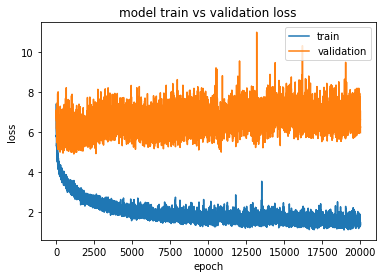

In [317]:
pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

In [218]:
## with batch normalization
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=batch_size,
                    epochs=1000, verbose=1, validation_split=0.2)
#           callbacks=[WandbCallback()])

Train on 352 samples, validate on 89 samples
Epoch 1/1000
352/352 [==============================] - 14s 40ms/sample - loss: 6.0739 - op_feat_loss: 1.7603 - op_bin_loss: 2.9446 - op_dir_loss: 1.3690 - op_feat_accuracy: 0.2670 - op_bin_accuracy: 0.0739 - op_dir_accuracy: 0.3892 - val_loss: 6.0599 - val_op_feat_loss: 1.7822 - val_op_bin_loss: 2.9163 - val_op_dir_loss: 1.3542 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.5056
Epoch 2/1000
352/352 [==============================] - 0s 665us/sample - loss: 5.9027 - op_feat_loss: 1.6863 - op_bin_loss: 2.8945 - op_dir_loss: 1.3219 - op_feat_accuracy: 0.4716 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.4858 - val_loss: 5.9048 - val_op_feat_loss: 1.7284 - val_op_bin_loss: 2.8703 - val_op_dir_loss: 1.2945 - val_op_feat_accuracy: 0.2584 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6067
Epoch 3/1000
352/352 [==============================] - 0s 754us/sample - loss: 5.7306 - op_feat_loss: 1.6201 -

352/352 [==============================] - 0s 802us/sample - loss: 4.2112 - op_feat_loss: 1.0563 - op_bin_loss: 2.3420 - op_dir_loss: 0.8129 - op_feat_accuracy: 0.6250 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.6136 - val_loss: 4.6781 - val_op_feat_loss: 1.3139 - val_op_bin_loss: 2.4069 - val_op_dir_loss: 0.8945 - val_op_feat_accuracy: 0.2921 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.5618
Epoch 40/1000
352/352 [==============================] - 0s 794us/sample - loss: 4.2627 - op_feat_loss: 1.0685 - op_bin_loss: 2.3459 - op_dir_loss: 0.8483 - op_feat_accuracy: 0.5824 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.5739 - val_loss: 4.4829 - val_op_feat_loss: 1.2581 - val_op_bin_loss: 2.3934 - val_op_dir_loss: 0.7767 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7303
Epoch 41/1000
352/352 [==============================] - 0s 806us/sample - loss: 4.1923 - op_feat_loss: 1.0458 - op_bin_loss: 2.3335 - op_dir_loss: 0.8130 - op_feat_acc

352/352 [==============================] - 0s 677us/sample - loss: 3.7537 - op_feat_loss: 0.8969 - op_bin_loss: 2.1612 - op_dir_loss: 0.6957 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.3665 - op_dir_accuracy: 0.7017 - val_loss: 4.1924 - val_op_feat_loss: 1.1043 - val_op_bin_loss: 2.2780 - val_op_dir_loss: 0.6796 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.6966
Epoch 78/1000
352/352 [==============================] - 0s 621us/sample - loss: 3.8376 - op_feat_loss: 0.9283 - op_bin_loss: 2.1705 - op_dir_loss: 0.7388 - op_feat_accuracy: 0.6676 - op_bin_accuracy: 0.3665 - op_dir_accuracy: 0.6648 - val_loss: 4.0008 - val_op_feat_loss: 1.0846 - val_op_bin_loss: 2.2845 - val_op_dir_loss: 0.6477 - val_op_feat_accuracy: 0.5169 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.8315
Epoch 79/1000
352/352 [==============================] - 0s 648us/sample - loss: 3.7274 - op_feat_loss: 0.8843 - op_bin_loss: 2.1517 - op_dir_loss: 0.6914 - op_feat_acc

352/352 [==============================] - 0s 666us/sample - loss: 3.4833 - op_feat_loss: 0.8093 - op_bin_loss: 2.0619 - op_dir_loss: 0.6121 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.3636 - op_dir_accuracy: 0.7443 - val_loss: 3.8916 - val_op_feat_loss: 1.0775 - val_op_bin_loss: 2.3161 - val_op_dir_loss: 0.6832 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.2809 - val_op_dir_accuracy: 0.7978
Epoch 116/1000
352/352 [==============================] - 0s 621us/sample - loss: 3.6060 - op_feat_loss: 0.8462 - op_bin_loss: 2.1053 - op_dir_loss: 0.6545 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.3551 - op_dir_accuracy: 0.7017 - val_loss: 3.9479 - val_op_feat_loss: 1.0811 - val_op_bin_loss: 2.3323 - val_op_dir_loss: 0.6737 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.2697 - val_op_dir_accuracy: 0.7978
Epoch 117/1000
352/352 [==============================] - 0s 621us/sample - loss: 3.5173 - op_feat_loss: 0.8101 - op_bin_loss: 2.0817 - op_dir_loss: 0.6254 - op_feat_a

352/352 [==============================] - 0s 612us/sample - loss: 3.4914 - op_feat_loss: 0.8065 - op_bin_loss: 2.0746 - op_dir_loss: 0.6102 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.3636 - op_dir_accuracy: 0.7528 - val_loss: 4.0279 - val_op_feat_loss: 1.1065 - val_op_bin_loss: 2.3678 - val_op_dir_loss: 0.7123 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.7865
Epoch 154/1000
352/352 [==============================] - 0s 668us/sample - loss: 3.4813 - op_feat_loss: 0.7903 - op_bin_loss: 2.0644 - op_dir_loss: 0.6266 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.3665 - op_dir_accuracy: 0.7330 - val_loss: 3.9025 - val_op_feat_loss: 1.0105 - val_op_bin_loss: 2.2432 - val_op_dir_loss: 0.6481 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7079
Epoch 155/1000
352/352 [==============================] - 0s 649us/sample - loss: 3.4645 - op_feat_loss: 0.7997 - op_bin_loss: 2.0597 - op_dir_loss: 0.6050 - op_feat_a

352/352 [==============================] - 0s 666us/sample - loss: 3.4030 - op_feat_loss: 0.7951 - op_bin_loss: 1.9763 - op_dir_loss: 0.6316 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.3920 - op_dir_accuracy: 0.7045 - val_loss: 4.1159 - val_op_feat_loss: 1.2090 - val_op_bin_loss: 2.3787 - val_op_dir_loss: 0.7526 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7303
Epoch 192/1000
352/352 [==============================] - 0s 703us/sample - loss: 3.3754 - op_feat_loss: 0.7925 - op_bin_loss: 1.9671 - op_dir_loss: 0.6159 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.3977 - op_dir_accuracy: 0.7244 - val_loss: 3.9676 - val_op_feat_loss: 1.1018 - val_op_bin_loss: 2.2744 - val_op_dir_loss: 0.6748 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 193/1000
352/352 [==============================] - 0s 623us/sample - loss: 3.3444 - op_feat_loss: 0.7943 - op_bin_loss: 1.9560 - op_dir_loss: 0.5940 - op_feat_a

352/352 [==============================] - 0s 621us/sample - loss: 3.3519 - op_feat_loss: 0.8140 - op_bin_loss: 1.9074 - op_dir_loss: 0.6305 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.3722 - op_dir_accuracy: 0.7131 - val_loss: 3.8931 - val_op_feat_loss: 1.1115 - val_op_bin_loss: 2.1997 - val_op_dir_loss: 0.7276 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 230/1000
352/352 [==============================] - 0s 577us/sample - loss: 3.2500 - op_feat_loss: 0.7762 - op_bin_loss: 1.8622 - op_dir_loss: 0.6116 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7330 - val_loss: 4.3809 - val_op_feat_loss: 1.2815 - val_op_bin_loss: 2.3955 - val_op_dir_loss: 0.9035 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.6404
Epoch 231/1000
352/352 [==============================] - 0s 668us/sample - loss: 3.4113 - op_feat_loss: 0.8340 - op_bin_loss: 1.9176 - op_dir_loss: 0.6597 - op_feat_a

352/352 [==============================] - 0s 629us/sample - loss: 3.2362 - op_feat_loss: 0.7953 - op_bin_loss: 1.8424 - op_dir_loss: 0.5984 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.4006 - op_dir_accuracy: 0.7301 - val_loss: 3.6631 - val_op_feat_loss: 1.0778 - val_op_bin_loss: 2.1143 - val_op_dir_loss: 0.6601 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7640
Epoch 268/1000
352/352 [==============================] - 0s 592us/sample - loss: 3.1805 - op_feat_loss: 0.7749 - op_bin_loss: 1.8083 - op_dir_loss: 0.5973 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7500 - val_loss: 4.1513 - val_op_feat_loss: 1.2108 - val_op_bin_loss: 2.2564 - val_op_dir_loss: 0.8503 - val_op_feat_accuracy: 0.3371 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.6180
Epoch 269/1000
352/352 [==============================] - 0s 864us/sample - loss: 3.2901 - op_feat_loss: 0.8038 - op_bin_loss: 1.8561 - op_dir_loss: 0.6302 - op_feat_a

352/352 [==============================] - 0s 618us/sample - loss: 3.1037 - op_feat_loss: 0.7589 - op_bin_loss: 1.7825 - op_dir_loss: 0.5623 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7585 - val_loss: 3.5860 - val_op_feat_loss: 1.0148 - val_op_bin_loss: 2.0154 - val_op_dir_loss: 0.6141 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 306/1000
352/352 [==============================] - 0s 702us/sample - loss: 3.0994 - op_feat_loss: 0.7522 - op_bin_loss: 1.7667 - op_dir_loss: 0.5804 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7557 - val_loss: 3.7601 - val_op_feat_loss: 1.0756 - val_op_bin_loss: 2.1522 - val_op_dir_loss: 0.7016 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 307/1000
352/352 [==============================] - 0s 618us/sample - loss: 3.0865 - op_feat_loss: 0.7502 - op_bin_loss: 1.7690 - op_dir_loss: 0.5672 - op_feat_a

352/352 [==============================] - 0s 592us/sample - loss: 3.0246 - op_feat_loss: 0.7177 - op_bin_loss: 1.7538 - op_dir_loss: 0.5530 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7528 - val_loss: 3.6707 - val_op_feat_loss: 1.0911 - val_op_bin_loss: 2.1078 - val_op_dir_loss: 0.6376 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7528
Epoch 344/1000
352/352 [==============================] - 0s 621us/sample - loss: 3.1311 - op_feat_loss: 0.7685 - op_bin_loss: 1.7716 - op_dir_loss: 0.5911 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7415 - val_loss: 3.8351 - val_op_feat_loss: 1.1182 - val_op_bin_loss: 2.0738 - val_op_dir_loss: 0.7052 - val_op_feat_accuracy: 0.4382 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7303
Epoch 345/1000
352/352 [==============================] - 0s 582us/sample - loss: 3.0723 - op_feat_loss: 0.7428 - op_bin_loss: 1.7545 - op_dir_loss: 0.5750 - op_feat_a

352/352 [==============================] - 0s 621us/sample - loss: 3.0949 - op_feat_loss: 0.7710 - op_bin_loss: 1.7429 - op_dir_loss: 0.5810 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7699 - val_loss: 3.6955 - val_op_feat_loss: 1.0488 - val_op_bin_loss: 2.0528 - val_op_dir_loss: 0.6467 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 382/1000
352/352 [==============================] - 0s 577us/sample - loss: 3.0045 - op_feat_loss: 0.7302 - op_bin_loss: 1.7326 - op_dir_loss: 0.5416 - op_feat_accuracy: 0.7074 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7699 - val_loss: 3.6932 - val_op_feat_loss: 1.0381 - val_op_bin_loss: 2.0660 - val_op_dir_loss: 0.6309 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 383/1000
352/352 [==============================] - 0s 533us/sample - loss: 3.1478 - op_feat_loss: 0.7671 - op_bin_loss: 1.7879 - op_dir_loss: 0.5929 - op_feat_a

352/352 [==============================] - 0s 621us/sample - loss: 2.9441 - op_feat_loss: 0.7187 - op_bin_loss: 1.7086 - op_dir_loss: 0.5168 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7784 - val_loss: 3.7637 - val_op_feat_loss: 1.0661 - val_op_bin_loss: 2.0707 - val_op_dir_loss: 0.6815 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.4045 - val_op_dir_accuracy: 0.7528
Epoch 420/1000
352/352 [==============================] - 0s 577us/sample - loss: 3.0976 - op_feat_loss: 0.7301 - op_bin_loss: 1.7819 - op_dir_loss: 0.5856 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7415 - val_loss: 3.8520 - val_op_feat_loss: 1.0942 - val_op_bin_loss: 2.1085 - val_op_dir_loss: 0.6700 - val_op_feat_accuracy: 0.4045 - val_op_bin_accuracy: 0.4270 - val_op_dir_accuracy: 0.6629
Epoch 421/1000
352/352 [==============================] - 0s 577us/sample - loss: 3.0933 - op_feat_loss: 0.7512 - op_bin_loss: 1.7631 - op_dir_loss: 0.5790 - op_feat_a

352/352 [==============================] - 0s 785us/sample - loss: 3.0449 - op_feat_loss: 0.7488 - op_bin_loss: 1.7473 - op_dir_loss: 0.5488 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7614 - val_loss: 3.6409 - val_op_feat_loss: 1.0437 - val_op_bin_loss: 2.0678 - val_op_dir_loss: 0.6261 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.4270 - val_op_dir_accuracy: 0.7528
Epoch 458/1000
352/352 [==============================] - 0s 677us/sample - loss: 3.0920 - op_feat_loss: 0.7483 - op_bin_loss: 1.7603 - op_dir_loss: 0.5834 - op_feat_accuracy: 0.7159 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7386 - val_loss: 3.6607 - val_op_feat_loss: 1.0638 - val_op_bin_loss: 2.1252 - val_op_dir_loss: 0.6693 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.4045 - val_op_dir_accuracy: 0.7640
Epoch 459/1000
352/352 [==============================] - 0s 570us/sample - loss: 3.1257 - op_feat_loss: 0.7641 - op_bin_loss: 1.7636 - op_dir_loss: 0.5980 - op_feat_a

352/352 [==============================] - 0s 558us/sample - loss: 3.1789 - op_feat_loss: 0.7685 - op_bin_loss: 1.7945 - op_dir_loss: 0.6159 - op_feat_accuracy: 0.6847 - op_bin_accuracy: 0.3807 - op_dir_accuracy: 0.7330 - val_loss: 3.8114 - val_op_feat_loss: 1.0532 - val_op_bin_loss: 2.0728 - val_op_dir_loss: 0.6663 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7416
Epoch 496/1000
352/352 [==============================] - 0s 577us/sample - loss: 3.0592 - op_feat_loss: 0.7662 - op_bin_loss: 1.7397 - op_dir_loss: 0.5533 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7699 - val_loss: 3.7608 - val_op_feat_loss: 1.0555 - val_op_bin_loss: 2.1215 - val_op_dir_loss: 0.6950 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 497/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.9468 - op_feat_loss: 0.7078 - op_bin_loss: 1.7034 - op_dir_loss: 0.5357 - op_feat_a

352/352 [==============================] - 0s 629us/sample - loss: 3.0216 - op_feat_loss: 0.7495 - op_bin_loss: 1.7218 - op_dir_loss: 0.5503 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7756 - val_loss: 3.6537 - val_op_feat_loss: 1.0155 - val_op_bin_loss: 2.0165 - val_op_dir_loss: 0.6176 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.4382 - val_op_dir_accuracy: 0.7416
Epoch 534/1000
352/352 [==============================] - 0s 571us/sample - loss: 3.0722 - op_feat_loss: 0.7577 - op_bin_loss: 1.7358 - op_dir_loss: 0.5787 - op_feat_accuracy: 0.6903 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7472 - val_loss: 3.6267 - val_op_feat_loss: 1.0051 - val_op_bin_loss: 2.0036 - val_op_dir_loss: 0.6181 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.4382 - val_op_dir_accuracy: 0.7416
Epoch 535/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.9537 - op_feat_loss: 0.7112 - op_bin_loss: 1.7047 - op_dir_loss: 0.5378 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 2.9990 - op_feat_loss: 0.7112 - op_bin_loss: 1.7340 - op_dir_loss: 0.5538 - op_feat_accuracy: 0.7301 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7642 - val_loss: 3.8722 - val_op_feat_loss: 1.1248 - val_op_bin_loss: 2.2108 - val_op_dir_loss: 0.7666 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.6966
Epoch 572/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.8724 - op_feat_loss: 0.6745 - op_bin_loss: 1.6736 - op_dir_loss: 0.5242 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.4375 - op_dir_accuracy: 0.7756 - val_loss: 3.7017 - val_op_feat_loss: 1.0285 - val_op_bin_loss: 2.0456 - val_op_dir_loss: 0.6430 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.4382 - val_op_dir_accuracy: 0.7303
Epoch 573/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.9528 - op_feat_loss: 0.7027 - op_bin_loss: 1.7070 - op_dir_loss: 0.5430 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 2.9409 - op_feat_loss: 0.6991 - op_bin_loss: 1.7119 - op_dir_loss: 0.5299 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7699 - val_loss: 3.6837 - val_op_feat_loss: 1.0061 - val_op_bin_loss: 2.0626 - val_op_dir_loss: 0.6455 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.4270 - val_op_dir_accuracy: 0.7416
Epoch 610/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.9386 - op_feat_loss: 0.7174 - op_bin_loss: 1.7062 - op_dir_loss: 0.5151 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7898 - val_loss: 3.6643 - val_op_feat_loss: 0.9973 - val_op_bin_loss: 2.0430 - val_op_dir_loss: 0.6239 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.4382 - val_op_dir_accuracy: 0.7416
Epoch 611/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.9726 - op_feat_loss: 0.7282 - op_bin_loss: 1.6873 - op_dir_loss: 0.5571 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 3.0227 - op_feat_loss: 0.7370 - op_bin_loss: 1.7195 - op_dir_loss: 0.5662 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7443 - val_loss: 3.7532 - val_op_feat_loss: 1.0406 - val_op_bin_loss: 2.0941 - val_op_dir_loss: 0.6639 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.4382 - val_op_dir_accuracy: 0.7079
Epoch 648/1000
352/352 [==============================] - 0s 577us/sample - loss: 3.0006 - op_feat_loss: 0.7360 - op_bin_loss: 1.7120 - op_dir_loss: 0.5526 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7557 - val_loss: 3.6801 - val_op_feat_loss: 1.0069 - val_op_bin_loss: 2.0578 - val_op_dir_loss: 0.6227 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.4494 - val_op_dir_accuracy: 0.7528
Epoch 649/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.9110 - op_feat_loss: 0.7187 - op_bin_loss: 1.6583 - op_dir_loss: 0.5340 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 3.0020 - op_feat_loss: 0.7201 - op_bin_loss: 1.7121 - op_dir_loss: 0.5697 - op_feat_accuracy: 0.7017 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7330 - val_loss: 3.6995 - val_op_feat_loss: 1.0194 - val_op_bin_loss: 2.0737 - val_op_dir_loss: 0.6400 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.4045 - val_op_dir_accuracy: 0.7528
Epoch 686/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.9385 - op_feat_loss: 0.7033 - op_bin_loss: 1.6942 - op_dir_loss: 0.5410 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7670 - val_loss: 3.6828 - val_op_feat_loss: 1.0138 - val_op_bin_loss: 2.0765 - val_op_dir_loss: 0.6339 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.4382 - val_op_dir_accuracy: 0.7191
Epoch 687/1000
352/352 [==============================] - 0s 614us/sample - loss: 3.0199 - op_feat_loss: 0.7203 - op_bin_loss: 1.7155 - op_dir_loss: 0.5841 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 3.0046 - op_feat_loss: 0.7032 - op_bin_loss: 1.7289 - op_dir_loss: 0.5725 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.4119 - op_dir_accuracy: 0.7415 - val_loss: 3.6328 - val_op_feat_loss: 0.9998 - val_op_bin_loss: 2.0842 - val_op_dir_loss: 0.6625 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7528
Epoch 724/1000
352/352 [==============================] - 0s 605us/sample - loss: 2.9019 - op_feat_loss: 0.6836 - op_bin_loss: 1.6801 - op_dir_loss: 0.5383 - op_feat_accuracy: 0.6932 - op_bin_accuracy: 0.4176 - op_dir_accuracy: 0.7386 - val_loss: 3.7171 - val_op_feat_loss: 1.0396 - val_op_bin_loss: 2.1159 - val_op_dir_loss: 0.6625 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7528
Epoch 725/1000
352/352 [==============================] - 0s 581us/sample - loss: 3.0609 - op_feat_loss: 0.7442 - op_bin_loss: 1.7202 - op_dir_loss: 0.5965 - op_feat_a

352/352 [==============================] - 0s 666us/sample - loss: 2.9813 - op_feat_loss: 0.7130 - op_bin_loss: 1.7136 - op_dir_loss: 0.5548 - op_feat_accuracy: 0.6989 - op_bin_accuracy: 0.4062 - op_dir_accuracy: 0.7500 - val_loss: 3.6136 - val_op_feat_loss: 1.0235 - val_op_bin_loss: 2.0598 - val_op_dir_loss: 0.6506 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.4157 - val_op_dir_accuracy: 0.7640
Epoch 762/1000
352/352 [==============================] - 0s 595us/sample - loss: 2.9694 - op_feat_loss: 0.7276 - op_bin_loss: 1.6816 - op_dir_loss: 0.5601 - op_feat_accuracy: 0.7188 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7557 - val_loss: 3.7646 - val_op_feat_loss: 1.0329 - val_op_bin_loss: 2.1562 - val_op_dir_loss: 0.6821 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7191
Epoch 763/1000
352/352 [==============================] - 0s 572us/sample - loss: 2.9961 - op_feat_loss: 0.7458 - op_bin_loss: 1.6892 - op_dir_loss: 0.5612 - op_feat_a

352/352 [==============================] - 0s 579us/sample - loss: 2.9404 - op_feat_loss: 0.7110 - op_bin_loss: 1.6918 - op_dir_loss: 0.5376 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7585 - val_loss: 3.7581 - val_op_feat_loss: 1.0619 - val_op_bin_loss: 2.0888 - val_op_dir_loss: 0.7129 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.4270 - val_op_dir_accuracy: 0.7191
Epoch 800/1000
352/352 [==============================] - 0s 620us/sample - loss: 2.8567 - op_feat_loss: 0.6851 - op_bin_loss: 1.6479 - op_dir_loss: 0.5237 - op_feat_accuracy: 0.7216 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.7699 - val_loss: 3.7794 - val_op_feat_loss: 1.0420 - val_op_bin_loss: 2.1104 - val_op_dir_loss: 0.7407 - val_op_feat_accuracy: 0.4944 - val_op_bin_accuracy: 0.3933 - val_op_dir_accuracy: 0.7191
Epoch 801/1000
352/352 [==============================] - 0s 589us/sample - loss: 2.8534 - op_feat_loss: 0.6915 - op_bin_loss: 1.6528 - op_dir_loss: 0.5091 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 2.9541 - op_feat_loss: 0.6985 - op_bin_loss: 1.6904 - op_dir_loss: 0.5652 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7330 - val_loss: 3.8792 - val_op_feat_loss: 1.0950 - val_op_bin_loss: 2.0847 - val_op_dir_loss: 0.7388 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.4270 - val_op_dir_accuracy: 0.6966
Epoch 838/1000
352/352 [==============================] - 0s 608us/sample - loss: 2.8744 - op_feat_loss: 0.6855 - op_bin_loss: 1.6633 - op_dir_loss: 0.5256 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7727 - val_loss: 3.6873 - val_op_feat_loss: 1.0236 - val_op_bin_loss: 2.0988 - val_op_dir_loss: 0.7284 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.4157 - val_op_dir_accuracy: 0.7303
Epoch 839/1000
352/352 [==============================] - 0s 586us/sample - loss: 2.9326 - op_feat_loss: 0.7034 - op_bin_loss: 1.6869 - op_dir_loss: 0.5423 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 2.8322 - op_feat_loss: 0.6761 - op_bin_loss: 1.6339 - op_dir_loss: 0.5223 - op_feat_accuracy: 0.7415 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.7642 - val_loss: 3.8223 - val_op_feat_loss: 1.0940 - val_op_bin_loss: 2.0897 - val_op_dir_loss: 0.7117 - val_op_feat_accuracy: 0.4607 - val_op_bin_accuracy: 0.4045 - val_op_dir_accuracy: 0.7303
Epoch 876/1000
352/352 [==============================] - 0s 612us/sample - loss: 2.8143 - op_feat_loss: 0.6675 - op_bin_loss: 1.6357 - op_dir_loss: 0.5111 - op_feat_accuracy: 0.7102 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7642 - val_loss: 3.8479 - val_op_feat_loss: 1.0977 - val_op_bin_loss: 2.1239 - val_op_dir_loss: 0.7504 - val_op_feat_accuracy: 0.5281 - val_op_bin_accuracy: 0.4157 - val_op_dir_accuracy: 0.7303
Epoch 877/1000
352/352 [==============================] - 0s 584us/sample - loss: 2.9460 - op_feat_loss: 0.7192 - op_bin_loss: 1.6634 - op_dir_loss: 0.5634 - op_feat_a

352/352 [==============================] - 0s 799us/sample - loss: 2.7827 - op_feat_loss: 0.6592 - op_bin_loss: 1.6258 - op_dir_loss: 0.4977 - op_feat_accuracy: 0.7443 - op_bin_accuracy: 0.4460 - op_dir_accuracy: 0.7898 - val_loss: 3.8425 - val_op_feat_loss: 1.0983 - val_op_bin_loss: 2.1127 - val_op_dir_loss: 0.8015 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.4157 - val_op_dir_accuracy: 0.6966
Epoch 914/1000
352/352 [==============================] - 0s 901us/sample - loss: 2.9754 - op_feat_loss: 0.7304 - op_bin_loss: 1.6778 - op_dir_loss: 0.5672 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4205 - op_dir_accuracy: 0.7670 - val_loss: 3.8966 - val_op_feat_loss: 1.1363 - val_op_bin_loss: 2.1351 - val_op_dir_loss: 0.7579 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.4045 - val_op_dir_accuracy: 0.7079
Epoch 915/1000
352/352 [==============================] - 0s 793us/sample - loss: 3.0044 - op_feat_loss: 0.7383 - op_bin_loss: 1.7028 - op_dir_loss: 0.5633 - op_feat_a

352/352 [==============================] - 0s 916us/sample - loss: 2.9218 - op_feat_loss: 0.7110 - op_bin_loss: 1.6668 - op_dir_loss: 0.5440 - op_feat_accuracy: 0.6960 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.7415 - val_loss: 3.5960 - val_op_feat_loss: 1.0033 - val_op_bin_loss: 2.0214 - val_op_dir_loss: 0.6735 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.4157 - val_op_dir_accuracy: 0.7303
Epoch 952/1000
352/352 [==============================] - 0s 843us/sample - loss: 2.9330 - op_feat_loss: 0.7082 - op_bin_loss: 1.6809 - op_dir_loss: 0.5440 - op_feat_accuracy: 0.7131 - op_bin_accuracy: 0.4233 - op_dir_accuracy: 0.7869 - val_loss: 3.8164 - val_op_feat_loss: 1.0961 - val_op_bin_loss: 2.0631 - val_op_dir_loss: 0.7100 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.4045 - val_op_dir_accuracy: 0.6854
Epoch 953/1000
352/352 [==============================] - 0s 710us/sample - loss: 2.9656 - op_feat_loss: 0.7251 - op_bin_loss: 1.6732 - op_dir_loss: 0.5673 - op_feat_a

352/352 [==============================] - 0s 710us/sample - loss: 2.7563 - op_feat_loss: 0.6560 - op_bin_loss: 1.6033 - op_dir_loss: 0.4971 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.4375 - op_dir_accuracy: 0.7784 - val_loss: 3.8121 - val_op_feat_loss: 1.0953 - val_op_bin_loss: 2.0544 - val_op_dir_loss: 0.6946 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.4045 - val_op_dir_accuracy: 0.7303
Epoch 990/1000
352/352 [==============================] - 0s 666us/sample - loss: 2.9469 - op_feat_loss: 0.7086 - op_bin_loss: 1.6804 - op_dir_loss: 0.5578 - op_feat_accuracy: 0.7244 - op_bin_accuracy: 0.4148 - op_dir_accuracy: 0.7443 - val_loss: 3.7910 - val_op_feat_loss: 1.0767 - val_op_bin_loss: 2.0761 - val_op_dir_loss: 0.7982 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.4382 - val_op_dir_accuracy: 0.6966
Epoch 991/1000
352/352 [==============================] - 0s 666us/sample - loss: 2.9336 - op_feat_loss: 0.7340 - op_bin_loss: 1.6614 - op_dir_loss: 0.5383 - op_feat_a

In [208]:
## with dropouts - 0.2
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=batch_size,
                    epochs=1000, verbose=1, validation_split=0.2)
#           callbacks=[WandbCallback()])

Train on 352 samples, validate on 89 samples
Epoch 1/1000
352/352 [==============================] - 7s 20ms/sample - loss: 6.1520 - op_feat_loss: 1.7776 - op_bin_loss: 3.0063 - op_dir_loss: 1.3682 - op_feat_accuracy: 0.3352 - op_bin_accuracy: 0.0199 - op_dir_accuracy: 0.3636 - val_loss: 6.0976 - val_op_feat_loss: 1.7413 - val_op_bin_loss: 2.9792 - val_op_dir_loss: 1.3635 - val_op_feat_accuracy: 0.3596 - val_op_bin_accuracy: 0.0674 - val_op_dir_accuracy: 0.0112
Epoch 2/1000
352/352 [==============================] - 0s 763us/sample - loss: 5.9701 - op_feat_loss: 1.7013 - op_bin_loss: 2.9522 - op_dir_loss: 1.3166 - op_feat_accuracy: 0.3352 - op_bin_accuracy: 0.1932 - op_dir_accuracy: 0.3807 - val_loss: 5.9688 - val_op_feat_loss: 1.6859 - val_op_bin_loss: 2.9305 - val_op_dir_loss: 1.3319 - val_op_feat_accuracy: 0.3596 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.0112
Epoch 3/1000
352/352 [==============================] - 0s 876us/sample - loss: 5.7977 - op_feat_loss: 1.6307 - 

352/352 [==============================] - 0s 754us/sample - loss: 3.6197 - op_feat_loss: 0.8265 - op_bin_loss: 2.1397 - op_dir_loss: 0.6535 - op_feat_accuracy: 0.7642 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.7614 - val_loss: 4.2004 - val_op_feat_loss: 1.1919 - val_op_bin_loss: 2.3200 - val_op_dir_loss: 0.6981 - val_op_feat_accuracy: 0.4719 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7528
Epoch 40/1000
352/352 [==============================] - 0s 660us/sample - loss: 3.5699 - op_feat_loss: 0.8075 - op_bin_loss: 2.1155 - op_dir_loss: 0.6469 - op_feat_accuracy: 0.7727 - op_bin_accuracy: 0.3352 - op_dir_accuracy: 0.7528 - val_loss: 4.0975 - val_op_feat_loss: 1.1375 - val_op_bin_loss: 2.2417 - val_op_dir_loss: 0.6376 - val_op_feat_accuracy: 0.5056 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 41/1000
352/352 [==============================] - 0s 793us/sample - loss: 3.5314 - op_feat_loss: 0.7960 - op_bin_loss: 2.0944 - op_dir_loss: 0.6409 - op_feat_acc

352/352 [==============================] - 0s 723us/sample - loss: 3.0940 - op_feat_loss: 0.6752 - op_bin_loss: 1.9223 - op_dir_loss: 0.4965 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.4261 - op_dir_accuracy: 0.8494 - val_loss: 3.9490 - val_op_feat_loss: 1.1228 - val_op_bin_loss: 2.2967 - val_op_dir_loss: 0.6509 - val_op_feat_accuracy: 0.4494 - val_op_bin_accuracy: 0.2809 - val_op_dir_accuracy: 0.7416
Epoch 78/1000
352/352 [==============================] - 0s 578us/sample - loss: 3.0272 - op_feat_loss: 0.6582 - op_bin_loss: 1.9044 - op_dir_loss: 0.4645 - op_feat_accuracy: 0.7756 - op_bin_accuracy: 0.4347 - op_dir_accuracy: 0.8523 - val_loss: 3.7560 - val_op_feat_loss: 1.0583 - val_op_bin_loss: 2.2079 - val_op_dir_loss: 0.5991 - val_op_feat_accuracy: 0.4831 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7640
Epoch 79/1000
352/352 [==============================] - 0s 708us/sample - loss: 3.0612 - op_feat_loss: 0.6654 - op_bin_loss: 1.9059 - op_dir_loss: 0.4900 - op_feat_acc

Epoch 96/1000
352/352 [==============================] - 0s 516us/sample - loss: 2.9211 - op_feat_loss: 0.6221 - op_bin_loss: 1.8758 - op_dir_loss: 0.4232 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4290 - op_dir_accuracy: 0.8608 - val_loss: 4.0086 - val_op_feat_loss: 1.1357 - val_op_bin_loss: 2.3507 - val_op_dir_loss: 0.6994 - val_op_feat_accuracy: 0.4270 - val_op_bin_accuracy: 0.2472 - val_op_dir_accuracy: 0.7416
Epoch 97/1000
352/352 [==============================] - 0s 510us/sample - loss: 2.9509 - op_feat_loss: 0.6418 - op_bin_loss: 1.8864 - op_dir_loss: 0.4227 - op_feat_accuracy: 0.7784 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.8580 - val_loss: 4.0646 - val_op_feat_loss: 1.1508 - val_op_bin_loss: 2.3324 - val_op_dir_loss: 0.6815 - val_op_feat_accuracy: 0.4157 - val_op_bin_accuracy: 0.2809 - val_op_dir_accuracy: 0.7416
Epoch 98/1000
352/352 [==============================] - 0s 502us/sample - loss: 2.9073 - op_feat_loss: 0.6315 - op_bin_loss: 1.8711 - op_dir_loss: 0.4047

352/352 [==============================] - 0s 584us/sample - loss: 2.7542 - op_feat_loss: 0.6026 - op_bin_loss: 1.8110 - op_dir_loss: 0.3407 - op_feat_accuracy: 0.7869 - op_bin_accuracy: 0.4375 - op_dir_accuracy: 0.8750 - val_loss: 3.9038 - val_op_feat_loss: 1.1399 - val_op_bin_loss: 2.2867 - val_op_dir_loss: 0.6942 - val_op_feat_accuracy: 0.6067 - val_op_bin_accuracy: 0.2809 - val_op_dir_accuracy: 0.7640
Epoch 135/1000
352/352 [==============================] - 0s 538us/sample - loss: 2.6754 - op_feat_loss: 0.5728 - op_bin_loss: 1.7908 - op_dir_loss: 0.3118 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.4460 - op_dir_accuracy: 0.8949 - val_loss: 3.8163 - val_op_feat_loss: 1.1090 - val_op_bin_loss: 2.2510 - val_op_dir_loss: 0.6605 - val_op_feat_accuracy: 0.6292 - val_op_bin_accuracy: 0.2809 - val_op_dir_accuracy: 0.7640
Epoch 136/1000
352/352 [==============================] - 0s 538us/sample - loss: 2.7437 - op_feat_loss: 0.5889 - op_bin_loss: 1.8106 - op_dir_loss: 0.3443 - op_feat_a

Epoch 153/1000
352/352 [==============================] - 0s 525us/sample - loss: 2.6533 - op_feat_loss: 0.5727 - op_bin_loss: 1.7597 - op_dir_loss: 0.3208 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.4602 - op_dir_accuracy: 0.8920 - val_loss: 3.9186 - val_op_feat_loss: 1.1965 - val_op_bin_loss: 2.2258 - val_op_dir_loss: 0.7256 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.2921 - val_op_dir_accuracy: 0.7416
Epoch 154/1000
352/352 [==============================] - 0s 525us/sample - loss: 2.6229 - op_feat_loss: 0.5568 - op_bin_loss: 1.7540 - op_dir_loss: 0.3120 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.4517 - op_dir_accuracy: 0.8835 - val_loss: 3.8050 - val_op_feat_loss: 1.1474 - val_op_bin_loss: 2.2085 - val_op_dir_loss: 0.6692 - val_op_feat_accuracy: 0.6404 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7753
Epoch 155/1000
352/352 [==============================] - 0s 481us/sample - loss: 2.6191 - op_feat_loss: 0.5607 - op_bin_loss: 1.7490 - op_dir_loss: 0.3

352/352 [==============================] - 0s 618us/sample - loss: 2.4777 - op_feat_loss: 0.5375 - op_bin_loss: 1.6419 - op_dir_loss: 0.2983 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.4858 - op_dir_accuracy: 0.8892 - val_loss: 3.7674 - val_op_feat_loss: 1.2493 - val_op_bin_loss: 2.1043 - val_op_dir_loss: 0.7389 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7753
Epoch 192/1000
352/352 [==============================] - 0s 618us/sample - loss: 2.5186 - op_feat_loss: 0.5554 - op_bin_loss: 1.6453 - op_dir_loss: 0.3179 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.4943 - op_dir_accuracy: 0.8892 - val_loss: 3.8875 - val_op_feat_loss: 1.2759 - val_op_bin_loss: 2.1342 - val_op_dir_loss: 0.7962 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7528
Epoch 193/1000
352/352 [==============================] - 0s 621us/sample - loss: 2.4631 - op_feat_loss: 0.5325 - op_bin_loss: 1.6541 - op_dir_loss: 0.2764 - op_feat_a

352/352 [==============================] - 0s 567us/sample - loss: 2.3563 - op_feat_loss: 0.5131 - op_bin_loss: 1.5654 - op_dir_loss: 0.2778 - op_feat_accuracy: 0.8068 - op_bin_accuracy: 0.5170 - op_dir_accuracy: 0.8920 - val_loss: 3.5923 - val_op_feat_loss: 1.1431 - val_op_bin_loss: 2.0796 - val_op_dir_loss: 0.6315 - val_op_feat_accuracy: 0.6067 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7865
Epoch 230/1000
352/352 [==============================] - 0s 559us/sample - loss: 2.2796 - op_feat_loss: 0.4879 - op_bin_loss: 1.5445 - op_dir_loss: 0.2472 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.4915 - op_dir_accuracy: 0.9062 - val_loss: 3.5521 - val_op_feat_loss: 1.1353 - val_op_bin_loss: 2.0738 - val_op_dir_loss: 0.6263 - val_op_feat_accuracy: 0.6067 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7978
Epoch 231/1000
352/352 [==============================] - 0s 593us/sample - loss: 2.3491 - op_feat_loss: 0.5167 - op_bin_loss: 1.5582 - op_dir_loss: 0.2742 - op_feat_a

352/352 [==============================] - 0s 592us/sample - loss: 2.3044 - op_feat_loss: 0.5176 - op_bin_loss: 1.5240 - op_dir_loss: 0.2629 - op_feat_accuracy: 0.7898 - op_bin_accuracy: 0.4915 - op_dir_accuracy: 0.8864 - val_loss: 3.7713 - val_op_feat_loss: 1.2395 - val_op_bin_loss: 2.2016 - val_op_dir_loss: 0.6808 - val_op_feat_accuracy: 0.6180 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7640
Epoch 268/1000
352/352 [==============================] - 0s 522us/sample - loss: 2.2507 - op_feat_loss: 0.5028 - op_bin_loss: 1.5025 - op_dir_loss: 0.2454 - op_feat_accuracy: 0.7926 - op_bin_accuracy: 0.5057 - op_dir_accuracy: 0.9062 - val_loss: 3.8607 - val_op_feat_loss: 1.2892 - val_op_bin_loss: 2.2264 - val_op_dir_loss: 0.7308 - val_op_feat_accuracy: 0.6180 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7640
Epoch 269/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.2545 - op_feat_loss: 0.4839 - op_bin_loss: 1.5099 - op_dir_loss: 0.2607 - op_feat_a

352/352 [==============================] - 0s 533us/sample - loss: 2.2253 - op_feat_loss: 0.5071 - op_bin_loss: 1.4742 - op_dir_loss: 0.2440 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.4943 - op_dir_accuracy: 0.9034 - val_loss: 4.2222 - val_op_feat_loss: 1.4163 - val_op_bin_loss: 2.3654 - val_op_dir_loss: 0.8250 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7303
Epoch 306/1000
352/352 [==============================] - 0s 623us/sample - loss: 2.2044 - op_feat_loss: 0.4906 - op_bin_loss: 1.4757 - op_dir_loss: 0.2381 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.5028 - op_dir_accuracy: 0.9006 - val_loss: 4.0167 - val_op_feat_loss: 1.3465 - val_op_bin_loss: 2.2984 - val_op_dir_loss: 0.7556 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7303
Epoch 307/1000
352/352 [==============================] - 0s 533us/sample - loss: 2.2325 - op_feat_loss: 0.4898 - op_bin_loss: 1.4931 - op_dir_loss: 0.2496 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 2.1231 - op_feat_loss: 0.4652 - op_bin_loss: 1.4491 - op_dir_loss: 0.2088 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.5028 - op_dir_accuracy: 0.9148 - val_loss: 4.2217 - val_op_feat_loss: 1.3216 - val_op_bin_loss: 2.3931 - val_op_dir_loss: 0.7959 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7528
Epoch 344/1000
352/352 [==============================] - 0s 577us/sample - loss: 2.1618 - op_feat_loss: 0.4832 - op_bin_loss: 1.4663 - op_dir_loss: 0.2123 - op_feat_accuracy: 0.7983 - op_bin_accuracy: 0.4943 - op_dir_accuracy: 0.9233 - val_loss: 4.1422 - val_op_feat_loss: 1.3159 - val_op_bin_loss: 2.3690 - val_op_dir_loss: 0.7646 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7416
Epoch 345/1000
352/352 [==============================] - 0s 605us/sample - loss: 2.1694 - op_feat_loss: 0.4870 - op_bin_loss: 1.4607 - op_dir_loss: 0.2216 - op_feat_a

352/352 [==============================] - 0s 584us/sample - loss: 2.0901 - op_feat_loss: 0.4517 - op_bin_loss: 1.4327 - op_dir_loss: 0.2057 - op_feat_accuracy: 0.8011 - op_bin_accuracy: 0.4972 - op_dir_accuracy: 0.9091 - val_loss: 3.8877 - val_op_feat_loss: 1.2395 - val_op_bin_loss: 2.3113 - val_op_dir_loss: 0.7170 - val_op_feat_accuracy: 0.6180 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7640
Epoch 382/1000
352/352 [==============================] - 0s 580us/sample - loss: 2.1327 - op_feat_loss: 0.4461 - op_bin_loss: 1.4658 - op_dir_loss: 0.2208 - op_feat_accuracy: 0.8153 - op_bin_accuracy: 0.4915 - op_dir_accuracy: 0.9062 - val_loss: 4.0044 - val_op_feat_loss: 1.2138 - val_op_bin_loss: 2.3186 - val_op_dir_loss: 0.7312 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7416
Epoch 383/1000
352/352 [==============================] - 0s 558us/sample - loss: 2.1446 - op_feat_loss: 0.4710 - op_bin_loss: 1.4362 - op_dir_loss: 0.2374 - op_feat_a

352/352 [==============================] - 0s 603us/sample - loss: 2.0789 - op_feat_loss: 0.4498 - op_bin_loss: 1.4272 - op_dir_loss: 0.2019 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.4972 - op_dir_accuracy: 0.9318 - val_loss: 3.9812 - val_op_feat_loss: 1.2860 - val_op_bin_loss: 2.3647 - val_op_dir_loss: 0.7530 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7753
Epoch 420/1000
352/352 [==============================] - 0s 581us/sample - loss: 2.0780 - op_feat_loss: 0.4461 - op_bin_loss: 1.4278 - op_dir_loss: 0.2042 - op_feat_accuracy: 0.8097 - op_bin_accuracy: 0.4972 - op_dir_accuracy: 0.9176 - val_loss: 3.6752 - val_op_feat_loss: 1.1580 - val_op_bin_loss: 2.2357 - val_op_dir_loss: 0.6661 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7753
Epoch 421/1000
352/352 [==============================] - 0s 666us/sample - loss: 2.0634 - op_feat_loss: 0.4523 - op_bin_loss: 1.4141 - op_dir_loss: 0.1970 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 2.0878 - op_feat_loss: 0.4398 - op_bin_loss: 1.4299 - op_dir_loss: 0.2181 - op_feat_accuracy: 0.8182 - op_bin_accuracy: 0.5000 - op_dir_accuracy: 0.8920 - val_loss: 3.5918 - val_op_feat_loss: 1.0189 - val_op_bin_loss: 2.1406 - val_op_dir_loss: 0.5942 - val_op_feat_accuracy: 0.6180 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 458/1000
352/352 [==============================] - 0s 621us/sample - loss: 2.1127 - op_feat_loss: 0.4387 - op_bin_loss: 1.4516 - op_dir_loss: 0.2223 - op_feat_accuracy: 0.8040 - op_bin_accuracy: 0.4915 - op_dir_accuracy: 0.9119 - val_loss: 3.9829 - val_op_feat_loss: 1.3112 - val_op_bin_loss: 2.3720 - val_op_dir_loss: 0.7518 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.3034 - val_op_dir_accuracy: 0.7416
Epoch 459/1000
352/352 [==============================] - 0s 657us/sample - loss: 2.0643 - op_feat_loss: 0.4472 - op_bin_loss: 1.4277 - op_dir_loss: 0.1895 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 1.9788 - op_feat_loss: 0.4121 - op_bin_loss: 1.3918 - op_dir_loss: 0.1749 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.5114 - op_dir_accuracy: 0.9318 - val_loss: 4.4559 - val_op_feat_loss: 1.4084 - val_op_bin_loss: 2.4993 - val_op_dir_loss: 0.8725 - val_op_feat_accuracy: 0.5506 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7303
Epoch 496/1000
352/352 [==============================] - 0s 621us/sample - loss: 2.0012 - op_feat_loss: 0.4228 - op_bin_loss: 1.4071 - op_dir_loss: 0.1713 - op_feat_accuracy: 0.8210 - op_bin_accuracy: 0.4943 - op_dir_accuracy: 0.9347 - val_loss: 4.1292 - val_op_feat_loss: 1.3706 - val_op_bin_loss: 2.4080 - val_op_dir_loss: 0.8303 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.2921 - val_op_dir_accuracy: 0.7416
Epoch 497/1000
352/352 [==============================] - 0s 621us/sample - loss: 1.9732 - op_feat_loss: 0.4005 - op_bin_loss: 1.3981 - op_dir_loss: 0.1746 - op_feat_a

352/352 [==============================] - 0s 618us/sample - loss: 2.1246 - op_feat_loss: 0.4307 - op_bin_loss: 1.4664 - op_dir_loss: 0.2275 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.4915 - op_dir_accuracy: 0.9034 - val_loss: 4.0870 - val_op_feat_loss: 1.1659 - val_op_bin_loss: 2.2986 - val_op_dir_loss: 0.7312 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7528
Epoch 534/1000
352/352 [==============================] - 0s 538us/sample - loss: 2.0291 - op_feat_loss: 0.4200 - op_bin_loss: 1.4262 - op_dir_loss: 0.1829 - op_feat_accuracy: 0.8125 - op_bin_accuracy: 0.4972 - op_dir_accuracy: 0.9205 - val_loss: 4.1769 - val_op_feat_loss: 1.3078 - val_op_bin_loss: 2.4167 - val_op_dir_loss: 0.8064 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.2921 - val_op_dir_accuracy: 0.7416
Epoch 535/1000
352/352 [==============================] - 0s 533us/sample - loss: 1.9117 - op_feat_loss: 0.3750 - op_bin_loss: 1.3839 - op_dir_loss: 0.1528 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 1.8825 - op_feat_loss: 0.3715 - op_bin_loss: 1.3597 - op_dir_loss: 0.1513 - op_feat_accuracy: 0.8239 - op_bin_accuracy: 0.5085 - op_dir_accuracy: 0.9290 - val_loss: 4.1058 - val_op_feat_loss: 1.2205 - val_op_bin_loss: 2.3591 - val_op_dir_loss: 0.7693 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7416
Epoch 572/1000
352/352 [==============================] - 0s 656us/sample - loss: 1.9748 - op_feat_loss: 0.3866 - op_bin_loss: 1.4025 - op_dir_loss: 0.1857 - op_feat_accuracy: 0.8381 - op_bin_accuracy: 0.5057 - op_dir_accuracy: 0.9205 - val_loss: 4.2876 - val_op_feat_loss: 1.4252 - val_op_bin_loss: 2.4835 - val_op_dir_loss: 0.8657 - val_op_feat_accuracy: 0.6180 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7528
Epoch 573/1000
352/352 [==============================] - 0s 633us/sample - loss: 1.9259 - op_feat_loss: 0.3763 - op_bin_loss: 1.3757 - op_dir_loss: 0.1740 - op_feat_a

352/352 [==============================] - 0s 525us/sample - loss: 1.9428 - op_feat_loss: 0.3919 - op_bin_loss: 1.3783 - op_dir_loss: 0.1726 - op_feat_accuracy: 0.8409 - op_bin_accuracy: 0.4830 - op_dir_accuracy: 0.9460 - val_loss: 5.1175 - val_op_feat_loss: 1.8177 - val_op_bin_loss: 2.7942 - val_op_dir_loss: 1.1430 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7191
Epoch 610/1000
352/352 [==============================] - 0s 656us/sample - loss: 1.8981 - op_feat_loss: 0.3793 - op_bin_loss: 1.3690 - op_dir_loss: 0.1498 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.5000 - op_dir_accuracy: 0.9347 - val_loss: 4.7076 - val_op_feat_loss: 1.6312 - val_op_bin_loss: 2.6580 - val_op_dir_loss: 1.0010 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7416
Epoch 611/1000
352/352 [==============================] - 0s 614us/sample - loss: 1.9207 - op_feat_loss: 0.3891 - op_bin_loss: 1.3579 - op_dir_loss: 0.1737 - op_feat_a

352/352 [==============================] - 0s 586us/sample - loss: 1.8620 - op_feat_loss: 0.3458 - op_bin_loss: 1.3521 - op_dir_loss: 0.1640 - op_feat_accuracy: 0.8636 - op_bin_accuracy: 0.5085 - op_dir_accuracy: 0.9375 - val_loss: 4.6073 - val_op_feat_loss: 1.4178 - val_op_bin_loss: 2.5458 - val_op_dir_loss: 0.9083 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7303
Epoch 648/1000
352/352 [==============================] - 0s 730us/sample - loss: 1.8306 - op_feat_loss: 0.3405 - op_bin_loss: 1.3500 - op_dir_loss: 0.1401 - op_feat_accuracy: 0.8608 - op_bin_accuracy: 0.5085 - op_dir_accuracy: 0.9318 - val_loss: 4.5326 - val_op_feat_loss: 1.3394 - val_op_bin_loss: 2.5007 - val_op_dir_loss: 0.8720 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7416
Epoch 649/1000
352/352 [==============================] - 0s 621us/sample - loss: 1.8196 - op_feat_loss: 0.3393 - op_bin_loss: 1.3408 - op_dir_loss: 0.1395 - op_feat_a

352/352 [==============================] - 0s 635us/sample - loss: 1.7892 - op_feat_loss: 0.3352 - op_bin_loss: 1.3145 - op_dir_loss: 0.1395 - op_feat_accuracy: 0.8665 - op_bin_accuracy: 0.5142 - op_dir_accuracy: 0.9318 - val_loss: 4.7529 - val_op_feat_loss: 1.5040 - val_op_bin_loss: 2.6101 - val_op_dir_loss: 0.9425 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7303
Epoch 686/1000
352/352 [==============================] - 0s 565us/sample - loss: 1.8476 - op_feat_loss: 0.3470 - op_bin_loss: 1.3407 - op_dir_loss: 0.1599 - op_feat_accuracy: 0.8608 - op_bin_accuracy: 0.5057 - op_dir_accuracy: 0.9261 - val_loss: 4.0997 - val_op_feat_loss: 1.0510 - val_op_bin_loss: 2.2518 - val_op_dir_loss: 0.7168 - val_op_feat_accuracy: 0.6180 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7978
Epoch 687/1000
352/352 [==============================] - 0s 577us/sample - loss: 1.8142 - op_feat_loss: 0.3324 - op_bin_loss: 1.3319 - op_dir_loss: 0.1499 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 1.7396 - op_feat_loss: 0.3094 - op_bin_loss: 1.3043 - op_dir_loss: 0.1259 - op_feat_accuracy: 0.8636 - op_bin_accuracy: 0.5199 - op_dir_accuracy: 0.9403 - val_loss: 4.7169 - val_op_feat_loss: 1.6035 - val_op_bin_loss: 2.7054 - val_op_dir_loss: 0.9678 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.3034 - val_op_dir_accuracy: 0.7528
Epoch 724/1000
352/352 [==============================] - 0s 577us/sample - loss: 1.7243 - op_feat_loss: 0.2995 - op_bin_loss: 1.3015 - op_dir_loss: 0.1233 - op_feat_accuracy: 0.8722 - op_bin_accuracy: 0.5170 - op_dir_accuracy: 0.9403 - val_loss: 4.7878 - val_op_feat_loss: 1.6413 - val_op_bin_loss: 2.7346 - val_op_dir_loss: 0.9945 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7528
Epoch 725/1000
352/352 [==============================] - 0s 621us/sample - loss: 1.7862 - op_feat_loss: 0.3233 - op_bin_loss: 1.3195 - op_dir_loss: 0.1433 - op_feat_a

352/352 [==============================] - 0s 799us/sample - loss: 1.8075 - op_feat_loss: 0.3445 - op_bin_loss: 1.3022 - op_dir_loss: 0.1608 - op_feat_accuracy: 0.8722 - op_bin_accuracy: 0.5199 - op_dir_accuracy: 0.9347 - val_loss: 4.4268 - val_op_feat_loss: 1.3964 - val_op_bin_loss: 2.5280 - val_op_dir_loss: 0.8468 - val_op_feat_accuracy: 0.6180 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7640
Epoch 762/1000
352/352 [==============================] - 0s 627us/sample - loss: 1.7351 - op_feat_loss: 0.3025 - op_bin_loss: 1.2903 - op_dir_loss: 0.1423 - op_feat_accuracy: 0.8693 - op_bin_accuracy: 0.5085 - op_dir_accuracy: 0.9347 - val_loss: 4.5271 - val_op_feat_loss: 1.4376 - val_op_bin_loss: 2.5929 - val_op_dir_loss: 0.8785 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7640
Epoch 763/1000
352/352 [==============================] - 0s 611us/sample - loss: 1.7077 - op_feat_loss: 0.3024 - op_bin_loss: 1.2827 - op_dir_loss: 0.1226 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 1.7196 - op_feat_loss: 0.3045 - op_bin_loss: 1.2906 - op_dir_loss: 0.1245 - op_feat_accuracy: 0.8807 - op_bin_accuracy: 0.5227 - op_dir_accuracy: 0.9602 - val_loss: 4.8516 - val_op_feat_loss: 1.6403 - val_op_bin_loss: 2.7903 - val_op_dir_loss: 1.0288 - val_op_feat_accuracy: 0.5393 - val_op_bin_accuracy: 0.3258 - val_op_dir_accuracy: 0.7528
Epoch 800/1000
352/352 [==============================] - 0s 575us/sample - loss: 1.7360 - op_feat_loss: 0.3051 - op_bin_loss: 1.2945 - op_dir_loss: 0.1364 - op_feat_accuracy: 0.8864 - op_bin_accuracy: 0.5142 - op_dir_accuracy: 0.9517 - val_loss: 4.6281 - val_op_feat_loss: 1.4834 - val_op_bin_loss: 2.6710 - val_op_dir_loss: 0.9124 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7528
Epoch 801/1000
352/352 [==============================] - 0s 567us/sample - loss: 1.6879 - op_feat_loss: 0.2880 - op_bin_loss: 1.2749 - op_dir_loss: 0.1250 - op_feat_a

352/352 [==============================] - 0s 614us/sample - loss: 1.7391 - op_feat_loss: 0.2899 - op_bin_loss: 1.3020 - op_dir_loss: 0.1472 - op_feat_accuracy: 0.8665 - op_bin_accuracy: 0.5256 - op_dir_accuracy: 0.9290 - val_loss: 4.4511 - val_op_feat_loss: 1.2755 - val_op_bin_loss: 2.5184 - val_op_dir_loss: 0.8203 - val_op_feat_accuracy: 0.6067 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7865
Epoch 838/1000
352/352 [==============================] - 0s 710us/sample - loss: 1.7303 - op_feat_loss: 0.3057 - op_bin_loss: 1.2805 - op_dir_loss: 0.1442 - op_feat_accuracy: 0.8864 - op_bin_accuracy: 0.5199 - op_dir_accuracy: 0.9432 - val_loss: 4.4418 - val_op_feat_loss: 1.2877 - val_op_bin_loss: 2.5221 - val_op_dir_loss: 0.8326 - val_op_feat_accuracy: 0.6067 - val_op_bin_accuracy: 0.3596 - val_op_dir_accuracy: 0.7753
Epoch 839/1000
352/352 [==============================] - 0s 679us/sample - loss: 1.7573 - op_feat_loss: 0.3168 - op_bin_loss: 1.2771 - op_dir_loss: 0.1634 - op_feat_a

352/352 [==============================] - 0s 700us/sample - loss: 1.6724 - op_feat_loss: 0.2788 - op_bin_loss: 1.2684 - op_dir_loss: 0.1252 - op_feat_accuracy: 0.9062 - op_bin_accuracy: 0.5483 - op_dir_accuracy: 0.9489 - val_loss: 4.6583 - val_op_feat_loss: 1.4215 - val_op_bin_loss: 2.6802 - val_op_dir_loss: 0.8523 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7753
Epoch 876/1000
352/352 [==============================] - 0s 775us/sample - loss: 1.6972 - op_feat_loss: 0.3031 - op_bin_loss: 1.2576 - op_dir_loss: 0.1366 - op_feat_accuracy: 0.8636 - op_bin_accuracy: 0.5369 - op_dir_accuracy: 0.9318 - val_loss: 4.4892 - val_op_feat_loss: 1.2489 - val_op_bin_loss: 2.5562 - val_op_dir_loss: 0.7897 - val_op_feat_accuracy: 0.5955 - val_op_bin_accuracy: 0.3708 - val_op_dir_accuracy: 0.7753
Epoch 877/1000
352/352 [==============================] - 0s 657us/sample - loss: 1.7220 - op_feat_loss: 0.3005 - op_bin_loss: 1.2756 - op_dir_loss: 0.1458 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 1.6316 - op_feat_loss: 0.2826 - op_bin_loss: 1.2349 - op_dir_loss: 0.1141 - op_feat_accuracy: 0.8665 - op_bin_accuracy: 0.5369 - op_dir_accuracy: 0.9545 - val_loss: 5.0057 - val_op_feat_loss: 1.5863 - val_op_bin_loss: 2.8560 - val_op_dir_loss: 1.0052 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7528
Epoch 914/1000
352/352 [==============================] - 0s 577us/sample - loss: 1.6251 - op_feat_loss: 0.2663 - op_bin_loss: 1.2353 - op_dir_loss: 0.1235 - op_feat_accuracy: 0.8949 - op_bin_accuracy: 0.5398 - op_dir_accuracy: 0.9517 - val_loss: 4.6733 - val_op_feat_loss: 1.3972 - val_op_bin_loss: 2.7142 - val_op_dir_loss: 0.8900 - val_op_feat_accuracy: 0.5730 - val_op_bin_accuracy: 0.3371 - val_op_dir_accuracy: 0.7753
Epoch 915/1000
352/352 [==============================] - 0s 666us/sample - loss: 1.7257 - op_feat_loss: 0.3183 - op_bin_loss: 1.2704 - op_dir_loss: 0.1370 - op_feat_a

352/352 [==============================] - 0s 577us/sample - loss: 1.5252 - op_feat_loss: 0.2279 - op_bin_loss: 1.1890 - op_dir_loss: 0.1084 - op_feat_accuracy: 0.9034 - op_bin_accuracy: 0.5540 - op_dir_accuracy: 0.9574 - val_loss: 4.9672 - val_op_feat_loss: 1.6577 - val_op_bin_loss: 2.9033 - val_op_dir_loss: 0.9716 - val_op_feat_accuracy: 0.5618 - val_op_bin_accuracy: 0.3146 - val_op_dir_accuracy: 0.7753
Epoch 952/1000
352/352 [==============================] - 0s 595us/sample - loss: 1.5890 - op_feat_loss: 0.2592 - op_bin_loss: 1.2100 - op_dir_loss: 0.1199 - op_feat_accuracy: 0.8977 - op_bin_accuracy: 0.5597 - op_dir_accuracy: 0.9545 - val_loss: 4.9435 - val_op_feat_loss: 1.5381 - val_op_bin_loss: 2.8404 - val_op_dir_loss: 0.9160 - val_op_feat_accuracy: 0.5843 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7753
Epoch 953/1000
352/352 [==============================] - 0s 581us/sample - loss: 1.6264 - op_feat_loss: 0.2735 - op_bin_loss: 1.2297 - op_dir_loss: 0.1232 - op_feat_a

352/352 [==============================] - 0s 573us/sample - loss: 1.5274 - op_feat_loss: 0.2247 - op_bin_loss: 1.1857 - op_dir_loss: 0.1170 - op_feat_accuracy: 0.9006 - op_bin_accuracy: 0.5426 - op_dir_accuracy: 0.9545 - val_loss: 4.5879 - val_op_feat_loss: 1.3251 - val_op_bin_loss: 2.6194 - val_op_dir_loss: 0.8330 - val_op_feat_accuracy: 0.6067 - val_op_bin_accuracy: 0.3820 - val_op_dir_accuracy: 0.7865
Epoch 990/1000
352/352 [==============================] - 0s 546us/sample - loss: 1.5651 - op_feat_loss: 0.2467 - op_bin_loss: 1.2053 - op_dir_loss: 0.1131 - op_feat_accuracy: 0.9034 - op_bin_accuracy: 0.5426 - op_dir_accuracy: 0.9517 - val_loss: 4.7061 - val_op_feat_loss: 1.4525 - val_op_bin_loss: 2.7478 - val_op_dir_loss: 0.8835 - val_op_feat_accuracy: 0.6067 - val_op_bin_accuracy: 0.3483 - val_op_dir_accuracy: 0.7978
Epoch 991/1000
352/352 [==============================] - 0s 680us/sample - loss: 1.5667 - op_feat_loss: 0.2406 - op_bin_loss: 1.1944 - op_dir_loss: 0.1317 - op_feat_a

In [97]:
# data augmentation trial
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=batch_size,
                    epochs=1000, verbose=1, validation_split=0.3)
#           callbacks=[WandbCallback()])

Train on 2950 samples, validate on 1265 samples
Epoch 1/1000
2950/2950 [==============================] - 7s 2ms/sample - loss: 5.7552 - op_feat_loss: 1.4126 - op_bin_loss: 3.4018 - op_dir_loss: 0.9310 - op_feat_accuracy: 0.4064 - op_bin_accuracy: 0.4058 - op_dir_accuracy: 0.6871 - val_loss: 5.9590 - val_op_feat_loss: 1.4364 - val_op_bin_loss: 3.5711 - val_op_dir_loss: 0.9420 - val_op_feat_accuracy: 0.3415 - val_op_bin_accuracy: 0.3415 - val_op_dir_accuracy: 0.6498
Epoch 2/1000
2950/2950 [==============================] - 3s 946us/sample - loss: 5.3863 - op_feat_loss: 1.3680 - op_bin_loss: 3.1510 - op_dir_loss: 0.8577 - op_feat_accuracy: 0.4112 - op_bin_accuracy: 0.4058 - op_dir_accuracy: 0.7102 - val_loss: 5.8118 - val_op_feat_loss: 1.4077 - val_op_bin_loss: 3.5223 - val_op_dir_loss: 0.8723 - val_op_feat_accuracy: 0.3415 - val_op_bin_accuracy: 0.3415 - val_op_dir_accuracy: 0.6458
Epoch 3/1000
2950/2950 [==============================] - 3s 856us/sample - loss: 5.2428 - op_feat_loss: 1

2950/2950 [==============================] - 2s 833us/sample - loss: 4.0789 - op_feat_loss: 0.9934 - op_bin_loss: 2.5092 - op_dir_loss: 0.5659 - op_feat_accuracy: 0.5780 - op_bin_accuracy: 0.4210 - op_dir_accuracy: 0.7715 - val_loss: 5.6762 - val_op_feat_loss: 1.0017 - val_op_bin_loss: 4.0466 - val_op_dir_loss: 0.6177 - val_op_feat_accuracy: 0.6237 - val_op_bin_accuracy: 0.3391 - val_op_dir_accuracy: 0.7605
Epoch 40/1000
2950/2950 [==============================] - 3s 902us/sample - loss: 4.0832 - op_feat_loss: 0.9953 - op_bin_loss: 2.5097 - op_dir_loss: 0.5681 - op_feat_accuracy: 0.5797 - op_bin_accuracy: 0.4193 - op_dir_accuracy: 0.7759 - val_loss: 6.2878 - val_op_feat_loss: 1.1836 - val_op_bin_loss: 4.2807 - val_op_dir_loss: 0.8133 - val_op_feat_accuracy: 0.5692 - val_op_bin_accuracy: 0.3415 - val_op_dir_accuracy: 0.6862
Epoch 41/1000
2950/2950 [==============================] - 3s 868us/sample - loss: 4.0836 - op_feat_loss: 0.9947 - op_bin_loss: 2.5069 - op_dir_loss: 0.5718 - op_fe

2950/2950 [==============================] - 2s 827us/sample - loss: 3.9221 - op_feat_loss: 0.9563 - op_bin_loss: 2.4230 - op_dir_loss: 0.5324 - op_feat_accuracy: 0.5898 - op_bin_accuracy: 0.4203 - op_dir_accuracy: 0.7949 - val_loss: 6.0055 - val_op_feat_loss: 0.9898 - val_op_bin_loss: 4.4056 - val_op_dir_loss: 0.5996 - val_op_feat_accuracy: 0.6245 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.6957
Epoch 78/1000
2950/2950 [==============================] - 2s 814us/sample - loss: 3.8911 - op_feat_loss: 0.9396 - op_bin_loss: 2.4202 - op_dir_loss: 0.5208 - op_feat_accuracy: 0.5831 - op_bin_accuracy: 0.4220 - op_dir_accuracy: 0.7939 - val_loss: 6.2838 - val_op_feat_loss: 1.0718 - val_op_bin_loss: 4.5114 - val_op_dir_loss: 0.6902 - val_op_feat_accuracy: 0.5399 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.6996
Epoch 79/1000
2950/2950 [==============================] - 2s 816us/sample - loss: 3.8606 - op_feat_loss: 0.9258 - op_bin_loss: 2.4108 - op_dir_loss: 0.5138 - op_fe

2950/2950 [==============================] - 2s 834us/sample - loss: 3.7754 - op_feat_loss: 0.8901 - op_bin_loss: 2.3755 - op_dir_loss: 0.4999 - op_feat_accuracy: 0.6169 - op_bin_accuracy: 0.4302 - op_dir_accuracy: 0.7980 - val_loss: 6.1926 - val_op_feat_loss: 1.0005 - val_op_bin_loss: 4.5877 - val_op_dir_loss: 0.5943 - val_op_feat_accuracy: 0.6474 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.6830
Epoch 116/1000
2950/2950 [==============================] - 2s 816us/sample - loss: 3.8346 - op_feat_loss: 0.9319 - op_bin_loss: 2.3773 - op_dir_loss: 0.5153 - op_feat_accuracy: 0.6115 - op_bin_accuracy: 0.4298 - op_dir_accuracy: 0.7959 - val_loss: 6.1244 - val_op_feat_loss: 0.9802 - val_op_bin_loss: 4.5648 - val_op_dir_loss: 0.5691 - val_op_feat_accuracy: 0.5320 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.6893
Epoch 117/1000
2950/2950 [==============================] - 2s 824us/sample - loss: 3.7692 - op_feat_loss: 0.9026 - op_bin_loss: 2.3665 - op_dir_loss: 0.4899 - op_

2950/2950 [==============================] - 2s 813us/sample - loss: 3.7879 - op_feat_loss: 0.9095 - op_bin_loss: 2.3598 - op_dir_loss: 0.5083 - op_feat_accuracy: 0.5976 - op_bin_accuracy: 0.4281 - op_dir_accuracy: 0.7986 - val_loss: 6.6336 - val_op_feat_loss: 1.0430 - val_op_bin_loss: 4.9341 - val_op_dir_loss: 0.6462 - val_op_feat_accuracy: 0.5336 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7320
Epoch 154/1000
2950/2950 [==============================] - 2s 814us/sample - loss: 3.7662 - op_feat_loss: 0.9039 - op_bin_loss: 2.3515 - op_dir_loss: 0.5005 - op_feat_accuracy: 0.6051 - op_bin_accuracy: 0.4271 - op_dir_accuracy: 0.7969 - val_loss: 6.5493 - val_op_feat_loss: 1.0205 - val_op_bin_loss: 4.9207 - val_op_dir_loss: 0.5979 - val_op_feat_accuracy: 0.5368 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7510
Epoch 155/1000
2950/2950 [==============================] - 2s 825us/sample - loss: 3.7428 - op_feat_loss: 0.8956 - op_bin_loss: 2.3431 - op_dir_loss: 0.4939 - op_

2950/2950 [==============================] - 3s 867us/sample - loss: 3.7518 - op_feat_loss: 0.8979 - op_bin_loss: 2.3407 - op_dir_loss: 0.5029 - op_feat_accuracy: 0.6051 - op_bin_accuracy: 0.4264 - op_dir_accuracy: 0.8058 - val_loss: 6.8482 - val_op_feat_loss: 1.0777 - val_op_bin_loss: 5.1388 - val_op_dir_loss: 0.6213 - val_op_feat_accuracy: 0.5360 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.6949
Epoch 192/1000
2950/2950 [==============================] - 3s 861us/sample - loss: 3.7052 - op_feat_loss: 0.8902 - op_bin_loss: 2.3218 - op_dir_loss: 0.4829 - op_feat_accuracy: 0.6068 - op_bin_accuracy: 0.4295 - op_dir_accuracy: 0.8017 - val_loss: 6.8047 - val_op_feat_loss: 1.0513 - val_op_bin_loss: 5.1450 - val_op_dir_loss: 0.5982 - val_op_feat_accuracy: 0.5360 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7075
Epoch 193/1000
2950/2950 [==============================] - 3s 868us/sample - loss: 3.7066 - op_feat_loss: 0.8859 - op_bin_loss: 2.3243 - op_dir_loss: 0.4862 - op_

2950/2950 [==============================] - 3s 958us/sample - loss: 3.6897 - op_feat_loss: 0.8786 - op_bin_loss: 2.3116 - op_dir_loss: 0.4892 - op_feat_accuracy: 0.6061 - op_bin_accuracy: 0.4292 - op_dir_accuracy: 0.7997 - val_loss: 7.1657 - val_op_feat_loss: 1.1063 - val_op_bin_loss: 5.3671 - val_op_dir_loss: 0.6820 - val_op_feat_accuracy: 0.5360 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7352
Epoch 230/1000
2950/2950 [==============================] - 3s 918us/sample - loss: 3.6549 - op_feat_loss: 0.8697 - op_bin_loss: 2.2977 - op_dir_loss: 0.4772 - op_feat_accuracy: 0.6136 - op_bin_accuracy: 0.4322 - op_dir_accuracy: 0.8034 - val_loss: 6.9866 - val_op_feat_loss: 1.0693 - val_op_bin_loss: 5.3066 - val_op_dir_loss: 0.6004 - val_op_feat_accuracy: 0.5328 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7075
Epoch 231/1000
2950/2950 [==============================] - 3s 858us/sample - loss: 3.6568 - op_feat_loss: 0.8770 - op_bin_loss: 2.2980 - op_dir_loss: 0.4715 - op_

2950/2950 [==============================] - 3s 867us/sample - loss: 3.6581 - op_feat_loss: 0.8791 - op_bin_loss: 2.2899 - op_dir_loss: 0.4789 - op_feat_accuracy: 0.6176 - op_bin_accuracy: 0.4325 - op_dir_accuracy: 0.8017 - val_loss: 7.1957 - val_op_feat_loss: 1.0701 - val_op_bin_loss: 5.4823 - val_op_dir_loss: 0.6331 - val_op_feat_accuracy: 0.6466 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7565
Epoch 268/1000
2950/2950 [==============================] - 3s 869us/sample - loss: 3.6542 - op_feat_loss: 0.8716 - op_bin_loss: 2.2965 - op_dir_loss: 0.4760 - op_feat_accuracy: 0.6241 - op_bin_accuracy: 0.4342 - op_dir_accuracy: 0.8078 - val_loss: 7.1369 - val_op_feat_loss: 1.0718 - val_op_bin_loss: 5.4508 - val_op_dir_loss: 0.6040 - val_op_feat_accuracy: 0.6411 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7043
Epoch 269/1000
2950/2950 [==============================] - 3s 860us/sample - loss: 3.6374 - op_feat_loss: 0.8602 - op_bin_loss: 2.2953 - op_dir_loss: 0.4718 - op_

2950/2950 [==============================] - 3s 862us/sample - loss: 3.6469 - op_feat_loss: 0.8676 - op_bin_loss: 2.2866 - op_dir_loss: 0.4826 - op_feat_accuracy: 0.6136 - op_bin_accuracy: 0.4329 - op_dir_accuracy: 0.8125 - val_loss: 7.1572 - val_op_feat_loss: 1.0391 - val_op_bin_loss: 5.5148 - val_op_dir_loss: 0.5933 - val_op_feat_accuracy: 0.5360 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7383
Epoch 306/1000
2950/2950 [==============================] - 3s 865us/sample - loss: 3.6294 - op_feat_loss: 0.8641 - op_bin_loss: 2.2827 - op_dir_loss: 0.4725 - op_feat_accuracy: 0.6173 - op_bin_accuracy: 0.4319 - op_dir_accuracy: 0.8119 - val_loss: 7.3640 - val_op_feat_loss: 1.1133 - val_op_bin_loss: 5.5937 - val_op_dir_loss: 0.6471 - val_op_feat_accuracy: 0.5360 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.6972
Epoch 307/1000
2950/2950 [==============================] - 3s 858us/sample - loss: 3.5996 - op_feat_loss: 0.8534 - op_bin_loss: 2.2749 - op_dir_loss: 0.4613 - op_

2950/2950 [==============================] - 3s 872us/sample - loss: 3.6230 - op_feat_loss: 0.8623 - op_bin_loss: 2.2770 - op_dir_loss: 0.4737 - op_feat_accuracy: 0.6169 - op_bin_accuracy: 0.4346 - op_dir_accuracy: 0.8051 - val_loss: 7.3730 - val_op_feat_loss: 1.0922 - val_op_bin_loss: 5.6386 - val_op_dir_loss: 0.6321 - val_op_feat_accuracy: 0.5360 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7289
Epoch 344/1000
2950/2950 [==============================] - 3s 873us/sample - loss: 3.6211 - op_feat_loss: 0.8593 - op_bin_loss: 2.2805 - op_dir_loss: 0.4713 - op_feat_accuracy: 0.6156 - op_bin_accuracy: 0.4336 - op_dir_accuracy: 0.8037 - val_loss: 7.3285 - val_op_feat_loss: 1.1131 - val_op_bin_loss: 5.5851 - val_op_dir_loss: 0.6203 - val_op_feat_accuracy: 0.5360 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7115
Epoch 345/1000
2950/2950 [==============================] - 3s 881us/sample - loss: 3.6327 - op_feat_loss: 0.8725 - op_bin_loss: 2.2780 - op_dir_loss: 0.4721 - op_

2950/2950 [==============================] - 3s 865us/sample - loss: 3.6107 - op_feat_loss: 0.8607 - op_bin_loss: 2.2681 - op_dir_loss: 0.4720 - op_feat_accuracy: 0.6142 - op_bin_accuracy: 0.4336 - op_dir_accuracy: 0.8017 - val_loss: 7.3301 - val_op_feat_loss: 1.1194 - val_op_bin_loss: 5.5638 - val_op_dir_loss: 0.6371 - val_op_feat_accuracy: 0.5075 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7375
Epoch 382/1000
2950/2950 [==============================] - 3s 876us/sample - loss: 3.6018 - op_feat_loss: 0.8555 - op_bin_loss: 2.2654 - op_dir_loss: 0.4711 - op_feat_accuracy: 0.6275 - op_bin_accuracy: 0.4329 - op_dir_accuracy: 0.8078 - val_loss: 7.6114 - val_op_feat_loss: 1.1748 - val_op_bin_loss: 5.7091 - val_op_dir_loss: 0.7178 - val_op_feat_accuracy: 0.5328 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7146
Epoch 383/1000
2950/2950 [==============================] - 3s 883us/sample - loss: 3.6461 - op_feat_loss: 0.8718 - op_bin_loss: 2.2861 - op_dir_loss: 0.4784 - op_

2950/2950 [==============================] - 3s 870us/sample - loss: 3.6141 - op_feat_loss: 0.8636 - op_bin_loss: 2.2687 - op_dir_loss: 0.4720 - op_feat_accuracy: 0.6129 - op_bin_accuracy: 0.4346 - op_dir_accuracy: 0.8149 - val_loss: 7.3635 - val_op_feat_loss: 1.0565 - val_op_bin_loss: 5.6614 - val_op_dir_loss: 0.6358 - val_op_feat_accuracy: 0.6466 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7565
Epoch 420/1000
2950/2950 [==============================] - 3s 870us/sample - loss: 3.5920 - op_feat_loss: 0.8511 - op_bin_loss: 2.2649 - op_dir_loss: 0.4662 - op_feat_accuracy: 0.6169 - op_bin_accuracy: 0.4366 - op_dir_accuracy: 0.8081 - val_loss: 7.2733 - val_op_feat_loss: 1.0675 - val_op_bin_loss: 5.5915 - val_op_dir_loss: 0.6047 - val_op_feat_accuracy: 0.5312 - val_op_bin_accuracy: 0.3470 - val_op_dir_accuracy: 0.7344
Epoch 421/1000
2950/2950 [==============================] - 3s 891us/sample - loss: 3.5953 - op_feat_loss: 0.8607 - op_bin_loss: 2.2552 - op_dir_loss: 0.4697 - op_

2950/2950 [==============================] - 3s 874us/sample - loss: 3.6457 - op_feat_loss: 0.8716 - op_bin_loss: 2.2770 - op_dir_loss: 0.4872 - op_feat_accuracy: 0.6139 - op_bin_accuracy: 0.4332 - op_dir_accuracy: 0.8136 - val_loss: 7.4669 - val_op_feat_loss: 1.1036 - val_op_bin_loss: 5.7261 - val_op_dir_loss: 0.6273 - val_op_feat_accuracy: 0.6419 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7368
Epoch 458/1000
2950/2950 [==============================] - 3s 1ms/sample - loss: 3.6115 - op_feat_loss: 0.8646 - op_bin_loss: 2.2563 - op_dir_loss: 0.4804 - op_feat_accuracy: 0.6156 - op_bin_accuracy: 0.4353 - op_dir_accuracy: 0.8102 - val_loss: 7.6174 - val_op_feat_loss: 1.1581 - val_op_bin_loss: 5.7620 - val_op_dir_loss: 0.6874 - val_op_feat_accuracy: 0.5273 - val_op_bin_accuracy: 0.3439 - val_op_dir_accuracy: 0.7138
Epoch 459/1000
2950/2950 [==============================] - 3s 925us/sample - loss: 3.6715 - op_feat_loss: 0.8895 - op_bin_loss: 2.2768 - op_dir_loss: 0.4951 - op_fe

2950/2950 [==============================] - 3s 887us/sample - loss: 3.5745 - op_feat_loss: 0.8409 - op_bin_loss: 2.2593 - op_dir_loss: 0.4647 - op_feat_accuracy: 0.6180 - op_bin_accuracy: 0.4332 - op_dir_accuracy: 0.8132 - val_loss: 7.8019 - val_op_feat_loss: 1.1920 - val_op_bin_loss: 5.9067 - val_op_dir_loss: 0.6938 - val_op_feat_accuracy: 0.5170 - val_op_bin_accuracy: 0.3368 - val_op_dir_accuracy: 0.7146
Epoch 496/1000
2950/2950 [==============================] - 2s 840us/sample - loss: 3.5439 - op_feat_loss: 0.8408 - op_bin_loss: 2.2295 - op_dir_loss: 0.4640 - op_feat_accuracy: 0.6278 - op_bin_accuracy: 0.4393 - op_dir_accuracy: 0.8193 - val_loss: 7.4938 - val_op_feat_loss: 1.0992 - val_op_bin_loss: 5.7625 - val_op_dir_loss: 0.6225 - val_op_feat_accuracy: 0.6292 - val_op_bin_accuracy: 0.3470 - val_op_dir_accuracy: 0.7249
Epoch 497/1000
2950/2950 [==============================] - 3s 945us/sample - loss: 3.5813 - op_feat_loss: 0.8445 - op_bin_loss: 2.2568 - op_dir_loss: 0.4704 - op_

2950/2950 [==============================] - 2s 835us/sample - loss: 3.5803 - op_feat_loss: 0.8532 - op_bin_loss: 2.2426 - op_dir_loss: 0.4750 - op_feat_accuracy: 0.6244 - op_bin_accuracy: 0.4386 - op_dir_accuracy: 0.8095 - val_loss: 8.0538 - val_op_feat_loss: 1.2556 - val_op_bin_loss: 6.0672 - val_op_dir_loss: 0.7215 - val_op_feat_accuracy: 0.5249 - val_op_bin_accuracy: 0.3470 - val_op_dir_accuracy: 0.7289
Epoch 534/1000
2950/2950 [==============================] - 3s 961us/sample - loss: 3.5665 - op_feat_loss: 0.8489 - op_bin_loss: 2.2387 - op_dir_loss: 0.4693 - op_feat_accuracy: 0.6210 - op_bin_accuracy: 0.4363 - op_dir_accuracy: 0.8125 - val_loss: 7.6279 - val_op_feat_loss: 1.1282 - val_op_bin_loss: 5.8834 - val_op_dir_loss: 0.6068 - val_op_feat_accuracy: 0.6316 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7225
Epoch 535/1000
2950/2950 [==============================] - 3s 911us/sample - loss: 3.6065 - op_feat_loss: 0.8572 - op_bin_loss: 2.2587 - op_dir_loss: 0.4809 - op_

2950/2950 [==============================] - 2s 830us/sample - loss: 3.6434 - op_feat_loss: 0.8758 - op_bin_loss: 2.2702 - op_dir_loss: 0.4879 - op_feat_accuracy: 0.6112 - op_bin_accuracy: 0.4325 - op_dir_accuracy: 0.8010 - val_loss: 7.9670 - val_op_feat_loss: 1.2106 - val_op_bin_loss: 6.0454 - val_op_dir_loss: 0.7016 - val_op_feat_accuracy: 0.5099 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7273
Epoch 572/1000
2950/2950 [==============================] - 2s 823us/sample - loss: 3.5703 - op_feat_loss: 0.8514 - op_bin_loss: 2.2416 - op_dir_loss: 0.4677 - op_feat_accuracy: 0.6214 - op_bin_accuracy: 0.4342 - op_dir_accuracy: 0.8102 - val_loss: 7.9065 - val_op_feat_loss: 1.1934 - val_op_bin_loss: 6.0277 - val_op_dir_loss: 0.6759 - val_op_feat_accuracy: 0.5289 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7217
Epoch 573/1000
2950/2950 [==============================] - 2s 822us/sample - loss: 3.5952 - op_feat_loss: 0.8582 - op_bin_loss: 2.2486 - op_dir_loss: 0.4789 - op_

2950/2950 [==============================] - 3s 881us/sample - loss: 3.5609 - op_feat_loss: 0.8474 - op_bin_loss: 2.2380 - op_dir_loss: 0.4659 - op_feat_accuracy: 0.6146 - op_bin_accuracy: 0.4373 - op_dir_accuracy: 0.8149 - val_loss: 8.0885 - val_op_feat_loss: 1.2182 - val_op_bin_loss: 6.1889 - val_op_dir_loss: 0.6719 - val_op_feat_accuracy: 0.6237 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7209
Epoch 610/1000
2950/2950 [==============================] - 3s 866us/sample - loss: 3.5725 - op_feat_loss: 0.8514 - op_bin_loss: 2.2449 - op_dir_loss: 0.4666 - op_feat_accuracy: 0.6193 - op_bin_accuracy: 0.4349 - op_dir_accuracy: 0.8102 - val_loss: 8.2114 - val_op_feat_loss: 1.2348 - val_op_bin_loss: 6.2498 - val_op_dir_loss: 0.7173 - val_op_feat_accuracy: 0.5913 - val_op_bin_accuracy: 0.3360 - val_op_dir_accuracy: 0.7130
Epoch 611/1000
2950/2950 [==============================] - 3s 871us/sample - loss: 3.5402 - op_feat_loss: 0.8371 - op_bin_loss: 2.2326 - op_dir_loss: 0.4609 - op_

2950/2950 [==============================] - 3s 909us/sample - loss: 3.5661 - op_feat_loss: 0.8527 - op_bin_loss: 2.2348 - op_dir_loss: 0.4690 - op_feat_accuracy: 0.6227 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.8098 - val_loss: 8.5020 - val_op_feat_loss: 1.3169 - val_op_bin_loss: 6.4397 - val_op_dir_loss: 0.7360 - val_op_feat_accuracy: 0.6253 - val_op_bin_accuracy: 0.3478 - val_op_dir_accuracy: 0.7209
Epoch 648/1000
2950/2950 [==============================] - 2s 842us/sample - loss: 3.5819 - op_feat_loss: 0.8578 - op_bin_loss: 2.2370 - op_dir_loss: 0.4775 - op_feat_accuracy: 0.6163 - op_bin_accuracy: 0.4369 - op_dir_accuracy: 0.8095 - val_loss: 8.2987 - val_op_feat_loss: 1.2463 - val_op_bin_loss: 6.3002 - val_op_dir_loss: 0.7430 - val_op_feat_accuracy: 0.6387 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7391
Epoch 649/1000
2950/2950 [==============================] - 2s 826us/sample - loss: 3.6016 - op_feat_loss: 0.8559 - op_bin_loss: 2.2544 - op_dir_loss: 0.4820 - op_

2950/2950 [==============================] - 2s 833us/sample - loss: 3.5544 - op_feat_loss: 0.8500 - op_bin_loss: 2.2345 - op_dir_loss: 0.4603 - op_feat_accuracy: 0.6132 - op_bin_accuracy: 0.4386 - op_dir_accuracy: 0.8081 - val_loss: 8.2126 - val_op_feat_loss: 1.2516 - val_op_bin_loss: 6.2598 - val_op_dir_loss: 0.6919 - val_op_feat_accuracy: 0.5083 - val_op_bin_accuracy: 0.3470 - val_op_dir_accuracy: 0.7320
Epoch 686/1000
2950/2950 [==============================] - 2s 829us/sample - loss: 3.5517 - op_feat_loss: 0.8338 - op_bin_loss: 2.2395 - op_dir_loss: 0.4689 - op_feat_accuracy: 0.6200 - op_bin_accuracy: 0.4380 - op_dir_accuracy: 0.8064 - val_loss: 8.1695 - val_op_feat_loss: 1.1892 - val_op_bin_loss: 6.2685 - val_op_dir_loss: 0.7024 - val_op_feat_accuracy: 0.6395 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7581
Epoch 687/1000
2950/2950 [==============================] - 2s 841us/sample - loss: 3.6423 - op_feat_loss: 0.8761 - op_bin_loss: 2.2607 - op_dir_loss: 0.4959 - op_

2950/2950 [==============================] - 2s 828us/sample - loss: 3.5919 - op_feat_loss: 0.8563 - op_bin_loss: 2.2383 - op_dir_loss: 0.4879 - op_feat_accuracy: 0.6220 - op_bin_accuracy: 0.4339 - op_dir_accuracy: 0.8081 - val_loss: 7.9432 - val_op_feat_loss: 1.1307 - val_op_bin_loss: 6.1630 - val_op_dir_loss: 0.6402 - val_op_feat_accuracy: 0.5352 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7502
Epoch 724/1000
2950/2950 [==============================] - 2s 825us/sample - loss: 3.6212 - op_feat_loss: 0.8775 - op_bin_loss: 2.2512 - op_dir_loss: 0.4830 - op_feat_accuracy: 0.6217 - op_bin_accuracy: 0.4363 - op_dir_accuracy: 0.8034 - val_loss: 8.4290 - val_op_feat_loss: 1.3323 - val_op_bin_loss: 6.3295 - val_op_dir_loss: 0.7578 - val_op_feat_accuracy: 0.6047 - val_op_bin_accuracy: 0.3470 - val_op_dir_accuracy: 0.7241
Epoch 725/1000
2950/2950 [==============================] - 2s 837us/sample - loss: 3.5802 - op_feat_loss: 0.8649 - op_bin_loss: 2.2324 - op_dir_loss: 0.4733 - op_

2950/2950 [==============================] - 2s 814us/sample - loss: 3.5394 - op_feat_loss: 0.8463 - op_bin_loss: 2.2192 - op_dir_loss: 0.4644 - op_feat_accuracy: 0.6186 - op_bin_accuracy: 0.4366 - op_dir_accuracy: 0.8098 - val_loss: 8.5126 - val_op_feat_loss: 1.2686 - val_op_bin_loss: 6.5580 - val_op_dir_loss: 0.6765 - val_op_feat_accuracy: 0.6103 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7154
Epoch 762/1000
2950/2950 [==============================] - 2s 822us/sample - loss: 3.5167 - op_feat_loss: 0.8287 - op_bin_loss: 2.2307 - op_dir_loss: 0.4477 - op_feat_accuracy: 0.6197 - op_bin_accuracy: 0.4400 - op_dir_accuracy: 0.8132 - val_loss: 8.4236 - val_op_feat_loss: 1.2284 - val_op_bin_loss: 6.5281 - val_op_dir_loss: 0.6577 - val_op_feat_accuracy: 0.6316 - val_op_bin_accuracy: 0.3470 - val_op_dir_accuracy: 0.7328
Epoch 763/1000
2950/2950 [==============================] - 2s 821us/sample - loss: 3.5802 - op_feat_loss: 0.8627 - op_bin_loss: 2.2350 - op_dir_loss: 0.4731 - op_

2950/2950 [==============================] - 2s 827us/sample - loss: 3.5923 - op_feat_loss: 0.8581 - op_bin_loss: 2.2426 - op_dir_loss: 0.4821 - op_feat_accuracy: 0.6068 - op_bin_accuracy: 0.4403 - op_dir_accuracy: 0.8017 - val_loss: 8.2751 - val_op_feat_loss: 1.1864 - val_op_bin_loss: 6.4473 - val_op_dir_loss: 0.6322 - val_op_feat_accuracy: 0.5209 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7336
Epoch 800/1000
2950/2950 [==============================] - 2s 825us/sample - loss: 3.5238 - op_feat_loss: 0.8334 - op_bin_loss: 2.2248 - op_dir_loss: 0.4560 - op_feat_accuracy: 0.6183 - op_bin_accuracy: 0.4397 - op_dir_accuracy: 0.8166 - val_loss: 8.0950 - val_op_feat_loss: 1.1461 - val_op_bin_loss: 6.3065 - val_op_dir_loss: 0.6331 - val_op_feat_accuracy: 0.5225 - val_op_bin_accuracy: 0.3470 - val_op_dir_accuracy: 0.7486
Epoch 801/1000
2950/2950 [==============================] - 2s 829us/sample - loss: 3.5963 - op_feat_loss: 0.8690 - op_bin_loss: 2.2430 - op_dir_loss: 0.4748 - op_

2950/2950 [==============================] - 2s 825us/sample - loss: 3.5528 - op_feat_loss: 0.8487 - op_bin_loss: 2.2243 - op_dir_loss: 0.4704 - op_feat_accuracy: 0.6176 - op_bin_accuracy: 0.4369 - op_dir_accuracy: 0.8163 - val_loss: 8.7846 - val_op_feat_loss: 1.3988 - val_op_bin_loss: 6.6010 - val_op_dir_loss: 0.7755 - val_op_feat_accuracy: 0.5020 - val_op_bin_accuracy: 0.3486 - val_op_dir_accuracy: 0.7233
Epoch 838/1000
2950/2950 [==============================] - 2s 831us/sample - loss: 3.5778 - op_feat_loss: 0.8591 - op_bin_loss: 2.2402 - op_dir_loss: 0.4690 - op_feat_accuracy: 0.6220 - op_bin_accuracy: 0.4380 - op_dir_accuracy: 0.8132 - val_loss: 8.4193 - val_op_feat_loss: 1.2260 - val_op_bin_loss: 6.5506 - val_op_dir_loss: 0.6335 - val_op_feat_accuracy: 0.6292 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7083
Epoch 839/1000
2950/2950 [==============================] - 2s 821us/sample - loss: 3.5693 - op_feat_loss: 0.8498 - op_bin_loss: 2.2434 - op_dir_loss: 0.4665 - op_

2950/2950 [==============================] - 3s 850us/sample - loss: 3.5604 - op_feat_loss: 0.8453 - op_bin_loss: 2.2436 - op_dir_loss: 0.4621 - op_feat_accuracy: 0.6108 - op_bin_accuracy: 0.4369 - op_dir_accuracy: 0.8095 - val_loss: 8.2704 - val_op_feat_loss: 1.1535 - val_op_bin_loss: 6.4698 - val_op_dir_loss: 0.6378 - val_op_feat_accuracy: 0.6356 - val_op_bin_accuracy: 0.3455 - val_op_dir_accuracy: 0.7162
Epoch 876/1000
2950/2950 [==============================] - 2s 827us/sample - loss: 3.5623 - op_feat_loss: 0.8606 - op_bin_loss: 2.2203 - op_dir_loss: 0.4718 - op_feat_accuracy: 0.6339 - op_bin_accuracy: 0.4397 - op_dir_accuracy: 0.8156 - val_loss: 8.3435 - val_op_feat_loss: 1.2525 - val_op_bin_loss: 6.4220 - val_op_dir_loss: 0.6596 - val_op_feat_accuracy: 0.5217 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7344
Epoch 877/1000
2950/2950 [==============================] - 2s 823us/sample - loss: 3.5566 - op_feat_loss: 0.8540 - op_bin_loss: 2.2234 - op_dir_loss: 0.4696 - op_

2950/2950 [==============================] - 2s 840us/sample - loss: 3.5693 - op_feat_loss: 0.8421 - op_bin_loss: 2.2416 - op_dir_loss: 0.4763 - op_feat_accuracy: 0.6176 - op_bin_accuracy: 0.4369 - op_dir_accuracy: 0.8047 - val_loss: 8.1596 - val_op_feat_loss: 1.1348 - val_op_bin_loss: 6.4132 - val_op_dir_loss: 0.6023 - val_op_feat_accuracy: 0.5352 - val_op_bin_accuracy: 0.3470 - val_op_dir_accuracy: 0.7510
Epoch 914/1000
2950/2950 [==============================] - 3s 852us/sample - loss: 3.5511 - op_feat_loss: 0.8589 - op_bin_loss: 2.2153 - op_dir_loss: 0.4676 - op_feat_accuracy: 0.6207 - op_bin_accuracy: 0.4342 - op_dir_accuracy: 0.8132 - val_loss: 8.2094 - val_op_feat_loss: 1.1562 - val_op_bin_loss: 6.4229 - val_op_dir_loss: 0.6210 - val_op_feat_accuracy: 0.6324 - val_op_bin_accuracy: 0.3470 - val_op_dir_accuracy: 0.7439
Epoch 915/1000
2950/2950 [==============================] - 3s 886us/sample - loss: 3.5335 - op_feat_loss: 0.8397 - op_bin_loss: 2.2144 - op_dir_loss: 0.4701 - op_

2950/2950 [==============================] - 2s 822us/sample - loss: 3.5293 - op_feat_loss: 0.8468 - op_bin_loss: 2.2158 - op_dir_loss: 0.4573 - op_feat_accuracy: 0.6234 - op_bin_accuracy: 0.4420 - op_dir_accuracy: 0.8149 - val_loss: 8.5941 - val_op_feat_loss: 1.2354 - val_op_bin_loss: 6.7214 - val_op_dir_loss: 0.6280 - val_op_feat_accuracy: 0.5439 - val_op_bin_accuracy: 0.3478 - val_op_dir_accuracy: 0.7217
Epoch 952/1000
2950/2950 [==============================] - 2s 830us/sample - loss: 3.5213 - op_feat_loss: 0.8388 - op_bin_loss: 2.2208 - op_dir_loss: 0.4523 - op_feat_accuracy: 0.6322 - op_bin_accuracy: 0.4417 - op_dir_accuracy: 0.8136 - val_loss: 8.4942 - val_op_feat_loss: 1.1752 - val_op_bin_loss: 6.6333 - val_op_dir_loss: 0.6764 - val_op_feat_accuracy: 0.6530 - val_op_bin_accuracy: 0.3462 - val_op_dir_accuracy: 0.7265
Epoch 953/1000
2950/2950 [==============================] - 2s 824us/sample - loss: 3.5572 - op_feat_loss: 0.8431 - op_bin_loss: 2.2289 - op_dir_loss: 0.4758 - op_

2950/2950 [==============================] - 2s 821us/sample - loss: 3.5432 - op_feat_loss: 0.8488 - op_bin_loss: 2.2195 - op_dir_loss: 0.4655 - op_feat_accuracy: 0.6220 - op_bin_accuracy: 0.4407 - op_dir_accuracy: 0.8092 - val_loss: 8.7778 - val_op_feat_loss: 1.2582 - val_op_bin_loss: 6.8458 - val_op_dir_loss: 0.6645 - val_op_feat_accuracy: 0.6482 - val_op_bin_accuracy: 0.3478 - val_op_dir_accuracy: 0.7146
Epoch 990/1000
2950/2950 [==============================] - 2s 828us/sample - loss: 3.5578 - op_feat_loss: 0.8475 - op_bin_loss: 2.2284 - op_dir_loss: 0.4726 - op_feat_accuracy: 0.6231 - op_bin_accuracy: 0.4390 - op_dir_accuracy: 0.8122 - val_loss: 9.2112 - val_op_feat_loss: 1.3197 - val_op_bin_loss: 7.2520 - val_op_dir_loss: 0.6304 - val_op_feat_accuracy: 0.6300 - val_op_bin_accuracy: 0.3455 - val_op_dir_accuracy: 0.7075
Epoch 991/1000
2950/2950 [==============================] - 2s 832us/sample - loss: 3.5427 - op_feat_loss: 0.8470 - op_bin_loss: 2.2251 - op_dir_loss: 0.4614 - op_

In [272]:
# global tree
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=batch_size,
                    epochs=10000, verbose=1, validation_split=0.3)

Train on 392 samples, validate on 168 samples
Epoch 1/10000
392/392 [==============================] - 21s 52ms/sample - loss: 5.3527 - op_feat_loss: 1.7444 - op_bin_loss: 2.2683 - op_dir_loss: 1.3325 - op_feat_accuracy: 0.3852 - op_bin_accuracy: 0.0944 - op_dir_accuracy: 0.3622 - val_loss: 5.2740 - val_op_feat_loss: 1.7044 - val_op_bin_loss: 2.2454 - val_op_dir_loss: 1.3167 - val_op_feat_accuracy: 0.4762 - val_op_bin_accuracy: 0.2440 - val_op_dir_accuracy: 0.5357
Epoch 2/10000
392/392 [==============================] - 0s 595us/sample - loss: 5.1548 - op_feat_loss: 1.6702 - op_bin_loss: 2.2001 - op_dir_loss: 1.2771 - op_feat_accuracy: 0.4311 - op_bin_accuracy: 0.2398 - op_dir_accuracy: 0.4719 - val_loss: 5.1297 - val_op_feat_loss: 1.6355 - val_op_bin_loss: 2.2079 - val_op_dir_loss: 1.2787 - val_op_feat_accuracy: 0.4762 - val_op_bin_accuracy: 0.2440 - val_op_dir_accuracy: 0.6071
Epoch 3/10000
392/392 [==============================] - 0s 564us/sample - loss: 4.9996 - op_feat_loss: 1.60

392/392 [==============================] - 0s 560us/sample - loss: 3.3119 - op_feat_loss: 0.9984 - op_bin_loss: 1.5774 - op_dir_loss: 0.7281 - op_feat_accuracy: 0.5765 - op_bin_accuracy: 0.4464 - op_dir_accuracy: 0.6862 - val_loss: 3.7875 - val_op_feat_loss: 0.9416 - val_op_bin_loss: 1.8526 - val_op_dir_loss: 0.9852 - val_op_feat_accuracy: 0.7202 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.6905
Epoch 40/10000
392/392 [==============================] - 0s 582us/sample - loss: 3.3639 - op_feat_loss: 1.0140 - op_bin_loss: 1.5669 - op_dir_loss: 0.7750 - op_feat_accuracy: 0.5510 - op_bin_accuracy: 0.4337 - op_dir_accuracy: 0.6556 - val_loss: 3.8516 - val_op_feat_loss: 0.9409 - val_op_bin_loss: 1.8534 - val_op_dir_loss: 1.0493 - val_op_feat_accuracy: 0.7202 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.6607
Epoch 41/10000
392/392 [==============================] - 0s 555us/sample - loss: 3.3680 - op_feat_loss: 1.0132 - op_bin_loss: 1.5704 - op_dir_loss: 0.7763 - op_feat_a

392/392 [==============================] - 0s 545us/sample - loss: 2.9082 - op_feat_loss: 0.8682 - op_bin_loss: 1.4116 - op_dir_loss: 0.6199 - op_feat_accuracy: 0.6224 - op_bin_accuracy: 0.4821 - op_dir_accuracy: 0.7577 - val_loss: 3.2023 - val_op_feat_loss: 0.8364 - val_op_bin_loss: 1.7227 - val_op_dir_loss: 0.6349 - val_op_feat_accuracy: 0.7143 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.8393
Epoch 78/10000
392/392 [==============================] - 0s 565us/sample - loss: 2.9318 - op_feat_loss: 0.9049 - op_bin_loss: 1.3952 - op_dir_loss: 0.6234 - op_feat_accuracy: 0.6071 - op_bin_accuracy: 0.4872 - op_dir_accuracy: 0.7500 - val_loss: 3.6021 - val_op_feat_loss: 0.9029 - val_op_bin_loss: 1.7567 - val_op_dir_loss: 0.9341 - val_op_feat_accuracy: 0.5298 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.7143
Epoch 79/10000
392/392 [==============================] - 0s 551us/sample - loss: 3.0297 - op_feat_loss: 0.9185 - op_bin_loss: 1.4483 - op_dir_loss: 0.6545 - op_feat_a

392/392 [==============================] - 0s 676us/sample - loss: 2.8813 - op_feat_loss: 0.8534 - op_bin_loss: 1.4055 - op_dir_loss: 0.6138 - op_feat_accuracy: 0.6276 - op_bin_accuracy: 0.4821 - op_dir_accuracy: 0.7602 - val_loss: 3.5232 - val_op_feat_loss: 0.9955 - val_op_bin_loss: 1.7111 - val_op_dir_loss: 0.8081 - val_op_feat_accuracy: 0.5119 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.7202
Epoch 116/10000
392/392 [==============================] - 0s 533us/sample - loss: 2.8661 - op_feat_loss: 0.8539 - op_bin_loss: 1.3950 - op_dir_loss: 0.6088 - op_feat_accuracy: 0.5918 - op_bin_accuracy: 0.4796 - op_dir_accuracy: 0.7602 - val_loss: 2.9090 - val_op_feat_loss: 0.7651 - val_op_bin_loss: 1.6517 - val_op_dir_loss: 0.4837 - val_op_feat_accuracy: 0.7202 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.9048
Epoch 117/10000
392/392 [==============================] - 0s 531us/sample - loss: 2.6541 - op_feat_loss: 0.8030 - op_bin_loss: 1.2992 - op_dir_loss: 0.5435 - op_feat

392/392 [==============================] - 0s 553us/sample - loss: 2.6143 - op_feat_loss: 0.7350 - op_bin_loss: 1.3186 - op_dir_loss: 0.5523 - op_feat_accuracy: 0.6939 - op_bin_accuracy: 0.5026 - op_dir_accuracy: 0.7883 - val_loss: 2.9332 - val_op_feat_loss: 0.7372 - val_op_bin_loss: 1.5850 - val_op_dir_loss: 0.6025 - val_op_feat_accuracy: 0.6786 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.8512
Epoch 154/10000
392/392 [==============================] - 0s 578us/sample - loss: 2.5915 - op_feat_loss: 0.7187 - op_bin_loss: 1.3378 - op_dir_loss: 0.5267 - op_feat_accuracy: 0.7296 - op_bin_accuracy: 0.4974 - op_dir_accuracy: 0.8010 - val_loss: 2.7734 - val_op_feat_loss: 0.7214 - val_op_bin_loss: 1.6098 - val_op_dir_loss: 0.4337 - val_op_feat_accuracy: 0.7143 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.9107
Epoch 155/10000
392/392 [==============================] - 0s 518us/sample - loss: 2.6822 - op_feat_loss: 0.7848 - op_bin_loss: 1.3266 - op_dir_loss: 0.5623 - op_feat

392/392 [==============================] - 0s 530us/sample - loss: 2.5184 - op_feat_loss: 0.6971 - op_bin_loss: 1.2457 - op_dir_loss: 0.5673 - op_feat_accuracy: 0.7194 - op_bin_accuracy: 0.5026 - op_dir_accuracy: 0.7934 - val_loss: 2.7767 - val_op_feat_loss: 0.7434 - val_op_bin_loss: 1.5584 - val_op_dir_loss: 0.4663 - val_op_feat_accuracy: 0.7321 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.8988
Epoch 192/10000
392/392 [==============================] - 0s 544us/sample - loss: 2.3013 - op_feat_loss: 0.6186 - op_bin_loss: 1.2581 - op_dir_loss: 0.4162 - op_feat_accuracy: 0.7781 - op_bin_accuracy: 0.5179 - op_dir_accuracy: 0.8648 - val_loss: 3.3307 - val_op_feat_loss: 0.9178 - val_op_bin_loss: 1.6129 - val_op_dir_loss: 0.7915 - val_op_feat_accuracy: 0.5714 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.6964
Epoch 193/10000
392/392 [==============================] - 0s 541us/sample - loss: 2.3782 - op_feat_loss: 0.6326 - op_bin_loss: 1.2631 - op_dir_loss: 0.4740 - op_feat

392/392 [==============================] - 0s 525us/sample - loss: 2.4099 - op_feat_loss: 0.6737 - op_bin_loss: 1.2067 - op_dir_loss: 0.5212 - op_feat_accuracy: 0.7372 - op_bin_accuracy: 0.5357 - op_dir_accuracy: 0.8061 - val_loss: 2.5898 - val_op_feat_loss: 0.6659 - val_op_bin_loss: 1.5317 - val_op_dir_loss: 0.3836 - val_op_feat_accuracy: 0.7321 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.9286
Epoch 230/10000
392/392 [==============================] - 0s 517us/sample - loss: 2.4148 - op_feat_loss: 0.6671 - op_bin_loss: 1.2036 - op_dir_loss: 0.5358 - op_feat_accuracy: 0.7526 - op_bin_accuracy: 0.5408 - op_dir_accuracy: 0.7959 - val_loss: 2.7526 - val_op_feat_loss: 0.6862 - val_op_bin_loss: 1.4746 - val_op_dir_loss: 0.5832 - val_op_feat_accuracy: 0.7202 - val_op_bin_accuracy: 0.4821 - val_op_dir_accuracy: 0.8631
Epoch 231/10000
392/392 [==============================] - 0s 553us/sample - loss: 2.4015 - op_feat_loss: 0.6632 - op_bin_loss: 1.2197 - op_dir_loss: 0.5102 - op_feat

392/392 [==============================] - 0s 526us/sample - loss: 2.2235 - op_feat_loss: 0.5790 - op_bin_loss: 1.1923 - op_dir_loss: 0.4439 - op_feat_accuracy: 0.7653 - op_bin_accuracy: 0.5306 - op_dir_accuracy: 0.8597 - val_loss: 2.7554 - val_op_feat_loss: 0.7143 - val_op_bin_loss: 1.4316 - val_op_dir_loss: 0.6010 - val_op_feat_accuracy: 0.7024 - val_op_bin_accuracy: 0.5060 - val_op_dir_accuracy: 0.8452
Epoch 268/10000
392/392 [==============================] - 0s 532us/sample - loss: 2.4043 - op_feat_loss: 0.6465 - op_bin_loss: 1.2143 - op_dir_loss: 0.5352 - op_feat_accuracy: 0.7526 - op_bin_accuracy: 0.5357 - op_dir_accuracy: 0.8189 - val_loss: 2.5073 - val_op_feat_loss: 0.6418 - val_op_bin_loss: 1.4304 - val_op_dir_loss: 0.4265 - val_op_feat_accuracy: 0.7500 - val_op_bin_accuracy: 0.5060 - val_op_dir_accuracy: 0.8988
Epoch 269/10000
392/392 [==============================] - 0s 543us/sample - loss: 2.2884 - op_feat_loss: 0.5733 - op_bin_loss: 1.2392 - op_dir_loss: 0.4675 - op_feat

392/392 [==============================] - 0s 550us/sample - loss: 2.2740 - op_feat_loss: 0.6085 - op_bin_loss: 1.1559 - op_dir_loss: 0.5012 - op_feat_accuracy: 0.7781 - op_bin_accuracy: 0.5561 - op_dir_accuracy: 0.8189 - val_loss: 2.5170 - val_op_feat_loss: 0.6411 - val_op_bin_loss: 1.4140 - val_op_dir_loss: 0.4533 - val_op_feat_accuracy: 0.7321 - val_op_bin_accuracy: 0.5060 - val_op_dir_accuracy: 0.8869
Epoch 306/10000
392/392 [==============================] - 0s 543us/sample - loss: 2.2826 - op_feat_loss: 0.6139 - op_bin_loss: 1.1591 - op_dir_loss: 0.5013 - op_feat_accuracy: 0.7730 - op_bin_accuracy: 0.5561 - op_dir_accuracy: 0.8367 - val_loss: 2.4413 - val_op_feat_loss: 0.6232 - val_op_bin_loss: 1.3815 - val_op_dir_loss: 0.4279 - val_op_feat_accuracy: 0.7679 - val_op_bin_accuracy: 0.5060 - val_op_dir_accuracy: 0.9167
Epoch 307/10000
392/392 [==============================] - 0s 557us/sample - loss: 2.1814 - op_feat_loss: 0.5791 - op_bin_loss: 1.1261 - op_dir_loss: 0.4678 - op_feat

392/392 [==============================] - 0s 594us/sample - loss: 2.2515 - op_feat_loss: 0.6121 - op_bin_loss: 1.1429 - op_dir_loss: 0.4882 - op_feat_accuracy: 0.7628 - op_bin_accuracy: 0.5816 - op_dir_accuracy: 0.8367 - val_loss: 2.4587 - val_op_feat_loss: 0.6346 - val_op_bin_loss: 1.3318 - val_op_dir_loss: 0.4836 - val_op_feat_accuracy: 0.7381 - val_op_bin_accuracy: 0.5357 - val_op_dir_accuracy: 0.8869
Epoch 344/10000
392/392 [==============================] - 0s 558us/sample - loss: 2.2718 - op_feat_loss: 0.6183 - op_bin_loss: 1.1304 - op_dir_loss: 0.5147 - op_feat_accuracy: 0.7883 - op_bin_accuracy: 0.5765 - op_dir_accuracy: 0.8265 - val_loss: 2.4109 - val_op_feat_loss: 0.6345 - val_op_bin_loss: 1.3400 - val_op_dir_loss: 0.4277 - val_op_feat_accuracy: 0.7381 - val_op_bin_accuracy: 0.5298 - val_op_dir_accuracy: 0.9107
Epoch 345/10000
392/392 [==============================] - 0s 524us/sample - loss: 2.2038 - op_feat_loss: 0.6223 - op_bin_loss: 1.0857 - op_dir_loss: 0.4874 - op_feat

392/392 [==============================] - 0s 533us/sample - loss: 2.0730 - op_feat_loss: 0.5707 - op_bin_loss: 1.0424 - op_dir_loss: 0.4516 - op_feat_accuracy: 0.7857 - op_bin_accuracy: 0.6327 - op_dir_accuracy: 0.8393 - val_loss: 2.6417 - val_op_feat_loss: 0.7511 - val_op_bin_loss: 1.3768 - val_op_dir_loss: 0.5052 - val_op_feat_accuracy: 0.6964 - val_op_bin_accuracy: 0.5179 - val_op_dir_accuracy: 0.8869
Epoch 382/10000
392/392 [==============================] - 0s 571us/sample - loss: 2.1744 - op_feat_loss: 0.6182 - op_bin_loss: 1.0684 - op_dir_loss: 0.4795 - op_feat_accuracy: 0.7628 - op_bin_accuracy: 0.6250 - op_dir_accuracy: 0.8265 - val_loss: 3.0886 - val_op_feat_loss: 0.8416 - val_op_bin_loss: 1.2512 - val_op_dir_loss: 0.9872 - val_op_feat_accuracy: 0.5536 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.4643
Epoch 383/10000
392/392 [==============================] - 0s 524us/sample - loss: 2.0386 - op_feat_loss: 0.5507 - op_bin_loss: 1.0431 - op_dir_loss: 0.4366 - op_feat

392/392 [==============================] - 0s 535us/sample - loss: 1.9819 - op_feat_loss: 0.5448 - op_bin_loss: 1.0217 - op_dir_loss: 0.4072 - op_feat_accuracy: 0.7653 - op_bin_accuracy: 0.6327 - op_dir_accuracy: 0.8699 - val_loss: 2.2384 - val_op_feat_loss: 0.5952 - val_op_bin_loss: 1.2187 - val_op_dir_loss: 0.4159 - val_op_feat_accuracy: 0.7560 - val_op_bin_accuracy: 0.5536 - val_op_dir_accuracy: 0.9107
Epoch 420/10000
392/392 [==============================] - 0s 542us/sample - loss: 2.1192 - op_feat_loss: 0.6194 - op_bin_loss: 1.0094 - op_dir_loss: 0.4821 - op_feat_accuracy: 0.7526 - op_bin_accuracy: 0.6173 - op_dir_accuracy: 0.8418 - val_loss: 2.2681 - val_op_feat_loss: 0.6216 - val_op_bin_loss: 1.1933 - val_op_dir_loss: 0.4446 - val_op_feat_accuracy: 0.7500 - val_op_bin_accuracy: 0.5536 - val_op_dir_accuracy: 0.8988
Epoch 421/10000
392/392 [==============================] - 0s 583us/sample - loss: 2.1088 - op_feat_loss: 0.5512 - op_bin_loss: 1.0294 - op_dir_loss: 0.5199 - op_feat

392/392 [==============================] - 0s 528us/sample - loss: 2.1776 - op_feat_loss: 0.5866 - op_bin_loss: 1.0763 - op_dir_loss: 0.5063 - op_feat_accuracy: 0.7679 - op_bin_accuracy: 0.6276 - op_dir_accuracy: 0.8240 - val_loss: 2.1859 - val_op_feat_loss: 0.6206 - val_op_bin_loss: 1.1580 - val_op_dir_loss: 0.3987 - val_op_feat_accuracy: 0.7500 - val_op_bin_accuracy: 0.5357 - val_op_dir_accuracy: 0.9226
Epoch 458/10000
392/392 [==============================] - 0s 528us/sample - loss: 1.9685 - op_feat_loss: 0.4978 - op_bin_loss: 1.0227 - op_dir_loss: 0.4398 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.6505 - op_dir_accuracy: 0.8648 - val_loss: 2.4389 - val_op_feat_loss: 0.6279 - val_op_bin_loss: 1.1949 - val_op_dir_loss: 0.6074 - val_op_feat_accuracy: 0.7440 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.8512
Epoch 459/10000
392/392 [==============================] - 0s 559us/sample - loss: 1.9916 - op_feat_loss: 0.5538 - op_bin_loss: 0.9591 - op_dir_loss: 0.4704 - op_feat

392/392 [==============================] - 0s 549us/sample - loss: 2.0048 - op_feat_loss: 0.5436 - op_bin_loss: 1.0213 - op_dir_loss: 0.4316 - op_feat_accuracy: 0.7985 - op_bin_accuracy: 0.6556 - op_dir_accuracy: 0.8546 - val_loss: 2.1817 - val_op_feat_loss: 0.6004 - val_op_bin_loss: 1.1421 - val_op_dir_loss: 0.4306 - val_op_feat_accuracy: 0.7619 - val_op_bin_accuracy: 0.5655 - val_op_dir_accuracy: 0.9107
Epoch 496/10000
392/392 [==============================] - 0s 523us/sample - loss: 1.9530 - op_feat_loss: 0.5348 - op_bin_loss: 0.9463 - op_dir_loss: 0.4636 - op_feat_accuracy: 0.7985 - op_bin_accuracy: 0.6786 - op_dir_accuracy: 0.8418 - val_loss: 2.6661 - val_op_feat_loss: 0.8042 - val_op_bin_loss: 1.3454 - val_op_dir_loss: 0.5079 - val_op_feat_accuracy: 0.5536 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 497/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.8164 - op_feat_loss: 0.5159 - op_bin_loss: 0.8747 - op_dir_loss: 0.4175 - op_feat

392/392 [==============================] - 0s 544us/sample - loss: 1.9430 - op_feat_loss: 0.5417 - op_bin_loss: 0.9429 - op_dir_loss: 0.4500 - op_feat_accuracy: 0.7883 - op_bin_accuracy: 0.6735 - op_dir_accuracy: 0.8495 - val_loss: 2.7915 - val_op_feat_loss: 0.8824 - val_op_bin_loss: 1.3561 - val_op_dir_loss: 0.5444 - val_op_feat_accuracy: 0.5595 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 534/10000
392/392 [==============================] - 0s 582us/sample - loss: 2.0401 - op_feat_loss: 0.5737 - op_bin_loss: 0.9584 - op_dir_loss: 0.4996 - op_feat_accuracy: 0.7679 - op_bin_accuracy: 0.6658 - op_dir_accuracy: 0.8393 - val_loss: 2.2260 - val_op_feat_loss: 0.6266 - val_op_bin_loss: 1.1982 - val_op_dir_loss: 0.3926 - val_op_feat_accuracy: 0.7619 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 535/10000
392/392 [==============================] - 0s 533us/sample - loss: 2.0369 - op_feat_loss: 0.5335 - op_bin_loss: 1.0164 - op_dir_loss: 0.4787 - op_feat

392/392 [==============================] - 0s 549us/sample - loss: 2.0164 - op_feat_loss: 0.5537 - op_bin_loss: 1.0332 - op_dir_loss: 0.4211 - op_feat_accuracy: 0.7985 - op_bin_accuracy: 0.6505 - op_dir_accuracy: 0.8699 - val_loss: 2.1332 - val_op_feat_loss: 0.6051 - val_op_bin_loss: 1.0716 - val_op_dir_loss: 0.4480 - val_op_feat_accuracy: 0.7381 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 572/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.9588 - op_feat_loss: 0.5320 - op_bin_loss: 0.9979 - op_dir_loss: 0.4206 - op_feat_accuracy: 0.7857 - op_bin_accuracy: 0.6378 - op_dir_accuracy: 0.8648 - val_loss: 2.5395 - val_op_feat_loss: 0.7246 - val_op_bin_loss: 1.2306 - val_op_dir_loss: 0.5756 - val_op_feat_accuracy: 0.6071 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.6964
Epoch 573/10000
392/392 [==============================] - 0s 554us/sample - loss: 1.9968 - op_feat_loss: 0.5399 - op_bin_loss: 0.9806 - op_dir_loss: 0.4679 - op_feat

392/392 [==============================] - 0s 534us/sample - loss: 1.8736 - op_feat_loss: 0.4868 - op_bin_loss: 0.9142 - op_dir_loss: 0.4643 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.6811 - op_dir_accuracy: 0.8316 - val_loss: 2.1736 - val_op_feat_loss: 0.5757 - val_op_bin_loss: 1.0985 - val_op_dir_loss: 0.4908 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8929
Epoch 610/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.7872 - op_feat_loss: 0.4998 - op_bin_loss: 0.9089 - op_dir_loss: 0.3702 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.6888 - op_dir_accuracy: 0.8878 - val_loss: 2.4700 - val_op_feat_loss: 0.7402 - val_op_bin_loss: 1.1624 - val_op_dir_loss: 0.5589 - val_op_feat_accuracy: 0.7262 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.6845
Epoch 611/10000
392/392 [==============================] - 0s 546us/sample - loss: 1.9449 - op_feat_loss: 0.5268 - op_bin_loss: 0.9993 - op_dir_loss: 0.4103 - op_feat

392/392 [==============================] - 0s 528us/sample - loss: 1.9137 - op_feat_loss: 0.5380 - op_bin_loss: 0.9294 - op_dir_loss: 0.4380 - op_feat_accuracy: 0.8036 - op_bin_accuracy: 0.6735 - op_dir_accuracy: 0.8571 - val_loss: 2.7133 - val_op_feat_loss: 0.9020 - val_op_bin_loss: 1.2454 - val_op_dir_loss: 0.5573 - val_op_feat_accuracy: 0.5655 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7143
Epoch 648/10000
392/392 [==============================] - 0s 544us/sample - loss: 1.8424 - op_feat_loss: 0.5182 - op_bin_loss: 0.8825 - op_dir_loss: 0.4334 - op_feat_accuracy: 0.7985 - op_bin_accuracy: 0.7015 - op_dir_accuracy: 0.8520 - val_loss: 2.3295 - val_op_feat_loss: 0.6949 - val_op_bin_loss: 1.1448 - val_op_dir_loss: 0.4812 - val_op_feat_accuracy: 0.6548 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 649/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.9417 - op_feat_loss: 0.5466 - op_bin_loss: 0.9506 - op_dir_loss: 0.4362 - op_feat

392/392 [==============================] - 0s 550us/sample - loss: 1.8629 - op_feat_loss: 0.5161 - op_bin_loss: 0.9132 - op_dir_loss: 0.4253 - op_feat_accuracy: 0.8112 - op_bin_accuracy: 0.6837 - op_dir_accuracy: 0.8571 - val_loss: 2.1613 - val_op_feat_loss: 0.5976 - val_op_bin_loss: 1.0952 - val_op_dir_loss: 0.4600 - val_op_feat_accuracy: 0.7321 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 686/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.8092 - op_feat_loss: 0.4896 - op_bin_loss: 0.9045 - op_dir_loss: 0.4068 - op_feat_accuracy: 0.8112 - op_bin_accuracy: 0.6684 - op_dir_accuracy: 0.8520 - val_loss: 2.3735 - val_op_feat_loss: 0.6598 - val_op_bin_loss: 1.1785 - val_op_dir_loss: 0.5265 - val_op_feat_accuracy: 0.6071 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.6845
Epoch 687/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.8696 - op_feat_loss: 0.5224 - op_bin_loss: 0.9027 - op_dir_loss: 0.4361 - op_feat

392/392 [==============================] - 0s 545us/sample - loss: 1.8164 - op_feat_loss: 0.4645 - op_bin_loss: 0.9181 - op_dir_loss: 0.4255 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.6888 - op_dir_accuracy: 0.8673 - val_loss: 2.2991 - val_op_feat_loss: 0.7031 - val_op_bin_loss: 1.0613 - val_op_dir_loss: 0.5261 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8869
Epoch 724/10000
392/392 [==============================] - 0s 586us/sample - loss: 1.8166 - op_feat_loss: 0.4880 - op_bin_loss: 0.8905 - op_dir_loss: 0.4298 - op_feat_accuracy: 0.8087 - op_bin_accuracy: 0.6786 - op_dir_accuracy: 0.8520 - val_loss: 3.7439 - val_op_feat_loss: 0.9826 - val_op_bin_loss: 1.3715 - val_op_dir_loss: 1.3813 - val_op_feat_accuracy: 0.7798 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.5238
Epoch 725/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.8106 - op_feat_loss: 0.4759 - op_bin_loss: 0.9133 - op_dir_loss: 0.4130 - op_feat

392/392 [==============================] - 0s 520us/sample - loss: 2.0533 - op_feat_loss: 0.5826 - op_bin_loss: 0.9987 - op_dir_loss: 0.4636 - op_feat_accuracy: 0.7832 - op_bin_accuracy: 0.6531 - op_dir_accuracy: 0.8418 - val_loss: 1.9278 - val_op_feat_loss: 0.5250 - val_op_bin_loss: 1.0205 - val_op_dir_loss: 0.3738 - val_op_feat_accuracy: 0.7857 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 762/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.8072 - op_feat_loss: 0.5044 - op_bin_loss: 0.8554 - op_dir_loss: 0.4391 - op_feat_accuracy: 0.8138 - op_bin_accuracy: 0.7168 - op_dir_accuracy: 0.8546 - val_loss: 1.7960 - val_op_feat_loss: 0.4615 - val_op_bin_loss: 0.9596 - val_op_dir_loss: 0.3664 - val_op_feat_accuracy: 0.7857 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 763/10000
392/392 [==============================] - 0s 570us/sample - loss: 1.9803 - op_feat_loss: 0.5290 - op_bin_loss: 0.9505 - op_dir_loss: 0.4925 - op_feat

392/392 [==============================] - 0s 546us/sample - loss: 1.8693 - op_feat_loss: 0.5260 - op_bin_loss: 0.9177 - op_dir_loss: 0.4173 - op_feat_accuracy: 0.7781 - op_bin_accuracy: 0.6939 - op_dir_accuracy: 0.8648 - val_loss: 2.1423 - val_op_feat_loss: 0.5838 - val_op_bin_loss: 1.0348 - val_op_dir_loss: 0.5152 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8571
Epoch 800/10000
392/392 [==============================] - 0s 530us/sample - loss: 1.8030 - op_feat_loss: 0.4941 - op_bin_loss: 0.8966 - op_dir_loss: 0.4039 - op_feat_accuracy: 0.8189 - op_bin_accuracy: 0.7041 - op_dir_accuracy: 0.8673 - val_loss: 2.0768 - val_op_feat_loss: 0.3025 - val_op_bin_loss: 0.9409 - val_op_dir_loss: 0.8249 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.6964
Epoch 801/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.9619 - op_feat_loss: 0.5465 - op_bin_loss: 0.9513 - op_dir_loss: 0.4558 - op_feat

392/392 [==============================] - 0s 549us/sample - loss: 1.9124 - op_feat_loss: 0.5424 - op_bin_loss: 0.9015 - op_dir_loss: 0.4602 - op_feat_accuracy: 0.7806 - op_bin_accuracy: 0.6837 - op_dir_accuracy: 0.8444 - val_loss: 2.2277 - val_op_feat_loss: 0.6141 - val_op_bin_loss: 0.9749 - val_op_dir_loss: 0.6302 - val_op_feat_accuracy: 0.6190 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.6726
Epoch 838/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.9074 - op_feat_loss: 0.5830 - op_bin_loss: 0.8374 - op_dir_loss: 0.4787 - op_feat_accuracy: 0.7781 - op_bin_accuracy: 0.7194 - op_dir_accuracy: 0.8265 - val_loss: 1.8869 - val_op_feat_loss: 0.3198 - val_op_bin_loss: 0.9469 - val_op_dir_loss: 0.6117 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 839/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.7824 - op_feat_loss: 0.4718 - op_bin_loss: 0.8969 - op_dir_loss: 0.4054 - op_feat

392/392 [==============================] - 0s 560us/sample - loss: 1.8021 - op_feat_loss: 0.5193 - op_bin_loss: 0.8067 - op_dir_loss: 0.4676 - op_feat_accuracy: 0.7934 - op_bin_accuracy: 0.7245 - op_dir_accuracy: 0.8393 - val_loss: 1.6450 - val_op_feat_loss: 0.3639 - val_op_bin_loss: 0.8573 - val_op_dir_loss: 0.4152 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8869
Epoch 876/10000
392/392 [==============================] - 0s 590us/sample - loss: 1.7019 - op_feat_loss: 0.4750 - op_bin_loss: 0.8101 - op_dir_loss: 0.4084 - op_feat_accuracy: 0.8265 - op_bin_accuracy: 0.7526 - op_dir_accuracy: 0.8699 - val_loss: 2.8058 - val_op_feat_loss: 1.0241 - val_op_bin_loss: 1.1896 - val_op_dir_loss: 0.5835 - val_op_feat_accuracy: 0.5357 - val_op_bin_accuracy: 0.5536 - val_op_dir_accuracy: 0.7202
Epoch 877/10000
392/392 [==============================] - 0s 552us/sample - loss: 1.8784 - op_feat_loss: 0.5343 - op_bin_loss: 0.8872 - op_dir_loss: 0.4486 - op_feat

392/392 [==============================] - 0s 536us/sample - loss: 1.6078 - op_feat_loss: 0.4215 - op_bin_loss: 0.7835 - op_dir_loss: 0.3944 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.7296 - op_dir_accuracy: 0.8724 - val_loss: 2.0376 - val_op_feat_loss: 0.3441 - val_op_bin_loss: 0.9208 - val_op_dir_loss: 0.7642 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7024
Epoch 914/10000
392/392 [==============================] - 0s 545us/sample - loss: 1.7181 - op_feat_loss: 0.5025 - op_bin_loss: 0.7978 - op_dir_loss: 0.4094 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.7653 - op_dir_accuracy: 0.8418 - val_loss: 1.8747 - val_op_feat_loss: 0.5440 - val_op_bin_loss: 0.9155 - val_op_dir_loss: 0.4066 - val_op_feat_accuracy: 0.7798 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 915/10000
392/392 [==============================] - 0s 548us/sample - loss: 1.7780 - op_feat_loss: 0.5173 - op_bin_loss: 0.7961 - op_dir_loss: 0.4562 - op_feat

392/392 [==============================] - 0s 529us/sample - loss: 1.7411 - op_feat_loss: 0.5164 - op_bin_loss: 0.7770 - op_dir_loss: 0.4393 - op_feat_accuracy: 0.8112 - op_bin_accuracy: 0.7526 - op_dir_accuracy: 0.8520 - val_loss: 1.6857 - val_op_feat_loss: 0.3979 - val_op_bin_loss: 0.8535 - val_op_dir_loss: 0.4257 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 952/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.7660 - op_feat_loss: 0.5563 - op_bin_loss: 0.7776 - op_dir_loss: 0.4237 - op_feat_accuracy: 0.7959 - op_bin_accuracy: 0.7577 - op_dir_accuracy: 0.8622 - val_loss: 2.1353 - val_op_feat_loss: 0.7146 - val_op_bin_loss: 0.9018 - val_op_dir_loss: 0.5104 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7083
Epoch 953/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.8180 - op_feat_loss: 0.5191 - op_bin_loss: 0.8711 - op_dir_loss: 0.4195 - op_feat

392/392 [==============================] - 0s 530us/sample - loss: 1.6861 - op_feat_loss: 0.4398 - op_bin_loss: 0.8193 - op_dir_loss: 0.4186 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7500 - op_dir_accuracy: 0.8469 - val_loss: 1.6503 - val_op_feat_loss: 0.4695 - val_op_bin_loss: 0.8460 - val_op_dir_loss: 0.3262 - val_op_feat_accuracy: 0.7857 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 990/10000
392/392 [==============================] - 0s 548us/sample - loss: 1.8174 - op_feat_loss: 0.5259 - op_bin_loss: 0.8116 - op_dir_loss: 0.4716 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.7449 - op_dir_accuracy: 0.8342 - val_loss: 1.8137 - val_op_feat_loss: 0.4085 - val_op_bin_loss: 0.8876 - val_op_dir_loss: 0.5090 - val_op_feat_accuracy: 0.8750 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 991/10000
392/392 [==============================] - 0s 559us/sample - loss: 1.7772 - op_feat_loss: 0.4913 - op_bin_loss: 0.8496 - op_dir_loss: 0.4279 - op_feat

392/392 [==============================] - 0s 578us/sample - loss: 1.6703 - op_feat_loss: 0.4370 - op_bin_loss: 0.8086 - op_dir_loss: 0.4164 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.7449 - op_dir_accuracy: 0.8597 - val_loss: 1.7401 - val_op_feat_loss: 0.2398 - val_op_bin_loss: 0.8103 - val_op_dir_loss: 0.6815 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1028/10000
392/392 [==============================] - 0s 548us/sample - loss: 1.7621 - op_feat_loss: 0.5373 - op_bin_loss: 0.7368 - op_dir_loss: 0.4796 - op_feat_accuracy: 0.7985 - op_bin_accuracy: 0.7679 - op_dir_accuracy: 0.8469 - val_loss: 1.8708 - val_op_feat_loss: 0.2956 - val_op_bin_loss: 0.8519 - val_op_dir_loss: 0.7148 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 1029/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.8224 - op_feat_loss: 0.5379 - op_bin_loss: 0.8202 - op_dir_loss: 0.4559 - op_fe

392/392 [==============================] - 0s 535us/sample - loss: 1.6903 - op_feat_loss: 0.4920 - op_bin_loss: 0.7931 - op_dir_loss: 0.3968 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.7628 - op_dir_accuracy: 0.8750 - val_loss: 1.9281 - val_op_feat_loss: 0.6716 - val_op_bin_loss: 0.9461 - val_op_dir_loss: 0.3018 - val_op_feat_accuracy: 0.7798 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 1066/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.7170 - op_feat_loss: 0.4774 - op_bin_loss: 0.7881 - op_dir_loss: 0.4431 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.7526 - op_dir_accuracy: 0.8648 - val_loss: 1.6495 - val_op_feat_loss: 0.2451 - val_op_bin_loss: 0.8003 - val_op_dir_loss: 0.5955 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1067/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.7007 - op_feat_loss: 0.4890 - op_bin_loss: 0.8009 - op_dir_loss: 0.4026 - op_fe

392/392 [==============================] - 0s 577us/sample - loss: 1.6575 - op_feat_loss: 0.4610 - op_bin_loss: 0.7864 - op_dir_loss: 0.4017 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.7474 - op_dir_accuracy: 0.8724 - val_loss: 1.7028 - val_op_feat_loss: 0.3024 - val_op_bin_loss: 0.8212 - val_op_dir_loss: 0.5706 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7143
Epoch 1104/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.6680 - op_feat_loss: 0.4441 - op_bin_loss: 0.7997 - op_dir_loss: 0.4159 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.7168 - op_dir_accuracy: 0.8495 - val_loss: 1.6719 - val_op_feat_loss: 0.2704 - val_op_bin_loss: 0.8071 - val_op_dir_loss: 0.5858 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1105/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.7778 - op_feat_loss: 0.4830 - op_bin_loss: 0.8458 - op_dir_loss: 0.4407 - op_fe

392/392 [==============================] - 0s 547us/sample - loss: 1.6617 - op_feat_loss: 0.4598 - op_bin_loss: 0.7500 - op_dir_loss: 0.4435 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.7398 - op_dir_accuracy: 0.8520 - val_loss: 2.1683 - val_op_feat_loss: 0.7671 - val_op_bin_loss: 0.8558 - val_op_dir_loss: 0.5368 - val_op_feat_accuracy: 0.5833 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1142/10000
392/392 [==============================] - 0s 559us/sample - loss: 1.6727 - op_feat_loss: 0.4681 - op_bin_loss: 0.7540 - op_dir_loss: 0.4421 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.7704 - op_dir_accuracy: 0.8648 - val_loss: 2.1687 - val_op_feat_loss: 0.7090 - val_op_bin_loss: 0.8329 - val_op_dir_loss: 0.6182 - val_op_feat_accuracy: 0.5952 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7083
Epoch 1143/10000
392/392 [==============================] - 0s 554us/sample - loss: 1.5905 - op_feat_loss: 0.4464 - op_bin_loss: 0.7459 - op_dir_loss: 0.3899 - op_fe

392/392 [==============================] - 0s 528us/sample - loss: 1.7020 - op_feat_loss: 0.4855 - op_bin_loss: 0.7906 - op_dir_loss: 0.4175 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7577 - op_dir_accuracy: 0.8597 - val_loss: 1.6219 - val_op_feat_loss: 0.2663 - val_op_bin_loss: 0.7910 - val_op_dir_loss: 0.5561 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1180/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.7085 - op_feat_loss: 0.5172 - op_bin_loss: 0.7736 - op_dir_loss: 0.4093 - op_feat_accuracy: 0.8087 - op_bin_accuracy: 0.7398 - op_dir_accuracy: 0.8520 - val_loss: 1.7412 - val_op_feat_loss: 0.5545 - val_op_bin_loss: 0.8470 - val_op_dir_loss: 0.3312 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 1181/10000
392/392 [==============================] - 0s 574us/sample - loss: 1.7639 - op_feat_loss: 0.4607 - op_bin_loss: 0.8423 - op_dir_loss: 0.4526 - op_fe

392/392 [==============================] - 0s 530us/sample - loss: 1.5763 - op_feat_loss: 0.4193 - op_bin_loss: 0.7400 - op_dir_loss: 0.4086 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.7474 - op_dir_accuracy: 0.8699 - val_loss: 1.6229 - val_op_feat_loss: 0.3324 - val_op_bin_loss: 0.8057 - val_op_dir_loss: 0.4763 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8571
Epoch 1218/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.6759 - op_feat_loss: 0.4709 - op_bin_loss: 0.7969 - op_dir_loss: 0.3998 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.7577 - op_dir_accuracy: 0.8520 - val_loss: 1.6241 - val_op_feat_loss: 0.4711 - val_op_bin_loss: 0.8014 - val_op_dir_loss: 0.3430 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 1219/10000
392/392 [==============================] - 0s 551us/sample - loss: 1.6150 - op_feat_loss: 0.4467 - op_bin_loss: 0.7767 - op_dir_loss: 0.3833 - op_fe

392/392 [==============================] - 0s 550us/sample - loss: 1.6271 - op_feat_loss: 0.4386 - op_bin_loss: 0.7352 - op_dir_loss: 0.4450 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.7679 - op_dir_accuracy: 0.8546 - val_loss: 1.5983 - val_op_feat_loss: 0.2813 - val_op_bin_loss: 0.8120 - val_op_dir_loss: 0.4965 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1256/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.6336 - op_feat_loss: 0.4564 - op_bin_loss: 0.7863 - op_dir_loss: 0.3826 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.7577 - op_dir_accuracy: 0.8724 - val_loss: 1.6817 - val_op_feat_loss: 0.2769 - val_op_bin_loss: 0.8176 - val_op_dir_loss: 0.5787 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1257/10000
392/392 [==============================] - 0s 552us/sample - loss: 1.7016 - op_feat_loss: 0.4813 - op_bin_loss: 0.7920 - op_dir_loss: 0.4200 - op_fe

392/392 [==============================] - 0s 568us/sample - loss: 1.5811 - op_feat_loss: 0.4524 - op_bin_loss: 0.6697 - op_dir_loss: 0.4507 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8342 - val_loss: 1.5918 - val_op_feat_loss: 0.4349 - val_op_bin_loss: 0.8243 - val_op_dir_loss: 0.3241 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8929
Epoch 1294/10000
392/392 [==============================] - 0s 560us/sample - loss: 1.6016 - op_feat_loss: 0.4142 - op_bin_loss: 0.7581 - op_dir_loss: 0.4210 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.7474 - op_dir_accuracy: 0.8571 - val_loss: 1.5952 - val_op_feat_loss: 0.3344 - val_op_bin_loss: 0.8162 - val_op_dir_loss: 0.4361 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 1295/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.6677 - op_feat_loss: 0.4754 - op_bin_loss: 0.7566 - op_dir_loss: 0.4274 - op_fe

392/392 [==============================] - 0s 545us/sample - loss: 1.7293 - op_feat_loss: 0.4779 - op_bin_loss: 0.8152 - op_dir_loss: 0.4278 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.7296 - op_dir_accuracy: 0.8546 - val_loss: 1.6105 - val_op_feat_loss: 0.3202 - val_op_bin_loss: 0.7985 - val_op_dir_loss: 0.4833 - val_op_feat_accuracy: 0.8750 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8631
Epoch 1332/10000
392/392 [==============================] - 0s 547us/sample - loss: 1.6169 - op_feat_loss: 0.4523 - op_bin_loss: 0.7404 - op_dir_loss: 0.4159 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.7704 - op_dir_accuracy: 0.8622 - val_loss: 1.7391 - val_op_feat_loss: 0.2872 - val_op_bin_loss: 0.8180 - val_op_dir_loss: 0.6253 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1333/10000
392/392 [==============================] - 0s 518us/sample - loss: 1.6878 - op_feat_loss: 0.4949 - op_bin_loss: 0.7429 - op_dir_loss: 0.4417 - op_fe

392/392 [==============================] - 0s 541us/sample - loss: 1.5661 - op_feat_loss: 0.4407 - op_bin_loss: 0.6890 - op_dir_loss: 0.4281 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.8571 - val_loss: 1.5602 - val_op_feat_loss: 0.2783 - val_op_bin_loss: 0.7792 - val_op_dir_loss: 0.4942 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 1370/10000
392/392 [==============================] - 0s 577us/sample - loss: 1.7648 - op_feat_loss: 0.5190 - op_bin_loss: 0.7592 - op_dir_loss: 0.4783 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.7704 - op_dir_accuracy: 0.8418 - val_loss: 1.6890 - val_op_feat_loss: 0.2570 - val_op_bin_loss: 0.7923 - val_op_dir_loss: 0.6311 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 1371/10000
392/392 [==============================] - 0s 540us/sample - loss: 1.7067 - op_feat_loss: 0.4845 - op_bin_loss: 0.7769 - op_dir_loss: 0.4369 - op_fe

392/392 [==============================] - 0s 527us/sample - loss: 1.7182 - op_feat_loss: 0.4919 - op_bin_loss: 0.7799 - op_dir_loss: 0.4380 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.7449 - op_dir_accuracy: 0.8495 - val_loss: 1.8303 - val_op_feat_loss: 0.3204 - val_op_bin_loss: 0.8289 - val_op_dir_loss: 0.6725 - val_op_feat_accuracy: 0.9643 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7024
Epoch 1408/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.5385 - op_feat_loss: 0.4331 - op_bin_loss: 0.7346 - op_dir_loss: 0.3624 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8903 - val_loss: 1.6103 - val_op_feat_loss: 0.3413 - val_op_bin_loss: 0.8172 - val_op_dir_loss: 0.4433 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8631
Epoch 1409/10000
392/392 [==============================] - 0s 563us/sample - loss: 1.6138 - op_feat_loss: 0.4787 - op_bin_loss: 0.7285 - op_dir_loss: 0.3981 - op_fe

392/392 [==============================] - 0s 527us/sample - loss: 1.7534 - op_feat_loss: 0.5095 - op_bin_loss: 0.7470 - op_dir_loss: 0.4886 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.7628 - op_dir_accuracy: 0.8240 - val_loss: 1.6996 - val_op_feat_loss: 0.5693 - val_op_bin_loss: 0.7891 - val_op_dir_loss: 0.3327 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9286
Epoch 1446/10000
392/392 [==============================] - 0s 525us/sample - loss: 1.5879 - op_feat_loss: 0.4390 - op_bin_loss: 0.7126 - op_dir_loss: 0.4279 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.7857 - op_dir_accuracy: 0.8469 - val_loss: 2.4047 - val_op_feat_loss: 0.8305 - val_op_bin_loss: 1.0934 - val_op_dir_loss: 0.4723 - val_op_feat_accuracy: 0.7619 - val_op_bin_accuracy: 0.5536 - val_op_dir_accuracy: 0.7321
Epoch 1447/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.6172 - op_feat_loss: 0.5011 - op_bin_loss: 0.7091 - op_dir_loss: 0.3987 - op_fe

392/392 [==============================] - 0s 558us/sample - loss: 1.7215 - op_feat_loss: 0.5166 - op_bin_loss: 0.7742 - op_dir_loss: 0.4224 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.7500 - op_dir_accuracy: 0.8546 - val_loss: 1.6583 - val_op_feat_loss: 0.4717 - val_op_bin_loss: 0.8414 - val_op_dir_loss: 0.3366 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 1484/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.8467 - op_feat_loss: 0.5469 - op_bin_loss: 0.8142 - op_dir_loss: 0.4772 - op_feat_accuracy: 0.7908 - op_bin_accuracy: 0.7551 - op_dir_accuracy: 0.8240 - val_loss: 2.3566 - val_op_feat_loss: 0.8106 - val_op_bin_loss: 0.9139 - val_op_dir_loss: 0.6235 - val_op_feat_accuracy: 0.5833 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.7024
Epoch 1485/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.7223 - op_feat_loss: 0.4802 - op_bin_loss: 0.7457 - op_dir_loss: 0.4880 - op_fe

392/392 [==============================] - 0s 616us/sample - loss: 1.4819 - op_feat_loss: 0.3928 - op_bin_loss: 0.7166 - op_dir_loss: 0.3642 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.7908 - op_dir_accuracy: 0.8827 - val_loss: 1.5702 - val_op_feat_loss: 0.3557 - val_op_bin_loss: 0.7988 - val_op_dir_loss: 0.4071 - val_op_feat_accuracy: 0.8690 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8571
Epoch 1522/10000
392/392 [==============================] - 0s 612us/sample - loss: 1.6159 - op_feat_loss: 0.4553 - op_bin_loss: 0.7531 - op_dir_loss: 0.3991 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.7526 - op_dir_accuracy: 0.8648 - val_loss: 2.2037 - val_op_feat_loss: 0.3940 - val_op_bin_loss: 0.8815 - val_op_dir_loss: 0.9196 - val_op_feat_accuracy: 0.9107 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.5774
Epoch 1523/10000
392/392 [==============================] - 0s 576us/sample - loss: 1.7097 - op_feat_loss: 0.4594 - op_bin_loss: 0.7935 - op_dir_loss: 0.4483 - op_fe

392/392 [==============================] - 0s 588us/sample - loss: 1.8278 - op_feat_loss: 0.5236 - op_bin_loss: 0.8251 - op_dir_loss: 0.4707 - op_feat_accuracy: 0.8138 - op_bin_accuracy: 0.7500 - op_dir_accuracy: 0.8316 - val_loss: 2.2577 - val_op_feat_loss: 0.7950 - val_op_bin_loss: 0.8023 - val_op_dir_loss: 0.6518 - val_op_feat_accuracy: 0.5536 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.6845
Epoch 1560/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.8379 - op_feat_loss: 0.5061 - op_bin_loss: 0.7795 - op_dir_loss: 0.5439 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.7500 - op_dir_accuracy: 0.7985 - val_loss: 1.6006 - val_op_feat_loss: 0.2772 - val_op_bin_loss: 0.7850 - val_op_dir_loss: 0.5299 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 1561/10000
392/392 [==============================] - 0s 538us/sample - loss: 1.8579 - op_feat_loss: 0.5168 - op_bin_loss: 0.8183 - op_dir_loss: 0.5144 - op_fe

392/392 [==============================] - 0s 542us/sample - loss: 1.8282 - op_feat_loss: 0.5179 - op_bin_loss: 0.8078 - op_dir_loss: 0.4941 - op_feat_accuracy: 0.8189 - op_bin_accuracy: 0.7321 - op_dir_accuracy: 0.8163 - val_loss: 1.9302 - val_op_feat_loss: 0.3071 - val_op_bin_loss: 0.8596 - val_op_dir_loss: 0.7550 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1598/10000
392/392 [==============================] - 0s 560us/sample - loss: 1.7229 - op_feat_loss: 0.4738 - op_bin_loss: 0.8121 - op_dir_loss: 0.4286 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7500 - op_dir_accuracy: 0.8597 - val_loss: 1.6146 - val_op_feat_loss: 0.3388 - val_op_bin_loss: 0.8272 - val_op_dir_loss: 0.4400 - val_op_feat_accuracy: 0.8810 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 1599/10000
392/392 [==============================] - 0s 525us/sample - loss: 1.5951 - op_feat_loss: 0.4543 - op_bin_loss: 0.7143 - op_dir_loss: 0.4182 - op_fe

392/392 [==============================] - 0s 520us/sample - loss: 1.7213 - op_feat_loss: 0.4929 - op_bin_loss: 0.7777 - op_dir_loss: 0.4423 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.7474 - op_dir_accuracy: 0.8520 - val_loss: 2.5307 - val_op_feat_loss: 0.8845 - val_op_bin_loss: 1.0286 - val_op_dir_loss: 0.6090 - val_op_feat_accuracy: 0.6071 - val_op_bin_accuracy: 0.5714 - val_op_dir_accuracy: 0.7202
Epoch 1636/10000
392/392 [==============================] - 0s 540us/sample - loss: 1.7642 - op_feat_loss: 0.5116 - op_bin_loss: 0.7930 - op_dir_loss: 0.4513 - op_feat_accuracy: 0.8112 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.8189 - val_loss: 1.7276 - val_op_feat_loss: 0.2497 - val_op_bin_loss: 0.7673 - val_op_dir_loss: 0.7020 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1637/10000
392/392 [==============================] - 0s 600us/sample - loss: 1.7362 - op_feat_loss: 0.5164 - op_bin_loss: 0.7788 - op_dir_loss: 0.4326 - op_fe

392/392 [==============================] - 0s 534us/sample - loss: 1.7260 - op_feat_loss: 0.5105 - op_bin_loss: 0.7330 - op_dir_loss: 0.4742 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.7602 - op_dir_accuracy: 0.8240 - val_loss: 1.5069 - val_op_feat_loss: 0.3418 - val_op_bin_loss: 0.7927 - val_op_dir_loss: 0.3637 - val_op_feat_accuracy: 0.8810 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 1674/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.5530 - op_feat_loss: 0.4161 - op_bin_loss: 0.7419 - op_dir_loss: 0.3867 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.7653 - op_dir_accuracy: 0.8776 - val_loss: 1.6772 - val_op_feat_loss: 0.3201 - val_op_bin_loss: 0.8244 - val_op_dir_loss: 0.5240 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7321
Epoch 1675/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.5099 - op_feat_loss: 0.4111 - op_bin_loss: 0.6614 - op_dir_loss: 0.4291 - op_fe

392/392 [==============================] - 0s 551us/sample - loss: 1.8793 - op_feat_loss: 0.5706 - op_bin_loss: 0.8257 - op_dir_loss: 0.4745 - op_feat_accuracy: 0.7806 - op_bin_accuracy: 0.7474 - op_dir_accuracy: 0.8291 - val_loss: 1.6452 - val_op_feat_loss: 0.4081 - val_op_bin_loss: 0.8295 - val_op_dir_loss: 0.3991 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8571
Epoch 1712/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.8237 - op_feat_loss: 0.5099 - op_bin_loss: 0.8272 - op_dir_loss: 0.4782 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.7398 - op_dir_accuracy: 0.8342 - val_loss: 1.7874 - val_op_feat_loss: 0.2513 - val_op_bin_loss: 0.7407 - val_op_dir_loss: 0.7869 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.6905
Epoch 1713/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.5862 - op_feat_loss: 0.4663 - op_bin_loss: 0.7249 - op_dir_loss: 0.3867 - op_fe

392/392 [==============================] - 0s 625us/sample - loss: 1.6022 - op_feat_loss: 0.4369 - op_bin_loss: 0.7311 - op_dir_loss: 0.4258 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.7679 - op_dir_accuracy: 0.8520 - val_loss: 1.4958 - val_op_feat_loss: 0.2570 - val_op_bin_loss: 0.7493 - val_op_dir_loss: 0.4809 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1750/10000
392/392 [==============================] - 0s 641us/sample - loss: 1.8133 - op_feat_loss: 0.5431 - op_bin_loss: 0.7824 - op_dir_loss: 0.4794 - op_feat_accuracy: 0.7832 - op_bin_accuracy: 0.7423 - op_dir_accuracy: 0.8367 - val_loss: 1.8375 - val_op_feat_loss: 0.2898 - val_op_bin_loss: 0.8174 - val_op_dir_loss: 0.7217 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7024
Epoch 1751/10000
392/392 [==============================] - 0s 587us/sample - loss: 1.9027 - op_feat_loss: 0.5747 - op_bin_loss: 0.7978 - op_dir_loss: 0.5217 - op_fe

392/392 [==============================] - 0s 529us/sample - loss: 1.5833 - op_feat_loss: 0.4400 - op_bin_loss: 0.7566 - op_dir_loss: 0.3783 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.7551 - op_dir_accuracy: 0.8724 - val_loss: 1.5341 - val_op_feat_loss: 0.3965 - val_op_bin_loss: 0.7986 - val_op_dir_loss: 0.3304 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 1788/10000
392/392 [==============================] - 0s 575us/sample - loss: 1.7403 - op_feat_loss: 0.4984 - op_bin_loss: 0.7625 - op_dir_loss: 0.4710 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.7679 - op_dir_accuracy: 0.8291 - val_loss: 1.5973 - val_op_feat_loss: 0.2791 - val_op_bin_loss: 0.7670 - val_op_dir_loss: 0.5426 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1789/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.5335 - op_feat_loss: 0.4172 - op_bin_loss: 0.6848 - op_dir_loss: 0.4231 - op_fe

392/392 [==============================] - 0s 527us/sample - loss: 1.5869 - op_feat_loss: 0.4738 - op_bin_loss: 0.6840 - op_dir_loss: 0.4208 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8546 - val_loss: 1.6760 - val_op_feat_loss: 0.2568 - val_op_bin_loss: 0.7301 - val_op_dir_loss: 0.6806 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 1826/10000
392/392 [==============================] - 0s 523us/sample - loss: 1.6596 - op_feat_loss: 0.5027 - op_bin_loss: 0.7136 - op_dir_loss: 0.4349 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.7883 - op_dir_accuracy: 0.8418 - val_loss: 1.6530 - val_op_feat_loss: 0.3671 - val_op_bin_loss: 0.8339 - val_op_dir_loss: 0.4436 - val_op_feat_accuracy: 0.9643 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8512
Epoch 1827/10000
392/392 [==============================] - 0s 564us/sample - loss: 1.6996 - op_feat_loss: 0.4757 - op_bin_loss: 0.7892 - op_dir_loss: 0.4264 - op_fe

392/392 [==============================] - 0s 531us/sample - loss: 1.6142 - op_feat_loss: 0.4404 - op_bin_loss: 0.7471 - op_dir_loss: 0.4183 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.7628 - op_dir_accuracy: 0.8495 - val_loss: 1.6304 - val_op_feat_loss: 0.3675 - val_op_bin_loss: 0.7680 - val_op_dir_loss: 0.4865 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8512
Epoch 1864/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.6654 - op_feat_loss: 0.4795 - op_bin_loss: 0.7649 - op_dir_loss: 0.4127 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.7577 - op_dir_accuracy: 0.8648 - val_loss: 1.5730 - val_op_feat_loss: 0.2848 - val_op_bin_loss: 0.7463 - val_op_dir_loss: 0.5334 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7976
Epoch 1865/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.7167 - op_feat_loss: 0.4753 - op_bin_loss: 0.7974 - op_dir_loss: 0.4357 - op_fe

392/392 [==============================] - 0s 543us/sample - loss: 1.6679 - op_feat_loss: 0.4675 - op_bin_loss: 0.6918 - op_dir_loss: 0.5003 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7883 - op_dir_accuracy: 0.8214 - val_loss: 1.5260 - val_op_feat_loss: 0.3072 - val_op_bin_loss: 0.8000 - val_op_dir_loss: 0.4103 - val_op_feat_accuracy: 0.9643 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8690
Epoch 1902/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.6983 - op_feat_loss: 0.4276 - op_bin_loss: 0.7857 - op_dir_loss: 0.4766 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.7628 - op_dir_accuracy: 0.8240 - val_loss: 1.4371 - val_op_feat_loss: 0.3080 - val_op_bin_loss: 0.7380 - val_op_dir_loss: 0.3826 - val_op_feat_accuracy: 0.9464 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8690
Epoch 1903/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.8084 - op_feat_loss: 0.4908 - op_bin_loss: 0.8055 - op_dir_loss: 0.5037 - op_fe

392/392 [==============================] - 0s 540us/sample - loss: 1.6610 - op_feat_loss: 0.4202 - op_bin_loss: 0.8171 - op_dir_loss: 0.4153 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.7653 - op_dir_accuracy: 0.8495 - val_loss: 1.8365 - val_op_feat_loss: 0.2725 - val_op_bin_loss: 0.7538 - val_op_dir_loss: 0.8016 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.6905
Epoch 1940/10000
392/392 [==============================] - 0s 549us/sample - loss: 1.6703 - op_feat_loss: 0.4710 - op_bin_loss: 0.7624 - op_dir_loss: 0.4284 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.7577 - op_dir_accuracy: 0.8367 - val_loss: 1.7555 - val_op_feat_loss: 0.2473 - val_op_bin_loss: 0.7480 - val_op_dir_loss: 0.7516 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7083
Epoch 1941/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.7471 - op_feat_loss: 0.4779 - op_bin_loss: 0.7894 - op_dir_loss: 0.4714 - op_fe

392/392 [==============================] - 0s 542us/sample - loss: 1.6940 - op_feat_loss: 0.4917 - op_bin_loss: 0.7524 - op_dir_loss: 0.4415 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.7730 - op_dir_accuracy: 0.8469 - val_loss: 1.4960 - val_op_feat_loss: 0.2794 - val_op_bin_loss: 0.7419 - val_op_dir_loss: 0.4662 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8274
Epoch 1978/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.7834 - op_feat_loss: 0.5147 - op_bin_loss: 0.7922 - op_dir_loss: 0.4681 - op_feat_accuracy: 0.8265 - op_bin_accuracy: 0.7372 - op_dir_accuracy: 0.8316 - val_loss: 1.5867 - val_op_feat_loss: 0.5023 - val_op_bin_loss: 0.7440 - val_op_dir_loss: 0.3318 - val_op_feat_accuracy: 0.7798 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 1979/10000
392/392 [==============================] - 0s 554us/sample - loss: 1.7266 - op_feat_loss: 0.5190 - op_bin_loss: 0.6875 - op_dir_loss: 0.5118 - op_fe

392/392 [==============================] - 0s 531us/sample - loss: 1.7499 - op_feat_loss: 0.4830 - op_bin_loss: 0.7845 - op_dir_loss: 0.4741 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.7526 - op_dir_accuracy: 0.8444 - val_loss: 1.4778 - val_op_feat_loss: 0.3139 - val_op_bin_loss: 0.7916 - val_op_dir_loss: 0.3637 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8869
Epoch 2016/10000
392/392 [==============================] - 0s 545us/sample - loss: 1.6891 - op_feat_loss: 0.4564 - op_bin_loss: 0.7674 - op_dir_loss: 0.4569 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.7704 - op_dir_accuracy: 0.8597 - val_loss: 2.1537 - val_op_feat_loss: 0.7560 - val_op_bin_loss: 0.9156 - val_op_dir_loss: 0.4736 - val_op_feat_accuracy: 0.7679 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7500
Epoch 2017/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.7555 - op_feat_loss: 0.4911 - op_bin_loss: 0.7666 - op_dir_loss: 0.4893 - op_fe

392/392 [==============================] - 0s 558us/sample - loss: 1.5437 - op_feat_loss: 0.4357 - op_bin_loss: 0.7066 - op_dir_loss: 0.3930 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.7526 - op_dir_accuracy: 0.8673 - val_loss: 1.4725 - val_op_feat_loss: 0.3774 - val_op_bin_loss: 0.7506 - val_op_dir_loss: 0.3360 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 2054/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.5351 - op_feat_loss: 0.4365 - op_bin_loss: 0.6841 - op_dir_loss: 0.4061 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8648 - val_loss: 1.6430 - val_op_feat_loss: 0.4720 - val_op_bin_loss: 0.8665 - val_op_dir_loss: 0.2959 - val_op_feat_accuracy: 0.7976 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 2055/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.6918 - op_feat_loss: 0.4783 - op_bin_loss: 0.7343 - op_dir_loss: 0.4707 - op_fe

392/392 [==============================] - 0s 529us/sample - loss: 1.6640 - op_feat_loss: 0.4931 - op_bin_loss: 0.7073 - op_dir_loss: 0.4552 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7730 - op_dir_accuracy: 0.8418 - val_loss: 1.8393 - val_op_feat_loss: 0.5501 - val_op_bin_loss: 0.9413 - val_op_dir_loss: 0.3393 - val_op_feat_accuracy: 0.7976 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.9048
Epoch 2092/10000
392/392 [==============================] - 0s 557us/sample - loss: 1.6018 - op_feat_loss: 0.4629 - op_bin_loss: 0.7298 - op_dir_loss: 0.4008 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.7730 - op_dir_accuracy: 0.8622 - val_loss: 1.8384 - val_op_feat_loss: 0.6192 - val_op_bin_loss: 0.9120 - val_op_dir_loss: 0.2987 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.6012 - val_op_dir_accuracy: 0.9226
Epoch 2093/10000
392/392 [==============================] - 0s 546us/sample - loss: 1.6936 - op_feat_loss: 0.4562 - op_bin_loss: 0.7369 - op_dir_loss: 0.4922 - op_fe

392/392 [==============================] - 0s 534us/sample - loss: 1.7334 - op_feat_loss: 0.4935 - op_bin_loss: 0.7572 - op_dir_loss: 0.4742 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.7730 - op_dir_accuracy: 0.8316 - val_loss: 1.7224 - val_op_feat_loss: 0.2337 - val_op_bin_loss: 0.7609 - val_op_dir_loss: 0.7192 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7321
Epoch 2130/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.4731 - op_feat_loss: 0.4113 - op_bin_loss: 0.6578 - op_dir_loss: 0.3956 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8622 - val_loss: 1.4370 - val_op_feat_loss: 0.2724 - val_op_bin_loss: 0.7668 - val_op_dir_loss: 0.3892 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 2131/10000
392/392 [==============================] - 0s 545us/sample - loss: 1.6497 - op_feat_loss: 0.4410 - op_bin_loss: 0.7678 - op_dir_loss: 0.4324 - op_fe

392/392 [==============================] - 0s 533us/sample - loss: 1.6247 - op_feat_loss: 0.4804 - op_bin_loss: 0.6646 - op_dir_loss: 0.4714 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8418 - val_loss: 1.5496 - val_op_feat_loss: 0.2347 - val_op_bin_loss: 0.7120 - val_op_dir_loss: 0.5944 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7321
Epoch 2168/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.6922 - op_feat_loss: 0.4790 - op_bin_loss: 0.7516 - op_dir_loss: 0.4532 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.7806 - op_dir_accuracy: 0.8469 - val_loss: 1.7399 - val_op_feat_loss: 0.2706 - val_op_bin_loss: 0.8964 - val_op_dir_loss: 0.5643 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 2169/10000
392/392 [==============================] - 0s 525us/sample - loss: 1.8314 - op_feat_loss: 0.5563 - op_bin_loss: 0.8021 - op_dir_loss: 0.4645 - op_fe

392/392 [==============================] - 0s 560us/sample - loss: 1.5702 - op_feat_loss: 0.4191 - op_bin_loss: 0.7028 - op_dir_loss: 0.4400 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.8418 - val_loss: 1.5069 - val_op_feat_loss: 0.3419 - val_op_bin_loss: 0.8167 - val_op_dir_loss: 0.3397 - val_op_feat_accuracy: 0.8512 - val_op_bin_accuracy: 0.6905 - val_op_dir_accuracy: 0.9107
Epoch 2206/10000
392/392 [==============================] - 0s 569us/sample - loss: 1.5919 - op_feat_loss: 0.4195 - op_bin_loss: 0.7333 - op_dir_loss: 0.4307 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.7679 - op_dir_accuracy: 0.8520 - val_loss: 1.4606 - val_op_feat_loss: 0.2335 - val_op_bin_loss: 0.7586 - val_op_dir_loss: 0.4599 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8690
Epoch 2207/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.6044 - op_feat_loss: 0.4371 - op_bin_loss: 0.7411 - op_dir_loss: 0.4179 - op_fe

392/392 [==============================] - 0s 539us/sample - loss: 1.7701 - op_feat_loss: 0.5095 - op_bin_loss: 0.7786 - op_dir_loss: 0.4737 - op_feat_accuracy: 0.8036 - op_bin_accuracy: 0.7653 - op_dir_accuracy: 0.8265 - val_loss: 1.6819 - val_op_feat_loss: 0.4731 - val_op_bin_loss: 0.8775 - val_op_dir_loss: 0.3229 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.9167
Epoch 2244/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.7019 - op_feat_loss: 0.4814 - op_bin_loss: 0.7650 - op_dir_loss: 0.4472 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.7602 - op_dir_accuracy: 0.8367 - val_loss: 2.1157 - val_op_feat_loss: 0.6932 - val_op_bin_loss: 1.0959 - val_op_dir_loss: 0.3182 - val_op_feat_accuracy: 0.7976 - val_op_bin_accuracy: 0.5595 - val_op_dir_accuracy: 0.9226
Epoch 2245/10000
392/392 [==============================] - 0s 574us/sample - loss: 1.7146 - op_feat_loss: 0.4973 - op_bin_loss: 0.7362 - op_dir_loss: 0.4728 - op_fe

392/392 [==============================] - 0s 525us/sample - loss: 1.6883 - op_feat_loss: 0.4684 - op_bin_loss: 0.7488 - op_dir_loss: 0.4628 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.7704 - op_dir_accuracy: 0.8393 - val_loss: 1.4585 - val_op_feat_loss: 0.2469 - val_op_bin_loss: 0.7254 - val_op_dir_loss: 0.4777 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8274
Epoch 2282/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.4463 - op_feat_loss: 0.4093 - op_bin_loss: 0.6290 - op_dir_loss: 0.3997 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8699 - val_loss: 2.5425 - val_op_feat_loss: 0.9166 - val_op_bin_loss: 0.9215 - val_op_dir_loss: 0.6959 - val_op_feat_accuracy: 0.5774 - val_op_bin_accuracy: 0.5655 - val_op_dir_accuracy: 0.6905
Epoch 2283/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.4570 - op_feat_loss: 0.4273 - op_bin_loss: 0.6180 - op_dir_loss: 0.4033 - op_fe

392/392 [==============================] - 0s 567us/sample - loss: 1.5426 - op_feat_loss: 0.4137 - op_bin_loss: 0.6618 - op_dir_loss: 0.4588 - op_feat_accuracy: 0.8801 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8367 - val_loss: 1.3996 - val_op_feat_loss: 0.2370 - val_op_bin_loss: 0.7099 - val_op_dir_loss: 0.4442 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 2320/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.6968 - op_feat_loss: 0.5068 - op_bin_loss: 0.7154 - op_dir_loss: 0.4663 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.8342 - val_loss: 1.7048 - val_op_feat_loss: 0.2227 - val_op_bin_loss: 0.7320 - val_op_dir_loss: 0.7416 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 2321/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.6009 - op_feat_loss: 0.4421 - op_bin_loss: 0.7320 - op_dir_loss: 0.4184 - op_fe

392/392 [==============================] - 0s 529us/sample - loss: 1.6831 - op_feat_loss: 0.4955 - op_bin_loss: 0.7407 - op_dir_loss: 0.4386 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.7908 - op_dir_accuracy: 0.8393 - val_loss: 1.7549 - val_op_feat_loss: 0.2583 - val_op_bin_loss: 0.7439 - val_op_dir_loss: 0.7441 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7321
Epoch 2358/10000
392/392 [==============================] - 0s 568us/sample - loss: 1.6087 - op_feat_loss: 0.4844 - op_bin_loss: 0.6761 - op_dir_loss: 0.4399 - op_feat_accuracy: 0.8112 - op_bin_accuracy: 0.7730 - op_dir_accuracy: 0.8495 - val_loss: 1.3831 - val_op_feat_loss: 0.3663 - val_op_bin_loss: 0.6853 - val_op_dir_loss: 0.3230 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 2359/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.5773 - op_feat_loss: 0.4538 - op_bin_loss: 0.7076 - op_dir_loss: 0.4075 - op_fe

392/392 [==============================] - 0s 518us/sample - loss: 1.7246 - op_feat_loss: 0.4523 - op_bin_loss: 0.8082 - op_dir_loss: 0.4557 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7704 - op_dir_accuracy: 0.8444 - val_loss: 1.4087 - val_op_feat_loss: 0.2601 - val_op_bin_loss: 0.7145 - val_op_dir_loss: 0.4255 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 2396/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.5729 - op_feat_loss: 0.4470 - op_bin_loss: 0.7041 - op_dir_loss: 0.4135 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8546 - val_loss: 1.5920 - val_op_feat_loss: 0.2334 - val_op_bin_loss: 0.6497 - val_op_dir_loss: 0.7004 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 2397/10000
392/392 [==============================] - 0s 558us/sample - loss: 1.6131 - op_feat_loss: 0.4975 - op_bin_loss: 0.7218 - op_dir_loss: 0.3855 - op_fe

392/392 [==============================] - 0s 534us/sample - loss: 1.7475 - op_feat_loss: 0.4809 - op_bin_loss: 0.7731 - op_dir_loss: 0.4851 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.7679 - op_dir_accuracy: 0.8240 - val_loss: 2.4847 - val_op_feat_loss: 0.8735 - val_op_bin_loss: 0.9279 - val_op_dir_loss: 0.6748 - val_op_feat_accuracy: 0.6012 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.7083
Epoch 2434/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.5148 - op_feat_loss: 0.4343 - op_bin_loss: 0.6487 - op_dir_loss: 0.4234 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8495 - val_loss: 1.4632 - val_op_feat_loss: 0.2365 - val_op_bin_loss: 0.6941 - val_op_dir_loss: 0.5240 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 2435/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.9021 - op_feat_loss: 0.5477 - op_bin_loss: 0.8286 - op_dir_loss: 0.5174 - op_fe

392/392 [==============================] - 0s 572us/sample - loss: 1.6271 - op_feat_loss: 0.4457 - op_bin_loss: 0.7323 - op_dir_loss: 0.4408 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8597 - val_loss: 1.5991 - val_op_feat_loss: 0.4991 - val_op_bin_loss: 0.7692 - val_op_dir_loss: 0.3223 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 2472/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.5357 - op_feat_loss: 0.4130 - op_bin_loss: 0.7043 - op_dir_loss: 0.4101 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.7781 - op_dir_accuracy: 0.8724 - val_loss: 1.5008 - val_op_feat_loss: 0.2940 - val_op_bin_loss: 0.7335 - val_op_dir_loss: 0.4647 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8690
Epoch 2473/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.5249 - op_feat_loss: 0.4390 - op_bin_loss: 0.6595 - op_dir_loss: 0.4180 - op_fe

392/392 [==============================] - 0s 535us/sample - loss: 1.5660 - op_feat_loss: 0.4710 - op_bin_loss: 0.6874 - op_dir_loss: 0.3993 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8673 - val_loss: 1.5663 - val_op_feat_loss: 0.4547 - val_op_bin_loss: 0.7733 - val_op_dir_loss: 0.3297 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 2510/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.6992 - op_feat_loss: 0.4755 - op_bin_loss: 0.7859 - op_dir_loss: 0.4295 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.7602 - op_dir_accuracy: 0.8648 - val_loss: 1.3874 - val_op_feat_loss: 0.2660 - val_op_bin_loss: 0.6906 - val_op_dir_loss: 0.4222 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 2511/10000
392/392 [==============================] - 0s 570us/sample - loss: 1.7245 - op_feat_loss: 0.4703 - op_bin_loss: 0.7837 - op_dir_loss: 0.4622 - op_fe

392/392 [==============================] - 0s 527us/sample - loss: 1.8134 - op_feat_loss: 0.5341 - op_bin_loss: 0.8212 - op_dir_loss: 0.4498 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.8648 - val_loss: 2.1011 - val_op_feat_loss: 0.7281 - val_op_bin_loss: 0.9467 - val_op_dir_loss: 0.4178 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 2548/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.7131 - op_feat_loss: 0.4953 - op_bin_loss: 0.7810 - op_dir_loss: 0.4285 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8724 - val_loss: 1.6133 - val_op_feat_loss: 0.3599 - val_op_bin_loss: 0.8539 - val_op_dir_loss: 0.3909 - val_op_feat_accuracy: 0.8452 - val_op_bin_accuracy: 0.6131 - val_op_dir_accuracy: 0.8869
Epoch 2549/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.5407 - op_feat_loss: 0.4295 - op_bin_loss: 0.7134 - op_dir_loss: 0.3895 - op_fe

392/392 [==============================] - 0s 548us/sample - loss: 1.5548 - op_feat_loss: 0.4012 - op_bin_loss: 0.7357 - op_dir_loss: 0.4095 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.7857 - op_dir_accuracy: 0.8571 - val_loss: 1.4512 - val_op_feat_loss: 0.2936 - val_op_bin_loss: 0.7328 - val_op_dir_loss: 0.4162 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 2586/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.5298 - op_feat_loss: 0.4223 - op_bin_loss: 0.7199 - op_dir_loss: 0.3793 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.7781 - op_dir_accuracy: 0.8699 - val_loss: 1.6153 - val_op_feat_loss: 0.2867 - val_op_bin_loss: 0.6421 - val_op_dir_loss: 0.6780 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 2587/10000
392/392 [==============================] - 0s 528us/sample - loss: 1.6220 - op_feat_loss: 0.4579 - op_bin_loss: 0.7345 - op_dir_loss: 0.4212 - op_fe

392/392 [==============================] - 0s 547us/sample - loss: 1.4874 - op_feat_loss: 0.4266 - op_bin_loss: 0.6635 - op_dir_loss: 0.3889 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8750 - val_loss: 1.5395 - val_op_feat_loss: 0.2196 - val_op_bin_loss: 0.6437 - val_op_dir_loss: 0.6677 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7321
Epoch 2624/10000
392/392 [==============================] - 0s 625us/sample - loss: 1.8151 - op_feat_loss: 0.5019 - op_bin_loss: 0.8117 - op_dir_loss: 0.4932 - op_feat_accuracy: 0.8265 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.8240 - val_loss: 1.4366 - val_op_feat_loss: 0.4121 - val_op_bin_loss: 0.7019 - val_op_dir_loss: 0.3141 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 2625/10000
392/392 [==============================] - 0s 523us/sample - loss: 1.4997 - op_feat_loss: 0.4282 - op_bin_loss: 0.6326 - op_dir_loss: 0.4305 - op_fe

392/392 [==============================] - 0s 554us/sample - loss: 1.5562 - op_feat_loss: 0.4542 - op_bin_loss: 0.6823 - op_dir_loss: 0.4114 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8571 - val_loss: 1.4089 - val_op_feat_loss: 0.3002 - val_op_bin_loss: 0.7596 - val_op_dir_loss: 0.3405 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 2662/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.6069 - op_feat_loss: 0.4575 - op_bin_loss: 0.7244 - op_dir_loss: 0.4167 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.7679 - op_dir_accuracy: 0.8622 - val_loss: 1.4658 - val_op_feat_loss: 0.2800 - val_op_bin_loss: 0.7555 - val_op_dir_loss: 0.4217 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 2663/10000
392/392 [==============================] - 0s 585us/sample - loss: 1.6325 - op_feat_loss: 0.4903 - op_bin_loss: 0.6912 - op_dir_loss: 0.4427 - op_fe

392/392 [==============================] - 0s 518us/sample - loss: 1.4814 - op_feat_loss: 0.3805 - op_bin_loss: 0.7029 - op_dir_loss: 0.3896 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8673 - val_loss: 1.5329 - val_op_feat_loss: 0.2386 - val_op_bin_loss: 0.6991 - val_op_dir_loss: 0.5866 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 2700/10000
392/392 [==============================] - 0s 530us/sample - loss: 1.5423 - op_feat_loss: 0.4257 - op_bin_loss: 0.6729 - op_dir_loss: 0.4355 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8469 - val_loss: 1.5818 - val_op_feat_loss: 0.2293 - val_op_bin_loss: 0.6351 - val_op_dir_loss: 0.7089 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 2701/10000
392/392 [==============================] - 0s 557us/sample - loss: 1.5498 - op_feat_loss: 0.4396 - op_bin_loss: 0.6666 - op_dir_loss: 0.4353 - op_fe

392/392 [==============================] - 0s 525us/sample - loss: 1.7469 - op_feat_loss: 0.4860 - op_bin_loss: 0.7547 - op_dir_loss: 0.4977 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7985 - op_dir_accuracy: 0.8214 - val_loss: 1.7833 - val_op_feat_loss: 0.5675 - val_op_bin_loss: 0.8612 - val_op_dir_loss: 0.3461 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.5833 - val_op_dir_accuracy: 0.8988
Epoch 2738/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.4717 - op_feat_loss: 0.4023 - op_bin_loss: 0.6600 - op_dir_loss: 0.4011 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8673 - val_loss: 1.4860 - val_op_feat_loss: 0.2390 - val_op_bin_loss: 0.6522 - val_op_dir_loss: 0.5863 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 2739/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.7522 - op_feat_loss: 0.4983 - op_bin_loss: 0.7796 - op_dir_loss: 0.4660 - op_fe

392/392 [==============================] - 0s 550us/sample - loss: 1.5856 - op_feat_loss: 0.4415 - op_bin_loss: 0.6856 - op_dir_loss: 0.4501 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8010 - op_dir_accuracy: 0.8495 - val_loss: 1.4616 - val_op_feat_loss: 0.2761 - val_op_bin_loss: 0.6543 - val_op_dir_loss: 0.5228 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 2776/10000
392/392 [==============================] - 0s 539us/sample - loss: 1.6593 - op_feat_loss: 0.4823 - op_bin_loss: 0.6910 - op_dir_loss: 0.4776 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.7730 - op_dir_accuracy: 0.8291 - val_loss: 1.3764 - val_op_feat_loss: 0.3066 - val_op_bin_loss: 0.7010 - val_op_dir_loss: 0.3602 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 2777/10000
392/392 [==============================] - 0s 514us/sample - loss: 1.5135 - op_feat_loss: 0.4276 - op_bin_loss: 0.6734 - op_dir_loss: 0.4041 - op_fe

392/392 [==============================] - 0s 543us/sample - loss: 1.5700 - op_feat_loss: 0.4764 - op_bin_loss: 0.6683 - op_dir_loss: 0.4170 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8648 - val_loss: 1.5550 - val_op_feat_loss: 0.4337 - val_op_bin_loss: 0.7717 - val_op_dir_loss: 0.3411 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.9226
Epoch 2814/10000
392/392 [==============================] - 0s 567us/sample - loss: 1.5304 - op_feat_loss: 0.4235 - op_bin_loss: 0.6641 - op_dir_loss: 0.4345 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8571 - val_loss: 1.5578 - val_op_feat_loss: 0.2300 - val_op_bin_loss: 0.5694 - val_op_dir_loss: 0.7498 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 2815/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.6300 - op_feat_loss: 0.5212 - op_bin_loss: 0.6652 - op_dir_loss: 0.4353 - op_fe

392/392 [==============================] - 0s 521us/sample - loss: 1.4915 - op_feat_loss: 0.4236 - op_bin_loss: 0.6382 - op_dir_loss: 0.4214 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8469 - val_loss: 1.4164 - val_op_feat_loss: 0.3993 - val_op_bin_loss: 0.6862 - val_op_dir_loss: 0.3223 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 2852/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.5756 - op_feat_loss: 0.4170 - op_bin_loss: 0.6835 - op_dir_loss: 0.4667 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8622 - val_loss: 1.4430 - val_op_feat_loss: 0.2960 - val_op_bin_loss: 0.7128 - val_op_dir_loss: 0.4257 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 2853/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.5139 - op_feat_loss: 0.4423 - op_bin_loss: 0.6410 - op_dir_loss: 0.4222 - op_fe

392/392 [==============================] - 0s 520us/sample - loss: 1.6510 - op_feat_loss: 0.4703 - op_bin_loss: 0.7581 - op_dir_loss: 0.4143 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8546 - val_loss: 1.3492 - val_op_feat_loss: 0.2555 - val_op_bin_loss: 0.6207 - val_op_dir_loss: 0.4644 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 2890/10000
392/392 [==============================] - 0s 538us/sample - loss: 1.5797 - op_feat_loss: 0.4428 - op_bin_loss: 0.7208 - op_dir_loss: 0.4078 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.7908 - op_dir_accuracy: 0.8648 - val_loss: 1.2387 - val_op_feat_loss: 0.3172 - val_op_bin_loss: 0.5902 - val_op_dir_loss: 0.3227 - val_op_feat_accuracy: 0.8452 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 2891/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.5247 - op_feat_loss: 0.4442 - op_bin_loss: 0.6586 - op_dir_loss: 0.4136 - op_fe

392/392 [==============================] - 0s 542us/sample - loss: 1.5910 - op_feat_loss: 0.4082 - op_bin_loss: 0.7546 - op_dir_loss: 0.4199 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.7781 - op_dir_accuracy: 0.8469 - val_loss: 2.0268 - val_op_feat_loss: 0.3432 - val_op_bin_loss: 0.8833 - val_op_dir_loss: 0.7918 - val_op_feat_accuracy: 0.7798 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.6845
Epoch 2928/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.8056 - op_feat_loss: 0.4999 - op_bin_loss: 0.8552 - op_dir_loss: 0.4422 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7551 - op_dir_accuracy: 0.8444 - val_loss: 1.4331 - val_op_feat_loss: 0.3450 - val_op_bin_loss: 0.7066 - val_op_dir_loss: 0.3730 - val_op_feat_accuracy: 0.8393 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9048
Epoch 2929/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.5110 - op_feat_loss: 0.4353 - op_bin_loss: 0.6558 - op_dir_loss: 0.4115 - op_fe

392/392 [==============================] - 0s 865us/sample - loss: 1.3809 - op_feat_loss: 0.4017 - op_bin_loss: 0.6042 - op_dir_loss: 0.3667 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8903 - val_loss: 1.8827 - val_op_feat_loss: 0.6473 - val_op_bin_loss: 0.8904 - val_op_dir_loss: 0.3365 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.5536 - val_op_dir_accuracy: 0.9226
Epoch 2966/10000
392/392 [==============================] - 0s 788us/sample - loss: 1.6849 - op_feat_loss: 0.5133 - op_bin_loss: 0.7188 - op_dir_loss: 0.4445 - op_feat_accuracy: 0.8087 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8469 - val_loss: 1.7074 - val_op_feat_loss: 0.2843 - val_op_bin_loss: 0.6583 - val_op_dir_loss: 0.7563 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 2967/10000
392/392 [==============================] - 0s 719us/sample - loss: 1.2990 - op_feat_loss: 0.3408 - op_bin_loss: 0.6024 - op_dir_loss: 0.3474 - op_fe

392/392 [==============================] - 0s 590us/sample - loss: 1.7265 - op_feat_loss: 0.5036 - op_bin_loss: 0.7470 - op_dir_loss: 0.4676 - op_feat_accuracy: 0.8112 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.8418 - val_loss: 1.3066 - val_op_feat_loss: 0.3298 - val_op_bin_loss: 0.6637 - val_op_dir_loss: 0.3045 - val_op_feat_accuracy: 0.8631 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 3004/10000
392/392 [==============================] - 0s 516us/sample - loss: 1.5316 - op_feat_loss: 0.4396 - op_bin_loss: 0.6694 - op_dir_loss: 0.4142 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8750 - val_loss: 1.5498 - val_op_feat_loss: 0.2335 - val_op_bin_loss: 0.6389 - val_op_dir_loss: 0.6689 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 3005/10000
392/392 [==============================] - 0s 538us/sample - loss: 1.5948 - op_feat_loss: 0.4608 - op_bin_loss: 0.7150 - op_dir_loss: 0.4106 - op_fe

392/392 [==============================] - 0s 524us/sample - loss: 1.5158 - op_feat_loss: 0.4304 - op_bin_loss: 0.6201 - op_dir_loss: 0.4569 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8495 - val_loss: 2.7080 - val_op_feat_loss: 1.0464 - val_op_bin_loss: 0.9993 - val_op_dir_loss: 0.6538 - val_op_feat_accuracy: 0.5595 - val_op_bin_accuracy: 0.5298 - val_op_dir_accuracy: 0.7202
Epoch 3042/10000
392/392 [==============================] - 0s 518us/sample - loss: 1.5104 - op_feat_loss: 0.4057 - op_bin_loss: 0.6935 - op_dir_loss: 0.4028 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8622 - val_loss: 1.3733 - val_op_feat_loss: 0.2296 - val_op_bin_loss: 0.5713 - val_op_dir_loss: 0.5638 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 3043/10000
392/392 [==============================] - 0s 584us/sample - loss: 1.3088 - op_feat_loss: 0.3716 - op_bin_loss: 0.5698 - op_dir_loss: 0.3590 - op_fe

Epoch 3079/10000
392/392 [==============================] - 0s 500us/sample - loss: 1.5088 - op_feat_loss: 0.4214 - op_bin_loss: 0.6610 - op_dir_loss: 0.4181 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8571 - val_loss: 1.4930 - val_op_feat_loss: 0.4762 - val_op_bin_loss: 0.6830 - val_op_dir_loss: 0.3254 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 3080/10000
392/392 [==============================] - 0s 548us/sample - loss: 1.5654 - op_feat_loss: 0.4685 - op_bin_loss: 0.6622 - op_dir_loss: 0.4264 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8648 - val_loss: 1.2106 - val_op_feat_loss: 0.2641 - val_op_bin_loss: 0.5669 - val_op_dir_loss: 0.3711 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 3081/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.4916 - op_feat_loss: 0.4309 - op_bin_loss: 0.6265 - op_dir_los

392/392 [==============================] - 0s 583us/sample - loss: 1.5581 - op_feat_loss: 0.4306 - op_bin_loss: 0.7018 - op_dir_loss: 0.4173 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.7857 - op_dir_accuracy: 0.8520 - val_loss: 1.4368 - val_op_feat_loss: 0.4398 - val_op_bin_loss: 0.6502 - val_op_dir_loss: 0.3383 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 3118/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.3921 - op_feat_loss: 0.3820 - op_bin_loss: 0.6483 - op_dir_loss: 0.3535 - op_feat_accuracy: 0.8801 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8750 - val_loss: 1.5005 - val_op_feat_loss: 0.3695 - val_op_bin_loss: 0.6503 - val_op_dir_loss: 0.4723 - val_op_feat_accuracy: 0.9167 - val_op_bin_accuracy: 0.7024 - val_op_dir_accuracy: 0.8631
Epoch 3119/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.6471 - op_feat_loss: 0.4999 - op_bin_loss: 0.7257 - op_dir_loss: 0.4132 - op_fe

392/392 [==============================] - 0s 556us/sample - loss: 1.5285 - op_feat_loss: 0.4395 - op_bin_loss: 0.7258 - op_dir_loss: 0.3548 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8852 - val_loss: 1.3555 - val_op_feat_loss: 0.2281 - val_op_bin_loss: 0.5089 - val_op_dir_loss: 0.6099 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.7262
Epoch 3156/10000
392/392 [==============================] - 0s 540us/sample - loss: 1.5740 - op_feat_loss: 0.4754 - op_bin_loss: 0.6691 - op_dir_loss: 0.4211 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8571 - val_loss: 1.3411 - val_op_feat_loss: 0.2238 - val_op_bin_loss: 0.5019 - val_op_dir_loss: 0.6069 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.7262
Epoch 3157/10000
392/392 [==============================] - 0s 539us/sample - loss: 1.4874 - op_feat_loss: 0.4499 - op_bin_loss: 0.6048 - op_dir_loss: 0.4243 - op_fe

392/392 [==============================] - 0s 526us/sample - loss: 1.5776 - op_feat_loss: 0.4418 - op_bin_loss: 0.6923 - op_dir_loss: 0.4351 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8546 - val_loss: 1.9337 - val_op_feat_loss: 0.6027 - val_op_bin_loss: 0.9155 - val_op_dir_loss: 0.4070 - val_op_feat_accuracy: 0.7560 - val_op_bin_accuracy: 0.7202 - val_op_dir_accuracy: 0.9107
Epoch 3194/10000
392/392 [==============================] - 0s 564us/sample - loss: 1.5456 - op_feat_loss: 0.4334 - op_bin_loss: 0.7171 - op_dir_loss: 0.3868 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8699 - val_loss: 1.6852 - val_op_feat_loss: 0.5703 - val_op_bin_loss: 0.7914 - val_op_dir_loss: 0.3150 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.5536 - val_op_dir_accuracy: 0.9226
Epoch 3195/10000
392/392 [==============================] - 0s 491us/sample - loss: 1.3770 - op_feat_loss: 0.4014 - op_bin_loss: 0.5941 - op_dir_loss: 0.3732 - op_fe

392/392 [==============================] - 0s 534us/sample - loss: 1.6542 - op_feat_loss: 0.4541 - op_bin_loss: 0.7597 - op_dir_loss: 0.4321 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.8444 - val_loss: 1.3650 - val_op_feat_loss: 0.3824 - val_op_bin_loss: 0.6032 - val_op_dir_loss: 0.3709 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.6905 - val_op_dir_accuracy: 0.8988
Epoch 3232/10000
392/392 [==============================] - 0s 514us/sample - loss: 1.5847 - op_feat_loss: 0.4538 - op_bin_loss: 0.7085 - op_dir_loss: 0.4140 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8520 - val_loss: 1.1686 - val_op_feat_loss: 0.3236 - val_op_bin_loss: 0.5170 - val_op_dir_loss: 0.3194 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 3233/10000
392/392 [==============================] - 0s 557us/sample - loss: 1.5922 - op_feat_loss: 0.4508 - op_bin_loss: 0.6910 - op_dir_loss: 0.4421 - op_fe

Epoch 3269/10000
392/392 [==============================] - 0s 528us/sample - loss: 1.5931 - op_feat_loss: 0.4158 - op_bin_loss: 0.7160 - op_dir_loss: 0.4529 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.7985 - op_dir_accuracy: 0.8444 - val_loss: 1.2712 - val_op_feat_loss: 0.2218 - val_op_bin_loss: 0.5069 - val_op_dir_loss: 0.5340 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 3270/10000
392/392 [==============================] - 0s 571us/sample - loss: 1.6387 - op_feat_loss: 0.4598 - op_bin_loss: 0.7226 - op_dir_loss: 0.4480 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8597 - val_loss: 1.4724 - val_op_feat_loss: 0.2351 - val_op_bin_loss: 0.5151 - val_op_dir_loss: 0.7136 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 3271/10000
392/392 [==============================] - 0s 590us/sample - loss: 1.5514 - op_feat_loss: 0.4230 - op_bin_loss: 0.6797 - op_dir_los

Epoch 3307/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.5371 - op_feat_loss: 0.4527 - op_bin_loss: 0.6588 - op_dir_loss: 0.4173 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.7985 - op_dir_accuracy: 0.8546 - val_loss: 1.1432 - val_op_feat_loss: 0.2405 - val_op_bin_loss: 0.4868 - val_op_dir_loss: 0.4073 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 3308/10000
392/392 [==============================] - 0s 539us/sample - loss: 1.5430 - op_feat_loss: 0.4441 - op_bin_loss: 0.6801 - op_dir_loss: 0.4104 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8724 - val_loss: 1.3141 - val_op_feat_loss: 0.2473 - val_op_bin_loss: 0.5142 - val_op_dir_loss: 0.5440 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 3309/10000
392/392 [==============================] - 0s 530us/sample - loss: 1.5467 - op_feat_loss: 0.4453 - op_bin_loss: 0.6491 - op_dir_los

392/392 [==============================] - 0s 573us/sample - loss: 1.5822 - op_feat_loss: 0.4610 - op_bin_loss: 0.6724 - op_dir_loss: 0.4405 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8367 - val_loss: 1.3486 - val_op_feat_loss: 0.2246 - val_op_bin_loss: 0.4655 - val_op_dir_loss: 0.6500 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 3346/10000
392/392 [==============================] - 0s 490us/sample - loss: 1.3892 - op_feat_loss: 0.3997 - op_bin_loss: 0.5905 - op_dir_loss: 0.3906 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8622 - val_loss: 1.1646 - val_op_feat_loss: 0.2744 - val_op_bin_loss: 0.5064 - val_op_dir_loss: 0.3753 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8869
Epoch 3347/10000
392/392 [==============================] - 0s 560us/sample - loss: 1.6875 - op_feat_loss: 0.5085 - op_bin_loss: 0.7092 - op_dir_loss: 0.4614 - op_fe

392/392 [==============================] - 0s 527us/sample - loss: 1.5769 - op_feat_loss: 0.4559 - op_bin_loss: 0.6738 - op_dir_loss: 0.4389 - op_feat_accuracy: 0.8265 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8393 - val_loss: 1.3050 - val_op_feat_loss: 0.4333 - val_op_bin_loss: 0.5394 - val_op_dir_loss: 0.3238 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 3384/10000
392/392 [==============================] - 0s 557us/sample - loss: 1.6973 - op_feat_loss: 0.5225 - op_bin_loss: 0.6713 - op_dir_loss: 0.4952 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8469 - val_loss: 1.6056 - val_op_feat_loss: 0.6247 - val_op_bin_loss: 0.6594 - val_op_dir_loss: 0.3131 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.5714 - val_op_dir_accuracy: 0.9226
Epoch 3385/10000
392/392 [==============================] - 0s 505us/sample - loss: 1.6148 - op_feat_loss: 0.4871 - op_bin_loss: 0.6770 - op_dir_loss: 0.4424 - op_fe

392/392 [==============================] - 0s 557us/sample - loss: 1.6583 - op_feat_loss: 0.5024 - op_bin_loss: 0.7131 - op_dir_loss: 0.4344 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8520 - val_loss: 1.1149 - val_op_feat_loss: 0.2758 - val_op_bin_loss: 0.4736 - val_op_dir_loss: 0.3569 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 3422/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.3590 - op_feat_loss: 0.3845 - op_bin_loss: 0.5979 - op_dir_loss: 0.3683 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8827 - val_loss: 1.2973 - val_op_feat_loss: 0.2296 - val_op_bin_loss: 0.4379 - val_op_dir_loss: 0.6214 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 3423/10000
392/392 [==============================] - 0s 516us/sample - loss: 1.6613 - op_feat_loss: 0.4787 - op_bin_loss: 0.7275 - op_dir_loss: 0.4468 - op_fe

Epoch 3459/10000
392/392 [==============================] - 0s 561us/sample - loss: 1.7164 - op_feat_loss: 0.5334 - op_bin_loss: 0.6883 - op_dir_loss: 0.4864 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8316 - val_loss: 1.1319 - val_op_feat_loss: 0.2833 - val_op_bin_loss: 0.4779 - val_op_dir_loss: 0.3622 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 3460/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.4915 - op_feat_loss: 0.4333 - op_bin_loss: 0.6329 - op_dir_loss: 0.4169 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8546 - val_loss: 1.0364 - val_op_feat_loss: 0.2718 - val_op_bin_loss: 0.4440 - val_op_dir_loss: 0.3121 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 3461/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.4919 - op_feat_loss: 0.4268 - op_bin_loss: 0.6291 - op_dir_los

392/392 [==============================] - 0s 525us/sample - loss: 1.3391 - op_feat_loss: 0.3643 - op_bin_loss: 0.5897 - op_dir_loss: 0.3767 - op_feat_accuracy: 0.8827 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8648 - val_loss: 1.1786 - val_op_feat_loss: 0.2866 - val_op_bin_loss: 0.4379 - val_op_dir_loss: 0.4455 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9524 - val_op_dir_accuracy: 0.8631
Epoch 3498/10000
392/392 [==============================] - 0s 540us/sample - loss: 1.4870 - op_feat_loss: 0.4299 - op_bin_loss: 0.6416 - op_dir_loss: 0.4071 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8673 - val_loss: 1.1954 - val_op_feat_loss: 0.2508 - val_op_bin_loss: 0.4941 - val_op_dir_loss: 0.4421 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 3499/10000
392/392 [==============================] - 0s 578us/sample - loss: 1.8841 - op_feat_loss: 0.5353 - op_bin_loss: 0.8226 - op_dir_loss: 0.5179 - op_fe

392/392 [==============================] - 0s 523us/sample - loss: 1.7369 - op_feat_loss: 0.4720 - op_bin_loss: 0.7258 - op_dir_loss: 0.5307 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.7883 - op_dir_accuracy: 0.8240 - val_loss: 1.3458 - val_op_feat_loss: 0.2179 - val_op_bin_loss: 0.4430 - val_op_dir_loss: 0.6763 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 3536/10000
392/392 [==============================] - 0s 539us/sample - loss: 1.4395 - op_feat_loss: 0.4295 - op_bin_loss: 0.6386 - op_dir_loss: 0.3630 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8622 - val_loss: 1.0295 - val_op_feat_loss: 0.2727 - val_op_bin_loss: 0.4307 - val_op_dir_loss: 0.3176 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 3537/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.8473 - op_feat_loss: 0.5713 - op_bin_loss: 0.7099 - op_dir_loss: 0.5578 - op_fe

392/392 [==============================] - 0s 550us/sample - loss: 1.5435 - op_feat_loss: 0.4731 - op_bin_loss: 0.6094 - op_dir_loss: 0.4527 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8367 - val_loss: 1.0791 - val_op_feat_loss: 0.2596 - val_op_bin_loss: 0.4247 - val_op_dir_loss: 0.3864 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 3574/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.7210 - op_feat_loss: 0.4733 - op_bin_loss: 0.7568 - op_dir_loss: 0.4825 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7781 - op_dir_accuracy: 0.8367 - val_loss: 0.9966 - val_op_feat_loss: 0.2561 - val_op_bin_loss: 0.4053 - val_op_dir_loss: 0.3267 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 3575/10000
392/392 [==============================] - 0s 514us/sample - loss: 1.3309 - op_feat_loss: 0.3343 - op_bin_loss: 0.6175 - op_dir_loss: 0.3708 - op_fe

Epoch 3611/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.6672 - op_feat_loss: 0.4955 - op_bin_loss: 0.6945 - op_dir_loss: 0.4688 - op_feat_accuracy: 0.8189 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8418 - val_loss: 1.3214 - val_op_feat_loss: 0.2131 - val_op_bin_loss: 0.4253 - val_op_dir_loss: 0.6745 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 3612/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.5581 - op_feat_loss: 0.4556 - op_bin_loss: 0.7140 - op_dir_loss: 0.3803 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.7908 - op_dir_accuracy: 0.8699 - val_loss: 1.3052 - val_op_feat_loss: 0.2492 - val_op_bin_loss: 0.4406 - val_op_dir_loss: 0.6069 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 3613/10000
392/392 [==============================] - 0s 548us/sample - loss: 1.6861 - op_feat_loss: 0.5034 - op_bin_loss: 0.7040 - op_dir_los

Epoch 3630/10000
392/392 [==============================] - 0s 544us/sample - loss: 1.6577 - op_feat_loss: 0.4763 - op_bin_loss: 0.7460 - op_dir_loss: 0.4270 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.7857 - op_dir_accuracy: 0.8699 - val_loss: 1.2507 - val_op_feat_loss: 0.2372 - val_op_bin_loss: 0.3963 - val_op_dir_loss: 0.6087 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9524 - val_op_dir_accuracy: 0.7202
Epoch 3631/10000
392/392 [==============================] - 0s 525us/sample - loss: 1.3935 - op_feat_loss: 0.4023 - op_bin_loss: 0.6292 - op_dir_loss: 0.3537 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8801 - val_loss: 1.1122 - val_op_feat_loss: 0.2296 - val_op_bin_loss: 0.3993 - val_op_dir_loss: 0.4747 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8631
Epoch 3632/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.5748 - op_feat_loss: 0.4480 - op_bin_loss: 0.6906 - op_dir_los

392/392 [==============================] - 0s 561us/sample - loss: 1.4300 - op_feat_loss: 0.3825 - op_bin_loss: 0.6525 - op_dir_loss: 0.3867 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8673 - val_loss: 1.1221 - val_op_feat_loss: 0.2997 - val_op_bin_loss: 0.4575 - val_op_dir_loss: 0.3564 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 3669/10000
392/392 [==============================] - 0s 540us/sample - loss: 1.4583 - op_feat_loss: 0.4305 - op_bin_loss: 0.6568 - op_dir_loss: 0.3627 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8878 - val_loss: 1.0574 - val_op_feat_loss: 0.2564 - val_op_bin_loss: 0.4402 - val_op_dir_loss: 0.3523 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 3670/10000
392/392 [==============================] - 0s 490us/sample - loss: 1.3558 - op_feat_loss: 0.3832 - op_bin_loss: 0.5849 - op_dir_loss: 0.3794 - op_fe

392/392 [==============================] - 0s 515us/sample - loss: 1.4588 - op_feat_loss: 0.4436 - op_bin_loss: 0.5639 - op_dir_loss: 0.4430 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8469 - val_loss: 1.6187 - val_op_feat_loss: 0.5722 - val_op_bin_loss: 0.6789 - val_op_dir_loss: 0.3590 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.9226
Epoch 3707/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.5257 - op_feat_loss: 0.4525 - op_bin_loss: 0.6708 - op_dir_loss: 0.3940 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8801 - val_loss: 3.1930 - val_op_feat_loss: 1.2440 - val_op_bin_loss: 1.1708 - val_op_dir_loss: 0.7697 - val_op_feat_accuracy: 0.5893 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 3708/10000
392/392 [==============================] - 0s 565us/sample - loss: 1.6772 - op_feat_loss: 0.4705 - op_bin_loss: 0.7263 - op_dir_loss: 0.4719 - op_fe

392/392 [==============================] - 0s 521us/sample - loss: 1.5718 - op_feat_loss: 0.4642 - op_bin_loss: 0.7000 - op_dir_loss: 0.3992 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7857 - op_dir_accuracy: 0.8699 - val_loss: 1.0296 - val_op_feat_loss: 0.2402 - val_op_bin_loss: 0.4144 - val_op_dir_loss: 0.3665 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.8929
Epoch 3745/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.6147 - op_feat_loss: 0.4916 - op_bin_loss: 0.6731 - op_dir_loss: 0.4417 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8393 - val_loss: 1.3368 - val_op_feat_loss: 0.4874 - val_op_bin_loss: 0.5054 - val_op_dir_loss: 0.3354 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9048
Epoch 3746/10000
392/392 [==============================] - 0s 502us/sample - loss: 1.4846 - op_feat_loss: 0.4316 - op_bin_loss: 0.6366 - op_dir_loss: 0.4081 - op_fe

392/392 [==============================] - 0s 500us/sample - loss: 1.6194 - op_feat_loss: 0.4603 - op_bin_loss: 0.7264 - op_dir_loss: 0.4243 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.7653 - op_dir_accuracy: 0.8597 - val_loss: 1.3695 - val_op_feat_loss: 0.4805 - val_op_bin_loss: 0.5437 - val_op_dir_loss: 0.3367 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 3783/10000
392/392 [==============================] - 0s 568us/sample - loss: 1.5585 - op_feat_loss: 0.4519 - op_bin_loss: 0.6884 - op_dir_loss: 0.4097 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8673 - val_loss: 1.1034 - val_op_feat_loss: 0.2429 - val_op_bin_loss: 0.4491 - val_op_dir_loss: 0.4028 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 3784/10000
392/392 [==============================] - 0s 563us/sample - loss: 1.4037 - op_feat_loss: 0.4134 - op_bin_loss: 0.6198 - op_dir_loss: 0.3622 - op_fe

392/392 [==============================] - 0s 477us/sample - loss: 1.6687 - op_feat_loss: 0.4628 - op_bin_loss: 0.7355 - op_dir_loss: 0.4621 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7806 - op_dir_accuracy: 0.8342 - val_loss: 0.9838 - val_op_feat_loss: 0.2826 - val_op_bin_loss: 0.4057 - val_op_dir_loss: 0.2870 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 3821/10000
392/392 [==============================] - 0s 574us/sample - loss: 1.7030 - op_feat_loss: 0.4854 - op_bin_loss: 0.7660 - op_dir_loss: 0.4432 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8316 - val_loss: 1.4088 - val_op_feat_loss: 0.5526 - val_op_bin_loss: 0.5452 - val_op_dir_loss: 0.3024 - val_op_feat_accuracy: 0.7857 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.9167
Epoch 3822/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.4789 - op_feat_loss: 0.4031 - op_bin_loss: 0.6596 - op_dir_loss: 0.4079 - op_fe

392/392 [==============================] - 0s 517us/sample - loss: 1.7339 - op_feat_loss: 0.5046 - op_bin_loss: 0.7343 - op_dir_loss: 0.4866 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.7806 - op_dir_accuracy: 0.8316 - val_loss: 1.1831 - val_op_feat_loss: 0.3814 - val_op_bin_loss: 0.4867 - val_op_dir_loss: 0.3065 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 3859/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.6841 - op_feat_loss: 0.4621 - op_bin_loss: 0.7569 - op_dir_loss: 0.4567 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.7857 - op_dir_accuracy: 0.8546 - val_loss: 1.2057 - val_op_feat_loss: 0.2607 - val_op_bin_loss: 0.4983 - val_op_dir_loss: 0.4382 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 3860/10000
392/392 [==============================] - 0s 561us/sample - loss: 1.4228 - op_feat_loss: 0.4013 - op_bin_loss: 0.6412 - op_dir_loss: 0.3718 - op_fe

392/392 [==============================] - 0s 545us/sample - loss: 1.6179 - op_feat_loss: 0.4762 - op_bin_loss: 0.6590 - op_dir_loss: 0.4742 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8342 - val_loss: 1.0937 - val_op_feat_loss: 0.2749 - val_op_bin_loss: 0.4857 - val_op_dir_loss: 0.3246 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 3897/10000
392/392 [==============================] - 0s 577us/sample - loss: 1.4502 - op_feat_loss: 0.4198 - op_bin_loss: 0.5934 - op_dir_loss: 0.4286 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8622 - val_loss: 1.3083 - val_op_feat_loss: 0.2577 - val_op_bin_loss: 0.4579 - val_op_dir_loss: 0.5841 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7202
Epoch 3898/10000
392/392 [==============================] - 0s 525us/sample - loss: 1.6202 - op_feat_loss: 0.4781 - op_bin_loss: 0.7083 - op_dir_loss: 0.4254 - op_fe

392/392 [==============================] - 0s 554us/sample - loss: 1.4331 - op_feat_loss: 0.3852 - op_bin_loss: 0.6220 - op_dir_loss: 0.4175 - op_feat_accuracy: 0.8903 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8750 - val_loss: 1.3291 - val_op_feat_loss: 0.5245 - val_op_bin_loss: 0.5000 - val_op_dir_loss: 0.2960 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9345
Epoch 3935/10000
392/392 [==============================] - 0s 525us/sample - loss: 1.5911 - op_feat_loss: 0.4752 - op_bin_loss: 0.6650 - op_dir_loss: 0.4425 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8571 - val_loss: 1.1602 - val_op_feat_loss: 0.2262 - val_op_bin_loss: 0.4507 - val_op_dir_loss: 0.4748 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8631
Epoch 3936/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.3795 - op_feat_loss: 0.4221 - op_bin_loss: 0.5694 - op_dir_loss: 0.3797 - op_fe

392/392 [==============================] - 0s 546us/sample - loss: 1.5334 - op_feat_loss: 0.4603 - op_bin_loss: 0.6286 - op_dir_loss: 0.4361 - op_feat_accuracy: 0.8265 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8444 - val_loss: 1.3229 - val_op_feat_loss: 0.2293 - val_op_bin_loss: 0.4436 - val_op_dir_loss: 0.6415 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.7262
Epoch 3973/10000
392/392 [==============================] - 0s 582us/sample - loss: 1.6390 - op_feat_loss: 0.4641 - op_bin_loss: 0.7268 - op_dir_loss: 0.4396 - op_feat_accuracy: 0.8265 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8444 - val_loss: 1.2530 - val_op_feat_loss: 0.3371 - val_op_bin_loss: 0.5224 - val_op_dir_loss: 0.3849 - val_op_feat_accuracy: 0.8393 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 3974/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.3608 - op_feat_loss: 0.3856 - op_bin_loss: 0.5952 - op_dir_loss: 0.3715 - op_fe

392/392 [==============================] - 0s 514us/sample - loss: 1.6489 - op_feat_loss: 0.5014 - op_bin_loss: 0.6560 - op_dir_loss: 0.4831 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8214 - val_loss: 1.2844 - val_op_feat_loss: 0.4267 - val_op_bin_loss: 0.4843 - val_op_dir_loss: 0.3649 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.8810 - val_op_dir_accuracy: 0.8988
Epoch 4011/10000
392/392 [==============================] - 0s 540us/sample - loss: 1.5289 - op_feat_loss: 0.4174 - op_bin_loss: 0.7130 - op_dir_loss: 0.3901 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8010 - op_dir_accuracy: 0.8622 - val_loss: 1.4510 - val_op_feat_loss: 0.4693 - val_op_bin_loss: 0.6032 - val_op_dir_loss: 0.3699 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 4012/10000
392/392 [==============================] - 0s 583us/sample - loss: 1.6054 - op_feat_loss: 0.4765 - op_bin_loss: 0.7045 - op_dir_loss: 0.4160 - op_fe

392/392 [==============================] - 0s 525us/sample - loss: 1.5040 - op_feat_loss: 0.4402 - op_bin_loss: 0.6624 - op_dir_loss: 0.3931 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8699 - val_loss: 1.1815 - val_op_feat_loss: 0.2146 - val_op_bin_loss: 0.4102 - val_op_dir_loss: 0.5481 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 4049/10000
392/392 [==============================] - 0s 561us/sample - loss: 1.4060 - op_feat_loss: 0.3830 - op_bin_loss: 0.6330 - op_dir_loss: 0.3817 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8673 - val_loss: 1.1625 - val_op_feat_loss: 0.3493 - val_op_bin_loss: 0.4396 - val_op_dir_loss: 0.3651 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8929
Epoch 4050/10000
392/392 [==============================] - 0s 562us/sample - loss: 1.4428 - op_feat_loss: 0.4110 - op_bin_loss: 0.6182 - op_dir_loss: 0.4052 - op_fe

392/392 [==============================] - 0s 541us/sample - loss: 1.6171 - op_feat_loss: 0.4581 - op_bin_loss: 0.7511 - op_dir_loss: 0.3996 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.7985 - op_dir_accuracy: 0.8673 - val_loss: 1.0321 - val_op_feat_loss: 0.3024 - val_op_bin_loss: 0.4413 - val_op_dir_loss: 0.2799 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 4087/10000
392/392 [==============================] - 0s 510us/sample - loss: 1.5525 - op_feat_loss: 0.4339 - op_bin_loss: 0.7124 - op_dir_loss: 0.3978 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8699 - val_loss: 1.0520 - val_op_feat_loss: 0.3310 - val_op_bin_loss: 0.4162 - val_op_dir_loss: 0.2963 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 4088/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.3620 - op_feat_loss: 0.3880 - op_bin_loss: 0.5480 - op_dir_loss: 0.4176 - op_fe

392/392 [==============================] - 0s 517us/sample - loss: 1.4369 - op_feat_loss: 0.4125 - op_bin_loss: 0.6083 - op_dir_loss: 0.4077 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8801 - val_loss: 1.3902 - val_op_feat_loss: 0.2371 - val_op_bin_loss: 0.5285 - val_op_dir_loss: 0.6160 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 4125/10000
392/392 [==============================] - 0s 492us/sample - loss: 1.5080 - op_feat_loss: 0.4127 - op_bin_loss: 0.6665 - op_dir_loss: 0.4204 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8546 - val_loss: 1.2819 - val_op_feat_loss: 0.2205 - val_op_bin_loss: 0.3851 - val_op_dir_loss: 0.6677 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4126/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.3735 - op_feat_loss: 0.3887 - op_bin_loss: 0.6033 - op_dir_loss: 0.3732 - op_fe

392/392 [==============================] - 0s 527us/sample - loss: 1.5284 - op_feat_loss: 0.4486 - op_bin_loss: 0.6487 - op_dir_loss: 0.4228 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8622 - val_loss: 1.3221 - val_op_feat_loss: 0.2146 - val_op_bin_loss: 0.3984 - val_op_dir_loss: 0.7005 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9464 - val_op_dir_accuracy: 0.7262
Epoch 4163/10000
392/392 [==============================] - 0s 540us/sample - loss: 1.7964 - op_feat_loss: 0.5186 - op_bin_loss: 0.7590 - op_dir_loss: 0.5104 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.7730 - op_dir_accuracy: 0.8342 - val_loss: 1.8013 - val_op_feat_loss: 0.3003 - val_op_bin_loss: 0.6779 - val_op_dir_loss: 0.8145 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 4164/10000
392/392 [==============================] - 0s 545us/sample - loss: 1.5373 - op_feat_loss: 0.4527 - op_bin_loss: 0.6863 - op_dir_loss: 0.3899 - op_fe

392/392 [==============================] - 0s 523us/sample - loss: 1.4994 - op_feat_loss: 0.4282 - op_bin_loss: 0.6613 - op_dir_loss: 0.4015 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.7985 - op_dir_accuracy: 0.8546 - val_loss: 1.1808 - val_op_feat_loss: 0.2188 - val_op_bin_loss: 0.3800 - val_op_dir_loss: 0.5734 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4201/10000
392/392 [==============================] - 0s 517us/sample - loss: 1.6765 - op_feat_loss: 0.4447 - op_bin_loss: 0.7560 - op_dir_loss: 0.4674 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8265 - val_loss: 1.1358 - val_op_feat_loss: 0.2191 - val_op_bin_loss: 0.3826 - val_op_dir_loss: 0.5256 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4202/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.6239 - op_feat_loss: 0.4601 - op_bin_loss: 0.7226 - op_dir_loss: 0.4328 - op_fe

392/392 [==============================] - 0s 547us/sample - loss: 1.4631 - op_feat_loss: 0.4520 - op_bin_loss: 0.5786 - op_dir_loss: 0.4241 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8469 - val_loss: 1.3575 - val_op_feat_loss: 0.4651 - val_op_bin_loss: 0.5310 - val_op_dir_loss: 0.3530 - val_op_feat_accuracy: 0.8155 - val_op_bin_accuracy: 0.7202 - val_op_dir_accuracy: 0.9048
Epoch 4239/10000
392/392 [==============================] - 0s 566us/sample - loss: 1.4979 - op_feat_loss: 0.4694 - op_bin_loss: 0.6205 - op_dir_loss: 0.3996 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8597 - val_loss: 2.5039 - val_op_feat_loss: 1.0703 - val_op_bin_loss: 0.4248 - val_op_dir_loss: 1.0004 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7321
Epoch 4240/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.6039 - op_feat_loss: 0.4731 - op_bin_loss: 0.6548 - op_dir_loss: 0.4676 - op_fe

392/392 [==============================] - 0s 530us/sample - loss: 1.4142 - op_feat_loss: 0.4247 - op_bin_loss: 0.5707 - op_dir_loss: 0.4104 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8571 - val_loss: 1.1667 - val_op_feat_loss: 0.2286 - val_op_bin_loss: 0.4635 - val_op_dir_loss: 0.4661 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 4277/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.7110 - op_feat_loss: 0.5437 - op_bin_loss: 0.6809 - op_dir_loss: 0.4780 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8418 - val_loss: 1.0607 - val_op_feat_loss: 0.2228 - val_op_bin_loss: 0.4222 - val_op_dir_loss: 0.4071 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 4278/10000
392/392 [==============================] - 0s 545us/sample - loss: 1.7696 - op_feat_loss: 0.5297 - op_bin_loss: 0.7219 - op_dir_loss: 0.5097 - op_fe

392/392 [==============================] - 0s 539us/sample - loss: 1.7383 - op_feat_loss: 0.5012 - op_bin_loss: 0.7438 - op_dir_loss: 0.4849 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7679 - op_dir_accuracy: 0.8367 - val_loss: 1.4979 - val_op_feat_loss: 0.5102 - val_op_bin_loss: 0.6229 - val_op_dir_loss: 0.3563 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 4315/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.6596 - op_feat_loss: 0.4873 - op_bin_loss: 0.7105 - op_dir_loss: 0.4535 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8546 - val_loss: 1.3605 - val_op_feat_loss: 0.5471 - val_op_bin_loss: 0.5003 - val_op_dir_loss: 0.3046 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9286
Epoch 4316/10000
392/392 [==============================] - 0s 522us/sample - loss: 1.4872 - op_feat_loss: 0.4156 - op_bin_loss: 0.6277 - op_dir_loss: 0.4355 - op_fe

392/392 [==============================] - 0s 549us/sample - loss: 1.6515 - op_feat_loss: 0.4753 - op_bin_loss: 0.7270 - op_dir_loss: 0.4409 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.8010 - op_dir_accuracy: 0.8495 - val_loss: 1.2081 - val_op_feat_loss: 0.2267 - val_op_bin_loss: 0.4811 - val_op_dir_loss: 0.4918 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8512
Epoch 4353/10000
392/392 [==============================] - 0s 598us/sample - loss: 1.3190 - op_feat_loss: 0.3952 - op_bin_loss: 0.5680 - op_dir_loss: 0.3474 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8469 - op_dir_accuracy: 0.8878 - val_loss: 1.1976 - val_op_feat_loss: 0.2252 - val_op_bin_loss: 0.4496 - val_op_dir_loss: 0.5143 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 4354/10000
392/392 [==============================] - 0s 583us/sample - loss: 1.5558 - op_feat_loss: 0.4518 - op_bin_loss: 0.6440 - op_dir_loss: 0.4516 - op_fe

392/392 [==============================] - 0s 534us/sample - loss: 1.4846 - op_feat_loss: 0.3986 - op_bin_loss: 0.6552 - op_dir_loss: 0.4224 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8699 - val_loss: 0.9886 - val_op_feat_loss: 0.2516 - val_op_bin_loss: 0.4111 - val_op_dir_loss: 0.3174 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 4391/10000
392/392 [==============================] - 0s 542us/sample - loss: 1.6209 - op_feat_loss: 0.5221 - op_bin_loss: 0.6289 - op_dir_loss: 0.4615 - op_feat_accuracy: 0.8087 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8367 - val_loss: 1.2252 - val_op_feat_loss: 0.4087 - val_op_bin_loss: 0.4574 - val_op_dir_loss: 0.3506 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 4392/10000
392/392 [==============================] - 0s 523us/sample - loss: 1.8183 - op_feat_loss: 0.5312 - op_bin_loss: 0.8477 - op_dir_loss: 0.4310 - op_fe

392/392 [==============================] - 0s 560us/sample - loss: 1.5921 - op_feat_loss: 0.4663 - op_bin_loss: 0.6700 - op_dir_loss: 0.4473 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8469 - val_loss: 1.1737 - val_op_feat_loss: 0.2164 - val_op_bin_loss: 0.3862 - val_op_dir_loss: 0.5626 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4429/10000
392/392 [==============================] - 0s 592us/sample - loss: 1.7213 - op_feat_loss: 0.5134 - op_bin_loss: 0.6853 - op_dir_loss: 0.5141 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8214 - val_loss: 0.9458 - val_op_feat_loss: 0.2492 - val_op_bin_loss: 0.3894 - val_op_dir_loss: 0.2986 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 4430/10000
392/392 [==============================] - 0s 518us/sample - loss: 1.5626 - op_feat_loss: 0.4449 - op_bin_loss: 0.6863 - op_dir_loss: 0.4230 - op_fe

392/392 [==============================] - 0s 524us/sample - loss: 1.4942 - op_feat_loss: 0.4164 - op_bin_loss: 0.6717 - op_dir_loss: 0.3976 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.7857 - op_dir_accuracy: 0.8571 - val_loss: 1.0836 - val_op_feat_loss: 0.2770 - val_op_bin_loss: 0.4181 - val_op_dir_loss: 0.3800 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8929
Epoch 4467/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.5755 - op_feat_loss: 0.4496 - op_bin_loss: 0.7274 - op_dir_loss: 0.3901 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7806 - op_dir_accuracy: 0.8776 - val_loss: 1.0438 - val_op_feat_loss: 0.2410 - val_op_bin_loss: 0.4028 - val_op_dir_loss: 0.3914 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7619 - val_op_dir_accuracy: 0.8869
Epoch 4468/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.5623 - op_feat_loss: 0.4346 - op_bin_loss: 0.6588 - op_dir_loss: 0.4604 - op_fe

392/392 [==============================] - 0s 554us/sample - loss: 1.5075 - op_feat_loss: 0.4550 - op_bin_loss: 0.6441 - op_dir_loss: 0.3999 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8724 - val_loss: 1.2181 - val_op_feat_loss: 0.2082 - val_op_bin_loss: 0.4217 - val_op_dir_loss: 0.5795 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 4505/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.5471 - op_feat_loss: 0.4606 - op_bin_loss: 0.6507 - op_dir_loss: 0.4275 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8546 - val_loss: 1.1859 - val_op_feat_loss: 0.3711 - val_op_bin_loss: 0.4608 - val_op_dir_loss: 0.3455 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 4506/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.5047 - op_feat_loss: 0.3997 - op_bin_loss: 0.6856 - op_dir_loss: 0.4110 - op_fe

392/392 [==============================] - 0s 581us/sample - loss: 1.3439 - op_feat_loss: 0.3789 - op_bin_loss: 0.6069 - op_dir_loss: 0.3497 - op_feat_accuracy: 0.8827 - op_bin_accuracy: 0.8469 - op_dir_accuracy: 0.8878 - val_loss: 1.4269 - val_op_feat_loss: 0.4807 - val_op_bin_loss: 0.5921 - val_op_dir_loss: 0.3455 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.9167
Epoch 4543/10000
392/392 [==============================] - 0s 530us/sample - loss: 1.5092 - op_feat_loss: 0.4372 - op_bin_loss: 0.6574 - op_dir_loss: 0.4062 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8750 - val_loss: 1.1737 - val_op_feat_loss: 0.2244 - val_op_bin_loss: 0.4964 - val_op_dir_loss: 0.4445 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 4544/10000
392/392 [==============================] - 0s 550us/sample - loss: 1.4304 - op_feat_loss: 0.4322 - op_bin_loss: 0.6032 - op_dir_loss: 0.3865 - op_fe

392/392 [==============================] - 0s 532us/sample - loss: 1.5959 - op_feat_loss: 0.4514 - op_bin_loss: 0.7149 - op_dir_loss: 0.4211 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7883 - op_dir_accuracy: 0.8673 - val_loss: 1.3808 - val_op_feat_loss: 0.4810 - val_op_bin_loss: 0.5122 - val_op_dir_loss: 0.3789 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.9048
Epoch 4581/10000
392/392 [==============================] - 0s 561us/sample - loss: 1.4934 - op_feat_loss: 0.4249 - op_bin_loss: 0.6241 - op_dir_loss: 0.4360 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8444 - val_loss: 1.4225 - val_op_feat_loss: 0.5152 - val_op_bin_loss: 0.5443 - val_op_dir_loss: 0.3545 - val_op_feat_accuracy: 0.7857 - val_op_bin_accuracy: 0.6012 - val_op_dir_accuracy: 0.9167
Epoch 4582/10000
392/392 [==============================] - 0s 542us/sample - loss: 1.4859 - op_feat_loss: 0.4579 - op_bin_loss: 0.6398 - op_dir_loss: 0.3798 - op_fe

392/392 [==============================] - 0s 557us/sample - loss: 1.4764 - op_feat_loss: 0.4102 - op_bin_loss: 0.6205 - op_dir_loss: 0.4373 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8495 - val_loss: 1.0381 - val_op_feat_loss: 0.2817 - val_op_bin_loss: 0.4053 - val_op_dir_loss: 0.3425 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.8690 - val_op_dir_accuracy: 0.9226
Epoch 4619/10000
392/392 [==============================] - 0s 516us/sample - loss: 1.6645 - op_feat_loss: 0.4753 - op_bin_loss: 0.7201 - op_dir_loss: 0.4606 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8393 - val_loss: 1.0518 - val_op_feat_loss: 0.2688 - val_op_bin_loss: 0.3752 - val_op_dir_loss: 0.3993 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8929
Epoch 4620/10000
392/392 [==============================] - 0s 518us/sample - loss: 1.4175 - op_feat_loss: 0.4172 - op_bin_loss: 0.6081 - op_dir_loss: 0.3838 - op_fe

392/392 [==============================] - 0s 534us/sample - loss: 1.5857 - op_feat_loss: 0.4538 - op_bin_loss: 0.6783 - op_dir_loss: 0.4452 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8520 - val_loss: 1.1798 - val_op_feat_loss: 0.2796 - val_op_bin_loss: 0.4095 - val_op_dir_loss: 0.4821 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8571
Epoch 4657/10000
392/392 [==============================] - 0s 547us/sample - loss: 1.5343 - op_feat_loss: 0.4310 - op_bin_loss: 0.6253 - op_dir_loss: 0.4696 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8367 - val_loss: 1.3323 - val_op_feat_loss: 0.2263 - val_op_bin_loss: 0.3956 - val_op_dir_loss: 0.7019 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4658/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.4172 - op_feat_loss: 0.4042 - op_bin_loss: 0.6236 - op_dir_loss: 0.3810 - op_fe

392/392 [==============================] - 0s 513us/sample - loss: 1.5085 - op_feat_loss: 0.4730 - op_bin_loss: 0.6547 - op_dir_loss: 0.3723 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8878 - val_loss: 1.3687 - val_op_feat_loss: 0.4971 - val_op_bin_loss: 0.4922 - val_op_dir_loss: 0.3709 - val_op_feat_accuracy: 0.8155 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 4695/10000
392/392 [==============================] - 0s 580us/sample - loss: 1.5621 - op_feat_loss: 0.4781 - op_bin_loss: 0.6543 - op_dir_loss: 0.4213 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8444 - val_loss: 1.0028 - val_op_feat_loss: 0.2169 - val_op_bin_loss: 0.3948 - val_op_dir_loss: 0.3825 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 4696/10000
392/392 [==============================] - 0s 573us/sample - loss: 1.6747 - op_feat_loss: 0.5282 - op_bin_loss: 0.6214 - op_dir_loss: 0.5167 - op_fe

392/392 [==============================] - 0s 553us/sample - loss: 1.6293 - op_feat_loss: 0.5030 - op_bin_loss: 0.6654 - op_dir_loss: 0.4525 - op_feat_accuracy: 0.8163 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8163 - val_loss: 1.3214 - val_op_feat_loss: 0.2168 - val_op_bin_loss: 0.3727 - val_op_dir_loss: 0.7233 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4733/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.5163 - op_feat_loss: 0.4409 - op_bin_loss: 0.6384 - op_dir_loss: 0.4286 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8648 - val_loss: 1.1415 - val_op_feat_loss: 0.2148 - val_op_bin_loss: 0.3782 - val_op_dir_loss: 0.5399 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4734/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.5480 - op_feat_loss: 0.4814 - op_bin_loss: 0.6277 - op_dir_loss: 0.4305 - op_fe

392/392 [==============================] - 0s 540us/sample - loss: 1.4283 - op_feat_loss: 0.3901 - op_bin_loss: 0.6628 - op_dir_loss: 0.3670 - op_feat_accuracy: 0.8801 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8827 - val_loss: 1.2027 - val_op_feat_loss: 0.2256 - val_op_bin_loss: 0.3711 - val_op_dir_loss: 0.5974 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4771/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.4539 - op_feat_loss: 0.4340 - op_bin_loss: 0.6030 - op_dir_loss: 0.4084 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8750 - val_loss: 1.4026 - val_op_feat_loss: 0.2321 - val_op_bin_loss: 0.3625 - val_op_dir_loss: 0.7995 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9524 - val_op_dir_accuracy: 0.7262
Epoch 4772/10000
392/392 [==============================] - 0s 530us/sample - loss: 1.4919 - op_feat_loss: 0.4080 - op_bin_loss: 0.6719 - op_dir_loss: 0.4036 - op_fe

392/392 [==============================] - 0s 577us/sample - loss: 1.5064 - op_feat_loss: 0.4347 - op_bin_loss: 0.6362 - op_dir_loss: 0.4271 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8571 - val_loss: 1.0975 - val_op_feat_loss: 0.2983 - val_op_bin_loss: 0.4116 - val_op_dir_loss: 0.3790 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8929
Epoch 4809/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.4733 - op_feat_loss: 0.4555 - op_bin_loss: 0.6385 - op_dir_loss: 0.3708 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8724 - val_loss: 1.0580 - val_op_feat_loss: 0.2477 - val_op_bin_loss: 0.3939 - val_op_dir_loss: 0.4079 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7619 - val_op_dir_accuracy: 0.8810
Epoch 4810/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.5259 - op_feat_loss: 0.4191 - op_bin_loss: 0.6814 - op_dir_loss: 0.4170 - op_fe

392/392 [==============================] - 0s 592us/sample - loss: 1.7002 - op_feat_loss: 0.4936 - op_bin_loss: 0.7111 - op_dir_loss: 0.4871 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8495 - val_loss: 1.2646 - val_op_feat_loss: 0.2247 - val_op_bin_loss: 0.4004 - val_op_dir_loss: 0.6310 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.7262
Epoch 4847/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.4692 - op_feat_loss: 0.4131 - op_bin_loss: 0.6454 - op_dir_loss: 0.4023 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8622 - val_loss: 1.3784 - val_op_feat_loss: 0.4587 - val_op_bin_loss: 0.5689 - val_op_dir_loss: 0.3423 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.5952 - val_op_dir_accuracy: 0.9167
Epoch 4848/10000
392/392 [==============================] - 0s 542us/sample - loss: 1.6668 - op_feat_loss: 0.4809 - op_bin_loss: 0.7303 - op_dir_loss: 0.4471 - op_fe

392/392 [==============================] - 0s 558us/sample - loss: 1.3430 - op_feat_loss: 0.3864 - op_bin_loss: 0.5587 - op_dir_loss: 0.3895 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8827 - val_loss: 0.9939 - val_op_feat_loss: 0.2716 - val_op_bin_loss: 0.4062 - val_op_dir_loss: 0.3075 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 4885/10000
392/392 [==============================] - 0s 546us/sample - loss: 1.3668 - op_feat_loss: 0.3635 - op_bin_loss: 0.6373 - op_dir_loss: 0.3576 - op_feat_accuracy: 0.8878 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8878 - val_loss: 1.1009 - val_op_feat_loss: 0.3497 - val_op_bin_loss: 0.4296 - val_op_dir_loss: 0.3130 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 4886/10000
392/392 [==============================] - 0s 542us/sample - loss: 1.4205 - op_feat_loss: 0.4149 - op_bin_loss: 0.6320 - op_dir_loss: 0.3653 - op_fe

392/392 [==============================] - 0s 521us/sample - loss: 1.5071 - op_feat_loss: 0.4419 - op_bin_loss: 0.6446 - op_dir_loss: 0.4122 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8495 - val_loss: 1.3465 - val_op_feat_loss: 0.2169 - val_op_bin_loss: 0.3811 - val_op_dir_loss: 0.7400 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4923/10000
392/392 [==============================] - 0s 547us/sample - loss: 1.5827 - op_feat_loss: 0.4699 - op_bin_loss: 0.6413 - op_dir_loss: 0.4630 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8265 - val_loss: 1.2814 - val_op_feat_loss: 0.2191 - val_op_bin_loss: 0.3559 - val_op_dir_loss: 0.6979 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4924/10000
392/392 [==============================] - 0s 591us/sample - loss: 1.5640 - op_feat_loss: 0.4897 - op_bin_loss: 0.6613 - op_dir_loss: 0.4045 - op_fe

392/392 [==============================] - 0s 530us/sample - loss: 1.5787 - op_feat_loss: 0.4602 - op_bin_loss: 0.6805 - op_dir_loss: 0.4296 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8571 - val_loss: 1.1193 - val_op_feat_loss: 0.2201 - val_op_bin_loss: 0.4359 - val_op_dir_loss: 0.4547 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.8810
Epoch 4961/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.5709 - op_feat_loss: 0.4405 - op_bin_loss: 0.6776 - op_dir_loss: 0.4443 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8673 - val_loss: 2.0809 - val_op_feat_loss: 0.9742 - val_op_bin_loss: 0.3879 - val_op_dir_loss: 0.7102 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 4962/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.5317 - op_feat_loss: 0.4416 - op_bin_loss: 0.6857 - op_dir_loss: 0.3960 - op_fe

392/392 [==============================] - 0s 568us/sample - loss: 1.5614 - op_feat_loss: 0.4355 - op_bin_loss: 0.6728 - op_dir_loss: 0.4447 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8469 - val_loss: 0.9758 - val_op_feat_loss: 0.2457 - val_op_bin_loss: 0.3810 - val_op_dir_loss: 0.3405 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 4999/10000
392/392 [==============================] - 0s 537us/sample - loss: 1.7894 - op_feat_loss: 0.5175 - op_bin_loss: 0.7987 - op_dir_loss: 0.4648 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.7755 - op_dir_accuracy: 0.8240 - val_loss: 1.2346 - val_op_feat_loss: 0.2279 - val_op_bin_loss: 0.3825 - val_op_dir_loss: 0.6156 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7202
Epoch 5000/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.5342 - op_feat_loss: 0.5041 - op_bin_loss: 0.6041 - op_dir_loss: 0.4174 - op_fe

392/392 [==============================] - 0s 525us/sample - loss: 1.5580 - op_feat_loss: 0.4692 - op_bin_loss: 0.6768 - op_dir_loss: 0.4035 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8418 - val_loss: 1.0729 - val_op_feat_loss: 0.2546 - val_op_bin_loss: 0.4216 - val_op_dir_loss: 0.3881 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 5037/10000
392/392 [==============================] - 0s 514us/sample - loss: 1.5056 - op_feat_loss: 0.4515 - op_bin_loss: 0.6066 - op_dir_loss: 0.4391 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8520 - val_loss: 1.0749 - val_op_feat_loss: 0.2762 - val_op_bin_loss: 0.4414 - val_op_dir_loss: 0.3487 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9048
Epoch 5038/10000
392/392 [==============================] - 0s 557us/sample - loss: 1.4022 - op_feat_loss: 0.4020 - op_bin_loss: 0.5745 - op_dir_loss: 0.4172 - op_fe

392/392 [==============================] - 0s 526us/sample - loss: 1.5637 - op_feat_loss: 0.4323 - op_bin_loss: 0.7155 - op_dir_loss: 0.4075 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.7908 - op_dir_accuracy: 0.8597 - val_loss: 1.0940 - val_op_feat_loss: 0.3053 - val_op_bin_loss: 0.4408 - val_op_dir_loss: 0.3392 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 5075/10000
392/392 [==============================] - 0s 537us/sample - loss: 1.5485 - op_feat_loss: 0.4305 - op_bin_loss: 0.6974 - op_dir_loss: 0.4121 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8010 - op_dir_accuracy: 0.8724 - val_loss: 0.9715 - val_op_feat_loss: 0.2200 - val_op_bin_loss: 0.4286 - val_op_dir_loss: 0.3143 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 5076/10000
392/392 [==============================] - 0s 592us/sample - loss: 1.6481 - op_feat_loss: 0.4912 - op_bin_loss: 0.7373 - op_dir_loss: 0.4112 - op_fe

392/392 [==============================] - 0s 552us/sample - loss: 1.4710 - op_feat_loss: 0.4486 - op_bin_loss: 0.5870 - op_dir_loss: 0.4269 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8495 - op_dir_accuracy: 0.8546 - val_loss: 1.3221 - val_op_feat_loss: 0.3853 - val_op_bin_loss: 0.5413 - val_op_dir_loss: 0.3870 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9048
Epoch 5113/10000
392/392 [==============================] - 0s 559us/sample - loss: 1.5990 - op_feat_loss: 0.4764 - op_bin_loss: 0.7024 - op_dir_loss: 0.4117 - op_feat_accuracy: 0.8189 - op_bin_accuracy: 0.7883 - op_dir_accuracy: 0.8648 - val_loss: 1.0074 - val_op_feat_loss: 0.2285 - val_op_bin_loss: 0.4224 - val_op_dir_loss: 0.3479 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 5114/10000
392/392 [==============================] - 0s 584us/sample - loss: 1.5667 - op_feat_loss: 0.4529 - op_bin_loss: 0.6740 - op_dir_loss: 0.4314 - op_fe

392/392 [==============================] - 0s 700us/sample - loss: 1.4421 - op_feat_loss: 0.4614 - op_bin_loss: 0.5426 - op_dir_loss: 0.4297 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8622 - op_dir_accuracy: 0.8495 - val_loss: 1.2771 - val_op_feat_loss: 0.2071 - val_op_bin_loss: 0.4151 - val_op_dir_loss: 0.6463 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 5151/10000
392/392 [==============================] - 0s 586us/sample - loss: 1.5528 - op_feat_loss: 0.4827 - op_bin_loss: 0.6507 - op_dir_loss: 0.4110 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8622 - val_loss: 1.2372 - val_op_feat_loss: 0.2321 - val_op_bin_loss: 0.4157 - val_op_dir_loss: 0.5809 - val_op_feat_accuracy: 0.9643 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 5152/10000
392/392 [==============================] - 0s 579us/sample - loss: 1.4338 - op_feat_loss: 0.4261 - op_bin_loss: 0.5828 - op_dir_loss: 0.4164 - op_fe

Epoch 5169/10000
392/392 [==============================] - 0s 621us/sample - loss: 1.4476 - op_feat_loss: 0.4541 - op_bin_loss: 0.6053 - op_dir_loss: 0.3797 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8903 - val_loss: 1.1059 - val_op_feat_loss: 0.2118 - val_op_bin_loss: 0.4052 - val_op_dir_loss: 0.4803 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8631
Epoch 5170/10000
392/392 [==============================] - 0s 652us/sample - loss: 1.3965 - op_feat_loss: 0.3993 - op_bin_loss: 0.6097 - op_dir_loss: 0.3790 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8699 - val_loss: 1.1805 - val_op_feat_loss: 0.4110 - val_op_bin_loss: 0.4087 - val_op_dir_loss: 0.3523 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 5171/10000
392/392 [==============================] - 0s 560us/sample - loss: 1.3959 - op_feat_loss: 0.4197 - op_bin_loss: 0.5846 - op_dir_los

392/392 [==============================] - 0s 583us/sample - loss: 1.4145 - op_feat_loss: 0.4102 - op_bin_loss: 0.6392 - op_dir_loss: 0.3566 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8878 - val_loss: 1.2228 - val_op_feat_loss: 0.2018 - val_op_bin_loss: 0.3930 - val_op_dir_loss: 0.6194 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 5208/10000
392/392 [==============================] - 0s 590us/sample - loss: 1.3945 - op_feat_loss: 0.3912 - op_bin_loss: 0.5959 - op_dir_loss: 0.3989 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8495 - op_dir_accuracy: 0.8546 - val_loss: 1.1719 - val_op_feat_loss: 0.2188 - val_op_bin_loss: 0.4754 - val_op_dir_loss: 0.4692 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.8810
Epoch 5209/10000
392/392 [==============================] - 0s 615us/sample - loss: 1.4039 - op_feat_loss: 0.3896 - op_bin_loss: 0.5906 - op_dir_loss: 0.4153 - op_fe

392/392 [==============================] - 0s 629us/sample - loss: 1.5475 - op_feat_loss: 0.4621 - op_bin_loss: 0.6537 - op_dir_loss: 0.4232 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8495 - val_loss: 0.9971 - val_op_feat_loss: 0.2309 - val_op_bin_loss: 0.3916 - val_op_dir_loss: 0.3660 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8929
Epoch 5246/10000
392/392 [==============================] - 0s 573us/sample - loss: 1.8111 - op_feat_loss: 0.4781 - op_bin_loss: 0.9230 - op_dir_loss: 0.4016 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8571 - val_loss: 1.0393 - val_op_feat_loss: 0.2379 - val_op_bin_loss: 0.3948 - val_op_dir_loss: 0.3980 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 5247/10000
392/392 [==============================] - 0s 572us/sample - loss: 1.5581 - op_feat_loss: 0.4701 - op_bin_loss: 0.6415 - op_dir_loss: 0.4379 - op_fe

392/392 [==============================] - 0s 587us/sample - loss: 1.4513 - op_feat_loss: 0.4177 - op_bin_loss: 0.6207 - op_dir_loss: 0.4045 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8622 - val_loss: 1.4238 - val_op_feat_loss: 0.2309 - val_op_bin_loss: 0.4015 - val_op_dir_loss: 0.7829 - val_op_feat_accuracy: 0.9702 - val_op_bin_accuracy: 0.8095 - val_op_dir_accuracy: 0.7321
Epoch 5284/10000
392/392 [==============================] - 0s 575us/sample - loss: 1.4430 - op_feat_loss: 0.4251 - op_bin_loss: 0.6221 - op_dir_loss: 0.3874 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8724 - val_loss: 1.0250 - val_op_feat_loss: 0.2154 - val_op_bin_loss: 0.4535 - val_op_dir_loss: 0.3476 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 5285/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.6367 - op_feat_loss: 0.5155 - op_bin_loss: 0.6449 - op_dir_loss: 0.4678 - op_fe

392/392 [==============================] - 0s 588us/sample - loss: 1.3940 - op_feat_loss: 0.4280 - op_bin_loss: 0.5757 - op_dir_loss: 0.3819 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8648 - val_loss: 0.9893 - val_op_feat_loss: 0.2254 - val_op_bin_loss: 0.3982 - val_op_dir_loss: 0.3572 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 5322/10000
392/392 [==============================] - 0s 600us/sample - loss: 1.5729 - op_feat_loss: 0.4544 - op_bin_loss: 0.6574 - op_dir_loss: 0.4526 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8546 - val_loss: 0.9573 - val_op_feat_loss: 0.2614 - val_op_bin_loss: 0.3945 - val_op_dir_loss: 0.2929 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.9226
Epoch 5323/10000
392/392 [==============================] - 0s 603us/sample - loss: 1.6060 - op_feat_loss: 0.4523 - op_bin_loss: 0.7154 - op_dir_loss: 0.4299 - op_fe

392/392 [==============================] - 0s 550us/sample - loss: 1.6214 - op_feat_loss: 0.4614 - op_bin_loss: 0.7474 - op_dir_loss: 0.4041 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7908 - op_dir_accuracy: 0.8597 - val_loss: 0.9669 - val_op_feat_loss: 0.2219 - val_op_bin_loss: 0.3959 - val_op_dir_loss: 0.3405 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 5360/10000
392/392 [==============================] - 0s 581us/sample - loss: 1.4535 - op_feat_loss: 0.4387 - op_bin_loss: 0.6235 - op_dir_loss: 0.3828 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8495 - op_dir_accuracy: 0.8750 - val_loss: 1.1238 - val_op_feat_loss: 0.2790 - val_op_bin_loss: 0.3990 - val_op_dir_loss: 0.4372 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8869
Epoch 5361/10000
392/392 [==============================] - 0s 588us/sample - loss: 1.6240 - op_feat_loss: 0.4317 - op_bin_loss: 0.7270 - op_dir_loss: 0.4568 - op_fe

392/392 [==============================] - 0s 628us/sample - loss: 1.3779 - op_feat_loss: 0.4004 - op_bin_loss: 0.6222 - op_dir_loss: 0.3468 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8827 - val_loss: 0.9479 - val_op_feat_loss: 0.2261 - val_op_bin_loss: 0.3970 - val_op_dir_loss: 0.3162 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 5398/10000
392/392 [==============================] - 0s 591us/sample - loss: 1.6708 - op_feat_loss: 0.5043 - op_bin_loss: 0.6887 - op_dir_loss: 0.4694 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8265 - val_loss: 1.0020 - val_op_feat_loss: 0.2175 - val_op_bin_loss: 0.4148 - val_op_dir_loss: 0.3612 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 5399/10000
392/392 [==============================] - 0s 498us/sample - loss: 1.5029 - op_feat_loss: 0.4280 - op_bin_loss: 0.6702 - op_dir_loss: 0.3963 - op_fe

392/392 [==============================] - 0s 520us/sample - loss: 1.5560 - op_feat_loss: 0.4327 - op_bin_loss: 0.6949 - op_dir_loss: 0.4199 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.7985 - op_dir_accuracy: 0.8546 - val_loss: 1.4171 - val_op_feat_loss: 0.4866 - val_op_bin_loss: 0.5555 - val_op_dir_loss: 0.3665 - val_op_feat_accuracy: 0.7500 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9048
Epoch 5436/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.6038 - op_feat_loss: 0.4391 - op_bin_loss: 0.7003 - op_dir_loss: 0.4560 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8367 - val_loss: 1.0884 - val_op_feat_loss: 0.2080 - val_op_bin_loss: 0.4147 - val_op_dir_loss: 0.4571 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.8810
Epoch 5437/10000
392/392 [==============================] - 0s 608us/sample - loss: 1.5057 - op_feat_loss: 0.4487 - op_bin_loss: 0.6316 - op_dir_loss: 0.4169 - op_fe

392/392 [==============================] - 0s 524us/sample - loss: 1.4596 - op_feat_loss: 0.4224 - op_bin_loss: 0.6288 - op_dir_loss: 0.4000 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8699 - val_loss: 1.1571 - val_op_feat_loss: 0.2367 - val_op_bin_loss: 0.4130 - val_op_dir_loss: 0.4988 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8571
Epoch 5474/10000
392/392 [==============================] - 0s 585us/sample - loss: 1.3196 - op_feat_loss: 0.4005 - op_bin_loss: 0.5308 - op_dir_loss: 0.3798 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8648 - op_dir_accuracy: 0.8673 - val_loss: 1.1356 - val_op_feat_loss: 0.2466 - val_op_bin_loss: 0.4300 - val_op_dir_loss: 0.4505 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 5475/10000
392/392 [==============================] - 0s 588us/sample - loss: 1.5253 - op_feat_loss: 0.4654 - op_bin_loss: 0.6478 - op_dir_loss: 0.4036 - op_fe

392/392 [==============================] - 0s 519us/sample - loss: 1.6713 - op_feat_loss: 0.4800 - op_bin_loss: 0.6793 - op_dir_loss: 0.5035 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8240 - val_loss: 1.3427 - val_op_feat_loss: 0.4585 - val_op_bin_loss: 0.5110 - val_op_dir_loss: 0.3645 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9107
Epoch 5512/10000
392/392 [==============================] - 0s 565us/sample - loss: 1.5030 - op_feat_loss: 0.4362 - op_bin_loss: 0.6005 - op_dir_loss: 0.4579 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8444 - val_loss: 1.1847 - val_op_feat_loss: 0.2123 - val_op_bin_loss: 0.4026 - val_op_dir_loss: 0.5612 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 5513/10000
392/392 [==============================] - 0s 547us/sample - loss: 1.3465 - op_feat_loss: 0.4051 - op_bin_loss: 0.5059 - op_dir_loss: 0.4271 - op_fe

392/392 [==============================] - 0s 549us/sample - loss: 1.5107 - op_feat_loss: 0.4390 - op_bin_loss: 0.6307 - op_dir_loss: 0.4325 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8444 - val_loss: 1.2258 - val_op_feat_loss: 0.3560 - val_op_bin_loss: 0.4725 - val_op_dir_loss: 0.3887 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9048
Epoch 5550/10000
392/392 [==============================] - 0s 499us/sample - loss: 1.5470 - op_feat_loss: 0.4426 - op_bin_loss: 0.6801 - op_dir_loss: 0.4158 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8776 - val_loss: 1.0106 - val_op_feat_loss: 0.2165 - val_op_bin_loss: 0.4207 - val_op_dir_loss: 0.3649 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 5551/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.6315 - op_feat_loss: 0.4825 - op_bin_loss: 0.7080 - op_dir_loss: 0.4327 - op_fe

392/392 [==============================] - 0s 546us/sample - loss: 1.6475 - op_feat_loss: 0.4928 - op_bin_loss: 0.7232 - op_dir_loss: 0.4230 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8648 - val_loss: 1.0617 - val_op_feat_loss: 0.2148 - val_op_bin_loss: 0.3965 - val_op_dir_loss: 0.4420 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.8750
Epoch 5588/10000
392/392 [==============================] - 0s 574us/sample - loss: 1.5428 - op_feat_loss: 0.4651 - op_bin_loss: 0.6409 - op_dir_loss: 0.4285 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8342 - val_loss: 1.2701 - val_op_feat_loss: 0.4699 - val_op_bin_loss: 0.4710 - val_op_dir_loss: 0.3206 - val_op_feat_accuracy: 0.7679 - val_op_bin_accuracy: 0.9464 - val_op_dir_accuracy: 0.9048
Epoch 5589/10000
392/392 [==============================] - 0s 523us/sample - loss: 1.4930 - op_feat_loss: 0.4506 - op_bin_loss: 0.6036 - op_dir_loss: 0.4304 - op_fe

392/392 [==============================] - 0s 573us/sample - loss: 1.4109 - op_feat_loss: 0.3933 - op_bin_loss: 0.6402 - op_dir_loss: 0.3689 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8724 - val_loss: 1.0785 - val_op_feat_loss: 0.2214 - val_op_bin_loss: 0.4882 - val_op_dir_loss: 0.3603 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 5626/10000
392/392 [==============================] - 0s 568us/sample - loss: 1.5064 - op_feat_loss: 0.4766 - op_bin_loss: 0.6003 - op_dir_loss: 0.4210 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8520 - val_loss: 1.1129 - val_op_feat_loss: 0.2294 - val_op_bin_loss: 0.4254 - val_op_dir_loss: 0.4495 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 5627/10000
392/392 [==============================] - 0s 566us/sample - loss: 1.5948 - op_feat_loss: 0.4685 - op_bin_loss: 0.6812 - op_dir_loss: 0.4367 - op_fe

392/392 [==============================] - 0s 564us/sample - loss: 1.4295 - op_feat_loss: 0.4010 - op_bin_loss: 0.6275 - op_dir_loss: 0.3927 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8673 - val_loss: 1.1472 - val_op_feat_loss: 0.2453 - val_op_bin_loss: 0.4177 - val_op_dir_loss: 0.4757 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 5664/10000
392/392 [==============================] - 0s 551us/sample - loss: 1.4123 - op_feat_loss: 0.4029 - op_bin_loss: 0.5678 - op_dir_loss: 0.4332 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8469 - op_dir_accuracy: 0.8520 - val_loss: 1.2447 - val_op_feat_loss: 0.2180 - val_op_bin_loss: 0.3951 - val_op_dir_loss: 0.6232 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.7262
Epoch 5665/10000
392/392 [==============================] - 0s 556us/sample - loss: 1.6466 - op_feat_loss: 0.5057 - op_bin_loss: 0.6677 - op_dir_loss: 0.4648 - op_fe

392/392 [==============================] - 0s 555us/sample - loss: 1.5360 - op_feat_loss: 0.4953 - op_bin_loss: 0.5730 - op_dir_loss: 0.4593 - op_feat_accuracy: 0.8265 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8520 - val_loss: 0.9543 - val_op_feat_loss: 0.2233 - val_op_bin_loss: 0.3813 - val_op_dir_loss: 0.3412 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 5702/10000
392/392 [==============================] - 0s 546us/sample - loss: 1.6023 - op_feat_loss: 0.4490 - op_bin_loss: 0.7106 - op_dir_loss: 0.4343 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8750 - val_loss: 1.1474 - val_op_feat_loss: 0.2093 - val_op_bin_loss: 0.3869 - val_op_dir_loss: 0.5426 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 5703/10000
392/392 [==============================] - 0s 511us/sample - loss: 1.3560 - op_feat_loss: 0.4323 - op_bin_loss: 0.5214 - op_dir_loss: 0.3938 - op_fe

392/392 [==============================] - 0s 581us/sample - loss: 1.4802 - op_feat_loss: 0.4297 - op_bin_loss: 0.6208 - op_dir_loss: 0.4213 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8648 - val_loss: 1.1479 - val_op_feat_loss: 0.2177 - val_op_bin_loss: 0.3805 - val_op_dir_loss: 0.5412 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 5740/10000
392/392 [==============================] - 0s 547us/sample - loss: 1.3957 - op_feat_loss: 0.3825 - op_bin_loss: 0.6065 - op_dir_loss: 0.3983 - op_feat_accuracy: 0.8852 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8648 - val_loss: 1.0852 - val_op_feat_loss: 0.2514 - val_op_bin_loss: 0.3680 - val_op_dir_loss: 0.4573 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8155
Epoch 5741/10000
392/392 [==============================] - 0s 538us/sample - loss: 1.5101 - op_feat_loss: 0.4404 - op_bin_loss: 0.6368 - op_dir_loss: 0.4245 - op_fe

392/392 [==============================] - 0s 508us/sample - loss: 1.6088 - op_feat_loss: 0.4805 - op_bin_loss: 0.6839 - op_dir_loss: 0.4361 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8444 - val_loss: 1.1203 - val_op_feat_loss: 0.2570 - val_op_bin_loss: 0.4447 - val_op_dir_loss: 0.4102 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 5778/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.4463 - op_feat_loss: 0.4590 - op_bin_loss: 0.5893 - op_dir_loss: 0.3897 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8622 - val_loss: 1.0723 - val_op_feat_loss: 0.2359 - val_op_bin_loss: 0.4039 - val_op_dir_loss: 0.4241 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.8810
Epoch 5779/10000
392/392 [==============================] - 0s 588us/sample - loss: 1.4296 - op_feat_loss: 0.4040 - op_bin_loss: 0.6028 - op_dir_loss: 0.4145 - op_fe

392/392 [==============================] - 0s 573us/sample - loss: 1.6684 - op_feat_loss: 0.4598 - op_bin_loss: 0.7330 - op_dir_loss: 0.4673 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8520 - val_loss: 1.0524 - val_op_feat_loss: 0.2403 - val_op_bin_loss: 0.4507 - val_op_dir_loss: 0.3530 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 5816/10000
392/392 [==============================] - 0s 542us/sample - loss: 1.4539 - op_feat_loss: 0.4085 - op_bin_loss: 0.6742 - op_dir_loss: 0.3627 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8954 - val_loss: 1.3394 - val_op_feat_loss: 0.2482 - val_op_bin_loss: 0.4274 - val_op_dir_loss: 0.6553 - val_op_feat_accuracy: 0.9524 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 5817/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.4917 - op_feat_loss: 0.4312 - op_bin_loss: 0.6142 - op_dir_loss: 0.4380 - op_fe

392/392 [==============================] - 0s 554us/sample - loss: 1.4753 - op_feat_loss: 0.4051 - op_bin_loss: 0.6728 - op_dir_loss: 0.3889 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8750 - val_loss: 1.1454 - val_op_feat_loss: 0.2182 - val_op_bin_loss: 0.3809 - val_op_dir_loss: 0.5378 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 5854/10000
392/392 [==============================] - 0s 530us/sample - loss: 1.5424 - op_feat_loss: 0.4359 - op_bin_loss: 0.6667 - op_dir_loss: 0.4314 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8699 - val_loss: 1.2466 - val_op_feat_loss: 0.2092 - val_op_bin_loss: 0.3928 - val_op_dir_loss: 0.6362 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9405 - val_op_dir_accuracy: 0.7262
Epoch 5855/10000
392/392 [==============================] - 0s 525us/sample - loss: 1.4386 - op_feat_loss: 0.4174 - op_bin_loss: 0.6121 - op_dir_loss: 0.4007 - op_fe

Epoch 5872/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.5031 - op_feat_loss: 0.4492 - op_bin_loss: 0.6319 - op_dir_loss: 0.4136 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8546 - val_loss: 1.0706 - val_op_feat_loss: 0.3310 - val_op_bin_loss: 0.3920 - val_op_dir_loss: 0.3391 - val_op_feat_accuracy: 0.8393 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9107
Epoch 5873/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.5060 - op_feat_loss: 0.4307 - op_bin_loss: 0.6685 - op_dir_loss: 0.3984 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8495 - val_loss: 1.3589 - val_op_feat_loss: 0.4731 - val_op_bin_loss: 0.5472 - val_op_dir_loss: 0.3301 - val_op_feat_accuracy: 0.7857 - val_op_bin_accuracy: 0.6786 - val_op_dir_accuracy: 0.9167
Epoch 5874/10000
392/392 [==============================] - 0s 574us/sample - loss: 1.4014 - op_feat_loss: 0.3977 - op_bin_loss: 0.6054 - op_dir_los

392/392 [==============================] - 0s 537us/sample - loss: 1.4993 - op_feat_loss: 0.4237 - op_bin_loss: 0.6790 - op_dir_loss: 0.3882 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8750 - val_loss: 1.2342 - val_op_feat_loss: 0.4178 - val_op_bin_loss: 0.4358 - val_op_dir_loss: 0.3721 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 5911/10000
392/392 [==============================] - ETA: 0s - loss: 1.4129 - op_feat_loss: 0.3980 - op_bin_loss: 0.6453 - op_dir_loss: 0.3612 - op_feat_accuracy: 0.8614 - op_bin_accuracy: 0.8043 - op_dir_accuracy: 0.888 - 0s 495us/sample - loss: 1.3982 - op_feat_loss: 0.3940 - op_bin_loss: 0.6332 - op_dir_loss: 0.3626 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8903 - val_loss: 1.0131 - val_op_feat_loss: 0.2610 - val_op_bin_loss: 0.3919 - val_op_dir_loss: 0.3517 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.

Epoch 5929/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.4162 - op_feat_loss: 0.4027 - op_bin_loss: 0.6399 - op_dir_loss: 0.3653 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8750 - val_loss: 0.9278 - val_op_feat_loss: 0.2198 - val_op_bin_loss: 0.3639 - val_op_dir_loss: 0.3356 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9048
Epoch 5930/10000
392/392 [==============================] - 0s 548us/sample - loss: 1.4693 - op_feat_loss: 0.4592 - op_bin_loss: 0.5499 - op_dir_loss: 0.4519 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8495 - op_dir_accuracy: 0.8571 - val_loss: 1.1561 - val_op_feat_loss: 0.2526 - val_op_bin_loss: 0.3494 - val_op_dir_loss: 0.5457 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 5931/10000
392/392 [==============================] - 0s 514us/sample - loss: 1.4614 - op_feat_loss: 0.4459 - op_bin_loss: 0.5991 - op_dir_los

392/392 [==============================] - 0s 585us/sample - loss: 1.4830 - op_feat_loss: 0.4377 - op_bin_loss: 0.6175 - op_dir_loss: 0.4194 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8699 - val_loss: 0.9778 - val_op_feat_loss: 0.2140 - val_op_bin_loss: 0.3938 - val_op_dir_loss: 0.3615 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9107 - val_op_dir_accuracy: 0.9048
Epoch 5968/10000
392/392 [==============================] - 0s 504us/sample - loss: 1.5197 - op_feat_loss: 0.4688 - op_bin_loss: 0.5831 - op_dir_loss: 0.4595 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8520 - val_loss: 1.0040 - val_op_feat_loss: 0.2493 - val_op_bin_loss: 0.4117 - val_op_dir_loss: 0.3345 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.9226
Epoch 5969/10000
392/392 [==============================] - 0s 581us/sample - loss: 1.4063 - op_feat_loss: 0.3919 - op_bin_loss: 0.5995 - op_dir_loss: 0.4065 - op_fe

392/392 [==============================] - 0s 553us/sample - loss: 1.5737 - op_feat_loss: 0.4956 - op_bin_loss: 0.6055 - op_dir_loss: 0.4642 - op_feat_accuracy: 0.8265 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8342 - val_loss: 1.2334 - val_op_feat_loss: 0.2280 - val_op_bin_loss: 0.4181 - val_op_dir_loss: 0.5789 - val_op_feat_accuracy: 0.9643 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 6006/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.6564 - op_feat_loss: 0.4544 - op_bin_loss: 0.7448 - op_dir_loss: 0.4488 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8469 - val_loss: 1.0566 - val_op_feat_loss: 0.2239 - val_op_bin_loss: 0.3851 - val_op_dir_loss: 0.4390 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 6007/10000
392/392 [==============================] - 0s 537us/sample - loss: 1.5390 - op_feat_loss: 0.4073 - op_bin_loss: 0.6993 - op_dir_loss: 0.4239 - op_fe

392/392 [==============================] - 0s 570us/sample - loss: 1.3870 - op_feat_loss: 0.4173 - op_bin_loss: 0.5774 - op_dir_loss: 0.3839 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8699 - val_loss: 1.2359 - val_op_feat_loss: 0.2302 - val_op_bin_loss: 0.4173 - val_op_dir_loss: 0.5798 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 6044/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.5176 - op_feat_loss: 0.4645 - op_bin_loss: 0.6867 - op_dir_loss: 0.3580 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8801 - val_loss: 1.5477 - val_op_feat_loss: 0.2409 - val_op_bin_loss: 0.5489 - val_op_dir_loss: 0.7494 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 6045/10000
392/392 [==============================] - 0s 577us/sample - loss: 1.4825 - op_feat_loss: 0.4405 - op_bin_loss: 0.6054 - op_dir_loss: 0.4281 - op_fe

392/392 [==============================] - 0s 557us/sample - loss: 1.5904 - op_feat_loss: 0.4800 - op_bin_loss: 0.6893 - op_dir_loss: 0.4127 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8495 - val_loss: 1.2849 - val_op_feat_loss: 0.2475 - val_op_bin_loss: 0.3637 - val_op_dir_loss: 0.6651 - val_op_feat_accuracy: 0.9524 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7202
Epoch 6082/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.5597 - op_feat_loss: 0.4456 - op_bin_loss: 0.6411 - op_dir_loss: 0.4645 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8367 - val_loss: 1.1297 - val_op_feat_loss: 0.2199 - val_op_bin_loss: 0.3676 - val_op_dir_loss: 0.5337 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 6083/10000
392/392 [==============================] - 0s 565us/sample - loss: 1.5505 - op_feat_loss: 0.4892 - op_bin_loss: 0.6130 - op_dir_loss: 0.4399 - op_fe

392/392 [==============================] - 0s 556us/sample - loss: 1.6554 - op_feat_loss: 0.4574 - op_bin_loss: 0.7881 - op_dir_loss: 0.4014 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7832 - op_dir_accuracy: 0.8699 - val_loss: 1.0925 - val_op_feat_loss: 0.2515 - val_op_bin_loss: 0.3906 - val_op_dir_loss: 0.4419 - val_op_feat_accuracy: 0.9643 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.8810
Epoch 6120/10000
392/392 [==============================] - 0s 556us/sample - loss: 1.5701 - op_feat_loss: 0.4466 - op_bin_loss: 0.6614 - op_dir_loss: 0.4537 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8469 - val_loss: 1.3544 - val_op_feat_loss: 0.2448 - val_op_bin_loss: 0.3940 - val_op_dir_loss: 0.7072 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7738 - val_op_dir_accuracy: 0.7143
Epoch 6121/10000
392/392 [==============================] - 0s 571us/sample - loss: 1.5699 - op_feat_loss: 0.4395 - op_bin_loss: 0.6926 - op_dir_loss: 0.4294 - op_fe

392/392 [==============================] - 0s 552us/sample - loss: 1.5806 - op_feat_loss: 0.4756 - op_bin_loss: 0.7061 - op_dir_loss: 0.3905 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.7806 - op_dir_accuracy: 0.8827 - val_loss: 1.2308 - val_op_feat_loss: 0.4933 - val_op_bin_loss: 0.4140 - val_op_dir_loss: 0.3149 - val_op_feat_accuracy: 0.7857 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9226
Epoch 6158/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.4108 - op_feat_loss: 0.4102 - op_bin_loss: 0.5867 - op_dir_loss: 0.4055 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8673 - val_loss: 0.9560 - val_op_feat_loss: 0.2145 - val_op_bin_loss: 0.3677 - val_op_dir_loss: 0.3653 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 6159/10000
392/392 [==============================] - 0s 572us/sample - loss: 1.4439 - op_feat_loss: 0.3920 - op_bin_loss: 0.6403 - op_dir_loss: 0.4032 - op_fe

392/392 [==============================] - 0s 606us/sample - loss: 1.4921 - op_feat_loss: 0.4527 - op_bin_loss: 0.6086 - op_dir_loss: 0.4223 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8444 - val_loss: 1.0331 - val_op_feat_loss: 0.2448 - val_op_bin_loss: 0.3954 - val_op_dir_loss: 0.3844 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 6196/10000
392/392 [==============================] - 0s 599us/sample - loss: 1.5629 - op_feat_loss: 0.4740 - op_bin_loss: 0.6638 - op_dir_loss: 0.4167 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8597 - val_loss: 0.9669 - val_op_feat_loss: 0.2172 - val_op_bin_loss: 0.3617 - val_op_dir_loss: 0.3794 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8929
Epoch 6197/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.5022 - op_feat_loss: 0.4060 - op_bin_loss: 0.6631 - op_dir_loss: 0.4246 - op_fe

392/392 [==============================] - 0s 486us/sample - loss: 1.5839 - op_feat_loss: 0.4623 - op_bin_loss: 0.6960 - op_dir_loss: 0.4172 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8597 - val_loss: 1.0869 - val_op_feat_loss: 0.2486 - val_op_bin_loss: 0.4438 - val_op_dir_loss: 0.3861 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9048
Epoch 6234/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.5043 - op_feat_loss: 0.4342 - op_bin_loss: 0.6499 - op_dir_loss: 0.4118 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8546 - val_loss: 1.0774 - val_op_feat_loss: 0.2468 - val_op_bin_loss: 0.4256 - val_op_dir_loss: 0.3966 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 6235/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.3792 - op_feat_loss: 0.3967 - op_bin_loss: 0.5981 - op_dir_loss: 0.3760 - op_fe

392/392 [==============================] - 0s 574us/sample - loss: 1.5865 - op_feat_loss: 0.4506 - op_bin_loss: 0.6956 - op_dir_loss: 0.4319 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8367 - val_loss: 1.2656 - val_op_feat_loss: 0.2260 - val_op_bin_loss: 0.4360 - val_op_dir_loss: 0.5950 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 6272/10000
392/392 [==============================] - 0s 618us/sample - loss: 1.5233 - op_feat_loss: 0.4409 - op_bin_loss: 0.6663 - op_dir_loss: 0.4077 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8648 - val_loss: 1.0048 - val_op_feat_loss: 0.2255 - val_op_bin_loss: 0.4076 - val_op_dir_loss: 0.3633 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 6273/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.3829 - op_feat_loss: 0.3940 - op_bin_loss: 0.5727 - op_dir_loss: 0.4078 - op_fe

392/392 [==============================] - 0s 566us/sample - loss: 1.3201 - op_feat_loss: 0.3735 - op_bin_loss: 0.5449 - op_dir_loss: 0.3933 - op_feat_accuracy: 0.8878 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8648 - val_loss: 1.2156 - val_op_feat_loss: 0.2636 - val_op_bin_loss: 0.3953 - val_op_dir_loss: 0.5482 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 6310/10000
392/392 [==============================] - 0s 552us/sample - loss: 1.5520 - op_feat_loss: 0.4618 - op_bin_loss: 0.6396 - op_dir_loss: 0.4422 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8495 - val_loss: 1.1394 - val_op_feat_loss: 0.2402 - val_op_bin_loss: 0.4013 - val_op_dir_loss: 0.4895 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8631
Epoch 6311/10000
392/392 [==============================] - 0s 538us/sample - loss: 1.3329 - op_feat_loss: 0.3616 - op_bin_loss: 0.5880 - op_dir_loss: 0.3749 - op_fe

392/392 [==============================] - 0s 581us/sample - loss: 1.4726 - op_feat_loss: 0.4533 - op_bin_loss: 0.6290 - op_dir_loss: 0.3818 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8699 - val_loss: 1.7853 - val_op_feat_loss: 0.5280 - val_op_bin_loss: 0.8272 - val_op_dir_loss: 0.4216 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.8929
Epoch 6348/10000
392/392 [==============================] - 0s 525us/sample - loss: 1.5536 - op_feat_loss: 0.4187 - op_bin_loss: 0.7139 - op_dir_loss: 0.4126 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8699 - val_loss: 1.1584 - val_op_feat_loss: 0.2264 - val_op_bin_loss: 0.4025 - val_op_dir_loss: 0.5211 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 6349/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.9118 - op_feat_loss: 0.5348 - op_bin_loss: 0.8088 - op_dir_loss: 0.5597 - op_fe

392/392 [==============================] - 0s 545us/sample - loss: 1.5676 - op_feat_loss: 0.4269 - op_bin_loss: 0.6600 - op_dir_loss: 0.4723 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.7908 - op_dir_accuracy: 0.8240 - val_loss: 1.1667 - val_op_feat_loss: 0.3433 - val_op_bin_loss: 0.4410 - val_op_dir_loss: 0.3738 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 6386/10000
392/392 [==============================] - 0s 556us/sample - loss: 1.5471 - op_feat_loss: 0.4628 - op_bin_loss: 0.6201 - op_dir_loss: 0.4558 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.8010 - op_dir_accuracy: 0.8367 - val_loss: 1.1462 - val_op_feat_loss: 0.2252 - val_op_bin_loss: 0.4226 - val_op_dir_loss: 0.4898 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 6387/10000
392/392 [==============================] - 0s 511us/sample - loss: 1.5415 - op_feat_loss: 0.4486 - op_bin_loss: 0.6612 - op_dir_loss: 0.4232 - op_fe

392/392 [==============================] - 0s 532us/sample - loss: 1.4729 - op_feat_loss: 0.4216 - op_bin_loss: 0.6076 - op_dir_loss: 0.4352 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8469 - val_loss: 1.0625 - val_op_feat_loss: 0.2669 - val_op_bin_loss: 0.3967 - val_op_dir_loss: 0.3904 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7619 - val_op_dir_accuracy: 0.8810
Epoch 6424/10000
392/392 [==============================] - 0s 551us/sample - loss: 1.3771 - op_feat_loss: 0.3961 - op_bin_loss: 0.5992 - op_dir_loss: 0.3734 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8776 - val_loss: 1.2638 - val_op_feat_loss: 0.2251 - val_op_bin_loss: 0.3977 - val_op_dir_loss: 0.6325 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.7202
Epoch 6425/10000
392/392 [==============================] - 0s 566us/sample - loss: 1.3855 - op_feat_loss: 0.3684 - op_bin_loss: 0.6263 - op_dir_loss: 0.3824 - op_fe

392/392 [==============================] - 0s 522us/sample - loss: 1.4539 - op_feat_loss: 0.4056 - op_bin_loss: 0.6579 - op_dir_loss: 0.3819 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8699 - val_loss: 1.1190 - val_op_feat_loss: 0.2392 - val_op_bin_loss: 0.4222 - val_op_dir_loss: 0.4491 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.8810
Epoch 6462/10000
392/392 [==============================] - 0s 512us/sample - loss: 1.6302 - op_feat_loss: 0.4668 - op_bin_loss: 0.7601 - op_dir_loss: 0.3948 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8597 - val_loss: 1.0887 - val_op_feat_loss: 0.2409 - val_op_bin_loss: 0.4076 - val_op_dir_loss: 0.4317 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 6463/10000
392/392 [==============================] - 0s 552us/sample - loss: 1.3901 - op_feat_loss: 0.3963 - op_bin_loss: 0.6342 - op_dir_loss: 0.3512 - op_fe

392/392 [==============================] - 0s 571us/sample - loss: 1.9046 - op_feat_loss: 0.5213 - op_bin_loss: 0.8744 - op_dir_loss: 0.5005 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8418 - val_loss: 1.0910 - val_op_feat_loss: 0.2179 - val_op_bin_loss: 0.4165 - val_op_dir_loss: 0.4481 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 6500/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.8142 - op_feat_loss: 0.4969 - op_bin_loss: 0.8235 - op_dir_loss: 0.4854 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8495 - val_loss: 1.1648 - val_op_feat_loss: 0.2939 - val_op_bin_loss: 0.4169 - val_op_dir_loss: 0.4454 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7262 - val_op_dir_accuracy: 0.8571
Epoch 6501/10000
392/392 [==============================] - 0s 514us/sample - loss: 1.4587 - op_feat_loss: 0.4195 - op_bin_loss: 0.6399 - op_dir_loss: 0.3909 - op_fe

392/392 [==============================] - 0s 545us/sample - loss: 1.7663 - op_feat_loss: 0.4732 - op_bin_loss: 0.7841 - op_dir_loss: 0.5007 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8265 - val_loss: 0.9546 - val_op_feat_loss: 0.2224 - val_op_bin_loss: 0.3664 - val_op_dir_loss: 0.3573 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 6538/10000
392/392 [==============================] - 0s 511us/sample - loss: 1.5278 - op_feat_loss: 0.4717 - op_bin_loss: 0.5788 - op_dir_loss: 0.4689 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8520 - op_dir_accuracy: 0.8520 - val_loss: 1.1152 - val_op_feat_loss: 0.2120 - val_op_bin_loss: 0.3701 - val_op_dir_loss: 0.5246 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 6539/10000
392/392 [==============================] - 0s 585us/sample - loss: 1.4811 - op_feat_loss: 0.4067 - op_bin_loss: 0.6769 - op_dir_loss: 0.3892 - op_fe

392/392 [==============================] - 0s 530us/sample - loss: 1.6874 - op_feat_loss: 0.4547 - op_bin_loss: 0.7577 - op_dir_loss: 0.4666 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7908 - op_dir_accuracy: 0.8444 - val_loss: 1.1428 - val_op_feat_loss: 0.2330 - val_op_bin_loss: 0.4211 - val_op_dir_loss: 0.4802 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8571
Epoch 6576/10000
392/392 [==============================] - 0s 522us/sample - loss: 1.5559 - op_feat_loss: 0.4808 - op_bin_loss: 0.6100 - op_dir_loss: 0.4566 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8367 - val_loss: 1.1713 - val_op_feat_loss: 0.3208 - val_op_bin_loss: 0.4181 - val_op_dir_loss: 0.4238 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.8750
Epoch 6577/10000
392/392 [==============================] - 0s 540us/sample - loss: 1.6578 - op_feat_loss: 0.5123 - op_bin_loss: 0.6617 - op_dir_loss: 0.4754 - op_fe

392/392 [==============================] - 0s 543us/sample - loss: 1.5791 - op_feat_loss: 0.4410 - op_bin_loss: 0.7041 - op_dir_loss: 0.4255 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8622 - val_loss: 1.6217 - val_op_feat_loss: 0.5103 - val_op_bin_loss: 0.7191 - val_op_dir_loss: 0.3838 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.9167
Epoch 6614/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.5322 - op_feat_loss: 0.4449 - op_bin_loss: 0.6276 - op_dir_loss: 0.4512 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8495 - val_loss: 1.0403 - val_op_feat_loss: 0.2381 - val_op_bin_loss: 0.4216 - val_op_dir_loss: 0.3720 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 6615/10000
392/392 [==============================] - 0s 561us/sample - loss: 1.5345 - op_feat_loss: 0.4446 - op_bin_loss: 0.6290 - op_dir_loss: 0.4525 - op_fe

392/392 [==============================] - 0s 610us/sample - loss: 1.5290 - op_feat_loss: 0.4697 - op_bin_loss: 0.5945 - op_dir_loss: 0.4564 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8342 - val_loss: 1.1870 - val_op_feat_loss: 0.3162 - val_op_bin_loss: 0.5232 - val_op_dir_loss: 0.3391 - val_op_feat_accuracy: 0.8810 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9167
Epoch 6652/10000
392/392 [==============================] - 0s 558us/sample - loss: 1.4162 - op_feat_loss: 0.4164 - op_bin_loss: 0.5815 - op_dir_loss: 0.4099 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8469 - op_dir_accuracy: 0.8699 - val_loss: 1.2696 - val_op_feat_loss: 0.3908 - val_op_bin_loss: 0.4917 - val_op_dir_loss: 0.3785 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8869
Epoch 6653/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.4334 - op_feat_loss: 0.4291 - op_bin_loss: 0.6262 - op_dir_loss: 0.3696 - op_fe

392/392 [==============================] - 0s 534us/sample - loss: 1.6454 - op_feat_loss: 0.4973 - op_bin_loss: 0.6746 - op_dir_loss: 0.4651 - op_feat_accuracy: 0.8265 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8418 - val_loss: 1.0170 - val_op_feat_loss: 0.2082 - val_op_bin_loss: 0.4127 - val_op_dir_loss: 0.3876 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 6690/10000
392/392 [==============================] - 0s 544us/sample - loss: 1.5794 - op_feat_loss: 0.4444 - op_bin_loss: 0.7160 - op_dir_loss: 0.4105 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.7857 - op_dir_accuracy: 0.8469 - val_loss: 1.0057 - val_op_feat_loss: 0.2291 - val_op_bin_loss: 0.3670 - val_op_dir_loss: 0.4010 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 6691/10000
392/392 [==============================] - 0s 511us/sample - loss: 1.5918 - op_feat_loss: 0.4762 - op_bin_loss: 0.6739 - op_dir_loss: 0.4332 - op_fe

392/392 [==============================] - 0s 522us/sample - loss: 1.3840 - op_feat_loss: 0.3866 - op_bin_loss: 0.5810 - op_dir_loss: 0.4080 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8597 - val_loss: 1.3634 - val_op_feat_loss: 0.2133 - val_op_bin_loss: 0.4716 - val_op_dir_loss: 0.6699 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 6728/10000
392/392 [==============================] - 0s 509us/sample - loss: 1.4128 - op_feat_loss: 0.4006 - op_bin_loss: 0.6214 - op_dir_loss: 0.3823 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8699 - val_loss: 1.4178 - val_op_feat_loss: 0.2735 - val_op_bin_loss: 0.4328 - val_op_dir_loss: 0.7030 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7143
Epoch 6729/10000
392/392 [==============================] - 0s 568us/sample - loss: 1.5717 - op_feat_loss: 0.4729 - op_bin_loss: 0.6383 - op_dir_loss: 0.4521 - op_fe

392/392 [==============================] - 0s 524us/sample - loss: 1.2678 - op_feat_loss: 0.3736 - op_bin_loss: 0.5296 - op_dir_loss: 0.3562 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8622 - op_dir_accuracy: 0.8801 - val_loss: 0.9961 - val_op_feat_loss: 0.2324 - val_op_bin_loss: 0.3788 - val_op_dir_loss: 0.3764 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8929
Epoch 6766/10000
392/392 [==============================] - 0s 526us/sample - loss: 1.5139 - op_feat_loss: 0.4439 - op_bin_loss: 0.5923 - op_dir_loss: 0.4694 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8291 - val_loss: 1.2796 - val_op_feat_loss: 0.4603 - val_op_bin_loss: 0.4688 - val_op_dir_loss: 0.3419 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 6767/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.4539 - op_feat_loss: 0.4471 - op_bin_loss: 0.5786 - op_dir_loss: 0.4198 - op_fe

392/392 [==============================] - 0s 581us/sample - loss: 1.3729 - op_feat_loss: 0.3981 - op_bin_loss: 0.5847 - op_dir_loss: 0.3817 - op_feat_accuracy: 0.8827 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8750 - val_loss: 1.2754 - val_op_feat_loss: 0.2133 - val_op_bin_loss: 0.3801 - val_op_dir_loss: 0.6734 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7202
Epoch 6804/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.4377 - op_feat_loss: 0.4333 - op_bin_loss: 0.6054 - op_dir_loss: 0.3906 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8750 - val_loss: 1.0266 - val_op_feat_loss: 0.2132 - val_op_bin_loss: 0.4212 - val_op_dir_loss: 0.3837 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 6805/10000
392/392 [==============================] - 0s 538us/sample - loss: 1.5525 - op_feat_loss: 0.4607 - op_bin_loss: 0.6654 - op_dir_loss: 0.4180 - op_fe

392/392 [==============================] - 0s 531us/sample - loss: 1.5140 - op_feat_loss: 0.4555 - op_bin_loss: 0.6508 - op_dir_loss: 0.3993 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.7959 - op_dir_accuracy: 0.8622 - val_loss: 1.3368 - val_op_feat_loss: 0.4198 - val_op_bin_loss: 0.4856 - val_op_dir_loss: 0.4229 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.8929
Epoch 6842/10000
392/392 [==============================] - 0s 620us/sample - loss: 1.4286 - op_feat_loss: 0.4090 - op_bin_loss: 0.6234 - op_dir_loss: 0.3878 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8673 - val_loss: 1.1974 - val_op_feat_loss: 0.2857 - val_op_bin_loss: 0.5015 - val_op_dir_loss: 0.4017 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 6843/10000
392/392 [==============================] - 0s 551us/sample - loss: 1.5569 - op_feat_loss: 0.4422 - op_bin_loss: 0.6529 - op_dir_loss: 0.4533 - op_fe

Epoch 6879/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.4894 - op_feat_loss: 0.4149 - op_bin_loss: 0.6406 - op_dir_loss: 0.4256 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8597 - val_loss: 1.0124 - val_op_feat_loss: 0.2337 - val_op_bin_loss: 0.3597 - val_op_dir_loss: 0.4105 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 6880/10000
392/392 [==============================] - 0s 551us/sample - loss: 1.3014 - op_feat_loss: 0.3970 - op_bin_loss: 0.5562 - op_dir_loss: 0.3397 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8520 - op_dir_accuracy: 0.8980 - val_loss: 1.2352 - val_op_feat_loss: 0.2281 - val_op_bin_loss: 0.3776 - val_op_dir_loss: 0.6209 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7202
Epoch 6881/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.4317 - op_feat_loss: 0.4073 - op_bin_loss: 0.6138 - op_dir_los

392/392 [==============================] - 0s 528us/sample - loss: 1.5223 - op_feat_loss: 0.4358 - op_bin_loss: 0.6295 - op_dir_loss: 0.4486 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8393 - val_loss: 1.0231 - val_op_feat_loss: 0.2212 - val_op_bin_loss: 0.3667 - val_op_dir_loss: 0.4267 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 6918/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.6068 - op_feat_loss: 0.4506 - op_bin_loss: 0.6972 - op_dir_loss: 0.4506 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8367 - val_loss: 1.1646 - val_op_feat_loss: 0.2182 - val_op_bin_loss: 0.3833 - val_op_dir_loss: 0.5546 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7202
Epoch 6919/10000
392/392 [==============================] - 0s 545us/sample - loss: 1.4764 - op_feat_loss: 0.4230 - op_bin_loss: 0.6361 - op_dir_loss: 0.4089 - op_fe

392/392 [==============================] - 0s 527us/sample - loss: 1.4836 - op_feat_loss: 0.4228 - op_bin_loss: 0.6234 - op_dir_loss: 0.4290 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8520 - val_loss: 0.9711 - val_op_feat_loss: 0.2149 - val_op_bin_loss: 0.3944 - val_op_dir_loss: 0.3533 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9048
Epoch 6956/10000
392/392 [==============================] - 0s 523us/sample - loss: 1.5355 - op_feat_loss: 0.4512 - op_bin_loss: 0.6260 - op_dir_loss: 0.4499 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8724 - val_loss: 1.1605 - val_op_feat_loss: 0.2324 - val_op_bin_loss: 0.4064 - val_op_dir_loss: 0.5133 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8155
Epoch 6957/10000
392/392 [==============================] - 0s 544us/sample - loss: 1.5591 - op_feat_loss: 0.4555 - op_bin_loss: 0.6747 - op_dir_loss: 0.4205 - op_fe

392/392 [==============================] - 0s 543us/sample - loss: 1.3506 - op_feat_loss: 0.3988 - op_bin_loss: 0.5476 - op_dir_loss: 0.3959 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8699 - val_loss: 1.0264 - val_op_feat_loss: 0.2110 - val_op_bin_loss: 0.3959 - val_op_dir_loss: 0.4110 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 6994/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.6733 - op_feat_loss: 0.5009 - op_bin_loss: 0.6946 - op_dir_loss: 0.4694 - op_feat_accuracy: 0.8189 - op_bin_accuracy: 0.7806 - op_dir_accuracy: 0.8393 - val_loss: 1.0804 - val_op_feat_loss: 0.2246 - val_op_bin_loss: 0.3617 - val_op_dir_loss: 0.4856 - val_op_feat_accuracy: 0.9643 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7976
Epoch 6995/10000
392/392 [==============================] - 0s 544us/sample - loss: 1.4005 - op_feat_loss: 0.4046 - op_bin_loss: 0.5964 - op_dir_loss: 0.3911 - op_fe

392/392 [==============================] - 0s 499us/sample - loss: 1.3334 - op_feat_loss: 0.3860 - op_bin_loss: 0.5828 - op_dir_loss: 0.3562 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8852 - val_loss: 1.0213 - val_op_feat_loss: 0.2178 - val_op_bin_loss: 0.3811 - val_op_dir_loss: 0.4140 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 7032/10000
392/392 [==============================] - 0s 549us/sample - loss: 1.4689 - op_feat_loss: 0.4457 - op_bin_loss: 0.6193 - op_dir_loss: 0.3955 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8699 - val_loss: 1.2420 - val_op_feat_loss: 0.2307 - val_op_bin_loss: 0.3730 - val_op_dir_loss: 0.6298 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7202
Epoch 7033/10000
392/392 [==============================] - 0s 486us/sample - loss: 1.5002 - op_feat_loss: 0.4523 - op_bin_loss: 0.6625 - op_dir_loss: 0.3769 - op_fe

392/392 [==============================] - 0s 535us/sample - loss: 1.4796 - op_feat_loss: 0.4253 - op_bin_loss: 0.6114 - op_dir_loss: 0.4345 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8418 - val_loss: 1.0905 - val_op_feat_loss: 0.2216 - val_op_bin_loss: 0.3679 - val_op_dir_loss: 0.4926 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8452
Epoch 7070/10000
392/392 [==============================] - 0s 584us/sample - loss: 1.6284 - op_feat_loss: 0.4823 - op_bin_loss: 0.6667 - op_dir_loss: 0.4710 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8546 - val_loss: 1.2393 - val_op_feat_loss: 0.2129 - val_op_bin_loss: 0.3703 - val_op_dir_loss: 0.6476 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 7071/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.7176 - op_feat_loss: 0.4832 - op_bin_loss: 0.7356 - op_dir_loss: 0.4904 - op_fe

392/392 [==============================] - 0s 520us/sample - loss: 1.5160 - op_feat_loss: 0.4642 - op_bin_loss: 0.6440 - op_dir_loss: 0.3994 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8801 - val_loss: 1.1010 - val_op_feat_loss: 0.2830 - val_op_bin_loss: 0.4139 - val_op_dir_loss: 0.3955 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8929
Epoch 7108/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.4818 - op_feat_loss: 0.4445 - op_bin_loss: 0.5927 - op_dir_loss: 0.4362 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8367 - val_loss: 1.4186 - val_op_feat_loss: 0.2931 - val_op_bin_loss: 0.3883 - val_op_dir_loss: 0.7287 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 7109/10000
392/392 [==============================] - 0s 576us/sample - loss: 1.4463 - op_feat_loss: 0.4309 - op_bin_loss: 0.5972 - op_dir_loss: 0.4097 - op_fe

392/392 [==============================] - 0s 498us/sample - loss: 1.4484 - op_feat_loss: 0.4073 - op_bin_loss: 0.6115 - op_dir_loss: 0.4212 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8469 - val_loss: 1.1762 - val_op_feat_loss: 0.3661 - val_op_bin_loss: 0.3732 - val_op_dir_loss: 0.4284 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 7146/10000
392/392 [==============================] - 0s 576us/sample - loss: 1.5368 - op_feat_loss: 0.4550 - op_bin_loss: 0.6331 - op_dir_loss: 0.4404 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8546 - val_loss: 0.9436 - val_op_feat_loss: 0.2244 - val_op_bin_loss: 0.3554 - val_op_dir_loss: 0.3552 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9048
Epoch 7147/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.5833 - op_feat_loss: 0.4678 - op_bin_loss: 0.6437 - op_dir_loss: 0.4635 - op_fe

392/392 [==============================] - 0s 593us/sample - loss: 1.5570 - op_feat_loss: 0.4935 - op_bin_loss: 0.6056 - op_dir_loss: 0.4495 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8342 - val_loss: 1.1582 - val_op_feat_loss: 0.2474 - val_op_bin_loss: 0.4534 - val_op_dir_loss: 0.4489 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.8810
Epoch 7184/10000
392/392 [==============================] - 0s 561us/sample - loss: 1.4342 - op_feat_loss: 0.4182 - op_bin_loss: 0.5926 - op_dir_loss: 0.4149 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8597 - val_loss: 1.2598 - val_op_feat_loss: 0.4803 - val_op_bin_loss: 0.4390 - val_op_dir_loss: 0.3320 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.9226
Epoch 7185/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.5255 - op_feat_loss: 0.4572 - op_bin_loss: 0.6300 - op_dir_loss: 0.4299 - op_fe

392/392 [==============================] - 0s 561us/sample - loss: 1.4068 - op_feat_loss: 0.3882 - op_bin_loss: 0.6469 - op_dir_loss: 0.3633 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8852 - val_loss: 1.1853 - val_op_feat_loss: 0.2151 - val_op_bin_loss: 0.4237 - val_op_dir_loss: 0.5381 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 7222/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.5950 - op_feat_loss: 0.4712 - op_bin_loss: 0.6349 - op_dir_loss: 0.4805 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8189 - val_loss: 1.3306 - val_op_feat_loss: 0.3548 - val_op_bin_loss: 0.5626 - val_op_dir_loss: 0.4047 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.6190 - val_op_dir_accuracy: 0.9048
Epoch 7223/10000
392/392 [==============================] - 0s 565us/sample - loss: 1.4042 - op_feat_loss: 0.4175 - op_bin_loss: 0.5878 - op_dir_loss: 0.3905 - op_fe

392/392 [==============================] - 0s 486us/sample - loss: 1.5424 - op_feat_loss: 0.4553 - op_bin_loss: 0.7044 - op_dir_loss: 0.3743 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8724 - val_loss: 1.0340 - val_op_feat_loss: 0.2277 - val_op_bin_loss: 0.3834 - val_op_dir_loss: 0.4144 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 7260/10000
392/392 [==============================] - 0s 571us/sample - loss: 1.5629 - op_feat_loss: 0.4299 - op_bin_loss: 0.6924 - op_dir_loss: 0.4322 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8546 - val_loss: 0.9760 - val_op_feat_loss: 0.2427 - val_op_bin_loss: 0.3936 - val_op_dir_loss: 0.3312 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 7261/10000
392/392 [==============================] - 0s 580us/sample - loss: 1.4322 - op_feat_loss: 0.4551 - op_bin_loss: 0.5508 - op_dir_loss: 0.4179 - op_fe

392/392 [==============================] - 0s 531us/sample - loss: 1.3426 - op_feat_loss: 0.3782 - op_bin_loss: 0.5688 - op_dir_loss: 0.3872 - op_feat_accuracy: 0.8801 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8724 - val_loss: 1.1655 - val_op_feat_loss: 0.4040 - val_op_bin_loss: 0.4103 - val_op_dir_loss: 0.3428 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.9048
Epoch 7298/10000
392/392 [==============================] - 0s 545us/sample - loss: 1.3471 - op_feat_loss: 0.3660 - op_bin_loss: 0.6259 - op_dir_loss: 0.3469 - op_feat_accuracy: 0.8801 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8903 - val_loss: 1.2291 - val_op_feat_loss: 0.3897 - val_op_bin_loss: 0.4264 - val_op_dir_loss: 0.4045 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.8810
Epoch 7299/10000
392/392 [==============================] - 0s 559us/sample - loss: 1.3770 - op_feat_loss: 0.3928 - op_bin_loss: 0.6229 - op_dir_loss: 0.3529 - op_fe

392/392 [==============================] - 0s 493us/sample - loss: 1.4784 - op_feat_loss: 0.4100 - op_bin_loss: 0.6058 - op_dir_loss: 0.4543 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8240 - val_loss: 1.0140 - val_op_feat_loss: 0.2343 - val_op_bin_loss: 0.3819 - val_op_dir_loss: 0.3894 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 7336/10000
392/392 [==============================] - 0s 608us/sample - loss: 1.4503 - op_feat_loss: 0.4163 - op_bin_loss: 0.6254 - op_dir_loss: 0.4002 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8469 - val_loss: 0.9538 - val_op_feat_loss: 0.2558 - val_op_bin_loss: 0.3817 - val_op_dir_loss: 0.3079 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9107
Epoch 7337/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.5305 - op_feat_loss: 0.4845 - op_bin_loss: 0.5874 - op_dir_loss: 0.4502 - op_fe

392/392 [==============================] - 0s 494us/sample - loss: 1.5013 - op_feat_loss: 0.4369 - op_bin_loss: 0.6440 - op_dir_loss: 0.4120 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8546 - val_loss: 1.0849 - val_op_feat_loss: 0.2308 - val_op_bin_loss: 0.4120 - val_op_dir_loss: 0.4336 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8750
Epoch 7374/10000
392/392 [==============================] - 0s 564us/sample - loss: 1.4509 - op_feat_loss: 0.4143 - op_bin_loss: 0.6244 - op_dir_loss: 0.4038 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8571 - val_loss: 1.5657 - val_op_feat_loss: 0.2941 - val_op_bin_loss: 0.6695 - val_op_dir_loss: 0.5936 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7679
Epoch 7375/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.5681 - op_feat_loss: 0.4644 - op_bin_loss: 0.6491 - op_dir_loss: 0.4463 - op_fe

392/392 [==============================] - 0s 509us/sample - loss: 1.3504 - op_feat_loss: 0.4031 - op_bin_loss: 0.5533 - op_dir_loss: 0.3857 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8495 - op_dir_accuracy: 0.8827 - val_loss: 1.4841 - val_op_feat_loss: 0.4649 - val_op_bin_loss: 0.6157 - val_op_dir_loss: 0.3950 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.5893 - val_op_dir_accuracy: 0.9167
Epoch 7412/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.5363 - op_feat_loss: 0.4562 - op_bin_loss: 0.6214 - op_dir_loss: 0.4503 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8342 - val_loss: 1.1279 - val_op_feat_loss: 0.2214 - val_op_bin_loss: 0.3664 - val_op_dir_loss: 0.5317 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 7413/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.5617 - op_feat_loss: 0.4806 - op_bin_loss: 0.6569 - op_dir_loss: 0.4158 - op_fe

392/392 [==============================] - 0s 494us/sample - loss: 1.2867 - op_feat_loss: 0.3926 - op_bin_loss: 0.5285 - op_dir_loss: 0.3571 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8648 - op_dir_accuracy: 0.8903 - val_loss: 0.9842 - val_op_feat_loss: 0.2303 - val_op_bin_loss: 0.3702 - val_op_dir_loss: 0.3752 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 7450/10000
392/392 [==============================] - 0s 559us/sample - loss: 1.3564 - op_feat_loss: 0.3913 - op_bin_loss: 0.5429 - op_dir_loss: 0.4138 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8469 - op_dir_accuracy: 0.8597 - val_loss: 1.1518 - val_op_feat_loss: 0.2259 - val_op_bin_loss: 0.3956 - val_op_dir_loss: 0.5217 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 7451/10000
392/392 [==============================] - 0s 526us/sample - loss: 1.4467 - op_feat_loss: 0.4230 - op_bin_loss: 0.6496 - op_dir_loss: 0.3657 - op_fe

392/392 [==============================] - 0s 490us/sample - loss: 1.5951 - op_feat_loss: 0.4502 - op_bin_loss: 0.6714 - op_dir_loss: 0.4651 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8444 - val_loss: 0.9920 - val_op_feat_loss: 0.2311 - val_op_bin_loss: 0.3834 - val_op_dir_loss: 0.3691 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 7488/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.3977 - op_feat_loss: 0.3920 - op_bin_loss: 0.5895 - op_dir_loss: 0.4079 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8699 - val_loss: 1.0059 - val_op_feat_loss: 0.2367 - val_op_bin_loss: 0.3772 - val_op_dir_loss: 0.3836 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8869
Epoch 7489/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.4139 - op_feat_loss: 0.4339 - op_bin_loss: 0.5440 - op_dir_loss: 0.4276 - op_fe

392/392 [==============================] - 0s 568us/sample - loss: 1.4929 - op_feat_loss: 0.4205 - op_bin_loss: 0.6472 - op_dir_loss: 0.4167 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8673 - val_loss: 1.0927 - val_op_feat_loss: 0.3238 - val_op_bin_loss: 0.3899 - val_op_dir_loss: 0.3705 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9048
Epoch 7526/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.4234 - op_feat_loss: 0.4431 - op_bin_loss: 0.5997 - op_dir_loss: 0.3722 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8724 - op_dir_accuracy: 0.8852 - val_loss: 1.3450 - val_op_feat_loss: 0.2111 - val_op_bin_loss: 0.3884 - val_op_dir_loss: 0.7371 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 7527/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.3381 - op_feat_loss: 0.3837 - op_bin_loss: 0.5878 - op_dir_loss: 0.3581 - op_fe

392/392 [==============================] - 0s 563us/sample - loss: 1.3723 - op_feat_loss: 0.3681 - op_bin_loss: 0.5675 - op_dir_loss: 0.4283 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8520 - val_loss: 1.0739 - val_op_feat_loss: 0.2057 - val_op_bin_loss: 0.4255 - val_op_dir_loss: 0.4343 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 7564/10000
392/392 [==============================] - 0s 509us/sample - loss: 1.4351 - op_feat_loss: 0.4190 - op_bin_loss: 0.6030 - op_dir_loss: 0.4047 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8597 - op_dir_accuracy: 0.8571 - val_loss: 1.0774 - val_op_feat_loss: 0.2094 - val_op_bin_loss: 0.4226 - val_op_dir_loss: 0.4369 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 7565/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.6673 - op_feat_loss: 0.4754 - op_bin_loss: 0.6821 - op_dir_loss: 0.5014 - op_fe

392/392 [==============================] - 0s 548us/sample - loss: 1.4874 - op_feat_loss: 0.4283 - op_bin_loss: 0.6618 - op_dir_loss: 0.3889 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8648 - val_loss: 1.3167 - val_op_feat_loss: 0.2286 - val_op_bin_loss: 0.4320 - val_op_dir_loss: 0.6476 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.7262
Epoch 7602/10000
392/392 [==============================] - 0s 542us/sample - loss: 1.4074 - op_feat_loss: 0.3913 - op_bin_loss: 0.6196 - op_dir_loss: 0.3881 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8801 - val_loss: 1.6818 - val_op_feat_loss: 0.5919 - val_op_bin_loss: 0.7232 - val_op_dir_loss: 0.3582 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.7857 - val_op_dir_accuracy: 0.9167
Epoch 7603/10000
392/392 [==============================] - 0s 542us/sample - loss: 1.4474 - op_feat_loss: 0.4654 - op_bin_loss: 0.5481 - op_dir_loss: 0.4255 - op_fe

392/392 [==============================] - 0s 583us/sample - loss: 1.3881 - op_feat_loss: 0.3999 - op_bin_loss: 0.6022 - op_dir_loss: 0.3775 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8673 - val_loss: 1.0857 - val_op_feat_loss: 0.3332 - val_op_bin_loss: 0.4031 - val_op_dir_loss: 0.3408 - val_op_feat_accuracy: 0.8393 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 7640/10000
392/392 [==============================] - 0s 512us/sample - loss: 1.4033 - op_feat_loss: 0.4022 - op_bin_loss: 0.5962 - op_dir_loss: 0.3966 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8648 - val_loss: 1.3710 - val_op_feat_loss: 0.4427 - val_op_bin_loss: 0.5025 - val_op_dir_loss: 0.4174 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8929
Epoch 7641/10000
392/392 [==============================] - 0s 561us/sample - loss: 1.3665 - op_feat_loss: 0.3783 - op_bin_loss: 0.6235 - op_dir_loss: 0.3564 - op_fe

392/392 [==============================] - 0s 558us/sample - loss: 1.3972 - op_feat_loss: 0.4322 - op_bin_loss: 0.5873 - op_dir_loss: 0.3693 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8852 - val_loss: 1.0263 - val_op_feat_loss: 0.2293 - val_op_bin_loss: 0.3751 - val_op_dir_loss: 0.4134 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 7678/10000
392/392 [==============================] - 0s 518us/sample - loss: 1.5748 - op_feat_loss: 0.4296 - op_bin_loss: 0.7401 - op_dir_loss: 0.3967 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8699 - val_loss: 1.1356 - val_op_feat_loss: 0.2220 - val_op_bin_loss: 0.3860 - val_op_dir_loss: 0.5191 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 7679/10000
392/392 [==============================] - 0s 494us/sample - loss: 1.5848 - op_feat_loss: 0.4444 - op_bin_loss: 0.7016 - op_dir_loss: 0.4304 - op_fe

392/392 [==============================] - 0s 554us/sample - loss: 1.4837 - op_feat_loss: 0.4021 - op_bin_loss: 0.6675 - op_dir_loss: 0.4058 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8699 - val_loss: 1.2517 - val_op_feat_loss: 0.2366 - val_op_bin_loss: 0.4217 - val_op_dir_loss: 0.5849 - val_op_feat_accuracy: 0.9643 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7262
Epoch 7716/10000
392/392 [==============================] - 0s 557us/sample - loss: 1.4604 - op_feat_loss: 0.4422 - op_bin_loss: 0.6244 - op_dir_loss: 0.3855 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8546 - val_loss: 1.2582 - val_op_feat_loss: 0.2369 - val_op_bin_loss: 0.4205 - val_op_dir_loss: 0.5923 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7143
Epoch 7717/10000
392/392 [==============================] - 0s 559us/sample - loss: 1.6864 - op_feat_loss: 0.5134 - op_bin_loss: 0.6893 - op_dir_loss: 0.4754 - op_fe

392/392 [==============================] - 0s 522us/sample - loss: 1.5458 - op_feat_loss: 0.4519 - op_bin_loss: 0.6628 - op_dir_loss: 0.4228 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8699 - val_loss: 1.3943 - val_op_feat_loss: 0.2225 - val_op_bin_loss: 0.3873 - val_op_dir_loss: 0.7759 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9524 - val_op_dir_accuracy: 0.7262
Epoch 7754/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.3565 - op_feat_loss: 0.3702 - op_bin_loss: 0.5825 - op_dir_loss: 0.3954 - op_feat_accuracy: 0.8903 - op_bin_accuracy: 0.8469 - op_dir_accuracy: 0.8699 - val_loss: 1.0226 - val_op_feat_loss: 0.2324 - val_op_bin_loss: 0.3514 - val_op_dir_loss: 0.4303 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 7755/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.6016 - op_feat_loss: 0.4247 - op_bin_loss: 0.7644 - op_dir_loss: 0.4042 - op_fe

392/392 [==============================] - 0s 558us/sample - loss: 1.3736 - op_feat_loss: 0.4072 - op_bin_loss: 0.5815 - op_dir_loss: 0.3765 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8827 - val_loss: 1.1233 - val_op_feat_loss: 0.2715 - val_op_bin_loss: 0.3829 - val_op_dir_loss: 0.4603 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 7792/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.4248 - op_feat_loss: 0.3916 - op_bin_loss: 0.6022 - op_dir_loss: 0.4227 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8699 - val_loss: 1.2470 - val_op_feat_loss: 0.2237 - val_op_bin_loss: 0.3600 - val_op_dir_loss: 0.6548 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 7793/10000
392/392 [==============================] - 0s 561us/sample - loss: 1.6329 - op_feat_loss: 0.4767 - op_bin_loss: 0.6328 - op_dir_loss: 0.5151 - op_fe

392/392 [==============================] - 0s 586us/sample - loss: 1.4953 - op_feat_loss: 0.4490 - op_bin_loss: 0.6389 - op_dir_loss: 0.3990 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8622 - val_loss: 1.0028 - val_op_feat_loss: 0.2067 - val_op_bin_loss: 0.3918 - val_op_dir_loss: 0.3958 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8929
Epoch 7830/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.4425 - op_feat_loss: 0.4268 - op_bin_loss: 0.5840 - op_dir_loss: 0.4233 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8648 - val_loss: 1.1048 - val_op_feat_loss: 0.2829 - val_op_bin_loss: 0.4010 - val_op_dir_loss: 0.4124 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8929
Epoch 7831/10000
392/392 [==============================] - 0s 558us/sample - loss: 1.4649 - op_feat_loss: 0.4404 - op_bin_loss: 0.5900 - op_dir_loss: 0.4261 - op_fe

392/392 [==============================] - 0s 590us/sample - loss: 1.6127 - op_feat_loss: 0.5003 - op_bin_loss: 0.6244 - op_dir_loss: 0.4795 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.8469 - op_dir_accuracy: 0.8342 - val_loss: 1.0516 - val_op_feat_loss: 0.2706 - val_op_bin_loss: 0.4330 - val_op_dir_loss: 0.3397 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9107
Epoch 7868/10000
392/392 [==============================] - 0s 560us/sample - loss: 1.4166 - op_feat_loss: 0.4302 - op_bin_loss: 0.6069 - op_dir_loss: 0.3711 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8980 - val_loss: 1.0412 - val_op_feat_loss: 0.2389 - val_op_bin_loss: 0.4326 - val_op_dir_loss: 0.3613 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.9048
Epoch 7869/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.4494 - op_feat_loss: 0.3989 - op_bin_loss: 0.6574 - op_dir_loss: 0.3848 - op_fe

392/392 [==============================] - 0s 539us/sample - loss: 1.5529 - op_feat_loss: 0.3919 - op_bin_loss: 0.7067 - op_dir_loss: 0.4460 - op_feat_accuracy: 0.8801 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8444 - val_loss: 1.0410 - val_op_feat_loss: 0.2283 - val_op_bin_loss: 0.3996 - val_op_dir_loss: 0.4046 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 7906/10000
392/392 [==============================] - 0s 598us/sample - loss: 1.5332 - op_feat_loss: 0.4651 - op_bin_loss: 0.5950 - op_dir_loss: 0.4647 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8546 - val_loss: 1.0486 - val_op_feat_loss: 0.2699 - val_op_bin_loss: 0.4072 - val_op_dir_loss: 0.3630 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 7907/10000
392/392 [==============================] - 0s 522us/sample - loss: 1.6622 - op_feat_loss: 0.4767 - op_bin_loss: 0.7068 - op_dir_loss: 0.4703 - op_fe

392/392 [==============================] - 0s 541us/sample - loss: 1.3614 - op_feat_loss: 0.4271 - op_bin_loss: 0.5945 - op_dir_loss: 0.3314 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8469 - op_dir_accuracy: 0.8903 - val_loss: 1.0736 - val_op_feat_loss: 0.2221 - val_op_bin_loss: 0.3466 - val_op_dir_loss: 0.4964 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8274
Epoch 7944/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.4907 - op_feat_loss: 0.4370 - op_bin_loss: 0.6111 - op_dir_loss: 0.4342 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8546 - val_loss: 0.9968 - val_op_feat_loss: 0.2646 - val_op_bin_loss: 0.3361 - val_op_dir_loss: 0.3877 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8929
Epoch 7945/10000
392/392 [==============================] - 0s 549us/sample - loss: 1.4202 - op_feat_loss: 0.3902 - op_bin_loss: 0.5839 - op_dir_loss: 0.4377 - op_fe

Epoch 7981/10000
392/392 [==============================] - 0s 528us/sample - loss: 1.6630 - op_feat_loss: 0.5126 - op_bin_loss: 0.6502 - op_dir_loss: 0.4919 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8316 - val_loss: 0.9446 - val_op_feat_loss: 0.2499 - val_op_bin_loss: 0.3542 - val_op_dir_loss: 0.3321 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 7982/10000
392/392 [==============================] - 0s 538us/sample - loss: 1.5773 - op_feat_loss: 0.4707 - op_bin_loss: 0.6889 - op_dir_loss: 0.4093 - op_feat_accuracy: 0.8316 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8622 - val_loss: 0.9861 - val_op_feat_loss: 0.2368 - val_op_bin_loss: 0.3442 - val_op_dir_loss: 0.3966 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 7983/10000
392/392 [==============================] - 0s 558us/sample - loss: 1.5548 - op_feat_loss: 0.4366 - op_bin_loss: 0.7230 - op_dir_los

392/392 [==============================] - 0s 518us/sample - loss: 1.5561 - op_feat_loss: 0.4241 - op_bin_loss: 0.6658 - op_dir_loss: 0.4578 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8444 - val_loss: 1.3300 - val_op_feat_loss: 0.2246 - val_op_bin_loss: 0.3974 - val_op_dir_loss: 0.6996 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 8020/10000
392/392 [==============================] - 0s 511us/sample - loss: 1.5201 - op_feat_loss: 0.4098 - op_bin_loss: 0.6664 - op_dir_loss: 0.4356 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8418 - val_loss: 0.9790 - val_op_feat_loss: 0.2231 - val_op_bin_loss: 0.3766 - val_op_dir_loss: 0.3708 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9048
Epoch 8021/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.5357 - op_feat_loss: 0.4513 - op_bin_loss: 0.6619 - op_dir_loss: 0.4141 - op_fe

392/392 [==============================] - 0s 551us/sample - loss: 1.5369 - op_feat_loss: 0.4062 - op_bin_loss: 0.6824 - op_dir_loss: 0.4399 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8036 - op_dir_accuracy: 0.8418 - val_loss: 1.2531 - val_op_feat_loss: 0.2547 - val_op_bin_loss: 0.5091 - val_op_dir_loss: 0.4809 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8810
Epoch 8058/10000
392/392 [==============================] - 0s 526us/sample - loss: 1.6140 - op_feat_loss: 0.4704 - op_bin_loss: 0.6839 - op_dir_loss: 0.4513 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8622 - val_loss: 1.3922 - val_op_feat_loss: 0.2421 - val_op_bin_loss: 0.3455 - val_op_dir_loss: 0.7961 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 8059/10000
392/392 [==============================] - 0s 554us/sample - loss: 1.4511 - op_feat_loss: 0.4140 - op_bin_loss: 0.5785 - op_dir_loss: 0.4502 - op_fe

392/392 [==============================] - 0s 539us/sample - loss: 1.3271 - op_feat_loss: 0.4141 - op_bin_loss: 0.5543 - op_dir_loss: 0.3502 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8546 - op_dir_accuracy: 0.8903 - val_loss: 1.2839 - val_op_feat_loss: 0.2770 - val_op_bin_loss: 0.3981 - val_op_dir_loss: 0.6003 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 8096/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.3167 - op_feat_loss: 0.3812 - op_bin_loss: 0.5400 - op_dir_loss: 0.3871 - op_feat_accuracy: 0.8980 - op_bin_accuracy: 0.8571 - op_dir_accuracy: 0.8750 - val_loss: 1.0435 - val_op_feat_loss: 0.2588 - val_op_bin_loss: 0.3968 - val_op_dir_loss: 0.3795 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.8929
Epoch 8097/10000
392/392 [==============================] - 0s 549us/sample - loss: 1.3719 - op_feat_loss: 0.4048 - op_bin_loss: 0.5846 - op_dir_loss: 0.3742 - op_fe

392/392 [==============================] - 0s 543us/sample - loss: 1.4734 - op_feat_loss: 0.4115 - op_bin_loss: 0.6285 - op_dir_loss: 0.4250 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8061 - op_dir_accuracy: 0.8444 - val_loss: 1.0824 - val_op_feat_loss: 0.2635 - val_op_bin_loss: 0.3616 - val_op_dir_loss: 0.4490 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8690
Epoch 8134/10000
392/392 [==============================] - 0s 535us/sample - loss: 1.3931 - op_feat_loss: 0.4228 - op_bin_loss: 0.5854 - op_dir_loss: 0.3765 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8495 - op_dir_accuracy: 0.8750 - val_loss: 1.1247 - val_op_feat_loss: 0.3612 - val_op_bin_loss: 0.3838 - val_op_dir_loss: 0.3712 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 8135/10000
392/392 [==============================] - 0s 529us/sample - loss: 1.4431 - op_feat_loss: 0.4382 - op_bin_loss: 0.5655 - op_dir_loss: 0.4311 - op_fe

392/392 [==============================] - 0s 536us/sample - loss: 1.5521 - op_feat_loss: 0.4406 - op_bin_loss: 0.6727 - op_dir_loss: 0.4304 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8418 - val_loss: 1.0410 - val_op_feat_loss: 0.2162 - val_op_bin_loss: 0.3619 - val_op_dir_loss: 0.4544 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 8172/10000
392/392 [==============================] - 0s 549us/sample - loss: 1.3223 - op_feat_loss: 0.3835 - op_bin_loss: 0.5554 - op_dir_loss: 0.3751 - op_feat_accuracy: 0.8801 - op_bin_accuracy: 0.8597 - op_dir_accuracy: 0.8801 - val_loss: 1.1726 - val_op_feat_loss: 0.2490 - val_op_bin_loss: 0.3618 - val_op_dir_loss: 0.5534 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 8173/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.6582 - op_feat_loss: 0.4763 - op_bin_loss: 0.6908 - op_dir_loss: 0.4828 - op_fe

392/392 [==============================] - 0s 548us/sample - loss: 1.4190 - op_feat_loss: 0.4073 - op_bin_loss: 0.6024 - op_dir_loss: 0.4009 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8597 - val_loss: 1.2863 - val_op_feat_loss: 0.2143 - val_op_bin_loss: 0.3673 - val_op_dir_loss: 0.6962 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 8210/10000
392/392 [==============================] - 0s 515us/sample - loss: 1.5889 - op_feat_loss: 0.4445 - op_bin_loss: 0.7142 - op_dir_loss: 0.4218 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8622 - val_loss: 1.0496 - val_op_feat_loss: 0.2146 - val_op_bin_loss: 0.4057 - val_op_dir_loss: 0.4209 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8869
Epoch 8211/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.5257 - op_feat_loss: 0.4116 - op_bin_loss: 0.6908 - op_dir_loss: 0.4148 - op_fe

392/392 [==============================] - 0s 551us/sample - loss: 1.2710 - op_feat_loss: 0.4065 - op_bin_loss: 0.5158 - op_dir_loss: 0.3404 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8648 - op_dir_accuracy: 0.9005 - val_loss: 1.0328 - val_op_feat_loss: 0.2675 - val_op_bin_loss: 0.3505 - val_op_dir_loss: 0.4063 - val_op_feat_accuracy: 0.9524 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8631
Epoch 8248/10000
392/392 [==============================] - 0s 584us/sample - loss: 1.4748 - op_feat_loss: 0.4079 - op_bin_loss: 0.6061 - op_dir_loss: 0.4524 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8265 - val_loss: 1.1627 - val_op_feat_loss: 0.2358 - val_op_bin_loss: 0.3495 - val_op_dir_loss: 0.5690 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 8249/10000
392/392 [==============================] - 0s 538us/sample - loss: 1.3752 - op_feat_loss: 0.4118 - op_bin_loss: 0.5639 - op_dir_loss: 0.3911 - op_fe

392/392 [==============================] - 0s 515us/sample - loss: 1.3601 - op_feat_loss: 0.3968 - op_bin_loss: 0.5854 - op_dir_loss: 0.3696 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8724 - val_loss: 1.1432 - val_op_feat_loss: 0.3211 - val_op_bin_loss: 0.4073 - val_op_dir_loss: 0.4063 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.8690
Epoch 8286/10000
392/392 [==============================] - 0s 568us/sample - loss: 2.1480 - op_feat_loss: 0.5064 - op_bin_loss: 1.1522 - op_dir_loss: 0.4810 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8214 - val_loss: 0.9555 - val_op_feat_loss: 0.2602 - val_op_bin_loss: 0.3704 - val_op_dir_loss: 0.3165 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9048
Epoch 8287/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.5314 - op_feat_loss: 0.4459 - op_bin_loss: 0.6296 - op_dir_loss: 0.4475 - op_fe

392/392 [==============================] - 0s 561us/sample - loss: 1.6566 - op_feat_loss: 0.4750 - op_bin_loss: 0.6708 - op_dir_loss: 0.5025 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8265 - val_loss: 1.4306 - val_op_feat_loss: 0.2361 - val_op_bin_loss: 0.3853 - val_op_dir_loss: 0.8008 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 8324/10000
392/392 [==============================] - 0s 530us/sample - loss: 1.3224 - op_feat_loss: 0.3679 - op_bin_loss: 0.5442 - op_dir_loss: 0.4020 - op_feat_accuracy: 0.8980 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8673 - val_loss: 1.0983 - val_op_feat_loss: 0.2390 - val_op_bin_loss: 0.3802 - val_op_dir_loss: 0.4707 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 8325/10000
392/392 [==============================] - 0s 549us/sample - loss: 1.2564 - op_feat_loss: 0.3765 - op_bin_loss: 0.5339 - op_dir_loss: 0.3377 - op_fe

392/392 [==============================] - 0s 526us/sample - loss: 1.4337 - op_feat_loss: 0.4489 - op_bin_loss: 0.5938 - op_dir_loss: 0.3826 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8776 - val_loss: 1.0097 - val_op_feat_loss: 0.2779 - val_op_bin_loss: 0.3469 - val_op_dir_loss: 0.3764 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 8362/10000
392/392 [==============================] - 0s 546us/sample - loss: 1.5096 - op_feat_loss: 0.3957 - op_bin_loss: 0.6465 - op_dir_loss: 0.4589 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8291 - val_loss: 1.0806 - val_op_feat_loss: 0.2131 - val_op_bin_loss: 0.3676 - val_op_dir_loss: 0.4915 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 8363/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.4094 - op_feat_loss: 0.3588 - op_bin_loss: 0.6836 - op_dir_loss: 0.3586 - op_fe

392/392 [==============================] - 0s 533us/sample - loss: 1.3587 - op_feat_loss: 0.4105 - op_bin_loss: 0.5595 - op_dir_loss: 0.3803 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8648 - op_dir_accuracy: 0.8648 - val_loss: 1.2678 - val_op_feat_loss: 0.3925 - val_op_bin_loss: 0.4632 - val_op_dir_loss: 0.4036 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 8400/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.5549 - op_feat_loss: 0.4121 - op_bin_loss: 0.7402 - op_dir_loss: 0.3942 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8776 - val_loss: 1.0023 - val_op_feat_loss: 0.2496 - val_op_bin_loss: 0.3586 - val_op_dir_loss: 0.3856 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8631
Epoch 8401/10000
392/392 [==============================] - 0s 511us/sample - loss: 1.4381 - op_feat_loss: 0.4087 - op_bin_loss: 0.6328 - op_dir_loss: 0.3883 - op_fe

392/392 [==============================] - 0s 510us/sample - loss: 1.5313 - op_feat_loss: 0.4682 - op_bin_loss: 0.6183 - op_dir_loss: 0.4364 - op_feat_accuracy: 0.8291 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8444 - val_loss: 1.1020 - val_op_feat_loss: 0.2465 - val_op_bin_loss: 0.3803 - val_op_dir_loss: 0.4667 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8512
Epoch 8438/10000
392/392 [==============================] - 0s 558us/sample - loss: 1.4752 - op_feat_loss: 0.4306 - op_bin_loss: 0.6164 - op_dir_loss: 0.4199 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8622 - val_loss: 1.0423 - val_op_feat_loss: 0.2144 - val_op_bin_loss: 0.4098 - val_op_dir_loss: 0.4096 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.8810
Epoch 8439/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.4945 - op_feat_loss: 0.4467 - op_bin_loss: 0.6770 - op_dir_loss: 0.3625 - op_fe

392/392 [==============================] - 0s 523us/sample - loss: 1.5406 - op_feat_loss: 0.4411 - op_bin_loss: 0.6475 - op_dir_loss: 0.4437 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8316 - val_loss: 1.2706 - val_op_feat_loss: 0.2193 - val_op_bin_loss: 0.4086 - val_op_dir_loss: 0.6343 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.7262
Epoch 8476/10000
392/392 [==============================] - 0s 499us/sample - loss: 1.4911 - op_feat_loss: 0.4330 - op_bin_loss: 0.5971 - op_dir_loss: 0.4527 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8418 - val_loss: 1.0477 - val_op_feat_loss: 0.2150 - val_op_bin_loss: 0.4342 - val_op_dir_loss: 0.3902 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8929
Epoch 8477/10000
392/392 [==============================] - 0s 559us/sample - loss: 1.6107 - op_feat_loss: 0.4879 - op_bin_loss: 0.6421 - op_dir_loss: 0.4723 - op_fe

392/392 [==============================] - 0s 556us/sample - loss: 1.3051 - op_feat_loss: 0.3394 - op_bin_loss: 0.5725 - op_dir_loss: 0.3848 - op_feat_accuracy: 0.8929 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8724 - val_loss: 1.1071 - val_op_feat_loss: 0.2208 - val_op_bin_loss: 0.4007 - val_op_dir_loss: 0.4772 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7798 - val_op_dir_accuracy: 0.8810
Epoch 8514/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.3303 - op_feat_loss: 0.3732 - op_bin_loss: 0.5606 - op_dir_loss: 0.3881 - op_feat_accuracy: 0.8827 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8699 - val_loss: 2.1613 - val_op_feat_loss: 0.6775 - val_op_bin_loss: 1.1174 - val_op_dir_loss: 0.3579 - val_op_feat_accuracy: 0.7917 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.9226
Epoch 8515/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.3432 - op_feat_loss: 0.3906 - op_bin_loss: 0.5743 - op_dir_loss: 0.3699 - op_fe

392/392 [==============================] - 0s 512us/sample - loss: 1.5184 - op_feat_loss: 0.4538 - op_bin_loss: 0.6176 - op_dir_loss: 0.4386 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8546 - val_loss: 1.0404 - val_op_feat_loss: 0.2025 - val_op_bin_loss: 0.3338 - val_op_dir_loss: 0.4956 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 8552/10000
392/392 [==============================] - 0s 636us/sample - loss: 1.4968 - op_feat_loss: 0.4264 - op_bin_loss: 0.6433 - op_dir_loss: 0.4187 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8724 - val_loss: 1.0297 - val_op_feat_loss: 0.2052 - val_op_bin_loss: 0.3349 - val_op_dir_loss: 0.4811 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7738
Epoch 8553/10000
392/392 [==============================] - 0s 504us/sample - loss: 1.4831 - op_feat_loss: 0.4112 - op_bin_loss: 0.6175 - op_dir_loss: 0.4461 - op_fe

392/392 [==============================] - 0s 540us/sample - loss: 1.5722 - op_feat_loss: 0.4266 - op_bin_loss: 0.7475 - op_dir_loss: 0.3897 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8827 - val_loss: 1.0765 - val_op_feat_loss: 0.2441 - val_op_bin_loss: 0.3892 - val_op_dir_loss: 0.4348 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 8590/10000
392/392 [==============================] - 0s 528us/sample - loss: 1.6261 - op_feat_loss: 0.4621 - op_bin_loss: 0.6732 - op_dir_loss: 0.4825 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8087 - op_dir_accuracy: 0.8240 - val_loss: 1.0030 - val_op_feat_loss: 0.2254 - val_op_bin_loss: 0.3661 - val_op_dir_loss: 0.4031 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8869
Epoch 8591/10000
392/392 [==============================] - 0s 502us/sample - loss: 1.4079 - op_feat_loss: 0.3892 - op_bin_loss: 0.5901 - op_dir_loss: 0.4202 - op_fe

392/392 [==============================] - 0s 527us/sample - loss: 1.4125 - op_feat_loss: 0.3828 - op_bin_loss: 0.6315 - op_dir_loss: 0.3898 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8571 - val_loss: 1.2346 - val_op_feat_loss: 0.2777 - val_op_bin_loss: 0.4051 - val_op_dir_loss: 0.5434 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.7143
Epoch 8628/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.4939 - op_feat_loss: 0.4353 - op_bin_loss: 0.6377 - op_dir_loss: 0.4125 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8546 - val_loss: 1.2313 - val_op_feat_loss: 0.2232 - val_op_bin_loss: 0.3892 - val_op_dir_loss: 0.6106 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 8629/10000
392/392 [==============================] - 0s 552us/sample - loss: 1.4774 - op_feat_loss: 0.4145 - op_bin_loss: 0.6042 - op_dir_loss: 0.4503 - op_fe

392/392 [==============================] - 0s 522us/sample - loss: 1.6447 - op_feat_loss: 0.4889 - op_bin_loss: 0.7031 - op_dir_loss: 0.4442 - op_feat_accuracy: 0.8087 - op_bin_accuracy: 0.7985 - op_dir_accuracy: 0.8265 - val_loss: 1.1819 - val_op_feat_loss: 0.2181 - val_op_bin_loss: 0.3561 - val_op_dir_loss: 0.5992 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 8666/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.4997 - op_feat_loss: 0.4607 - op_bin_loss: 0.5774 - op_dir_loss: 0.4532 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8597 - val_loss: 1.7569 - val_op_feat_loss: 0.5388 - val_op_bin_loss: 0.8100 - val_op_dir_loss: 0.3997 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.6071 - val_op_dir_accuracy: 0.9048
Epoch 8667/10000
392/392 [==============================] - 0s 546us/sample - loss: 1.5117 - op_feat_loss: 0.4633 - op_bin_loss: 0.6348 - op_dir_loss: 0.4052 - op_fe

392/392 [==============================] - 0s 500us/sample - loss: 1.3863 - op_feat_loss: 0.4335 - op_bin_loss: 0.5720 - op_dir_loss: 0.3725 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8622 - val_loss: 1.0676 - val_op_feat_loss: 0.2316 - val_op_bin_loss: 0.3772 - val_op_dir_loss: 0.4504 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 8704/10000
392/392 [==============================] - 0s 581us/sample - loss: 1.3667 - op_feat_loss: 0.4033 - op_bin_loss: 0.5532 - op_dir_loss: 0.4019 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8520 - op_dir_accuracy: 0.8546 - val_loss: 1.0433 - val_op_feat_loss: 0.2194 - val_op_bin_loss: 0.3673 - val_op_dir_loss: 0.4482 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 8705/10000
392/392 [==============================] - 0s 577us/sample - loss: 1.5953 - op_feat_loss: 0.4590 - op_bin_loss: 0.6999 - op_dir_loss: 0.4281 - op_fe

392/392 [==============================] - 0s 537us/sample - loss: 1.6125 - op_feat_loss: 0.4894 - op_bin_loss: 0.7015 - op_dir_loss: 0.4132 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8597 - val_loss: 1.0762 - val_op_feat_loss: 0.2257 - val_op_bin_loss: 0.4142 - val_op_dir_loss: 0.4279 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8929
Epoch 8742/10000
392/392 [==============================] - 0s 542us/sample - loss: 1.5488 - op_feat_loss: 0.4069 - op_bin_loss: 0.7013 - op_dir_loss: 0.4322 - op_feat_accuracy: 0.8929 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8546 - val_loss: 1.0360 - val_op_feat_loss: 0.2228 - val_op_bin_loss: 0.4204 - val_op_dir_loss: 0.3843 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.8988
Epoch 8743/10000
392/392 [==============================] - 0s 480us/sample - loss: 1.5790 - op_feat_loss: 0.4745 - op_bin_loss: 0.6724 - op_dir_loss: 0.4238 - op_fe

392/392 [==============================] - 0s 547us/sample - loss: 1.4977 - op_feat_loss: 0.4652 - op_bin_loss: 0.6219 - op_dir_loss: 0.4022 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8750 - val_loss: 1.0743 - val_op_feat_loss: 0.2170 - val_op_bin_loss: 0.3903 - val_op_dir_loss: 0.4585 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 8780/10000
392/392 [==============================] - 0s 539us/sample - loss: 1.5461 - op_feat_loss: 0.4816 - op_bin_loss: 0.6264 - op_dir_loss: 0.4296 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8546 - val_loss: 1.1664 - val_op_feat_loss: 0.2741 - val_op_bin_loss: 0.3850 - val_op_dir_loss: 0.4989 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8155
Epoch 8781/10000
392/392 [==============================] - 0s 557us/sample - loss: 1.5438 - op_feat_loss: 0.4462 - op_bin_loss: 0.6676 - op_dir_loss: 0.4217 - op_fe

392/392 [==============================] - 0s 554us/sample - loss: 1.4730 - op_feat_loss: 0.4079 - op_bin_loss: 0.6451 - op_dir_loss: 0.4117 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8495 - val_loss: 1.0360 - val_op_feat_loss: 0.2189 - val_op_bin_loss: 0.3347 - val_op_dir_loss: 0.4740 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 8818/10000
392/392 [==============================] - 0s 537us/sample - loss: 1.5227 - op_feat_loss: 0.4856 - op_bin_loss: 0.5891 - op_dir_loss: 0.4396 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8393 - val_loss: 1.3307 - val_op_feat_loss: 0.2591 - val_op_bin_loss: 0.3342 - val_op_dir_loss: 0.7290 - val_op_feat_accuracy: 0.9524 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7083
Epoch 8819/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.4352 - op_feat_loss: 0.4222 - op_bin_loss: 0.5869 - op_dir_loss: 0.4178 - op_fe

392/392 [==============================] - 0s 571us/sample - loss: 1.5067 - op_feat_loss: 0.4422 - op_bin_loss: 0.6158 - op_dir_loss: 0.4404 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8418 - val_loss: 1.2333 - val_op_feat_loss: 0.2317 - val_op_bin_loss: 0.4412 - val_op_dir_loss: 0.5521 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.7202
Epoch 8856/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.4265 - op_feat_loss: 0.4053 - op_bin_loss: 0.6200 - op_dir_loss: 0.3928 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8648 - val_loss: 1.1966 - val_op_feat_loss: 0.3634 - val_op_bin_loss: 0.4235 - val_op_dir_loss: 0.4013 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.7560 - val_op_dir_accuracy: 0.8988
Epoch 8857/10000
392/392 [==============================] - 0s 517us/sample - loss: 1.5536 - op_feat_loss: 0.4588 - op_bin_loss: 0.6378 - op_dir_loss: 0.4486 - op_fe

392/392 [==============================] - 0s 593us/sample - loss: 1.3991 - op_feat_loss: 0.4168 - op_bin_loss: 0.5569 - op_dir_loss: 0.4170 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8622 - val_loss: 1.0415 - val_op_feat_loss: 0.2365 - val_op_bin_loss: 0.3718 - val_op_dir_loss: 0.4248 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8690
Epoch 8894/10000
392/392 [==============================] - 0s 547us/sample - loss: 1.5492 - op_feat_loss: 0.4794 - op_bin_loss: 0.6110 - op_dir_loss: 0.4504 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8418 - val_loss: 1.0967 - val_op_feat_loss: 0.2709 - val_op_bin_loss: 0.3733 - val_op_dir_loss: 0.4441 - val_op_feat_accuracy: 0.9524 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8631
Epoch 8895/10000
392/392 [==============================] - 0s 520us/sample - loss: 1.4539 - op_feat_loss: 0.4618 - op_bin_loss: 0.5898 - op_dir_loss: 0.3940 - op_fe

Epoch 8912/10000
392/392 [==============================] - 0s 499us/sample - loss: 1.3856 - op_feat_loss: 0.4059 - op_bin_loss: 0.5625 - op_dir_loss: 0.4089 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8571 - op_dir_accuracy: 0.8571 - val_loss: 1.0599 - val_op_feat_loss: 0.2246 - val_op_bin_loss: 0.4012 - val_op_dir_loss: 0.4257 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 8913/10000
392/392 [==============================] - 0s 575us/sample - loss: 1.2533 - op_feat_loss: 0.3604 - op_bin_loss: 0.4998 - op_dir_loss: 0.3848 - op_feat_accuracy: 0.8954 - op_bin_accuracy: 0.8801 - op_dir_accuracy: 0.8750 - val_loss: 1.0441 - val_op_feat_loss: 0.2258 - val_op_bin_loss: 0.3912 - val_op_dir_loss: 0.4187 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 8914/10000
392/392 [==============================] - 0s 547us/sample - loss: 1.3380 - op_feat_loss: 0.3830 - op_bin_loss: 0.5461 - op_dir_los

392/392 [==============================] - 0s 502us/sample - loss: 1.4768 - op_feat_loss: 0.4536 - op_bin_loss: 0.6344 - op_dir_loss: 0.3804 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8571 - val_loss: 1.0416 - val_op_feat_loss: 0.2384 - val_op_bin_loss: 0.3815 - val_op_dir_loss: 0.4133 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8690
Epoch 8951/10000
392/392 [==============================] - 0s 514us/sample - loss: 1.4795 - op_feat_loss: 0.4174 - op_bin_loss: 0.6559 - op_dir_loss: 0.3978 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8571 - val_loss: 1.3075 - val_op_feat_loss: 0.2347 - val_op_bin_loss: 0.3735 - val_op_dir_loss: 0.6908 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 8952/10000
392/392 [==============================] - 0s 600us/sample - loss: 1.4962 - op_feat_loss: 0.4389 - op_bin_loss: 0.6035 - op_dir_loss: 0.4454 - op_fe

392/392 [==============================] - 0s 586us/sample - loss: 1.7584 - op_feat_loss: 0.4944 - op_bin_loss: 0.7776 - op_dir_loss: 0.4781 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.7934 - op_dir_accuracy: 0.8342 - val_loss: 1.3606 - val_op_feat_loss: 0.4820 - val_op_bin_loss: 0.4879 - val_op_dir_loss: 0.3823 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8869
Epoch 8989/10000
392/392 [==============================] - 0s 532us/sample - loss: 1.2758 - op_feat_loss: 0.3751 - op_bin_loss: 0.5054 - op_dir_loss: 0.3870 - op_feat_accuracy: 0.8852 - op_bin_accuracy: 0.8622 - op_dir_accuracy: 0.8495 - val_loss: 0.9941 - val_op_feat_loss: 0.2305 - val_op_bin_loss: 0.3790 - val_op_dir_loss: 0.3762 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9048
Epoch 8990/10000
392/392 [==============================] - 0s 522us/sample - loss: 1.3339 - op_feat_loss: 0.4205 - op_bin_loss: 0.5499 - op_dir_loss: 0.3552 - op_fe

392/392 [==============================] - 0s 521us/sample - loss: 1.6259 - op_feat_loss: 0.4530 - op_bin_loss: 0.6821 - op_dir_loss: 0.4824 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8010 - op_dir_accuracy: 0.8291 - val_loss: 1.0102 - val_op_feat_loss: 0.2306 - val_op_bin_loss: 0.3828 - val_op_dir_loss: 0.3883 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 9027/10000
392/392 [==============================] - 0s 551us/sample - loss: 1.3791 - op_feat_loss: 0.4512 - op_bin_loss: 0.4817 - op_dir_loss: 0.4379 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8827 - op_dir_accuracy: 0.8469 - val_loss: 1.2246 - val_op_feat_loss: 0.2381 - val_op_bin_loss: 0.3613 - val_op_dir_loss: 0.6167 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7202
Epoch 9028/10000
392/392 [==============================] - 0s 563us/sample - loss: 1.5368 - op_feat_loss: 0.4416 - op_bin_loss: 0.6208 - op_dir_loss: 0.4661 - op_fe

392/392 [==============================] - 0s 492us/sample - loss: 1.7832 - op_feat_loss: 0.4943 - op_bin_loss: 0.8110 - op_dir_loss: 0.4696 - op_feat_accuracy: 0.8214 - op_bin_accuracy: 0.7781 - op_dir_accuracy: 0.8214 - val_loss: 1.1889 - val_op_feat_loss: 0.2336 - val_op_bin_loss: 0.4252 - val_op_dir_loss: 0.5218 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.7679 - val_op_dir_accuracy: 0.8214
Epoch 9065/10000
392/392 [==============================] - 0s 537us/sample - loss: 1.6089 - op_feat_loss: 0.4491 - op_bin_loss: 0.6800 - op_dir_loss: 0.4714 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8214 - val_loss: 1.2038 - val_op_feat_loss: 0.2218 - val_op_bin_loss: 0.4025 - val_op_dir_loss: 0.5711 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 9066/10000
392/392 [==============================] - 0s 573us/sample - loss: 1.3102 - op_feat_loss: 0.3625 - op_bin_loss: 0.5733 - op_dir_loss: 0.3661 - op_fe

392/392 [==============================] - 0s 585us/sample - loss: 1.4120 - op_feat_loss: 0.4563 - op_bin_loss: 0.5437 - op_dir_loss: 0.4037 - op_feat_accuracy: 0.8469 - op_bin_accuracy: 0.8546 - op_dir_accuracy: 0.8724 - val_loss: 1.1655 - val_op_feat_loss: 0.2768 - val_op_bin_loss: 0.3480 - val_op_dir_loss: 0.5322 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7083
Epoch 9103/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.5090 - op_feat_loss: 0.4489 - op_bin_loss: 0.5926 - op_dir_loss: 0.4592 - op_feat_accuracy: 0.8367 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8367 - val_loss: 1.0627 - val_op_feat_loss: 0.2255 - val_op_bin_loss: 0.3460 - val_op_dir_loss: 0.4828 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 9104/10000
392/392 [==============================] - 0s 530us/sample - loss: 1.3175 - op_feat_loss: 0.4122 - op_bin_loss: 0.5077 - op_dir_loss: 0.3892 - op_fe

392/392 [==============================] - 0s 594us/sample - loss: 1.3054 - op_feat_loss: 0.3975 - op_bin_loss: 0.5589 - op_dir_loss: 0.3405 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8929 - val_loss: 0.9448 - val_op_feat_loss: 0.2702 - val_op_bin_loss: 0.3071 - val_op_dir_loss: 0.3590 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 9141/10000
392/392 [==============================] - 0s 560us/sample - loss: 1.4725 - op_feat_loss: 0.4119 - op_bin_loss: 0.6142 - op_dir_loss: 0.4380 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8776 - val_loss: 1.4143 - val_op_feat_loss: 0.4691 - val_op_bin_loss: 0.5444 - val_op_dir_loss: 0.3924 - val_op_feat_accuracy: 0.8214 - val_op_bin_accuracy: 0.8036 - val_op_dir_accuracy: 0.9048
Epoch 9142/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.4956 - op_feat_loss: 0.4427 - op_bin_loss: 0.5922 - op_dir_loss: 0.4524 - op_fe

392/392 [==============================] - 0s 528us/sample - loss: 1.4923 - op_feat_loss: 0.4257 - op_bin_loss: 0.6345 - op_dir_loss: 0.4237 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8622 - val_loss: 1.1304 - val_op_feat_loss: 0.2711 - val_op_bin_loss: 0.3625 - val_op_dir_loss: 0.4884 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 9179/10000
392/392 [==============================] - 0s 531us/sample - loss: 1.3629 - op_feat_loss: 0.4309 - op_bin_loss: 0.5476 - op_dir_loss: 0.3761 - op_feat_accuracy: 0.8622 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8673 - val_loss: 1.4751 - val_op_feat_loss: 0.4437 - val_op_bin_loss: 0.5931 - val_op_dir_loss: 0.4299 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.8036 - val_op_dir_accuracy: 0.8988
Epoch 9180/10000
392/392 [==============================] - 0s 524us/sample - loss: 1.5298 - op_feat_loss: 0.4349 - op_bin_loss: 0.6705 - op_dir_loss: 0.4161 - op_fe

392/392 [==============================] - 0s 553us/sample - loss: 1.4325 - op_feat_loss: 0.4364 - op_bin_loss: 0.6065 - op_dir_loss: 0.3812 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8699 - val_loss: 0.9633 - val_op_feat_loss: 0.2498 - val_op_bin_loss: 0.3472 - val_op_dir_loss: 0.3579 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 9217/10000
392/392 [==============================] - 0s 504us/sample - loss: 1.5474 - op_feat_loss: 0.4765 - op_bin_loss: 0.5952 - op_dir_loss: 0.4674 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8469 - val_loss: 1.2326 - val_op_feat_loss: 0.3942 - val_op_bin_loss: 0.4183 - val_op_dir_loss: 0.4117 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 9218/10000
392/392 [==============================] - 0s 538us/sample - loss: 1.6120 - op_feat_loss: 0.4719 - op_bin_loss: 0.6677 - op_dir_loss: 0.4640 - op_fe

392/392 [==============================] - 0s 545us/sample - loss: 1.5764 - op_feat_loss: 0.4798 - op_bin_loss: 0.6525 - op_dir_loss: 0.4358 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8597 - val_loss: 1.3312 - val_op_feat_loss: 0.2568 - val_op_bin_loss: 0.3292 - val_op_dir_loss: 0.7368 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 9255/10000
392/392 [==============================] - 0s 513us/sample - loss: 1.4915 - op_feat_loss: 0.4707 - op_bin_loss: 0.5650 - op_dir_loss: 0.4474 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8546 - op_dir_accuracy: 0.8571 - val_loss: 0.9643 - val_op_feat_loss: 0.2577 - val_op_bin_loss: 0.3358 - val_op_dir_loss: 0.3624 - val_op_feat_accuracy: 0.9524 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 9256/10000
392/392 [==============================] - 0s 547us/sample - loss: 1.7608 - op_feat_loss: 0.5278 - op_bin_loss: 0.6998 - op_dir_loss: 0.5249 - op_fe

392/392 [==============================] - 0s 521us/sample - loss: 1.3779 - op_feat_loss: 0.4046 - op_bin_loss: 0.5684 - op_dir_loss: 0.3966 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8495 - op_dir_accuracy: 0.8622 - val_loss: 1.0187 - val_op_feat_loss: 0.2857 - val_op_bin_loss: 0.3405 - val_op_dir_loss: 0.3841 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8690
Epoch 9293/10000
392/392 [==============================] - 0s 533us/sample - loss: 1.5526 - op_feat_loss: 0.4781 - op_bin_loss: 0.6410 - op_dir_loss: 0.4252 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8240 - op_dir_accuracy: 0.8495 - val_loss: 1.1321 - val_op_feat_loss: 0.2428 - val_op_bin_loss: 0.3446 - val_op_dir_loss: 0.5363 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 9294/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.4138 - op_feat_loss: 0.4320 - op_bin_loss: 0.5807 - op_dir_loss: 0.3927 - op_fe

392/392 [==============================] - 0s 561us/sample - loss: 1.5230 - op_feat_loss: 0.4766 - op_bin_loss: 0.5972 - op_dir_loss: 0.4409 - op_feat_accuracy: 0.8342 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8597 - val_loss: 1.0011 - val_op_feat_loss: 0.2253 - val_op_bin_loss: 0.3582 - val_op_dir_loss: 0.4093 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 9331/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.5514 - op_feat_loss: 0.4314 - op_bin_loss: 0.6684 - op_dir_loss: 0.4432 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8520 - val_loss: 0.9662 - val_op_feat_loss: 0.2288 - val_op_bin_loss: 0.3723 - val_op_dir_loss: 0.3566 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 9332/10000
392/392 [==============================] - 0s 543us/sample - loss: 1.4748 - op_feat_loss: 0.4322 - op_bin_loss: 0.6289 - op_dir_loss: 0.4054 - op_fe

392/392 [==============================] - 0s 523us/sample - loss: 1.4472 - op_feat_loss: 0.4178 - op_bin_loss: 0.6457 - op_dir_loss: 0.3754 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8827 - val_loss: 1.1669 - val_op_feat_loss: 0.2171 - val_op_bin_loss: 0.3606 - val_op_dir_loss: 0.5808 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 9369/10000
392/392 [==============================] - 0s 550us/sample - loss: 1.5857 - op_feat_loss: 0.4890 - op_bin_loss: 0.6547 - op_dir_loss: 0.4337 - op_feat_accuracy: 0.8240 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8673 - val_loss: 1.1986 - val_op_feat_loss: 0.2710 - val_op_bin_loss: 0.3301 - val_op_dir_loss: 0.5891 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 9370/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.4770 - op_feat_loss: 0.4697 - op_bin_loss: 0.5491 - op_dir_loss: 0.4498 - op_fe

392/392 [==============================] - 0s 516us/sample - loss: 1.2774 - op_feat_loss: 0.3805 - op_bin_loss: 0.5203 - op_dir_loss: 0.3683 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8597 - op_dir_accuracy: 0.8827 - val_loss: 1.0079 - val_op_feat_loss: 0.2291 - val_op_bin_loss: 0.3656 - val_op_dir_loss: 0.4047 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8869
Epoch 9407/10000
392/392 [==============================] - 0s 521us/sample - loss: 1.4068 - op_feat_loss: 0.4083 - op_bin_loss: 0.5841 - op_dir_loss: 0.4061 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8597 - val_loss: 1.1865 - val_op_feat_loss: 0.2186 - val_op_bin_loss: 0.3770 - val_op_dir_loss: 0.5825 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 9408/10000
392/392 [==============================] - 0s 545us/sample - loss: 1.4098 - op_feat_loss: 0.4439 - op_bin_loss: 0.5820 - op_dir_loss: 0.3756 - op_fe

392/392 [==============================] - ETA: 0s - loss: 1.6091 - op_feat_loss: 0.4879 - op_bin_loss: 0.6349 - op_dir_loss: 0.4779 - op_feat_accuracy: 0.8295 - op_bin_accuracy: 0.8485 - op_dir_accuracy: 0.840 - 0s 479us/sample - loss: 1.5453 - op_feat_loss: 0.4499 - op_bin_loss: 0.6421 - op_dir_loss: 0.4449 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8546 - val_loss: 1.0487 - val_op_feat_loss: 0.2285 - val_op_bin_loss: 0.4119 - val_op_dir_loss: 0.3998 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 9445/10000
392/392 [==============================] - 0s 553us/sample - loss: 1.5553 - op_feat_loss: 0.4774 - op_bin_loss: 0.6453 - op_dir_loss: 0.4243 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8622 - val_loss: 1.1788 - val_op_feat_loss: 0.2409 - val_op_bin_loss: 0.4413 - val_op_dir_loss: 0.4882 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.7440 - val_op_dir_accuracy: 0.

Epoch 9463/10000
392/392 [==============================] - 0s 575us/sample - loss: 1.4804 - op_feat_loss: 0.4194 - op_bin_loss: 0.5790 - op_dir_loss: 0.4736 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8291 - val_loss: 1.3246 - val_op_feat_loss: 0.2283 - val_op_bin_loss: 0.3592 - val_op_dir_loss: 0.7287 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7202
Epoch 9464/10000
392/392 [==============================] - 0s 544us/sample - loss: 1.3558 - op_feat_loss: 0.4032 - op_bin_loss: 0.5204 - op_dir_loss: 0.4239 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8673 - op_dir_accuracy: 0.8393 - val_loss: 1.1678 - val_op_feat_loss: 0.4318 - val_op_bin_loss: 0.3720 - val_op_dir_loss: 0.3556 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 9465/10000
392/392 [==============================] - 0s 512us/sample - loss: 1.2723 - op_feat_loss: 0.4018 - op_bin_loss: 0.5019 - op_dir_los

392/392 [==============================] - 0s 557us/sample - loss: 1.4152 - op_feat_loss: 0.4533 - op_bin_loss: 0.5501 - op_dir_loss: 0.4035 - op_feat_accuracy: 0.8444 - op_bin_accuracy: 0.8495 - op_dir_accuracy: 0.8699 - val_loss: 0.9654 - val_op_feat_loss: 0.2173 - val_op_bin_loss: 0.3800 - val_op_dir_loss: 0.3597 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 9502/10000
392/392 [==============================] - 0s 536us/sample - loss: 1.3439 - op_feat_loss: 0.3546 - op_bin_loss: 0.6058 - op_dir_loss: 0.3751 - op_feat_accuracy: 0.8878 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8903 - val_loss: 1.2455 - val_op_feat_loss: 0.2174 - val_op_bin_loss: 0.3956 - val_op_dir_loss: 0.6240 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 9503/10000
392/392 [==============================] - 0s 564us/sample - loss: 1.4855 - op_feat_loss: 0.4522 - op_bin_loss: 0.6080 - op_dir_loss: 0.4170 - op_fe

392/392 [==============================] - 0s 533us/sample - loss: 1.4355 - op_feat_loss: 0.4380 - op_bin_loss: 0.5935 - op_dir_loss: 0.3956 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8750 - val_loss: 1.2126 - val_op_feat_loss: 0.2524 - val_op_bin_loss: 0.3652 - val_op_dir_loss: 0.5866 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 9540/10000
392/392 [==============================] - 0s 528us/sample - loss: 1.4570 - op_feat_loss: 0.3910 - op_bin_loss: 0.6367 - op_dir_loss: 0.4210 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8597 - val_loss: 1.0391 - val_op_feat_loss: 0.2714 - val_op_bin_loss: 0.3467 - val_op_dir_loss: 0.4126 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 9541/10000
392/392 [==============================] - 0s 552us/sample - loss: 1.4177 - op_feat_loss: 0.4659 - op_bin_loss: 0.5451 - op_dir_loss: 0.3984 - op_fe

392/392 [==============================] - 0s 542us/sample - loss: 1.5363 - op_feat_loss: 0.4445 - op_bin_loss: 0.6557 - op_dir_loss: 0.4279 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8163 - op_dir_accuracy: 0.8495 - val_loss: 0.9362 - val_op_feat_loss: 0.2279 - val_op_bin_loss: 0.3774 - val_op_dir_loss: 0.3226 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 9578/10000
392/392 [==============================] - 0s 506us/sample - loss: 1.2779 - op_feat_loss: 0.3766 - op_bin_loss: 0.5374 - op_dir_loss: 0.3556 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8597 - op_dir_accuracy: 0.8852 - val_loss: 1.0222 - val_op_feat_loss: 0.2385 - val_op_bin_loss: 0.3553 - val_op_dir_loss: 0.4200 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8690
Epoch 9579/10000
392/392 [==============================] - 0s 559us/sample - loss: 1.3833 - op_feat_loss: 0.4164 - op_bin_loss: 0.5633 - op_dir_loss: 0.3953 - op_fe

392/392 [==============================] - 0s 529us/sample - loss: 1.4335 - op_feat_loss: 0.4142 - op_bin_loss: 0.6129 - op_dir_loss: 0.3981 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8291 - op_dir_accuracy: 0.8571 - val_loss: 1.0222 - val_op_feat_loss: 0.2422 - val_op_bin_loss: 0.4129 - val_op_dir_loss: 0.3587 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9226
Epoch 9616/10000
392/392 [==============================] - 0s 564us/sample - loss: 1.4450 - op_feat_loss: 0.4378 - op_bin_loss: 0.5926 - op_dir_loss: 0.4063 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8597 - val_loss: 2.3171 - val_op_feat_loss: 0.6794 - val_op_bin_loss: 1.2889 - val_op_dir_loss: 0.3404 - val_op_feat_accuracy: 0.7738 - val_op_bin_accuracy: 0.7500 - val_op_dir_accuracy: 0.9167
Epoch 9617/10000
392/392 [==============================] - 0s 516us/sample - loss: 1.4560 - op_feat_loss: 0.4210 - op_bin_loss: 0.6328 - op_dir_loss: 0.3939 - op_fe

392/392 [==============================] - 0s 506us/sample - loss: 1.3644 - op_feat_loss: 0.3860 - op_bin_loss: 0.5728 - op_dir_loss: 0.3973 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8495 - op_dir_accuracy: 0.8699 - val_loss: 1.2942 - val_op_feat_loss: 0.2591 - val_op_bin_loss: 0.4177 - val_op_dir_loss: 0.6090 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7262
Epoch 9654/10000
392/392 [==============================] - 0s 549us/sample - loss: 1.3601 - op_feat_loss: 0.4004 - op_bin_loss: 0.5875 - op_dir_loss: 0.3639 - op_feat_accuracy: 0.8597 - op_bin_accuracy: 0.8316 - op_dir_accuracy: 0.8750 - val_loss: 1.3791 - val_op_feat_loss: 0.5806 - val_op_bin_loss: 0.4710 - val_op_dir_loss: 0.3191 - val_op_feat_accuracy: 0.7679 - val_op_bin_accuracy: 0.9167 - val_op_dir_accuracy: 0.9167
Epoch 9655/10000
392/392 [==============================] - 0s 557us/sample - loss: 1.3555 - op_feat_loss: 0.3606 - op_bin_loss: 0.5789 - op_dir_loss: 0.4077 - op_fe

392/392 [==============================] - 0s 531us/sample - loss: 1.3906 - op_feat_loss: 0.4337 - op_bin_loss: 0.5290 - op_dir_loss: 0.4195 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8597 - val_loss: 1.0639 - val_op_feat_loss: 0.3496 - val_op_bin_loss: 0.3585 - val_op_dir_loss: 0.3474 - val_op_feat_accuracy: 0.8095 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 9692/10000
392/392 [==============================] - 0s 514us/sample - loss: 1.4908 - op_feat_loss: 0.4532 - op_bin_loss: 0.6132 - op_dir_loss: 0.4161 - op_feat_accuracy: 0.8393 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8546 - val_loss: 0.9594 - val_op_feat_loss: 0.2105 - val_op_bin_loss: 0.3255 - val_op_dir_loss: 0.4149 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 9693/10000
392/392 [==============================] - 0s 581us/sample - loss: 1.4293 - op_feat_loss: 0.4262 - op_bin_loss: 0.5594 - op_dir_loss: 0.4353 - op_fe

392/392 [==============================] - 0s 527us/sample - loss: 1.4804 - op_feat_loss: 0.4416 - op_bin_loss: 0.6098 - op_dir_loss: 0.4207 - op_feat_accuracy: 0.8546 - op_bin_accuracy: 0.8367 - op_dir_accuracy: 0.8724 - val_loss: 1.0063 - val_op_feat_loss: 0.2514 - val_op_bin_loss: 0.3323 - val_op_dir_loss: 0.4142 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8750
Epoch 9730/10000
392/392 [==============================] - 0s 579us/sample - loss: 1.4282 - op_feat_loss: 0.4278 - op_bin_loss: 0.5602 - op_dir_loss: 0.4319 - op_feat_accuracy: 0.8648 - op_bin_accuracy: 0.8393 - op_dir_accuracy: 0.8673 - val_loss: 1.0248 - val_op_feat_loss: 0.2756 - val_op_bin_loss: 0.3362 - val_op_dir_loss: 0.4046 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 9731/10000
392/392 [==============================] - 0s 590us/sample - loss: 1.4437 - op_feat_loss: 0.4265 - op_bin_loss: 0.5892 - op_dir_loss: 0.4195 - op_fe

392/392 [==============================] - 0s 520us/sample - loss: 1.5668 - op_feat_loss: 0.4428 - op_bin_loss: 0.6505 - op_dir_loss: 0.4652 - op_feat_accuracy: 0.8495 - op_bin_accuracy: 0.8214 - op_dir_accuracy: 0.8469 - val_loss: 1.2206 - val_op_feat_loss: 0.2383 - val_op_bin_loss: 0.3308 - val_op_dir_loss: 0.6431 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 9768/10000
392/392 [==============================] - 0s 574us/sample - loss: 1.3810 - op_feat_loss: 0.4046 - op_bin_loss: 0.5450 - op_dir_loss: 0.4231 - op_feat_accuracy: 0.8724 - op_bin_accuracy: 0.8673 - op_dir_accuracy: 0.8495 - val_loss: 0.9875 - val_op_feat_loss: 0.2358 - val_op_bin_loss: 0.3340 - val_op_dir_loss: 0.4093 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 9769/10000
392/392 [==============================] - 0s 519us/sample - loss: 1.4417 - op_feat_loss: 0.4103 - op_bin_loss: 0.5684 - op_dir_loss: 0.4547 - op_fe

392/392 [==============================] - 0s 535us/sample - loss: 1.2142 - op_feat_loss: 0.3501 - op_bin_loss: 0.5304 - op_dir_loss: 0.3254 - op_feat_accuracy: 0.9005 - op_bin_accuracy: 0.8597 - op_dir_accuracy: 0.8980 - val_loss: 0.8691 - val_op_feat_loss: 0.2413 - val_op_bin_loss: 0.3018 - val_op_dir_loss: 0.3176 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9167
Epoch 9806/10000
392/392 [==============================] - 0s 577us/sample - loss: 1.3318 - op_feat_loss: 0.3913 - op_bin_loss: 0.5483 - op_dir_loss: 0.3839 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8546 - op_dir_accuracy: 0.8724 - val_loss: 1.2014 - val_op_feat_loss: 0.2382 - val_op_bin_loss: 0.2987 - val_op_dir_loss: 0.6561 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7143
Epoch 9807/10000
392/392 [==============================] - 0s 534us/sample - loss: 1.5456 - op_feat_loss: 0.4775 - op_bin_loss: 0.6443 - op_dir_loss: 0.4154 - op_fe

392/392 [==============================] - 0s 530us/sample - loss: 1.6953 - op_feat_loss: 0.4668 - op_bin_loss: 0.7503 - op_dir_loss: 0.4699 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8138 - op_dir_accuracy: 0.8418 - val_loss: 1.5803 - val_op_feat_loss: 0.5027 - val_op_bin_loss: 0.7091 - val_op_dir_loss: 0.3600 - val_op_feat_accuracy: 0.8036 - val_op_bin_accuracy: 0.7857 - val_op_dir_accuracy: 0.9107
Epoch 9844/10000
392/392 [==============================] - 0s 500us/sample - loss: 1.4561 - op_feat_loss: 0.3824 - op_bin_loss: 0.6568 - op_dir_loss: 0.4086 - op_feat_accuracy: 0.8776 - op_bin_accuracy: 0.8189 - op_dir_accuracy: 0.8418 - val_loss: 1.1138 - val_op_feat_loss: 0.2655 - val_op_bin_loss: 0.3654 - val_op_dir_loss: 0.4745 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8333
Epoch 9845/10000
392/392 [==============================] - 0s 545us/sample - loss: 1.4903 - op_feat_loss: 0.4421 - op_bin_loss: 0.6479 - op_dir_loss: 0.3919 - op_fe

392/392 [==============================] - 0s 561us/sample - loss: 1.5182 - op_feat_loss: 0.4266 - op_bin_loss: 0.6814 - op_dir_loss: 0.4018 - op_feat_accuracy: 0.8520 - op_bin_accuracy: 0.8112 - op_dir_accuracy: 0.8571 - val_loss: 0.9893 - val_op_feat_loss: 0.2543 - val_op_bin_loss: 0.3618 - val_op_dir_loss: 0.3648 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9048
Epoch 9882/10000
392/392 [==============================] - 0s 527us/sample - loss: 1.4262 - op_feat_loss: 0.4349 - op_bin_loss: 0.5945 - op_dir_loss: 0.3885 - op_feat_accuracy: 0.8418 - op_bin_accuracy: 0.8265 - op_dir_accuracy: 0.8648 - val_loss: 0.9671 - val_op_feat_loss: 0.2554 - val_op_bin_loss: 0.3590 - val_op_dir_loss: 0.3443 - val_op_feat_accuracy: 0.9524 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 9883/10000
392/392 [==============================] - 0s 522us/sample - loss: 1.4244 - op_feat_loss: 0.4252 - op_bin_loss: 0.5901 - op_dir_loss: 0.4008 - op_fe

392/392 [==============================] - 0s 554us/sample - loss: 1.4737 - op_feat_loss: 0.4475 - op_bin_loss: 0.5727 - op_dir_loss: 0.4452 - op_feat_accuracy: 0.8571 - op_bin_accuracy: 0.8571 - op_dir_accuracy: 0.8495 - val_loss: 1.1742 - val_op_feat_loss: 0.3482 - val_op_bin_loss: 0.4058 - val_op_dir_loss: 0.4118 - val_op_feat_accuracy: 0.8274 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8988
Epoch 9920/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.4410 - op_feat_loss: 0.4236 - op_bin_loss: 0.5714 - op_dir_loss: 0.4376 - op_feat_accuracy: 0.8750 - op_bin_accuracy: 0.8444 - op_dir_accuracy: 0.8622 - val_loss: 1.0847 - val_op_feat_loss: 0.3099 - val_op_bin_loss: 0.3015 - val_op_dir_loss: 0.4649 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8810
Epoch 9921/10000
392/392 [==============================] - 0s 562us/sample - loss: 1.3348 - op_feat_loss: 0.3735 - op_bin_loss: 0.5447 - op_dir_loss: 0.4082 - op_fe

392/392 [==============================] - 0s 544us/sample - loss: 1.4537 - op_feat_loss: 0.4312 - op_bin_loss: 0.6033 - op_dir_loss: 0.4109 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8342 - op_dir_accuracy: 0.8495 - val_loss: 1.0888 - val_op_feat_loss: 0.2465 - val_op_bin_loss: 0.3084 - val_op_dir_loss: 0.5255 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.7679
Epoch 9958/10000
392/392 [==============================] - 0s 515us/sample - loss: 1.3815 - op_feat_loss: 0.3994 - op_bin_loss: 0.5532 - op_dir_loss: 0.4205 - op_feat_accuracy: 0.8699 - op_bin_accuracy: 0.8546 - op_dir_accuracy: 0.8750 - val_loss: 1.1162 - val_op_feat_loss: 0.2260 - val_op_bin_loss: 0.3243 - val_op_dir_loss: 0.5575 - val_op_feat_accuracy: 0.9762 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8155
Epoch 9959/10000
392/392 [==============================] - 0s 555us/sample - loss: 1.4076 - op_feat_loss: 0.4093 - op_bin_loss: 0.5821 - op_dir_loss: 0.4079 - op_fe

392/392 [==============================] - 0s 514us/sample - loss: 1.2642 - op_feat_loss: 0.3655 - op_bin_loss: 0.5153 - op_dir_loss: 0.3751 - op_feat_accuracy: 0.8852 - op_bin_accuracy: 0.8418 - op_dir_accuracy: 0.8648 - val_loss: 1.0660 - val_op_feat_loss: 0.3061 - val_op_bin_loss: 0.3494 - val_op_dir_loss: 0.4021 - val_op_feat_accuracy: 0.9583 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.8690
Epoch 9996/10000
392/392 [==============================] - 0s 541us/sample - loss: 1.4314 - op_feat_loss: 0.4278 - op_bin_loss: 0.5721 - op_dir_loss: 0.4231 - op_feat_accuracy: 0.8673 - op_bin_accuracy: 0.8571 - op_dir_accuracy: 0.8571 - val_loss: 0.9340 - val_op_feat_loss: 0.2287 - val_op_bin_loss: 0.3324 - val_op_dir_loss: 0.3645 - val_op_feat_accuracy: 0.9821 - val_op_bin_accuracy: 0.9583 - val_op_dir_accuracy: 0.9107
Epoch 9997/10000
392/392 [==============================] - 0s 509us/sample - loss: 1.4224 - op_feat_loss: 0.3870 - op_bin_loss: 0.6439 - op_dir_loss: 0.3831 - op_fe

In [407]:
# local tree on approach 6
x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
history = model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=batch_size,
                    epochs=10000, verbose=1, validation_split=0.3)

Train on 308 samples, validate on 133 samples
Epoch 1/10000
308/308 [==============================] - 130s 421ms/sample - loss: 6.1084 - op_feat_loss: 1.7539 - op_bin_loss: 2.9924 - op_dir_loss: 1.3542 - op_feat_accuracy: 0.3831 - op_bin_accuracy: 0.1688 - op_dir_accuracy: 0.3344 - val_loss: 6.0820 - val_op_feat_loss: 1.7497 - val_op_bin_loss: 2.9555 - val_op_dir_loss: 1.3696 - val_op_feat_accuracy: 0.2632 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.1579
Epoch 2/10000
308/308 [==============================] - 5s 18ms/sample - loss: 5.9446 - op_feat_loss: 1.6889 - op_bin_loss: 2.9340 - op_dir_loss: 1.3122 - op_feat_accuracy: 0.5000 - op_bin_accuracy: 0.2370 - op_dir_accuracy: 0.3961 - val_loss: 5.9952 - val_op_feat_loss: 1.7105 - val_op_bin_loss: 2.9243 - val_op_dir_loss: 1.3526 - val_op_feat_accuracy: 0.2632 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.0150
Epoch 3/10000
308/308 [==============================] - 1s 4ms/sample - loss: 5.8168 - op_feat_loss: 1.631

308/308 [==============================] - 0s 808us/sample - loss: 4.2989 - op_feat_loss: 1.0843 - op_bin_loss: 2.3653 - op_dir_loss: 0.8536 - op_feat_accuracy: 0.6104 - op_bin_accuracy: 0.3344 - op_dir_accuracy: 0.6331 - val_loss: 5.3765 - val_op_feat_loss: 1.5059 - val_op_bin_loss: 2.6700 - val_op_dir_loss: 1.1906 - val_op_feat_accuracy: 0.2632 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4662
Epoch 40/10000
308/308 [==============================] - 0s 852us/sample - loss: 4.3467 - op_feat_loss: 1.0750 - op_bin_loss: 2.3645 - op_dir_loss: 0.9009 - op_feat_accuracy: 0.6234 - op_bin_accuracy: 0.3344 - op_dir_accuracy: 0.5649 - val_loss: 5.3023 - val_op_feat_loss: 1.4600 - val_op_bin_loss: 2.6703 - val_op_dir_loss: 1.1627 - val_op_feat_accuracy: 0.2632 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.3684
Epoch 41/10000
308/308 [==============================] - 0s 852us/sample - loss: 4.2713 - op_feat_loss: 1.0605 - op_bin_loss: 2.3739 - op_dir_loss: 0.8432 - op_feat_a

308/308 [==============================] - 0s 820us/sample - loss: 3.9726 - op_feat_loss: 0.9321 - op_bin_loss: 2.2314 - op_dir_loss: 0.8152 - op_feat_accuracy: 0.6818 - op_bin_accuracy: 0.3539 - op_dir_accuracy: 0.6364 - val_loss: 5.4132 - val_op_feat_loss: 1.5796 - val_op_bin_loss: 2.6904 - val_op_dir_loss: 1.1371 - val_op_feat_accuracy: 0.2707 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4737
Epoch 78/10000
308/308 [==============================] - 0s 906us/sample - loss: 3.9568 - op_feat_loss: 0.9481 - op_bin_loss: 2.2003 - op_dir_loss: 0.7979 - op_feat_accuracy: 0.6591 - op_bin_accuracy: 0.3734 - op_dir_accuracy: 0.6266 - val_loss: 5.0887 - val_op_feat_loss: 1.4238 - val_op_bin_loss: 2.6305 - val_op_dir_loss: 1.0276 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4737
Epoch 79/10000
308/308 [==============================] - 0s 841us/sample - loss: 3.9730 - op_feat_loss: 0.9436 - op_bin_loss: 2.2121 - op_dir_loss: 0.8229 - op_feat_a

308/308 [==============================] - 0s 730us/sample - loss: 3.7748 - op_feat_loss: 0.8678 - op_bin_loss: 2.1268 - op_dir_loss: 0.7525 - op_feat_accuracy: 0.6883 - op_bin_accuracy: 0.3734 - op_dir_accuracy: 0.6526 - val_loss: 5.8252 - val_op_feat_loss: 1.7064 - val_op_bin_loss: 2.8096 - val_op_dir_loss: 1.3024 - val_op_feat_accuracy: 0.2707 - val_op_bin_accuracy: 0.1128 - val_op_dir_accuracy: 0.4586
Epoch 116/10000
308/308 [==============================] - 0s 702us/sample - loss: 3.7564 - op_feat_loss: 0.8799 - op_bin_loss: 2.0955 - op_dir_loss: 0.7825 - op_feat_accuracy: 0.6981 - op_bin_accuracy: 0.3701 - op_dir_accuracy: 0.6526 - val_loss: 5.1424 - val_op_feat_loss: 1.3718 - val_op_bin_loss: 2.6015 - val_op_dir_loss: 1.1632 - val_op_feat_accuracy: 0.3233 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4135
Epoch 117/10000
308/308 [==============================] - 0s 803us/sample - loss: 3.7519 - op_feat_loss: 0.8776 - op_bin_loss: 2.1275 - op_dir_loss: 0.7604 - op_feat

308/308 [==============================] - 0s 956us/sample - loss: 3.7026 - op_feat_loss: 0.8517 - op_bin_loss: 2.0857 - op_dir_loss: 0.7503 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.3961 - op_dir_accuracy: 0.6494 - val_loss: 5.6313 - val_op_feat_loss: 1.6677 - val_op_bin_loss: 2.8179 - val_op_dir_loss: 1.1413 - val_op_feat_accuracy: 0.3008 - val_op_bin_accuracy: 0.1203 - val_op_dir_accuracy: 0.5414
Epoch 154/10000
308/308 [==============================] - 0s 934us/sample - loss: 3.6240 - op_feat_loss: 0.8321 - op_bin_loss: 2.0481 - op_dir_loss: 0.7262 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4058 - op_dir_accuracy: 0.6916 - val_loss: 4.7495 - val_op_feat_loss: 1.2703 - val_op_bin_loss: 2.5835 - val_op_dir_loss: 0.8904 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.6992
Epoch 155/10000
308/308 [==============================] - 0s 920us/sample - loss: 3.7500 - op_feat_loss: 0.8925 - op_bin_loss: 2.0604 - op_dir_loss: 0.7803 - op_feat

308/308 [==============================] - 0s 768us/sample - loss: 3.6336 - op_feat_loss: 0.8614 - op_bin_loss: 2.0180 - op_dir_loss: 0.7500 - op_feat_accuracy: 0.6981 - op_bin_accuracy: 0.3831 - op_dir_accuracy: 0.6818 - val_loss: 4.7257 - val_op_feat_loss: 1.2145 - val_op_bin_loss: 2.5859 - val_op_dir_loss: 0.9186 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.7143
Epoch 192/10000
308/308 [==============================] - 0s 803us/sample - loss: 3.5195 - op_feat_loss: 0.8223 - op_bin_loss: 1.9789 - op_dir_loss: 0.7166 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6753 - val_loss: 4.7864 - val_op_feat_loss: 1.2554 - val_op_bin_loss: 2.6036 - val_op_dir_loss: 0.9241 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.7143
Epoch 193/10000
308/308 [==============================] - 0s 768us/sample - loss: 3.5656 - op_feat_loss: 0.8201 - op_bin_loss: 2.0122 - op_dir_loss: 0.7149 - op_feat

308/308 [==============================] - 0s 844us/sample - loss: 3.5356 - op_feat_loss: 0.7901 - op_bin_loss: 2.0025 - op_dir_loss: 0.7180 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6721 - val_loss: 5.3020 - val_op_feat_loss: 1.4245 - val_op_bin_loss: 2.6980 - val_op_dir_loss: 1.1749 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4060
Epoch 230/10000
308/308 [==============================] - 0s 920us/sample - loss: 3.5591 - op_feat_loss: 0.8147 - op_bin_loss: 2.0192 - op_dir_loss: 0.7150 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4026 - op_dir_accuracy: 0.7240 - val_loss: 5.5402 - val_op_feat_loss: 1.5355 - val_op_bin_loss: 2.7820 - val_op_dir_loss: 1.2181 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.2331 - val_op_dir_accuracy: 0.3985
Epoch 231/10000
308/308 [==============================] - 0s 798us/sample - loss: 3.5775 - op_feat_loss: 0.8127 - op_bin_loss: 2.0274 - op_dir_loss: 0.7223 - op_feat

308/308 [==============================] - 0s 741us/sample - loss: 3.4848 - op_feat_loss: 0.7944 - op_bin_loss: 1.9939 - op_dir_loss: 0.7132 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.3994 - op_dir_accuracy: 0.7175 - val_loss: 4.6225 - val_op_feat_loss: 1.2007 - val_op_bin_loss: 2.6447 - val_op_dir_loss: 0.7732 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.7218
Epoch 268/10000
308/308 [==============================] - 0s 897us/sample - loss: 3.4863 - op_feat_loss: 0.7808 - op_bin_loss: 2.0060 - op_dir_loss: 0.7070 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.3994 - op_dir_accuracy: 0.7305 - val_loss: 4.9055 - val_op_feat_loss: 1.1778 - val_op_bin_loss: 2.5943 - val_op_dir_loss: 1.1198 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4361
Epoch 269/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.4379 - op_feat_loss: 0.7787 - op_bin_loss: 1.9544 - op_dir_loss: 0.6910 - op_feat_a

308/308 [==============================] - 0s 843us/sample - loss: 3.3865 - op_feat_loss: 0.7707 - op_bin_loss: 1.9462 - op_dir_loss: 0.6520 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4058 - op_dir_accuracy: 0.7175 - val_loss: 5.0987 - val_op_feat_loss: 1.3954 - val_op_bin_loss: 2.7359 - val_op_dir_loss: 0.9654 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5338
Epoch 306/10000
308/308 [==============================] - 0s 786us/sample - loss: 3.4791 - op_feat_loss: 0.8135 - op_bin_loss: 1.9637 - op_dir_loss: 0.7096 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.7110 - val_loss: 5.4356 - val_op_feat_loss: 1.4317 - val_op_bin_loss: 2.7358 - val_op_dir_loss: 1.2609 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3985
Epoch 307/10000
308/308 [==============================] - 0s 841us/sample - loss: 3.3635 - op_feat_loss: 0.7393 - op_bin_loss: 1.9099 - op_dir_loss: 0.6905 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 3.3868 - op_feat_loss: 0.7774 - op_bin_loss: 1.9410 - op_dir_loss: 0.6565 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4123 - op_dir_accuracy: 0.7175 - val_loss: 5.2334 - val_op_feat_loss: 1.3676 - val_op_bin_loss: 2.7434 - val_op_dir_loss: 1.1186 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5188
Epoch 344/10000
308/308 [==============================] - 0s 959us/sample - loss: 3.3813 - op_feat_loss: 0.7735 - op_bin_loss: 1.9282 - op_dir_loss: 0.6633 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7045 - val_loss: 5.1309 - val_op_feat_loss: 1.2790 - val_op_bin_loss: 2.6434 - val_op_dir_loss: 1.1930 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4060
Epoch 345/10000
308/308 [==============================] - 0s 823us/sample - loss: 3.2532 - op_feat_loss: 0.7146 - op_bin_loss: 1.9036 - op_dir_loss: 0.6215 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 3.2884 - op_feat_loss: 0.7379 - op_bin_loss: 1.8900 - op_dir_loss: 0.6405 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7370 - val_loss: 5.5367 - val_op_feat_loss: 1.3988 - val_op_bin_loss: 2.7100 - val_op_dir_loss: 1.4118 - val_op_feat_accuracy: 0.3008 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.3985
Epoch 382/10000
308/308 [==============================] - 1s 2ms/sample - loss: 3.2460 - op_feat_loss: 0.7506 - op_bin_loss: 1.8283 - op_dir_loss: 0.6544 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7370 - val_loss: 4.9627 - val_op_feat_loss: 1.2322 - val_op_bin_loss: 2.6894 - val_op_dir_loss: 1.0360 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 383/10000
308/308 [==============================] - 0s 802us/sample - loss: 3.5334 - op_feat_loss: 0.8149 - op_bin_loss: 1.9632 - op_dir_loss: 0.7301 - op_feat_acc

308/308 [==============================] - 0s 650us/sample - loss: 3.4170 - op_feat_loss: 0.8047 - op_bin_loss: 1.9030 - op_dir_loss: 0.7004 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.6948 - val_loss: 5.0547 - val_op_feat_loss: 1.2929 - val_op_bin_loss: 2.7258 - val_op_dir_loss: 1.0285 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 420/10000
308/308 [==============================] - 0s 678us/sample - loss: 3.3240 - op_feat_loss: 0.7532 - op_bin_loss: 1.8610 - op_dir_loss: 0.7007 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.6916 - val_loss: 4.9129 - val_op_feat_loss: 1.1992 - val_op_bin_loss: 2.6534 - val_op_dir_loss: 1.0480 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.6165
Epoch 421/10000
308/308 [==============================] - 0s 768us/sample - loss: 3.4074 - op_feat_loss: 0.7830 - op_bin_loss: 1.9291 - op_dir_loss: 0.6926 - op_feat

308/308 [==============================] - 0s 864us/sample - loss: 3.3475 - op_feat_loss: 0.7835 - op_bin_loss: 1.8906 - op_dir_loss: 0.6746 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.3994 - op_dir_accuracy: 0.7078 - val_loss: 5.2139 - val_op_feat_loss: 1.3766 - val_op_bin_loss: 2.7932 - val_op_dir_loss: 1.0420 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 458/10000
308/308 [==============================] - 0s 761us/sample - loss: 3.2915 - op_feat_loss: 0.7169 - op_bin_loss: 1.9118 - op_dir_loss: 0.6668 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.7208 - val_loss: 4.8084 - val_op_feat_loss: 1.2260 - val_op_bin_loss: 2.7342 - val_op_dir_loss: 0.8381 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.7143
Epoch 459/10000
308/308 [==============================] - 0s 766us/sample - loss: 3.3252 - op_feat_loss: 0.7490 - op_bin_loss: 1.8974 - op_dir_loss: 0.6818 - op_feat

308/308 [==============================] - 0s 837us/sample - loss: 3.3344 - op_feat_loss: 0.7488 - op_bin_loss: 1.8687 - op_dir_loss: 0.6993 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.6818 - val_loss: 5.0152 - val_op_feat_loss: 1.2837 - val_op_bin_loss: 2.7785 - val_op_dir_loss: 0.9471 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 496/10000
308/308 [==============================] - 0s 979us/sample - loss: 3.2427 - op_feat_loss: 0.7488 - op_bin_loss: 1.8115 - op_dir_loss: 0.6789 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7110 - val_loss: 5.2303 - val_op_feat_loss: 1.4086 - val_op_bin_loss: 2.8222 - val_op_dir_loss: 0.9969 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 497/10000
308/308 [==============================] - 0s 835us/sample - loss: 3.3084 - op_feat_loss: 0.7905 - op_bin_loss: 1.8662 - op_dir_loss: 0.6786 - op_feat

308/308 [==============================] - 0s 899us/sample - loss: 3.2684 - op_feat_loss: 0.7760 - op_bin_loss: 1.8006 - op_dir_loss: 0.6886 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6916 - val_loss: 5.4958 - val_op_feat_loss: 1.4974 - val_op_bin_loss: 2.8998 - val_op_dir_loss: 1.0964 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5113
Epoch 534/10000
308/308 [==============================] - 0s 806us/sample - loss: 3.1957 - op_feat_loss: 0.7065 - op_bin_loss: 1.8367 - op_dir_loss: 0.6376 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7143 - val_loss: 5.5356 - val_op_feat_loss: 1.3640 - val_op_bin_loss: 2.7203 - val_op_dir_loss: 1.4340 - val_op_feat_accuracy: 0.3233 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.3985
Epoch 535/10000
308/308 [==============================] - 0s 821us/sample - loss: 3.3145 - op_feat_loss: 0.7662 - op_bin_loss: 1.8264 - op_dir_loss: 0.7045 - op_feat

308/308 [==============================] - 0s 829us/sample - loss: 3.3416 - op_feat_loss: 0.7393 - op_bin_loss: 1.8918 - op_dir_loss: 0.6914 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.6948 - val_loss: 4.9605 - val_op_feat_loss: 1.2235 - val_op_bin_loss: 2.7539 - val_op_dir_loss: 0.9736 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6015
Epoch 572/10000
308/308 [==============================] - 0s 834us/sample - loss: 3.2799 - op_feat_loss: 0.7458 - op_bin_loss: 1.8624 - op_dir_loss: 0.6600 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6916 - val_loss: 5.2123 - val_op_feat_loss: 1.2352 - val_op_bin_loss: 2.6825 - val_op_dir_loss: 1.2780 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.3985
Epoch 573/10000
308/308 [==============================] - 0s 839us/sample - loss: 3.2979 - op_feat_loss: 0.7273 - op_bin_loss: 1.8822 - op_dir_loss: 0.6669 - op_feat

308/308 [==============================] - 0s 722us/sample - loss: 3.3454 - op_feat_loss: 0.7362 - op_bin_loss: 1.9264 - op_dir_loss: 0.7044 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7143 - val_loss: 5.0805 - val_op_feat_loss: 1.3311 - val_op_bin_loss: 2.7161 - val_op_dir_loss: 1.0225 - val_op_feat_accuracy: 0.3158 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 610/10000
308/308 [==============================] - 0s 671us/sample - loss: 3.3507 - op_feat_loss: 0.7615 - op_bin_loss: 1.8745 - op_dir_loss: 0.7019 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4123 - op_dir_accuracy: 0.6818 - val_loss: 5.0885 - val_op_feat_loss: 1.2417 - val_op_bin_loss: 2.6968 - val_op_dir_loss: 1.1361 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4060
Epoch 611/10000
308/308 [==============================] - 0s 699us/sample - loss: 3.3347 - op_feat_loss: 0.7511 - op_bin_loss: 1.9024 - op_dir_loss: 0.6774 - op_feat

308/308 [==============================] - 0s 668us/sample - loss: 3.2944 - op_feat_loss: 0.7498 - op_bin_loss: 1.8344 - op_dir_loss: 0.7010 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.7175 - val_loss: 5.0032 - val_op_feat_loss: 1.1907 - val_op_bin_loss: 2.7027 - val_op_dir_loss: 1.0933 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4060
Epoch 648/10000
308/308 [==============================] - 0s 673us/sample - loss: 3.1869 - op_feat_loss: 0.7509 - op_bin_loss: 1.7924 - op_dir_loss: 0.6293 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7240 - val_loss: 5.4098 - val_op_feat_loss: 1.3014 - val_op_bin_loss: 2.7138 - val_op_dir_loss: 1.3770 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.3835
Epoch 649/10000
308/308 [==============================] - 0s 704us/sample - loss: 3.2944 - op_feat_loss: 0.7438 - op_bin_loss: 1.8443 - op_dir_loss: 0.6845 - op_feat

308/308 [==============================] - 3s 10ms/sample - loss: 3.1619 - op_feat_loss: 0.7283 - op_bin_loss: 1.8013 - op_dir_loss: 0.6129 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7208 - val_loss: 5.1258 - val_op_feat_loss: 1.2894 - val_op_bin_loss: 2.7778 - val_op_dir_loss: 1.0467 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4060
Epoch 686/10000
308/308 [==============================] - 0s 724us/sample - loss: 3.1358 - op_feat_loss: 0.7249 - op_bin_loss: 1.7338 - op_dir_loss: 0.6596 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.6981 - val_loss: 5.4581 - val_op_feat_loss: 1.4729 - val_op_bin_loss: 2.8964 - val_op_dir_loss: 1.0874 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 687/10000
308/308 [==============================] - 0s 668us/sample - loss: 3.2729 - op_feat_loss: 0.7623 - op_bin_loss: 1.8346 - op_dir_loss: 0.6634 - op_feat_

308/308 [==============================] - 0s 692us/sample - loss: 3.1664 - op_feat_loss: 0.7083 - op_bin_loss: 1.8073 - op_dir_loss: 0.6200 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7110 - val_loss: 5.3483 - val_op_feat_loss: 1.3095 - val_op_bin_loss: 2.7273 - val_op_dir_loss: 1.2977 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3835
Epoch 724/10000
308/308 [==============================] - 0s 701us/sample - loss: 3.1964 - op_feat_loss: 0.7367 - op_bin_loss: 1.7943 - op_dir_loss: 0.6494 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7273 - val_loss: 5.9717 - val_op_feat_loss: 1.6938 - val_op_bin_loss: 3.0859 - val_op_dir_loss: 1.1968 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.1654 - val_op_dir_accuracy: 0.5113
Epoch 725/10000
308/308 [==============================] - 0s 684us/sample - loss: 3.3010 - op_feat_loss: 0.7592 - op_bin_loss: 1.8777 - op_dir_loss: 0.6966 - op_feat

308/308 [==============================] - 0s 786us/sample - loss: 3.1473 - op_feat_loss: 0.7029 - op_bin_loss: 1.7957 - op_dir_loss: 0.6573 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7078 - val_loss: 5.2784 - val_op_feat_loss: 1.4374 - val_op_bin_loss: 2.9000 - val_op_dir_loss: 0.9386 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 762/10000
308/308 [==============================] - 0s 761us/sample - loss: 3.3988 - op_feat_loss: 0.7768 - op_bin_loss: 1.8847 - op_dir_loss: 0.7272 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.6526 - val_loss: 5.4700 - val_op_feat_loss: 1.4477 - val_op_bin_loss: 2.8969 - val_op_dir_loss: 1.1215 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 763/10000
308/308 [==============================] - 0s 731us/sample - loss: 3.0476 - op_feat_loss: 0.7001 - op_bin_loss: 1.7309 - op_dir_loss: 0.6121 - op_feat

308/308 [==============================] - 0s 723us/sample - loss: 3.2099 - op_feat_loss: 0.7534 - op_bin_loss: 1.8032 - op_dir_loss: 0.6351 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4123 - op_dir_accuracy: 0.7338 - val_loss: 5.3084 - val_op_feat_loss: 1.3883 - val_op_bin_loss: 2.8764 - val_op_dir_loss: 1.0397 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5338
Epoch 800/10000
308/308 [==============================] - 0s 998us/sample - loss: 3.1735 - op_feat_loss: 0.7183 - op_bin_loss: 1.7799 - op_dir_loss: 0.6651 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6981 - val_loss: 5.1957 - val_op_feat_loss: 1.3043 - val_op_bin_loss: 2.8082 - val_op_dir_loss: 1.0733 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4812
Epoch 801/10000
308/308 [==============================] - 0s 712us/sample - loss: 3.2292 - op_feat_loss: 0.7514 - op_bin_loss: 1.8062 - op_dir_loss: 0.6557 - op_feat

308/308 [==============================] - 0s 658us/sample - loss: 3.1524 - op_feat_loss: 0.7206 - op_bin_loss: 1.7557 - op_dir_loss: 0.6790 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7013 - val_loss: 5.1094 - val_op_feat_loss: 1.2306 - val_op_bin_loss: 2.8414 - val_op_dir_loss: 1.0192 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4135
Epoch 838/10000
308/308 [==============================] - 0s 683us/sample - loss: 2.9969 - op_feat_loss: 0.6367 - op_bin_loss: 1.7524 - op_dir_loss: 0.5837 - op_feat_accuracy: 0.7565 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7273 - val_loss: 5.3116 - val_op_feat_loss: 1.3178 - val_op_bin_loss: 2.7370 - val_op_dir_loss: 1.2419 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4060
Epoch 839/10000
308/308 [==============================] - 0s 686us/sample - loss: 3.2335 - op_feat_loss: 0.7317 - op_bin_loss: 1.8537 - op_dir_loss: 0.6647 - op_feat

308/308 [==============================] - 0s 783us/sample - loss: 3.1674 - op_feat_loss: 0.7498 - op_bin_loss: 1.7604 - op_dir_loss: 0.6436 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7208 - val_loss: 4.9822 - val_op_feat_loss: 1.2418 - val_op_bin_loss: 2.8383 - val_op_dir_loss: 0.8875 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 876/10000
308/308 [==============================] - 0s 875us/sample - loss: 3.1192 - op_feat_loss: 0.7128 - op_bin_loss: 1.7431 - op_dir_loss: 0.6341 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7143 - val_loss: 5.6020 - val_op_feat_loss: 1.4113 - val_op_bin_loss: 2.7987 - val_op_dir_loss: 1.3834 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3684
Epoch 877/10000
308/308 [==============================] - 0s 782us/sample - loss: 3.1464 - op_feat_loss: 0.7403 - op_bin_loss: 1.7494 - op_dir_loss: 0.6611 - op_feat

308/308 [==============================] - 0s 802us/sample - loss: 3.1535 - op_feat_loss: 0.7215 - op_bin_loss: 1.8054 - op_dir_loss: 0.6413 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7435 - val_loss: 5.3759 - val_op_feat_loss: 1.3189 - val_op_bin_loss: 2.8595 - val_op_dir_loss: 1.1898 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4286
Epoch 914/10000
308/308 [==============================] - 0s 754us/sample - loss: 3.1648 - op_feat_loss: 0.7338 - op_bin_loss: 1.7805 - op_dir_loss: 0.6467 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7175 - val_loss: 5.3397 - val_op_feat_loss: 1.2441 - val_op_bin_loss: 2.7314 - val_op_dir_loss: 1.3465 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4060
Epoch 915/10000
308/308 [==============================] - 0s 841us/sample - loss: 3.1670 - op_feat_loss: 0.7246 - op_bin_loss: 1.7911 - op_dir_loss: 0.6392 - op_feat

308/308 [==============================] - 0s 870us/sample - loss: 3.2073 - op_feat_loss: 0.7569 - op_bin_loss: 1.7782 - op_dir_loss: 0.6525 - op_feat_accuracy: 0.7013 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7208 - val_loss: 5.2546 - val_op_feat_loss: 1.3684 - val_op_bin_loss: 2.8617 - val_op_dir_loss: 1.0196 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 952/10000
308/308 [==============================] - 0s 797us/sample - loss: 3.2209 - op_feat_loss: 0.7740 - op_bin_loss: 1.7539 - op_dir_loss: 0.6978 - op_feat_accuracy: 0.6851 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.6981 - val_loss: 5.3188 - val_op_feat_loss: 1.3937 - val_op_bin_loss: 2.8038 - val_op_dir_loss: 1.1096 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 953/10000
308/308 [==============================] - 0s 817us/sample - loss: 3.2365 - op_feat_loss: 0.7616 - op_bin_loss: 1.7744 - op_dir_loss: 0.6814 - op_feat

308/308 [==============================] - 0s 837us/sample - loss: 3.0618 - op_feat_loss: 0.7107 - op_bin_loss: 1.7250 - op_dir_loss: 0.6434 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4675 - op_dir_accuracy: 0.7403 - val_loss: 5.0396 - val_op_feat_loss: 1.3361 - val_op_bin_loss: 2.6569 - val_op_dir_loss: 1.0328 - val_op_feat_accuracy: 0.4286 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3835
Epoch 990/10000
308/308 [==============================] - 0s 826us/sample - loss: 3.1868 - op_feat_loss: 0.7254 - op_bin_loss: 1.7993 - op_dir_loss: 0.6511 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7110 - val_loss: 5.2284 - val_op_feat_loss: 1.3223 - val_op_bin_loss: 2.7849 - val_op_dir_loss: 1.1065 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3835
Epoch 991/10000
308/308 [==============================] - 1s 2ms/sample - loss: 3.0765 - op_feat_loss: 0.7014 - op_bin_loss: 1.7366 - op_dir_loss: 0.6262 - op_feat_a

308/308 [==============================] - 0s 833us/sample - loss: 3.3277 - op_feat_loss: 0.7780 - op_bin_loss: 1.8457 - op_dir_loss: 0.7043 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.6851 - val_loss: 5.3681 - val_op_feat_loss: 1.3680 - val_op_bin_loss: 2.7651 - val_op_dir_loss: 1.2229 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4060
Epoch 1028/10000
308/308 [==============================] - 0s 716us/sample - loss: 3.0480 - op_feat_loss: 0.6779 - op_bin_loss: 1.7520 - op_dir_loss: 0.5954 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7468 - val_loss: 6.0343 - val_op_feat_loss: 1.5403 - val_op_bin_loss: 2.7834 - val_op_dir_loss: 1.6931 - val_op_feat_accuracy: 0.3008 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3609
Epoch 1029/10000
308/308 [==============================] - 0s 728us/sample - loss: 3.0667 - op_feat_loss: 0.6784 - op_bin_loss: 1.7382 - op_dir_loss: 0.6234 - op_fe

308/308 [==============================] - 0s 729us/sample - loss: 3.1726 - op_feat_loss: 0.7378 - op_bin_loss: 1.7789 - op_dir_loss: 0.6582 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7078 - val_loss: 5.2215 - val_op_feat_loss: 1.2976 - val_op_bin_loss: 2.7920 - val_op_dir_loss: 1.1203 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4135
Epoch 1066/10000
308/308 [==============================] - 0s 818us/sample - loss: 3.1500 - op_feat_loss: 0.7388 - op_bin_loss: 1.7709 - op_dir_loss: 0.6548 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.7175 - val_loss: 5.1591 - val_op_feat_loss: 1.3249 - val_op_bin_loss: 2.6764 - val_op_dir_loss: 1.1427 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3609
Epoch 1067/10000
308/308 [==============================] - 0s 834us/sample - loss: 3.1709 - op_feat_loss: 0.7398 - op_bin_loss: 1.7383 - op_dir_loss: 0.6826 - op_fe

308/308 [==============================] - 0s 927us/sample - loss: 3.0097 - op_feat_loss: 0.6959 - op_bin_loss: 1.6710 - op_dir_loss: 0.6367 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7305 - val_loss: 5.2962 - val_op_feat_loss: 1.3642 - val_op_bin_loss: 2.8922 - val_op_dir_loss: 1.0348 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5414
Epoch 1104/10000
308/308 [==============================] - 0s 958us/sample - loss: 3.0230 - op_feat_loss: 0.6929 - op_bin_loss: 1.7207 - op_dir_loss: 0.6125 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7630 - val_loss: 5.1384 - val_op_feat_loss: 1.3367 - val_op_bin_loss: 2.6913 - val_op_dir_loss: 1.0936 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.3609
Epoch 1105/10000
308/308 [==============================] - 0s 852us/sample - loss: 3.1955 - op_feat_loss: 0.7273 - op_bin_loss: 1.7938 - op_dir_loss: 0.6465 - op_fe

308/308 [==============================] - 0s 823us/sample - loss: 3.0862 - op_feat_loss: 0.7071 - op_bin_loss: 1.7520 - op_dir_loss: 0.6223 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7370 - val_loss: 5.3713 - val_op_feat_loss: 1.4483 - val_op_bin_loss: 2.8589 - val_op_dir_loss: 1.0527 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 1142/10000
308/308 [==============================] - 0s 818us/sample - loss: 3.0782 - op_feat_loss: 0.6863 - op_bin_loss: 1.7528 - op_dir_loss: 0.6121 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4058 - op_dir_accuracy: 0.7435 - val_loss: 5.3811 - val_op_feat_loss: 1.3335 - val_op_bin_loss: 2.7557 - val_op_dir_loss: 1.2787 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4060
Epoch 1143/10000
308/308 [==============================] - 0s 845us/sample - loss: 2.9333 - op_feat_loss: 0.6569 - op_bin_loss: 1.6991 - op_dir_loss: 0.5643 - op_fe

308/308 [==============================] - 0s 895us/sample - loss: 3.0046 - op_feat_loss: 0.6852 - op_bin_loss: 1.6845 - op_dir_loss: 0.6183 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7338 - val_loss: 5.4594 - val_op_feat_loss: 1.4328 - val_op_bin_loss: 2.8782 - val_op_dir_loss: 1.1374 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4962
Epoch 1180/10000
308/308 [==============================] - 0s 876us/sample - loss: 3.2171 - op_feat_loss: 0.7310 - op_bin_loss: 1.7784 - op_dir_loss: 0.6741 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7143 - val_loss: 5.4459 - val_op_feat_loss: 1.3822 - val_op_bin_loss: 2.8977 - val_op_dir_loss: 1.1573 - val_op_feat_accuracy: 0.4135 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5113
Epoch 1181/10000
308/308 [==============================] - 0s 864us/sample - loss: 3.0441 - op_feat_loss: 0.6899 - op_bin_loss: 1.7066 - op_dir_loss: 0.6612 - op_fe

308/308 [==============================] - 0s 786us/sample - loss: 3.1622 - op_feat_loss: 0.7487 - op_bin_loss: 1.7475 - op_dir_loss: 0.6645 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.6786 - val_loss: 5.3266 - val_op_feat_loss: 1.3550 - val_op_bin_loss: 2.8182 - val_op_dir_loss: 1.1440 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 1218/10000
308/308 [==============================] - 0s 795us/sample - loss: 3.2502 - op_feat_loss: 0.7389 - op_bin_loss: 1.8009 - op_dir_loss: 0.7078 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4026 - op_dir_accuracy: 0.6656 - val_loss: 5.3152 - val_op_feat_loss: 1.3229 - val_op_bin_loss: 2.8323 - val_op_dir_loss: 1.1516 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5113
Epoch 1219/10000
308/308 [==============================] - 0s 784us/sample - loss: 3.1255 - op_feat_loss: 0.7008 - op_bin_loss: 1.7756 - op_dir_loss: 0.6409 - op_fe

308/308 [==============================] - 0s 953us/sample - loss: 3.0630 - op_feat_loss: 0.7116 - op_bin_loss: 1.7094 - op_dir_loss: 0.6319 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7045 - val_loss: 5.6647 - val_op_feat_loss: 1.5028 - val_op_bin_loss: 2.8700 - val_op_dir_loss: 1.2892 - val_op_feat_accuracy: 0.3383 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5113
Epoch 1256/10000
308/308 [==============================] - 0s 901us/sample - loss: 3.1643 - op_feat_loss: 0.7474 - op_bin_loss: 1.7282 - op_dir_loss: 0.6642 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6786 - val_loss: 5.5596 - val_op_feat_loss: 1.4171 - val_op_bin_loss: 2.8834 - val_op_dir_loss: 1.2543 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5113
Epoch 1257/10000
308/308 [==============================] - 0s 782us/sample - loss: 3.1873 - op_feat_loss: 0.7207 - op_bin_loss: 1.7749 - op_dir_loss: 0.6762 - op_fe

308/308 [==============================] - 0s 779us/sample - loss: 3.1508 - op_feat_loss: 0.7250 - op_bin_loss: 1.7764 - op_dir_loss: 0.6405 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7338 - val_loss: 5.6366 - val_op_feat_loss: 1.5935 - val_op_bin_loss: 2.9119 - val_op_dir_loss: 1.1303 - val_op_feat_accuracy: 0.3383 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.6466
Epoch 1294/10000
308/308 [==============================] - 0s 778us/sample - loss: 3.2818 - op_feat_loss: 0.7429 - op_bin_loss: 1.8318 - op_dir_loss: 0.6841 - op_feat_accuracy: 0.7013 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.6948 - val_loss: 5.3699 - val_op_feat_loss: 1.2985 - val_op_bin_loss: 2.7583 - val_op_dir_loss: 1.2966 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4060
Epoch 1295/10000
308/308 [==============================] - 0s 804us/sample - loss: 3.1546 - op_feat_loss: 0.7322 - op_bin_loss: 1.7539 - op_dir_loss: 0.6614 - op_fe

Epoch 1331/10000
308/308 [==============================] - 0s 769us/sample - loss: 3.2347 - op_feat_loss: 0.7764 - op_bin_loss: 1.7490 - op_dir_loss: 0.6963 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.6948 - val_loss: 5.8456 - val_op_feat_loss: 1.5623 - val_op_bin_loss: 2.8679 - val_op_dir_loss: 1.4079 - val_op_feat_accuracy: 0.3233 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.4887
Epoch 1332/10000
308/308 [==============================] - 0s 692us/sample - loss: 3.1375 - op_feat_loss: 0.7148 - op_bin_loss: 1.7580 - op_dir_loss: 0.6496 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7078 - val_loss: 5.2935 - val_op_feat_loss: 1.3133 - val_op_bin_loss: 2.7884 - val_op_dir_loss: 1.1797 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4060
Epoch 1333/10000
308/308 [==============================] - 0s 685us/sample - loss: 3.0322 - op_feat_loss: 0.7152 - op_bin_loss: 1.6521 - op_dir_los

308/308 [==============================] - 0s 668us/sample - loss: 3.2280 - op_feat_loss: 0.7710 - op_bin_loss: 1.7609 - op_dir_loss: 0.6983 - op_feat_accuracy: 0.6656 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6721 - val_loss: 5.3769 - val_op_feat_loss: 1.4126 - val_op_bin_loss: 2.8985 - val_op_dir_loss: 1.0595 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.6090
Epoch 1370/10000
308/308 [==============================] - 0s 661us/sample - loss: 3.0629 - op_feat_loss: 0.6942 - op_bin_loss: 1.7283 - op_dir_loss: 0.6394 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.7208 - val_loss: 5.3900 - val_op_feat_loss: 1.2552 - val_op_bin_loss: 2.7774 - val_op_dir_loss: 1.3383 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3759
Epoch 1371/10000
308/308 [==============================] - 0s 679us/sample - loss: 3.1062 - op_feat_loss: 0.6895 - op_bin_loss: 1.7634 - op_dir_loss: 0.6443 - op_fe

308/308 [==============================] - 0s 837us/sample - loss: 3.0059 - op_feat_loss: 0.6924 - op_bin_loss: 1.6903 - op_dir_loss: 0.6205 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7435 - val_loss: 5.3824 - val_op_feat_loss: 1.3592 - val_op_bin_loss: 2.9127 - val_op_dir_loss: 1.1019 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5188
Epoch 1408/10000
308/308 [==============================] - 0s 831us/sample - loss: 3.2716 - op_feat_loss: 0.7528 - op_bin_loss: 1.8217 - op_dir_loss: 0.6856 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4123 - op_dir_accuracy: 0.7240 - val_loss: 5.4076 - val_op_feat_loss: 1.3333 - val_op_bin_loss: 2.7930 - val_op_dir_loss: 1.2638 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3985
Epoch 1409/10000
308/308 [==============================] - 0s 862us/sample - loss: 3.1910 - op_feat_loss: 0.7215 - op_bin_loss: 1.8162 - op_dir_loss: 0.6460 - op_fe

308/308 [==============================] - 0s 705us/sample - loss: 3.0314 - op_feat_loss: 0.6843 - op_bin_loss: 1.7209 - op_dir_loss: 0.6176 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7370 - val_loss: 5.3779 - val_op_feat_loss: 1.3512 - val_op_bin_loss: 2.8593 - val_op_dir_loss: 1.1470 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3985
Epoch 1446/10000
308/308 [==============================] - 0s 784us/sample - loss: 3.0260 - op_feat_loss: 0.7013 - op_bin_loss: 1.7452 - op_dir_loss: 0.6155 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7468 - val_loss: 5.9208 - val_op_feat_loss: 1.5588 - val_op_bin_loss: 2.7857 - val_op_dir_loss: 1.5652 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3985
Epoch 1447/10000
308/308 [==============================] - 0s 826us/sample - loss: 2.9832 - op_feat_loss: 0.6820 - op_bin_loss: 1.6880 - op_dir_loss: 0.5977 - op_fe

308/308 [==============================] - 0s 866us/sample - loss: 3.0115 - op_feat_loss: 0.6907 - op_bin_loss: 1.7119 - op_dir_loss: 0.6057 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7175 - val_loss: 5.3214 - val_op_feat_loss: 1.3452 - val_op_bin_loss: 2.7835 - val_op_dir_loss: 1.1793 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4060
Epoch 1484/10000
308/308 [==============================] - 0s 830us/sample - loss: 3.0004 - op_feat_loss: 0.6741 - op_bin_loss: 1.7014 - op_dir_loss: 0.5963 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7370 - val_loss: 5.6612 - val_op_feat_loss: 1.4940 - val_op_bin_loss: 2.8947 - val_op_dir_loss: 1.2651 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5113
Epoch 1485/10000
308/308 [==============================] - 0s 782us/sample - loss: 3.1207 - op_feat_loss: 0.6974 - op_bin_loss: 1.7642 - op_dir_loss: 0.6439 - op_fe

308/308 [==============================] - 0s 798us/sample - loss: 3.1445 - op_feat_loss: 0.7127 - op_bin_loss: 1.7681 - op_dir_loss: 0.6613 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.7110 - val_loss: 5.2286 - val_op_feat_loss: 1.2664 - val_op_bin_loss: 2.8282 - val_op_dir_loss: 1.1175 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4060
Epoch 1522/10000
308/308 [==============================] - 0s 832us/sample - loss: 3.0728 - op_feat_loss: 0.7075 - op_bin_loss: 1.7118 - op_dir_loss: 0.6312 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7208 - val_loss: 5.2825 - val_op_feat_loss: 1.3126 - val_op_bin_loss: 2.7667 - val_op_dir_loss: 1.1911 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3985
Epoch 1523/10000
308/308 [==============================] - 0s 849us/sample - loss: 3.1311 - op_feat_loss: 0.7446 - op_bin_loss: 1.7203 - op_dir_loss: 0.6534 - op_fe

308/308 [==============================] - 0s 771us/sample - loss: 3.0309 - op_feat_loss: 0.6662 - op_bin_loss: 1.7450 - op_dir_loss: 0.6280 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7110 - val_loss: 5.3418 - val_op_feat_loss: 1.2599 - val_op_bin_loss: 2.8724 - val_op_dir_loss: 1.1933 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4135
Epoch 1560/10000
308/308 [==============================] - 0s 790us/sample - loss: 3.0677 - op_feat_loss: 0.6978 - op_bin_loss: 1.7199 - op_dir_loss: 0.6325 - op_feat_accuracy: 0.7013 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7305 - val_loss: 5.3621 - val_op_feat_loss: 1.2863 - val_op_bin_loss: 2.7696 - val_op_dir_loss: 1.2911 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4060
Epoch 1561/10000
308/308 [==============================] - 0s 886us/sample - loss: 3.2070 - op_feat_loss: 0.7400 - op_bin_loss: 1.7694 - op_dir_loss: 0.6855 - op_fe

308/308 [==============================] - 0s 855us/sample - loss: 3.0865 - op_feat_loss: 0.7087 - op_bin_loss: 1.7712 - op_dir_loss: 0.6211 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7208 - val_loss: 5.3515 - val_op_feat_loss: 1.2323 - val_op_bin_loss: 2.9653 - val_op_dir_loss: 1.1312 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.3609
Epoch 1598/10000
308/308 [==============================] - 0s 907us/sample - loss: 3.1649 - op_feat_loss: 0.7648 - op_bin_loss: 1.7301 - op_dir_loss: 0.6608 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7273 - val_loss: 5.4292 - val_op_feat_loss: 1.2934 - val_op_bin_loss: 2.7870 - val_op_dir_loss: 1.3314 - val_op_feat_accuracy: 0.4511 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3985
Epoch 1599/10000
308/308 [==============================] - 0s 856us/sample - loss: 3.0695 - op_feat_loss: 0.7280 - op_bin_loss: 1.7233 - op_dir_loss: 0.6354 - op_fe

Epoch 1635/10000
308/308 [==============================] - 0s 947us/sample - loss: 3.0980 - op_feat_loss: 0.7448 - op_bin_loss: 1.7169 - op_dir_loss: 0.6225 - op_feat_accuracy: 0.6948 - op_bin_accuracy: 0.4123 - op_dir_accuracy: 0.7532 - val_loss: 5.3388 - val_op_feat_loss: 1.3035 - val_op_bin_loss: 2.7836 - val_op_dir_loss: 1.2395 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4060
Epoch 1636/10000
308/308 [==============================] - 0s 891us/sample - loss: 3.1783 - op_feat_loss: 0.7522 - op_bin_loss: 1.7625 - op_dir_loss: 0.6499 - op_feat_accuracy: 0.7013 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7305 - val_loss: 5.3837 - val_op_feat_loss: 1.2739 - val_op_bin_loss: 2.9548 - val_op_dir_loss: 1.1345 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4135
Epoch 1637/10000
308/308 [==============================] - 0s 851us/sample - loss: 2.9449 - op_feat_loss: 0.6512 - op_bin_loss: 1.6994 - op_dir_los

308/308 [==============================] - 0s 809us/sample - loss: 3.0950 - op_feat_loss: 0.7184 - op_bin_loss: 1.7194 - op_dir_loss: 0.6281 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7338 - val_loss: 5.3294 - val_op_feat_loss: 1.3163 - val_op_bin_loss: 2.8045 - val_op_dir_loss: 1.1989 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4060
Epoch 1674/10000
308/308 [==============================] - 0s 942us/sample - loss: 2.9411 - op_feat_loss: 0.6652 - op_bin_loss: 1.6515 - op_dir_loss: 0.6317 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7013 - val_loss: 5.2637 - val_op_feat_loss: 1.3012 - val_op_bin_loss: 2.8277 - val_op_dir_loss: 1.1261 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 1675/10000
308/308 [==============================] - 0s 967us/sample - loss: 3.1260 - op_feat_loss: 0.6988 - op_bin_loss: 1.7788 - op_dir_loss: 0.6550 - op_fe

308/308 [==============================] - 0s 943us/sample - loss: 3.0313 - op_feat_loss: 0.6659 - op_bin_loss: 1.7201 - op_dir_loss: 0.6423 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7110 - val_loss: 6.2973 - val_op_feat_loss: 1.4007 - val_op_bin_loss: 3.2313 - val_op_dir_loss: 1.6517 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.0602
Epoch 1712/10000
308/308 [==============================] - 0s 901us/sample - loss: 2.9799 - op_feat_loss: 0.6729 - op_bin_loss: 1.6542 - op_dir_loss: 0.6277 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7240 - val_loss: 5.3915 - val_op_feat_loss: 1.2354 - val_op_bin_loss: 2.7696 - val_op_dir_loss: 1.3666 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3910
Epoch 1713/10000
308/308 [==============================] - 1s 2ms/sample - loss: 3.0226 - op_feat_loss: 0.6776 - op_bin_loss: 1.7244 - op_dir_loss: 0.6296 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 3.0402 - op_feat_loss: 0.6892 - op_bin_loss: 1.7347 - op_dir_loss: 0.6311 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7338 - val_loss: 5.8602 - val_op_feat_loss: 1.6006 - val_op_bin_loss: 2.9602 - val_op_dir_loss: 1.2901 - val_op_feat_accuracy: 0.2857 - val_op_bin_accuracy: 0.2105 - val_op_dir_accuracy: 0.4887
Epoch 1750/10000
308/308 [==============================] - 0s 965us/sample - loss: 3.0882 - op_feat_loss: 0.7063 - op_bin_loss: 1.7429 - op_dir_loss: 0.6356 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7305 - val_loss: 5.4172 - val_op_feat_loss: 1.2215 - val_op_bin_loss: 2.8963 - val_op_dir_loss: 1.2797 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3459
Epoch 1751/10000
308/308 [==============================] - 0s 883us/sample - loss: 3.1357 - op_feat_loss: 0.7226 - op_bin_loss: 1.7393 - op_dir_loss: 0.6576 - op_feat

308/308 [==============================] - 0s 909us/sample - loss: 3.0388 - op_feat_loss: 0.6941 - op_bin_loss: 1.6913 - op_dir_loss: 0.6252 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7208 - val_loss: 5.5074 - val_op_feat_loss: 1.3751 - val_op_bin_loss: 2.8504 - val_op_dir_loss: 1.2749 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 1788/10000
308/308 [==============================] - 0s 818us/sample - loss: 3.1527 - op_feat_loss: 0.7040 - op_bin_loss: 1.7931 - op_dir_loss: 0.6553 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.6916 - val_loss: 5.5621 - val_op_feat_loss: 1.4120 - val_op_bin_loss: 2.7856 - val_op_dir_loss: 1.3514 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3910
Epoch 1789/10000
308/308 [==============================] - 0s 887us/sample - loss: 3.0920 - op_feat_loss: 0.6783 - op_bin_loss: 1.8122 - op_dir_loss: 0.6226 - op_fe

308/308 [==============================] - 0s 895us/sample - loss: 3.0554 - op_feat_loss: 0.7072 - op_bin_loss: 1.6949 - op_dir_loss: 0.6318 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4123 - op_dir_accuracy: 0.7240 - val_loss: 5.7778 - val_op_feat_loss: 1.4470 - val_op_bin_loss: 2.7727 - val_op_dir_loss: 1.5415 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3835
Epoch 1826/10000
308/308 [==============================] - 0s 877us/sample - loss: 3.0197 - op_feat_loss: 0.6791 - op_bin_loss: 1.7298 - op_dir_loss: 0.6154 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7110 - val_loss: 5.3826 - val_op_feat_loss: 1.2472 - val_op_bin_loss: 2.8769 - val_op_dir_loss: 1.2364 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3910
Epoch 1827/10000
308/308 [==============================] - 0s 917us/sample - loss: 3.0257 - op_feat_loss: 0.7015 - op_bin_loss: 1.7241 - op_dir_loss: 0.6089 - op_fe

308/308 [==============================] - 0s 844us/sample - loss: 3.1375 - op_feat_loss: 0.7455 - op_bin_loss: 1.7101 - op_dir_loss: 0.6729 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7175 - val_loss: 6.4609 - val_op_feat_loss: 1.9475 - val_op_bin_loss: 3.1225 - val_op_dir_loss: 1.3865 - val_op_feat_accuracy: 0.2632 - val_op_bin_accuracy: 0.1880 - val_op_dir_accuracy: 0.6015
Epoch 1864/10000
308/308 [==============================] - 0s 920us/sample - loss: 3.0360 - op_feat_loss: 0.7161 - op_bin_loss: 1.6963 - op_dir_loss: 0.6257 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7273 - val_loss: 5.4670 - val_op_feat_loss: 1.3049 - val_op_bin_loss: 2.9759 - val_op_dir_loss: 1.1783 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5188
Epoch 1865/10000
308/308 [==============================] - 0s 890us/sample - loss: 3.1292 - op_feat_loss: 0.7330 - op_bin_loss: 1.7402 - op_dir_loss: 0.6543 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 3.0871 - op_feat_loss: 0.7046 - op_bin_loss: 1.7080 - op_dir_loss: 0.6663 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.6818 - val_loss: 5.5213 - val_op_feat_loss: 1.3752 - val_op_bin_loss: 2.8420 - val_op_dir_loss: 1.2958 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 1902/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1621 - op_feat_loss: 0.7229 - op_bin_loss: 1.7592 - op_dir_loss: 0.6681 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7208 - val_loss: 5.3723 - val_op_feat_loss: 1.2237 - val_op_bin_loss: 3.0188 - val_op_dir_loss: 1.1049 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4135
Epoch 1903/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1441 - op_feat_loss: 0.7010 - op_bin_loss: 1.7850 - op_dir_loss: 0.6622 - op_feat_acc

308/308 [==============================] - 0s 925us/sample - loss: 3.2350 - op_feat_loss: 0.7310 - op_bin_loss: 1.8573 - op_dir_loss: 0.6576 - op_feat_accuracy: 0.7013 - op_bin_accuracy: 0.3961 - op_dir_accuracy: 0.6948 - val_loss: 5.5472 - val_op_feat_loss: 1.4107 - val_op_bin_loss: 2.9255 - val_op_dir_loss: 1.2011 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 1940/10000
308/308 [==============================] - 0s 922us/sample - loss: 3.1049 - op_feat_loss: 0.7035 - op_bin_loss: 1.7715 - op_dir_loss: 0.6336 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7078 - val_loss: 5.7803 - val_op_feat_loss: 1.3874 - val_op_bin_loss: 2.8769 - val_op_dir_loss: 1.4972 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2556 - val_op_dir_accuracy: 0.3910
Epoch 1941/10000
308/308 [==============================] - 0s 927us/sample - loss: 3.1446 - op_feat_loss: 0.7191 - op_bin_loss: 1.7653 - op_dir_loss: 0.6553 - op_fe

308/308 [==============================] - 0s 963us/sample - loss: 3.1302 - op_feat_loss: 0.7333 - op_bin_loss: 1.7746 - op_dir_loss: 0.6473 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7143 - val_loss: 5.5786 - val_op_feat_loss: 1.2928 - val_op_bin_loss: 3.0789 - val_op_dir_loss: 1.1908 - val_op_feat_accuracy: 0.5188 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4135
Epoch 1978/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0363 - op_feat_loss: 0.7129 - op_bin_loss: 1.6945 - op_dir_loss: 0.6410 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7110 - val_loss: 5.3223 - val_op_feat_loss: 1.3201 - val_op_bin_loss: 2.8875 - val_op_dir_loss: 1.1067 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5188
Epoch 1979/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0574 - op_feat_loss: 0.6747 - op_bin_loss: 1.7434 - op_dir_loss: 0.6665 - op_feat_a

Epoch 1996/10000
308/308 [==============================] - 0s 922us/sample - loss: 3.0147 - op_feat_loss: 0.6656 - op_bin_loss: 1.7355 - op_dir_loss: 0.6052 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7370 - val_loss: 5.5862 - val_op_feat_loss: 1.4228 - val_op_bin_loss: 2.7965 - val_op_dir_loss: 1.3547 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.4060
Epoch 1997/10000
308/308 [==============================] - 0s 893us/sample - loss: 3.0692 - op_feat_loss: 0.6994 - op_bin_loss: 1.7234 - op_dir_loss: 0.6308 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7175 - val_loss: 5.4369 - val_op_feat_loss: 1.3045 - val_op_bin_loss: 2.8203 - val_op_dir_loss: 1.2950 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3910
Epoch 1998/10000
308/308 [==============================] - 0s 887us/sample - loss: 2.9735 - op_feat_loss: 0.6898 - op_bin_loss: 1.6547 - op_dir_los

308/308 [==============================] - 0s 860us/sample - loss: 3.0392 - op_feat_loss: 0.6789 - op_bin_loss: 1.7185 - op_dir_loss: 0.6401 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7143 - val_loss: 5.3942 - val_op_feat_loss: 1.3479 - val_op_bin_loss: 2.8512 - val_op_dir_loss: 1.1833 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4135
Epoch 2035/10000
308/308 [==============================] - 0s 908us/sample - loss: 3.1507 - op_feat_loss: 0.7249 - op_bin_loss: 1.7438 - op_dir_loss: 0.6669 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6656 - val_loss: 5.3881 - val_op_feat_loss: 1.3321 - val_op_bin_loss: 2.8790 - val_op_dir_loss: 1.1688 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5940
Epoch 2036/10000
308/308 [==============================] - 0s 880us/sample - loss: 3.1011 - op_feat_loss: 0.6998 - op_bin_loss: 1.7438 - op_dir_loss: 0.6455 - op_fe

308/308 [==============================] - 0s 915us/sample - loss: 3.0507 - op_feat_loss: 0.7026 - op_bin_loss: 1.7133 - op_dir_loss: 0.6157 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7273 - val_loss: 5.3954 - val_op_feat_loss: 1.4122 - val_op_bin_loss: 2.8710 - val_op_dir_loss: 1.1051 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5113
Epoch 2073/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1559 - op_feat_loss: 0.7294 - op_bin_loss: 1.7504 - op_dir_loss: 0.6733 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.6688 - val_loss: 5.4056 - val_op_feat_loss: 1.3607 - val_op_bin_loss: 2.8493 - val_op_dir_loss: 1.1803 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4060
Epoch 2074/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0783 - op_feat_loss: 0.7168 - op_bin_loss: 1.7108 - op_dir_loss: 0.6355 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 3.0360 - op_feat_loss: 0.7004 - op_bin_loss: 1.6799 - op_dir_loss: 0.6390 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.6981 - val_loss: 5.9839 - val_op_feat_loss: 1.6915 - val_op_bin_loss: 2.8885 - val_op_dir_loss: 1.3935 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3985
Epoch 2111/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9950 - op_feat_loss: 0.6768 - op_bin_loss: 1.6942 - op_dir_loss: 0.6295 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7078 - val_loss: 5.4973 - val_op_feat_loss: 1.3659 - val_op_bin_loss: 2.9545 - val_op_dir_loss: 1.1678 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5188
Epoch 2112/10000
308/308 [==============================] - 0s 873us/sample - loss: 3.1766 - op_feat_loss: 0.7131 - op_bin_loss: 1.8020 - op_dir_loss: 0.6486 - op_feat_a

Epoch 2129/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1183 - op_feat_loss: 0.7139 - op_bin_loss: 1.7331 - op_dir_loss: 0.6691 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7013 - val_loss: 5.8326 - val_op_feat_loss: 1.3277 - val_op_bin_loss: 3.2581 - val_op_dir_loss: 1.2248 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.0526
Epoch 2130/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0427 - op_feat_loss: 0.6737 - op_bin_loss: 1.7477 - op_dir_loss: 0.6136 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7305 - val_loss: 5.2866 - val_op_feat_loss: 1.2461 - val_op_bin_loss: 2.9067 - val_op_dir_loss: 1.1159 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4060
Epoch 2131/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0593 - op_feat_loss: 0.6690 - op_bin_loss: 1.7384 - op_dir_loss: 0.6

308/308 [==============================] - 0s 984us/sample - loss: 3.0805 - op_feat_loss: 0.6979 - op_bin_loss: 1.7441 - op_dir_loss: 0.6205 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7403 - val_loss: 5.4098 - val_op_feat_loss: 1.3230 - val_op_bin_loss: 2.8859 - val_op_dir_loss: 1.1924 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5263
Epoch 2168/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1510 - op_feat_loss: 0.7471 - op_bin_loss: 1.7323 - op_dir_loss: 0.6842 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.6883 - val_loss: 5.3198 - val_op_feat_loss: 1.2010 - val_op_bin_loss: 3.0225 - val_op_dir_loss: 1.0663 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4060
Epoch 2169/10000
308/308 [==============================] - 0s 882us/sample - loss: 2.9932 - op_feat_loss: 0.6746 - op_bin_loss: 1.6847 - op_dir_loss: 0.6115 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 3.1843 - op_feat_loss: 0.7728 - op_bin_loss: 1.6606 - op_dir_loss: 0.7203 - op_feat_accuracy: 0.6883 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.6883 - val_loss: 5.5123 - val_op_feat_loss: 1.3845 - val_op_bin_loss: 2.8953 - val_op_dir_loss: 1.2228 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5038
Epoch 2206/10000
308/308 [==============================] - 0s 933us/sample - loss: 2.9870 - op_feat_loss: 0.6924 - op_bin_loss: 1.6590 - op_dir_loss: 0.6191 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7143 - val_loss: 5.4500 - val_op_feat_loss: 1.3442 - val_op_bin_loss: 2.8493 - val_op_dir_loss: 1.2451 - val_op_feat_accuracy: 0.4662 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4286
Epoch 2207/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1455 - op_feat_loss: 0.7228 - op_bin_loss: 1.7714 - op_dir_loss: 0.6643 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 2.9325 - op_feat_loss: 0.6859 - op_bin_loss: 1.6275 - op_dir_loss: 0.5955 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4740 - op_dir_accuracy: 0.7532 - val_loss: 5.5534 - val_op_feat_loss: 1.4486 - val_op_bin_loss: 2.8240 - val_op_dir_loss: 1.2680 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3910
Epoch 2244/10000
308/308 [==============================] - 0s 869us/sample - loss: 3.1577 - op_feat_loss: 0.7460 - op_bin_loss: 1.6788 - op_dir_loss: 0.7043 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.6981 - val_loss: 5.4148 - val_op_feat_loss: 1.3184 - val_op_bin_loss: 2.9117 - val_op_dir_loss: 1.1764 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5038
Epoch 2245/10000
308/308 [==============================] - 0s 784us/sample - loss: 3.1009 - op_feat_loss: 0.7204 - op_bin_loss: 1.6874 - op_dir_loss: 0.6636 - op_feat

308/308 [==============================] - 0s 818us/sample - loss: 3.2439 - op_feat_loss: 0.7644 - op_bin_loss: 1.7950 - op_dir_loss: 0.6903 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.7240 - val_loss: 5.4170 - val_op_feat_loss: 1.3463 - val_op_bin_loss: 2.9154 - val_op_dir_loss: 1.1460 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5038
Epoch 2282/10000
308/308 [==============================] - 0s 782us/sample - loss: 2.9933 - op_feat_loss: 0.6876 - op_bin_loss: 1.6822 - op_dir_loss: 0.6140 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7403 - val_loss: 5.3766 - val_op_feat_loss: 1.2477 - val_op_bin_loss: 2.7773 - val_op_dir_loss: 1.3315 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3985
Epoch 2283/10000
308/308 [==============================] - 0s 796us/sample - loss: 3.1438 - op_feat_loss: 0.7181 - op_bin_loss: 1.7598 - op_dir_loss: 0.6557 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 3.0536 - op_feat_loss: 0.7066 - op_bin_loss: 1.7282 - op_dir_loss: 0.6147 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7143 - val_loss: 5.5893 - val_op_feat_loss: 1.4473 - val_op_bin_loss: 2.9130 - val_op_dir_loss: 1.2187 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 2320/10000
308/308 [==============================] - 0s 877us/sample - loss: 3.0814 - op_feat_loss: 0.7075 - op_bin_loss: 1.7375 - op_dir_loss: 0.6522 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7273 - val_loss: 5.5801 - val_op_feat_loss: 1.4168 - val_op_bin_loss: 2.8657 - val_op_dir_loss: 1.2900 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 2321/10000
308/308 [==============================] - 0s 846us/sample - loss: 3.0878 - op_feat_loss: 0.6792 - op_bin_loss: 1.7504 - op_dir_loss: 0.6543 - op_feat

308/308 [==============================] - 0s 794us/sample - loss: 3.1496 - op_feat_loss: 0.7225 - op_bin_loss: 1.7244 - op_dir_loss: 0.6834 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6883 - val_loss: 5.4107 - val_op_feat_loss: 1.3380 - val_op_bin_loss: 2.9768 - val_op_dir_loss: 1.0871 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 2358/10000
308/308 [==============================] - 0s 760us/sample - loss: 3.0865 - op_feat_loss: 0.6961 - op_bin_loss: 1.7585 - op_dir_loss: 0.6175 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7078 - val_loss: 5.4522 - val_op_feat_loss: 1.3629 - val_op_bin_loss: 2.8347 - val_op_dir_loss: 1.2462 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4436
Epoch 2359/10000
308/308 [==============================] - 0s 822us/sample - loss: 3.1084 - op_feat_loss: 0.6988 - op_bin_loss: 1.7428 - op_dir_loss: 0.6552 - op_fe

308/308 [==============================] - 0s 806us/sample - loss: 3.0862 - op_feat_loss: 0.7191 - op_bin_loss: 1.6614 - op_dir_loss: 0.6760 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.6688 - val_loss: 5.7962 - val_op_feat_loss: 1.5491 - val_op_bin_loss: 2.9350 - val_op_dir_loss: 1.3036 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5038
Epoch 2396/10000
308/308 [==============================] - 0s 818us/sample - loss: 3.0976 - op_feat_loss: 0.7148 - op_bin_loss: 1.7462 - op_dir_loss: 0.6493 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.6981 - val_loss: 5.3400 - val_op_feat_loss: 1.2574 - val_op_bin_loss: 2.8925 - val_op_dir_loss: 1.1735 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4060
Epoch 2397/10000
308/308 [==============================] - 0s 876us/sample - loss: 3.0033 - op_feat_loss: 0.6707 - op_bin_loss: 1.6928 - op_dir_loss: 0.6178 - op_fe

308/308 [==============================] - 0s 937us/sample - loss: 3.0944 - op_feat_loss: 0.7212 - op_bin_loss: 1.7222 - op_dir_loss: 0.6449 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7078 - val_loss: 5.6713 - val_op_feat_loss: 1.4864 - val_op_bin_loss: 2.8437 - val_op_dir_loss: 1.3344 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5038
Epoch 2434/10000
308/308 [==============================] - 0s 915us/sample - loss: 3.1059 - op_feat_loss: 0.7053 - op_bin_loss: 1.7876 - op_dir_loss: 0.6108 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7435 - val_loss: 5.4741 - val_op_feat_loss: 1.4406 - val_op_bin_loss: 2.8902 - val_op_dir_loss: 1.1333 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2556 - val_op_dir_accuracy: 0.4962
Epoch 2435/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0255 - op_feat_loss: 0.6868 - op_bin_loss: 1.7506 - op_dir_loss: 0.5992 - op_feat

308/308 [==============================] - 0s 862us/sample - loss: 3.1263 - op_feat_loss: 0.7165 - op_bin_loss: 1.7351 - op_dir_loss: 0.6733 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6851 - val_loss: 5.7049 - val_op_feat_loss: 1.2786 - val_op_bin_loss: 3.0536 - val_op_dir_loss: 1.3521 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3083
Epoch 2472/10000
308/308 [==============================] - 0s 974us/sample - loss: 3.0194 - op_feat_loss: 0.7008 - op_bin_loss: 1.6868 - op_dir_loss: 0.6334 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.3929 - op_dir_accuracy: 0.7273 - val_loss: 5.6257 - val_op_feat_loss: 1.3968 - val_op_bin_loss: 2.7467 - val_op_dir_loss: 1.4658 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3835
Epoch 2473/10000
308/308 [==============================] - 0s 933us/sample - loss: 3.0543 - op_feat_loss: 0.7014 - op_bin_loss: 1.7454 - op_dir_loss: 0.6061 - op_fe

308/308 [==============================] - 0s 991us/sample - loss: 3.1800 - op_feat_loss: 0.7370 - op_bin_loss: 1.7387 - op_dir_loss: 0.6798 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7175 - val_loss: 5.5885 - val_op_feat_loss: 1.2910 - val_op_bin_loss: 2.9594 - val_op_dir_loss: 1.3216 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.0526
Epoch 2510/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0720 - op_feat_loss: 0.6842 - op_bin_loss: 1.7407 - op_dir_loss: 0.6482 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.6883 - val_loss: 5.5727 - val_op_feat_loss: 1.2898 - val_op_bin_loss: 2.8961 - val_op_dir_loss: 1.3642 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.3233
Epoch 2511/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9736 - op_feat_loss: 0.6809 - op_bin_loss: 1.6654 - op_dir_loss: 0.6086 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 3.0057 - op_feat_loss: 0.6932 - op_bin_loss: 1.6811 - op_dir_loss: 0.6311 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7110 - val_loss: 5.5119 - val_op_feat_loss: 1.3295 - val_op_bin_loss: 2.8382 - val_op_dir_loss: 1.3310 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.3985
Epoch 2548/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9177 - op_feat_loss: 0.6628 - op_bin_loss: 1.6986 - op_dir_loss: 0.5609 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7597 - val_loss: 5.7385 - val_op_feat_loss: 1.4647 - val_op_bin_loss: 2.9114 - val_op_dir_loss: 1.3533 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5113
Epoch 2549/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0544 - op_feat_loss: 0.7549 - op_bin_loss: 1.6745 - op_dir_loss: 0.6496 - op_feat_acc

308/308 [==============================] - 1s 2ms/sample - loss: 3.0960 - op_feat_loss: 0.6933 - op_bin_loss: 1.7358 - op_dir_loss: 0.6546 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7370 - val_loss: 5.5844 - val_op_feat_loss: 1.4054 - val_op_bin_loss: 2.8902 - val_op_dir_loss: 1.2811 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 2586/10000
308/308 [==============================] - 0s 2ms/sample - loss: 3.1628 - op_feat_loss: 0.7484 - op_bin_loss: 1.7658 - op_dir_loss: 0.6445 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6818 - val_loss: 5.6119 - val_op_feat_loss: 1.2751 - val_op_bin_loss: 2.8911 - val_op_dir_loss: 1.4246 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.0526
Epoch 2587/10000
308/308 [==============================] - 1s 2ms/sample - loss: 3.0798 - op_feat_loss: 0.7009 - op_bin_loss: 1.7618 - op_dir_loss: 0.6334 - op_feat_acc

308/308 [==============================] - 0s 804us/sample - loss: 3.1330 - op_feat_loss: 0.7248 - op_bin_loss: 1.7252 - op_dir_loss: 0.6692 - op_feat_accuracy: 0.6981 - op_bin_accuracy: 0.4123 - op_dir_accuracy: 0.6981 - val_loss: 5.4238 - val_op_feat_loss: 1.3484 - val_op_bin_loss: 2.8621 - val_op_dir_loss: 1.2024 - val_op_feat_accuracy: 0.4586 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4286
Epoch 2624/10000
308/308 [==============================] - 0s 779us/sample - loss: 3.0497 - op_feat_loss: 0.7096 - op_bin_loss: 1.7115 - op_dir_loss: 0.6126 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7273 - val_loss: 5.5890 - val_op_feat_loss: 1.4048 - val_op_bin_loss: 2.9682 - val_op_dir_loss: 1.2072 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 2625/10000
308/308 [==============================] - 0s 815us/sample - loss: 3.0496 - op_feat_loss: 0.6937 - op_bin_loss: 1.7129 - op_dir_loss: 0.6261 - op_fe

308/308 [==============================] - 0s 999us/sample - loss: 3.0388 - op_feat_loss: 0.7464 - op_bin_loss: 1.6767 - op_dir_loss: 0.6452 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.7175 - val_loss: 5.5182 - val_op_feat_loss: 1.3203 - val_op_bin_loss: 3.0099 - val_op_dir_loss: 1.1799 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5188
Epoch 2662/10000
308/308 [==============================] - 0s 834us/sample - loss: 2.9929 - op_feat_loss: 0.6815 - op_bin_loss: 1.6718 - op_dir_loss: 0.6071 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7338 - val_loss: 6.0744 - val_op_feat_loss: 1.7060 - val_op_bin_loss: 2.9775 - val_op_dir_loss: 1.3835 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.4962
Epoch 2663/10000
308/308 [==============================] - 0s 746us/sample - loss: 2.9653 - op_feat_loss: 0.6808 - op_bin_loss: 1.6648 - op_dir_loss: 0.6281 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 3.0558 - op_feat_loss: 0.6929 - op_bin_loss: 1.7377 - op_dir_loss: 0.6156 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7143 - val_loss: 5.4860 - val_op_feat_loss: 1.3579 - val_op_bin_loss: 2.9322 - val_op_dir_loss: 1.1870 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 2700/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0182 - op_feat_loss: 0.7192 - op_bin_loss: 1.6664 - op_dir_loss: 0.6383 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4708 - op_dir_accuracy: 0.7143 - val_loss: 5.4254 - val_op_feat_loss: 1.3661 - val_op_bin_loss: 2.8906 - val_op_dir_loss: 1.1614 - val_op_feat_accuracy: 0.4511 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 2701/10000
308/308 [==============================] - 0s 988us/sample - loss: 2.9166 - op_feat_loss: 0.6611 - op_bin_loss: 1.6854 - op_dir_loss: 0.5946 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 3.0698 - op_feat_loss: 0.6913 - op_bin_loss: 1.7708 - op_dir_loss: 0.6032 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7500 - val_loss: 5.4854 - val_op_feat_loss: 1.3130 - val_op_bin_loss: 2.7857 - val_op_dir_loss: 1.3652 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3835
Epoch 2738/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1901 - op_feat_loss: 0.7426 - op_bin_loss: 1.7507 - op_dir_loss: 0.6991 - op_feat_accuracy: 0.6948 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6656 - val_loss: 5.5240 - val_op_feat_loss: 1.3576 - val_op_bin_loss: 3.0161 - val_op_dir_loss: 1.1432 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 2739/10000
308/308 [==============================] - 0s 936us/sample - loss: 3.1308 - op_feat_loss: 0.7260 - op_bin_loss: 1.7207 - op_dir_loss: 0.6899 - op_feat_a

308/308 [==============================] - 0s 843us/sample - loss: 3.0045 - op_feat_loss: 0.6936 - op_bin_loss: 1.6727 - op_dir_loss: 0.6275 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7078 - val_loss: 5.5058 - val_op_feat_loss: 1.3903 - val_op_bin_loss: 2.9422 - val_op_dir_loss: 1.1633 - val_op_feat_accuracy: 0.4436 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5188
Epoch 2776/10000
308/308 [==============================] - 0s 836us/sample - loss: 3.1310 - op_feat_loss: 0.7340 - op_bin_loss: 1.7216 - op_dir_loss: 0.6638 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7305 - val_loss: 6.0482 - val_op_feat_loss: 1.7891 - val_op_bin_loss: 3.0894 - val_op_dir_loss: 1.1643 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.1654 - val_op_dir_accuracy: 0.6541
Epoch 2777/10000
308/308 [==============================] - 0s 820us/sample - loss: 2.9536 - op_feat_loss: 0.6664 - op_bin_loss: 1.6956 - op_dir_loss: 0.6028 - op_fe

308/308 [==============================] - 0s 796us/sample - loss: 3.1165 - op_feat_loss: 0.7293 - op_bin_loss: 1.7779 - op_dir_loss: 0.6188 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7045 - val_loss: 5.5044 - val_op_feat_loss: 1.3586 - val_op_bin_loss: 3.0310 - val_op_dir_loss: 1.1067 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5865
Epoch 2814/10000
308/308 [==============================] - 0s 865us/sample - loss: 2.9745 - op_feat_loss: 0.6472 - op_bin_loss: 1.7021 - op_dir_loss: 0.6152 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7305 - val_loss: 5.6712 - val_op_feat_loss: 1.3394 - val_op_bin_loss: 3.1484 - val_op_dir_loss: 1.1646 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4135
Epoch 2815/10000
308/308 [==============================] - 0s 808us/sample - loss: 3.0379 - op_feat_loss: 0.6820 - op_bin_loss: 1.7304 - op_dir_loss: 0.6075 - op_fe

308/308 [==============================] - 0s 793us/sample - loss: 3.0870 - op_feat_loss: 0.7544 - op_bin_loss: 1.7220 - op_dir_loss: 0.6438 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7435 - val_loss: 5.4973 - val_op_feat_loss: 1.3320 - val_op_bin_loss: 3.1029 - val_op_dir_loss: 1.0480 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4135
Epoch 2852/10000
308/308 [==============================] - 0s 897us/sample - loss: 2.9522 - op_feat_loss: 0.6683 - op_bin_loss: 1.6467 - op_dir_loss: 0.6193 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7305 - val_loss: 5.5396 - val_op_feat_loss: 1.3890 - val_op_bin_loss: 2.8246 - val_op_dir_loss: 1.3060 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3910
Epoch 2853/10000
308/308 [==============================] - 0s 820us/sample - loss: 2.9764 - op_feat_loss: 0.6582 - op_bin_loss: 1.7192 - op_dir_loss: 0.6021 - op_fe

308/308 [==============================] - 0s 845us/sample - loss: 2.9852 - op_feat_loss: 0.6855 - op_bin_loss: 1.6626 - op_dir_loss: 0.6230 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7078 - val_loss: 5.3772 - val_op_feat_loss: 1.3005 - val_op_bin_loss: 2.9573 - val_op_dir_loss: 1.1095 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5188
Epoch 2890/10000
308/308 [==============================] - 0s 842us/sample - loss: 3.0427 - op_feat_loss: 0.6947 - op_bin_loss: 1.6892 - op_dir_loss: 0.6421 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7208 - val_loss: 5.4117 - val_op_feat_loss: 1.2591 - val_op_bin_loss: 2.6516 - val_op_dir_loss: 1.4809 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.0301
Epoch 2891/10000
308/308 [==============================] - 0s 795us/sample - loss: 3.1662 - op_feat_loss: 0.7560 - op_bin_loss: 1.7394 - op_dir_loss: 0.6769 - op_fe

308/308 [==============================] - 0s 866us/sample - loss: 3.0917 - op_feat_loss: 0.6821 - op_bin_loss: 1.7360 - op_dir_loss: 0.6480 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7208 - val_loss: 5.5145 - val_op_feat_loss: 1.3340 - val_op_bin_loss: 2.9172 - val_op_dir_loss: 1.2539 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 2928/10000
308/308 [==============================] - 0s 814us/sample - loss: 2.9579 - op_feat_loss: 0.6417 - op_bin_loss: 1.7153 - op_dir_loss: 0.5998 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7143 - val_loss: 5.5507 - val_op_feat_loss: 1.3653 - val_op_bin_loss: 2.9352 - val_op_dir_loss: 1.2405 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 2929/10000
308/308 [==============================] - 0s 817us/sample - loss: 3.1855 - op_feat_loss: 0.7670 - op_bin_loss: 1.7166 - op_dir_loss: 0.6787 - op_fe

308/308 [==============================] - 0s 798us/sample - loss: 3.0263 - op_feat_loss: 0.6927 - op_bin_loss: 1.7266 - op_dir_loss: 0.6154 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7240 - val_loss: 5.7009 - val_op_feat_loss: 1.3056 - val_op_bin_loss: 2.8568 - val_op_dir_loss: 1.5151 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.0451
Epoch 2966/10000
308/308 [==============================] - 0s 788us/sample - loss: 2.9034 - op_feat_loss: 0.6502 - op_bin_loss: 1.6468 - op_dir_loss: 0.5865 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7273 - val_loss: 5.4703 - val_op_feat_loss: 1.2562 - val_op_bin_loss: 2.8356 - val_op_dir_loss: 1.3589 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3985
Epoch 2967/10000
308/308 [==============================] - 0s 834us/sample - loss: 2.8562 - op_feat_loss: 0.6517 - op_bin_loss: 1.6124 - op_dir_loss: 0.5813 - op_fe

308/308 [==============================] - 0s 1000us/sample - loss: 3.0857 - op_feat_loss: 0.6915 - op_bin_loss: 1.7775 - op_dir_loss: 0.6145 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7240 - val_loss: 5.4949 - val_op_feat_loss: 1.5004 - val_op_bin_loss: 2.9112 - val_op_dir_loss: 1.0723 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2406 - val_op_dir_accuracy: 0.5714
Epoch 3004/10000
308/308 [==============================] - 0s 949us/sample - loss: 3.0356 - op_feat_loss: 0.7367 - op_bin_loss: 1.6453 - op_dir_loss: 0.6625 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7208 - val_loss: 5.3596 - val_op_feat_loss: 1.3300 - val_op_bin_loss: 2.8531 - val_op_dir_loss: 1.1698 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4436
Epoch 3005/10000
308/308 [==============================] - 0s 954us/sample - loss: 3.0337 - op_feat_loss: 0.6990 - op_bin_loss: 1.7226 - op_dir_loss: 0.6758 - op_f

308/308 [==============================] - 0s 2ms/sample - loss: 3.0526 - op_feat_loss: 0.6644 - op_bin_loss: 1.7451 - op_dir_loss: 0.6210 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7240 - val_loss: 5.5721 - val_op_feat_loss: 1.3555 - val_op_bin_loss: 2.7888 - val_op_dir_loss: 1.4100 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3985
Epoch 3042/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0454 - op_feat_loss: 0.6942 - op_bin_loss: 1.7076 - op_dir_loss: 0.6465 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7078 - val_loss: 5.4139 - val_op_feat_loss: 1.2443 - val_op_bin_loss: 2.8453 - val_op_dir_loss: 1.3021 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3985
Epoch 3043/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1242 - op_feat_loss: 0.6939 - op_bin_loss: 1.7286 - op_dir_loss: 0.6769 - op_feat_acc

308/308 [==============================] - 0s 999us/sample - loss: 3.1043 - op_feat_loss: 0.7234 - op_bin_loss: 1.7191 - op_dir_loss: 0.6626 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7013 - val_loss: 5.3569 - val_op_feat_loss: 1.3086 - val_op_bin_loss: 2.8098 - val_op_dir_loss: 1.2207 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3985
Epoch 3080/10000
308/308 [==============================] - 0s 904us/sample - loss: 3.1887 - op_feat_loss: 0.7532 - op_bin_loss: 1.7731 - op_dir_loss: 0.6740 - op_feat_accuracy: 0.6883 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.7013 - val_loss: 5.4003 - val_op_feat_loss: 1.2792 - val_op_bin_loss: 2.8539 - val_op_dir_loss: 1.2458 - val_op_feat_accuracy: 0.4662 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3985
Epoch 3081/10000
308/308 [==============================] - 0s 900us/sample - loss: 2.9849 - op_feat_loss: 0.6918 - op_bin_loss: 1.6922 - op_dir_loss: 0.5960 - op_fe

Epoch 3098/10000
308/308 [==============================] - 0s 929us/sample - loss: 3.0569 - op_feat_loss: 0.7111 - op_bin_loss: 1.6946 - op_dir_loss: 0.6359 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7403 - val_loss: 5.4486 - val_op_feat_loss: 1.2739 - val_op_bin_loss: 2.7990 - val_op_dir_loss: 1.3538 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3910
Epoch 3099/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9172 - op_feat_loss: 0.6746 - op_bin_loss: 1.6539 - op_dir_loss: 0.5888 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7370 - val_loss: 5.4760 - val_op_feat_loss: 1.2710 - val_op_bin_loss: 2.9025 - val_op_dir_loss: 1.2816 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3985
Epoch 3100/10000
308/308 [==============================] - 0s 874us/sample - loss: 3.0015 - op_feat_loss: 0.7020 - op_bin_loss: 1.7028 - op_dir_loss:

308/308 [==============================] - 0s 789us/sample - loss: 3.0959 - op_feat_loss: 0.7135 - op_bin_loss: 1.7500 - op_dir_loss: 0.6092 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7273 - val_loss: 5.5576 - val_op_feat_loss: 1.3034 - val_op_bin_loss: 2.8616 - val_op_dir_loss: 1.3710 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3910
Epoch 3137/10000
308/308 [==============================] - 0s 845us/sample - loss: 3.1451 - op_feat_loss: 0.7130 - op_bin_loss: 1.7436 - op_dir_loss: 0.6785 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.6883 - val_loss: 5.4431 - val_op_feat_loss: 1.3667 - val_op_bin_loss: 2.9149 - val_op_dir_loss: 1.1518 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 3138/10000
308/308 [==============================] - 0s 763us/sample - loss: 2.9502 - op_feat_loss: 0.6787 - op_bin_loss: 1.6470 - op_dir_loss: 0.6366 - op_fe

Epoch 3174/10000
308/308 [==============================] - 0s 813us/sample - loss: 2.9849 - op_feat_loss: 0.6852 - op_bin_loss: 1.6703 - op_dir_loss: 0.6046 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7240 - val_loss: 5.4396 - val_op_feat_loss: 1.3887 - val_op_bin_loss: 2.7437 - val_op_dir_loss: 1.2947 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4211
Epoch 3175/10000
308/308 [==============================] - 0s 804us/sample - loss: 2.9420 - op_feat_loss: 0.6717 - op_bin_loss: 1.6398 - op_dir_loss: 0.6363 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7143 - val_loss: 6.0416 - val_op_feat_loss: 1.7118 - val_op_bin_loss: 2.9707 - val_op_dir_loss: 1.3516 - val_op_feat_accuracy: 0.2932 - val_op_bin_accuracy: 0.2256 - val_op_dir_accuracy: 0.5188
Epoch 3176/10000
308/308 [==============================] - 0s 835us/sample - loss: 3.0798 - op_feat_loss: 0.7052 - op_bin_loss: 1.7461 - op_dir_los

Epoch 3193/10000
308/308 [==============================] - 0s 852us/sample - loss: 3.0147 - op_feat_loss: 0.6980 - op_bin_loss: 1.6742 - op_dir_loss: 0.6520 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7175 - val_loss: 5.4676 - val_op_feat_loss: 1.3545 - val_op_bin_loss: 2.9458 - val_op_dir_loss: 1.1571 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5113
Epoch 3194/10000
308/308 [==============================] - 0s 807us/sample - loss: 3.0203 - op_feat_loss: 0.7137 - op_bin_loss: 1.6563 - op_dir_loss: 0.6516 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7078 - val_loss: 5.3819 - val_op_feat_loss: 1.3263 - val_op_bin_loss: 2.9657 - val_op_dir_loss: 1.0782 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5038
Epoch 3195/10000
308/308 [==============================] - 0s 801us/sample - loss: 3.0458 - op_feat_loss: 0.6731 - op_bin_loss: 1.7500 - op_dir_los

308/308 [==============================] - 0s 849us/sample - loss: 3.0688 - op_feat_loss: 0.7106 - op_bin_loss: 1.7436 - op_dir_loss: 0.6504 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7143 - val_loss: 5.3924 - val_op_feat_loss: 1.2460 - val_op_bin_loss: 2.9168 - val_op_dir_loss: 1.2073 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 3232/10000
308/308 [==============================] - 0s 875us/sample - loss: 3.0520 - op_feat_loss: 0.7109 - op_bin_loss: 1.6978 - op_dir_loss: 0.6605 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7110 - val_loss: 5.5524 - val_op_feat_loss: 1.4268 - val_op_bin_loss: 2.9141 - val_op_dir_loss: 1.1995 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5940
Epoch 3233/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8872 - op_feat_loss: 0.6395 - op_bin_loss: 1.6138 - op_dir_loss: 0.6093 - op_feat

Epoch 3250/10000
308/308 [==============================] - 0s 812us/sample - loss: 3.1071 - op_feat_loss: 0.7057 - op_bin_loss: 1.7230 - op_dir_loss: 0.6674 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4091 - op_dir_accuracy: 0.7045 - val_loss: 5.4424 - val_op_feat_loss: 1.2983 - val_op_bin_loss: 2.7614 - val_op_dir_loss: 1.3595 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 3251/10000
308/308 [==============================] - 0s 852us/sample - loss: 2.8460 - op_feat_loss: 0.6563 - op_bin_loss: 1.5852 - op_dir_loss: 0.5871 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7468 - val_loss: 6.1946 - val_op_feat_loss: 1.6302 - val_op_bin_loss: 2.8724 - val_op_dir_loss: 1.6724 - val_op_feat_accuracy: 0.3008 - val_op_bin_accuracy: 0.2556 - val_op_dir_accuracy: 0.3985
Epoch 3252/10000
308/308 [==============================] - 0s 900us/sample - loss: 2.9857 - op_feat_loss: 0.6874 - op_bin_loss: 1.6731 - op_dir_los

308/308 [==============================] - 0s 1ms/sample - loss: 2.9733 - op_feat_loss: 0.6964 - op_bin_loss: 1.6450 - op_dir_loss: 0.6294 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7175 - val_loss: 5.4024 - val_op_feat_loss: 1.3015 - val_op_bin_loss: 2.9160 - val_op_dir_loss: 1.1762 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4286
Epoch 3289/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0976 - op_feat_loss: 0.6933 - op_bin_loss: 1.7324 - op_dir_loss: 0.6589 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7045 - val_loss: 5.4588 - val_op_feat_loss: 1.2488 - val_op_bin_loss: 2.9491 - val_op_dir_loss: 1.2378 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.3985
Epoch 3290/10000
308/308 [==============================] - 0s 917us/sample - loss: 3.0504 - op_feat_loss: 0.7139 - op_bin_loss: 1.6836 - op_dir_loss: 0.6316 - op_feat_a

308/308 [==============================] - 0s 935us/sample - loss: 2.9019 - op_feat_loss: 0.6672 - op_bin_loss: 1.6253 - op_dir_loss: 0.6057 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7175 - val_loss: 5.5241 - val_op_feat_loss: 1.2847 - val_op_bin_loss: 2.9054 - val_op_dir_loss: 1.3149 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3910
Epoch 3327/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0668 - op_feat_loss: 0.6796 - op_bin_loss: 1.7450 - op_dir_loss: 0.6331 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.6721 - val_loss: 5.5750 - val_op_feat_loss: 1.3469 - val_op_bin_loss: 3.1103 - val_op_dir_loss: 1.1068 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5188
Epoch 3328/10000
308/308 [==============================] - 0s 914us/sample - loss: 3.1403 - op_feat_loss: 0.7265 - op_bin_loss: 1.7415 - op_dir_loss: 0.6480 - op_feat

Epoch 3364/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1157 - op_feat_loss: 0.7141 - op_bin_loss: 1.7299 - op_dir_loss: 0.6501 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7338 - val_loss: 5.4817 - val_op_feat_loss: 1.3530 - val_op_bin_loss: 2.9107 - val_op_dir_loss: 1.2105 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 3365/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0136 - op_feat_loss: 0.6987 - op_bin_loss: 1.7055 - op_dir_loss: 0.6084 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7403 - val_loss: 5.6200 - val_op_feat_loss: 1.4171 - val_op_bin_loss: 2.9396 - val_op_dir_loss: 1.2538 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 3366/10000
308/308 [==============================] - 0s 964us/sample - loss: 2.9581 - op_feat_loss: 0.6509 - op_bin_loss: 1.6421 - op_dir_loss: 0

308/308 [==============================] - 0s 914us/sample - loss: 2.9712 - op_feat_loss: 0.6834 - op_bin_loss: 1.6454 - op_dir_loss: 0.6293 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7273 - val_loss: 5.4751 - val_op_feat_loss: 1.4006 - val_op_bin_loss: 2.9735 - val_op_dir_loss: 1.0918 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5639
Epoch 3403/10000
308/308 [==============================] - 0s 876us/sample - loss: 3.1122 - op_feat_loss: 0.7238 - op_bin_loss: 1.7173 - op_dir_loss: 0.6513 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7240 - val_loss: 5.7646 - val_op_feat_loss: 1.6199 - val_op_bin_loss: 2.9355 - val_op_dir_loss: 1.1981 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4361
Epoch 3404/10000
308/308 [==============================] - 0s 826us/sample - loss: 3.0217 - op_feat_loss: 0.6607 - op_bin_loss: 1.7156 - op_dir_loss: 0.6276 - op_fe

308/308 [==============================] - 0s 780us/sample - loss: 3.0855 - op_feat_loss: 0.6980 - op_bin_loss: 1.7090 - op_dir_loss: 0.6641 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7143 - val_loss: 5.5361 - val_op_feat_loss: 1.3381 - val_op_bin_loss: 3.0467 - val_op_dir_loss: 1.1446 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5188
Epoch 3441/10000
308/308 [==============================] - 0s 864us/sample - loss: 3.0138 - op_feat_loss: 0.6865 - op_bin_loss: 1.6872 - op_dir_loss: 0.6313 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7078 - val_loss: 6.0868 - val_op_feat_loss: 1.7518 - val_op_bin_loss: 2.9865 - val_op_dir_loss: 1.3434 - val_op_feat_accuracy: 0.3233 - val_op_bin_accuracy: 0.2556 - val_op_dir_accuracy: 0.5038
Epoch 3442/10000
308/308 [==============================] - 0s 795us/sample - loss: 2.9844 - op_feat_loss: 0.6858 - op_bin_loss: 1.6560 - op_dir_loss: 0.6179 - op_fe

308/308 [==============================] - 0s 774us/sample - loss: 3.0265 - op_feat_loss: 0.7114 - op_bin_loss: 1.7031 - op_dir_loss: 0.6203 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7013 - val_loss: 5.4509 - val_op_feat_loss: 1.3863 - val_op_bin_loss: 2.9553 - val_op_dir_loss: 1.0981 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.6090
Epoch 3479/10000
308/308 [==============================] - 0s 851us/sample - loss: 3.1558 - op_feat_loss: 0.7481 - op_bin_loss: 1.7147 - op_dir_loss: 0.6854 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6883 - val_loss: 5.4749 - val_op_feat_loss: 1.3371 - val_op_bin_loss: 2.9154 - val_op_dir_loss: 1.2130 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4737
Epoch 3480/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1959 - op_feat_loss: 0.7251 - op_bin_loss: 1.7454 - op_dir_loss: 0.7055 - op_feat

308/308 [==============================] - 0s 844us/sample - loss: 3.1047 - op_feat_loss: 0.7173 - op_bin_loss: 1.7064 - op_dir_loss: 0.6719 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7273 - val_loss: 5.5227 - val_op_feat_loss: 1.3248 - val_op_bin_loss: 2.8518 - val_op_dir_loss: 1.3259 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.3985
Epoch 3517/10000
308/308 [==============================] - 0s 799us/sample - loss: 3.0765 - op_feat_loss: 0.7174 - op_bin_loss: 1.6783 - op_dir_loss: 0.6709 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.6786 - val_loss: 5.4592 - val_op_feat_loss: 1.3795 - val_op_bin_loss: 2.8976 - val_op_dir_loss: 1.1668 - val_op_feat_accuracy: 0.4662 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4211
Epoch 3518/10000
308/308 [==============================] - 0s 848us/sample - loss: 3.0087 - op_feat_loss: 0.7162 - op_bin_loss: 1.6869 - op_dir_loss: 0.6140 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 2.9359 - op_feat_loss: 0.6792 - op_bin_loss: 1.6510 - op_dir_loss: 0.5951 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7240 - val_loss: 5.4595 - val_op_feat_loss: 1.2727 - val_op_bin_loss: 2.7665 - val_op_dir_loss: 1.3981 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.3910
Epoch 3555/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1107 - op_feat_loss: 0.7123 - op_bin_loss: 1.7105 - op_dir_loss: 0.6700 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7240 - val_loss: 5.7041 - val_op_feat_loss: 1.4448 - val_op_bin_loss: 2.8743 - val_op_dir_loss: 1.3640 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3985
Epoch 3556/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1696 - op_feat_loss: 0.7515 - op_bin_loss: 1.7731 - op_dir_loss: 0.6381 - op_feat_acc

308/308 [==============================] - 0s 749us/sample - loss: 3.0451 - op_feat_loss: 0.6922 - op_bin_loss: 1.7230 - op_dir_loss: 0.6248 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7045 - val_loss: 5.4240 - val_op_feat_loss: 1.2972 - val_op_bin_loss: 3.1051 - val_op_dir_loss: 1.0071 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5940
Epoch 3593/10000
308/308 [==============================] - 0s 778us/sample - loss: 3.0298 - op_feat_loss: 0.6821 - op_bin_loss: 1.7039 - op_dir_loss: 0.6449 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7305 - val_loss: 6.0436 - val_op_feat_loss: 1.5048 - val_op_bin_loss: 2.6005 - val_op_dir_loss: 1.9159 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.0376
Epoch 3594/10000
308/308 [==============================] - 0s 838us/sample - loss: 3.1843 - op_feat_loss: 0.7665 - op_bin_loss: 1.7241 - op_dir_loss: 0.6905 - op_fe

308/308 [==============================] - 0s 801us/sample - loss: 3.1327 - op_feat_loss: 0.7189 - op_bin_loss: 1.7523 - op_dir_loss: 0.6348 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7370 - val_loss: 5.5135 - val_op_feat_loss: 1.3186 - val_op_bin_loss: 2.8287 - val_op_dir_loss: 1.3448 - val_op_feat_accuracy: 0.4436 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3910
Epoch 3631/10000
308/308 [==============================] - 0s 801us/sample - loss: 3.0768 - op_feat_loss: 0.7229 - op_bin_loss: 1.7304 - op_dir_loss: 0.6267 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7338 - val_loss: 5.5201 - val_op_feat_loss: 1.3272 - val_op_bin_loss: 3.2741 - val_op_dir_loss: 0.9000 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6842
Epoch 3632/10000
308/308 [==============================] - 0s 852us/sample - loss: 2.9454 - op_feat_loss: 0.6548 - op_bin_loss: 1.6775 - op_dir_loss: 0.6085 - op_fe

308/308 [==============================] - 0s 793us/sample - loss: 2.9341 - op_feat_loss: 0.6726 - op_bin_loss: 1.6502 - op_dir_loss: 0.6041 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7143 - val_loss: 5.4374 - val_op_feat_loss: 1.3336 - val_op_bin_loss: 2.9360 - val_op_dir_loss: 1.1608 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5865
Epoch 3669/10000
308/308 [==============================] - 0s 799us/sample - loss: 2.9652 - op_feat_loss: 0.6731 - op_bin_loss: 1.6899 - op_dir_loss: 0.6134 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7532 - val_loss: 5.3906 - val_op_feat_loss: 1.2714 - val_op_bin_loss: 2.8309 - val_op_dir_loss: 1.2648 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 3670/10000
308/308 [==============================] - 0s 836us/sample - loss: 3.1051 - op_feat_loss: 0.7005 - op_bin_loss: 1.7414 - op_dir_loss: 0.6416 - op_fe

308/308 [==============================] - 0s 860us/sample - loss: 3.0209 - op_feat_loss: 0.6692 - op_bin_loss: 1.6930 - op_dir_loss: 0.6455 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.6883 - val_loss: 5.4844 - val_op_feat_loss: 1.2850 - val_op_bin_loss: 2.8497 - val_op_dir_loss: 1.3289 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.3985
Epoch 3707/10000
308/308 [==============================] - 0s 834us/sample - loss: 3.1733 - op_feat_loss: 0.7238 - op_bin_loss: 1.8082 - op_dir_loss: 0.6344 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4058 - op_dir_accuracy: 0.7273 - val_loss: 5.5111 - val_op_feat_loss: 1.2620 - val_op_bin_loss: 2.9221 - val_op_dir_loss: 1.3034 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.3910
Epoch 3708/10000
308/308 [==============================] - 0s 800us/sample - loss: 2.9572 - op_feat_loss: 0.6690 - op_bin_loss: 1.6333 - op_dir_loss: 0.6372 - op_fe

308/308 [==============================] - 0s 827us/sample - loss: 3.0729 - op_feat_loss: 0.7280 - op_bin_loss: 1.6754 - op_dir_loss: 0.6617 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7240 - val_loss: 5.3846 - val_op_feat_loss: 1.2945 - val_op_bin_loss: 2.9283 - val_op_dir_loss: 1.1409 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.3985
Epoch 3745/10000
308/308 [==============================] - 0s 858us/sample - loss: 2.9377 - op_feat_loss: 0.6562 - op_bin_loss: 1.6554 - op_dir_loss: 0.6154 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7208 - val_loss: 5.6580 - val_op_feat_loss: 1.4218 - val_op_bin_loss: 2.8732 - val_op_dir_loss: 1.3447 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3985
Epoch 3746/10000
308/308 [==============================] - 0s 829us/sample - loss: 3.0148 - op_feat_loss: 0.6810 - op_bin_loss: 1.6913 - op_dir_loss: 0.6444 - op_fe

308/308 [==============================] - 0s 836us/sample - loss: 3.0137 - op_feat_loss: 0.6864 - op_bin_loss: 1.6919 - op_dir_loss: 0.6228 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.6883 - val_loss: 5.4959 - val_op_feat_loss: 1.3704 - val_op_bin_loss: 3.0198 - val_op_dir_loss: 1.0974 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6241
Epoch 3783/10000
308/308 [==============================] - 0s 879us/sample - loss: 2.9978 - op_feat_loss: 0.6683 - op_bin_loss: 1.6952 - op_dir_loss: 0.6113 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7305 - val_loss: 5.4701 - val_op_feat_loss: 1.2957 - val_op_bin_loss: 2.8393 - val_op_dir_loss: 1.3153 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3910
Epoch 3784/10000
308/308 [==============================] - 0s 816us/sample - loss: 2.9780 - op_feat_loss: 0.6679 - op_bin_loss: 1.6941 - op_dir_loss: 0.6388 - op_fe

Epoch 3820/10000
308/308 [==============================] - 0s 866us/sample - loss: 3.0173 - op_feat_loss: 0.6987 - op_bin_loss: 1.6506 - op_dir_loss: 0.6385 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7403 - val_loss: 5.3926 - val_op_feat_loss: 1.3432 - val_op_bin_loss: 2.8757 - val_op_dir_loss: 1.1633 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.4511
Epoch 3821/10000
308/308 [==============================] - 0s 842us/sample - loss: 3.0335 - op_feat_loss: 0.6890 - op_bin_loss: 1.6878 - op_dir_loss: 0.6377 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7110 - val_loss: 5.7098 - val_op_feat_loss: 1.4317 - val_op_bin_loss: 2.9521 - val_op_dir_loss: 1.3188 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4887
Epoch 3822/10000
308/308 [==============================] - 0s 823us/sample - loss: 3.1328 - op_feat_loss: 0.7281 - op_bin_loss: 1.7411 - op_dir_los

308/308 [==============================] - 0s 896us/sample - loss: 3.0447 - op_feat_loss: 0.6888 - op_bin_loss: 1.7493 - op_dir_loss: 0.5971 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7403 - val_loss: 5.5058 - val_op_feat_loss: 1.3303 - val_op_bin_loss: 2.9560 - val_op_dir_loss: 1.2085 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3985
Epoch 3859/10000
308/308 [==============================] - 0s 862us/sample - loss: 2.9810 - op_feat_loss: 0.6835 - op_bin_loss: 1.6817 - op_dir_loss: 0.6325 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7240 - val_loss: 5.6135 - val_op_feat_loss: 1.3461 - val_op_bin_loss: 3.1458 - val_op_dir_loss: 1.1141 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 3860/10000
308/308 [==============================] - 0s 889us/sample - loss: 3.0673 - op_feat_loss: 0.7329 - op_bin_loss: 1.6678 - op_dir_loss: 0.6584 - op_fe

308/308 [==============================] - 0s 669us/sample - loss: 3.0465 - op_feat_loss: 0.7356 - op_bin_loss: 1.6646 - op_dir_loss: 0.6305 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.6883 - val_loss: 5.3749 - val_op_feat_loss: 1.3204 - val_op_bin_loss: 2.9297 - val_op_dir_loss: 1.1142 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.5038
Epoch 3897/10000
308/308 [==============================] - 0s 764us/sample - loss: 2.9566 - op_feat_loss: 0.6714 - op_bin_loss: 1.6389 - op_dir_loss: 0.6349 - op_feat_accuracy: 0.7630 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7078 - val_loss: 5.5757 - val_op_feat_loss: 1.3562 - val_op_bin_loss: 3.1224 - val_op_dir_loss: 1.0895 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 3898/10000
308/308 [==============================] - 0s 684us/sample - loss: 2.9770 - op_feat_loss: 0.6968 - op_bin_loss: 1.6778 - op_dir_loss: 0.5945 - op_fe

308/308 [==============================] - 0s 823us/sample - loss: 3.1687 - op_feat_loss: 0.7537 - op_bin_loss: 1.7515 - op_dir_loss: 0.6630 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6948 - val_loss: 5.4342 - val_op_feat_loss: 1.3204 - val_op_bin_loss: 2.9062 - val_op_dir_loss: 1.1979 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4361
Epoch 3935/10000
308/308 [==============================] - 0s 875us/sample - loss: 2.9447 - op_feat_loss: 0.6700 - op_bin_loss: 1.6578 - op_dir_loss: 0.5992 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.7370 - val_loss: 5.4939 - val_op_feat_loss: 1.2839 - val_op_bin_loss: 2.8487 - val_op_dir_loss: 1.3360 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.3910
Epoch 3936/10000
308/308 [==============================] - 0s 979us/sample - loss: 3.0206 - op_feat_loss: 0.6782 - op_bin_loss: 1.7034 - op_dir_loss: 0.6225 - op_fe

308/308 [==============================] - 0s 869us/sample - loss: 3.0619 - op_feat_loss: 0.7303 - op_bin_loss: 1.6972 - op_dir_loss: 0.6462 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7175 - val_loss: 5.6523 - val_op_feat_loss: 1.3971 - val_op_bin_loss: 2.9202 - val_op_dir_loss: 1.3258 - val_op_feat_accuracy: 0.3759 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5113
Epoch 3973/10000
308/308 [==============================] - 0s 843us/sample - loss: 2.9256 - op_feat_loss: 0.6675 - op_bin_loss: 1.6598 - op_dir_loss: 0.5953 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7305 - val_loss: 5.5696 - val_op_feat_loss: 1.3955 - val_op_bin_loss: 2.8944 - val_op_dir_loss: 1.2709 - val_op_feat_accuracy: 0.3835 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.4887
Epoch 3974/10000
308/308 [==============================] - 0s 829us/sample - loss: 2.9908 - op_feat_loss: 0.6804 - op_bin_loss: 1.6556 - op_dir_loss: 0.6548 - op_fe

308/308 [==============================] - 0s 975us/sample - loss: 2.9561 - op_feat_loss: 0.6550 - op_bin_loss: 1.6735 - op_dir_loss: 0.5961 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7403 - val_loss: 5.5746 - val_op_feat_loss: 1.3433 - val_op_bin_loss: 2.8356 - val_op_dir_loss: 1.3747 - val_op_feat_accuracy: 0.3759 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3835
Epoch 4011/10000
308/308 [==============================] - 0s 894us/sample - loss: 3.0161 - op_feat_loss: 0.6765 - op_bin_loss: 1.7100 - op_dir_loss: 0.6211 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7110 - val_loss: 5.2741 - val_op_feat_loss: 1.2340 - val_op_bin_loss: 3.0197 - val_op_dir_loss: 0.9853 - val_op_feat_accuracy: 0.5188 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4286
Epoch 4012/10000
308/308 [==============================] - 0s 926us/sample - loss: 2.8311 - op_feat_loss: 0.6627 - op_bin_loss: 1.5986 - op_dir_loss: 0.5725 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 2.9735 - op_feat_loss: 0.6946 - op_bin_loss: 1.6305 - op_dir_loss: 0.6560 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7078 - val_loss: 5.4897 - val_op_feat_loss: 1.3916 - val_op_bin_loss: 2.9022 - val_op_dir_loss: 1.1821 - val_op_feat_accuracy: 0.4586 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4286
Epoch 4049/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0089 - op_feat_loss: 0.6967 - op_bin_loss: 1.6686 - op_dir_loss: 0.6408 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7403 - val_loss: 5.3348 - val_op_feat_loss: 1.2291 - val_op_bin_loss: 3.0493 - val_op_dir_loss: 1.0201 - val_op_feat_accuracy: 0.5188 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4211
Epoch 4050/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0815 - op_feat_loss: 0.7225 - op_bin_loss: 1.7187 - op_dir_loss: 0.6329 - op_feat_acc

308/308 [==============================] - 0s 818us/sample - loss: 2.9835 - op_feat_loss: 0.6654 - op_bin_loss: 1.6875 - op_dir_loss: 0.6078 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7500 - val_loss: 5.5780 - val_op_feat_loss: 1.4148 - val_op_bin_loss: 2.8972 - val_op_dir_loss: 1.2542 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4286
Epoch 4087/10000
308/308 [==============================] - 0s 892us/sample - loss: 2.8040 - op_feat_loss: 0.6552 - op_bin_loss: 1.5957 - op_dir_loss: 0.5978 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7305 - val_loss: 5.5076 - val_op_feat_loss: 1.3799 - val_op_bin_loss: 2.9853 - val_op_dir_loss: 1.1306 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5113
Epoch 4088/10000
308/308 [==============================] - 0s 871us/sample - loss: 2.8949 - op_feat_loss: 0.6628 - op_bin_loss: 1.6526 - op_dir_loss: 0.6015 - op_fe

308/308 [==============================] - 1s 2ms/sample - loss: 3.1668 - op_feat_loss: 0.7339 - op_bin_loss: 1.7194 - op_dir_loss: 0.7335 - op_feat_accuracy: 0.6851 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6656 - val_loss: 6.0278 - val_op_feat_loss: 1.8236 - val_op_bin_loss: 3.2457 - val_op_dir_loss: 0.9505 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4060
Epoch 4125/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0600 - op_feat_loss: 0.6819 - op_bin_loss: 1.7235 - op_dir_loss: 0.6412 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7045 - val_loss: 5.3489 - val_op_feat_loss: 1.2645 - val_op_bin_loss: 2.8808 - val_op_dir_loss: 1.1837 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.4135
Epoch 4126/10000
308/308 [==============================] - 1s 2ms/sample - loss: 2.8852 - op_feat_loss: 0.6353 - op_bin_loss: 1.6357 - op_dir_loss: 0.6038 - op_feat_acc

308/308 [==============================] - 0s 829us/sample - loss: 3.0633 - op_feat_loss: 0.7092 - op_bin_loss: 1.6861 - op_dir_loss: 0.6687 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4773 - op_dir_accuracy: 0.7143 - val_loss: 5.4689 - val_op_feat_loss: 1.3485 - val_op_bin_loss: 3.0525 - val_op_dir_loss: 1.0561 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5414
Epoch 4163/10000
308/308 [==============================] - 0s 852us/sample - loss: 3.0332 - op_feat_loss: 0.6762 - op_bin_loss: 1.7041 - op_dir_loss: 0.6217 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7305 - val_loss: 5.7301 - val_op_feat_loss: 1.6382 - val_op_bin_loss: 3.0737 - val_op_dir_loss: 1.0077 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4812
Epoch 4164/10000
308/308 [==============================] - 0s 910us/sample - loss: 3.1559 - op_feat_loss: 0.7564 - op_bin_loss: 1.7446 - op_dir_loss: 0.6602 - op_fe

308/308 [==============================] - 0s 809us/sample - loss: 3.1094 - op_feat_loss: 0.7231 - op_bin_loss: 1.7251 - op_dir_loss: 0.6399 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7110 - val_loss: 5.6793 - val_op_feat_loss: 1.4351 - val_op_bin_loss: 2.9062 - val_op_dir_loss: 1.3272 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4286
Epoch 4201/10000
308/308 [==============================] - 0s 809us/sample - loss: 2.9589 - op_feat_loss: 0.6824 - op_bin_loss: 1.6586 - op_dir_loss: 0.6134 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7208 - val_loss: 5.4807 - val_op_feat_loss: 1.2506 - val_op_bin_loss: 2.9056 - val_op_dir_loss: 1.3009 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.3910
Epoch 4202/10000
308/308 [==============================] - 0s 851us/sample - loss: 2.8816 - op_feat_loss: 0.6455 - op_bin_loss: 1.6463 - op_dir_loss: 0.5767 - op_fe

308/308 [==============================] - 0s 853us/sample - loss: 3.0680 - op_feat_loss: 0.7197 - op_bin_loss: 1.6946 - op_dir_loss: 0.6616 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.6883 - val_loss: 5.5459 - val_op_feat_loss: 1.3551 - val_op_bin_loss: 3.0852 - val_op_dir_loss: 1.0991 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5714
Epoch 4239/10000
308/308 [==============================] - 0s 892us/sample - loss: 3.1649 - op_feat_loss: 0.7616 - op_bin_loss: 1.7157 - op_dir_loss: 0.6829 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7208 - val_loss: 5.4912 - val_op_feat_loss: 1.3129 - val_op_bin_loss: 2.9028 - val_op_dir_loss: 1.2608 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.3985
Epoch 4240/10000
308/308 [==============================] - 0s 830us/sample - loss: 2.9288 - op_feat_loss: 0.6822 - op_bin_loss: 1.6655 - op_dir_loss: 0.5693 - op_fe

308/308 [==============================] - 0s 746us/sample - loss: 3.0113 - op_feat_loss: 0.7045 - op_bin_loss: 1.6851 - op_dir_loss: 0.6140 - op_feat_accuracy: 0.7597 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7175 - val_loss: 5.5817 - val_op_feat_loss: 1.3609 - val_op_bin_loss: 3.0515 - val_op_dir_loss: 1.1632 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5113
Epoch 4277/10000
308/308 [==============================] - 0s 739us/sample - loss: 3.1469 - op_feat_loss: 0.7477 - op_bin_loss: 1.7224 - op_dir_loss: 0.6743 - op_feat_accuracy: 0.6916 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.6753 - val_loss: 5.4713 - val_op_feat_loss: 1.3201 - val_op_bin_loss: 3.0922 - val_op_dir_loss: 1.0520 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5113
Epoch 4278/10000
308/308 [==============================] - 0s 864us/sample - loss: 3.0049 - op_feat_loss: 0.6720 - op_bin_loss: 1.6685 - op_dir_loss: 0.6626 - op_fe

308/308 [==============================] - 0s 890us/sample - loss: 3.1263 - op_feat_loss: 0.6885 - op_bin_loss: 1.7536 - op_dir_loss: 0.6854 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6981 - val_loss: 5.7023 - val_op_feat_loss: 1.3865 - val_op_bin_loss: 3.2330 - val_op_dir_loss: 1.0739 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 4315/10000
308/308 [==============================] - 0s 799us/sample - loss: 3.0869 - op_feat_loss: 0.7161 - op_bin_loss: 1.7462 - op_dir_loss: 0.6451 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7208 - val_loss: 5.5985 - val_op_feat_loss: 1.3591 - val_op_bin_loss: 3.0626 - val_op_dir_loss: 1.1696 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5038
Epoch 4316/10000
308/308 [==============================] - 0s 774us/sample - loss: 2.9252 - op_feat_loss: 0.6499 - op_bin_loss: 1.6412 - op_dir_loss: 0.6277 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 3.0872 - op_feat_loss: 0.6894 - op_bin_loss: 1.7167 - op_dir_loss: 0.6779 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6981 - val_loss: 5.6776 - val_op_feat_loss: 1.3656 - val_op_bin_loss: 2.8508 - val_op_dir_loss: 1.4381 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3910
Epoch 4353/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0436 - op_feat_loss: 0.7205 - op_bin_loss: 1.6365 - op_dir_loss: 0.6629 - op_feat_accuracy: 0.6981 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.7370 - val_loss: 5.5510 - val_op_feat_loss: 1.3256 - val_op_bin_loss: 2.9939 - val_op_dir_loss: 1.2202 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.3985
Epoch 4354/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0182 - op_feat_loss: 0.6855 - op_bin_loss: 1.6831 - op_dir_loss: 0.6449 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 3.1396 - op_feat_loss: 0.7038 - op_bin_loss: 1.7847 - op_dir_loss: 0.6914 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7045 - val_loss: 5.9181 - val_op_feat_loss: 1.3770 - val_op_bin_loss: 3.0588 - val_op_dir_loss: 1.4585 - val_op_feat_accuracy: 0.5188 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.0376
Epoch 4391/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0566 - op_feat_loss: 0.7014 - op_bin_loss: 1.6961 - op_dir_loss: 0.6478 - op_feat_accuracy: 0.6948 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7273 - val_loss: 5.4312 - val_op_feat_loss: 1.2408 - val_op_bin_loss: 2.9738 - val_op_dir_loss: 1.1902 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.3985
Epoch 4392/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0126 - op_feat_loss: 0.6929 - op_bin_loss: 1.6504 - op_dir_loss: 0.6412 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 3.0532 - op_feat_loss: 0.6964 - op_bin_loss: 1.7488 - op_dir_loss: 0.6222 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7240 - val_loss: 5.7545 - val_op_feat_loss: 1.3571 - val_op_bin_loss: 3.2108 - val_op_dir_loss: 1.1730 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.1579
Epoch 4429/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0095 - op_feat_loss: 0.6894 - op_bin_loss: 1.7102 - op_dir_loss: 0.5912 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7370 - val_loss: 5.6662 - val_op_feat_loss: 1.4135 - val_op_bin_loss: 2.8947 - val_op_dir_loss: 1.3357 - val_op_feat_accuracy: 0.3158 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.3835
Epoch 4430/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1967 - op_feat_loss: 0.7393 - op_bin_loss: 1.7678 - op_dir_loss: 0.6732 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 2.9994 - op_feat_loss: 0.7075 - op_bin_loss: 1.6439 - op_dir_loss: 0.6396 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7240 - val_loss: 5.6794 - val_op_feat_loss: 1.3577 - val_op_bin_loss: 3.1459 - val_op_dir_loss: 1.1683 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5113
Epoch 4467/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0553 - op_feat_loss: 0.6893 - op_bin_loss: 1.7146 - op_dir_loss: 0.6284 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7078 - val_loss: 5.6298 - val_op_feat_loss: 1.4466 - val_op_bin_loss: 2.9794 - val_op_dir_loss: 1.1871 - val_op_feat_accuracy: 0.4436 - val_op_bin_accuracy: 0.2406 - val_op_dir_accuracy: 0.5188
Epoch 4468/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1540 - op_feat_loss: 0.7170 - op_bin_loss: 1.7311 - op_dir_loss: 0.6752 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 3.1439 - op_feat_loss: 0.7292 - op_bin_loss: 1.7654 - op_dir_loss: 0.6680 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7078 - val_loss: 5.4935 - val_op_feat_loss: 1.2867 - val_op_bin_loss: 2.9071 - val_op_dir_loss: 1.2736 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.3985
Epoch 4505/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0340 - op_feat_loss: 0.7059 - op_bin_loss: 1.7022 - op_dir_loss: 0.6256 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4675 - op_dir_accuracy: 0.7305 - val_loss: 5.4684 - val_op_feat_loss: 1.2919 - val_op_bin_loss: 2.8966 - val_op_dir_loss: 1.2618 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 4506/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9777 - op_feat_loss: 0.6969 - op_bin_loss: 1.6685 - op_dir_loss: 0.5968 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 2.9952 - op_feat_loss: 0.6768 - op_bin_loss: 1.6739 - op_dir_loss: 0.6407 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.6948 - val_loss: 5.5890 - val_op_feat_loss: 1.2872 - val_op_bin_loss: 2.9874 - val_op_dir_loss: 1.2951 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.3985
Epoch 4543/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9406 - op_feat_loss: 0.6657 - op_bin_loss: 1.6663 - op_dir_loss: 0.6028 - op_feat_accuracy: 0.7597 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7597 - val_loss: 5.5317 - val_op_feat_loss: 1.2957 - val_op_bin_loss: 2.9545 - val_op_dir_loss: 1.2606 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 4544/10000
308/308 [==============================] - 0s 998us/sample - loss: 2.9496 - op_feat_loss: 0.6755 - op_bin_loss: 1.6451 - op_dir_loss: 0.6359 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 2.9210 - op_feat_loss: 0.6871 - op_bin_loss: 1.6252 - op_dir_loss: 0.5954 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.7143 - val_loss: 5.4283 - val_op_feat_loss: 1.3028 - val_op_bin_loss: 2.9611 - val_op_dir_loss: 1.1510 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4286
Epoch 4581/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0373 - op_feat_loss: 0.7223 - op_bin_loss: 1.6753 - op_dir_loss: 0.6274 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7338 - val_loss: 5.5321 - val_op_feat_loss: 1.3232 - val_op_bin_loss: 3.0507 - val_op_dir_loss: 1.1533 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4436
Epoch 4582/10000
308/308 [==============================] - 0s 952us/sample - loss: 2.9269 - op_feat_loss: 0.6630 - op_bin_loss: 1.6459 - op_dir_loss: 0.5998 - op_feat_a

Epoch 4618/10000
308/308 [==============================] - 0s 973us/sample - loss: 3.0783 - op_feat_loss: 0.7283 - op_bin_loss: 1.6945 - op_dir_loss: 0.6512 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4123 - op_dir_accuracy: 0.7208 - val_loss: 5.5241 - val_op_feat_loss: 1.4416 - val_op_bin_loss: 2.9988 - val_op_dir_loss: 1.0709 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.6992
Epoch 4619/10000
308/308 [==============================] - 0s 957us/sample - loss: 2.9841 - op_feat_loss: 0.6745 - op_bin_loss: 1.6798 - op_dir_loss: 0.6289 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7143 - val_loss: 5.6735 - val_op_feat_loss: 1.3944 - val_op_bin_loss: 3.2036 - val_op_dir_loss: 1.0708 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5188
Epoch 4620/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9980 - op_feat_loss: 0.7003 - op_bin_loss: 1.6535 - op_dir_loss:

308/308 [==============================] - 0s 1ms/sample - loss: 3.0955 - op_feat_loss: 0.7324 - op_bin_loss: 1.6943 - op_dir_loss: 0.6516 - op_feat_accuracy: 0.6981 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.7175 - val_loss: 5.6463 - val_op_feat_loss: 1.4817 - val_op_bin_loss: 2.9613 - val_op_dir_loss: 1.1833 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.4135
Epoch 4657/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9523 - op_feat_loss: 0.7034 - op_bin_loss: 1.6251 - op_dir_loss: 0.6134 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7013 - val_loss: 5.4941 - val_op_feat_loss: 1.3124 - val_op_bin_loss: 3.0450 - val_op_dir_loss: 1.1297 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4286
Epoch 4658/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8976 - op_feat_loss: 0.6491 - op_bin_loss: 1.6211 - op_dir_loss: 0.6018 - op_feat_acc

308/308 [==============================] - 0s 855us/sample - loss: 3.0414 - op_feat_loss: 0.6465 - op_bin_loss: 1.7887 - op_dir_loss: 0.5976 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7468 - val_loss: 5.5289 - val_op_feat_loss: 1.2672 - val_op_bin_loss: 3.0540 - val_op_dir_loss: 1.1862 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.3985
Epoch 4695/10000
308/308 [==============================] - 0s 758us/sample - loss: 3.1517 - op_feat_loss: 0.7319 - op_bin_loss: 1.7571 - op_dir_loss: 0.6449 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7240 - val_loss: 5.4893 - val_op_feat_loss: 1.3533 - val_op_bin_loss: 2.9630 - val_op_dir_loss: 1.1652 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.6767
Epoch 4696/10000
308/308 [==============================] - 0s 857us/sample - loss: 3.0764 - op_feat_loss: 0.7047 - op_bin_loss: 1.6999 - op_dir_loss: 0.6585 - op_fe

Epoch 4713/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9870 - op_feat_loss: 0.6741 - op_bin_loss: 1.6830 - op_dir_loss: 0.6265 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7110 - val_loss: 5.5476 - val_op_feat_loss: 1.3407 - val_op_bin_loss: 3.0563 - val_op_dir_loss: 1.1466 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4436
Epoch 4714/10000
308/308 [==============================] - 0s 983us/sample - loss: 3.0140 - op_feat_loss: 0.6764 - op_bin_loss: 1.6942 - op_dir_loss: 0.6328 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7143 - val_loss: 5.5420 - val_op_feat_loss: 1.3092 - val_op_bin_loss: 2.8744 - val_op_dir_loss: 1.3362 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 4715/10000
308/308 [==============================] - 0s 893us/sample - loss: 2.9175 - op_feat_loss: 0.6502 - op_bin_loss: 1.6472 - op_dir_loss:

308/308 [==============================] - 0s 782us/sample - loss: 3.0835 - op_feat_loss: 0.7030 - op_bin_loss: 1.6965 - op_dir_loss: 0.6540 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7305 - val_loss: 5.6648 - val_op_feat_loss: 1.3895 - val_op_bin_loss: 3.1725 - val_op_dir_loss: 1.0971 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 4752/10000
308/308 [==============================] - 0s 814us/sample - loss: 2.9918 - op_feat_loss: 0.7019 - op_bin_loss: 1.6641 - op_dir_loss: 0.6237 - op_feat_accuracy: 0.7597 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7305 - val_loss: 5.5225 - val_op_feat_loss: 1.2231 - val_op_bin_loss: 3.1628 - val_op_dir_loss: 1.1074 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.3985
Epoch 4753/10000
308/308 [==============================] - 0s 775us/sample - loss: 3.0381 - op_feat_loss: 0.6731 - op_bin_loss: 1.7159 - op_dir_loss: 0.6438 - op_fe

308/308 [==============================] - 0s 732us/sample - loss: 3.2335 - op_feat_loss: 0.7339 - op_bin_loss: 1.7770 - op_dir_loss: 0.7041 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4026 - op_dir_accuracy: 0.6753 - val_loss: 5.5027 - val_op_feat_loss: 1.3308 - val_op_bin_loss: 3.1274 - val_op_dir_loss: 1.0353 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 4790/10000
308/308 [==============================] - 0s 764us/sample - loss: 2.9522 - op_feat_loss: 0.6742 - op_bin_loss: 1.6420 - op_dir_loss: 0.6167 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7240 - val_loss: 5.4189 - val_op_feat_loss: 1.2864 - val_op_bin_loss: 2.9428 - val_op_dir_loss: 1.1743 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4060
Epoch 4791/10000
308/308 [==============================] - 0s 816us/sample - loss: 2.9619 - op_feat_loss: 0.6887 - op_bin_loss: 1.6480 - op_dir_loss: 0.6391 - op_fe

308/308 [==============================] - 0s 774us/sample - loss: 2.9004 - op_feat_loss: 0.6490 - op_bin_loss: 1.6611 - op_dir_loss: 0.5732 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7338 - val_loss: 5.6955 - val_op_feat_loss: 1.3928 - val_op_bin_loss: 2.8822 - val_op_dir_loss: 1.3972 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3910
Epoch 4828/10000
308/308 [==============================] - 0s 784us/sample - loss: 3.0633 - op_feat_loss: 0.7156 - op_bin_loss: 1.6869 - op_dir_loss: 0.6717 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7078 - val_loss: 5.7089 - val_op_feat_loss: 1.3754 - val_op_bin_loss: 3.1958 - val_op_dir_loss: 1.1318 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5639
Epoch 4829/10000
308/308 [==============================] - 0s 814us/sample - loss: 3.0262 - op_feat_loss: 0.6971 - op_bin_loss: 1.6342 - op_dir_loss: 0.6753 - op_fe

308/308 [==============================] - 0s 749us/sample - loss: 2.9750 - op_feat_loss: 0.6784 - op_bin_loss: 1.6748 - op_dir_loss: 0.6067 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7403 - val_loss: 5.8797 - val_op_feat_loss: 1.3519 - val_op_bin_loss: 3.0297 - val_op_dir_loss: 1.4775 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.0602
Epoch 4866/10000
308/308 [==============================] - 0s 765us/sample - loss: 3.0371 - op_feat_loss: 0.6965 - op_bin_loss: 1.6635 - op_dir_loss: 0.6598 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.6851 - val_loss: 5.7016 - val_op_feat_loss: 1.2862 - val_op_bin_loss: 3.0204 - val_op_dir_loss: 1.3742 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.0376
Epoch 4867/10000
308/308 [==============================] - 0s 697us/sample - loss: 3.0972 - op_feat_loss: 0.7098 - op_bin_loss: 1.7099 - op_dir_loss: 0.6615 - op_fe

308/308 [==============================] - 0s 798us/sample - loss: 2.8658 - op_feat_loss: 0.6625 - op_bin_loss: 1.6044 - op_dir_loss: 0.5932 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4708 - op_dir_accuracy: 0.7370 - val_loss: 5.6053 - val_op_feat_loss: 1.3517 - val_op_bin_loss: 3.1351 - val_op_dir_loss: 1.1123 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4662
Epoch 4904/10000
308/308 [==============================] - 0s 757us/sample - loss: 2.9927 - op_feat_loss: 0.7069 - op_bin_loss: 1.6889 - op_dir_loss: 0.5892 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7435 - val_loss: 5.5523 - val_op_feat_loss: 1.3553 - val_op_bin_loss: 3.0614 - val_op_dir_loss: 1.1291 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4436
Epoch 4905/10000
308/308 [==============================] - 0s 705us/sample - loss: 2.9560 - op_feat_loss: 0.6759 - op_bin_loss: 1.6534 - op_dir_loss: 0.6154 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 3.0064 - op_feat_loss: 0.6787 - op_bin_loss: 1.6643 - op_dir_loss: 0.6639 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7045 - val_loss: 5.4956 - val_op_feat_loss: 1.3237 - val_op_bin_loss: 3.0294 - val_op_dir_loss: 1.1343 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 4942/10000
308/308 [==============================] - 0s 984us/sample - loss: 2.9812 - op_feat_loss: 0.7011 - op_bin_loss: 1.6360 - op_dir_loss: 0.6181 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7403 - val_loss: 5.4390 - val_op_feat_loss: 1.3332 - val_op_bin_loss: 2.9111 - val_op_dir_loss: 1.1832 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2556 - val_op_dir_accuracy: 0.4962
Epoch 4943/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0656 - op_feat_loss: 0.6973 - op_bin_loss: 1.7531 - op_dir_loss: 0.6237 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 3.0212 - op_feat_loss: 0.6627 - op_bin_loss: 1.7030 - op_dir_loss: 0.6389 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7045 - val_loss: 5.5273 - val_op_feat_loss: 1.2722 - val_op_bin_loss: 2.9633 - val_op_dir_loss: 1.2706 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 4980/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1234 - op_feat_loss: 0.7211 - op_bin_loss: 1.7531 - op_dir_loss: 0.6593 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.6753 - val_loss: 5.5484 - val_op_feat_loss: 1.3019 - val_op_bin_loss: 2.7163 - val_op_dir_loss: 1.5102 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3609 - val_op_dir_accuracy: 0.0376
Epoch 4981/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9219 - op_feat_loss: 0.6589 - op_bin_loss: 1.6663 - op_dir_loss: 0.6053 - op_feat_acc

308/308 [==============================] - 0s 796us/sample - loss: 2.9483 - op_feat_loss: 0.7029 - op_bin_loss: 1.6380 - op_dir_loss: 0.6111 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7468 - val_loss: 5.4940 - val_op_feat_loss: 1.3324 - val_op_bin_loss: 2.9427 - val_op_dir_loss: 1.2068 - val_op_feat_accuracy: 0.4586 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4361
Epoch 5018/10000
308/308 [==============================] - 0s 846us/sample - loss: 2.8904 - op_feat_loss: 0.6466 - op_bin_loss: 1.6827 - op_dir_loss: 0.5726 - op_feat_accuracy: 0.7662 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7565 - val_loss: 5.3882 - val_op_feat_loss: 1.2122 - val_op_bin_loss: 3.1050 - val_op_dir_loss: 1.0403 - val_op_feat_accuracy: 0.5188 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4211
Epoch 5019/10000
308/308 [==============================] - 0s 699us/sample - loss: 3.0251 - op_feat_loss: 0.6820 - op_bin_loss: 1.7200 - op_dir_loss: 0.5981 - op_fe

308/308 [==============================] - 0s 832us/sample - loss: 3.0987 - op_feat_loss: 0.7281 - op_bin_loss: 1.7059 - op_dir_loss: 0.6486 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7208 - val_loss: 5.4220 - val_op_feat_loss: 1.3153 - val_op_bin_loss: 2.9054 - val_op_dir_loss: 1.1937 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5113
Epoch 5056/10000
308/308 [==============================] - 0s 849us/sample - loss: 3.0390 - op_feat_loss: 0.7051 - op_bin_loss: 1.6992 - op_dir_loss: 0.6248 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7240 - val_loss: 5.5011 - val_op_feat_loss: 1.3720 - val_op_bin_loss: 2.9498 - val_op_dir_loss: 1.1710 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5038
Epoch 5057/10000
308/308 [==============================] - 0s 842us/sample - loss: 2.8487 - op_feat_loss: 0.6446 - op_bin_loss: 1.6321 - op_dir_loss: 0.5686 - op_fe

308/308 [==============================] - 0s 933us/sample - loss: 2.9815 - op_feat_loss: 0.7204 - op_bin_loss: 1.6095 - op_dir_loss: 0.6291 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7273 - val_loss: 5.5439 - val_op_feat_loss: 1.3283 - val_op_bin_loss: 2.9128 - val_op_dir_loss: 1.2864 - val_op_feat_accuracy: 0.4586 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.3985
Epoch 5094/10000
308/308 [==============================] - 0s 836us/sample - loss: 2.9041 - op_feat_loss: 0.6671 - op_bin_loss: 1.6420 - op_dir_loss: 0.5914 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7403 - val_loss: 5.4822 - val_op_feat_loss: 1.2574 - val_op_bin_loss: 3.2124 - val_op_dir_loss: 0.9898 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4662
Epoch 5095/10000
308/308 [==============================] - 0s 835us/sample - loss: 3.0227 - op_feat_loss: 0.6953 - op_bin_loss: 1.6879 - op_dir_loss: 0.6222 - op_fe

Epoch 5131/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0181 - op_feat_loss: 0.6756 - op_bin_loss: 1.6652 - op_dir_loss: 0.6686 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7240 - val_loss: 5.4102 - val_op_feat_loss: 1.2371 - val_op_bin_loss: 2.8100 - val_op_dir_loss: 1.3393 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3985
Epoch 5132/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9736 - op_feat_loss: 0.7072 - op_bin_loss: 1.6331 - op_dir_loss: 0.6187 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7045 - val_loss: 5.6126 - val_op_feat_loss: 1.3354 - val_op_bin_loss: 2.9999 - val_op_dir_loss: 1.2650 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3985
Epoch 5133/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0581 - op_feat_loss: 0.7154 - op_bin_loss: 1.6946 - op_dir_loss: 0.6

308/308 [==============================] - 0s 824us/sample - loss: 3.0030 - op_feat_loss: 0.6793 - op_bin_loss: 1.6808 - op_dir_loss: 0.6271 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7143 - val_loss: 5.4385 - val_op_feat_loss: 1.2444 - val_op_bin_loss: 3.1843 - val_op_dir_loss: 0.9736 - val_op_feat_accuracy: 0.5338 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 5170/10000
308/308 [==============================] - 0s 813us/sample - loss: 2.8734 - op_feat_loss: 0.6372 - op_bin_loss: 1.6284 - op_dir_loss: 0.6278 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7240 - val_loss: 5.5001 - val_op_feat_loss: 1.3036 - val_op_bin_loss: 2.9782 - val_op_dir_loss: 1.2003 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4060
Epoch 5171/10000
308/308 [==============================] - 0s 798us/sample - loss: 3.0469 - op_feat_loss: 0.7032 - op_bin_loss: 1.6882 - op_dir_loss: 0.6429 - op_fe

308/308 [==============================] - 0s 761us/sample - loss: 3.0703 - op_feat_loss: 0.7354 - op_bin_loss: 1.6659 - op_dir_loss: 0.6814 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.6851 - val_loss: 5.6806 - val_op_feat_loss: 1.2809 - val_op_bin_loss: 3.3650 - val_op_dir_loss: 0.9926 - val_op_feat_accuracy: 0.5338 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.5789
Epoch 5208/10000
308/308 [==============================] - 0s 779us/sample - loss: 3.0579 - op_feat_loss: 0.7129 - op_bin_loss: 1.7050 - op_dir_loss: 0.6345 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7045 - val_loss: 5.4157 - val_op_feat_loss: 1.2668 - val_op_bin_loss: 3.0409 - val_op_dir_loss: 1.0774 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4211
Epoch 5209/10000
308/308 [==============================] - 0s 733us/sample - loss: 3.0836 - op_feat_loss: 0.6899 - op_bin_loss: 1.7397 - op_dir_loss: 0.6499 - op_fe

308/308 [==============================] - 0s 732us/sample - loss: 2.8608 - op_feat_loss: 0.6510 - op_bin_loss: 1.6040 - op_dir_loss: 0.5827 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7338 - val_loss: 5.5757 - val_op_feat_loss: 1.3134 - val_op_bin_loss: 3.0609 - val_op_dir_loss: 1.1912 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.3985
Epoch 5246/10000
308/308 [==============================] - 0s 733us/sample - loss: 2.8344 - op_feat_loss: 0.6381 - op_bin_loss: 1.5749 - op_dir_loss: 0.6023 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7208 - val_loss: 5.4276 - val_op_feat_loss: 1.3057 - val_op_bin_loss: 3.0676 - val_op_dir_loss: 1.0404 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4361
Epoch 5247/10000
308/308 [==============================] - 0s 823us/sample - loss: 3.0529 - op_feat_loss: 0.7459 - op_bin_loss: 1.6580 - op_dir_loss: 0.6643 - op_fe

308/308 [==============================] - 0s 859us/sample - loss: 2.9881 - op_feat_loss: 0.7051 - op_bin_loss: 1.6456 - op_dir_loss: 0.6400 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7273 - val_loss: 5.5280 - val_op_feat_loss: 1.3072 - val_op_bin_loss: 2.7961 - val_op_dir_loss: 1.3984 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3835
Epoch 5284/10000
308/308 [==============================] - 0s 747us/sample - loss: 2.8187 - op_feat_loss: 0.6391 - op_bin_loss: 1.6011 - op_dir_loss: 0.5616 - op_feat_accuracy: 0.7630 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7565 - val_loss: 5.5753 - val_op_feat_loss: 1.3039 - val_op_bin_loss: 3.0089 - val_op_dir_loss: 1.2422 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 5285/10000
308/308 [==============================] - 0s 803us/sample - loss: 2.8991 - op_feat_loss: 0.6401 - op_bin_loss: 1.6561 - op_dir_loss: 0.5796 - op_fe

308/308 [==============================] - 0s 786us/sample - loss: 3.0211 - op_feat_loss: 0.6661 - op_bin_loss: 1.6851 - op_dir_loss: 0.6480 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7143 - val_loss: 5.4466 - val_op_feat_loss: 1.2830 - val_op_bin_loss: 3.0120 - val_op_dir_loss: 1.1288 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4211
Epoch 5322/10000
308/308 [==============================] - 0s 745us/sample - loss: 3.0759 - op_feat_loss: 0.6904 - op_bin_loss: 1.7565 - op_dir_loss: 0.6595 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7240 - val_loss: 6.1454 - val_op_feat_loss: 1.4066 - val_op_bin_loss: 3.3842 - val_op_dir_loss: 1.3266 - val_op_feat_accuracy: 0.5188 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.0602
Epoch 5323/10000
308/308 [==============================] - 0s 788us/sample - loss: 2.9012 - op_feat_loss: 0.6455 - op_bin_loss: 1.6628 - op_dir_loss: 0.5947 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 3.1074 - op_feat_loss: 0.6923 - op_bin_loss: 1.7369 - op_dir_loss: 0.6969 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6688 - val_loss: 5.6315 - val_op_feat_loss: 1.3124 - val_op_bin_loss: 3.0413 - val_op_dir_loss: 1.2585 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4060
Epoch 5360/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0087 - op_feat_loss: 0.6869 - op_bin_loss: 1.6457 - op_dir_loss: 0.6476 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7143 - val_loss: 5.5420 - val_op_feat_loss: 1.2796 - val_op_bin_loss: 2.9387 - val_op_dir_loss: 1.3046 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 5361/10000
308/308 [==============================] - 0s 947us/sample - loss: 3.0773 - op_feat_loss: 0.7195 - op_bin_loss: 1.6984 - op_dir_loss: 0.6562 - op_feat_a

308/308 [==============================] - 0s 977us/sample - loss: 3.0215 - op_feat_loss: 0.6957 - op_bin_loss: 1.6730 - op_dir_loss: 0.6446 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7305 - val_loss: 5.6783 - val_op_feat_loss: 1.2927 - val_op_bin_loss: 3.0626 - val_op_dir_loss: 1.3031 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 5398/10000
308/308 [==============================] - 0s 2ms/sample - loss: 2.9603 - op_feat_loss: 0.6488 - op_bin_loss: 1.6866 - op_dir_loss: 0.6110 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7110 - val_loss: 5.7241 - val_op_feat_loss: 1.2990 - val_op_bin_loss: 3.0952 - val_op_dir_loss: 1.3094 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3910
Epoch 5399/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9906 - op_feat_loss: 0.6592 - op_bin_loss: 1.6718 - op_dir_loss: 0.6437 - op_feat_a

308/308 [==============================] - 0s 995us/sample - loss: 2.9370 - op_feat_loss: 0.6557 - op_bin_loss: 1.6942 - op_dir_loss: 0.5904 - op_feat_accuracy: 0.7597 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.7273 - val_loss: 5.5358 - val_op_feat_loss: 1.4162 - val_op_bin_loss: 3.0623 - val_op_dir_loss: 1.0468 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 5436/10000
308/308 [==============================] - 0s 872us/sample - loss: 2.9753 - op_feat_loss: 0.7128 - op_bin_loss: 1.6676 - op_dir_loss: 0.5955 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7305 - val_loss: 5.5860 - val_op_feat_loss: 1.3011 - val_op_bin_loss: 2.9015 - val_op_dir_loss: 1.3597 - val_op_feat_accuracy: 0.4737 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 5437/10000
308/308 [==============================] - 0s 888us/sample - loss: 2.9826 - op_feat_loss: 0.6661 - op_bin_loss: 1.7178 - op_dir_loss: 0.6066 - op_fe

308/308 [==============================] - 0s 943us/sample - loss: 2.9011 - op_feat_loss: 0.6468 - op_bin_loss: 1.6577 - op_dir_loss: 0.5838 - op_feat_accuracy: 0.7630 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7403 - val_loss: 5.5298 - val_op_feat_loss: 1.3463 - val_op_bin_loss: 3.1386 - val_op_dir_loss: 1.0323 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 5474/10000
308/308 [==============================] - 0s 930us/sample - loss: 2.9606 - op_feat_loss: 0.6435 - op_bin_loss: 1.7102 - op_dir_loss: 0.5991 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7273 - val_loss: 5.3952 - val_op_feat_loss: 1.3214 - val_op_bin_loss: 2.8981 - val_op_dir_loss: 1.1661 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.5940
Epoch 5475/10000
308/308 [==============================] - 0s 867us/sample - loss: 3.0246 - op_feat_loss: 0.6752 - op_bin_loss: 1.7038 - op_dir_loss: 0.6322 - op_fe

308/308 [==============================] - 0s 808us/sample - loss: 3.1397 - op_feat_loss: 0.7423 - op_bin_loss: 1.7037 - op_dir_loss: 0.6769 - op_feat_accuracy: 0.6981 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7078 - val_loss: 5.6480 - val_op_feat_loss: 1.3991 - val_op_bin_loss: 3.1382 - val_op_dir_loss: 1.1034 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5714
Epoch 5512/10000
308/308 [==============================] - 0s 795us/sample - loss: 3.0468 - op_feat_loss: 0.7261 - op_bin_loss: 1.7031 - op_dir_loss: 0.6338 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7305 - val_loss: 5.4621 - val_op_feat_loss: 1.2980 - val_op_bin_loss: 3.1471 - val_op_dir_loss: 0.9988 - val_op_feat_accuracy: 0.5188 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.5489
Epoch 5513/10000
308/308 [==============================] - 0s 789us/sample - loss: 3.0228 - op_feat_loss: 0.6931 - op_bin_loss: 1.6753 - op_dir_loss: 0.6367 - op_fe

308/308 [==============================] - 0s 929us/sample - loss: 3.0548 - op_feat_loss: 0.7003 - op_bin_loss: 1.6810 - op_dir_loss: 0.6803 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6851 - val_loss: 5.5783 - val_op_feat_loss: 1.2775 - val_op_bin_loss: 3.0777 - val_op_dir_loss: 1.2011 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4060
Epoch 5550/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0288 - op_feat_loss: 0.6891 - op_bin_loss: 1.6584 - op_dir_loss: 0.6601 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6786 - val_loss: 5.7362 - val_op_feat_loss: 1.3776 - val_op_bin_loss: 2.9105 - val_op_dir_loss: 1.4241 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3910
Epoch 5551/10000
308/308 [==============================] - 0s 925us/sample - loss: 3.1628 - op_feat_loss: 0.6876 - op_bin_loss: 1.7685 - op_dir_loss: 0.6853 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 3.0347 - op_feat_loss: 0.6761 - op_bin_loss: 1.6964 - op_dir_loss: 0.6541 - op_feat_accuracy: 0.7565 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.6818 - val_loss: 5.5569 - val_op_feat_loss: 1.2838 - val_op_bin_loss: 2.9302 - val_op_dir_loss: 1.3213 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 5588/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0099 - op_feat_loss: 0.6924 - op_bin_loss: 1.6791 - op_dir_loss: 0.6251 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4675 - op_dir_accuracy: 0.7370 - val_loss: 5.6686 - val_op_feat_loss: 1.3579 - val_op_bin_loss: 3.1968 - val_op_dir_loss: 1.1020 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5263
Epoch 5589/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9987 - op_feat_loss: 0.6829 - op_bin_loss: 1.6673 - op_dir_loss: 0.6179 - op_feat_acc

308/308 [==============================] - 0s 873us/sample - loss: 3.0159 - op_feat_loss: 0.6828 - op_bin_loss: 1.7009 - op_dir_loss: 0.6327 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7143 - val_loss: 5.7083 - val_op_feat_loss: 1.3778 - val_op_bin_loss: 3.1630 - val_op_dir_loss: 1.1606 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.2556
Epoch 5626/10000
308/308 [==============================] - 0s 887us/sample - loss: 3.0033 - op_feat_loss: 0.7098 - op_bin_loss: 1.6427 - op_dir_loss: 0.6485 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7110 - val_loss: 5.6170 - val_op_feat_loss: 1.3929 - val_op_bin_loss: 3.0593 - val_op_dir_loss: 1.1560 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5038
Epoch 5627/10000
308/308 [==============================] - 0s 792us/sample - loss: 2.9396 - op_feat_loss: 0.6620 - op_bin_loss: 1.6584 - op_dir_loss: 0.6042 - op_fe

308/308 [==============================] - 0s 799us/sample - loss: 2.8190 - op_feat_loss: 0.6423 - op_bin_loss: 1.5897 - op_dir_loss: 0.5771 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4773 - op_dir_accuracy: 0.7532 - val_loss: 5.6164 - val_op_feat_loss: 1.2816 - val_op_bin_loss: 3.1299 - val_op_dir_loss: 1.1822 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 5664/10000
308/308 [==============================] - 0s 805us/sample - loss: 3.0356 - op_feat_loss: 0.7045 - op_bin_loss: 1.7148 - op_dir_loss: 0.6051 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7338 - val_loss: 5.5036 - val_op_feat_loss: 1.2718 - val_op_bin_loss: 3.0829 - val_op_dir_loss: 1.1256 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.3985
Epoch 5665/10000
308/308 [==============================] - 0s 826us/sample - loss: 2.9062 - op_feat_loss: 0.6708 - op_bin_loss: 1.6146 - op_dir_loss: 0.6113 - op_fe

308/308 [==============================] - 0s 919us/sample - loss: 3.0621 - op_feat_loss: 0.6874 - op_bin_loss: 1.7067 - op_dir_loss: 0.6375 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7208 - val_loss: 5.6078 - val_op_feat_loss: 1.3653 - val_op_bin_loss: 3.1015 - val_op_dir_loss: 1.1327 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.4887
Epoch 5702/10000
308/308 [==============================] - 0s 940us/sample - loss: 2.8903 - op_feat_loss: 0.6606 - op_bin_loss: 1.5947 - op_dir_loss: 0.6191 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7370 - val_loss: 5.5478 - val_op_feat_loss: 1.2811 - val_op_bin_loss: 2.9895 - val_op_dir_loss: 1.2576 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3835
Epoch 5703/10000
308/308 [==============================] - 0s 903us/sample - loss: 2.9146 - op_feat_loss: 0.6770 - op_bin_loss: 1.6220 - op_dir_loss: 0.6305 - op_fe

308/308 [==============================] - 0s 941us/sample - loss: 3.1629 - op_feat_loss: 0.7409 - op_bin_loss: 1.7382 - op_dir_loss: 0.6662 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7175 - val_loss: 5.5950 - val_op_feat_loss: 1.3146 - val_op_bin_loss: 3.0747 - val_op_dir_loss: 1.1890 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4211
Epoch 5740/10000
308/308 [==============================] - 0s 960us/sample - loss: 3.0532 - op_feat_loss: 0.7086 - op_bin_loss: 1.6647 - op_dir_loss: 0.6632 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6818 - val_loss: 5.2935 - val_op_feat_loss: 1.2525 - val_op_bin_loss: 3.1231 - val_op_dir_loss: 0.8857 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.5038
Epoch 5741/10000
308/308 [==============================] - 0s 971us/sample - loss: 3.0634 - op_feat_loss: 0.7039 - op_bin_loss: 1.6855 - op_dir_loss: 0.6688 - op_fe

308/308 [==============================] - 0s 836us/sample - loss: 2.9162 - op_feat_loss: 0.6721 - op_bin_loss: 1.6267 - op_dir_loss: 0.6320 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7370 - val_loss: 5.4501 - val_op_feat_loss: 1.2876 - val_op_bin_loss: 2.9104 - val_op_dir_loss: 1.2249 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3835
Epoch 5778/10000
308/308 [==============================] - 0s 845us/sample - loss: 3.3023 - op_feat_loss: 0.7800 - op_bin_loss: 1.8016 - op_dir_loss: 0.7136 - op_feat_accuracy: 0.6981 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6948 - val_loss: 5.4665 - val_op_feat_loss: 1.3093 - val_op_bin_loss: 2.8709 - val_op_dir_loss: 1.2636 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3835
Epoch 5779/10000
308/308 [==============================] - 0s 893us/sample - loss: 3.0696 - op_feat_loss: 0.7292 - op_bin_loss: 1.6690 - op_dir_loss: 0.6899 - op_fe

308/308 [==============================] - 0s 768us/sample - loss: 2.9887 - op_feat_loss: 0.7340 - op_bin_loss: 1.6185 - op_dir_loss: 0.6258 - op_feat_accuracy: 0.6981 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7435 - val_loss: 5.6696 - val_op_feat_loss: 1.3311 - val_op_bin_loss: 2.9162 - val_op_dir_loss: 1.3999 - val_op_feat_accuracy: 0.4286 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.4060
Epoch 5816/10000
308/308 [==============================] - 0s 778us/sample - loss: 2.9257 - op_feat_loss: 0.6394 - op_bin_loss: 1.6618 - op_dir_loss: 0.6144 - op_feat_accuracy: 0.7662 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7045 - val_loss: 5.4147 - val_op_feat_loss: 1.2832 - val_op_bin_loss: 2.9946 - val_op_dir_loss: 1.1183 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 5817/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0890 - op_feat_loss: 0.6609 - op_bin_loss: 1.7517 - op_dir_loss: 0.6614 - op_feat

308/308 [==============================] - 0s 846us/sample - loss: 3.0198 - op_feat_loss: 0.6888 - op_bin_loss: 1.6592 - op_dir_loss: 0.6659 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7175 - val_loss: 5.2278 - val_op_feat_loss: 1.2227 - val_op_bin_loss: 3.0019 - val_op_dir_loss: 0.9675 - val_op_feat_accuracy: 0.5188 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.5113
Epoch 5854/10000
308/308 [==============================] - 0s 929us/sample - loss: 2.9645 - op_feat_loss: 0.6858 - op_bin_loss: 1.6722 - op_dir_loss: 0.5929 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7208 - val_loss: 5.9018 - val_op_feat_loss: 1.4508 - val_op_bin_loss: 2.8587 - val_op_dir_loss: 1.5643 - val_op_feat_accuracy: 0.3158 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3910
Epoch 5855/10000
308/308 [==============================] - 0s 743us/sample - loss: 3.0094 - op_feat_loss: 0.6658 - op_bin_loss: 1.7340 - op_dir_loss: 0.6086 - op_fe

308/308 [==============================] - 0s 988us/sample - loss: 2.8274 - op_feat_loss: 0.6688 - op_bin_loss: 1.5643 - op_dir_loss: 0.5945 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4773 - op_dir_accuracy: 0.7273 - val_loss: 5.4300 - val_op_feat_loss: 1.3252 - val_op_bin_loss: 2.9736 - val_op_dir_loss: 1.1217 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 5892/10000
308/308 [==============================] - 0s 833us/sample - loss: 3.0920 - op_feat_loss: 0.6911 - op_bin_loss: 1.7426 - op_dir_loss: 0.6340 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7208 - val_loss: 5.3987 - val_op_feat_loss: 1.3097 - val_op_bin_loss: 2.9994 - val_op_dir_loss: 1.0823 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 5893/10000
308/308 [==============================] - 0s 843us/sample - loss: 2.9903 - op_feat_loss: 0.6917 - op_bin_loss: 1.6903 - op_dir_loss: 0.6419 - op_fe

308/308 [==============================] - 0s 964us/sample - loss: 2.8363 - op_feat_loss: 0.6661 - op_bin_loss: 1.6144 - op_dir_loss: 0.5668 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7727 - val_loss: 5.4635 - val_op_feat_loss: 1.3116 - val_op_bin_loss: 2.9321 - val_op_dir_loss: 1.2034 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4060
Epoch 5930/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0313 - op_feat_loss: 0.7223 - op_bin_loss: 1.7072 - op_dir_loss: 0.6013 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7468 - val_loss: 5.5843 - val_op_feat_loss: 1.3801 - val_op_bin_loss: 2.9455 - val_op_dir_loss: 1.2440 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.4586
Epoch 5931/10000
308/308 [==============================] - 0s 969us/sample - loss: 3.0096 - op_feat_loss: 0.6858 - op_bin_loss: 1.6416 - op_dir_loss: 0.6719 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 3.0881 - op_feat_loss: 0.6912 - op_bin_loss: 1.7210 - op_dir_loss: 0.6715 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7110 - val_loss: 5.8364 - val_op_feat_loss: 1.4444 - val_op_bin_loss: 3.1782 - val_op_dir_loss: 1.1952 - val_op_feat_accuracy: 0.4135 - val_op_bin_accuracy: 0.2556 - val_op_dir_accuracy: 0.5188
Epoch 5968/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9480 - op_feat_loss: 0.6645 - op_bin_loss: 1.6570 - op_dir_loss: 0.6076 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7338 - val_loss: 5.4990 - val_op_feat_loss: 1.2765 - val_op_bin_loss: 2.8970 - val_op_dir_loss: 1.3053 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3910
Epoch 5969/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0374 - op_feat_loss: 0.6977 - op_bin_loss: 1.6715 - op_dir_loss: 0.6561 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 3.0885 - op_feat_loss: 0.7312 - op_bin_loss: 1.6869 - op_dir_loss: 0.6477 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7143 - val_loss: 5.5703 - val_op_feat_loss: 1.2566 - val_op_bin_loss: 3.3762 - val_op_dir_loss: 0.9061 - val_op_feat_accuracy: 0.5338 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.5113
Epoch 6006/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9266 - op_feat_loss: 0.6720 - op_bin_loss: 1.6114 - op_dir_loss: 0.6232 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7500 - val_loss: 5.4451 - val_op_feat_loss: 1.3319 - val_op_bin_loss: 2.9405 - val_op_dir_loss: 1.1669 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5038
Epoch 6007/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9269 - op_feat_loss: 0.6547 - op_bin_loss: 1.6356 - op_dir_loss: 0.6192 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 2.9141 - op_feat_loss: 0.6498 - op_bin_loss: 1.6563 - op_dir_loss: 0.5961 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7045 - val_loss: 5.9664 - val_op_feat_loss: 1.5941 - val_op_bin_loss: 3.0268 - val_op_dir_loss: 1.3271 - val_op_feat_accuracy: 0.3158 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5338
Epoch 6044/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8683 - op_feat_loss: 0.6281 - op_bin_loss: 1.6828 - op_dir_loss: 0.5847 - op_feat_accuracy: 0.7662 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7532 - val_loss: 5.6203 - val_op_feat_loss: 1.3099 - val_op_bin_loss: 3.0561 - val_op_dir_loss: 1.2350 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3910
Epoch 6045/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0458 - op_feat_loss: 0.7374 - op_bin_loss: 1.6463 - op_dir_loss: 0.6852 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 2.9825 - op_feat_loss: 0.6743 - op_bin_loss: 1.6626 - op_dir_loss: 0.6275 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7078 - val_loss: 5.5517 - val_op_feat_loss: 1.3745 - val_op_bin_loss: 3.0998 - val_op_dir_loss: 1.0688 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2556 - val_op_dir_accuracy: 0.6842
Epoch 6082/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9166 - op_feat_loss: 0.6641 - op_bin_loss: 1.6511 - op_dir_loss: 0.6024 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7435 - val_loss: 5.8846 - val_op_feat_loss: 1.3004 - val_op_bin_loss: 3.2339 - val_op_dir_loss: 1.3258 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.0526
Epoch 6083/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8468 - op_feat_loss: 0.6503 - op_bin_loss: 1.6364 - op_dir_loss: 0.5598 - op_feat_acc

308/308 [==============================] - 0s 935us/sample - loss: 3.1176 - op_feat_loss: 0.6884 - op_bin_loss: 1.7930 - op_dir_loss: 0.6256 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7403 - val_loss: 5.5293 - val_op_feat_loss: 1.3463 - val_op_bin_loss: 3.1981 - val_op_dir_loss: 0.9774 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6917
Epoch 6120/10000
308/308 [==============================] - 0s 942us/sample - loss: 2.9538 - op_feat_loss: 0.6554 - op_bin_loss: 1.6783 - op_dir_loss: 0.6056 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7045 - val_loss: 5.4284 - val_op_feat_loss: 1.3109 - val_op_bin_loss: 2.9564 - val_op_dir_loss: 1.1458 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4511
Epoch 6121/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0220 - op_feat_loss: 0.7022 - op_bin_loss: 1.6873 - op_dir_loss: 0.6304 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 2.9456 - op_feat_loss: 0.6620 - op_bin_loss: 1.6444 - op_dir_loss: 0.6197 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7273 - val_loss: 5.6572 - val_op_feat_loss: 1.3905 - val_op_bin_loss: 3.0397 - val_op_dir_loss: 1.2171 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 6158/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1022 - op_feat_loss: 0.7340 - op_bin_loss: 1.6670 - op_dir_loss: 0.6786 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7175 - val_loss: 5.4563 - val_op_feat_loss: 1.3336 - val_op_bin_loss: 3.0827 - val_op_dir_loss: 1.0306 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 6159/10000
308/308 [==============================] - 0s 999us/sample - loss: 3.0279 - op_feat_loss: 0.7085 - op_bin_loss: 1.6963 - op_dir_loss: 0.6101 - op_feat_a

308/308 [==============================] - 0s 903us/sample - loss: 3.0938 - op_feat_loss: 0.7310 - op_bin_loss: 1.7078 - op_dir_loss: 0.6600 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7013 - val_loss: 5.7213 - val_op_feat_loss: 1.4100 - val_op_bin_loss: 3.2937 - val_op_dir_loss: 1.0087 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 6196/10000
308/308 [==============================] - 0s 915us/sample - loss: 2.8440 - op_feat_loss: 0.6471 - op_bin_loss: 1.6119 - op_dir_loss: 0.5987 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7500 - val_loss: 5.7607 - val_op_feat_loss: 1.4048 - val_op_bin_loss: 3.2225 - val_op_dir_loss: 1.1246 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 6197/10000
308/308 [==============================] - 0s 910us/sample - loss: 2.8889 - op_feat_loss: 0.6495 - op_bin_loss: 1.6164 - op_dir_loss: 0.6169 - op_fe

308/308 [==============================] - 0s 946us/sample - loss: 2.8999 - op_feat_loss: 0.6668 - op_bin_loss: 1.5951 - op_dir_loss: 0.6137 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7273 - val_loss: 5.4816 - val_op_feat_loss: 1.3896 - val_op_bin_loss: 3.0278 - val_op_dir_loss: 1.0559 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5940
Epoch 6234/10000
308/308 [==============================] - 0s 987us/sample - loss: 3.0576 - op_feat_loss: 0.7370 - op_bin_loss: 1.6989 - op_dir_loss: 0.6463 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7435 - val_loss: 5.5077 - val_op_feat_loss: 1.2695 - val_op_bin_loss: 2.7351 - val_op_dir_loss: 1.4807 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.0752
Epoch 6235/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0634 - op_feat_loss: 0.7026 - op_bin_loss: 1.6751 - op_dir_loss: 0.6647 - op_feat

308/308 [==============================] - 0s 955us/sample - loss: 3.0778 - op_feat_loss: 0.6798 - op_bin_loss: 1.7082 - op_dir_loss: 0.6684 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6818 - val_loss: 5.4817 - val_op_feat_loss: 1.3297 - val_op_bin_loss: 2.9623 - val_op_dir_loss: 1.1797 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5263
Epoch 6272/10000
308/308 [==============================] - 0s 942us/sample - loss: 2.9331 - op_feat_loss: 0.6728 - op_bin_loss: 1.6521 - op_dir_loss: 0.5910 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7370 - val_loss: 5.2086 - val_op_feat_loss: 1.2428 - val_op_bin_loss: 2.9937 - val_op_dir_loss: 0.9458 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.5263
Epoch 6273/10000
308/308 [==============================] - 0s 950us/sample - loss: 3.0501 - op_feat_loss: 0.7404 - op_bin_loss: 1.6456 - op_dir_loss: 0.6558 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 2.9697 - op_feat_loss: 0.6721 - op_bin_loss: 1.6939 - op_dir_loss: 0.6082 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7468 - val_loss: 5.3691 - val_op_feat_loss: 1.3176 - val_op_bin_loss: 3.0101 - val_op_dir_loss: 1.0306 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.6090
Epoch 6310/10000
308/308 [==============================] - 0s 966us/sample - loss: 2.9873 - op_feat_loss: 0.6618 - op_bin_loss: 1.6658 - op_dir_loss: 0.6579 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7045 - val_loss: 5.5236 - val_op_feat_loss: 1.3053 - val_op_bin_loss: 2.9375 - val_op_dir_loss: 1.2613 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4286
Epoch 6311/10000
308/308 [==============================] - 0s 919us/sample - loss: 2.9427 - op_feat_loss: 0.6408 - op_bin_loss: 1.7149 - op_dir_loss: 0.5818 - op_feat

Epoch 6347/10000
308/308 [==============================] - 0s 902us/sample - loss: 3.0343 - op_feat_loss: 0.7222 - op_bin_loss: 1.6559 - op_dir_loss: 0.6520 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7240 - val_loss: 5.5277 - val_op_feat_loss: 1.3498 - val_op_bin_loss: 3.0623 - val_op_dir_loss: 1.1077 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 6348/10000
308/308 [==============================] - 0s 991us/sample - loss: 2.8328 - op_feat_loss: 0.6330 - op_bin_loss: 1.6002 - op_dir_loss: 0.5828 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4740 - op_dir_accuracy: 0.7143 - val_loss: 5.6180 - val_op_feat_loss: 1.3762 - val_op_bin_loss: 3.0619 - val_op_dir_loss: 1.1728 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 6349/10000
308/308 [==============================] - 0s 1000us/sample - loss: 2.9626 - op_feat_loss: 0.6957 - op_bin_loss: 1.6605 - op_dir_lo

308/308 [==============================] - 0s 975us/sample - loss: 3.0586 - op_feat_loss: 0.7271 - op_bin_loss: 1.6747 - op_dir_loss: 0.6570 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.7110 - val_loss: 5.6752 - val_op_feat_loss: 1.4162 - val_op_bin_loss: 3.0366 - val_op_dir_loss: 1.2088 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5338
Epoch 6386/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9260 - op_feat_loss: 0.6528 - op_bin_loss: 1.6640 - op_dir_loss: 0.6016 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7727 - val_loss: 5.5230 - val_op_feat_loss: 1.3446 - val_op_bin_loss: 3.1878 - val_op_dir_loss: 0.9800 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 6387/10000
308/308 [==============================] - 0s 969us/sample - loss: 2.9605 - op_feat_loss: 0.6658 - op_bin_loss: 1.6558 - op_dir_loss: 0.6305 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 2.9238 - op_feat_loss: 0.6388 - op_bin_loss: 1.6616 - op_dir_loss: 0.6137 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7338 - val_loss: 5.6053 - val_op_feat_loss: 1.3257 - val_op_bin_loss: 3.1060 - val_op_dir_loss: 1.1585 - val_op_feat_accuracy: 0.5188 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4286
Epoch 6424/10000
308/308 [==============================] - 0s 2ms/sample - loss: 2.9232 - op_feat_loss: 0.6845 - op_bin_loss: 1.6578 - op_dir_loss: 0.5968 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7208 - val_loss: 5.5811 - val_op_feat_loss: 1.4104 - val_op_bin_loss: 3.0923 - val_op_dir_loss: 1.0690 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 6425/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0015 - op_feat_loss: 0.6840 - op_bin_loss: 1.6538 - op_dir_loss: 0.6488 - op_feat_acc

Epoch 6442/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9070 - op_feat_loss: 0.6682 - op_bin_loss: 1.6257 - op_dir_loss: 0.6077 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7403 - val_loss: 5.5056 - val_op_feat_loss: 1.2643 - val_op_bin_loss: 3.2212 - val_op_dir_loss: 0.9907 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4361
Epoch 6443/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8927 - op_feat_loss: 0.6290 - op_bin_loss: 1.6692 - op_dir_loss: 0.5724 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7370 - val_loss: 5.4256 - val_op_feat_loss: 1.3066 - val_op_bin_loss: 2.9610 - val_op_dir_loss: 1.1429 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4511
Epoch 6444/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0108 - op_feat_loss: 0.6802 - op_bin_loss: 1.6693 - op_dir_loss: 0.6

Epoch 6461/10000
308/308 [==============================] - 0s 829us/sample - loss: 2.9204 - op_feat_loss: 0.6390 - op_bin_loss: 1.6712 - op_dir_loss: 0.6063 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7208 - val_loss: 5.6217 - val_op_feat_loss: 1.3707 - val_op_bin_loss: 3.0668 - val_op_dir_loss: 1.1750 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5338
Epoch 6462/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9174 - op_feat_loss: 0.6670 - op_bin_loss: 1.5970 - op_dir_loss: 0.6234 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7143 - val_loss: 5.8837 - val_op_feat_loss: 1.4415 - val_op_bin_loss: 3.2459 - val_op_dir_loss: 1.1848 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2481 - val_op_dir_accuracy: 0.5188
Epoch 6463/10000
308/308 [==============================] - 0s 924us/sample - loss: 3.0193 - op_feat_loss: 0.6685 - op_bin_loss: 1.7315 - op_dir_loss:

308/308 [==============================] - 0s 814us/sample - loss: 2.7783 - op_feat_loss: 0.6329 - op_bin_loss: 1.5974 - op_dir_loss: 0.5783 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7630 - val_loss: 5.5819 - val_op_feat_loss: 1.3330 - val_op_bin_loss: 3.0395 - val_op_dir_loss: 1.1919 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 6500/10000
308/308 [==============================] - 0s 787us/sample - loss: 3.0065 - op_feat_loss: 0.6673 - op_bin_loss: 1.7115 - op_dir_loss: 0.6219 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7078 - val_loss: 5.7377 - val_op_feat_loss: 1.3957 - val_op_bin_loss: 3.1225 - val_op_dir_loss: 1.2107 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.1880
Epoch 6501/10000
308/308 [==============================] - 0s 826us/sample - loss: 2.9496 - op_feat_loss: 0.6791 - op_bin_loss: 1.6647 - op_dir_loss: 0.6360 - op_fe

308/308 [==============================] - 0s 861us/sample - loss: 3.0253 - op_feat_loss: 0.7293 - op_bin_loss: 1.7074 - op_dir_loss: 0.6346 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7143 - val_loss: 5.6599 - val_op_feat_loss: 1.4055 - val_op_bin_loss: 3.1627 - val_op_dir_loss: 1.0857 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6015
Epoch 6538/10000
308/308 [==============================] - 0s 749us/sample - loss: 2.7599 - op_feat_loss: 0.6008 - op_bin_loss: 1.5822 - op_dir_loss: 0.5480 - op_feat_accuracy: 0.7630 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7727 - val_loss: 5.6366 - val_op_feat_loss: 1.3100 - val_op_bin_loss: 2.9325 - val_op_dir_loss: 1.3715 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3835
Epoch 6539/10000
308/308 [==============================] - 0s 758us/sample - loss: 3.2101 - op_feat_loss: 0.7550 - op_bin_loss: 1.7422 - op_dir_loss: 0.6932 - op_fe

308/308 [==============================] - 0s 756us/sample - loss: 3.2244 - op_feat_loss: 0.7845 - op_bin_loss: 1.7477 - op_dir_loss: 0.6706 - op_feat_accuracy: 0.6851 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.6948 - val_loss: 5.3571 - val_op_feat_loss: 1.3044 - val_op_bin_loss: 2.9523 - val_op_dir_loss: 1.0813 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.5338
Epoch 6576/10000
308/308 [==============================] - 0s 804us/sample - loss: 3.0487 - op_feat_loss: 0.6965 - op_bin_loss: 1.7060 - op_dir_loss: 0.6186 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7532 - val_loss: 5.7319 - val_op_feat_loss: 1.3744 - val_op_bin_loss: 2.9679 - val_op_dir_loss: 1.3671 - val_op_feat_accuracy: 0.3308 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3910
Epoch 6577/10000
308/308 [==============================] - 0s 819us/sample - loss: 2.9746 - op_feat_loss: 0.6623 - op_bin_loss: 1.6579 - op_dir_loss: 0.6431 - op_fe

308/308 [==============================] - 0s 735us/sample - loss: 2.9342 - op_feat_loss: 0.7033 - op_bin_loss: 1.6210 - op_dir_loss: 0.6025 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7143 - val_loss: 5.7797 - val_op_feat_loss: 1.4117 - val_op_bin_loss: 3.2102 - val_op_dir_loss: 1.1463 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4135
Epoch 6614/10000
308/308 [==============================] - 0s 781us/sample - loss: 2.8704 - op_feat_loss: 0.6581 - op_bin_loss: 1.6196 - op_dir_loss: 0.5871 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7403 - val_loss: 5.7167 - val_op_feat_loss: 1.3371 - val_op_bin_loss: 2.9331 - val_op_dir_loss: 1.4233 - val_op_feat_accuracy: 0.3910 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3835
Epoch 6615/10000
308/308 [==============================] - 0s 746us/sample - loss: 3.0130 - op_feat_loss: 0.6660 - op_bin_loss: 1.7324 - op_dir_loss: 0.6139 - op_fe

308/308 [==============================] - 0s 910us/sample - loss: 2.9803 - op_feat_loss: 0.6677 - op_bin_loss: 1.6933 - op_dir_loss: 0.5989 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7403 - val_loss: 5.4538 - val_op_feat_loss: 1.3356 - val_op_bin_loss: 2.9687 - val_op_dir_loss: 1.1351 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.5338
Epoch 6652/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9866 - op_feat_loss: 0.6856 - op_bin_loss: 1.6558 - op_dir_loss: 0.6375 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6981 - val_loss: 5.7461 - val_op_feat_loss: 1.3682 - val_op_bin_loss: 2.8346 - val_op_dir_loss: 1.5138 - val_op_feat_accuracy: 0.3835 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3459
Epoch 6653/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0176 - op_feat_loss: 0.6877 - op_bin_loss: 1.6675 - op_dir_loss: 0.6674 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 2.9568 - op_feat_loss: 0.6983 - op_bin_loss: 1.6346 - op_dir_loss: 0.6430 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7045 - val_loss: 5.6139 - val_op_feat_loss: 1.2859 - val_op_bin_loss: 2.7249 - val_op_dir_loss: 1.5807 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.3684 - val_op_dir_accuracy: 0.0376
Epoch 6690/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9598 - op_feat_loss: 0.6762 - op_bin_loss: 1.6398 - op_dir_loss: 0.6338 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.6981 - val_loss: 5.6531 - val_op_feat_loss: 1.3298 - val_op_bin_loss: 3.1200 - val_op_dir_loss: 1.1846 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 6691/10000
308/308 [==============================] - 0s 933us/sample - loss: 3.0236 - op_feat_loss: 0.6954 - op_bin_loss: 1.6541 - op_dir_loss: 0.6519 - op_feat_a

308/308 [==============================] - 0s 817us/sample - loss: 3.0778 - op_feat_loss: 0.6754 - op_bin_loss: 1.7616 - op_dir_loss: 0.6324 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7078 - val_loss: 5.6450 - val_op_feat_loss: 1.3884 - val_op_bin_loss: 3.1523 - val_op_dir_loss: 1.0968 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 6728/10000
308/308 [==============================] - 0s 848us/sample - loss: 3.0386 - op_feat_loss: 0.6753 - op_bin_loss: 1.7253 - op_dir_loss: 0.6370 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7143 - val_loss: 5.4277 - val_op_feat_loss: 1.2776 - val_op_bin_loss: 3.1493 - val_op_dir_loss: 0.9740 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4511
Epoch 6729/10000
308/308 [==============================] - 0s 877us/sample - loss: 2.9475 - op_feat_loss: 0.6579 - op_bin_loss: 1.6938 - op_dir_loss: 0.5818 - op_fe

308/308 [==============================] - 0s 793us/sample - loss: 2.9186 - op_feat_loss: 0.6418 - op_bin_loss: 1.6477 - op_dir_loss: 0.6096 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.6818 - val_loss: 5.6392 - val_op_feat_loss: 1.3339 - val_op_bin_loss: 3.1040 - val_op_dir_loss: 1.1839 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 6766/10000
308/308 [==============================] - 0s 814us/sample - loss: 3.0380 - op_feat_loss: 0.7160 - op_bin_loss: 1.6962 - op_dir_loss: 0.6224 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.6981 - val_loss: 5.5851 - val_op_feat_loss: 1.3208 - val_op_bin_loss: 2.9644 - val_op_dir_loss: 1.2817 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 6767/10000
308/308 [==============================] - 0s 767us/sample - loss: 3.0245 - op_feat_loss: 0.6772 - op_bin_loss: 1.7066 - op_dir_loss: 0.6686 - op_fe

308/308 [==============================] - 0s 927us/sample - loss: 2.9450 - op_feat_loss: 0.6734 - op_bin_loss: 1.6520 - op_dir_loss: 0.6196 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7175 - val_loss: 5.5068 - val_op_feat_loss: 1.3732 - val_op_bin_loss: 3.0863 - val_op_dir_loss: 1.0321 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.6917
Epoch 6804/10000
308/308 [==============================] - 0s 850us/sample - loss: 2.9367 - op_feat_loss: 0.6577 - op_bin_loss: 1.6284 - op_dir_loss: 0.6120 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7305 - val_loss: 6.3249 - val_op_feat_loss: 2.0005 - val_op_bin_loss: 3.3904 - val_op_dir_loss: 0.9239 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4812
Epoch 6805/10000
308/308 [==============================] - 0s 826us/sample - loss: 3.1420 - op_feat_loss: 0.7440 - op_bin_loss: 1.7254 - op_dir_loss: 0.6790 - op_fe

308/308 [==============================] - 0s 792us/sample - loss: 2.9892 - op_feat_loss: 0.6726 - op_bin_loss: 1.6917 - op_dir_loss: 0.6156 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7208 - val_loss: 5.2709 - val_op_feat_loss: 1.2743 - val_op_bin_loss: 3.1794 - val_op_dir_loss: 0.8058 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6842
Epoch 6842/10000
308/308 [==============================] - 0s 819us/sample - loss: 2.8417 - op_feat_loss: 0.6557 - op_bin_loss: 1.5549 - op_dir_loss: 0.6036 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4740 - op_dir_accuracy: 0.7078 - val_loss: 5.6104 - val_op_feat_loss: 1.2881 - val_op_bin_loss: 2.9309 - val_op_dir_loss: 1.3701 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4211
Epoch 6843/10000
308/308 [==============================] - 0s 834us/sample - loss: 2.9216 - op_feat_loss: 0.6631 - op_bin_loss: 1.6556 - op_dir_loss: 0.6136 - op_fe

308/308 [==============================] - 0s 813us/sample - loss: 3.1530 - op_feat_loss: 0.7518 - op_bin_loss: 1.7024 - op_dir_loss: 0.6832 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7240 - val_loss: 5.5663 - val_op_feat_loss: 1.3121 - val_op_bin_loss: 3.0071 - val_op_dir_loss: 1.2272 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 6880/10000
308/308 [==============================] - 0s 862us/sample - loss: 2.9659 - op_feat_loss: 0.6674 - op_bin_loss: 1.6932 - op_dir_loss: 0.5952 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7208 - val_loss: 5.6586 - val_op_feat_loss: 1.3570 - val_op_bin_loss: 3.1278 - val_op_dir_loss: 1.1521 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 6881/10000
308/308 [==============================] - 0s 897us/sample - loss: 3.0294 - op_feat_loss: 0.6987 - op_bin_loss: 1.6549 - op_dir_loss: 0.6678 - op_fe

308/308 [==============================] - 0s 921us/sample - loss: 2.8654 - op_feat_loss: 0.6521 - op_bin_loss: 1.5956 - op_dir_loss: 0.6152 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7273 - val_loss: 5.7007 - val_op_feat_loss: 1.3927 - val_op_bin_loss: 3.1316 - val_op_dir_loss: 1.1677 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.1729
Epoch 6918/10000
308/308 [==============================] - 0s 910us/sample - loss: 2.9126 - op_feat_loss: 0.6677 - op_bin_loss: 1.6127 - op_dir_loss: 0.6171 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7305 - val_loss: 5.5878 - val_op_feat_loss: 1.4074 - val_op_bin_loss: 3.0872 - val_op_dir_loss: 1.0851 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 6919/10000
308/308 [==============================] - 0s 803us/sample - loss: 3.0968 - op_feat_loss: 0.6914 - op_bin_loss: 1.7280 - op_dir_loss: 0.6561 - op_fe

Epoch 6955/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9819 - op_feat_loss: 0.7049 - op_bin_loss: 1.6519 - op_dir_loss: 0.6214 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7500 - val_loss: 5.6213 - val_op_feat_loss: 1.3283 - val_op_bin_loss: 2.8894 - val_op_dir_loss: 1.3803 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3910
Epoch 6956/10000
308/308 [==============================] - 0s 999us/sample - loss: 2.9042 - op_feat_loss: 0.6531 - op_bin_loss: 1.6483 - op_dir_loss: 0.5873 - op_feat_accuracy: 0.7565 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7175 - val_loss: 5.6835 - val_op_feat_loss: 1.3743 - val_op_bin_loss: 3.0144 - val_op_dir_loss: 1.2742 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 6957/10000
308/308 [==============================] - 0s 923us/sample - loss: 3.0279 - op_feat_loss: 0.6734 - op_bin_loss: 1.7156 - op_dir_loss:

308/308 [==============================] - 0s 1ms/sample - loss: 3.1029 - op_feat_loss: 0.7083 - op_bin_loss: 1.6935 - op_dir_loss: 0.7017 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7143 - val_loss: 5.7052 - val_op_feat_loss: 1.4068 - val_op_bin_loss: 3.0804 - val_op_dir_loss: 1.2030 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5338
Epoch 6994/10000
308/308 [==============================] - 0s 962us/sample - loss: 2.9604 - op_feat_loss: 0.6844 - op_bin_loss: 1.6335 - op_dir_loss: 0.6357 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7403 - val_loss: 5.7112 - val_op_feat_loss: 1.3951 - val_op_bin_loss: 3.2111 - val_op_dir_loss: 1.0958 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 6995/10000
308/308 [==============================] - 0s 858us/sample - loss: 2.9519 - op_feat_loss: 0.6993 - op_bin_loss: 1.6259 - op_dir_loss: 0.6108 - op_feat

308/308 [==============================] - 0s 997us/sample - loss: 2.9500 - op_feat_loss: 0.6487 - op_bin_loss: 1.7003 - op_dir_loss: 0.5958 - op_feat_accuracy: 0.7565 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.7532 - val_loss: 5.6425 - val_op_feat_loss: 1.2910 - val_op_bin_loss: 2.8937 - val_op_dir_loss: 1.4384 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3083
Epoch 7032/10000
308/308 [==============================] - 0s 972us/sample - loss: 2.9980 - op_feat_loss: 0.6864 - op_bin_loss: 1.7347 - op_dir_loss: 0.6017 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7305 - val_loss: 5.5294 - val_op_feat_loss: 1.3344 - val_op_bin_loss: 2.9955 - val_op_dir_loss: 1.1821 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4286
Epoch 7033/10000
308/308 [==============================] - 0s 949us/sample - loss: 2.9050 - op_feat_loss: 0.6504 - op_bin_loss: 1.6696 - op_dir_loss: 0.5738 - op_fe

308/308 [==============================] - 0s 910us/sample - loss: 2.9413 - op_feat_loss: 0.6281 - op_bin_loss: 1.7154 - op_dir_loss: 0.5823 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7565 - val_loss: 5.5402 - val_op_feat_loss: 1.2991 - val_op_bin_loss: 2.9853 - val_op_dir_loss: 1.2365 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4286
Epoch 7070/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9850 - op_feat_loss: 0.6902 - op_bin_loss: 1.6669 - op_dir_loss: 0.6352 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6981 - val_loss: 5.5674 - val_op_feat_loss: 1.3217 - val_op_bin_loss: 2.9790 - val_op_dir_loss: 1.2459 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7071/10000
308/308 [==============================] - 0s 991us/sample - loss: 3.0986 - op_feat_loss: 0.7318 - op_bin_loss: 1.7076 - op_dir_loss: 0.6695 - op_feat

308/308 [==============================] - 0s 958us/sample - loss: 2.9218 - op_feat_loss: 0.6620 - op_bin_loss: 1.6280 - op_dir_loss: 0.5993 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7338 - val_loss: 5.8110 - val_op_feat_loss: 1.3569 - val_op_bin_loss: 2.9748 - val_op_dir_loss: 1.4561 - val_op_feat_accuracy: 0.3383 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.3835
Epoch 7108/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9762 - op_feat_loss: 0.7051 - op_bin_loss: 1.6701 - op_dir_loss: 0.6046 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7208 - val_loss: 5.7731 - val_op_feat_loss: 1.4546 - val_op_bin_loss: 3.1163 - val_op_dir_loss: 1.1865 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5414
Epoch 7109/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0677 - op_feat_loss: 0.7003 - op_bin_loss: 1.7030 - op_dir_loss: 0.6569 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 2.9133 - op_feat_loss: 0.6673 - op_bin_loss: 1.6773 - op_dir_loss: 0.5791 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7500 - val_loss: 5.6598 - val_op_feat_loss: 1.2991 - val_op_bin_loss: 2.9774 - val_op_dir_loss: 1.3626 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3985
Epoch 7146/10000
308/308 [==============================] - 0s 920us/sample - loss: 2.9283 - op_feat_loss: 0.6739 - op_bin_loss: 1.6174 - op_dir_loss: 0.6234 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7240 - val_loss: 5.5923 - val_op_feat_loss: 1.3065 - val_op_bin_loss: 2.9753 - val_op_dir_loss: 1.2905 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7147/10000
308/308 [==============================] - 0s 988us/sample - loss: 2.9943 - op_feat_loss: 0.7200 - op_bin_loss: 1.6272 - op_dir_loss: 0.6216 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 2.9615 - op_feat_loss: 0.6490 - op_bin_loss: 1.6824 - op_dir_loss: 0.6219 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6948 - val_loss: 5.4270 - val_op_feat_loss: 1.2863 - val_op_bin_loss: 3.0447 - val_op_dir_loss: 1.0744 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7184/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0192 - op_feat_loss: 0.6755 - op_bin_loss: 1.6912 - op_dir_loss: 0.6367 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7403 - val_loss: 5.4329 - val_op_feat_loss: 1.3117 - val_op_bin_loss: 3.0309 - val_op_dir_loss: 1.0740 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.5038
Epoch 7185/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1429 - op_feat_loss: 0.7404 - op_bin_loss: 1.7238 - op_dir_loss: 0.6647 - op_feat_acc

308/308 [==============================] - 0s 817us/sample - loss: 3.0069 - op_feat_loss: 0.7051 - op_bin_loss: 1.6535 - op_dir_loss: 0.6320 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7110 - val_loss: 5.6613 - val_op_feat_loss: 1.4017 - val_op_bin_loss: 3.1014 - val_op_dir_loss: 1.1468 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 7222/10000
308/308 [==============================] - 0s 900us/sample - loss: 2.8446 - op_feat_loss: 0.6519 - op_bin_loss: 1.6155 - op_dir_loss: 0.5811 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7273 - val_loss: 5.4877 - val_op_feat_loss: 1.2900 - val_op_bin_loss: 3.1550 - val_op_dir_loss: 1.0169 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7223/10000
308/308 [==============================] - 0s 857us/sample - loss: 2.9847 - op_feat_loss: 0.6966 - op_bin_loss: 1.6478 - op_dir_loss: 0.6274 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 2.9876 - op_feat_loss: 0.6930 - op_bin_loss: 1.6097 - op_dir_loss: 0.6688 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7110 - val_loss: 5.6825 - val_op_feat_loss: 1.3966 - val_op_bin_loss: 3.1730 - val_op_dir_loss: 1.1061 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6015
Epoch 7260/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.7126 - op_feat_loss: 0.5984 - op_bin_loss: 1.5574 - op_dir_loss: 0.5435 - op_feat_accuracy: 0.7565 - op_bin_accuracy: 0.4740 - op_dir_accuracy: 0.7760 - val_loss: 5.5393 - val_op_feat_loss: 1.3391 - val_op_bin_loss: 3.0219 - val_op_dir_loss: 1.1633 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7261/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9963 - op_feat_loss: 0.6826 - op_bin_loss: 1.6440 - op_dir_loss: 0.6534 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 3.0191 - op_feat_loss: 0.6657 - op_bin_loss: 1.7149 - op_dir_loss: 0.6535 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6656 - val_loss: 5.6884 - val_op_feat_loss: 1.4279 - val_op_bin_loss: 2.9988 - val_op_dir_loss: 1.2401 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4135
Epoch 7298/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9639 - op_feat_loss: 0.6720 - op_bin_loss: 1.6338 - op_dir_loss: 0.6445 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7110 - val_loss: 5.6644 - val_op_feat_loss: 1.2583 - val_op_bin_loss: 2.8611 - val_op_dir_loss: 1.5214 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.0376
Epoch 7299/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0956 - op_feat_loss: 0.6978 - op_bin_loss: 1.7274 - op_dir_loss: 0.6493 - op_feat_acc

308/308 [==============================] - 0s 881us/sample - loss: 2.9457 - op_feat_loss: 0.6904 - op_bin_loss: 1.6118 - op_dir_loss: 0.6391 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7273 - val_loss: 5.5803 - val_op_feat_loss: 1.3254 - val_op_bin_loss: 2.9980 - val_op_dir_loss: 1.2376 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7336/10000
308/308 [==============================] - 0s 971us/sample - loss: 3.0833 - op_feat_loss: 0.7245 - op_bin_loss: 1.7133 - op_dir_loss: 0.6462 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7110 - val_loss: 5.5091 - val_op_feat_loss: 1.3018 - val_op_bin_loss: 2.9703 - val_op_dir_loss: 1.2161 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4286
Epoch 7337/10000
308/308 [==============================] - 0s 918us/sample - loss: 2.8968 - op_feat_loss: 0.6458 - op_bin_loss: 1.6374 - op_dir_loss: 0.6229 - op_fe

308/308 [==============================] - 0s 922us/sample - loss: 3.0682 - op_feat_loss: 0.6879 - op_bin_loss: 1.7081 - op_dir_loss: 0.6669 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7110 - val_loss: 5.3896 - val_op_feat_loss: 1.2831 - val_op_bin_loss: 3.0015 - val_op_dir_loss: 1.0821 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7374/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8487 - op_feat_loss: 0.6319 - op_bin_loss: 1.6486 - op_dir_loss: 0.5739 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7435 - val_loss: 5.5773 - val_op_feat_loss: 1.3116 - val_op_bin_loss: 3.0110 - val_op_dir_loss: 1.2358 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4286
Epoch 7375/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0050 - op_feat_loss: 0.6753 - op_bin_loss: 1.7047 - op_dir_loss: 0.6108 - op_feat_a

Epoch 7392/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.2335 - op_feat_loss: 0.7533 - op_bin_loss: 1.7475 - op_dir_loss: 0.7247 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.6688 - val_loss: 5.7689 - val_op_feat_loss: 1.3207 - val_op_bin_loss: 2.9826 - val_op_dir_loss: 1.4410 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.3835
Epoch 7393/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0139 - op_feat_loss: 0.6823 - op_bin_loss: 1.7046 - op_dir_loss: 0.6420 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7110 - val_loss: 5.5700 - val_op_feat_loss: 1.3045 - val_op_bin_loss: 3.2491 - val_op_dir_loss: 0.9977 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 7394/10000
308/308 [==============================] - 0s 840us/sample - loss: 3.0603 - op_feat_loss: 0.6925 - op_bin_loss: 1.7023 - op_dir_loss: 0

308/308 [==============================] - 0s 806us/sample - loss: 3.0248 - op_feat_loss: 0.6852 - op_bin_loss: 1.6998 - op_dir_loss: 0.6360 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7110 - val_loss: 5.5238 - val_op_feat_loss: 1.3210 - val_op_bin_loss: 2.9730 - val_op_dir_loss: 1.2103 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4962
Epoch 7431/10000
308/308 [==============================] - 0s 892us/sample - loss: 3.0343 - op_feat_loss: 0.6914 - op_bin_loss: 1.6672 - op_dir_loss: 0.6807 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4156 - op_dir_accuracy: 0.6818 - val_loss: 5.3497 - val_op_feat_loss: 1.3017 - val_op_bin_loss: 3.1242 - val_op_dir_loss: 0.8947 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.5113
Epoch 7432/10000
308/308 [==============================] - 0s 834us/sample - loss: 3.1740 - op_feat_loss: 0.7391 - op_bin_loss: 1.8155 - op_dir_loss: 0.6825 - op_fe

308/308 [==============================] - 0s 875us/sample - loss: 2.9527 - op_feat_loss: 0.6558 - op_bin_loss: 1.6876 - op_dir_loss: 0.6138 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7143 - val_loss: 5.6000 - val_op_feat_loss: 1.3341 - val_op_bin_loss: 3.0203 - val_op_dir_loss: 1.2227 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4286
Epoch 7469/10000
308/308 [==============================] - 0s 860us/sample - loss: 2.9933 - op_feat_loss: 0.6748 - op_bin_loss: 1.6198 - op_dir_loss: 0.6851 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7045 - val_loss: 5.8511 - val_op_feat_loss: 1.3367 - val_op_bin_loss: 3.0342 - val_op_dir_loss: 1.4613 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.0602
Epoch 7470/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0211 - op_feat_loss: 0.6953 - op_bin_loss: 1.6629 - op_dir_loss: 0.6413 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 3.0221 - op_feat_loss: 0.7017 - op_bin_loss: 1.6934 - op_dir_loss: 0.6245 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7370 - val_loss: 5.6074 - val_op_feat_loss: 1.3020 - val_op_bin_loss: 3.0053 - val_op_dir_loss: 1.2800 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4135
Epoch 7507/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8559 - op_feat_loss: 0.6301 - op_bin_loss: 1.6421 - op_dir_loss: 0.5809 - op_feat_accuracy: 0.7597 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7597 - val_loss: 5.4572 - val_op_feat_loss: 1.3013 - val_op_bin_loss: 3.2739 - val_op_dir_loss: 0.8611 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5113
Epoch 7508/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1034 - op_feat_loss: 0.7358 - op_bin_loss: 1.6569 - op_dir_loss: 0.6822 - op_feat_acc

308/308 [==============================] - 0s 1ms/sample - loss: 2.9354 - op_feat_loss: 0.6769 - op_bin_loss: 1.6142 - op_dir_loss: 0.6314 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7143 - val_loss: 5.5812 - val_op_feat_loss: 1.2980 - val_op_bin_loss: 2.9730 - val_op_dir_loss: 1.2897 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4135
Epoch 7545/10000
308/308 [==============================] - 0s 915us/sample - loss: 2.9375 - op_feat_loss: 0.6836 - op_bin_loss: 1.6062 - op_dir_loss: 0.6603 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7013 - val_loss: 5.6131 - val_op_feat_loss: 1.3495 - val_op_bin_loss: 3.2222 - val_op_dir_loss: 1.0195 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4286
Epoch 7546/10000
308/308 [==============================] - 0s 933us/sample - loss: 2.9864 - op_feat_loss: 0.6840 - op_bin_loss: 1.6364 - op_dir_loss: 0.6487 - op_feat

308/308 [==============================] - 0s 1ms/sample - loss: 2.9600 - op_feat_loss: 0.6564 - op_bin_loss: 1.6453 - op_dir_loss: 0.6437 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4188 - op_dir_accuracy: 0.7273 - val_loss: 5.5368 - val_op_feat_loss: 1.2954 - val_op_bin_loss: 3.1763 - val_op_dir_loss: 1.0412 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7583/10000
308/308 [==============================] - 0s 2ms/sample - loss: 2.9873 - op_feat_loss: 0.6859 - op_bin_loss: 1.6467 - op_dir_loss: 0.6420 - op_feat_accuracy: 0.7597 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7110 - val_loss: 5.5483 - val_op_feat_loss: 1.3504 - val_op_bin_loss: 3.0813 - val_op_dir_loss: 1.1017 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.5038
Epoch 7584/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9482 - op_feat_loss: 0.6715 - op_bin_loss: 1.6663 - op_dir_loss: 0.6307 - op_feat_acc

308/308 [==============================] - 0s 855us/sample - loss: 2.8631 - op_feat_loss: 0.6607 - op_bin_loss: 1.5838 - op_dir_loss: 0.6050 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7338 - val_loss: 5.6570 - val_op_feat_loss: 1.3108 - val_op_bin_loss: 3.0322 - val_op_dir_loss: 1.2938 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4286
Epoch 7621/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9497 - op_feat_loss: 0.7104 - op_bin_loss: 1.6113 - op_dir_loss: 0.6406 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7338 - val_loss: 5.7705 - val_op_feat_loss: 1.3399 - val_op_bin_loss: 3.0417 - val_op_dir_loss: 1.3692 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3534
Epoch 7622/10000
308/308 [==============================] - 0s 852us/sample - loss: 2.9628 - op_feat_loss: 0.6833 - op_bin_loss: 1.6482 - op_dir_loss: 0.6295 - op_feat

308/308 [==============================] - 0s 793us/sample - loss: 2.9387 - op_feat_loss: 0.6667 - op_bin_loss: 1.6439 - op_dir_loss: 0.6385 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7403 - val_loss: 5.7180 - val_op_feat_loss: 1.3026 - val_op_bin_loss: 2.9816 - val_op_dir_loss: 1.4113 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4211
Epoch 7659/10000
308/308 [==============================] - 0s 820us/sample - loss: 2.9645 - op_feat_loss: 0.6899 - op_bin_loss: 1.6337 - op_dir_loss: 0.6179 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7403 - val_loss: 5.8234 - val_op_feat_loss: 1.4134 - val_op_bin_loss: 3.0494 - val_op_dir_loss: 1.3341 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4286
Epoch 7660/10000
308/308 [==============================] - 0s 772us/sample - loss: 2.9663 - op_feat_loss: 0.6590 - op_bin_loss: 1.7141 - op_dir_loss: 0.5751 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 3.0100 - op_feat_loss: 0.7121 - op_bin_loss: 1.6086 - op_dir_loss: 0.7002 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7078 - val_loss: 6.4287 - val_op_feat_loss: 1.7117 - val_op_bin_loss: 3.1936 - val_op_dir_loss: 1.4973 - val_op_feat_accuracy: 0.2707 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4812
Epoch 7697/10000
308/308 [==============================] - 0s 882us/sample - loss: 3.0011 - op_feat_loss: 0.7128 - op_bin_loss: 1.6381 - op_dir_loss: 0.6404 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7305 - val_loss: 5.5425 - val_op_feat_loss: 1.3620 - val_op_bin_loss: 3.1631 - val_op_dir_loss: 1.0074 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6015
Epoch 7698/10000
308/308 [==============================] - 0s 936us/sample - loss: 2.9974 - op_feat_loss: 0.6559 - op_bin_loss: 1.6884 - op_dir_loss: 0.6214 - op_feat

308/308 [==============================] - 0s 842us/sample - loss: 2.9074 - op_feat_loss: 0.6571 - op_bin_loss: 1.6059 - op_dir_loss: 0.6176 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7468 - val_loss: 5.7479 - val_op_feat_loss: 1.3635 - val_op_bin_loss: 3.0660 - val_op_dir_loss: 1.2998 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4211
Epoch 7735/10000
308/308 [==============================] - 0s 801us/sample - loss: 3.1689 - op_feat_loss: 0.7416 - op_bin_loss: 1.7511 - op_dir_loss: 0.6721 - op_feat_accuracy: 0.6883 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.6818 - val_loss: 5.6559 - val_op_feat_loss: 1.3339 - val_op_bin_loss: 3.1097 - val_op_dir_loss: 1.1920 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4286
Epoch 7736/10000
308/308 [==============================] - 0s 838us/sample - loss: 3.0176 - op_feat_loss: 0.6915 - op_bin_loss: 1.6802 - op_dir_loss: 0.6236 - op_fe

Epoch 7772/10000
308/308 [==============================] - 0s 808us/sample - loss: 2.9233 - op_feat_loss: 0.6626 - op_bin_loss: 1.6545 - op_dir_loss: 0.6147 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7403 - val_loss: 5.9161 - val_op_feat_loss: 1.4110 - val_op_bin_loss: 3.0238 - val_op_dir_loss: 1.4563 - val_op_feat_accuracy: 0.3233 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4211
Epoch 7773/10000
308/308 [==============================] - 0s 849us/sample - loss: 2.9266 - op_feat_loss: 0.6703 - op_bin_loss: 1.5890 - op_dir_loss: 0.6335 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.7175 - val_loss: 5.6717 - val_op_feat_loss: 1.3902 - val_op_bin_loss: 3.0927 - val_op_dir_loss: 1.1740 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5263
Epoch 7774/10000
308/308 [==============================] - 0s 831us/sample - loss: 2.9080 - op_feat_loss: 0.6736 - op_bin_loss: 1.6453 - op_dir_los

308/308 [==============================] - 0s 805us/sample - loss: 2.9631 - op_feat_loss: 0.6849 - op_bin_loss: 1.6555 - op_dir_loss: 0.6443 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7338 - val_loss: 5.6239 - val_op_feat_loss: 1.3643 - val_op_bin_loss: 3.1225 - val_op_dir_loss: 1.1243 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5789
Epoch 7811/10000
308/308 [==============================] - 0s 891us/sample - loss: 2.9575 - op_feat_loss: 0.7465 - op_bin_loss: 1.5895 - op_dir_loss: 0.7121 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4708 - op_dir_accuracy: 0.6981 - val_loss: 5.5933 - val_op_feat_loss: 1.3694 - val_op_bin_loss: 3.0171 - val_op_dir_loss: 1.1942 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 7812/10000
308/308 [==============================] - 0s 842us/sample - loss: 2.7908 - op_feat_loss: 0.6519 - op_bin_loss: 1.5498 - op_dir_loss: 0.5714 - op_fe

Epoch 7848/10000
308/308 [==============================] - 0s 875us/sample - loss: 2.9722 - op_feat_loss: 0.6912 - op_bin_loss: 1.6474 - op_dir_loss: 0.6528 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7175 - val_loss: 5.6333 - val_op_feat_loss: 1.3351 - val_op_bin_loss: 3.0329 - val_op_dir_loss: 1.2468 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7849/10000
308/308 [==============================] - 0s 868us/sample - loss: 3.0213 - op_feat_loss: 0.7045 - op_bin_loss: 1.6513 - op_dir_loss: 0.6454 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7078 - val_loss: 5.5504 - val_op_feat_loss: 1.3151 - val_op_bin_loss: 2.9863 - val_op_dir_loss: 1.2280 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4962
Epoch 7850/10000
308/308 [==============================] - 0s 864us/sample - loss: 2.9909 - op_feat_loss: 0.6884 - op_bin_loss: 1.6445 - op_dir_los

308/308 [==============================] - 0s 802us/sample - loss: 2.8899 - op_feat_loss: 0.6482 - op_bin_loss: 1.6248 - op_dir_loss: 0.6040 - op_feat_accuracy: 0.7630 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7597 - val_loss: 5.6104 - val_op_feat_loss: 1.3159 - val_op_bin_loss: 3.0090 - val_op_dir_loss: 1.2652 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4286
Epoch 7887/10000
308/308 [==============================] - 0s 815us/sample - loss: 2.7879 - op_feat_loss: 0.6282 - op_bin_loss: 1.5353 - op_dir_loss: 0.6033 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7403 - val_loss: 5.6540 - val_op_feat_loss: 1.3199 - val_op_bin_loss: 3.0043 - val_op_dir_loss: 1.3097 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4286
Epoch 7888/10000
308/308 [==============================] - 0s 884us/sample - loss: 2.8727 - op_feat_loss: 0.6503 - op_bin_loss: 1.6162 - op_dir_loss: 0.5992 - op_fe

Epoch 7905/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9016 - op_feat_loss: 0.6894 - op_bin_loss: 1.6362 - op_dir_loss: 0.5709 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7597 - val_loss: 5.4936 - val_op_feat_loss: 1.3551 - val_op_bin_loss: 3.0926 - val_op_dir_loss: 1.0329 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.6015
Epoch 7906/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9886 - op_feat_loss: 0.6744 - op_bin_loss: 1.6452 - op_dir_loss: 0.6461 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7110 - val_loss: 5.6956 - val_op_feat_loss: 1.3998 - val_op_bin_loss: 3.1164 - val_op_dir_loss: 1.1677 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5338
Epoch 7907/10000
308/308 [==============================] - 0s 884us/sample - loss: 2.9639 - op_feat_loss: 0.6784 - op_bin_loss: 1.6654 - op_dir_loss: 0

308/308 [==============================] - 0s 832us/sample - loss: 3.0130 - op_feat_loss: 0.7205 - op_bin_loss: 1.6075 - op_dir_loss: 0.6736 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7110 - val_loss: 5.4920 - val_op_feat_loss: 1.3527 - val_op_bin_loss: 3.0016 - val_op_dir_loss: 1.1289 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5338
Epoch 7944/10000
308/308 [==============================] - 0s 817us/sample - loss: 2.9987 - op_feat_loss: 0.6759 - op_bin_loss: 1.6688 - op_dir_loss: 0.6468 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7110 - val_loss: 5.3996 - val_op_feat_loss: 1.2886 - val_op_bin_loss: 3.1735 - val_op_dir_loss: 0.9036 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.5113
Epoch 7945/10000
308/308 [==============================] - 0s 803us/sample - loss: 2.9577 - op_feat_loss: 0.6774 - op_bin_loss: 1.6447 - op_dir_loss: 0.6174 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 3.1306 - op_feat_loss: 0.7677 - op_bin_loss: 1.7000 - op_dir_loss: 0.6628 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7045 - val_loss: 5.5524 - val_op_feat_loss: 1.2712 - val_op_bin_loss: 3.1986 - val_op_dir_loss: 1.0561 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 7982/10000
308/308 [==============================] - 0s 946us/sample - loss: 3.0625 - op_feat_loss: 0.7329 - op_bin_loss: 1.6686 - op_dir_loss: 0.6512 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.6948 - val_loss: 5.7009 - val_op_feat_loss: 1.3073 - val_op_bin_loss: 3.0510 - val_op_dir_loss: 1.3219 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3835
Epoch 7983/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9536 - op_feat_loss: 0.6528 - op_bin_loss: 1.6522 - op_dir_loss: 0.6251 - op_feat_a

308/308 [==============================] - 0s 773us/sample - loss: 2.9153 - op_feat_loss: 0.6589 - op_bin_loss: 1.5956 - op_dir_loss: 0.6397 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7143 - val_loss: 5.6754 - val_op_feat_loss: 1.4014 - val_op_bin_loss: 2.9892 - val_op_dir_loss: 1.2710 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.5188
Epoch 8020/10000
308/308 [==============================] - 0s 823us/sample - loss: 2.9239 - op_feat_loss: 0.6897 - op_bin_loss: 1.5979 - op_dir_loss: 0.6311 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7338 - val_loss: 5.5487 - val_op_feat_loss: 1.3492 - val_op_bin_loss: 3.0480 - val_op_dir_loss: 1.1281 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8021/10000
308/308 [==============================] - 0s 790us/sample - loss: 2.8511 - op_feat_loss: 0.6495 - op_bin_loss: 1.6047 - op_dir_loss: 0.5879 - op_fe

308/308 [==============================] - 0s 897us/sample - loss: 2.8863 - op_feat_loss: 0.6662 - op_bin_loss: 1.6041 - op_dir_loss: 0.6153 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7208 - val_loss: 5.8491 - val_op_feat_loss: 1.4300 - val_op_bin_loss: 3.3092 - val_op_dir_loss: 1.0986 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6015
Epoch 8058/10000
308/308 [==============================] - 0s 823us/sample - loss: 3.0825 - op_feat_loss: 0.7095 - op_bin_loss: 1.6730 - op_dir_loss: 0.6996 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7078 - val_loss: 5.7344 - val_op_feat_loss: 1.3980 - val_op_bin_loss: 3.1503 - val_op_dir_loss: 1.1725 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5338
Epoch 8059/10000
308/308 [==============================] - 0s 810us/sample - loss: 3.1197 - op_feat_loss: 0.6865 - op_bin_loss: 1.7280 - op_dir_loss: 0.6780 - op_fe

308/308 [==============================] - 0s 825us/sample - loss: 2.8719 - op_feat_loss: 0.6389 - op_bin_loss: 1.6217 - op_dir_loss: 0.6031 - op_feat_accuracy: 0.7630 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7338 - val_loss: 5.5605 - val_op_feat_loss: 1.3397 - val_op_bin_loss: 3.0199 - val_op_dir_loss: 1.1846 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4286
Epoch 8096/10000
308/308 [==============================] - 0s 842us/sample - loss: 2.9190 - op_feat_loss: 0.6586 - op_bin_loss: 1.6214 - op_dir_loss: 0.6112 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7143 - val_loss: 6.4151 - val_op_feat_loss: 1.8969 - val_op_bin_loss: 3.5587 - val_op_dir_loss: 0.9479 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.4812
Epoch 8097/10000
308/308 [==============================] - 0s 926us/sample - loss: 2.8296 - op_feat_loss: 0.6090 - op_bin_loss: 1.6227 - op_dir_loss: 0.5796 - op_fe

308/308 [==============================] - 0s 826us/sample - loss: 3.0122 - op_feat_loss: 0.6953 - op_bin_loss: 1.6668 - op_dir_loss: 0.6426 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7305 - val_loss: 5.6768 - val_op_feat_loss: 1.3490 - val_op_bin_loss: 3.1111 - val_op_dir_loss: 1.2005 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4286
Epoch 8134/10000
308/308 [==============================] - 0s 748us/sample - loss: 2.9989 - op_feat_loss: 0.6874 - op_bin_loss: 1.6619 - op_dir_loss: 0.6258 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7110 - val_loss: 5.6957 - val_op_feat_loss: 1.2976 - val_op_bin_loss: 3.0182 - val_op_dir_loss: 1.3585 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4060
Epoch 8135/10000
308/308 [==============================] - 0s 855us/sample - loss: 2.9687 - op_feat_loss: 0.6811 - op_bin_loss: 1.6576 - op_dir_loss: 0.6232 - op_fe

308/308 [==============================] - 0s 779us/sample - loss: 2.8455 - op_feat_loss: 0.6713 - op_bin_loss: 1.5741 - op_dir_loss: 0.5993 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7370 - val_loss: 5.7679 - val_op_feat_loss: 1.4103 - val_op_bin_loss: 3.1700 - val_op_dir_loss: 1.1740 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5338
Epoch 8172/10000
308/308 [==============================] - 0s 865us/sample - loss: 3.1919 - op_feat_loss: 0.7605 - op_bin_loss: 1.7451 - op_dir_loss: 0.6979 - op_feat_accuracy: 0.6948 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.6591 - val_loss: 5.6534 - val_op_feat_loss: 1.4084 - val_op_bin_loss: 3.1642 - val_op_dir_loss: 1.0703 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.6466
Epoch 8173/10000
308/308 [==============================] - 0s 826us/sample - loss: 3.0072 - op_feat_loss: 0.6924 - op_bin_loss: 1.6391 - op_dir_loss: 0.6502 - op_fe

Epoch 8209/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0204 - op_feat_loss: 0.7170 - op_bin_loss: 1.6620 - op_dir_loss: 0.6407 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7370 - val_loss: 5.7952 - val_op_feat_loss: 1.4039 - val_op_bin_loss: 3.0451 - val_op_dir_loss: 1.3242 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4887
Epoch 8210/10000
308/308 [==============================] - 0s 937us/sample - loss: 3.0074 - op_feat_loss: 0.7185 - op_bin_loss: 1.6538 - op_dir_loss: 0.6432 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7078 - val_loss: 5.7635 - val_op_feat_loss: 1.4133 - val_op_bin_loss: 3.2635 - val_op_dir_loss: 1.0791 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6316
Epoch 8211/10000
308/308 [==============================] - 0s 928us/sample - loss: 3.0154 - op_feat_loss: 0.6809 - op_bin_loss: 1.6711 - op_dir_loss:

308/308 [==============================] - 0s 745us/sample - loss: 2.9220 - op_feat_loss: 0.6372 - op_bin_loss: 1.6504 - op_dir_loss: 0.6177 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7338 - val_loss: 5.5773 - val_op_feat_loss: 1.2740 - val_op_bin_loss: 3.0113 - val_op_dir_loss: 1.2695 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4286
Epoch 8248/10000
308/308 [==============================] - 0s 838us/sample - loss: 3.0701 - op_feat_loss: 0.7187 - op_bin_loss: 1.7505 - op_dir_loss: 0.6444 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.7013 - val_loss: 5.6975 - val_op_feat_loss: 1.3293 - val_op_bin_loss: 3.0279 - val_op_dir_loss: 1.3172 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4286
Epoch 8249/10000
308/308 [==============================] - 0s 814us/sample - loss: 2.9514 - op_feat_loss: 0.6688 - op_bin_loss: 1.6665 - op_dir_loss: 0.5986 - op_fe

308/308 [==============================] - 0s 832us/sample - loss: 3.1110 - op_feat_loss: 0.7300 - op_bin_loss: 1.7062 - op_dir_loss: 0.6967 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7078 - val_loss: 5.4791 - val_op_feat_loss: 1.3402 - val_op_bin_loss: 2.9579 - val_op_dir_loss: 1.1678 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.5113
Epoch 8286/10000
308/308 [==============================] - 0s 802us/sample - loss: 2.9689 - op_feat_loss: 0.6618 - op_bin_loss: 1.6650 - op_dir_loss: 0.6302 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7045 - val_loss: 5.8251 - val_op_feat_loss: 1.3846 - val_op_bin_loss: 3.0269 - val_op_dir_loss: 1.3877 - val_op_feat_accuracy: 0.3985 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4286
Epoch 8287/10000
308/308 [==============================] - 0s 789us/sample - loss: 3.0243 - op_feat_loss: 0.6900 - op_bin_loss: 1.6840 - op_dir_loss: 0.6410 - op_fe

308/308 [==============================] - 0s 823us/sample - loss: 3.0446 - op_feat_loss: 0.6866 - op_bin_loss: 1.6822 - op_dir_loss: 0.6595 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6948 - val_loss: 5.3500 - val_op_feat_loss: 1.3179 - val_op_bin_loss: 3.0922 - val_op_dir_loss: 0.9178 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.6015
Epoch 8324/10000
308/308 [==============================] - 0s 833us/sample - loss: 2.9542 - op_feat_loss: 0.6800 - op_bin_loss: 1.6313 - op_dir_loss: 0.6266 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7273 - val_loss: 5.5420 - val_op_feat_loss: 1.3164 - val_op_bin_loss: 3.0137 - val_op_dir_loss: 1.1923 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4286
Epoch 8325/10000
308/308 [==============================] - 0s 839us/sample - loss: 2.9619 - op_feat_loss: 0.6814 - op_bin_loss: 1.6533 - op_dir_loss: 0.6120 - op_fe

308/308 [==============================] - 0s 803us/sample - loss: 2.8469 - op_feat_loss: 0.6503 - op_bin_loss: 1.6015 - op_dir_loss: 0.5870 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7403 - val_loss: 5.6771 - val_op_feat_loss: 1.4262 - val_op_bin_loss: 3.1789 - val_op_dir_loss: 1.0658 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4962
Epoch 8362/10000
308/308 [==============================] - 0s 763us/sample - loss: 2.9351 - op_feat_loss: 0.6699 - op_bin_loss: 1.6303 - op_dir_loss: 0.6339 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6916 - val_loss: 5.5339 - val_op_feat_loss: 1.3691 - val_op_bin_loss: 3.0456 - val_op_dir_loss: 1.1064 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.5338
Epoch 8363/10000
308/308 [==============================] - 0s 794us/sample - loss: 2.9831 - op_feat_loss: 0.6818 - op_bin_loss: 1.6446 - op_dir_loss: 0.6300 - op_fe

308/308 [==============================] - 0s 807us/sample - loss: 3.1244 - op_feat_loss: 0.7025 - op_bin_loss: 1.7870 - op_dir_loss: 0.6572 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4058 - op_dir_accuracy: 0.6851 - val_loss: 5.7009 - val_op_feat_loss: 1.4301 - val_op_bin_loss: 3.2686 - val_op_dir_loss: 0.9931 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 8400/10000
308/308 [==============================] - 0s 802us/sample - loss: 2.9947 - op_feat_loss: 0.6935 - op_bin_loss: 1.6612 - op_dir_loss: 0.6217 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7175 - val_loss: 5.6808 - val_op_feat_loss: 1.3495 - val_op_bin_loss: 3.0469 - val_op_dir_loss: 1.2650 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8401/10000
308/308 [==============================] - 0s 804us/sample - loss: 3.0275 - op_feat_loss: 0.6958 - op_bin_loss: 1.6704 - op_dir_loss: 0.6716 - op_fe

308/308 [==============================] - 0s 910us/sample - loss: 3.0088 - op_feat_loss: 0.7096 - op_bin_loss: 1.6200 - op_dir_loss: 0.6584 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7240 - val_loss: 5.9719 - val_op_feat_loss: 1.4802 - val_op_bin_loss: 3.1173 - val_op_dir_loss: 1.3598 - val_op_feat_accuracy: 0.3083 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4962
Epoch 8438/10000
308/308 [==============================] - 0s 903us/sample - loss: 3.0407 - op_feat_loss: 0.7241 - op_bin_loss: 1.6078 - op_dir_loss: 0.6862 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.6948 - val_loss: 5.7184 - val_op_feat_loss: 1.4015 - val_op_bin_loss: 3.1270 - val_op_dir_loss: 1.1756 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5338
Epoch 8439/10000
308/308 [==============================] - 0s 866us/sample - loss: 2.8860 - op_feat_loss: 0.6590 - op_bin_loss: 1.5936 - op_dir_loss: 0.6168 - op_fe

308/308 [==============================] - 0s 787us/sample - loss: 2.9430 - op_feat_loss: 0.6566 - op_bin_loss: 1.6040 - op_dir_loss: 0.6523 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7208 - val_loss: 5.7091 - val_op_feat_loss: 1.3156 - val_op_bin_loss: 3.0342 - val_op_dir_loss: 1.3398 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.3835
Epoch 8476/10000
308/308 [==============================] - 0s 787us/sample - loss: 2.9674 - op_feat_loss: 0.6917 - op_bin_loss: 1.6135 - op_dir_loss: 0.6559 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7013 - val_loss: 5.4350 - val_op_feat_loss: 1.2915 - val_op_bin_loss: 3.1124 - val_op_dir_loss: 1.0069 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8477/10000
308/308 [==============================] - 0s 818us/sample - loss: 2.9517 - op_feat_loss: 0.6911 - op_bin_loss: 1.6389 - op_dir_loss: 0.6349 - op_fe

Epoch 8513/10000
308/308 [==============================] - 0s 791us/sample - loss: 2.9606 - op_feat_loss: 0.6616 - op_bin_loss: 1.6723 - op_dir_loss: 0.6171 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7435 - val_loss: 5.5466 - val_op_feat_loss: 1.3261 - val_op_bin_loss: 3.1145 - val_op_dir_loss: 1.0869 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8514/10000
308/308 [==============================] - 0s 816us/sample - loss: 2.9842 - op_feat_loss: 0.6632 - op_bin_loss: 1.6461 - op_dir_loss: 0.6718 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.6851 - val_loss: 5.6201 - val_op_feat_loss: 1.3026 - val_op_bin_loss: 3.1382 - val_op_dir_loss: 1.1570 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8515/10000
308/308 [==============================] - 0s 834us/sample - loss: 2.9622 - op_feat_loss: 0.6714 - op_bin_loss: 1.6314 - op_dir_los

308/308 [==============================] - 0s 825us/sample - loss: 3.0207 - op_feat_loss: 0.7309 - op_bin_loss: 1.6600 - op_dir_loss: 0.6297 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7305 - val_loss: 5.6840 - val_op_feat_loss: 1.3655 - val_op_bin_loss: 3.1230 - val_op_dir_loss: 1.1788 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8552/10000
308/308 [==============================] - 0s 801us/sample - loss: 2.7865 - op_feat_loss: 0.6373 - op_bin_loss: 1.5612 - op_dir_loss: 0.5899 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7338 - val_loss: 5.6141 - val_op_feat_loss: 1.3816 - val_op_bin_loss: 3.1532 - val_op_dir_loss: 1.0705 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6842
Epoch 8553/10000
308/308 [==============================] - 0s 793us/sample - loss: 2.9773 - op_feat_loss: 0.7171 - op_bin_loss: 1.6040 - op_dir_loss: 0.6358 - op_fe

308/308 [==============================] - 0s 767us/sample - loss: 2.9928 - op_feat_loss: 0.6637 - op_bin_loss: 1.6943 - op_dir_loss: 0.6166 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7013 - val_loss: 5.6429 - val_op_feat_loss: 1.3364 - val_op_bin_loss: 3.1978 - val_op_dir_loss: 1.0901 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4135
Epoch 8590/10000
308/308 [==============================] - 0s 726us/sample - loss: 2.9697 - op_feat_loss: 0.6678 - op_bin_loss: 1.6447 - op_dir_loss: 0.6393 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7013 - val_loss: 5.8044 - val_op_feat_loss: 1.4811 - val_op_bin_loss: 3.1166 - val_op_dir_loss: 1.1991 - val_op_feat_accuracy: 0.4060 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5113
Epoch 8591/10000
308/308 [==============================] - 0s 733us/sample - loss: 2.8970 - op_feat_loss: 0.6473 - op_bin_loss: 1.6627 - op_dir_loss: 0.6045 - op_fe

308/308 [==============================] - 0s 832us/sample - loss: 2.9169 - op_feat_loss: 0.6279 - op_bin_loss: 1.6477 - op_dir_loss: 0.6294 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7110 - val_loss: 5.5582 - val_op_feat_loss: 1.2845 - val_op_bin_loss: 3.1708 - val_op_dir_loss: 1.0777 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8627/10000
308/308 [==============================] - 0s 859us/sample - loss: 2.7601 - op_feat_loss: 0.6168 - op_bin_loss: 1.5790 - op_dir_loss: 0.5720 - op_feat_accuracy: 0.7597 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7662 - val_loss: 5.6273 - val_op_feat_loss: 1.3202 - val_op_bin_loss: 3.0330 - val_op_dir_loss: 1.2542 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8628/10000
308/308 [==============================] - 0s 843us/sample - loss: 3.0327 - op_feat_loss: 0.6964 - op_bin_loss: 1.6658 - op_dir_loss: 0.6519 - op_fe

308/308 [==============================] - 0s 891us/sample - loss: 3.0071 - op_feat_loss: 0.7168 - op_bin_loss: 1.6874 - op_dir_loss: 0.6327 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7435 - val_loss: 5.7998 - val_op_feat_loss: 1.4295 - val_op_bin_loss: 3.2971 - val_op_dir_loss: 1.0660 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 8665/10000
308/308 [==============================] - 0s 834us/sample - loss: 2.8865 - op_feat_loss: 0.6410 - op_bin_loss: 1.6197 - op_dir_loss: 0.6061 - op_feat_accuracy: 0.7565 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7370 - val_loss: 5.5636 - val_op_feat_loss: 1.2646 - val_op_bin_loss: 3.2137 - val_op_dir_loss: 1.0581 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4286
Epoch 8666/10000
308/308 [==============================] - 0s 811us/sample - loss: 2.9898 - op_feat_loss: 0.6984 - op_bin_loss: 1.6521 - op_dir_loss: 0.6365 - op_fe

308/308 [==============================] - 0s 822us/sample - loss: 2.9931 - op_feat_loss: 0.6751 - op_bin_loss: 1.6733 - op_dir_loss: 0.6296 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.6981 - val_loss: 5.6026 - val_op_feat_loss: 1.3481 - val_op_bin_loss: 3.0214 - val_op_dir_loss: 1.2083 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3985
Epoch 8703/10000
308/308 [==============================] - 0s 834us/sample - loss: 2.9716 - op_feat_loss: 0.6930 - op_bin_loss: 1.6226 - op_dir_loss: 0.6469 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7143 - val_loss: 5.7697 - val_op_feat_loss: 1.3159 - val_op_bin_loss: 2.8947 - val_op_dir_loss: 1.5323 - val_op_feat_accuracy: 0.3910 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.0677
Epoch 8704/10000
308/308 [==============================] - 0s 930us/sample - loss: 2.8556 - op_feat_loss: 0.6205 - op_bin_loss: 1.6519 - op_dir_loss: 0.5798 - op_fe

308/308 [==============================] - 0s 861us/sample - loss: 2.9178 - op_feat_loss: 0.7073 - op_bin_loss: 1.6546 - op_dir_loss: 0.6152 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.7370 - val_loss: 6.0814 - val_op_feat_loss: 1.5171 - val_op_bin_loss: 3.3138 - val_op_dir_loss: 1.2287 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.3083
Epoch 8741/10000
308/308 [==============================] - 0s 903us/sample - loss: 2.9045 - op_feat_loss: 0.6570 - op_bin_loss: 1.6070 - op_dir_loss: 0.6198 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.7208 - val_loss: 5.7158 - val_op_feat_loss: 1.4149 - val_op_bin_loss: 3.1707 - val_op_dir_loss: 1.1229 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 8742/10000
308/308 [==============================] - 0s 882us/sample - loss: 3.0204 - op_feat_loss: 0.6960 - op_bin_loss: 1.6904 - op_dir_loss: 0.6108 - op_fe

308/308 [==============================] - 0s 811us/sample - loss: 3.0116 - op_feat_loss: 0.7221 - op_bin_loss: 1.6587 - op_dir_loss: 0.6275 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7338 - val_loss: 5.6095 - val_op_feat_loss: 1.3975 - val_op_bin_loss: 3.2678 - val_op_dir_loss: 0.9347 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.7068
Epoch 8779/10000
308/308 [==============================] - 0s 873us/sample - loss: 3.0783 - op_feat_loss: 0.7403 - op_bin_loss: 1.6640 - op_dir_loss: 0.6642 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4675 - op_dir_accuracy: 0.7013 - val_loss: 5.5903 - val_op_feat_loss: 1.3429 - val_op_bin_loss: 3.0351 - val_op_dir_loss: 1.1957 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8780/10000
308/308 [==============================] - 0s 796us/sample - loss: 2.9410 - op_feat_loss: 0.6351 - op_bin_loss: 1.6818 - op_dir_loss: 0.5974 - op_fe

308/308 [==============================] - 0s 903us/sample - loss: 2.9523 - op_feat_loss: 0.6631 - op_bin_loss: 1.6809 - op_dir_loss: 0.6139 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7338 - val_loss: 5.7304 - val_op_feat_loss: 1.4058 - val_op_bin_loss: 3.2161 - val_op_dir_loss: 1.0991 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6015
Epoch 8817/10000
308/308 [==============================] - 0s 834us/sample - loss: 2.9326 - op_feat_loss: 0.6526 - op_bin_loss: 1.6363 - op_dir_loss: 0.6355 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.6851 - val_loss: 5.6606 - val_op_feat_loss: 1.3766 - val_op_bin_loss: 3.0374 - val_op_dir_loss: 1.2310 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4361
Epoch 8818/10000
308/308 [==============================] - 0s 814us/sample - loss: 2.9348 - op_feat_loss: 0.6453 - op_bin_loss: 1.6302 - op_dir_loss: 0.6417 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 2.8232 - op_feat_loss: 0.6188 - op_bin_loss: 1.5881 - op_dir_loss: 0.5990 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4643 - op_dir_accuracy: 0.7305 - val_loss: 5.7463 - val_op_feat_loss: 1.3706 - val_op_bin_loss: 3.1497 - val_op_dir_loss: 1.2132 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5338
Epoch 8855/10000
308/308 [==============================] - 0s 989us/sample - loss: 3.0407 - op_feat_loss: 0.6988 - op_bin_loss: 1.6857 - op_dir_loss: 0.6611 - op_feat_accuracy: 0.7045 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6981 - val_loss: 5.4804 - val_op_feat_loss: 1.3505 - val_op_bin_loss: 2.9804 - val_op_dir_loss: 1.1389 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.6015
Epoch 8856/10000
308/308 [==============================] - 0s 967us/sample - loss: 2.9721 - op_feat_loss: 0.6759 - op_bin_loss: 1.6611 - op_dir_loss: 0.6343 - op_feat

308/308 [==============================] - 0s 848us/sample - loss: 3.0896 - op_feat_loss: 0.6958 - op_bin_loss: 1.6717 - op_dir_loss: 0.6859 - op_feat_accuracy: 0.7240 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6786 - val_loss: 5.7031 - val_op_feat_loss: 1.3011 - val_op_bin_loss: 3.0267 - val_op_dir_loss: 1.3524 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.3835
Epoch 8893/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9999 - op_feat_loss: 0.6807 - op_bin_loss: 1.6695 - op_dir_loss: 0.6453 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7078 - val_loss: 5.7152 - val_op_feat_loss: 1.3892 - val_op_bin_loss: 3.1840 - val_op_dir_loss: 1.1338 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5414
Epoch 8894/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8180 - op_feat_loss: 0.6279 - op_bin_loss: 1.6178 - op_dir_loss: 0.5727 - op_feat_a

308/308 [==============================] - 0s 828us/sample - loss: 3.0118 - op_feat_loss: 0.6716 - op_bin_loss: 1.6934 - op_dir_loss: 0.6312 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7110 - val_loss: 5.7027 - val_op_feat_loss: 1.3596 - val_op_bin_loss: 3.1303 - val_op_dir_loss: 1.1981 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4211
Epoch 8931/10000
308/308 [==============================] - 0s 814us/sample - loss: 2.9322 - op_feat_loss: 0.6632 - op_bin_loss: 1.6315 - op_dir_loss: 0.6320 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7403 - val_loss: 5.5020 - val_op_feat_loss: 1.2944 - val_op_bin_loss: 3.1063 - val_op_dir_loss: 1.0790 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4286
Epoch 8932/10000
308/308 [==============================] - 0s 800us/sample - loss: 2.9211 - op_feat_loss: 0.6735 - op_bin_loss: 1.6357 - op_dir_loss: 0.6033 - op_fe

308/308 [==============================] - 0s 797us/sample - loss: 2.7933 - op_feat_loss: 0.6287 - op_bin_loss: 1.5772 - op_dir_loss: 0.5657 - op_feat_accuracy: 0.7565 - op_bin_accuracy: 0.4708 - op_dir_accuracy: 0.7695 - val_loss: 5.5529 - val_op_feat_loss: 1.3386 - val_op_bin_loss: 3.0171 - val_op_dir_loss: 1.1830 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4361
Epoch 8969/10000
308/308 [==============================] - 0s 846us/sample - loss: 3.2491 - op_feat_loss: 0.7446 - op_bin_loss: 1.7727 - op_dir_loss: 0.7083 - op_feat_accuracy: 0.6916 - op_bin_accuracy: 0.4253 - op_dir_accuracy: 0.6883 - val_loss: 5.5602 - val_op_feat_loss: 1.3569 - val_op_bin_loss: 3.0354 - val_op_dir_loss: 1.1532 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.4361
Epoch 8970/10000
308/308 [==============================] - 0s 841us/sample - loss: 2.9266 - op_feat_loss: 0.6690 - op_bin_loss: 1.5968 - op_dir_loss: 0.6486 - op_fe

308/308 [==============================] - 0s 889us/sample - loss: 2.9414 - op_feat_loss: 0.6711 - op_bin_loss: 1.6293 - op_dir_loss: 0.6344 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7403 - val_loss: 5.7193 - val_op_feat_loss: 1.4208 - val_op_bin_loss: 3.1729 - val_op_dir_loss: 1.1161 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6015
Epoch 9007/10000
308/308 [==============================] - 0s 907us/sample - loss: 3.0466 - op_feat_loss: 0.7146 - op_bin_loss: 1.6824 - op_dir_loss: 0.6290 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7143 - val_loss: 5.7180 - val_op_feat_loss: 1.4244 - val_op_bin_loss: 3.0439 - val_op_dir_loss: 1.2236 - val_op_feat_accuracy: 0.4135 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4361
Epoch 9008/10000
308/308 [==============================] - 0s 851us/sample - loss: 3.0132 - op_feat_loss: 0.6984 - op_bin_loss: 1.6581 - op_dir_loss: 0.6628 - op_fe

308/308 [==============================] - 0s 913us/sample - loss: 2.8952 - op_feat_loss: 0.6966 - op_bin_loss: 1.5869 - op_dir_loss: 0.6002 - op_feat_accuracy: 0.7175 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7468 - val_loss: 5.5152 - val_op_feat_loss: 1.3238 - val_op_bin_loss: 3.0938 - val_op_dir_loss: 1.0829 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.5789
Epoch 9045/10000
308/308 [==============================] - 0s 910us/sample - loss: 2.9739 - op_feat_loss: 0.6609 - op_bin_loss: 1.6376 - op_dir_loss: 0.6523 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.6916 - val_loss: 5.7364 - val_op_feat_loss: 1.3451 - val_op_bin_loss: 3.0079 - val_op_dir_loss: 1.3617 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4286
Epoch 9046/10000
308/308 [==============================] - 0s 797us/sample - loss: 3.0607 - op_feat_loss: 0.6931 - op_bin_loss: 1.6958 - op_dir_loss: 0.6419 - op_fe

308/308 [==============================] - 0s 928us/sample - loss: 2.8414 - op_feat_loss: 0.6088 - op_bin_loss: 1.6397 - op_dir_loss: 0.5940 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7338 - val_loss: 5.6975 - val_op_feat_loss: 1.3103 - val_op_bin_loss: 2.9771 - val_op_dir_loss: 1.3873 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.3910
Epoch 9083/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0498 - op_feat_loss: 0.7053 - op_bin_loss: 1.6555 - op_dir_loss: 0.6675 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.6948 - val_loss: 5.6353 - val_op_feat_loss: 1.3616 - val_op_bin_loss: 3.1769 - val_op_dir_loss: 1.0863 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5188
Epoch 9084/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0031 - op_feat_loss: 0.6842 - op_bin_loss: 1.6949 - op_dir_loss: 0.6070 - op_feat_a

308/308 [==============================] - 0s 817us/sample - loss: 2.9019 - op_feat_loss: 0.6725 - op_bin_loss: 1.6525 - op_dir_loss: 0.5826 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7273 - val_loss: 5.4363 - val_op_feat_loss: 1.3536 - val_op_bin_loss: 3.0913 - val_op_dir_loss: 0.9838 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.6541
Epoch 9121/10000
308/308 [==============================] - 0s 820us/sample - loss: 2.8892 - op_feat_loss: 0.6687 - op_bin_loss: 1.6256 - op_dir_loss: 0.6050 - op_feat_accuracy: 0.7597 - op_bin_accuracy: 0.4773 - op_dir_accuracy: 0.7305 - val_loss: 5.6997 - val_op_feat_loss: 1.3371 - val_op_bin_loss: 3.1908 - val_op_dir_loss: 1.1534 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3534
Epoch 9122/10000
308/308 [==============================] - 0s 847us/sample - loss: 3.1109 - op_feat_loss: 0.7115 - op_bin_loss: 1.6543 - op_dir_loss: 0.7187 - op_fe

308/308 [==============================] - 0s 796us/sample - loss: 2.8749 - op_feat_loss: 0.6589 - op_bin_loss: 1.6518 - op_dir_loss: 0.5600 - op_feat_accuracy: 0.7630 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7468 - val_loss: 5.5969 - val_op_feat_loss: 1.3296 - val_op_bin_loss: 3.0244 - val_op_dir_loss: 1.2270 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4361
Epoch 9159/10000
308/308 [==============================] - 0s 835us/sample - loss: 2.8772 - op_feat_loss: 0.6819 - op_bin_loss: 1.5941 - op_dir_loss: 0.5908 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7662 - val_loss: 6.2454 - val_op_feat_loss: 1.6251 - val_op_bin_loss: 3.2388 - val_op_dir_loss: 1.3524 - val_op_feat_accuracy: 0.3158 - val_op_bin_accuracy: 0.1880 - val_op_dir_accuracy: 0.5038
Epoch 9160/10000
308/308 [==============================] - 0s 814us/sample - loss: 2.9228 - op_feat_loss: 0.6606 - op_bin_loss: 1.6118 - op_dir_loss: 0.6426 - op_fe

308/308 [==============================] - 0s 832us/sample - loss: 2.9399 - op_feat_loss: 0.6621 - op_bin_loss: 1.6464 - op_dir_loss: 0.6045 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7143 - val_loss: 5.7057 - val_op_feat_loss: 1.3617 - val_op_bin_loss: 2.9985 - val_op_dir_loss: 1.3233 - val_op_feat_accuracy: 0.4135 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4060
Epoch 9197/10000
308/308 [==============================] - 0s 816us/sample - loss: 3.0345 - op_feat_loss: 0.7049 - op_bin_loss: 1.6842 - op_dir_loss: 0.6497 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7013 - val_loss: 5.5384 - val_op_feat_loss: 1.3221 - val_op_bin_loss: 3.0127 - val_op_dir_loss: 1.1850 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4361
Epoch 9198/10000
308/308 [==============================] - 0s 854us/sample - loss: 2.9410 - op_feat_loss: 0.6461 - op_bin_loss: 1.6449 - op_dir_loss: 0.6360 - op_fe

308/308 [==============================] - 0s 855us/sample - loss: 2.9040 - op_feat_loss: 0.6487 - op_bin_loss: 1.6464 - op_dir_loss: 0.6035 - op_feat_accuracy: 0.7468 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7630 - val_loss: 5.6076 - val_op_feat_loss: 1.3735 - val_op_bin_loss: 3.1255 - val_op_dir_loss: 1.0933 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4135
Epoch 9235/10000
308/308 [==============================] - 0s 815us/sample - loss: 2.9185 - op_feat_loss: 0.6502 - op_bin_loss: 1.6093 - op_dir_loss: 0.6343 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7175 - val_loss: 5.6614 - val_op_feat_loss: 1.3579 - val_op_bin_loss: 3.0362 - val_op_dir_loss: 1.2505 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.4286
Epoch 9236/10000
308/308 [==============================] - 0s 820us/sample - loss: 2.9243 - op_feat_loss: 0.6810 - op_bin_loss: 1.6043 - op_dir_loss: 0.6123 - op_fe

308/308 [==============================] - 0s 814us/sample - loss: 2.8083 - op_feat_loss: 0.6185 - op_bin_loss: 1.5857 - op_dir_loss: 0.5787 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7403 - val_loss: 5.6435 - val_op_feat_loss: 1.3322 - val_op_bin_loss: 3.0165 - val_op_dir_loss: 1.2753 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4211
Epoch 9273/10000
308/308 [==============================] - 0s 848us/sample - loss: 2.9834 - op_feat_loss: 0.6925 - op_bin_loss: 1.6737 - op_dir_loss: 0.6168 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.6981 - val_loss: 5.7080 - val_op_feat_loss: 1.3029 - val_op_bin_loss: 3.5504 - val_op_dir_loss: 0.8200 - val_op_feat_accuracy: 0.5338 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5789
Epoch 9274/10000
308/308 [==============================] - 0s 808us/sample - loss: 3.0417 - op_feat_loss: 0.7461 - op_bin_loss: 1.6381 - op_dir_loss: 0.6476 - op_fe

308/308 [==============================] - 0s 926us/sample - loss: 3.0087 - op_feat_loss: 0.6986 - op_bin_loss: 1.6784 - op_dir_loss: 0.6346 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7338 - val_loss: 6.0342 - val_op_feat_loss: 1.5460 - val_op_bin_loss: 3.3945 - val_op_dir_loss: 1.0747 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.4060
Epoch 9311/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0404 - op_feat_loss: 0.6906 - op_bin_loss: 1.6475 - op_dir_loss: 0.6819 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7143 - val_loss: 5.6250 - val_op_feat_loss: 1.3897 - val_op_bin_loss: 3.1669 - val_op_dir_loss: 1.0615 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 9312/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8659 - op_feat_loss: 0.6715 - op_bin_loss: 1.5962 - op_dir_loss: 0.5899 - op_feat_a

308/308 [==============================] - 0s 874us/sample - loss: 2.9368 - op_feat_loss: 0.6946 - op_bin_loss: 1.6245 - op_dir_loss: 0.6216 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7500 - val_loss: 5.5749 - val_op_feat_loss: 1.3508 - val_op_bin_loss: 3.0657 - val_op_dir_loss: 1.1433 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4361
Epoch 9349/10000
308/308 [==============================] - 0s 947us/sample - loss: 2.9261 - op_feat_loss: 0.6721 - op_bin_loss: 1.5989 - op_dir_loss: 0.6291 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7208 - val_loss: 5.5604 - val_op_feat_loss: 1.3141 - val_op_bin_loss: 3.0269 - val_op_dir_loss: 1.2000 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3233 - val_op_dir_accuracy: 0.4361
Epoch 9350/10000
308/308 [==============================] - 0s 851us/sample - loss: 3.1975 - op_feat_loss: 0.7413 - op_bin_loss: 1.7644 - op_dir_loss: 0.6773 - op_fe

308/308 [==============================] - 0s 987us/sample - loss: 2.9438 - op_feat_loss: 0.6536 - op_bin_loss: 1.6486 - op_dir_loss: 0.6327 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7305 - val_loss: 5.5224 - val_op_feat_loss: 1.3313 - val_op_bin_loss: 3.1820 - val_op_dir_loss: 0.9943 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.6015
Epoch 9387/10000
308/308 [==============================] - 0s 957us/sample - loss: 3.0467 - op_feat_loss: 0.6983 - op_bin_loss: 1.7097 - op_dir_loss: 0.6710 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7013 - val_loss: 5.8074 - val_op_feat_loss: 1.3818 - val_op_bin_loss: 3.2238 - val_op_dir_loss: 1.1770 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3534 - val_op_dir_accuracy: 0.3308
Epoch 9388/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8440 - op_feat_loss: 0.6233 - op_bin_loss: 1.6330 - op_dir_loss: 0.5838 - op_feat

308/308 [==============================] - 0s 839us/sample - loss: 2.9212 - op_feat_loss: 0.6660 - op_bin_loss: 1.6469 - op_dir_loss: 0.6154 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7175 - val_loss: 5.7498 - val_op_feat_loss: 1.3484 - val_op_bin_loss: 3.1640 - val_op_dir_loss: 1.2145 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.3910
Epoch 9425/10000
308/308 [==============================] - 0s 936us/sample - loss: 3.0618 - op_feat_loss: 0.6995 - op_bin_loss: 1.6547 - op_dir_loss: 0.6890 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.6786 - val_loss: 5.7586 - val_op_feat_loss: 1.3335 - val_op_bin_loss: 3.0224 - val_op_dir_loss: 1.3810 - val_op_feat_accuracy: 0.4812 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4286
Epoch 9426/10000
308/308 [==============================] - 0s 871us/sample - loss: 2.8891 - op_feat_loss: 0.6478 - op_bin_loss: 1.6181 - op_dir_loss: 0.6161 - op_fe

308/308 [==============================] - 0s 839us/sample - loss: 3.0533 - op_feat_loss: 0.7234 - op_bin_loss: 1.6718 - op_dir_loss: 0.6607 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4318 - op_dir_accuracy: 0.7370 - val_loss: 5.5883 - val_op_feat_loss: 1.3860 - val_op_bin_loss: 3.1777 - val_op_dir_loss: 1.0176 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.7068
Epoch 9463/10000
308/308 [==============================] - 0s 815us/sample - loss: 2.9695 - op_feat_loss: 0.6709 - op_bin_loss: 1.6800 - op_dir_loss: 0.6059 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7208 - val_loss: 5.8019 - val_op_feat_loss: 1.4043 - val_op_bin_loss: 3.2940 - val_op_dir_loss: 1.0950 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 9464/10000
308/308 [==============================] - 0s 875us/sample - loss: 2.8801 - op_feat_loss: 0.6531 - op_bin_loss: 1.5812 - op_dir_loss: 0.6317 - op_fe

308/308 [==============================] - 0s 793us/sample - loss: 3.0038 - op_feat_loss: 0.6975 - op_bin_loss: 1.6661 - op_dir_loss: 0.6198 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7143 - val_loss: 5.8734 - val_op_feat_loss: 1.4366 - val_op_bin_loss: 3.2970 - val_op_dir_loss: 1.1312 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5338
Epoch 9501/10000
308/308 [==============================] - 0s 873us/sample - loss: 2.9955 - op_feat_loss: 0.6893 - op_bin_loss: 1.6359 - op_dir_loss: 0.6500 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7045 - val_loss: 5.7592 - val_op_feat_loss: 1.3961 - val_op_bin_loss: 3.1601 - val_op_dir_loss: 1.1924 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.5263
Epoch 9502/10000
308/308 [==============================] - 0s 871us/sample - loss: 2.8651 - op_feat_loss: 0.6598 - op_bin_loss: 1.6168 - op_dir_loss: 0.5755 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 3.0068 - op_feat_loss: 0.6606 - op_bin_loss: 1.6882 - op_dir_loss: 0.6381 - op_feat_accuracy: 0.7305 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7273 - val_loss: 5.8085 - val_op_feat_loss: 1.4408 - val_op_bin_loss: 3.2688 - val_op_dir_loss: 1.0913 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 9539/10000
308/308 [==============================] - 0s 807us/sample - loss: 2.9715 - op_feat_loss: 0.7180 - op_bin_loss: 1.6201 - op_dir_loss: 0.6432 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7435 - val_loss: 5.6364 - val_op_feat_loss: 1.3808 - val_op_bin_loss: 3.0617 - val_op_dir_loss: 1.1863 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2782 - val_op_dir_accuracy: 0.5338
Epoch 9540/10000
308/308 [==============================] - 0s 832us/sample - loss: 3.0481 - op_feat_loss: 0.7131 - op_bin_loss: 1.6904 - op_dir_loss: 0.6426 - op_feat

308/308 [==============================] - 0s 848us/sample - loss: 3.0091 - op_feat_loss: 0.6921 - op_bin_loss: 1.6882 - op_dir_loss: 0.6080 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.7273 - val_loss: 5.8820 - val_op_feat_loss: 1.3709 - val_op_bin_loss: 3.1669 - val_op_dir_loss: 1.3249 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.3534
Epoch 9577/10000
308/308 [==============================] - 0s 834us/sample - loss: 2.8193 - op_feat_loss: 0.6518 - op_bin_loss: 1.5516 - op_dir_loss: 0.5975 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4610 - op_dir_accuracy: 0.7597 - val_loss: 5.6867 - val_op_feat_loss: 1.3456 - val_op_bin_loss: 3.0438 - val_op_dir_loss: 1.2767 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4361
Epoch 9578/10000
308/308 [==============================] - 0s 806us/sample - loss: 2.9495 - op_feat_loss: 0.7026 - op_bin_loss: 1.6240 - op_dir_loss: 0.6817 - op_fe

308/308 [==============================] - 0s 915us/sample - loss: 3.0080 - op_feat_loss: 0.6743 - op_bin_loss: 1.6910 - op_dir_loss: 0.6189 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4513 - op_dir_accuracy: 0.7403 - val_loss: 5.7902 - val_op_feat_loss: 1.3723 - val_op_bin_loss: 3.0392 - val_op_dir_loss: 1.3536 - val_op_feat_accuracy: 0.3910 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.3910
Epoch 9615/10000
308/308 [==============================] - 0s 870us/sample - loss: 2.8899 - op_feat_loss: 0.6444 - op_bin_loss: 1.6347 - op_dir_loss: 0.5987 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4578 - op_dir_accuracy: 0.7208 - val_loss: 5.5563 - val_op_feat_loss: 1.3148 - val_op_bin_loss: 3.0412 - val_op_dir_loss: 1.1790 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4361
Epoch 9616/10000
308/308 [==============================] - 0s 890us/sample - loss: 3.0350 - op_feat_loss: 0.7011 - op_bin_loss: 1.6852 - op_dir_loss: 0.6507 - op_fe

308/308 [==============================] - 0s 829us/sample - loss: 2.9303 - op_feat_loss: 0.6631 - op_bin_loss: 1.6172 - op_dir_loss: 0.6332 - op_feat_accuracy: 0.7532 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7045 - val_loss: 5.7546 - val_op_feat_loss: 1.3780 - val_op_bin_loss: 3.2959 - val_op_dir_loss: 1.0713 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.6090
Epoch 9653/10000
308/308 [==============================] - 0s 836us/sample - loss: 2.9642 - op_feat_loss: 0.6809 - op_bin_loss: 1.6435 - op_dir_loss: 0.6275 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.6981 - val_loss: 5.4734 - val_op_feat_loss: 1.2950 - val_op_bin_loss: 3.0664 - val_op_dir_loss: 1.0893 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.3158 - val_op_dir_accuracy: 0.4361
Epoch 9654/10000
308/308 [==============================] - 0s 812us/sample - loss: 2.8896 - op_feat_loss: 0.6535 - op_bin_loss: 1.5836 - op_dir_loss: 0.6422 - op_fe

308/308 [==============================] - 0s 882us/sample - loss: 3.0464 - op_feat_loss: 0.7134 - op_bin_loss: 1.6755 - op_dir_loss: 0.6416 - op_feat_accuracy: 0.7110 - op_bin_accuracy: 0.4221 - op_dir_accuracy: 0.7240 - val_loss: 5.8533 - val_op_feat_loss: 1.4765 - val_op_bin_loss: 3.2311 - val_op_dir_loss: 1.1253 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.2632 - val_op_dir_accuracy: 0.5338
Epoch 9691/10000
308/308 [==============================] - 0s 926us/sample - loss: 2.9845 - op_feat_loss: 0.6753 - op_bin_loss: 1.6519 - op_dir_loss: 0.6413 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7338 - val_loss: 5.6568 - val_op_feat_loss: 1.3024 - val_op_bin_loss: 3.0614 - val_op_dir_loss: 1.2734 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4286
Epoch 9692/10000
308/308 [==============================] - 0s 800us/sample - loss: 2.9313 - op_feat_loss: 0.6469 - op_bin_loss: 1.6358 - op_dir_loss: 0.6293 - op_fe

Epoch 9709/10000
308/308 [==============================] - 0s 884us/sample - loss: 3.0558 - op_feat_loss: 0.7040 - op_bin_loss: 1.6546 - op_dir_loss: 0.6973 - op_feat_accuracy: 0.7078 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7403 - val_loss: 5.7122 - val_op_feat_loss: 1.3438 - val_op_bin_loss: 3.1874 - val_op_dir_loss: 1.1643 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.4361
Epoch 9710/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8711 - op_feat_loss: 0.6529 - op_bin_loss: 1.5913 - op_dir_loss: 0.6065 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7240 - val_loss: 5.6596 - val_op_feat_loss: 1.3204 - val_op_bin_loss: 3.0482 - val_op_dir_loss: 1.2690 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4361
Epoch 9711/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1279 - op_feat_loss: 0.7198 - op_bin_loss: 1.7639 - op_dir_loss: 0

308/308 [==============================] - 0s 981us/sample - loss: 2.9324 - op_feat_loss: 0.6531 - op_bin_loss: 1.6528 - op_dir_loss: 0.6062 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7078 - val_loss: 5.7359 - val_op_feat_loss: 1.3964 - val_op_bin_loss: 3.1778 - val_op_dir_loss: 1.1561 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.5714
Epoch 9748/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.0222 - op_feat_loss: 0.6854 - op_bin_loss: 1.6917 - op_dir_loss: 0.6297 - op_feat_accuracy: 0.7143 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7240 - val_loss: 5.6531 - val_op_feat_loss: 1.3495 - val_op_bin_loss: 3.0724 - val_op_dir_loss: 1.2147 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2707 - val_op_dir_accuracy: 0.4361
Epoch 9749/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9646 - op_feat_loss: 0.6947 - op_bin_loss: 1.6616 - op_dir_loss: 0.6190 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 2.9492 - op_feat_loss: 0.6758 - op_bin_loss: 1.6266 - op_dir_loss: 0.6285 - op_feat_accuracy: 0.7208 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7240 - val_loss: 5.5346 - val_op_feat_loss: 1.3279 - val_op_bin_loss: 3.0725 - val_op_dir_loss: 1.1152 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4361
Epoch 9786/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.8324 - op_feat_loss: 0.6532 - op_bin_loss: 1.5984 - op_dir_loss: 0.5875 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4416 - op_dir_accuracy: 0.7825 - val_loss: 5.5239 - val_op_feat_loss: 1.3276 - val_op_bin_loss: 3.2098 - val_op_dir_loss: 0.9678 - val_op_feat_accuracy: 0.5113 - val_op_bin_accuracy: 0.3083 - val_op_dir_accuracy: 0.4662
Epoch 9787/10000
308/308 [==============================] - 0s 867us/sample - loss: 2.9634 - op_feat_loss: 0.6955 - op_bin_loss: 1.6370 - op_dir_loss: 0.6234 - op_feat_a

308/308 [==============================] - 0s 798us/sample - loss: 2.8552 - op_feat_loss: 0.6368 - op_bin_loss: 1.6106 - op_dir_loss: 0.5956 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4351 - op_dir_accuracy: 0.7240 - val_loss: 6.4135 - val_op_feat_loss: 1.5853 - val_op_bin_loss: 3.1070 - val_op_dir_loss: 1.6954 - val_op_feat_accuracy: 0.3233 - val_op_bin_accuracy: 0.2932 - val_op_dir_accuracy: 0.0677
Epoch 9824/10000
308/308 [==============================] - 0s 844us/sample - loss: 2.8949 - op_feat_loss: 0.6672 - op_bin_loss: 1.6169 - op_dir_loss: 0.6328 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4448 - op_dir_accuracy: 0.7240 - val_loss: 5.6982 - val_op_feat_loss: 1.3754 - val_op_bin_loss: 3.1359 - val_op_dir_loss: 1.1765 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.6090
Epoch 9825/10000
308/308 [==============================] - 0s 879us/sample - loss: 2.8489 - op_feat_loss: 0.6454 - op_bin_loss: 1.5798 - op_dir_loss: 0.5986 - op_fe

308/308 [==============================] - 0s 1ms/sample - loss: 2.9468 - op_feat_loss: 0.6739 - op_bin_loss: 1.6320 - op_dir_loss: 0.6239 - op_feat_accuracy: 0.7403 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7175 - val_loss: 5.8908 - val_op_feat_loss: 1.3408 - val_op_bin_loss: 3.0307 - val_op_dir_loss: 1.4947 - val_op_feat_accuracy: 0.4135 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.0376
Epoch 9862/10000
308/308 [==============================] - 0s 1ms/sample - loss: 3.1425 - op_feat_loss: 0.7302 - op_bin_loss: 1.7380 - op_dir_loss: 0.6715 - op_feat_accuracy: 0.7013 - op_bin_accuracy: 0.4026 - op_dir_accuracy: 0.7013 - val_loss: 5.8121 - val_op_feat_loss: 1.4949 - val_op_bin_loss: 3.0597 - val_op_dir_loss: 1.2320 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4135
Epoch 9863/10000
308/308 [==============================] - 0s 920us/sample - loss: 2.8749 - op_feat_loss: 0.6440 - op_bin_loss: 1.6057 - op_dir_loss: 0.6148 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 2.9301 - op_feat_loss: 0.6674 - op_bin_loss: 1.6054 - op_dir_loss: 0.6441 - op_feat_accuracy: 0.7338 - op_bin_accuracy: 0.4286 - op_dir_accuracy: 0.6981 - val_loss: 5.6100 - val_op_feat_loss: 1.3792 - val_op_bin_loss: 3.0353 - val_op_dir_loss: 1.1887 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4662
Epoch 9900/10000
308/308 [==============================] - 0s 1ms/sample - loss: 2.9554 - op_feat_loss: 0.7353 - op_bin_loss: 1.5869 - op_dir_loss: 0.6551 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7175 - val_loss: 5.6780 - val_op_feat_loss: 1.3253 - val_op_bin_loss: 3.1066 - val_op_dir_loss: 1.2263 - val_op_feat_accuracy: 0.4962 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4286
Epoch 9901/10000
308/308 [==============================] - 0s 924us/sample - loss: 2.8567 - op_feat_loss: 0.6521 - op_bin_loss: 1.5747 - op_dir_loss: 0.6095 - op_feat_a

308/308 [==============================] - 0s 1ms/sample - loss: 2.9032 - op_feat_loss: 0.6463 - op_bin_loss: 1.6662 - op_dir_loss: 0.5772 - op_feat_accuracy: 0.7435 - op_bin_accuracy: 0.4383 - op_dir_accuracy: 0.7532 - val_loss: 5.7567 - val_op_feat_loss: 1.3741 - val_op_bin_loss: 3.0415 - val_op_dir_loss: 1.3168 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4286
Epoch 9938/10000
308/308 [==============================] - 0s 980us/sample - loss: 2.9402 - op_feat_loss: 0.6815 - op_bin_loss: 1.6226 - op_dir_loss: 0.6256 - op_feat_accuracy: 0.7370 - op_bin_accuracy: 0.4545 - op_dir_accuracy: 0.7338 - val_loss: 5.7114 - val_op_feat_loss: 1.3086 - val_op_bin_loss: 3.0507 - val_op_dir_loss: 1.3289 - val_op_feat_accuracy: 0.4211 - val_op_bin_accuracy: 0.3008 - val_op_dir_accuracy: 0.4286
Epoch 9939/10000
308/308 [==============================] - 0s 866us/sample - loss: 2.9040 - op_feat_loss: 0.6812 - op_bin_loss: 1.5755 - op_dir_loss: 0.6295 - op_feat

308/308 [==============================] - 0s 821us/sample - loss: 2.7653 - op_feat_loss: 0.6135 - op_bin_loss: 1.5741 - op_dir_loss: 0.5887 - op_feat_accuracy: 0.7500 - op_bin_accuracy: 0.4675 - op_dir_accuracy: 0.7175 - val_loss: 5.5159 - val_op_feat_loss: 1.3121 - val_op_bin_loss: 3.0695 - val_op_dir_loss: 1.1143 - val_op_feat_accuracy: 0.4887 - val_op_bin_accuracy: 0.3308 - val_op_dir_accuracy: 0.4361
Epoch 9976/10000
308/308 [==============================] - 0s 849us/sample - loss: 2.9756 - op_feat_loss: 0.6923 - op_bin_loss: 1.6289 - op_dir_loss: 0.6315 - op_feat_accuracy: 0.7273 - op_bin_accuracy: 0.4481 - op_dir_accuracy: 0.7273 - val_loss: 5.7401 - val_op_feat_loss: 1.3847 - val_op_bin_loss: 3.1656 - val_op_dir_loss: 1.1803 - val_op_feat_accuracy: 0.5038 - val_op_bin_accuracy: 0.2857 - val_op_dir_accuracy: 0.4962
Epoch 9977/10000
308/308 [==============================] - 0s 811us/sample - loss: 2.9082 - op_feat_loss: 0.6887 - op_bin_loss: 1.5870 - op_dir_loss: 0.6183 - op_fe

In [188]:
model.layers

In [283]:
model.save("dert_iris_global.h5")

In [171]:
import tensorflow as tf

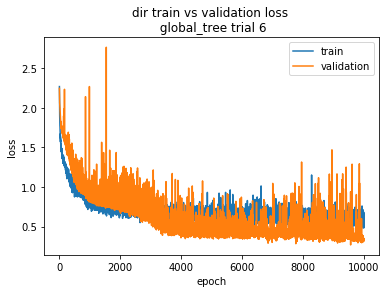

In [274]:
from matplotlib import pyplot

pyplot.plot(history.history['op_bin_loss'])
pyplot.plot(history.history['val_op_bin_loss'])
pyplot.title('dir train vs validation loss \n global_tree trial 6')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

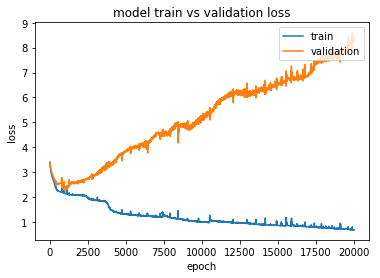

In [134]:
## w/o dropouts
from matplotlib import pyplot

pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

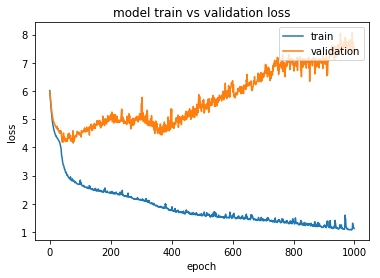

In [199]:
# with state
from matplotlib import pyplot

pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

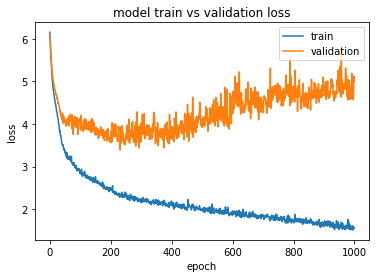

In [209]:
# with state and dropouts - 0.2
from matplotlib import pyplot

pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

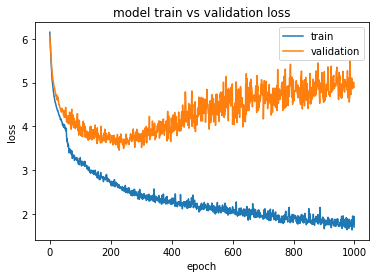

In [203]:
# with state and dropouts - 0.4
from matplotlib import pyplot

pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

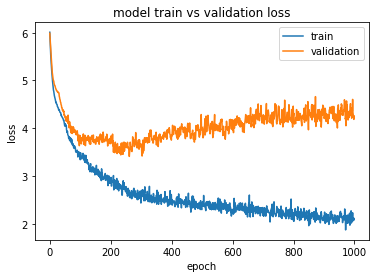

In [206]:
# with state and dropouts - 0.6
from matplotlib import pyplot

pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

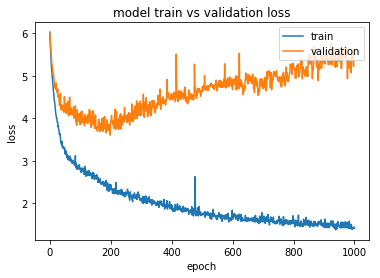

In [213]:
# with batch normalization
from matplotlib import pyplot

pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

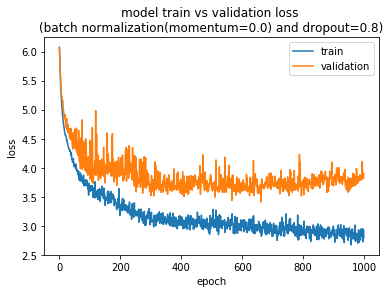

In [221]:
# with batch normalization(momentum=0.0) and dropout=0.8
from matplotlib import pyplot

pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss \n(batch normalization(momentum=0.0) and dropout=0.8)')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

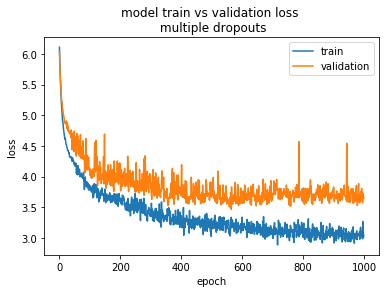

In [234]:
from matplotlib import pyplot

pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss \n multiple dropouts')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

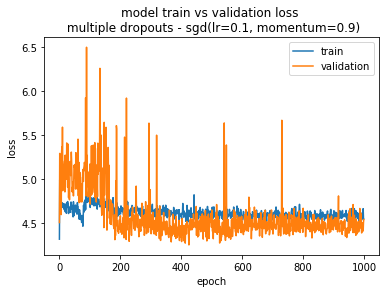

In [237]:
pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss \n multiple dropouts - sgd(lr=0.1, momentum=0.9)')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

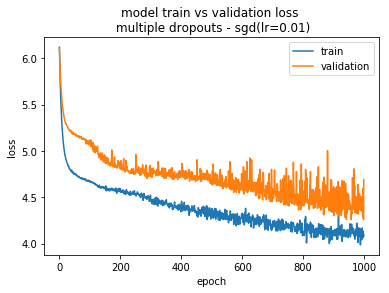

In [241]:
pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss \n multiple dropouts - sgd(lr=0.01)')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

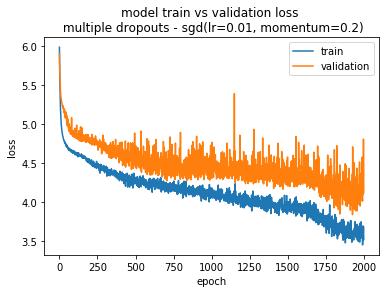

In [250]:
pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss \n multiple dropouts - sgd(lr=0.01, momentum=0.2)')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

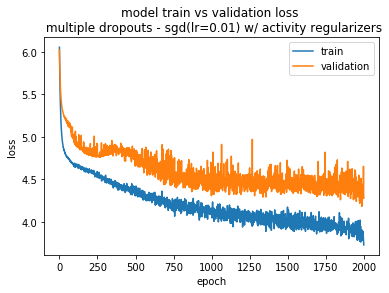

In [258]:
pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss \n multiple dropouts - sgd(lr=0.01) w/ activity regularizers')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

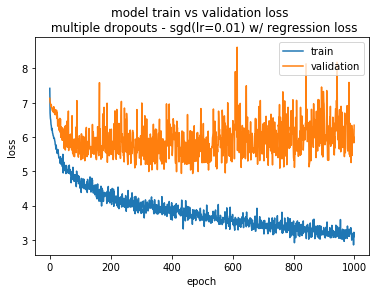

In [308]:
pyplot.plot(history.history['loss'])
pyplot.plot(history.history['val_loss'])
pyplot.title('model train vs validation loss \n multiple dropouts - sgd(lr=0.01) w/ regression loss')
pyplot.ylabel('loss')
pyplot.xlabel('epoch')
pyplot.legend(['train', 'validation'], loc='upper right')
pyplot.show()

In [244]:
model.optimizer.get_config()

{'name': 'SGD',
 'learning_rate': 0.01,
 'decay': 0.0,
 'momentum': 0.0,
 'nesterov': False}

In [128]:
history.history.keys()

dict_keys(['loss', 'op_feat_loss', 'op_bin_loss', 'op_dir_loss', 'op_feat_accuracy', 'op_bin_accuracy', 'op_dir_accuracy'])

In [157]:
from tensorflow.keras import Sequential
batch_size = 1
model = Sequential()
model.add(LSTM(50, batch_input_shape=(batch_size, 16, 15), stateful=True))
model.add(Dense(3, activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [158]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (1, 50)                   13200     
_________________________________________________________________
dense (Dense)                (1, 3)                    153       
Total params: 13,353
Trainable params: 13,353
Non-trainable params: 0
_________________________________________________________________


In [73]:
y1, y2, y3 = model.predict([x_latent, x_feat.astype(float), x_bin.astype(float), x_dir.astype(float)])

In [74]:
y1_count = []
y2_count = []
y3_count = []
for i in range(440):
    y1_count.append(np.argmax(y1[i]) == np.argmax(y_feat[i]))
    y2_count.append(np.argmax(y2[i]) == np.argmax(y_bin[i]))
    y3_count.append(np.argmax(y3[i]) == np.argmax(y_dir[i]))

In [75]:
print("feature accuracy -- ", np.sum(y1_count)/440)
print("bin accuracy -- ", np.sum(y2_count)/440)
print("dir accuracy -- ", np.sum(y3_count)/440)

feature accuracy --  0.9659090909090909
bin accuracy --  0.7545454545454545
dir accuracy --  0.9795454545454545


In [184]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
feat_ip (InputLayer)            (None, 7, 6)         0                                            
__________________________________________________________________________________________________
x_ip (InputLayer)               (None, 100)          0                                            
__________________________________________________________________________________________________
gru_1 (GRU)                     (None, 7, 100)       32100       feat_ip[0][0]                    
                                                                 x_ip[0][0]                       
__________________________________________________________________________________________________
bin_ip (InputLayer)             (None, 7, 20)        0                                            
__________

In [164]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
x_ip (InputLayer)               (None, 100)          0                                            
__________________________________________________________________________________________________
feat_ip (InputLayer)            (None, 7, 6)         0                                            
__________________________________________________________________________________________________
bin_ip (InputLayer)             (None, 7, 20)        0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             (None, 7, 4)         0                                            
__________________________________________________________________________________________________
gru_1 (GRU

In [163]:
model.layers

In [ ]:
path = ['S', '4A1', '3D0', 'E']
feat_ip = ['S', 4, 3, E]
ip_2 = [0, 'A', 'D', 0]
ip_3 = [0,'']
# Correct masking issue
# Interconnect RNNS, first to second 

In [157]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
x_ip (InputLayer)               (None, 100)          0                                            
__________________________________________________________________________________________________
feat_ip (InputLayer)            (None, 7, 6)         0                                            
__________________________________________________________________________________________________
bin_ip (InputLayer)             (None, 7, 20)        0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             (None, 7, 4)         0                                            
__________________________________________________________________________________________________
gru_1 (GRU

In [134]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
x_ip (InputLayer)               (None, 10)           0                                            
__________________________________________________________________________________________________
feat_ip (InputLayer)            (None, 7, 6)         0                                            
__________________________________________________________________________________________________
bin_ip (InputLayer)             (None, 7, 20)        0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             (None, 7, 4)         0                                            
__________________________________________________________________________________________________
gru_1 (GRU

In [103]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
bin_ip (InputLayer)             (None, 7, 19)        0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             (None, 7, 3)         0                                            
__________________________________________________________________________________________________
x_ip (InputLayer)               (None, 5)            0                                            
__________________________________________________________________________________________________
feat_ip (InputLayer)            (None, 7, 6)         0                                            
__________________________________________________________________________________________________
masking_7 

In [120]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
bin_ip (InputLayer)             (None, 7, 19)        0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             (None, 7, 3)         0                                            
__________________________________________________________________________________________________
x_ip (InputLayer)               (None, 5)            0                                            
__________________________________________________________________________________________________
feat_ip (InputLayer)            (None, 7, 6)         0                                            
__________________________________________________________________________________________________
masking_9 

In [215]:
from keras.utils import plot_model
plot_model(model, to_file='dag_approach_model.png')

In [188]:
path_latent_input.shape

(441, 4)

In [109]:
x_bin.shape

(441, 7, 19)

In [113]:
x_dir.shape

(441, 7, 3)

In [116]:
x_dir[0,0]

array([[ True, False, False],
       [False, False, False],
       [False, False, False],
       [False, False, False],
       [False, False, False],
       [False, False, False],
       [False, False, False]])

In [118]:
x_bin[0,0]

array([ True, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False])

In [137]:
y_cat = to_categorical(y)

# label_model_trial_6.compile(
#     optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
# label_model_trial_6.fit(
#     X, y_cat, batch_size=30, epochs=150, verbose=1, shuffle=True, validation_split=0.2)

x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=80, epochs=20000, verbose=1)
# Latent dim -- 10

Epoch 1/20000
441/441 [==============================] - 2s 5ms/step - loss: 1.1025 - op_feat_loss: 0.2487 - op_bin_loss: 0.6944 - op_dir_loss: 0.1595 - op_feat_acc: 0.8662 - op_bin_acc: 0.7438 - op_dir_acc: 0.9297
Epoch 2/20000
441/441 [==============================] - 0s 79us/step - loss: 1.1669 - op_feat_loss: 0.2268 - op_bin_loss: 0.7685 - op_dir_loss: 0.1716 - op_feat_acc: 0.8980 - op_bin_acc: 0.7234 - op_dir_acc: 0.9252
Epoch 3/20000
441/441 [==============================] - 0s 88us/step - loss: 1.1145 - op_feat_loss: 0.2440 - op_bin_loss: 0.7113 - op_dir_loss: 0.1592 - op_feat_acc: 0.8889 - op_bin_acc: 0.7279 - op_dir_acc: 0.9342
Epoch 4/20000
441/441 [==============================] - 0s 86us/step - loss: 1.0679 - op_feat_loss: 0.2257 - op_bin_loss: 0.6868 - op_dir_loss: 0.1554 - op_feat_acc: 0.8957 - op_bin_acc: 0.7392 - op_dir_acc: 0.9274
Epoch 5/20000
441/441 [==============================] - 0s 85us/step - loss: 1.0673 - op_feat_loss: 0.2152 - op_bin_loss: 0.6984 - op_di

441/441 [==============================] - 0s 106us/step - loss: 1.0352 - op_feat_loss: 0.2113 - op_bin_loss: 0.6735 - op_dir_loss: 0.1504 - op_feat_acc: 0.9002 - op_bin_acc: 0.7370 - op_dir_acc: 0.9342
Epoch 76/20000
441/441 [==============================] - 0s 99us/step - loss: 1.0347 - op_feat_loss: 0.2096 - op_bin_loss: 0.6741 - op_dir_loss: 0.1510 - op_feat_acc: 0.9161 - op_bin_acc: 0.7392 - op_dir_acc: 0.9320
Epoch 77/20000
441/441 [==============================] - 0s 92us/step - loss: 1.0336 - op_feat_loss: 0.2102 - op_bin_loss: 0.6724 - op_dir_loss: 0.1509 - op_feat_acc: 0.9116 - op_bin_acc: 0.7347 - op_dir_acc: 0.9297
Epoch 78/20000
441/441 [==============================] - 0s 84us/step - loss: 1.0458 - op_feat_loss: 0.2095 - op_bin_loss: 0.6863 - op_dir_loss: 0.1499 - op_feat_acc: 0.9048 - op_bin_acc: 0.7347 - op_dir_acc: 0.9342
Epoch 79/20000
441/441 [==============================] - 0s 96us/step - loss: 1.0337 - op_feat_loss: 0.2110 - op_bin_loss: 0.6727 - op_dir_loss: 

441/441 [==============================] - 0s 79us/step - loss: 1.0760 - op_feat_loss: 0.2151 - op_bin_loss: 0.6673 - op_dir_loss: 0.1936 - op_feat_acc: 0.9002 - op_bin_acc: 0.7460 - op_dir_acc: 0.9161
Epoch 150/20000
441/441 [==============================] - 0s 75us/step - loss: 1.0499 - op_feat_loss: 0.2118 - op_bin_loss: 0.6644 - op_dir_loss: 0.1737 - op_feat_acc: 0.8980 - op_bin_acc: 0.7438 - op_dir_acc: 0.9206
Epoch 151/20000
441/441 [==============================] - 0s 74us/step - loss: 1.0480 - op_feat_loss: 0.2132 - op_bin_loss: 0.6703 - op_dir_loss: 0.1645 - op_feat_acc: 0.9048 - op_bin_acc: 0.7347 - op_dir_acc: 0.9297
Epoch 152/20000
441/441 [==============================] - 0s 64us/step - loss: 1.0361 - op_feat_loss: 0.2074 - op_bin_loss: 0.6672 - op_dir_loss: 0.1615 - op_feat_acc: 0.9070 - op_bin_acc: 0.7460 - op_dir_acc: 0.9206
Epoch 153/20000
441/441 [==============================] - 0s 68us/step - loss: 1.0341 - op_feat_loss: 0.2105 - op_bin_loss: 0.6661 - op_dir_los

441/441 [==============================] - 0s 87us/step - loss: 1.0243 - op_feat_loss: 0.2092 - op_bin_loss: 0.6654 - op_dir_loss: 0.1497 - op_feat_acc: 0.9070 - op_bin_acc: 0.7460 - op_dir_acc: 0.9342
Epoch 224/20000
441/441 [==============================] - 0s 66us/step - loss: 1.0262 - op_feat_loss: 0.2071 - op_bin_loss: 0.6706 - op_dir_loss: 0.1485 - op_feat_acc: 0.9138 - op_bin_acc: 0.7460 - op_dir_acc: 0.9365
Epoch 225/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0376 - op_feat_loss: 0.2092 - op_bin_loss: 0.6788 - op_dir_loss: 0.1495 - op_feat_acc: 0.9116 - op_bin_acc: 0.7256 - op_dir_acc: 0.9365
Epoch 226/20000
441/441 [==============================] - 0s 72us/step - loss: 1.0269 - op_feat_loss: 0.2059 - op_bin_loss: 0.6720 - op_dir_loss: 0.1491 - op_feat_acc: 0.9048 - op_bin_acc: 0.7415 - op_dir_acc: 0.9365
Epoch 227/20000
441/441 [==============================] - 0s 75us/step - loss: 1.0208 - op_feat_loss: 0.2071 - op_bin_loss: 0.6640 - op_dir_los

441/441 [==============================] - 0s 66us/step - loss: 1.0828 - op_feat_loss: 0.2069 - op_bin_loss: 0.7286 - op_dir_loss: 0.1472 - op_feat_acc: 0.9138 - op_bin_acc: 0.7211 - op_dir_acc: 0.9320
Epoch 298/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0569 - op_feat_loss: 0.2061 - op_bin_loss: 0.7026 - op_dir_loss: 0.1482 - op_feat_acc: 0.9116 - op_bin_acc: 0.7324 - op_dir_acc: 0.9365
Epoch 299/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0468 - op_feat_loss: 0.2058 - op_bin_loss: 0.6925 - op_dir_loss: 0.1484 - op_feat_acc: 0.9070 - op_bin_acc: 0.7279 - op_dir_acc: 0.9365
Epoch 300/20000
441/441 [==============================] - 0s 64us/step - loss: 1.0360 - op_feat_loss: 0.2055 - op_bin_loss: 0.6797 - op_dir_loss: 0.1507 - op_feat_acc: 0.9070 - op_bin_acc: 0.7347 - op_dir_acc: 0.9388
Epoch 301/20000
441/441 [==============================] - 0s 77us/step - loss: 1.0505 - op_feat_loss: 0.2078 - op_bin_loss: 0.6867 - op_dir_los

441/441 [==============================] - 0s 71us/step - loss: 1.0270 - op_feat_loss: 0.2047 - op_bin_loss: 0.6747 - op_dir_loss: 0.1476 - op_feat_acc: 0.9070 - op_bin_acc: 0.7370 - op_dir_acc: 0.9342
Epoch 372/20000
441/441 [==============================] - 0s 80us/step - loss: 1.0295 - op_feat_loss: 0.2068 - op_bin_loss: 0.6740 - op_dir_loss: 0.1487 - op_feat_acc: 0.9093 - op_bin_acc: 0.7392 - op_dir_acc: 0.9342
Epoch 373/20000
441/441 [==============================] - 0s 71us/step - loss: 1.0421 - op_feat_loss: 0.2043 - op_bin_loss: 0.6896 - op_dir_loss: 0.1482 - op_feat_acc: 0.9070 - op_bin_acc: 0.7370 - op_dir_acc: 0.9342
Epoch 374/20000
441/441 [==============================] - 0s 72us/step - loss: 1.0263 - op_feat_loss: 0.2059 - op_bin_loss: 0.6733 - op_dir_loss: 0.1472 - op_feat_acc: 0.9138 - op_bin_acc: 0.7483 - op_dir_acc: 0.9320
Epoch 375/20000
441/441 [==============================] - 0s 84us/step - loss: 1.0150 - op_feat_loss: 0.2079 - op_bin_loss: 0.6598 - op_dir_los

441/441 [==============================] - 0s 68us/step - loss: 1.0546 - op_feat_loss: 0.2220 - op_bin_loss: 0.6838 - op_dir_loss: 0.1488 - op_feat_acc: 0.9048 - op_bin_acc: 0.7483 - op_dir_acc: 0.9320
Epoch 446/20000
441/441 [==============================] - 0s 69us/step - loss: 1.0510 - op_feat_loss: 0.2313 - op_bin_loss: 0.6724 - op_dir_loss: 0.1473 - op_feat_acc: 0.8934 - op_bin_acc: 0.7438 - op_dir_acc: 0.9365
Epoch 447/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0710 - op_feat_loss: 0.2418 - op_bin_loss: 0.6705 - op_dir_loss: 0.1586 - op_feat_acc: 0.8821 - op_bin_acc: 0.7302 - op_dir_acc: 0.9297
Epoch 448/20000
441/441 [==============================] - 0s 69us/step - loss: 1.1277 - op_feat_loss: 0.2820 - op_bin_loss: 0.6606 - op_dir_loss: 0.1851 - op_feat_acc: 0.8685 - op_bin_acc: 0.7460 - op_dir_acc: 0.9297
Epoch 449/20000
441/441 [==============================] - 0s 65us/step - loss: 1.1758 - op_feat_loss: 0.2213 - op_bin_loss: 0.6664 - op_dir_los

441/441 [==============================] - 0s 73us/step - loss: 1.0127 - op_feat_loss: 0.2099 - op_bin_loss: 0.6564 - op_dir_loss: 0.1463 - op_feat_acc: 0.9070 - op_bin_acc: 0.7438 - op_dir_acc: 0.9388
Epoch 520/20000
441/441 [==============================] - 0s 65us/step - loss: 1.0167 - op_feat_loss: 0.2061 - op_bin_loss: 0.6640 - op_dir_loss: 0.1466 - op_feat_acc: 0.9093 - op_bin_acc: 0.7460 - op_dir_acc: 0.9388
Epoch 521/20000
441/441 [==============================] - 0s 71us/step - loss: 1.0194 - op_feat_loss: 0.2116 - op_bin_loss: 0.6611 - op_dir_loss: 0.1467 - op_feat_acc: 0.9002 - op_bin_acc: 0.7506 - op_dir_acc: 0.9365
Epoch 522/20000
441/441 [==============================] - 0s 68us/step - loss: 1.0183 - op_feat_loss: 0.2123 - op_bin_loss: 0.6593 - op_dir_loss: 0.1468 - op_feat_acc: 0.9048 - op_bin_acc: 0.7438 - op_dir_acc: 0.9410
Epoch 523/20000
441/441 [==============================] - 0s 72us/step - loss: 1.0179 - op_feat_loss: 0.2149 - op_bin_loss: 0.6562 - op_dir_los

441/441 [==============================] - 0s 72us/step - loss: 1.0275 - op_feat_loss: 0.2214 - op_bin_loss: 0.6615 - op_dir_loss: 0.1446 - op_feat_acc: 0.8957 - op_bin_acc: 0.7347 - op_dir_acc: 0.9365
Epoch 594/20000
441/441 [==============================] - 0s 71us/step - loss: 1.0105 - op_feat_loss: 0.2143 - op_bin_loss: 0.6517 - op_dir_loss: 0.1445 - op_feat_acc: 0.8934 - op_bin_acc: 0.7460 - op_dir_acc: 0.9365
Epoch 595/20000
441/441 [==============================] - 0s 73us/step - loss: 1.0221 - op_feat_loss: 0.2167 - op_bin_loss: 0.6609 - op_dir_loss: 0.1446 - op_feat_acc: 0.8957 - op_bin_acc: 0.7506 - op_dir_acc: 0.9388
Epoch 596/20000
441/441 [==============================] - 0s 72us/step - loss: 1.0081 - op_feat_loss: 0.2119 - op_bin_loss: 0.6515 - op_dir_loss: 0.1447 - op_feat_acc: 0.9116 - op_bin_acc: 0.7574 - op_dir_acc: 0.9388
Epoch 597/20000
441/441 [==============================] - 0s 72us/step - loss: 1.0023 - op_feat_loss: 0.2051 - op_bin_loss: 0.6518 - op_dir_los

441/441 [==============================] - 0s 68us/step - loss: 1.0181 - op_feat_loss: 0.2192 - op_bin_loss: 0.6535 - op_dir_loss: 0.1454 - op_feat_acc: 0.9002 - op_bin_acc: 0.7506 - op_dir_acc: 0.9365
Epoch 668/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0186 - op_feat_loss: 0.2088 - op_bin_loss: 0.6648 - op_dir_loss: 0.1450 - op_feat_acc: 0.9093 - op_bin_acc: 0.7460 - op_dir_acc: 0.9388
Epoch 669/20000
441/441 [==============================] - 0s 63us/step - loss: 1.0262 - op_feat_loss: 0.2041 - op_bin_loss: 0.6773 - op_dir_loss: 0.1448 - op_feat_acc: 0.9070 - op_bin_acc: 0.7438 - op_dir_acc: 0.9388
Epoch 670/20000
441/441 [==============================] - 0s 65us/step - loss: 1.0337 - op_feat_loss: 0.2069 - op_bin_loss: 0.6820 - op_dir_loss: 0.1448 - op_feat_acc: 0.9070 - op_bin_acc: 0.7551 - op_dir_acc: 0.9388
Epoch 671/20000
441/441 [==============================] - 0s 66us/step - loss: 1.0286 - op_feat_loss: 0.2008 - op_bin_loss: 0.6831 - op_dir_los

441/441 [==============================] - 0s 69us/step - loss: 1.0498 - op_feat_loss: 0.2051 - op_bin_loss: 0.7011 - op_dir_loss: 0.1435 - op_feat_acc: 0.9025 - op_bin_acc: 0.7302 - op_dir_acc: 0.9365
Epoch 742/20000
441/441 [==============================] - 0s 69us/step - loss: 1.0426 - op_feat_loss: 0.2082 - op_bin_loss: 0.6891 - op_dir_loss: 0.1454 - op_feat_acc: 0.9048 - op_bin_acc: 0.7460 - op_dir_acc: 0.9388
Epoch 743/20000
441/441 [==============================] - 0s 65us/step - loss: 1.0368 - op_feat_loss: 0.2060 - op_bin_loss: 0.6880 - op_dir_loss: 0.1429 - op_feat_acc: 0.9070 - op_bin_acc: 0.7302 - op_dir_acc: 0.9365
Epoch 744/20000
441/441 [==============================] - 0s 65us/step - loss: 1.0202 - op_feat_loss: 0.2126 - op_bin_loss: 0.6620 - op_dir_loss: 0.1456 - op_feat_acc: 0.9093 - op_bin_acc: 0.7438 - op_dir_acc: 0.9342
Epoch 745/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0459 - op_feat_loss: 0.2240 - op_bin_loss: 0.6784 - op_dir_los

441/441 [==============================] - 0s 68us/step - loss: 0.9982 - op_feat_loss: 0.1983 - op_bin_loss: 0.6549 - op_dir_loss: 0.1450 - op_feat_acc: 0.9070 - op_bin_acc: 0.7574 - op_dir_acc: 0.9365
Epoch 816/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9976 - op_feat_loss: 0.2008 - op_bin_loss: 0.6509 - op_dir_loss: 0.1459 - op_feat_acc: 0.9048 - op_bin_acc: 0.7438 - op_dir_acc: 0.9342
Epoch 817/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9958 - op_feat_loss: 0.2035 - op_bin_loss: 0.6449 - op_dir_loss: 0.1474 - op_feat_acc: 0.9138 - op_bin_acc: 0.7596 - op_dir_acc: 0.9320
Epoch 818/20000
441/441 [==============================] - 0s 82us/step - loss: 1.0099 - op_feat_loss: 0.2034 - op_bin_loss: 0.6499 - op_dir_loss: 0.1566 - op_feat_acc: 0.9116 - op_bin_acc: 0.7506 - op_dir_acc: 0.9297
Epoch 819/20000
441/441 [==============================] - 0s 72us/step - loss: 1.2059 - op_feat_loss: 0.1978 - op_bin_loss: 0.6499 - op_dir_los

441/441 [==============================] - 0s 64us/step - loss: 1.0238 - op_feat_loss: 0.2017 - op_bin_loss: 0.6780 - op_dir_loss: 0.1441 - op_feat_acc: 0.9093 - op_bin_acc: 0.7415 - op_dir_acc: 0.9388
Epoch 890/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0281 - op_feat_loss: 0.1955 - op_bin_loss: 0.6891 - op_dir_loss: 0.1435 - op_feat_acc: 0.9070 - op_bin_acc: 0.7438 - op_dir_acc: 0.9388
Epoch 891/20000
441/441 [==============================] - 0s 64us/step - loss: 1.0638 - op_feat_loss: 0.1951 - op_bin_loss: 0.7250 - op_dir_loss: 0.1437 - op_feat_acc: 0.9093 - op_bin_acc: 0.7438 - op_dir_acc: 0.9388
Epoch 892/20000
441/441 [==============================] - 0s 63us/step - loss: 1.0133 - op_feat_loss: 0.1992 - op_bin_loss: 0.6703 - op_dir_loss: 0.1437 - op_feat_acc: 0.9070 - op_bin_acc: 0.7370 - op_dir_acc: 0.9388
Epoch 893/20000
441/441 [==============================] - 0s 73us/step - loss: 1.0230 - op_feat_loss: 0.2011 - op_bin_loss: 0.6783 - op_dir_los

441/441 [==============================] - 0s 69us/step - loss: 0.9920 - op_feat_loss: 0.2021 - op_bin_loss: 0.6466 - op_dir_loss: 0.1433 - op_feat_acc: 0.9002 - op_bin_acc: 0.7551 - op_dir_acc: 0.9365
Epoch 964/20000
441/441 [==============================] - 0s 62us/step - loss: 0.9885 - op_feat_loss: 0.1991 - op_bin_loss: 0.6458 - op_dir_loss: 0.1435 - op_feat_acc: 0.9138 - op_bin_acc: 0.7596 - op_dir_acc: 0.9410
Epoch 965/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9846 - op_feat_loss: 0.1957 - op_bin_loss: 0.6461 - op_dir_loss: 0.1428 - op_feat_acc: 0.9002 - op_bin_acc: 0.7574 - op_dir_acc: 0.9365
Epoch 966/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9857 - op_feat_loss: 0.1983 - op_bin_loss: 0.6446 - op_dir_loss: 0.1428 - op_feat_acc: 0.9116 - op_bin_acc: 0.7528 - op_dir_acc: 0.9388
Epoch 967/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9944 - op_feat_loss: 0.2085 - op_bin_loss: 0.6436 - op_dir_los

441/441 [==============================] - 0s 68us/step - loss: 1.0232 - op_feat_loss: 0.2200 - op_bin_loss: 0.6596 - op_dir_loss: 0.1436 - op_feat_acc: 0.9025 - op_bin_acc: 0.7392 - op_dir_acc: 0.9388
Epoch 1038/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0207 - op_feat_loss: 0.2302 - op_bin_loss: 0.6494 - op_dir_loss: 0.1411 - op_feat_acc: 0.8980 - op_bin_acc: 0.7551 - op_dir_acc: 0.9388
Epoch 1039/20000
441/441 [==============================] - 0s 74us/step - loss: 1.0003 - op_feat_loss: 0.2043 - op_bin_loss: 0.6542 - op_dir_loss: 0.1417 - op_feat_acc: 0.8980 - op_bin_acc: 0.7438 - op_dir_acc: 0.9410
Epoch 1040/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0015 - op_feat_loss: 0.2002 - op_bin_loss: 0.6611 - op_dir_loss: 0.1403 - op_feat_acc: 0.9138 - op_bin_acc: 0.7460 - op_dir_acc: 0.9410
Epoch 1041/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9999 - op_feat_loss: 0.2013 - op_bin_loss: 0.6570 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.9786 - op_feat_loss: 0.1934 - op_bin_loss: 0.6423 - op_dir_loss: 0.1429 - op_feat_acc: 0.9093 - op_bin_acc: 0.7460 - op_dir_acc: 0.9342
Epoch 1112/20000
441/441 [==============================] - 0s 76us/step - loss: 0.9845 - op_feat_loss: 0.1954 - op_bin_loss: 0.6468 - op_dir_loss: 0.1423 - op_feat_acc: 0.9161 - op_bin_acc: 0.7506 - op_dir_acc: 0.9388
Epoch 1113/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9943 - op_feat_loss: 0.2014 - op_bin_loss: 0.6503 - op_dir_loss: 0.1427 - op_feat_acc: 0.9048 - op_bin_acc: 0.7642 - op_dir_acc: 0.9410
Epoch 1114/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9885 - op_feat_loss: 0.1950 - op_bin_loss: 0.6510 - op_dir_loss: 0.1425 - op_feat_acc: 0.9116 - op_bin_acc: 0.7506 - op_dir_acc: 0.9388
Epoch 1115/20000
441/441 [==============================] - 0s 68us/step - loss: 1.0065 - op_feat_loss: 0.2151 - op_bin_loss: 0.6492 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.9700 - op_feat_loss: 0.1899 - op_bin_loss: 0.6401 - op_dir_loss: 0.1400 - op_feat_acc: 0.9116 - op_bin_acc: 0.7596 - op_dir_acc: 0.9388
Epoch 1186/20000
441/441 [==============================] - 0s 84us/step - loss: 0.9813 - op_feat_loss: 0.1920 - op_bin_loss: 0.6476 - op_dir_loss: 0.1417 - op_feat_acc: 0.9093 - op_bin_acc: 0.7506 - op_dir_acc: 0.9365
Epoch 1187/20000
441/441 [==============================] - 0s 82us/step - loss: 1.0016 - op_feat_loss: 0.1977 - op_bin_loss: 0.6629 - op_dir_loss: 0.1410 - op_feat_acc: 0.9070 - op_bin_acc: 0.7528 - op_dir_acc: 0.9365
Epoch 1188/20000
441/441 [==============================] - 0s 86us/step - loss: 0.9956 - op_feat_loss: 0.1992 - op_bin_loss: 0.6545 - op_dir_loss: 0.1418 - op_feat_acc: 0.9093 - op_bin_acc: 0.7415 - op_dir_acc: 0.9388
Epoch 1189/20000
441/441 [==============================] - 0s 91us/step - loss: 1.0019 - op_feat_loss: 0.2062 - op_bin_loss: 0.6559 - op_dir

441/441 [==============================] - 0s 81us/step - loss: 1.0639 - op_feat_loss: 0.1976 - op_bin_loss: 0.6409 - op_dir_loss: 0.2253 - op_feat_acc: 0.9048 - op_bin_acc: 0.7574 - op_dir_acc: 0.9093
Epoch 1260/20000
441/441 [==============================] - 0s 68us/step - loss: 1.0495 - op_feat_loss: 0.1963 - op_bin_loss: 0.6430 - op_dir_loss: 0.2102 - op_feat_acc: 0.9093 - op_bin_acc: 0.7506 - op_dir_acc: 0.9229
Epoch 1261/20000
441/441 [==============================] - 0s 77us/step - loss: 1.0473 - op_feat_loss: 0.1966 - op_bin_loss: 0.6491 - op_dir_loss: 0.2016 - op_feat_acc: 0.9116 - op_bin_acc: 0.7483 - op_dir_acc: 0.9206
Epoch 1262/20000
441/441 [==============================] - 0s 84us/step - loss: 1.1434 - op_feat_loss: 0.2051 - op_bin_loss: 0.6550 - op_dir_loss: 0.2832 - op_feat_acc: 0.9025 - op_bin_acc: 0.7506 - op_dir_acc: 0.9048
Epoch 1263/20000
441/441 [==============================] - 0s 95us/step - loss: 1.0901 - op_feat_loss: 0.2007 - op_bin_loss: 0.6422 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.9840 - op_feat_loss: 0.1856 - op_bin_loss: 0.6590 - op_dir_loss: 0.1393 - op_feat_acc: 0.9093 - op_bin_acc: 0.7460 - op_dir_acc: 0.9388
Epoch 1334/20000
441/441 [==============================] - 0s 65us/step - loss: 0.9805 - op_feat_loss: 0.1905 - op_bin_loss: 0.6494 - op_dir_loss: 0.1405 - op_feat_acc: 0.9070 - op_bin_acc: 0.7619 - op_dir_acc: 0.9342
Epoch 1335/20000
441/441 [==============================] - 0s 76us/step - loss: 1.0139 - op_feat_loss: 0.1983 - op_bin_loss: 0.6738 - op_dir_loss: 0.1418 - op_feat_acc: 0.9048 - op_bin_acc: 0.7438 - op_dir_acc: 0.9388
Epoch 1336/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9910 - op_feat_loss: 0.1888 - op_bin_loss: 0.6617 - op_dir_loss: 0.1405 - op_feat_acc: 0.9025 - op_bin_acc: 0.7574 - op_dir_acc: 0.9342
Epoch 1337/20000
441/441 [==============================] - 0s 69us/step - loss: 1.0260 - op_feat_loss: 0.1893 - op_bin_loss: 0.6947 - op_dir

441/441 [==============================] - 0s 107us/step - loss: 0.9617 - op_feat_loss: 0.1850 - op_bin_loss: 0.6379 - op_dir_loss: 0.1388 - op_feat_acc: 0.9138 - op_bin_acc: 0.7460 - op_dir_acc: 0.9342
Epoch 1408/20000
441/441 [==============================] - 0s 90us/step - loss: 0.9668 - op_feat_loss: 0.1864 - op_bin_loss: 0.6413 - op_dir_loss: 0.1391 - op_feat_acc: 0.9138 - op_bin_acc: 0.7619 - op_dir_acc: 0.9388
Epoch 1409/20000
441/441 [==============================] - 0s 82us/step - loss: 0.9649 - op_feat_loss: 0.1875 - op_bin_loss: 0.6379 - op_dir_loss: 0.1394 - op_feat_acc: 0.9093 - op_bin_acc: 0.7574 - op_dir_acc: 0.9388
Epoch 1410/20000
441/441 [==============================] - 0s 87us/step - loss: 0.9674 - op_feat_loss: 0.1888 - op_bin_loss: 0.6394 - op_dir_loss: 0.1392 - op_feat_acc: 0.9093 - op_bin_acc: 0.7528 - op_dir_acc: 0.9388
Epoch 1411/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9627 - op_feat_loss: 0.1847 - op_bin_loss: 0.6389 - op_di

441/441 [==============================] - 0s 66us/step - loss: 0.9707 - op_feat_loss: 0.1948 - op_bin_loss: 0.6344 - op_dir_loss: 0.1414 - op_feat_acc: 0.9093 - op_bin_acc: 0.7528 - op_dir_acc: 0.9365
Epoch 1482/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9806 - op_feat_loss: 0.1880 - op_bin_loss: 0.6548 - op_dir_loss: 0.1378 - op_feat_acc: 0.9093 - op_bin_acc: 0.7596 - op_dir_acc: 0.9388
Epoch 1483/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9673 - op_feat_loss: 0.1856 - op_bin_loss: 0.6436 - op_dir_loss: 0.1382 - op_feat_acc: 0.9116 - op_bin_acc: 0.7460 - op_dir_acc: 0.9388
Epoch 1484/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9773 - op_feat_loss: 0.1912 - op_bin_loss: 0.6487 - op_dir_loss: 0.1374 - op_feat_acc: 0.9116 - op_bin_acc: 0.7551 - op_dir_acc: 0.9388
Epoch 1485/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9653 - op_feat_loss: 0.1867 - op_bin_loss: 0.6404 - op_dir

441/441 [==============================] - 0s 77us/step - loss: 0.9796 - op_feat_loss: 0.1914 - op_bin_loss: 0.6513 - op_dir_loss: 0.1368 - op_feat_acc: 0.9093 - op_bin_acc: 0.7574 - op_dir_acc: 0.9388
Epoch 1556/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9910 - op_feat_loss: 0.1907 - op_bin_loss: 0.6642 - op_dir_loss: 0.1361 - op_feat_acc: 0.9138 - op_bin_acc: 0.7392 - op_dir_acc: 0.9388
Epoch 1557/20000
441/441 [==============================] - 0s 75us/step - loss: 0.9736 - op_feat_loss: 0.1910 - op_bin_loss: 0.6461 - op_dir_loss: 0.1366 - op_feat_acc: 0.9093 - op_bin_acc: 0.7528 - op_dir_acc: 0.9410
Epoch 1558/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9689 - op_feat_loss: 0.1963 - op_bin_loss: 0.6339 - op_dir_loss: 0.1387 - op_feat_acc: 0.9002 - op_bin_acc: 0.7506 - op_dir_acc: 0.9410
Epoch 1559/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9771 - op_feat_loss: 0.1860 - op_bin_loss: 0.6540 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.9620 - op_feat_loss: 0.1799 - op_bin_loss: 0.6442 - op_dir_loss: 0.1379 - op_feat_acc: 0.9206 - op_bin_acc: 0.7574 - op_dir_acc: 0.9388
Epoch 1630/20000
441/441 [==============================] - 0s 78us/step - loss: 0.9745 - op_feat_loss: 0.1891 - op_bin_loss: 0.6480 - op_dir_loss: 0.1373 - op_feat_acc: 0.9161 - op_bin_acc: 0.7642 - op_dir_acc: 0.9410
Epoch 1631/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9722 - op_feat_loss: 0.1875 - op_bin_loss: 0.6474 - op_dir_loss: 0.1373 - op_feat_acc: 0.9116 - op_bin_acc: 0.7596 - op_dir_acc: 0.9388
Epoch 1632/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9670 - op_feat_loss: 0.1844 - op_bin_loss: 0.6454 - op_dir_loss: 0.1372 - op_feat_acc: 0.9161 - op_bin_acc: 0.7528 - op_dir_acc: 0.9410
Epoch 1633/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9710 - op_feat_loss: 0.1860 - op_bin_loss: 0.6481 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 0.9960 - op_feat_loss: 0.1918 - op_bin_loss: 0.6668 - op_dir_loss: 0.1374 - op_feat_acc: 0.9070 - op_bin_acc: 0.7506 - op_dir_acc: 0.9388
Epoch 1704/20000
441/441 [==============================] - 0s 74us/step - loss: 0.9989 - op_feat_loss: 0.1970 - op_bin_loss: 0.6627 - op_dir_loss: 0.1392 - op_feat_acc: 0.9048 - op_bin_acc: 0.7415 - op_dir_acc: 0.9410
Epoch 1705/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9895 - op_feat_loss: 0.2077 - op_bin_loss: 0.6416 - op_dir_loss: 0.1401 - op_feat_acc: 0.8957 - op_bin_acc: 0.7528 - op_dir_acc: 0.9388
Epoch 1706/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9698 - op_feat_loss: 0.1960 - op_bin_loss: 0.6334 - op_dir_loss: 0.1403 - op_feat_acc: 0.9138 - op_bin_acc: 0.7506 - op_dir_acc: 0.9433
Epoch 1707/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9600 - op_feat_loss: 0.1896 - op_bin_loss: 0.6299 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.9904 - op_feat_loss: 0.1863 - op_bin_loss: 0.6338 - op_dir_loss: 0.1703 - op_feat_acc: 0.9116 - op_bin_acc: 0.7574 - op_dir_acc: 0.9297
Epoch 1778/20000
441/441 [==============================] - 0s 65us/step - loss: 1.0617 - op_feat_loss: 0.1832 - op_bin_loss: 0.6299 - op_dir_loss: 0.2486 - op_feat_acc: 0.9161 - op_bin_acc: 0.7642 - op_dir_acc: 0.9002
Epoch 1779/20000
441/441 [==============================] - 0s 68us/step - loss: 1.0116 - op_feat_loss: 0.1859 - op_bin_loss: 0.6295 - op_dir_loss: 0.1962 - op_feat_acc: 0.9116 - op_bin_acc: 0.7687 - op_dir_acc: 0.9138
Epoch 1780/20000
441/441 [==============================] - 0s 72us/step - loss: 1.0535 - op_feat_loss: 0.1835 - op_bin_loss: 0.6347 - op_dir_loss: 0.2353 - op_feat_acc: 0.9229 - op_bin_acc: 0.7619 - op_dir_acc: 0.9070
Epoch 1781/20000
441/441 [==============================] - 0s 62us/step - loss: 1.0062 - op_feat_loss: 0.1805 - op_bin_loss: 0.6452 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.9553 - op_feat_loss: 0.1850 - op_bin_loss: 0.6355 - op_dir_loss: 0.1347 - op_feat_acc: 0.9161 - op_bin_acc: 0.7687 - op_dir_acc: 0.9433
Epoch 1852/20000
441/441 [==============================] - 0s 62us/step - loss: 0.9525 - op_feat_loss: 0.1805 - op_bin_loss: 0.6372 - op_dir_loss: 0.1348 - op_feat_acc: 0.9229 - op_bin_acc: 0.7506 - op_dir_acc: 0.9410
Epoch 1853/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9512 - op_feat_loss: 0.1822 - op_bin_loss: 0.6348 - op_dir_loss: 0.1341 - op_feat_acc: 0.9161 - op_bin_acc: 0.7528 - op_dir_acc: 0.9410
Epoch 1854/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9470 - op_feat_loss: 0.1821 - op_bin_loss: 0.6304 - op_dir_loss: 0.1345 - op_feat_acc: 0.9116 - op_bin_acc: 0.7596 - op_dir_acc: 0.9410
Epoch 1855/20000
441/441 [==============================] - 0s 82us/step - loss: 0.9515 - op_feat_loss: 0.1795 - op_bin_loss: 0.6371 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 0.9538 - op_feat_loss: 0.1804 - op_bin_loss: 0.6403 - op_dir_loss: 0.1331 - op_feat_acc: 0.9206 - op_bin_acc: 0.7528 - op_dir_acc: 0.9410
Epoch 1926/20000
441/441 [==============================] - 0s 74us/step - loss: 0.9467 - op_feat_loss: 0.1813 - op_bin_loss: 0.6316 - op_dir_loss: 0.1339 - op_feat_acc: 0.9138 - op_bin_acc: 0.7574 - op_dir_acc: 0.9388
Epoch 1927/20000
441/441 [==============================] - 0s 76us/step - loss: 0.9445 - op_feat_loss: 0.1770 - op_bin_loss: 0.6336 - op_dir_loss: 0.1338 - op_feat_acc: 0.9274 - op_bin_acc: 0.7506 - op_dir_acc: 0.9388
Epoch 1928/20000
441/441 [==============================] - 0s 76us/step - loss: 0.9454 - op_feat_loss: 0.1791 - op_bin_loss: 0.6323 - op_dir_loss: 0.1340 - op_feat_acc: 0.9116 - op_bin_acc: 0.7574 - op_dir_acc: 0.9388
Epoch 1929/20000
441/441 [==============================] - 0s 96us/step - loss: 0.9389 - op_feat_loss: 0.1780 - op_bin_loss: 0.6276 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.9572 - op_feat_loss: 0.1772 - op_bin_loss: 0.6463 - op_dir_loss: 0.1337 - op_feat_acc: 0.9274 - op_bin_acc: 0.7460 - op_dir_acc: 0.9456
Epoch 2000/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9566 - op_feat_loss: 0.1764 - op_bin_loss: 0.6469 - op_dir_loss: 0.1333 - op_feat_acc: 0.9229 - op_bin_acc: 0.7506 - op_dir_acc: 0.9433
Epoch 2001/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9473 - op_feat_loss: 0.1780 - op_bin_loss: 0.6363 - op_dir_loss: 0.1330 - op_feat_acc: 0.9138 - op_bin_acc: 0.7596 - op_dir_acc: 0.9433
Epoch 2002/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9391 - op_feat_loss: 0.1797 - op_bin_loss: 0.6257 - op_dir_loss: 0.1336 - op_feat_acc: 0.9138 - op_bin_acc: 0.7619 - op_dir_acc: 0.9433
Epoch 2003/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9429 - op_feat_loss: 0.1790 - op_bin_loss: 0.6298 - op_dir

441/441 [==============================] - 0s 83us/step - loss: 0.9748 - op_feat_loss: 0.1935 - op_bin_loss: 0.6484 - op_dir_loss: 0.1329 - op_feat_acc: 0.9138 - op_bin_acc: 0.7438 - op_dir_acc: 0.9456
Epoch 2074/20000
441/441 [==============================] - 0s 80us/step - loss: 0.9602 - op_feat_loss: 0.1934 - op_bin_loss: 0.6347 - op_dir_loss: 0.1322 - op_feat_acc: 0.9048 - op_bin_acc: 0.7574 - op_dir_acc: 0.9456
Epoch 2075/20000
441/441 [==============================] - 0s 81us/step - loss: 0.9648 - op_feat_loss: 0.1897 - op_bin_loss: 0.6425 - op_dir_loss: 0.1325 - op_feat_acc: 0.9070 - op_bin_acc: 0.7528 - op_dir_acc: 0.9456
Epoch 2076/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9534 - op_feat_loss: 0.1808 - op_bin_loss: 0.6394 - op_dir_loss: 0.1332 - op_feat_acc: 0.9048 - op_bin_acc: 0.7551 - op_dir_acc: 0.9478
Epoch 2077/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9547 - op_feat_loss: 0.1824 - op_bin_loss: 0.6385 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.9373 - op_feat_loss: 0.1756 - op_bin_loss: 0.6278 - op_dir_loss: 0.1338 - op_feat_acc: 0.9161 - op_bin_acc: 0.7619 - op_dir_acc: 0.9365
Epoch 2148/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9397 - op_feat_loss: 0.1757 - op_bin_loss: 0.6301 - op_dir_loss: 0.1339 - op_feat_acc: 0.9229 - op_bin_acc: 0.7506 - op_dir_acc: 0.9410
Epoch 2149/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9347 - op_feat_loss: 0.1727 - op_bin_loss: 0.6276 - op_dir_loss: 0.1345 - op_feat_acc: 0.9274 - op_bin_acc: 0.7642 - op_dir_acc: 0.9410
Epoch 2150/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9370 - op_feat_loss: 0.1747 - op_bin_loss: 0.6293 - op_dir_loss: 0.1329 - op_feat_acc: 0.9229 - op_bin_acc: 0.7619 - op_dir_acc: 0.9433
Epoch 2151/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9354 - op_feat_loss: 0.1752 - op_bin_loss: 0.6247 - op_dir

441/441 [==============================] - 0s 66us/step - loss: 0.9516 - op_feat_loss: 0.1857 - op_bin_loss: 0.6329 - op_dir_loss: 0.1330 - op_feat_acc: 0.9025 - op_bin_acc: 0.7642 - op_dir_acc: 0.9388
Epoch 2222/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9440 - op_feat_loss: 0.1798 - op_bin_loss: 0.6316 - op_dir_loss: 0.1326 - op_feat_acc: 0.9093 - op_bin_acc: 0.7596 - op_dir_acc: 0.9342
Epoch 2223/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9524 - op_feat_loss: 0.1887 - op_bin_loss: 0.6313 - op_dir_loss: 0.1324 - op_feat_acc: 0.9093 - op_bin_acc: 0.7551 - op_dir_acc: 0.9365
Epoch 2224/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9574 - op_feat_loss: 0.1857 - op_bin_loss: 0.6389 - op_dir_loss: 0.1327 - op_feat_acc: 0.9161 - op_bin_acc: 0.7438 - op_dir_acc: 0.9388
Epoch 2225/20000
441/441 [==============================] - 0s 78us/step - loss: 0.9466 - op_feat_loss: 0.1821 - op_bin_loss: 0.6318 - op_dir

441/441 [==============================] - 0s 67us/step - loss: 0.9406 - op_feat_loss: 0.1720 - op_bin_loss: 0.6381 - op_dir_loss: 0.1305 - op_feat_acc: 0.9161 - op_bin_acc: 0.7596 - op_dir_acc: 0.9433
Epoch 2296/20000
441/441 [==============================] - 0s 75us/step - loss: 0.9443 - op_feat_loss: 0.1752 - op_bin_loss: 0.6380 - op_dir_loss: 0.1311 - op_feat_acc: 0.9116 - op_bin_acc: 0.7664 - op_dir_acc: 0.9433
Epoch 2297/20000
441/441 [==============================] - 0s 88us/step - loss: 0.9372 - op_feat_loss: 0.1749 - op_bin_loss: 0.6316 - op_dir_loss: 0.1306 - op_feat_acc: 0.9206 - op_bin_acc: 0.7483 - op_dir_acc: 0.9433
Epoch 2298/20000
441/441 [==============================] - 0s 89us/step - loss: 0.9297 - op_feat_loss: 0.1706 - op_bin_loss: 0.6286 - op_dir_loss: 0.1305 - op_feat_acc: 0.9206 - op_bin_acc: 0.7551 - op_dir_acc: 0.9410
Epoch 2299/20000
441/441 [==============================] - 0s 94us/step - loss: 0.9282 - op_feat_loss: 0.1717 - op_bin_loss: 0.6256 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 0.9326 - op_feat_loss: 0.1706 - op_bin_loss: 0.6295 - op_dir_loss: 0.1326 - op_feat_acc: 0.9274 - op_bin_acc: 0.7619 - op_dir_acc: 0.9410
Epoch 2370/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9387 - op_feat_loss: 0.1735 - op_bin_loss: 0.6253 - op_dir_loss: 0.1399 - op_feat_acc: 0.9206 - op_bin_acc: 0.7642 - op_dir_acc: 0.9342
Epoch 2371/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9297 - op_feat_loss: 0.1749 - op_bin_loss: 0.6225 - op_dir_loss: 0.1324 - op_feat_acc: 0.9161 - op_bin_acc: 0.7619 - op_dir_acc: 0.9388
Epoch 2372/20000
441/441 [==============================] - 0s 63us/step - loss: 0.9370 - op_feat_loss: 0.1767 - op_bin_loss: 0.6257 - op_dir_loss: 0.1346 - op_feat_acc: 0.9206 - op_bin_acc: 0.7642 - op_dir_acc: 0.9410
Epoch 2373/20000
441/441 [==============================] - 0s 63us/step - loss: 0.9374 - op_feat_loss: 0.1764 - op_bin_loss: 0.6265 - op_dir

441/441 [==============================] - 0s 79us/step - loss: 0.9788 - op_feat_loss: 0.1797 - op_bin_loss: 0.6679 - op_dir_loss: 0.1312 - op_feat_acc: 0.9206 - op_bin_acc: 0.7392 - op_dir_acc: 0.9388
Epoch 2444/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9813 - op_feat_loss: 0.1861 - op_bin_loss: 0.6642 - op_dir_loss: 0.1309 - op_feat_acc: 0.9116 - op_bin_acc: 0.7483 - op_dir_acc: 0.9410
Epoch 2445/20000
441/441 [==============================] - 0s 63us/step - loss: 0.9552 - op_feat_loss: 0.1769 - op_bin_loss: 0.6475 - op_dir_loss: 0.1308 - op_feat_acc: 0.9161 - op_bin_acc: 0.7506 - op_dir_acc: 0.9410
Epoch 2446/20000
441/441 [==============================] - 0s 64us/step - loss: 0.9309 - op_feat_loss: 0.1724 - op_bin_loss: 0.6274 - op_dir_loss: 0.1311 - op_feat_acc: 0.9206 - op_bin_acc: 0.7619 - op_dir_acc: 0.9388
Epoch 2447/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9274 - op_feat_loss: 0.1715 - op_bin_loss: 0.6242 - op_dir

441/441 [==============================] - 0s 66us/step - loss: 1.0095 - op_feat_loss: 0.1735 - op_bin_loss: 0.6350 - op_dir_loss: 0.2010 - op_feat_acc: 0.9161 - op_bin_acc: 0.7438 - op_dir_acc: 0.9116
Epoch 2518/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9758 - op_feat_loss: 0.1731 - op_bin_loss: 0.6303 - op_dir_loss: 0.1723 - op_feat_acc: 0.9116 - op_bin_acc: 0.7619 - op_dir_acc: 0.9297
Epoch 2519/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9753 - op_feat_loss: 0.1700 - op_bin_loss: 0.6298 - op_dir_loss: 0.1756 - op_feat_acc: 0.9206 - op_bin_acc: 0.7619 - op_dir_acc: 0.9229
Epoch 2520/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9735 - op_feat_loss: 0.1704 - op_bin_loss: 0.6282 - op_dir_loss: 0.1749 - op_feat_acc: 0.9184 - op_bin_acc: 0.7596 - op_dir_acc: 0.9274
Epoch 2521/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9575 - op_feat_loss: 0.1686 - op_bin_loss: 0.6189 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.9589 - op_feat_loss: 0.1707 - op_bin_loss: 0.6582 - op_dir_loss: 0.1300 - op_feat_acc: 0.9206 - op_bin_acc: 0.7506 - op_dir_acc: 0.9433
Epoch 2592/20000
441/441 [==============================] - 0s 76us/step - loss: 0.9479 - op_feat_loss: 0.1731 - op_bin_loss: 0.6446 - op_dir_loss: 0.1302 - op_feat_acc: 0.9161 - op_bin_acc: 0.7551 - op_dir_acc: 0.9433
Epoch 2593/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9467 - op_feat_loss: 0.1773 - op_bin_loss: 0.6406 - op_dir_loss: 0.1288 - op_feat_acc: 0.9093 - op_bin_acc: 0.7642 - op_dir_acc: 0.9456
Epoch 2594/20000
441/441 [==============================] - 0s 77us/step - loss: 0.9599 - op_feat_loss: 0.1799 - op_bin_loss: 0.6501 - op_dir_loss: 0.1300 - op_feat_acc: 0.9116 - op_bin_acc: 0.7596 - op_dir_acc: 0.9456
Epoch 2595/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9531 - op_feat_loss: 0.1793 - op_bin_loss: 0.6439 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 0.9289 - op_feat_loss: 0.1697 - op_bin_loss: 0.6306 - op_dir_loss: 0.1286 - op_feat_acc: 0.9184 - op_bin_acc: 0.7687 - op_dir_acc: 0.9433
Epoch 2666/20000
441/441 [==============================] - 0s 77us/step - loss: 0.9249 - op_feat_loss: 0.1671 - op_bin_loss: 0.6292 - op_dir_loss: 0.1286 - op_feat_acc: 0.9252 - op_bin_acc: 0.7619 - op_dir_acc: 0.9410
Epoch 2667/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9201 - op_feat_loss: 0.1701 - op_bin_loss: 0.6213 - op_dir_loss: 0.1287 - op_feat_acc: 0.9252 - op_bin_acc: 0.7574 - op_dir_acc: 0.9388
Epoch 2668/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9270 - op_feat_loss: 0.1822 - op_bin_loss: 0.6156 - op_dir_loss: 0.1292 - op_feat_acc: 0.9070 - op_bin_acc: 0.7687 - op_dir_acc: 0.9410
Epoch 2669/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9202 - op_feat_loss: 0.1723 - op_bin_loss: 0.6192 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 0.9195 - op_feat_loss: 0.1692 - op_bin_loss: 0.6209 - op_dir_loss: 0.1294 - op_feat_acc: 0.9229 - op_bin_acc: 0.7619 - op_dir_acc: 0.9433
Epoch 2740/20000
441/441 [==============================] - 0s 65us/step - loss: 0.9174 - op_feat_loss: 0.1691 - op_bin_loss: 0.6208 - op_dir_loss: 0.1275 - op_feat_acc: 0.9297 - op_bin_acc: 0.7642 - op_dir_acc: 0.9456
Epoch 2741/20000
441/441 [==============================] - 0s 79us/step - loss: 0.9228 - op_feat_loss: 0.1739 - op_bin_loss: 0.6211 - op_dir_loss: 0.1278 - op_feat_acc: 0.9229 - op_bin_acc: 0.7710 - op_dir_acc: 0.9433
Epoch 2742/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9217 - op_feat_loss: 0.1719 - op_bin_loss: 0.6204 - op_dir_loss: 0.1294 - op_feat_acc: 0.9229 - op_bin_acc: 0.7596 - op_dir_acc: 0.9433
Epoch 2743/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9262 - op_feat_loss: 0.1687 - op_bin_loss: 0.6284 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 0.9234 - op_feat_loss: 0.1649 - op_bin_loss: 0.6305 - op_dir_loss: 0.1280 - op_feat_acc: 0.9274 - op_bin_acc: 0.7460 - op_dir_acc: 0.9433
Epoch 2814/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9217 - op_feat_loss: 0.1706 - op_bin_loss: 0.6217 - op_dir_loss: 0.1294 - op_feat_acc: 0.9138 - op_bin_acc: 0.7551 - op_dir_acc: 0.9410
Epoch 2815/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9217 - op_feat_loss: 0.1720 - op_bin_loss: 0.6215 - op_dir_loss: 0.1282 - op_feat_acc: 0.9206 - op_bin_acc: 0.7619 - op_dir_acc: 0.9410
Epoch 2816/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9206 - op_feat_loss: 0.1725 - op_bin_loss: 0.6189 - op_dir_loss: 0.1292 - op_feat_acc: 0.9138 - op_bin_acc: 0.7596 - op_dir_acc: 0.9456
Epoch 2817/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9136 - op_feat_loss: 0.1663 - op_bin_loss: 0.6192 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.9393 - op_feat_loss: 0.1750 - op_bin_loss: 0.6361 - op_dir_loss: 0.1282 - op_feat_acc: 0.9184 - op_bin_acc: 0.7619 - op_dir_acc: 0.9433
Epoch 2888/20000
441/441 [==============================] - 0s 78us/step - loss: 0.9235 - op_feat_loss: 0.1726 - op_bin_loss: 0.6249 - op_dir_loss: 0.1260 - op_feat_acc: 0.9229 - op_bin_acc: 0.7619 - op_dir_acc: 0.9433
Epoch 2889/20000
441/441 [==============================] - 0s 74us/step - loss: 0.9094 - op_feat_loss: 0.1688 - op_bin_loss: 0.6136 - op_dir_loss: 0.1270 - op_feat_acc: 0.9070 - op_bin_acc: 0.7687 - op_dir_acc: 0.9433
Epoch 2890/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9085 - op_feat_loss: 0.1661 - op_bin_loss: 0.6136 - op_dir_loss: 0.1287 - op_feat_acc: 0.9206 - op_bin_acc: 0.7596 - op_dir_acc: 0.9410
Epoch 2891/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9156 - op_feat_loss: 0.1664 - op_bin_loss: 0.6219 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 0.9118 - op_feat_loss: 0.1653 - op_bin_loss: 0.6146 - op_dir_loss: 0.1320 - op_feat_acc: 0.9297 - op_bin_acc: 0.7528 - op_dir_acc: 0.9388
Epoch 2962/20000
441/441 [==============================] - 0s 64us/step - loss: 0.9246 - op_feat_loss: 0.1638 - op_bin_loss: 0.6299 - op_dir_loss: 0.1309 - op_feat_acc: 0.9297 - op_bin_acc: 0.7687 - op_dir_acc: 0.9388
Epoch 2963/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9092 - op_feat_loss: 0.1639 - op_bin_loss: 0.6157 - op_dir_loss: 0.1295 - op_feat_acc: 0.9206 - op_bin_acc: 0.7596 - op_dir_acc: 0.9433
Epoch 2964/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9187 - op_feat_loss: 0.1623 - op_bin_loss: 0.6275 - op_dir_loss: 0.1288 - op_feat_acc: 0.9252 - op_bin_acc: 0.7664 - op_dir_acc: 0.9410
Epoch 2965/20000
441/441 [==============================] - 0s 63us/step - loss: 0.9140 - op_feat_loss: 0.1654 - op_bin_loss: 0.6207 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.9391 - op_feat_loss: 0.1956 - op_bin_loss: 0.6173 - op_dir_loss: 0.1262 - op_feat_acc: 0.9048 - op_bin_acc: 0.7732 - op_dir_acc: 0.9456
Epoch 3036/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9415 - op_feat_loss: 0.1940 - op_bin_loss: 0.6216 - op_dir_loss: 0.1258 - op_feat_acc: 0.9093 - op_bin_acc: 0.7506 - op_dir_acc: 0.9456
Epoch 3037/20000
441/441 [==============================] - 0s 65us/step - loss: 0.9404 - op_feat_loss: 0.1835 - op_bin_loss: 0.6309 - op_dir_loss: 0.1260 - op_feat_acc: 0.9184 - op_bin_acc: 0.7619 - op_dir_acc: 0.9478
Epoch 3038/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9390 - op_feat_loss: 0.1858 - op_bin_loss: 0.6269 - op_dir_loss: 0.1263 - op_feat_acc: 0.9002 - op_bin_acc: 0.7460 - op_dir_acc: 0.9456
Epoch 3039/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9304 - op_feat_loss: 0.1712 - op_bin_loss: 0.6319 - op_dir

441/441 [==============================] - 0s 96us/step - loss: 0.9150 - op_feat_loss: 0.1611 - op_bin_loss: 0.6284 - op_dir_loss: 0.1255 - op_feat_acc: 0.9252 - op_bin_acc: 0.7506 - op_dir_acc: 0.9501
Epoch 3110/20000
441/441 [==============================] - 0s 89us/step - loss: 0.9153 - op_feat_loss: 0.1609 - op_bin_loss: 0.6240 - op_dir_loss: 0.1303 - op_feat_acc: 0.9229 - op_bin_acc: 0.7528 - op_dir_acc: 0.9433
Epoch 3111/20000
441/441 [==============================] - 0s 88us/step - loss: 0.9083 - op_feat_loss: 0.1606 - op_bin_loss: 0.6211 - op_dir_loss: 0.1266 - op_feat_acc: 0.9274 - op_bin_acc: 0.7551 - op_dir_acc: 0.9456
Epoch 3112/20000
441/441 [==============================] - 0s 84us/step - loss: 0.9143 - op_feat_loss: 0.1592 - op_bin_loss: 0.6285 - op_dir_loss: 0.1266 - op_feat_acc: 0.9320 - op_bin_acc: 0.7551 - op_dir_acc: 0.9410
Epoch 3113/20000
441/441 [==============================] - 0s 84us/step - loss: 0.9188 - op_feat_loss: 0.1638 - op_bin_loss: 0.6298 - op_dir

441/441 [==============================] - 0s 65us/step - loss: 0.9502 - op_feat_loss: 0.1699 - op_bin_loss: 0.6209 - op_dir_loss: 0.1594 - op_feat_acc: 0.9116 - op_bin_acc: 0.7710 - op_dir_acc: 0.9297
Epoch 3184/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9338 - op_feat_loss: 0.1659 - op_bin_loss: 0.6222 - op_dir_loss: 0.1457 - op_feat_acc: 0.9161 - op_bin_acc: 0.7619 - op_dir_acc: 0.9274
Epoch 3185/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9227 - op_feat_loss: 0.1582 - op_bin_loss: 0.6287 - op_dir_loss: 0.1358 - op_feat_acc: 0.9184 - op_bin_acc: 0.7438 - op_dir_acc: 0.9342
Epoch 3186/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9310 - op_feat_loss: 0.1630 - op_bin_loss: 0.6340 - op_dir_loss: 0.1340 - op_feat_acc: 0.9229 - op_bin_acc: 0.7596 - op_dir_acc: 0.9365
Epoch 3187/20000
441/441 [==============================] - 0s 64us/step - loss: 0.9123 - op_feat_loss: 0.1651 - op_bin_loss: 0.6169 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.9354 - op_feat_loss: 0.1809 - op_bin_loss: 0.6290 - op_dir_loss: 0.1255 - op_feat_acc: 0.9093 - op_bin_acc: 0.7778 - op_dir_acc: 0.9388
Epoch 3258/20000
441/441 [==============================] - 0s 84us/step - loss: 0.9228 - op_feat_loss: 0.1679 - op_bin_loss: 0.6291 - op_dir_loss: 0.1258 - op_feat_acc: 0.9184 - op_bin_acc: 0.7687 - op_dir_acc: 0.9433
Epoch 3259/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9221 - op_feat_loss: 0.1627 - op_bin_loss: 0.6337 - op_dir_loss: 0.1256 - op_feat_acc: 0.9297 - op_bin_acc: 0.7619 - op_dir_acc: 0.9433
Epoch 3260/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9100 - op_feat_loss: 0.1617 - op_bin_loss: 0.6237 - op_dir_loss: 0.1246 - op_feat_acc: 0.9229 - op_bin_acc: 0.7642 - op_dir_acc: 0.9456
Epoch 3261/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9107 - op_feat_loss: 0.1589 - op_bin_loss: 0.6270 - op_dir

441/441 [==============================] - 0s 65us/step - loss: 0.9103 - op_feat_loss: 0.1674 - op_bin_loss: 0.6172 - op_dir_loss: 0.1258 - op_feat_acc: 0.9138 - op_bin_acc: 0.7596 - op_dir_acc: 0.9456
Epoch 3332/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9053 - op_feat_loss: 0.1702 - op_bin_loss: 0.6099 - op_dir_loss: 0.1252 - op_feat_acc: 0.9206 - op_bin_acc: 0.7710 - op_dir_acc: 0.9433
Epoch 3333/20000
441/441 [==============================] - 0s 64us/step - loss: 0.9131 - op_feat_loss: 0.1773 - op_bin_loss: 0.6092 - op_dir_loss: 0.1266 - op_feat_acc: 0.9161 - op_bin_acc: 0.7732 - op_dir_acc: 0.9433
Epoch 3334/20000
441/441 [==============================] - 0s 74us/step - loss: 0.9031 - op_feat_loss: 0.1699 - op_bin_loss: 0.6101 - op_dir_loss: 0.1231 - op_feat_acc: 0.9229 - op_bin_acc: 0.7800 - op_dir_acc: 0.9433
Epoch 3335/20000
441/441 [==============================] - 0s 65us/step - loss: 0.9043 - op_feat_loss: 0.1696 - op_bin_loss: 0.6109 - op_dir

441/441 [==============================] - 0s 105us/step - loss: 0.9134 - op_feat_loss: 0.1578 - op_bin_loss: 0.6288 - op_dir_loss: 0.1268 - op_feat_acc: 0.9320 - op_bin_acc: 0.7551 - op_dir_acc: 0.9433
Epoch 3406/20000
441/441 [==============================] - 0s 98us/step - loss: 0.9013 - op_feat_loss: 0.1568 - op_bin_loss: 0.6194 - op_dir_loss: 0.1250 - op_feat_acc: 0.9297 - op_bin_acc: 0.7574 - op_dir_acc: 0.9433
Epoch 3407/20000
441/441 [==============================] - 0s 92us/step - loss: 0.8883 - op_feat_loss: 0.1560 - op_bin_loss: 0.6073 - op_dir_loss: 0.1250 - op_feat_acc: 0.9229 - op_bin_acc: 0.7664 - op_dir_acc: 0.9433
Epoch 3408/20000
441/441 [==============================] - 0s 91us/step - loss: 0.8913 - op_feat_loss: 0.1588 - op_bin_loss: 0.6088 - op_dir_loss: 0.1238 - op_feat_acc: 0.9229 - op_bin_acc: 0.7528 - op_dir_acc: 0.9433
Epoch 3409/20000
441/441 [==============================] - 0s 77us/step - loss: 0.8895 - op_feat_loss: 0.1562 - op_bin_loss: 0.6085 - op_di

441/441 [==============================] - 0s 85us/step - loss: 0.8948 - op_feat_loss: 0.1610 - op_bin_loss: 0.6093 - op_dir_loss: 0.1245 - op_feat_acc: 0.9252 - op_bin_acc: 0.7687 - op_dir_acc: 0.9410
Epoch 3480/20000
441/441 [==============================] - 0s 91us/step - loss: 0.8999 - op_feat_loss: 0.1589 - op_bin_loss: 0.6155 - op_dir_loss: 0.1255 - op_feat_acc: 0.9274 - op_bin_acc: 0.7596 - op_dir_acc: 0.9410
Epoch 3481/20000
441/441 [==============================] - 0s 82us/step - loss: 0.9173 - op_feat_loss: 0.1551 - op_bin_loss: 0.6375 - op_dir_loss: 0.1247 - op_feat_acc: 0.9229 - op_bin_acc: 0.7596 - op_dir_acc: 0.9410
Epoch 3482/20000
441/441 [==============================] - 0s 83us/step - loss: 0.8973 - op_feat_loss: 0.1553 - op_bin_loss: 0.6179 - op_dir_loss: 0.1241 - op_feat_acc: 0.9229 - op_bin_acc: 0.7642 - op_dir_acc: 0.9388
Epoch 3483/20000
441/441 [==============================] - 0s 93us/step - loss: 0.9046 - op_feat_loss: 0.1556 - op_bin_loss: 0.6245 - op_dir

441/441 [==============================] - 0s 91us/step - loss: 0.9434 - op_feat_loss: 0.1827 - op_bin_loss: 0.6330 - op_dir_loss: 0.1277 - op_feat_acc: 0.9206 - op_bin_acc: 0.7574 - op_dir_acc: 0.9410
Epoch 3554/20000
441/441 [==============================] - 0s 78us/step - loss: 0.9464 - op_feat_loss: 0.1863 - op_bin_loss: 0.6373 - op_dir_loss: 0.1228 - op_feat_acc: 0.9093 - op_bin_acc: 0.7551 - op_dir_acc: 0.9433
Epoch 3555/20000
441/441 [==============================] - 0s 93us/step - loss: 0.9133 - op_feat_loss: 0.1641 - op_bin_loss: 0.6217 - op_dir_loss: 0.1274 - op_feat_acc: 0.9252 - op_bin_acc: 0.7642 - op_dir_acc: 0.9365
Epoch 3556/20000
441/441 [==============================] - 0s 87us/step - loss: 0.9206 - op_feat_loss: 0.1621 - op_bin_loss: 0.6344 - op_dir_loss: 0.1241 - op_feat_acc: 0.9274 - op_bin_acc: 0.7460 - op_dir_acc: 0.9410
Epoch 3557/20000
441/441 [==============================] - 0s 88us/step - loss: 0.9016 - op_feat_loss: 0.1632 - op_bin_loss: 0.6151 - op_dir

441/441 [==============================] - 0s 79us/step - loss: 0.9027 - op_feat_loss: 0.1632 - op_bin_loss: 0.6077 - op_dir_loss: 0.1317 - op_feat_acc: 0.9229 - op_bin_acc: 0.7710 - op_dir_acc: 0.9297
Epoch 3628/20000
441/441 [==============================] - 0s 86us/step - loss: 0.9052 - op_feat_loss: 0.1572 - op_bin_loss: 0.6172 - op_dir_loss: 0.1308 - op_feat_acc: 0.9184 - op_bin_acc: 0.7687 - op_dir_acc: 0.9297
Epoch 3629/20000
441/441 [==============================] - 0s 100us/step - loss: 0.9146 - op_feat_loss: 0.1597 - op_bin_loss: 0.6225 - op_dir_loss: 0.1324 - op_feat_acc: 0.9252 - op_bin_acc: 0.7596 - op_dir_acc: 0.9342
Epoch 3630/20000
441/441 [==============================] - 0s 101us/step - loss: 0.9114 - op_feat_loss: 0.1569 - op_bin_loss: 0.6242 - op_dir_loss: 0.1303 - op_feat_acc: 0.9274 - op_bin_acc: 0.7574 - op_dir_acc: 0.9388
Epoch 3631/20000
441/441 [==============================] - 0s 84us/step - loss: 0.8997 - op_feat_loss: 0.1600 - op_bin_loss: 0.6099 - op_d

441/441 [==============================] - 0s 72us/step - loss: 0.9110 - op_feat_loss: 0.1611 - op_bin_loss: 0.6272 - op_dir_loss: 0.1226 - op_feat_acc: 0.9252 - op_bin_acc: 0.7687 - op_dir_acc: 0.9410
Epoch 3702/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9001 - op_feat_loss: 0.1591 - op_bin_loss: 0.6194 - op_dir_loss: 0.1216 - op_feat_acc: 0.9252 - op_bin_acc: 0.7528 - op_dir_acc: 0.9456
Epoch 3703/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8894 - op_feat_loss: 0.1582 - op_bin_loss: 0.6092 - op_dir_loss: 0.1220 - op_feat_acc: 0.9252 - op_bin_acc: 0.7664 - op_dir_acc: 0.9410
Epoch 3704/20000
441/441 [==============================] - 0s 63us/step - loss: 0.8821 - op_feat_loss: 0.1551 - op_bin_loss: 0.6037 - op_dir_loss: 0.1233 - op_feat_acc: 0.9274 - op_bin_acc: 0.7710 - op_dir_acc: 0.9433
Epoch 3705/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8996 - op_feat_loss: 0.1627 - op_bin_loss: 0.6115 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.9241 - op_feat_loss: 0.1605 - op_bin_loss: 0.6380 - op_dir_loss: 0.1256 - op_feat_acc: 0.9252 - op_bin_acc: 0.7551 - op_dir_acc: 0.9456
Epoch 3776/20000
441/441 [==============================] - 0s 80us/step - loss: 0.9470 - op_feat_loss: 0.1640 - op_bin_loss: 0.6563 - op_dir_loss: 0.1267 - op_feat_acc: 0.9184 - op_bin_acc: 0.7574 - op_dir_acc: 0.9433
Epoch 3777/20000
441/441 [==============================] - 0s 76us/step - loss: 0.9557 - op_feat_loss: 0.1805 - op_bin_loss: 0.6531 - op_dir_loss: 0.1222 - op_feat_acc: 0.9184 - op_bin_acc: 0.7642 - op_dir_acc: 0.9456
Epoch 3778/20000
441/441 [==============================] - 0s 75us/step - loss: 0.9748 - op_feat_loss: 0.1838 - op_bin_loss: 0.6680 - op_dir_loss: 0.1230 - op_feat_acc: 0.9161 - op_bin_acc: 0.7506 - op_dir_acc: 0.9410
Epoch 3779/20000
441/441 [==============================] - 0s 69us/step - loss: 1.0108 - op_feat_loss: 0.1851 - op_bin_loss: 0.7036 - op_dir

441/441 [==============================] - 0s 64us/step - loss: 0.8810 - op_feat_loss: 0.1534 - op_bin_loss: 0.6068 - op_dir_loss: 0.1208 - op_feat_acc: 0.9274 - op_bin_acc: 0.7687 - op_dir_acc: 0.9456
Epoch 3850/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8718 - op_feat_loss: 0.1504 - op_bin_loss: 0.6002 - op_dir_loss: 0.1212 - op_feat_acc: 0.9365 - op_bin_acc: 0.7778 - op_dir_acc: 0.9456
Epoch 3851/20000
441/441 [==============================] - 0s 78us/step - loss: 0.8755 - op_feat_loss: 0.1508 - op_bin_loss: 0.6031 - op_dir_loss: 0.1216 - op_feat_acc: 0.9342 - op_bin_acc: 0.7732 - op_dir_acc: 0.9433
Epoch 3852/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8804 - op_feat_loss: 0.1528 - op_bin_loss: 0.6060 - op_dir_loss: 0.1217 - op_feat_acc: 0.9274 - op_bin_acc: 0.7506 - op_dir_acc: 0.9410
Epoch 3853/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8743 - op_feat_loss: 0.1509 - op_bin_loss: 0.6016 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 0.8944 - op_feat_loss: 0.1521 - op_bin_loss: 0.6219 - op_dir_loss: 0.1203 - op_feat_acc: 0.9206 - op_bin_acc: 0.7642 - op_dir_acc: 0.9456
Epoch 3924/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8909 - op_feat_loss: 0.1531 - op_bin_loss: 0.6181 - op_dir_loss: 0.1197 - op_feat_acc: 0.9320 - op_bin_acc: 0.7574 - op_dir_acc: 0.9456
Epoch 3925/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9008 - op_feat_loss: 0.1551 - op_bin_loss: 0.6261 - op_dir_loss: 0.1196 - op_feat_acc: 0.9297 - op_bin_acc: 0.7642 - op_dir_acc: 0.9433
Epoch 3926/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9019 - op_feat_loss: 0.1544 - op_bin_loss: 0.6279 - op_dir_loss: 0.1196 - op_feat_acc: 0.9320 - op_bin_acc: 0.7506 - op_dir_acc: 0.9433
Epoch 3927/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8897 - op_feat_loss: 0.1517 - op_bin_loss: 0.6184 - op_dir

441/441 [==============================] - 0s 65us/step - loss: 1.2094 - op_feat_loss: 0.1512 - op_bin_loss: 0.5999 - op_dir_loss: 0.4583 - op_feat_acc: 0.9320 - op_bin_acc: 0.7687 - op_dir_acc: 0.8776
Epoch 3998/20000
441/441 [==============================] - 0s 68us/step - loss: 1.1247 - op_feat_loss: 0.1509 - op_bin_loss: 0.5999 - op_dir_loss: 0.3740 - op_feat_acc: 0.9297 - op_bin_acc: 0.7732 - op_dir_acc: 0.8866
Epoch 3999/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9889 - op_feat_loss: 0.1621 - op_bin_loss: 0.6024 - op_dir_loss: 0.2244 - op_feat_acc: 0.9206 - op_bin_acc: 0.7755 - op_dir_acc: 0.9138
Epoch 4000/20000
441/441 [==============================] - 0s 64us/step - loss: 1.0949 - op_feat_loss: 0.1543 - op_bin_loss: 0.6028 - op_dir_loss: 0.3378 - op_feat_acc: 0.9342 - op_bin_acc: 0.7664 - op_dir_acc: 0.8980
Epoch 4001/20000
441/441 [==============================] - 0s 73us/step - loss: 0.9732 - op_feat_loss: 0.1593 - op_bin_loss: 0.6059 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8700 - op_feat_loss: 0.1535 - op_bin_loss: 0.5976 - op_dir_loss: 0.1189 - op_feat_acc: 0.9320 - op_bin_acc: 0.7619 - op_dir_acc: 0.9456
Epoch 4072/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8761 - op_feat_loss: 0.1519 - op_bin_loss: 0.6031 - op_dir_loss: 0.1211 - op_feat_acc: 0.9274 - op_bin_acc: 0.7732 - op_dir_acc: 0.9546
Epoch 4073/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8680 - op_feat_loss: 0.1508 - op_bin_loss: 0.5967 - op_dir_loss: 0.1205 - op_feat_acc: 0.9320 - op_bin_acc: 0.7755 - op_dir_acc: 0.9433
Epoch 4074/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8674 - op_feat_loss: 0.1503 - op_bin_loss: 0.5967 - op_dir_loss: 0.1204 - op_feat_acc: 0.9297 - op_bin_acc: 0.7619 - op_dir_acc: 0.9456
Epoch 4075/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8711 - op_feat_loss: 0.1471 - op_bin_loss: 0.6019 - op_dir

441/441 [==============================] - 0s 66us/step - loss: 0.8911 - op_feat_loss: 0.1695 - op_bin_loss: 0.6026 - op_dir_loss: 0.1189 - op_feat_acc: 0.9206 - op_bin_acc: 0.7732 - op_dir_acc: 0.9433
Epoch 4146/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9023 - op_feat_loss: 0.1765 - op_bin_loss: 0.6063 - op_dir_loss: 0.1195 - op_feat_acc: 0.9229 - op_bin_acc: 0.7619 - op_dir_acc: 0.9456
Epoch 4147/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8871 - op_feat_loss: 0.1610 - op_bin_loss: 0.6078 - op_dir_loss: 0.1182 - op_feat_acc: 0.9320 - op_bin_acc: 0.7574 - op_dir_acc: 0.9456
Epoch 4148/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9224 - op_feat_loss: 0.2014 - op_bin_loss: 0.6026 - op_dir_loss: 0.1184 - op_feat_acc: 0.9116 - op_bin_acc: 0.7642 - op_dir_acc: 0.9478
Epoch 4149/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8975 - op_feat_loss: 0.1742 - op_bin_loss: 0.6043 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.8747 - op_feat_loss: 0.1507 - op_bin_loss: 0.5986 - op_dir_loss: 0.1255 - op_feat_acc: 0.9297 - op_bin_acc: 0.7642 - op_dir_acc: 0.9456
Epoch 4220/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8945 - op_feat_loss: 0.1645 - op_bin_loss: 0.6053 - op_dir_loss: 0.1247 - op_feat_acc: 0.9252 - op_bin_acc: 0.7574 - op_dir_acc: 0.9478
Epoch 4221/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8927 - op_feat_loss: 0.1685 - op_bin_loss: 0.5991 - op_dir_loss: 0.1251 - op_feat_acc: 0.9206 - op_bin_acc: 0.7528 - op_dir_acc: 0.9433
Epoch 4222/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8918 - op_feat_loss: 0.1582 - op_bin_loss: 0.6072 - op_dir_loss: 0.1264 - op_feat_acc: 0.9229 - op_bin_acc: 0.7596 - op_dir_acc: 0.9456
Epoch 4223/20000
441/441 [==============================] - 0s 83us/step - loss: 0.8982 - op_feat_loss: 0.1571 - op_bin_loss: 0.6175 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 0.8708 - op_feat_loss: 0.1478 - op_bin_loss: 0.6036 - op_dir_loss: 0.1194 - op_feat_acc: 0.9342 - op_bin_acc: 0.7687 - op_dir_acc: 0.9524
Epoch 4294/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8757 - op_feat_loss: 0.1477 - op_bin_loss: 0.6075 - op_dir_loss: 0.1206 - op_feat_acc: 0.9433 - op_bin_acc: 0.7574 - op_dir_acc: 0.9501
Epoch 4295/20000
441/441 [==============================] - 0s 79us/step - loss: 0.8734 - op_feat_loss: 0.1466 - op_bin_loss: 0.6072 - op_dir_loss: 0.1197 - op_feat_acc: 0.9433 - op_bin_acc: 0.7687 - op_dir_acc: 0.9433
Epoch 4296/20000
441/441 [==============================] - 0s 84us/step - loss: 0.8835 - op_feat_loss: 0.1468 - op_bin_loss: 0.6179 - op_dir_loss: 0.1188 - op_feat_acc: 0.9342 - op_bin_acc: 0.7528 - op_dir_acc: 0.9456
Epoch 4297/20000
441/441 [==============================] - 0s 86us/step - loss: 0.8652 - op_feat_loss: 0.1497 - op_bin_loss: 0.5963 - op_dir

441/441 [==============================] - 0s 81us/step - loss: 0.8769 - op_feat_loss: 0.1484 - op_bin_loss: 0.6111 - op_dir_loss: 0.1174 - op_feat_acc: 0.9388 - op_bin_acc: 0.7551 - op_dir_acc: 0.9546
Epoch 4368/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8918 - op_feat_loss: 0.1460 - op_bin_loss: 0.6278 - op_dir_loss: 0.1180 - op_feat_acc: 0.9388 - op_bin_acc: 0.7506 - op_dir_acc: 0.9478
Epoch 4369/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9496 - op_feat_loss: 0.1433 - op_bin_loss: 0.6882 - op_dir_loss: 0.1182 - op_feat_acc: 0.9410 - op_bin_acc: 0.7460 - op_dir_acc: 0.9524
Epoch 4370/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9624 - op_feat_loss: 0.1468 - op_bin_loss: 0.6972 - op_dir_loss: 0.1185 - op_feat_acc: 0.9365 - op_bin_acc: 0.7438 - op_dir_acc: 0.9478
Epoch 4371/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8806 - op_feat_loss: 0.1448 - op_bin_loss: 0.6178 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8871 - op_feat_loss: 0.1661 - op_bin_loss: 0.6024 - op_dir_loss: 0.1185 - op_feat_acc: 0.9161 - op_bin_acc: 0.7619 - op_dir_acc: 0.9456
Epoch 4442/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8578 - op_feat_loss: 0.1422 - op_bin_loss: 0.5953 - op_dir_loss: 0.1203 - op_feat_acc: 0.9410 - op_bin_acc: 0.7687 - op_dir_acc: 0.9501
Epoch 4443/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8781 - op_feat_loss: 0.1516 - op_bin_loss: 0.6069 - op_dir_loss: 0.1196 - op_feat_acc: 0.9252 - op_bin_acc: 0.7642 - op_dir_acc: 0.9456
Epoch 4444/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8651 - op_feat_loss: 0.1502 - op_bin_loss: 0.5920 - op_dir_loss: 0.1229 - op_feat_acc: 0.9274 - op_bin_acc: 0.7619 - op_dir_acc: 0.9433
Epoch 4445/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8615 - op_feat_loss: 0.1446 - op_bin_loss: 0.5969 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 0.8633 - op_feat_loss: 0.1485 - op_bin_loss: 0.5974 - op_dir_loss: 0.1174 - op_feat_acc: 0.9342 - op_bin_acc: 0.7687 - op_dir_acc: 0.9478
Epoch 4516/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8656 - op_feat_loss: 0.1481 - op_bin_loss: 0.6004 - op_dir_loss: 0.1172 - op_feat_acc: 0.9252 - op_bin_acc: 0.7506 - op_dir_acc: 0.9524
Epoch 4517/20000
441/441 [==============================] - 0s 77us/step - loss: 0.8710 - op_feat_loss: 0.1499 - op_bin_loss: 0.6040 - op_dir_loss: 0.1171 - op_feat_acc: 0.9297 - op_bin_acc: 0.7710 - op_dir_acc: 0.9524
Epoch 4518/20000
441/441 [==============================] - 0s 65us/step - loss: 0.8716 - op_feat_loss: 0.1473 - op_bin_loss: 0.6075 - op_dir_loss: 0.1168 - op_feat_acc: 0.9274 - op_bin_acc: 0.7687 - op_dir_acc: 0.9546
Epoch 4519/20000
441/441 [==============================] - 0s 64us/step - loss: 0.8718 - op_feat_loss: 0.1481 - op_bin_loss: 0.6061 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.9856 - op_feat_loss: 0.1488 - op_bin_loss: 0.6098 - op_dir_loss: 0.2270 - op_feat_acc: 0.9320 - op_bin_acc: 0.7710 - op_dir_acc: 0.9138
Epoch 4590/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9488 - op_feat_loss: 0.1508 - op_bin_loss: 0.6244 - op_dir_loss: 0.1737 - op_feat_acc: 0.9342 - op_bin_acc: 0.7710 - op_dir_acc: 0.9229
Epoch 4591/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9164 - op_feat_loss: 0.1455 - op_bin_loss: 0.6240 - op_dir_loss: 0.1468 - op_feat_acc: 0.9297 - op_bin_acc: 0.7528 - op_dir_acc: 0.9433
Epoch 4592/20000
441/441 [==============================] - 0s 83us/step - loss: 0.8706 - op_feat_loss: 0.1472 - op_bin_loss: 0.6010 - op_dir_loss: 0.1223 - op_feat_acc: 0.9274 - op_bin_acc: 0.7732 - op_dir_acc: 0.9478
Epoch 4593/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8674 - op_feat_loss: 0.1473 - op_bin_loss: 0.5975 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 0.8636 - op_feat_loss: 0.1512 - op_bin_loss: 0.5969 - op_dir_loss: 0.1155 - op_feat_acc: 0.9342 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 4664/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8614 - op_feat_loss: 0.1472 - op_bin_loss: 0.5994 - op_dir_loss: 0.1148 - op_feat_acc: 0.9320 - op_bin_acc: 0.7596 - op_dir_acc: 0.9569
Epoch 4665/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8581 - op_feat_loss: 0.1440 - op_bin_loss: 0.5995 - op_dir_loss: 0.1146 - op_feat_acc: 0.9388 - op_bin_acc: 0.7710 - op_dir_acc: 0.9546
Epoch 4666/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8656 - op_feat_loss: 0.1507 - op_bin_loss: 0.5995 - op_dir_loss: 0.1155 - op_feat_acc: 0.9342 - op_bin_acc: 0.7642 - op_dir_acc: 0.9546
Epoch 4667/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8704 - op_feat_loss: 0.1465 - op_bin_loss: 0.6091 - op_dir

441/441 [==============================] - 0s 77us/step - loss: 0.8745 - op_feat_loss: 0.1459 - op_bin_loss: 0.6054 - op_dir_loss: 0.1232 - op_feat_acc: 0.9342 - op_bin_acc: 0.7596 - op_dir_acc: 0.9478
Epoch 4738/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8779 - op_feat_loss: 0.1496 - op_bin_loss: 0.5920 - op_dir_loss: 0.1363 - op_feat_acc: 0.9342 - op_bin_acc: 0.7687 - op_dir_acc: 0.9456
Epoch 4739/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9199 - op_feat_loss: 0.1507 - op_bin_loss: 0.5975 - op_dir_loss: 0.1716 - op_feat_acc: 0.9252 - op_bin_acc: 0.7755 - op_dir_acc: 0.9365
Epoch 4740/20000
441/441 [==============================] - 0s 80us/step - loss: 0.8803 - op_feat_loss: 0.1529 - op_bin_loss: 0.5915 - op_dir_loss: 0.1359 - op_feat_acc: 0.9297 - op_bin_acc: 0.7755 - op_dir_acc: 0.9456
Epoch 4741/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9741 - op_feat_loss: 0.1518 - op_bin_loss: 0.5894 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 0.9339 - op_feat_loss: 0.1923 - op_bin_loss: 0.6255 - op_dir_loss: 0.1161 - op_feat_acc: 0.9116 - op_bin_acc: 0.7528 - op_dir_acc: 0.9592
Epoch 4812/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9129 - op_feat_loss: 0.1839 - op_bin_loss: 0.6138 - op_dir_loss: 0.1153 - op_feat_acc: 0.9229 - op_bin_acc: 0.7506 - op_dir_acc: 0.9569
Epoch 4813/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9024 - op_feat_loss: 0.1891 - op_bin_loss: 0.6000 - op_dir_loss: 0.1133 - op_feat_acc: 0.9093 - op_bin_acc: 0.7732 - op_dir_acc: 0.9546
Epoch 4814/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8736 - op_feat_loss: 0.1569 - op_bin_loss: 0.6024 - op_dir_loss: 0.1144 - op_feat_acc: 0.9297 - op_bin_acc: 0.7732 - op_dir_acc: 0.9592
Epoch 4815/20000
441/441 [==============================] - 0s 64us/step - loss: 0.9012 - op_feat_loss: 0.1932 - op_bin_loss: 0.5911 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8495 - op_feat_loss: 0.1441 - op_bin_loss: 0.5875 - op_dir_loss: 0.1180 - op_feat_acc: 0.9342 - op_bin_acc: 0.7664 - op_dir_acc: 0.9433
Epoch 4886/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8468 - op_feat_loss: 0.1413 - op_bin_loss: 0.5890 - op_dir_loss: 0.1165 - op_feat_acc: 0.9410 - op_bin_acc: 0.7732 - op_dir_acc: 0.9478
Epoch 4887/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8588 - op_feat_loss: 0.1426 - op_bin_loss: 0.6001 - op_dir_loss: 0.1161 - op_feat_acc: 0.9320 - op_bin_acc: 0.7596 - op_dir_acc: 0.9524
Epoch 4888/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8483 - op_feat_loss: 0.1439 - op_bin_loss: 0.5883 - op_dir_loss: 0.1161 - op_feat_acc: 0.9365 - op_bin_acc: 0.7755 - op_dir_acc: 0.9524
Epoch 4889/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8694 - op_feat_loss: 0.1451 - op_bin_loss: 0.6075 - op_dir

441/441 [==============================] - 0s 67us/step - loss: 0.8559 - op_feat_loss: 0.1466 - op_bin_loss: 0.5944 - op_dir_loss: 0.1149 - op_feat_acc: 0.9320 - op_bin_acc: 0.7755 - op_dir_acc: 0.9501
Epoch 4960/20000
441/441 [==============================] - 0s 77us/step - loss: 0.8530 - op_feat_loss: 0.1399 - op_bin_loss: 0.5995 - op_dir_loss: 0.1136 - op_feat_acc: 0.9365 - op_bin_acc: 0.7755 - op_dir_acc: 0.9592
Epoch 4961/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8536 - op_feat_loss: 0.1430 - op_bin_loss: 0.5962 - op_dir_loss: 0.1143 - op_feat_acc: 0.9320 - op_bin_acc: 0.7574 - op_dir_acc: 0.9546
Epoch 4962/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8428 - op_feat_loss: 0.1422 - op_bin_loss: 0.5863 - op_dir_loss: 0.1143 - op_feat_acc: 0.9365 - op_bin_acc: 0.7642 - op_dir_acc: 0.9501
Epoch 4963/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8474 - op_feat_loss: 0.1474 - op_bin_loss: 0.5862 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 0.8399 - op_feat_loss: 0.1416 - op_bin_loss: 0.5860 - op_dir_loss: 0.1123 - op_feat_acc: 0.9342 - op_bin_acc: 0.7642 - op_dir_acc: 0.9592
Epoch 5034/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8484 - op_feat_loss: 0.1430 - op_bin_loss: 0.5930 - op_dir_loss: 0.1123 - op_feat_acc: 0.9297 - op_bin_acc: 0.7732 - op_dir_acc: 0.9592
Epoch 5035/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8493 - op_feat_loss: 0.1443 - op_bin_loss: 0.5930 - op_dir_loss: 0.1119 - op_feat_acc: 0.9320 - op_bin_acc: 0.7687 - op_dir_acc: 0.9592
Epoch 5036/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8456 - op_feat_loss: 0.1489 - op_bin_loss: 0.5846 - op_dir_loss: 0.1122 - op_feat_acc: 0.9320 - op_bin_acc: 0.7778 - op_dir_acc: 0.9569
Epoch 5037/20000
441/441 [==============================] - 0s 78us/step - loss: 0.8474 - op_feat_loss: 0.1447 - op_bin_loss: 0.5902 - op_dir

441/441 [==============================] - 0s 77us/step - loss: 1.0231 - op_feat_loss: 0.1428 - op_bin_loss: 0.5936 - op_dir_loss: 0.2868 - op_feat_acc: 0.9320 - op_bin_acc: 0.7800 - op_dir_acc: 0.9070
Epoch 5108/20000
441/441 [==============================] - 0s 64us/step - loss: 1.0072 - op_feat_loss: 0.1393 - op_bin_loss: 0.5912 - op_dir_loss: 0.2766 - op_feat_acc: 0.9365 - op_bin_acc: 0.7687 - op_dir_acc: 0.8980
Epoch 5109/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9344 - op_feat_loss: 0.1415 - op_bin_loss: 0.5855 - op_dir_loss: 0.2073 - op_feat_acc: 0.9388 - op_bin_acc: 0.7800 - op_dir_acc: 0.9252
Epoch 5110/20000
441/441 [==============================] - 0s 68us/step - loss: 1.1045 - op_feat_loss: 0.1427 - op_bin_loss: 0.5874 - op_dir_loss: 0.3743 - op_feat_acc: 0.9342 - op_bin_acc: 0.7710 - op_dir_acc: 0.8821
Epoch 5111/20000
441/441 [==============================] - 0s 72us/step - loss: 1.4056 - op_feat_loss: 0.1412 - op_bin_loss: 0.5917 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 0.8488 - op_feat_loss: 0.1457 - op_bin_loss: 0.5911 - op_dir_loss: 0.1120 - op_feat_acc: 0.9342 - op_bin_acc: 0.7528 - op_dir_acc: 0.9569
Epoch 5182/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8450 - op_feat_loss: 0.1375 - op_bin_loss: 0.5956 - op_dir_loss: 0.1119 - op_feat_acc: 0.9410 - op_bin_acc: 0.7664 - op_dir_acc: 0.9569
Epoch 5183/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8411 - op_feat_loss: 0.1410 - op_bin_loss: 0.5870 - op_dir_loss: 0.1131 - op_feat_acc: 0.9342 - op_bin_acc: 0.7800 - op_dir_acc: 0.9569
Epoch 5184/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8520 - op_feat_loss: 0.1416 - op_bin_loss: 0.5980 - op_dir_loss: 0.1124 - op_feat_acc: 0.9388 - op_bin_acc: 0.7642 - op_dir_acc: 0.9592
Epoch 5185/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8511 - op_feat_loss: 0.1414 - op_bin_loss: 0.5971 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8417 - op_feat_loss: 0.1428 - op_bin_loss: 0.5872 - op_dir_loss: 0.1117 - op_feat_acc: 0.9342 - op_bin_acc: 0.7664 - op_dir_acc: 0.9592
Epoch 5256/20000
441/441 [==============================] - 0s 65us/step - loss: 0.8411 - op_feat_loss: 0.1395 - op_bin_loss: 0.5904 - op_dir_loss: 0.1112 - op_feat_acc: 0.9433 - op_bin_acc: 0.7687 - op_dir_acc: 0.9615
Epoch 5257/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8486 - op_feat_loss: 0.1397 - op_bin_loss: 0.5975 - op_dir_loss: 0.1114 - op_feat_acc: 0.9365 - op_bin_acc: 0.7778 - op_dir_acc: 0.9615
Epoch 5258/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8707 - op_feat_loss: 0.1394 - op_bin_loss: 0.6190 - op_dir_loss: 0.1122 - op_feat_acc: 0.9342 - op_bin_acc: 0.7642 - op_dir_acc: 0.9524
Epoch 5259/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8599 - op_feat_loss: 0.1438 - op_bin_loss: 0.6051 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 0.8559 - op_feat_loss: 0.1387 - op_bin_loss: 0.6046 - op_dir_loss: 0.1126 - op_feat_acc: 0.9388 - op_bin_acc: 0.7687 - op_dir_acc: 0.9592
Epoch 5330/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8726 - op_feat_loss: 0.1387 - op_bin_loss: 0.6225 - op_dir_loss: 0.1114 - op_feat_acc: 0.9320 - op_bin_acc: 0.7460 - op_dir_acc: 0.9592
Epoch 5331/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8609 - op_feat_loss: 0.1369 - op_bin_loss: 0.6122 - op_dir_loss: 0.1117 - op_feat_acc: 0.9388 - op_bin_acc: 0.7710 - op_dir_acc: 0.9592
Epoch 5332/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8804 - op_feat_loss: 0.1395 - op_bin_loss: 0.6297 - op_dir_loss: 0.1113 - op_feat_acc: 0.9320 - op_bin_acc: 0.7574 - op_dir_acc: 0.9615
Epoch 5333/20000
441/441 [==============================] - 0s 78us/step - loss: 0.8812 - op_feat_loss: 0.1393 - op_bin_loss: 0.6305 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 0.8827 - op_feat_loss: 0.1461 - op_bin_loss: 0.5923 - op_dir_loss: 0.1443 - op_feat_acc: 0.9297 - op_bin_acc: 0.7642 - op_dir_acc: 0.9433
Epoch 5404/20000
441/441 [==============================] - 0s 83us/step - loss: 0.9508 - op_feat_loss: 0.1377 - op_bin_loss: 0.5909 - op_dir_loss: 0.2222 - op_feat_acc: 0.9388 - op_bin_acc: 0.7551 - op_dir_acc: 0.9252
Epoch 5405/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9381 - op_feat_loss: 0.1425 - op_bin_loss: 0.5885 - op_dir_loss: 0.2070 - op_feat_acc: 0.9297 - op_bin_acc: 0.7619 - op_dir_acc: 0.9184
Epoch 5406/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9095 - op_feat_loss: 0.1470 - op_bin_loss: 0.5889 - op_dir_loss: 0.1735 - op_feat_acc: 0.9320 - op_bin_acc: 0.7755 - op_dir_acc: 0.9388
Epoch 5407/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0239 - op_feat_loss: 0.1444 - op_bin_loss: 0.5891 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 0.8549 - op_feat_loss: 0.1500 - op_bin_loss: 0.5888 - op_dir_loss: 0.1161 - op_feat_acc: 0.9252 - op_bin_acc: 0.7710 - op_dir_acc: 0.9524
Epoch 5478/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8406 - op_feat_loss: 0.1435 - op_bin_loss: 0.5806 - op_dir_loss: 0.1165 - op_feat_acc: 0.9297 - op_bin_acc: 0.7823 - op_dir_acc: 0.9478
Epoch 5479/20000
441/441 [==============================] - 0s 63us/step - loss: 1.0297 - op_feat_loss: 0.1462 - op_bin_loss: 0.6015 - op_dir_loss: 0.2819 - op_feat_acc: 0.9342 - op_bin_acc: 0.7596 - op_dir_acc: 0.9025
Epoch 5480/20000
441/441 [==============================] - 0s 71us/step - loss: 1.0463 - op_feat_loss: 0.1454 - op_bin_loss: 0.5922 - op_dir_loss: 0.3088 - op_feat_acc: 0.9342 - op_bin_acc: 0.7619 - op_dir_acc: 0.9116
Epoch 5481/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9793 - op_feat_loss: 0.1401 - op_bin_loss: 0.6032 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.8428 - op_feat_loss: 0.1517 - op_bin_loss: 0.5798 - op_dir_loss: 0.1113 - op_feat_acc: 0.9320 - op_bin_acc: 0.7642 - op_dir_acc: 0.9546
Epoch 5552/20000
441/441 [==============================] - 0s 65us/step - loss: 0.8324 - op_feat_loss: 0.1425 - op_bin_loss: 0.5789 - op_dir_loss: 0.1110 - op_feat_acc: 0.9342 - op_bin_acc: 0.7732 - op_dir_acc: 0.9569
Epoch 5553/20000
441/441 [==============================] - 0s 81us/step - loss: 0.8284 - op_feat_loss: 0.1383 - op_bin_loss: 0.5785 - op_dir_loss: 0.1115 - op_feat_acc: 0.9320 - op_bin_acc: 0.7823 - op_dir_acc: 0.9592
Epoch 5554/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8306 - op_feat_loss: 0.1394 - op_bin_loss: 0.5794 - op_dir_loss: 0.1118 - op_feat_acc: 0.9320 - op_bin_acc: 0.7710 - op_dir_acc: 0.9546
Epoch 5555/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8305 - op_feat_loss: 0.1409 - op_bin_loss: 0.5782 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 0.8963 - op_feat_loss: 0.1353 - op_bin_loss: 0.5971 - op_dir_loss: 0.1639 - op_feat_acc: 0.9388 - op_bin_acc: 0.7574 - op_dir_acc: 0.9297
Epoch 5626/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8880 - op_feat_loss: 0.1361 - op_bin_loss: 0.6055 - op_dir_loss: 0.1464 - op_feat_acc: 0.9410 - op_bin_acc: 0.7551 - op_dir_acc: 0.9342
Epoch 5627/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8635 - op_feat_loss: 0.1332 - op_bin_loss: 0.5911 - op_dir_loss: 0.1392 - op_feat_acc: 0.9410 - op_bin_acc: 0.7619 - op_dir_acc: 0.9410
Epoch 5628/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8615 - op_feat_loss: 0.1381 - op_bin_loss: 0.5908 - op_dir_loss: 0.1327 - op_feat_acc: 0.9365 - op_bin_acc: 0.7732 - op_dir_acc: 0.9410
Epoch 5629/20000
441/441 [==============================] - 0s 84us/step - loss: 0.9123 - op_feat_loss: 0.1418 - op_bin_loss: 0.5893 - op_dir

441/441 [==============================] - 0s 65us/step - loss: 0.8522 - op_feat_loss: 0.1376 - op_bin_loss: 0.6029 - op_dir_loss: 0.1117 - op_feat_acc: 0.9456 - op_bin_acc: 0.7574 - op_dir_acc: 0.9569
Epoch 5700/20000
441/441 [==============================] - 0s 64us/step - loss: 0.8657 - op_feat_loss: 0.1358 - op_bin_loss: 0.6186 - op_dir_loss: 0.1113 - op_feat_acc: 0.9433 - op_bin_acc: 0.7506 - op_dir_acc: 0.9615
Epoch 5701/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8511 - op_feat_loss: 0.1341 - op_bin_loss: 0.6047 - op_dir_loss: 0.1123 - op_feat_acc: 0.9433 - op_bin_acc: 0.7642 - op_dir_acc: 0.9592
Epoch 5702/20000
441/441 [==============================] - 0s 104us/step - loss: 0.8534 - op_feat_loss: 0.1375 - op_bin_loss: 0.6058 - op_dir_loss: 0.1101 - op_feat_acc: 0.9365 - op_bin_acc: 0.7551 - op_dir_acc: 0.9615
Epoch 5703/20000
441/441 [==============================] - 0s 101us/step - loss: 0.8384 - op_feat_loss: 0.1361 - op_bin_loss: 0.5922 - op_d

441/441 [==============================] - 0s 74us/step - loss: 0.8306 - op_feat_loss: 0.1413 - op_bin_loss: 0.5809 - op_dir_loss: 0.1085 - op_feat_acc: 0.9342 - op_bin_acc: 0.7687 - op_dir_acc: 0.9592
Epoch 5774/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8350 - op_feat_loss: 0.1383 - op_bin_loss: 0.5884 - op_dir_loss: 0.1084 - op_feat_acc: 0.9388 - op_bin_acc: 0.7619 - op_dir_acc: 0.9592
Epoch 5775/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8287 - op_feat_loss: 0.1384 - op_bin_loss: 0.5817 - op_dir_loss: 0.1086 - op_feat_acc: 0.9388 - op_bin_acc: 0.7732 - op_dir_acc: 0.9592
Epoch 5776/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8274 - op_feat_loss: 0.1369 - op_bin_loss: 0.5819 - op_dir_loss: 0.1087 - op_feat_acc: 0.9342 - op_bin_acc: 0.7755 - op_dir_acc: 0.9546
Epoch 5777/20000
441/441 [==============================] - 0s 80us/step - loss: 0.8219 - op_feat_loss: 0.1349 - op_bin_loss: 0.5778 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.8668 - op_feat_loss: 0.1361 - op_bin_loss: 0.6214 - op_dir_loss: 0.1092 - op_feat_acc: 0.9365 - op_bin_acc: 0.7528 - op_dir_acc: 0.9592
Epoch 5848/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8948 - op_feat_loss: 0.1386 - op_bin_loss: 0.6472 - op_dir_loss: 0.1090 - op_feat_acc: 0.9365 - op_bin_acc: 0.7619 - op_dir_acc: 0.9569
Epoch 5849/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8743 - op_feat_loss: 0.1346 - op_bin_loss: 0.6307 - op_dir_loss: 0.1090 - op_feat_acc: 0.9388 - op_bin_acc: 0.7642 - op_dir_acc: 0.9592
Epoch 5850/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9275 - op_feat_loss: 0.1385 - op_bin_loss: 0.6803 - op_dir_loss: 0.1087 - op_feat_acc: 0.9388 - op_bin_acc: 0.7506 - op_dir_acc: 0.9592
Epoch 5851/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8640 - op_feat_loss: 0.1332 - op_bin_loss: 0.6215 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.8242 - op_feat_loss: 0.1355 - op_bin_loss: 0.5806 - op_dir_loss: 0.1081 - op_feat_acc: 0.9342 - op_bin_acc: 0.7800 - op_dir_acc: 0.9569
Epoch 5922/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8183 - op_feat_loss: 0.1331 - op_bin_loss: 0.5766 - op_dir_loss: 0.1086 - op_feat_acc: 0.9342 - op_bin_acc: 0.7755 - op_dir_acc: 0.9546
Epoch 5923/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8216 - op_feat_loss: 0.1324 - op_bin_loss: 0.5799 - op_dir_loss: 0.1093 - op_feat_acc: 0.9410 - op_bin_acc: 0.7732 - op_dir_acc: 0.9615
Epoch 5924/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8258 - op_feat_loss: 0.1323 - op_bin_loss: 0.5855 - op_dir_loss: 0.1080 - op_feat_acc: 0.9410 - op_bin_acc: 0.7642 - op_dir_acc: 0.9546
Epoch 5925/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8145 - op_feat_loss: 0.1324 - op_bin_loss: 0.5744 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.8337 - op_feat_loss: 0.1340 - op_bin_loss: 0.5836 - op_dir_loss: 0.1161 - op_feat_acc: 0.9342 - op_bin_acc: 0.7619 - op_dir_acc: 0.9524
Epoch 5996/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8275 - op_feat_loss: 0.1322 - op_bin_loss: 0.5778 - op_dir_loss: 0.1175 - op_feat_acc: 0.9410 - op_bin_acc: 0.7732 - op_dir_acc: 0.9501
Epoch 5997/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8275 - op_feat_loss: 0.1362 - op_bin_loss: 0.5760 - op_dir_loss: 0.1153 - op_feat_acc: 0.9274 - op_bin_acc: 0.7732 - op_dir_acc: 0.9546
Epoch 5998/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8340 - op_feat_loss: 0.1334 - op_bin_loss: 0.5853 - op_dir_loss: 0.1153 - op_feat_acc: 0.9410 - op_bin_acc: 0.7710 - op_dir_acc: 0.9546
Epoch 5999/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8385 - op_feat_loss: 0.1346 - op_bin_loss: 0.5882 - op_dir

441/441 [==============================] - 0s 63us/step - loss: 0.8182 - op_feat_loss: 0.1317 - op_bin_loss: 0.5756 - op_dir_loss: 0.1110 - op_feat_acc: 0.9410 - op_bin_acc: 0.7755 - op_dir_acc: 0.9592
Epoch 6070/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8159 - op_feat_loss: 0.1296 - op_bin_loss: 0.5757 - op_dir_loss: 0.1106 - op_feat_acc: 0.9433 - op_bin_acc: 0.7596 - op_dir_acc: 0.9592
Epoch 6071/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8185 - op_feat_loss: 0.1308 - op_bin_loss: 0.5765 - op_dir_loss: 0.1112 - op_feat_acc: 0.9433 - op_bin_acc: 0.7710 - op_dir_acc: 0.9637
Epoch 6072/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8154 - op_feat_loss: 0.1301 - op_bin_loss: 0.5731 - op_dir_loss: 0.1121 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9569
Epoch 6073/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8273 - op_feat_loss: 0.1309 - op_bin_loss: 0.5856 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 0.8246 - op_feat_loss: 0.1386 - op_bin_loss: 0.5750 - op_dir_loss: 0.1111 - op_feat_acc: 0.9342 - op_bin_acc: 0.7778 - op_dir_acc: 0.9615
Epoch 6144/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8319 - op_feat_loss: 0.1336 - op_bin_loss: 0.5810 - op_dir_loss: 0.1173 - op_feat_acc: 0.9410 - op_bin_acc: 0.7664 - op_dir_acc: 0.9546
Epoch 6145/20000
441/441 [==============================] - 0s 82us/step - loss: 0.8271 - op_feat_loss: 0.1318 - op_bin_loss: 0.5816 - op_dir_loss: 0.1136 - op_feat_acc: 0.9433 - op_bin_acc: 0.7596 - op_dir_acc: 0.9592
Epoch 6146/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8301 - op_feat_loss: 0.1367 - op_bin_loss: 0.5809 - op_dir_loss: 0.1124 - op_feat_acc: 0.9365 - op_bin_acc: 0.7800 - op_dir_acc: 0.9660
Epoch 6147/20000
441/441 [==============================] - 0s 77us/step - loss: 0.8387 - op_feat_loss: 0.1318 - op_bin_loss: 0.5955 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.8419 - op_feat_loss: 0.1495 - op_bin_loss: 0.5821 - op_dir_loss: 0.1103 - op_feat_acc: 0.9274 - op_bin_acc: 0.7642 - op_dir_acc: 0.9592
Epoch 6217/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8307 - op_feat_loss: 0.1417 - op_bin_loss: 0.5778 - op_dir_loss: 0.1112 - op_feat_acc: 0.9320 - op_bin_acc: 0.7710 - op_dir_acc: 0.9615
Epoch 6218/20000
441/441 [==============================] - 0s 75us/step - loss: 0.8268 - op_feat_loss: 0.1369 - op_bin_loss: 0.5789 - op_dir_loss: 0.1109 - op_feat_acc: 0.9342 - op_bin_acc: 0.7755 - op_dir_acc: 0.9592
Epoch 6219/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8289 - op_feat_loss: 0.1402 - op_bin_loss: 0.5784 - op_dir_loss: 0.1103 - op_feat_acc: 0.9297 - op_bin_acc: 0.7755 - op_dir_acc: 0.9637
Epoch 6220/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8134 - op_feat_loss: 0.1317 - op_bin_loss: 0.5717 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8275 - op_feat_loss: 0.1313 - op_bin_loss: 0.5866 - op_dir_loss: 0.1095 - op_feat_acc: 0.9456 - op_bin_acc: 0.7551 - op_dir_acc: 0.9615
Epoch 6291/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8430 - op_feat_loss: 0.1365 - op_bin_loss: 0.5970 - op_dir_loss: 0.1095 - op_feat_acc: 0.9342 - op_bin_acc: 0.7438 - op_dir_acc: 0.9592
Epoch 6292/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8228 - op_feat_loss: 0.1376 - op_bin_loss: 0.5764 - op_dir_loss: 0.1089 - op_feat_acc: 0.9342 - op_bin_acc: 0.7823 - op_dir_acc: 0.9637
Epoch 6293/20000
441/441 [==============================] - 0s 108us/step - loss: 0.8200 - op_feat_loss: 0.1342 - op_bin_loss: 0.5756 - op_dir_loss: 0.1102 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 6294/20000
441/441 [==============================] - 0s 94us/step - loss: 0.8208 - op_feat_loss: 0.1325 - op_bin_loss: 0.5785 - op_di

441/441 [==============================] - 0s 67us/step - loss: 0.8290 - op_feat_loss: 0.1370 - op_bin_loss: 0.5758 - op_dir_loss: 0.1162 - op_feat_acc: 0.9297 - op_bin_acc: 0.7574 - op_dir_acc: 0.9569
Epoch 6365/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8159 - op_feat_loss: 0.1273 - op_bin_loss: 0.5738 - op_dir_loss: 0.1148 - op_feat_acc: 0.9456 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 6366/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8170 - op_feat_loss: 0.1309 - op_bin_loss: 0.5721 - op_dir_loss: 0.1140 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 6367/20000
441/441 [==============================] - 0s 81us/step - loss: 0.8208 - op_feat_loss: 0.1382 - op_bin_loss: 0.5700 - op_dir_loss: 0.1126 - op_feat_acc: 0.9365 - op_bin_acc: 0.7823 - op_dir_acc: 0.9569
Epoch 6368/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8448 - op_feat_loss: 0.1529 - op_bin_loss: 0.5783 - op_dir

441/441 [==============================] - 0s 66us/step - loss: 0.8082 - op_feat_loss: 0.1297 - op_bin_loss: 0.5702 - op_dir_loss: 0.1083 - op_feat_acc: 0.9410 - op_bin_acc: 0.7778 - op_dir_acc: 0.9637
Epoch 6439/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8118 - op_feat_loss: 0.1324 - op_bin_loss: 0.5705 - op_dir_loss: 0.1090 - op_feat_acc: 0.9365 - op_bin_acc: 0.7823 - op_dir_acc: 0.9637
Epoch 6440/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8087 - op_feat_loss: 0.1310 - op_bin_loss: 0.5694 - op_dir_loss: 0.1083 - op_feat_acc: 0.9365 - op_bin_acc: 0.7710 - op_dir_acc: 0.9546
Epoch 6441/20000
441/441 [==============================] - 0s 76us/step - loss: 0.8058 - op_feat_loss: 0.1275 - op_bin_loss: 0.5698 - op_dir_loss: 0.1086 - op_feat_acc: 0.9478 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 6442/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8225 - op_feat_loss: 0.1316 - op_bin_loss: 0.5827 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 1.0244 - op_feat_loss: 0.1337 - op_bin_loss: 0.5793 - op_dir_loss: 0.3113 - op_feat_acc: 0.9410 - op_bin_acc: 0.7664 - op_dir_acc: 0.9002
Epoch 6513/20000
441/441 [==============================] - 0s 76us/step - loss: 0.9305 - op_feat_loss: 0.1317 - op_bin_loss: 0.5736 - op_dir_loss: 0.2252 - op_feat_acc: 0.9410 - op_bin_acc: 0.7800 - op_dir_acc: 0.9206
Epoch 6514/20000
441/441 [==============================] - 0s 65us/step - loss: 0.8816 - op_feat_loss: 0.1289 - op_bin_loss: 0.5795 - op_dir_loss: 0.1732 - op_feat_acc: 0.9478 - op_bin_acc: 0.7778 - op_dir_acc: 0.9320
Epoch 6515/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9305 - op_feat_loss: 0.1322 - op_bin_loss: 0.5756 - op_dir_loss: 0.2227 - op_feat_acc: 0.9388 - op_bin_acc: 0.7664 - op_dir_acc: 0.9252
Epoch 6516/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8625 - op_feat_loss: 0.1284 - op_bin_loss: 0.5831 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.8293 - op_feat_loss: 0.1305 - op_bin_loss: 0.5887 - op_dir_loss: 0.1101 - op_feat_acc: 0.9410 - op_bin_acc: 0.7551 - op_dir_acc: 0.9615
Epoch 6587/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8254 - op_feat_loss: 0.1308 - op_bin_loss: 0.5867 - op_dir_loss: 0.1079 - op_feat_acc: 0.9388 - op_bin_acc: 0.7664 - op_dir_acc: 0.9592
Epoch 6588/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8238 - op_feat_loss: 0.1323 - op_bin_loss: 0.5831 - op_dir_loss: 0.1083 - op_feat_acc: 0.9320 - op_bin_acc: 0.7642 - op_dir_acc: 0.9592
Epoch 6589/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8151 - op_feat_loss: 0.1323 - op_bin_loss: 0.5754 - op_dir_loss: 0.1073 - op_feat_acc: 0.9410 - op_bin_acc: 0.7755 - op_dir_acc: 0.9637
Epoch 6590/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8142 - op_feat_loss: 0.1303 - op_bin_loss: 0.5766 - op_dir

441/441 [==============================] - 0s 67us/step - loss: 0.9341 - op_feat_loss: 0.1450 - op_bin_loss: 0.5699 - op_dir_loss: 0.2191 - op_feat_acc: 0.9229 - op_bin_acc: 0.7778 - op_dir_acc: 0.9138
Epoch 6661/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9237 - op_feat_loss: 0.1371 - op_bin_loss: 0.5696 - op_dir_loss: 0.2170 - op_feat_acc: 0.9297 - op_bin_acc: 0.7778 - op_dir_acc: 0.9093
Epoch 6662/20000
441/441 [==============================] - 0s 65us/step - loss: 0.9224 - op_feat_loss: 0.1318 - op_bin_loss: 0.5758 - op_dir_loss: 0.2149 - op_feat_acc: 0.9365 - op_bin_acc: 0.7755 - op_dir_acc: 0.9116
Epoch 6663/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9193 - op_feat_loss: 0.1346 - op_bin_loss: 0.5714 - op_dir_loss: 0.2133 - op_feat_acc: 0.9342 - op_bin_acc: 0.7755 - op_dir_acc: 0.9138
Epoch 6664/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9205 - op_feat_loss: 0.1335 - op_bin_loss: 0.5755 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8748 - op_feat_loss: 0.1286 - op_bin_loss: 0.5743 - op_dir_loss: 0.1719 - op_feat_acc: 0.9433 - op_bin_acc: 0.7687 - op_dir_acc: 0.9229
Epoch 6735/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8738 - op_feat_loss: 0.1294 - op_bin_loss: 0.5723 - op_dir_loss: 0.1721 - op_feat_acc: 0.9478 - op_bin_acc: 0.7687 - op_dir_acc: 0.9274
Epoch 6736/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8793 - op_feat_loss: 0.1362 - op_bin_loss: 0.5710 - op_dir_loss: 0.1721 - op_feat_acc: 0.9365 - op_bin_acc: 0.7732 - op_dir_acc: 0.9320
Epoch 6737/20000
441/441 [==============================] - 0s 64us/step - loss: 0.8833 - op_feat_loss: 0.1372 - op_bin_loss: 0.5753 - op_dir_loss: 0.1708 - op_feat_acc: 0.9297 - op_bin_acc: 0.7868 - op_dir_acc: 0.9274
Epoch 6738/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8835 - op_feat_loss: 0.1367 - op_bin_loss: 0.5752 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.8615 - op_feat_loss: 0.1288 - op_bin_loss: 0.5800 - op_dir_loss: 0.1528 - op_feat_acc: 0.9388 - op_bin_acc: 0.7619 - op_dir_acc: 0.9410
Epoch 6809/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8652 - op_feat_loss: 0.1313 - op_bin_loss: 0.5785 - op_dir_loss: 0.1554 - op_feat_acc: 0.9388 - op_bin_acc: 0.7642 - op_dir_acc: 0.9320
Epoch 6810/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8669 - op_feat_loss: 0.1329 - op_bin_loss: 0.5807 - op_dir_loss: 0.1533 - op_feat_acc: 0.9410 - op_bin_acc: 0.7687 - op_dir_acc: 0.9365
Epoch 6811/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8572 - op_feat_loss: 0.1272 - op_bin_loss: 0.5792 - op_dir_loss: 0.1507 - op_feat_acc: 0.9433 - op_bin_acc: 0.7483 - op_dir_acc: 0.9342
Epoch 6812/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8536 - op_feat_loss: 0.1288 - op_bin_loss: 0.5749 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 1.0980 - op_feat_loss: 0.3734 - op_bin_loss: 0.5648 - op_dir_loss: 0.1598 - op_feat_acc: 0.8639 - op_bin_acc: 0.7800 - op_dir_acc: 0.9297
Epoch 6883/20000
441/441 [==============================] - 0s 70us/step - loss: 1.1359 - op_feat_loss: 0.4171 - op_bin_loss: 0.5680 - op_dir_loss: 0.1508 - op_feat_acc: 0.8934 - op_bin_acc: 0.7755 - op_dir_acc: 0.9365
Epoch 6884/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9787 - op_feat_loss: 0.2687 - op_bin_loss: 0.5681 - op_dir_loss: 0.1419 - op_feat_acc: 0.8866 - op_bin_acc: 0.7846 - op_dir_acc: 0.9410
Epoch 6885/20000
441/441 [==============================] - 0s 80us/step - loss: 0.9482 - op_feat_loss: 0.2095 - op_bin_loss: 0.5785 - op_dir_loss: 0.1602 - op_feat_acc: 0.9048 - op_bin_acc: 0.7710 - op_dir_acc: 0.9252
Epoch 6886/20000
441/441 [==============================] - 0s 87us/step - loss: 0.8907 - op_feat_loss: 0.1522 - op_bin_loss: 0.5847 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.8632 - op_feat_loss: 0.1290 - op_bin_loss: 0.5941 - op_dir_loss: 0.1401 - op_feat_acc: 0.9410 - op_bin_acc: 0.7732 - op_dir_acc: 0.9388
Epoch 6957/20000
441/441 [==============================] - 0s 79us/step - loss: 0.8522 - op_feat_loss: 0.1277 - op_bin_loss: 0.5850 - op_dir_loss: 0.1395 - op_feat_acc: 0.9433 - op_bin_acc: 0.7596 - op_dir_acc: 0.9478
Epoch 6958/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8677 - op_feat_loss: 0.1257 - op_bin_loss: 0.5993 - op_dir_loss: 0.1427 - op_feat_acc: 0.9433 - op_bin_acc: 0.7596 - op_dir_acc: 0.9456
Epoch 6959/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9554 - op_feat_loss: 0.1282 - op_bin_loss: 0.6886 - op_dir_loss: 0.1385 - op_feat_acc: 0.9365 - op_bin_acc: 0.7415 - op_dir_acc: 0.9456
Epoch 6960/20000
441/441 [==============================] - 0s 72us/step - loss: 0.9663 - op_feat_loss: 0.1387 - op_bin_loss: 0.6886 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.8311 - op_feat_loss: 0.1278 - op_bin_loss: 0.5729 - op_dir_loss: 0.1304 - op_feat_acc: 0.9365 - op_bin_acc: 0.7664 - op_dir_acc: 0.9478
Epoch 7031/20000
441/441 [==============================] - 0s 75us/step - loss: 0.8386 - op_feat_loss: 0.1295 - op_bin_loss: 0.5737 - op_dir_loss: 0.1354 - op_feat_acc: 0.9297 - op_bin_acc: 0.7823 - op_dir_acc: 0.9456
Epoch 7032/20000
441/441 [==============================] - 0s 85us/step - loss: 0.8397 - op_feat_loss: 0.1277 - op_bin_loss: 0.5778 - op_dir_loss: 0.1342 - op_feat_acc: 0.9365 - op_bin_acc: 0.7664 - op_dir_acc: 0.9456
Epoch 7033/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8325 - op_feat_loss: 0.1290 - op_bin_loss: 0.5725 - op_dir_loss: 0.1309 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9478
Epoch 7034/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8374 - op_feat_loss: 0.1329 - op_bin_loss: 0.5706 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8453 - op_feat_loss: 0.1343 - op_bin_loss: 0.5817 - op_dir_loss: 0.1293 - op_feat_acc: 0.9342 - op_bin_acc: 0.7528 - op_dir_acc: 0.9501
Epoch 7105/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8995 - op_feat_loss: 0.1621 - op_bin_loss: 0.6104 - op_dir_loss: 0.1270 - op_feat_acc: 0.9274 - op_bin_acc: 0.7596 - op_dir_acc: 0.9546
Epoch 7106/20000
441/441 [==============================] - 0s 74us/step - loss: 0.9159 - op_feat_loss: 0.1677 - op_bin_loss: 0.6201 - op_dir_loss: 0.1281 - op_feat_acc: 0.9274 - op_bin_acc: 0.7732 - op_dir_acc: 0.9524
Epoch 7107/20000
441/441 [==============================] - 0s 66us/step - loss: 0.9109 - op_feat_loss: 0.1494 - op_bin_loss: 0.6341 - op_dir_loss: 0.1274 - op_feat_acc: 0.9320 - op_bin_acc: 0.7483 - op_dir_acc: 0.9478
Epoch 7108/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8560 - op_feat_loss: 0.1490 - op_bin_loss: 0.5804 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8236 - op_feat_loss: 0.1284 - op_bin_loss: 0.5678 - op_dir_loss: 0.1273 - op_feat_acc: 0.9388 - op_bin_acc: 0.7732 - op_dir_acc: 0.9524
Epoch 7179/20000
441/441 [==============================] - 0s 78us/step - loss: 0.8292 - op_feat_loss: 0.1356 - op_bin_loss: 0.5693 - op_dir_loss: 0.1244 - op_feat_acc: 0.9320 - op_bin_acc: 0.7914 - op_dir_acc: 0.9546
Epoch 7180/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8569 - op_feat_loss: 0.1646 - op_bin_loss: 0.5685 - op_dir_loss: 0.1238 - op_feat_acc: 0.9161 - op_bin_acc: 0.7710 - op_dir_acc: 0.9478
Epoch 7181/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8434 - op_feat_loss: 0.1559 - op_bin_loss: 0.5644 - op_dir_loss: 0.1231 - op_feat_acc: 0.9320 - op_bin_acc: 0.7732 - op_dir_acc: 0.9524
Epoch 7182/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8352 - op_feat_loss: 0.1325 - op_bin_loss: 0.5768 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.8305 - op_feat_loss: 0.1262 - op_bin_loss: 0.5645 - op_dir_loss: 0.1398 - op_feat_acc: 0.9388 - op_bin_acc: 0.7778 - op_dir_acc: 0.9478
Epoch 7253/20000
441/441 [==============================] - 0s 75us/step - loss: 0.8227 - op_feat_loss: 0.1261 - op_bin_loss: 0.5609 - op_dir_loss: 0.1358 - op_feat_acc: 0.9342 - op_bin_acc: 0.7800 - op_dir_acc: 0.9478
Epoch 7254/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8224 - op_feat_loss: 0.1240 - op_bin_loss: 0.5601 - op_dir_loss: 0.1383 - op_feat_acc: 0.9433 - op_bin_acc: 0.7687 - op_dir_acc: 0.9501
Epoch 7255/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8412 - op_feat_loss: 0.1274 - op_bin_loss: 0.5737 - op_dir_loss: 0.1401 - op_feat_acc: 0.9365 - op_bin_acc: 0.7687 - op_dir_acc: 0.9501
Epoch 7256/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8498 - op_feat_loss: 0.1243 - op_bin_loss: 0.5895 - op_dir

441/441 [==============================] - 0s 79us/step - loss: 0.8221 - op_feat_loss: 0.1259 - op_bin_loss: 0.5637 - op_dir_loss: 0.1324 - op_feat_acc: 0.9388 - op_bin_acc: 0.7710 - op_dir_acc: 0.9546
Epoch 7327/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8275 - op_feat_loss: 0.1239 - op_bin_loss: 0.5729 - op_dir_loss: 0.1308 - op_feat_acc: 0.9410 - op_bin_acc: 0.7778 - op_dir_acc: 0.9546
Epoch 7328/20000
441/441 [==============================] - 0s 80us/step - loss: 0.8237 - op_feat_loss: 0.1295 - op_bin_loss: 0.5640 - op_dir_loss: 0.1302 - op_feat_acc: 0.9433 - op_bin_acc: 0.7937 - op_dir_acc: 0.9546
Epoch 7329/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8297 - op_feat_loss: 0.1279 - op_bin_loss: 0.5705 - op_dir_loss: 0.1313 - op_feat_acc: 0.9320 - op_bin_acc: 0.7732 - op_dir_acc: 0.9501
Epoch 7330/20000
441/441 [==============================] - 0s 80us/step - loss: 0.8314 - op_feat_loss: 0.1251 - op_bin_loss: 0.5667 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.8747 - op_feat_loss: 0.1272 - op_bin_loss: 0.6063 - op_dir_loss: 0.1412 - op_feat_acc: 0.9365 - op_bin_acc: 0.7732 - op_dir_acc: 0.9456
Epoch 7401/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8438 - op_feat_loss: 0.1301 - op_bin_loss: 0.5667 - op_dir_loss: 0.1470 - op_feat_acc: 0.9433 - op_bin_acc: 0.7596 - op_dir_acc: 0.9433
Epoch 7402/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8612 - op_feat_loss: 0.1239 - op_bin_loss: 0.5962 - op_dir_loss: 0.1411 - op_feat_acc: 0.9433 - op_bin_acc: 0.7483 - op_dir_acc: 0.9501
Epoch 7403/20000
441/441 [==============================] - 0s 68us/step - loss: 0.9146 - op_feat_loss: 0.1251 - op_bin_loss: 0.5639 - op_dir_loss: 0.2256 - op_feat_acc: 0.9410 - op_bin_acc: 0.7778 - op_dir_acc: 0.9116
Epoch 7404/20000
441/441 [==============================] - 0s 75us/step - loss: 0.8861 - op_feat_loss: 0.1265 - op_bin_loss: 0.5905 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 0.8225 - op_feat_loss: 0.1296 - op_bin_loss: 0.5612 - op_dir_loss: 0.1316 - op_feat_acc: 0.9433 - op_bin_acc: 0.7846 - op_dir_acc: 0.9456
Epoch 7475/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8205 - op_feat_loss: 0.1272 - op_bin_loss: 0.5618 - op_dir_loss: 0.1315 - op_feat_acc: 0.9388 - op_bin_acc: 0.7800 - op_dir_acc: 0.9478
Epoch 7476/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8296 - op_feat_loss: 0.1292 - op_bin_loss: 0.5675 - op_dir_loss: 0.1329 - op_feat_acc: 0.9456 - op_bin_acc: 0.7664 - op_dir_acc: 0.9433
Epoch 7477/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8273 - op_feat_loss: 0.1252 - op_bin_loss: 0.5685 - op_dir_loss: 0.1335 - op_feat_acc: 0.9456 - op_bin_acc: 0.7891 - op_dir_acc: 0.9501
Epoch 7478/20000
441/441 [==============================] - 0s 84us/step - loss: 0.8306 - op_feat_loss: 0.1242 - op_bin_loss: 0.5751 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.8181 - op_feat_loss: 0.1294 - op_bin_loss: 0.5625 - op_dir_loss: 0.1262 - op_feat_acc: 0.9410 - op_bin_acc: 0.7710 - op_dir_acc: 0.9501
Epoch 7549/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8100 - op_feat_loss: 0.1245 - op_bin_loss: 0.5593 - op_dir_loss: 0.1262 - op_feat_acc: 0.9433 - op_bin_acc: 0.7778 - op_dir_acc: 0.9524
Epoch 7550/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8118 - op_feat_loss: 0.1268 - op_bin_loss: 0.5586 - op_dir_loss: 0.1264 - op_feat_acc: 0.9433 - op_bin_acc: 0.7778 - op_dir_acc: 0.9569
Epoch 7551/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8134 - op_feat_loss: 0.1256 - op_bin_loss: 0.5617 - op_dir_loss: 0.1261 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9546
Epoch 7552/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8232 - op_feat_loss: 0.1263 - op_bin_loss: 0.5708 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.8675 - op_feat_loss: 0.1229 - op_bin_loss: 0.5825 - op_dir_loss: 0.1621 - op_feat_acc: 0.9410 - op_bin_acc: 0.7664 - op_dir_acc: 0.9365
Epoch 7623/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8652 - op_feat_loss: 0.1240 - op_bin_loss: 0.5875 - op_dir_loss: 0.1537 - op_feat_acc: 0.9410 - op_bin_acc: 0.7664 - op_dir_acc: 0.9365
Epoch 7624/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8507 - op_feat_loss: 0.1247 - op_bin_loss: 0.5817 - op_dir_loss: 0.1443 - op_feat_acc: 0.9365 - op_bin_acc: 0.7642 - op_dir_acc: 0.9410
Epoch 7625/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8385 - op_feat_loss: 0.1251 - op_bin_loss: 0.5762 - op_dir_loss: 0.1372 - op_feat_acc: 0.9388 - op_bin_acc: 0.7755 - op_dir_acc: 0.9433
Epoch 7626/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8309 - op_feat_loss: 0.1237 - op_bin_loss: 0.5717 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.8514 - op_feat_loss: 0.1263 - op_bin_loss: 0.5706 - op_dir_loss: 0.1545 - op_feat_acc: 0.9410 - op_bin_acc: 0.7755 - op_dir_acc: 0.9365
Epoch 7697/20000
441/441 [==============================] - 0s 76us/step - loss: 0.8457 - op_feat_loss: 0.1271 - op_bin_loss: 0.5674 - op_dir_loss: 0.1513 - op_feat_acc: 0.9433 - op_bin_acc: 0.7778 - op_dir_acc: 0.9410
Epoch 7698/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8495 - op_feat_loss: 0.1387 - op_bin_loss: 0.5643 - op_dir_loss: 0.1465 - op_feat_acc: 0.9297 - op_bin_acc: 0.7846 - op_dir_acc: 0.9388
Epoch 7699/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8788 - op_feat_loss: 0.1695 - op_bin_loss: 0.5694 - op_dir_loss: 0.1399 - op_feat_acc: 0.9229 - op_bin_acc: 0.7710 - op_dir_acc: 0.9365
Epoch 7700/20000
441/441 [==============================] - 0s 76us/step - loss: 0.9589 - op_feat_loss: 0.2549 - op_bin_loss: 0.5663 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8398 - op_feat_loss: 0.1267 - op_bin_loss: 0.5878 - op_dir_loss: 0.1253 - op_feat_acc: 0.9365 - op_bin_acc: 0.7732 - op_dir_acc: 0.9546
Epoch 7771/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8461 - op_feat_loss: 0.1230 - op_bin_loss: 0.5996 - op_dir_loss: 0.1235 - op_feat_acc: 0.9478 - op_bin_acc: 0.7483 - op_dir_acc: 0.9592
Epoch 7772/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8684 - op_feat_loss: 0.1227 - op_bin_loss: 0.6214 - op_dir_loss: 0.1244 - op_feat_acc: 0.9501 - op_bin_acc: 0.7528 - op_dir_acc: 0.9546
Epoch 7773/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8312 - op_feat_loss: 0.1219 - op_bin_loss: 0.5851 - op_dir_loss: 0.1243 - op_feat_acc: 0.9456 - op_bin_acc: 0.7483 - op_dir_acc: 0.9524
Epoch 7774/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8326 - op_feat_loss: 0.1226 - op_bin_loss: 0.5866 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.8332 - op_feat_loss: 0.1490 - op_bin_loss: 0.5614 - op_dir_loss: 0.1228 - op_feat_acc: 0.9161 - op_bin_acc: 0.7823 - op_dir_acc: 0.9546
Epoch 7845/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8271 - op_feat_loss: 0.1435 - op_bin_loss: 0.5602 - op_dir_loss: 0.1233 - op_feat_acc: 0.9342 - op_bin_acc: 0.7800 - op_dir_acc: 0.9524
Epoch 7846/20000
441/441 [==============================] - 0s 64us/step - loss: 0.8106 - op_feat_loss: 0.1265 - op_bin_loss: 0.5614 - op_dir_loss: 0.1227 - op_feat_acc: 0.9365 - op_bin_acc: 0.7778 - op_dir_acc: 0.9524
Epoch 7847/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8076 - op_feat_loss: 0.1242 - op_bin_loss: 0.5618 - op_dir_loss: 0.1216 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9546
Epoch 7848/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8077 - op_feat_loss: 0.1295 - op_bin_loss: 0.5557 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.8273 - op_feat_loss: 0.1268 - op_bin_loss: 0.5789 - op_dir_loss: 0.1216 - op_feat_acc: 0.9388 - op_bin_acc: 0.7687 - op_dir_acc: 0.9501
Epoch 7919/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8091 - op_feat_loss: 0.1240 - op_bin_loss: 0.5632 - op_dir_loss: 0.1219 - op_feat_acc: 0.9456 - op_bin_acc: 0.7800 - op_dir_acc: 0.9569
Epoch 7920/20000
441/441 [==============================] - 0s 77us/step - loss: 0.8028 - op_feat_loss: 0.1244 - op_bin_loss: 0.5550 - op_dir_loss: 0.1233 - op_feat_acc: 0.9410 - op_bin_acc: 0.7800 - op_dir_acc: 0.9501
Epoch 7921/20000
441/441 [==============================] - 0s 76us/step - loss: 0.8163 - op_feat_loss: 0.1250 - op_bin_loss: 0.5671 - op_dir_loss: 0.1241 - op_feat_acc: 0.9365 - op_bin_acc: 0.7574 - op_dir_acc: 0.9546
Epoch 7922/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8120 - op_feat_loss: 0.1286 - op_bin_loss: 0.5602 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 0.8750 - op_feat_loss: 0.1210 - op_bin_loss: 0.6318 - op_dir_loss: 0.1222 - op_feat_acc: 0.9410 - op_bin_acc: 0.7710 - op_dir_acc: 0.9524
Epoch 7993/20000
441/441 [==============================] - 0s 68us/step - loss: 0.8204 - op_feat_loss: 0.1226 - op_bin_loss: 0.5759 - op_dir_loss: 0.1219 - op_feat_acc: 0.9410 - op_bin_acc: 0.7732 - op_dir_acc: 0.9524
Epoch 7994/20000
441/441 [==============================] - 0s 63us/step - loss: 0.8363 - op_feat_loss: 0.1220 - op_bin_loss: 0.5897 - op_dir_loss: 0.1246 - op_feat_acc: 0.9410 - op_bin_acc: 0.7642 - op_dir_acc: 0.9524
Epoch 7995/20000
441/441 [==============================] - 0s 69us/step - loss: 0.9330 - op_feat_loss: 0.1256 - op_bin_loss: 0.6772 - op_dir_loss: 0.1301 - op_feat_acc: 0.9410 - op_bin_acc: 0.7642 - op_dir_acc: 0.9456
Epoch 7996/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9140 - op_feat_loss: 0.1214 - op_bin_loss: 0.6648 - op_dir

441/441 [==============================] - 0s 66us/step - loss: 0.8117 - op_feat_loss: 0.1360 - op_bin_loss: 0.5558 - op_dir_loss: 0.1199 - op_feat_acc: 0.9320 - op_bin_acc: 0.7800 - op_dir_acc: 0.9524
Epoch 8067/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7992 - op_feat_loss: 0.1232 - op_bin_loss: 0.5554 - op_dir_loss: 0.1206 - op_feat_acc: 0.9456 - op_bin_acc: 0.7891 - op_dir_acc: 0.9546
Epoch 8068/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8006 - op_feat_loss: 0.1228 - op_bin_loss: 0.5574 - op_dir_loss: 0.1204 - op_feat_acc: 0.9410 - op_bin_acc: 0.7823 - op_dir_acc: 0.9501
Epoch 8069/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7967 - op_feat_loss: 0.1221 - op_bin_loss: 0.5536 - op_dir_loss: 0.1209 - op_feat_acc: 0.9456 - op_bin_acc: 0.7846 - op_dir_acc: 0.9569
Epoch 8070/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8078 - op_feat_loss: 0.1209 - op_bin_loss: 0.5594 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 0.7963 - op_feat_loss: 0.1169 - op_bin_loss: 0.5607 - op_dir_loss: 0.1187 - op_feat_acc: 0.9433 - op_bin_acc: 0.7823 - op_dir_acc: 0.9546
Epoch 8141/20000
441/441 [==============================] - 0s 75us/step - loss: 0.8061 - op_feat_loss: 0.1252 - op_bin_loss: 0.5600 - op_dir_loss: 0.1209 - op_feat_acc: 0.9478 - op_bin_acc: 0.7778 - op_dir_acc: 0.9546
Epoch 8142/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7961 - op_feat_loss: 0.1215 - op_bin_loss: 0.5567 - op_dir_loss: 0.1178 - op_feat_acc: 0.9433 - op_bin_acc: 0.7823 - op_dir_acc: 0.9569
Epoch 8143/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7987 - op_feat_loss: 0.1232 - op_bin_loss: 0.5558 - op_dir_loss: 0.1197 - op_feat_acc: 0.9410 - op_bin_acc: 0.7982 - op_dir_acc: 0.9501
Epoch 8144/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7980 - op_feat_loss: 0.1244 - op_bin_loss: 0.5536 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 0.9592 - op_feat_loss: 0.1553 - op_bin_loss: 0.6309 - op_dir_loss: 0.1730 - op_feat_acc: 0.9274 - op_bin_acc: 0.7778 - op_dir_acc: 0.9342
Epoch 8215/20000
441/441 [==============================] - 0s 65us/step - loss: 0.8646 - op_feat_loss: 0.1447 - op_bin_loss: 0.5830 - op_dir_loss: 0.1369 - op_feat_acc: 0.9274 - op_bin_acc: 0.7755 - op_dir_acc: 0.9388
Epoch 8216/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8159 - op_feat_loss: 0.1325 - op_bin_loss: 0.5581 - op_dir_loss: 0.1253 - op_feat_acc: 0.9342 - op_bin_acc: 0.7846 - op_dir_acc: 0.9524
Epoch 8217/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8381 - op_feat_loss: 0.1473 - op_bin_loss: 0.5587 - op_dir_loss: 0.1321 - op_feat_acc: 0.9342 - op_bin_acc: 0.7710 - op_dir_acc: 0.9501
Epoch 8218/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8324 - op_feat_loss: 0.1463 - op_bin_loss: 0.5586 - op_dir

441/441 [==============================] - 0s 64us/step - loss: 0.8147 - op_feat_loss: 0.1204 - op_bin_loss: 0.5552 - op_dir_loss: 0.1392 - op_feat_acc: 0.9410 - op_bin_acc: 0.7846 - op_dir_acc: 0.9365
Epoch 8289/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8020 - op_feat_loss: 0.1247 - op_bin_loss: 0.5535 - op_dir_loss: 0.1238 - op_feat_acc: 0.9501 - op_bin_acc: 0.7846 - op_dir_acc: 0.9501
Epoch 8290/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8085 - op_feat_loss: 0.1279 - op_bin_loss: 0.5559 - op_dir_loss: 0.1247 - op_feat_acc: 0.9365 - op_bin_acc: 0.7778 - op_dir_acc: 0.9524
Epoch 8291/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8109 - op_feat_loss: 0.1370 - op_bin_loss: 0.5533 - op_dir_loss: 0.1206 - op_feat_acc: 0.9365 - op_bin_acc: 0.7868 - op_dir_acc: 0.9524
Epoch 8292/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8262 - op_feat_loss: 0.1466 - op_bin_loss: 0.5582 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 0.8005 - op_feat_loss: 0.1257 - op_bin_loss: 0.5574 - op_dir_loss: 0.1175 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9546
Epoch 8363/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8114 - op_feat_loss: 0.1373 - op_bin_loss: 0.5562 - op_dir_loss: 0.1179 - op_feat_acc: 0.9274 - op_bin_acc: 0.7755 - op_dir_acc: 0.9546
Epoch 8364/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8036 - op_feat_loss: 0.1259 - op_bin_loss: 0.5599 - op_dir_loss: 0.1179 - op_feat_acc: 0.9456 - op_bin_acc: 0.7755 - op_dir_acc: 0.9546
Epoch 8365/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7995 - op_feat_loss: 0.1182 - op_bin_loss: 0.5641 - op_dir_loss: 0.1172 - op_feat_acc: 0.9433 - op_bin_acc: 0.7732 - op_dir_acc: 0.9546
Epoch 8366/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7983 - op_feat_loss: 0.1183 - op_bin_loss: 0.5610 - op_dir

441/441 [==============================] - 0s 65us/step - loss: 0.9024 - op_feat_loss: 0.1277 - op_bin_loss: 0.6581 - op_dir_loss: 0.1165 - op_feat_acc: 0.9365 - op_bin_acc: 0.7664 - op_dir_acc: 0.9501
Epoch 8437/20000
441/441 [==============================] - 0s 81us/step - loss: 0.8309 - op_feat_loss: 0.1206 - op_bin_loss: 0.5940 - op_dir_loss: 0.1163 - op_feat_acc: 0.9478 - op_bin_acc: 0.7755 - op_dir_acc: 0.9546
Epoch 8438/20000
441/441 [==============================] - 0s 76us/step - loss: 0.8521 - op_feat_loss: 0.1244 - op_bin_loss: 0.6111 - op_dir_loss: 0.1165 - op_feat_acc: 0.9365 - op_bin_acc: 0.7551 - op_dir_acc: 0.9524
Epoch 8439/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8284 - op_feat_loss: 0.1252 - op_bin_loss: 0.5872 - op_dir_loss: 0.1160 - op_feat_acc: 0.9410 - op_bin_acc: 0.7710 - op_dir_acc: 0.9501
Epoch 8440/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8075 - op_feat_loss: 0.1223 - op_bin_loss: 0.5668 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.8137 - op_feat_loss: 0.1348 - op_bin_loss: 0.5625 - op_dir_loss: 0.1164 - op_feat_acc: 0.9433 - op_bin_acc: 0.7823 - op_dir_acc: 0.9501
Epoch 8511/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8070 - op_feat_loss: 0.1325 - op_bin_loss: 0.5587 - op_dir_loss: 0.1159 - op_feat_acc: 0.9365 - op_bin_acc: 0.7846 - op_dir_acc: 0.9524
Epoch 8512/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7960 - op_feat_loss: 0.1264 - op_bin_loss: 0.5535 - op_dir_loss: 0.1161 - op_feat_acc: 0.9410 - op_bin_acc: 0.7959 - op_dir_acc: 0.9546
Epoch 8513/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7914 - op_feat_loss: 0.1179 - op_bin_loss: 0.5593 - op_dir_loss: 0.1142 - op_feat_acc: 0.9456 - op_bin_acc: 0.7778 - op_dir_acc: 0.9569
Epoch 8514/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7985 - op_feat_loss: 0.1171 - op_bin_loss: 0.5643 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.8086 - op_feat_loss: 0.1300 - op_bin_loss: 0.5610 - op_dir_loss: 0.1177 - op_feat_acc: 0.9478 - op_bin_acc: 0.7778 - op_dir_acc: 0.9592
Epoch 8585/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8046 - op_feat_loss: 0.1254 - op_bin_loss: 0.5617 - op_dir_loss: 0.1175 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9546
Epoch 8586/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8256 - op_feat_loss: 0.1343 - op_bin_loss: 0.5737 - op_dir_loss: 0.1176 - op_feat_acc: 0.9320 - op_bin_acc: 0.7800 - op_dir_acc: 0.9569
Epoch 8587/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8129 - op_feat_loss: 0.1346 - op_bin_loss: 0.5614 - op_dir_loss: 0.1169 - op_feat_acc: 0.9274 - op_bin_acc: 0.7710 - op_dir_acc: 0.9592
Epoch 8588/20000
441/441 [==============================] - 0s 77us/step - loss: 0.8410 - op_feat_loss: 0.1632 - op_bin_loss: 0.5608 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.7966 - op_feat_loss: 0.1184 - op_bin_loss: 0.5624 - op_dir_loss: 0.1158 - op_feat_acc: 0.9456 - op_bin_acc: 0.7778 - op_dir_acc: 0.9569
Epoch 8659/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7885 - op_feat_loss: 0.1188 - op_bin_loss: 0.5540 - op_dir_loss: 0.1157 - op_feat_acc: 0.9456 - op_bin_acc: 0.7823 - op_dir_acc: 0.9592
Epoch 8660/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7874 - op_feat_loss: 0.1225 - op_bin_loss: 0.5502 - op_dir_loss: 0.1147 - op_feat_acc: 0.9388 - op_bin_acc: 0.7891 - op_dir_acc: 0.9592
Epoch 8661/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7842 - op_feat_loss: 0.1192 - op_bin_loss: 0.5504 - op_dir_loss: 0.1146 - op_feat_acc: 0.9456 - op_bin_acc: 0.7868 - op_dir_acc: 0.9569
Epoch 8662/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7803 - op_feat_loss: 0.1162 - op_bin_loss: 0.5497 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 0.7940 - op_feat_loss: 0.1180 - op_bin_loss: 0.5623 - op_dir_loss: 0.1136 - op_feat_acc: 0.9456 - op_bin_acc: 0.7755 - op_dir_acc: 0.9546
Epoch 8733/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7893 - op_feat_loss: 0.1160 - op_bin_loss: 0.5584 - op_dir_loss: 0.1150 - op_feat_acc: 0.9478 - op_bin_acc: 0.7868 - op_dir_acc: 0.9592
Epoch 8734/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7904 - op_feat_loss: 0.1167 - op_bin_loss: 0.5601 - op_dir_loss: 0.1136 - op_feat_acc: 0.9456 - op_bin_acc: 0.7687 - op_dir_acc: 0.9592
Epoch 8735/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7915 - op_feat_loss: 0.1166 - op_bin_loss: 0.5610 - op_dir_loss: 0.1139 - op_feat_acc: 0.9388 - op_bin_acc: 0.7800 - op_dir_acc: 0.9501
Epoch 8736/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7941 - op_feat_loss: 0.1194 - op_bin_loss: 0.5609 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 0.7868 - op_feat_loss: 0.1144 - op_bin_loss: 0.5552 - op_dir_loss: 0.1171 - op_feat_acc: 0.9524 - op_bin_acc: 0.7732 - op_dir_acc: 0.9592
Epoch 8807/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7880 - op_feat_loss: 0.1153 - op_bin_loss: 0.5562 - op_dir_loss: 0.1165 - op_feat_acc: 0.9433 - op_bin_acc: 0.7710 - op_dir_acc: 0.9615
Epoch 8808/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7896 - op_feat_loss: 0.1176 - op_bin_loss: 0.5563 - op_dir_loss: 0.1158 - op_feat_acc: 0.9410 - op_bin_acc: 0.7778 - op_dir_acc: 0.9569
Epoch 8809/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7823 - op_feat_loss: 0.1147 - op_bin_loss: 0.5519 - op_dir_loss: 0.1157 - op_feat_acc: 0.9501 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 8810/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7817 - op_feat_loss: 0.1164 - op_bin_loss: 0.5496 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.7852 - op_feat_loss: 0.1158 - op_bin_loss: 0.5565 - op_dir_loss: 0.1128 - op_feat_acc: 0.9524 - op_bin_acc: 0.7755 - op_dir_acc: 0.9546
Epoch 8881/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7810 - op_feat_loss: 0.1158 - op_bin_loss: 0.5519 - op_dir_loss: 0.1134 - op_feat_acc: 0.9433 - op_bin_acc: 0.7823 - op_dir_acc: 0.9501
Epoch 8882/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7879 - op_feat_loss: 0.1190 - op_bin_loss: 0.5565 - op_dir_loss: 0.1125 - op_feat_acc: 0.9433 - op_bin_acc: 0.7846 - op_dir_acc: 0.9546
Epoch 8883/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7916 - op_feat_loss: 0.1158 - op_bin_loss: 0.5635 - op_dir_loss: 0.1123 - op_feat_acc: 0.9524 - op_bin_acc: 0.7687 - op_dir_acc: 0.9546
Epoch 8884/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7839 - op_feat_loss: 0.1143 - op_bin_loss: 0.5571 - op_dir

441/441 [==============================] - 0s 77us/step - loss: 0.8363 - op_feat_loss: 0.1579 - op_bin_loss: 0.5594 - op_dir_loss: 0.1191 - op_feat_acc: 0.9342 - op_bin_acc: 0.7800 - op_dir_acc: 0.9524
Epoch 8955/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8054 - op_feat_loss: 0.1389 - op_bin_loss: 0.5488 - op_dir_loss: 0.1177 - op_feat_acc: 0.9297 - op_bin_acc: 0.7891 - op_dir_acc: 0.9478
Epoch 8956/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8382 - op_feat_loss: 0.1580 - op_bin_loss: 0.5495 - op_dir_loss: 0.1308 - op_feat_acc: 0.9252 - op_bin_acc: 0.7755 - op_dir_acc: 0.9456
Epoch 8957/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8176 - op_feat_loss: 0.1520 - op_bin_loss: 0.5495 - op_dir_loss: 0.1161 - op_feat_acc: 0.9274 - op_bin_acc: 0.7846 - op_dir_acc: 0.9478
Epoch 8958/20000
441/441 [==============================] - 0s 63us/step - loss: 0.8376 - op_feat_loss: 0.1755 - op_bin_loss: 0.5472 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 0.8142 - op_feat_loss: 0.1140 - op_bin_loss: 0.5876 - op_dir_loss: 0.1126 - op_feat_acc: 0.9456 - op_bin_acc: 0.7551 - op_dir_acc: 0.9546
Epoch 9029/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8168 - op_feat_loss: 0.1164 - op_bin_loss: 0.5888 - op_dir_loss: 0.1116 - op_feat_acc: 0.9433 - op_bin_acc: 0.7755 - op_dir_acc: 0.9546
Epoch 9030/20000
441/441 [==============================] - 0s 73us/step - loss: 0.8020 - op_feat_loss: 0.1192 - op_bin_loss: 0.5702 - op_dir_loss: 0.1127 - op_feat_acc: 0.9478 - op_bin_acc: 0.7664 - op_dir_acc: 0.9546
Epoch 9031/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7825 - op_feat_loss: 0.1159 - op_bin_loss: 0.5547 - op_dir_loss: 0.1119 - op_feat_acc: 0.9456 - op_bin_acc: 0.7891 - op_dir_acc: 0.9546
Epoch 9032/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7838 - op_feat_loss: 0.1144 - op_bin_loss: 0.5576 - op_dir

441/441 [==============================] - 0s 82us/step - loss: 0.7716 - op_feat_loss: 0.1139 - op_bin_loss: 0.5469 - op_dir_loss: 0.1108 - op_feat_acc: 0.9478 - op_bin_acc: 0.7778 - op_dir_acc: 0.9546
Epoch 9103/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7809 - op_feat_loss: 0.1143 - op_bin_loss: 0.5557 - op_dir_loss: 0.1109 - op_feat_acc: 0.9456 - op_bin_acc: 0.7732 - op_dir_acc: 0.9546
Epoch 9104/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7888 - op_feat_loss: 0.1149 - op_bin_loss: 0.5632 - op_dir_loss: 0.1106 - op_feat_acc: 0.9478 - op_bin_acc: 0.7755 - op_dir_acc: 0.9592
Epoch 9105/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7757 - op_feat_loss: 0.1132 - op_bin_loss: 0.5528 - op_dir_loss: 0.1097 - op_feat_acc: 0.9501 - op_bin_acc: 0.7800 - op_dir_acc: 0.9546
Epoch 9106/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7869 - op_feat_loss: 0.1140 - op_bin_loss: 0.5623 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 0.8166 - op_feat_loss: 0.1617 - op_bin_loss: 0.5453 - op_dir_loss: 0.1095 - op_feat_acc: 0.9365 - op_bin_acc: 0.7868 - op_dir_acc: 0.9546
Epoch 9177/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8183 - op_feat_loss: 0.1591 - op_bin_loss: 0.5489 - op_dir_loss: 0.1103 - op_feat_acc: 0.9410 - op_bin_acc: 0.7778 - op_dir_acc: 0.9546
Epoch 9178/20000
441/441 [==============================] - 0s 80us/step - loss: 0.8013 - op_feat_loss: 0.1443 - op_bin_loss: 0.5449 - op_dir_loss: 0.1121 - op_feat_acc: 0.9320 - op_bin_acc: 0.7778 - op_dir_acc: 0.9569
Epoch 9179/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8058 - op_feat_loss: 0.1449 - op_bin_loss: 0.5499 - op_dir_loss: 0.1110 - op_feat_acc: 0.9410 - op_bin_acc: 0.7778 - op_dir_acc: 0.9546
Epoch 9180/20000
441/441 [==============================] - 0s 71us/step - loss: 0.8086 - op_feat_loss: 0.1349 - op_bin_loss: 0.5626 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 0.7755 - op_feat_loss: 0.1184 - op_bin_loss: 0.5475 - op_dir_loss: 0.1097 - op_feat_acc: 0.9388 - op_bin_acc: 0.7846 - op_dir_acc: 0.9524
Epoch 9251/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7847 - op_feat_loss: 0.1269 - op_bin_loss: 0.5483 - op_dir_loss: 0.1095 - op_feat_acc: 0.9388 - op_bin_acc: 0.7868 - op_dir_acc: 0.9546
Epoch 9252/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7965 - op_feat_loss: 0.1386 - op_bin_loss: 0.5486 - op_dir_loss: 0.1093 - op_feat_acc: 0.9297 - op_bin_acc: 0.7868 - op_dir_acc: 0.9546
Epoch 9253/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7718 - op_feat_loss: 0.1179 - op_bin_loss: 0.5439 - op_dir_loss: 0.1101 - op_feat_acc: 0.9410 - op_bin_acc: 0.7823 - op_dir_acc: 0.9524
Epoch 9254/20000
441/441 [==============================] - 0s 65us/step - loss: 0.7783 - op_feat_loss: 0.1236 - op_bin_loss: 0.5446 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 0.7833 - op_feat_loss: 0.1143 - op_bin_loss: 0.5609 - op_dir_loss: 0.1081 - op_feat_acc: 0.9456 - op_bin_acc: 0.7710 - op_dir_acc: 0.9592
Epoch 9325/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7784 - op_feat_loss: 0.1137 - op_bin_loss: 0.5541 - op_dir_loss: 0.1105 - op_feat_acc: 0.9524 - op_bin_acc: 0.7778 - op_dir_acc: 0.9546
Epoch 9326/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7772 - op_feat_loss: 0.1129 - op_bin_loss: 0.5560 - op_dir_loss: 0.1082 - op_feat_acc: 0.9501 - op_bin_acc: 0.7846 - op_dir_acc: 0.9569
Epoch 9327/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7900 - op_feat_loss: 0.1138 - op_bin_loss: 0.5680 - op_dir_loss: 0.1083 - op_feat_acc: 0.9433 - op_bin_acc: 0.7710 - op_dir_acc: 0.9546
Epoch 9328/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7768 - op_feat_loss: 0.1157 - op_bin_loss: 0.5530 - op_dir

441/441 [==============================] - 0s 65us/step - loss: 0.7871 - op_feat_loss: 0.1212 - op_bin_loss: 0.5583 - op_dir_loss: 0.1076 - op_feat_acc: 0.9342 - op_bin_acc: 0.7642 - op_dir_acc: 0.9569
Epoch 9399/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7870 - op_feat_loss: 0.1193 - op_bin_loss: 0.5602 - op_dir_loss: 0.1075 - op_feat_acc: 0.9410 - op_bin_acc: 0.7823 - op_dir_acc: 0.9546
Epoch 9400/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7751 - op_feat_loss: 0.1154 - op_bin_loss: 0.5522 - op_dir_loss: 0.1075 - op_feat_acc: 0.9501 - op_bin_acc: 0.7891 - op_dir_acc: 0.9546
Epoch 9401/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8061 - op_feat_loss: 0.1215 - op_bin_loss: 0.5757 - op_dir_loss: 0.1089 - op_feat_acc: 0.9501 - op_bin_acc: 0.7778 - op_dir_acc: 0.9546
Epoch 9402/20000
441/441 [==============================] - 0s 72us/step - loss: 0.8049 - op_feat_loss: 0.1194 - op_bin_loss: 0.5785 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 0.9368 - op_feat_loss: 0.1988 - op_bin_loss: 0.5431 - op_dir_loss: 0.1949 - op_feat_acc: 0.9206 - op_bin_acc: 0.7937 - op_dir_acc: 0.9252
Epoch 9473/20000
441/441 [==============================] - 0s 70us/step - loss: 0.9331 - op_feat_loss: 0.2138 - op_bin_loss: 0.5441 - op_dir_loss: 0.1752 - op_feat_acc: 0.9116 - op_bin_acc: 0.7846 - op_dir_acc: 0.9342
Epoch 9474/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9465 - op_feat_loss: 0.2217 - op_bin_loss: 0.5483 - op_dir_loss: 0.1766 - op_feat_acc: 0.9138 - op_bin_acc: 0.7914 - op_dir_acc: 0.9320
Epoch 9475/20000
441/441 [==============================] - 0s 78us/step - loss: 0.8994 - op_feat_loss: 0.1522 - op_bin_loss: 0.5461 - op_dir_loss: 0.2010 - op_feat_acc: 0.9320 - op_bin_acc: 0.7914 - op_dir_acc: 0.9274
Epoch 9476/20000
441/441 [==============================] - 0s 65us/step - loss: 0.8507 - op_feat_loss: 0.1429 - op_bin_loss: 0.5506 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 0.7849 - op_feat_loss: 0.1242 - op_bin_loss: 0.5531 - op_dir_loss: 0.1076 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9524
Epoch 9547/20000
441/441 [==============================] - 0s 77us/step - loss: 0.7733 - op_feat_loss: 0.1204 - op_bin_loss: 0.5454 - op_dir_loss: 0.1074 - op_feat_acc: 0.9365 - op_bin_acc: 0.7846 - op_dir_acc: 0.9501
Epoch 9548/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7714 - op_feat_loss: 0.1160 - op_bin_loss: 0.5478 - op_dir_loss: 0.1076 - op_feat_acc: 0.9478 - op_bin_acc: 0.7778 - op_dir_acc: 0.9501
Epoch 9549/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7827 - op_feat_loss: 0.1176 - op_bin_loss: 0.5580 - op_dir_loss: 0.1070 - op_feat_acc: 0.9478 - op_bin_acc: 0.7755 - op_dir_acc: 0.9546
Epoch 9550/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7770 - op_feat_loss: 0.1131 - op_bin_loss: 0.5554 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 0.7771 - op_feat_loss: 0.1137 - op_bin_loss: 0.5544 - op_dir_loss: 0.1090 - op_feat_acc: 0.9501 - op_bin_acc: 0.7937 - op_dir_acc: 0.9546
Epoch 9621/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7967 - op_feat_loss: 0.1159 - op_bin_loss: 0.5733 - op_dir_loss: 0.1075 - op_feat_acc: 0.9410 - op_bin_acc: 0.7778 - op_dir_acc: 0.9546
Epoch 9622/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7983 - op_feat_loss: 0.1146 - op_bin_loss: 0.5760 - op_dir_loss: 0.1077 - op_feat_acc: 0.9433 - op_bin_acc: 0.7710 - op_dir_acc: 0.9569
Epoch 9623/20000
441/441 [==============================] - 0s 62us/step - loss: 0.7956 - op_feat_loss: 0.1126 - op_bin_loss: 0.5755 - op_dir_loss: 0.1074 - op_feat_acc: 0.9524 - op_bin_acc: 0.7664 - op_dir_acc: 0.9546
Epoch 9624/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7737 - op_feat_loss: 0.1120 - op_bin_loss: 0.5519 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 0.7610 - op_feat_loss: 0.1121 - op_bin_loss: 0.5435 - op_dir_loss: 0.1054 - op_feat_acc: 0.9433 - op_bin_acc: 0.7868 - op_dir_acc: 0.9592
Epoch 9695/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7648 - op_feat_loss: 0.1140 - op_bin_loss: 0.5450 - op_dir_loss: 0.1058 - op_feat_acc: 0.9433 - op_bin_acc: 0.7914 - op_dir_acc: 0.9569
Epoch 9696/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7585 - op_feat_loss: 0.1119 - op_bin_loss: 0.5420 - op_dir_loss: 0.1046 - op_feat_acc: 0.9478 - op_bin_acc: 0.7868 - op_dir_acc: 0.9592
Epoch 9697/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7644 - op_feat_loss: 0.1169 - op_bin_loss: 0.5413 - op_dir_loss: 0.1061 - op_feat_acc: 0.9433 - op_bin_acc: 0.7959 - op_dir_acc: 0.9569
Epoch 9698/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7735 - op_feat_loss: 0.1206 - op_bin_loss: 0.5471 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.7802 - op_feat_loss: 0.1174 - op_bin_loss: 0.5522 - op_dir_loss: 0.1106 - op_feat_acc: 0.9501 - op_bin_acc: 0.7959 - op_dir_acc: 0.9501
Epoch 9769/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7863 - op_feat_loss: 0.1178 - op_bin_loss: 0.5580 - op_dir_loss: 0.1105 - op_feat_acc: 0.9433 - op_bin_acc: 0.7642 - op_dir_acc: 0.9524
Epoch 9770/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7825 - op_feat_loss: 0.1149 - op_bin_loss: 0.5572 - op_dir_loss: 0.1104 - op_feat_acc: 0.9433 - op_bin_acc: 0.7778 - op_dir_acc: 0.9524
Epoch 9771/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7830 - op_feat_loss: 0.1208 - op_bin_loss: 0.5552 - op_dir_loss: 0.1070 - op_feat_acc: 0.9410 - op_bin_acc: 0.7800 - op_dir_acc: 0.9546
Epoch 9772/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7868 - op_feat_loss: 0.1148 - op_bin_loss: 0.5661 - op_dir

441/441 [==============================] - 0s 66us/step - loss: 0.7955 - op_feat_loss: 0.1118 - op_bin_loss: 0.5782 - op_dir_loss: 0.1055 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9546
Epoch 9843/20000
441/441 [==============================] - 0s 62us/step - loss: 0.8565 - op_feat_loss: 0.1135 - op_bin_loss: 0.6384 - op_dir_loss: 0.1047 - op_feat_acc: 0.9501 - op_bin_acc: 0.7551 - op_dir_acc: 0.9592
Epoch 9844/20000
441/441 [==============================] - 0s 75us/step - loss: 0.9454 - op_feat_loss: 0.1106 - op_bin_loss: 0.7296 - op_dir_loss: 0.1052 - op_feat_acc: 0.9478 - op_bin_acc: 0.7551 - op_dir_acc: 0.9592
Epoch 9845/20000
441/441 [==============================] - 0s 70us/step - loss: 0.8879 - op_feat_loss: 0.1121 - op_bin_loss: 0.6707 - op_dir_loss: 0.1052 - op_feat_acc: 0.9456 - op_bin_acc: 0.7642 - op_dir_acc: 0.9592
Epoch 9846/20000
441/441 [==============================] - 0s 67us/step - loss: 0.9202 - op_feat_loss: 0.1128 - op_bin_loss: 0.7017 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 0.7535 - op_feat_loss: 0.1088 - op_bin_loss: 0.5403 - op_dir_loss: 0.1045 - op_feat_acc: 0.9524 - op_bin_acc: 0.7914 - op_dir_acc: 0.9592
Epoch 9917/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7620 - op_feat_loss: 0.1102 - op_bin_loss: 0.5464 - op_dir_loss: 0.1054 - op_feat_acc: 0.9501 - op_bin_acc: 0.7778 - op_dir_acc: 0.9569
Epoch 9918/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7691 - op_feat_loss: 0.1116 - op_bin_loss: 0.5538 - op_dir_loss: 0.1036 - op_feat_acc: 0.9456 - op_bin_acc: 0.7868 - op_dir_acc: 0.9592
Epoch 9919/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7759 - op_feat_loss: 0.1108 - op_bin_loss: 0.5613 - op_dir_loss: 0.1039 - op_feat_acc: 0.9546 - op_bin_acc: 0.7778 - op_dir_acc: 0.9592
Epoch 9920/20000
441/441 [==============================] - 0s 64us/step - loss: 0.7931 - op_feat_loss: 0.1123 - op_bin_loss: 0.5763 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 0.8276 - op_feat_loss: 0.1776 - op_bin_loss: 0.5442 - op_dir_loss: 0.1058 - op_feat_acc: 0.9252 - op_bin_acc: 0.7823 - op_dir_acc: 0.9615
Epoch 9991/20000
441/441 [==============================] - 0s 82us/step - loss: 0.8240 - op_feat_loss: 0.1757 - op_bin_loss: 0.5454 - op_dir_loss: 0.1029 - op_feat_acc: 0.9229 - op_bin_acc: 0.7937 - op_dir_acc: 0.9615
Epoch 9992/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7797 - op_feat_loss: 0.1294 - op_bin_loss: 0.5436 - op_dir_loss: 0.1066 - op_feat_acc: 0.9388 - op_bin_acc: 0.7868 - op_dir_acc: 0.9569
Epoch 9993/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7955 - op_feat_loss: 0.1514 - op_bin_loss: 0.5381 - op_dir_loss: 0.1060 - op_feat_acc: 0.9252 - op_bin_acc: 0.7937 - op_dir_acc: 0.9592
Epoch 9994/20000
441/441 [==============================] - 0s 67us/step - loss: 0.8069 - op_feat_loss: 0.1632 - op_bin_loss: 0.5384 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 0.7562 - op_feat_loss: 0.1130 - op_bin_loss: 0.5388 - op_dir_loss: 0.1044 - op_feat_acc: 0.9456 - op_bin_acc: 0.7823 - op_dir_acc: 0.9592
Epoch 10065/20000
441/441 [==============================] - 0s 63us/step - loss: 0.7553 - op_feat_loss: 0.1116 - op_bin_loss: 0.5402 - op_dir_loss: 0.1035 - op_feat_acc: 0.9569 - op_bin_acc: 0.7868 - op_dir_acc: 0.9615
Epoch 10066/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7577 - op_feat_loss: 0.1119 - op_bin_loss: 0.5422 - op_dir_loss: 0.1036 - op_feat_acc: 0.9478 - op_bin_acc: 0.7755 - op_dir_acc: 0.9615
Epoch 10067/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7546 - op_feat_loss: 0.1104 - op_bin_loss: 0.5414 - op_dir_loss: 0.1029 - op_feat_acc: 0.9546 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 10068/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7544 - op_feat_loss: 0.1105 - op_bin_loss: 0.5414 - op

441/441 [==============================] - 0s 71us/step - loss: 0.7525 - op_feat_loss: 0.1128 - op_bin_loss: 0.5370 - op_dir_loss: 0.1027 - op_feat_acc: 0.9410 - op_bin_acc: 0.7868 - op_dir_acc: 0.9615
Epoch 10138/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7557 - op_feat_loss: 0.1118 - op_bin_loss: 0.5402 - op_dir_loss: 0.1037 - op_feat_acc: 0.9546 - op_bin_acc: 0.7891 - op_dir_acc: 0.9569
Epoch 10139/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7614 - op_feat_loss: 0.1107 - op_bin_loss: 0.5455 - op_dir_loss: 0.1051 - op_feat_acc: 0.9433 - op_bin_acc: 0.7710 - op_dir_acc: 0.9546
Epoch 10140/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7535 - op_feat_loss: 0.1112 - op_bin_loss: 0.5384 - op_dir_loss: 0.1040 - op_feat_acc: 0.9478 - op_bin_acc: 0.7846 - op_dir_acc: 0.9615
Epoch 10141/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7562 - op_feat_loss: 0.1134 - op_bin_loss: 0.5378 - op

441/441 [==============================] - 0s 65us/step - loss: 0.7918 - op_feat_loss: 0.1150 - op_bin_loss: 0.5751 - op_dir_loss: 0.1017 - op_feat_acc: 0.9433 - op_bin_acc: 0.7778 - op_dir_acc: 0.9592
Epoch 10212/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7914 - op_feat_loss: 0.1117 - op_bin_loss: 0.5784 - op_dir_loss: 0.1013 - op_feat_acc: 0.9478 - op_bin_acc: 0.7551 - op_dir_acc: 0.9615
Epoch 10213/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7789 - op_feat_loss: 0.1147 - op_bin_loss: 0.5632 - op_dir_loss: 0.1010 - op_feat_acc: 0.9433 - op_bin_acc: 0.7823 - op_dir_acc: 0.9546
Epoch 10214/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7857 - op_feat_loss: 0.1110 - op_bin_loss: 0.5730 - op_dir_loss: 0.1017 - op_feat_acc: 0.9456 - op_bin_acc: 0.7664 - op_dir_acc: 0.9592
Epoch 10215/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7993 - op_feat_loss: 0.1159 - op_bin_loss: 0.5820 - op

441/441 [==============================] - 0s 67us/step - loss: 0.8287 - op_feat_loss: 0.1333 - op_bin_loss: 0.5922 - op_dir_loss: 0.1032 - op_feat_acc: 0.9388 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 10286/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7730 - op_feat_loss: 0.1198 - op_bin_loss: 0.5506 - op_dir_loss: 0.1026 - op_feat_acc: 0.9388 - op_bin_acc: 0.7710 - op_dir_acc: 0.9592
Epoch 10287/20000
441/441 [==============================] - 0s 79us/step - loss: 0.7859 - op_feat_loss: 0.1284 - op_bin_loss: 0.5550 - op_dir_loss: 0.1026 - op_feat_acc: 0.9320 - op_bin_acc: 0.7914 - op_dir_acc: 0.9615
Epoch 10288/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8065 - op_feat_loss: 0.1432 - op_bin_loss: 0.5609 - op_dir_loss: 0.1023 - op_feat_acc: 0.9342 - op_bin_acc: 0.7846 - op_dir_acc: 0.9615
Epoch 10289/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7768 - op_feat_loss: 0.1307 - op_bin_loss: 0.5441 - op

441/441 [==============================] - 0s 68us/step - loss: 0.7479 - op_feat_loss: 0.1082 - op_bin_loss: 0.5405 - op_dir_loss: 0.0992 - op_feat_acc: 0.9478 - op_bin_acc: 0.7800 - op_dir_acc: 0.9615
Epoch 10360/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7528 - op_feat_loss: 0.1079 - op_bin_loss: 0.5445 - op_dir_loss: 0.1005 - op_feat_acc: 0.9501 - op_bin_acc: 0.7914 - op_dir_acc: 0.9592
Epoch 10361/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7760 - op_feat_loss: 0.1084 - op_bin_loss: 0.5664 - op_dir_loss: 0.1012 - op_feat_acc: 0.9524 - op_bin_acc: 0.7778 - op_dir_acc: 0.9569
Epoch 10362/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7539 - op_feat_loss: 0.1076 - op_bin_loss: 0.5460 - op_dir_loss: 0.1003 - op_feat_acc: 0.9478 - op_bin_acc: 0.7891 - op_dir_acc: 0.9615
Epoch 10363/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7622 - op_feat_loss: 0.1100 - op_bin_loss: 0.5485 - op

441/441 [==============================] - 0s 72us/step - loss: 0.8753 - op_feat_loss: 0.2361 - op_bin_loss: 0.5393 - op_dir_loss: 0.0999 - op_feat_acc: 0.9093 - op_bin_acc: 0.7914 - op_dir_acc: 0.9660
Epoch 10434/20000
441/441 [==============================] - 0s 75us/step - loss: 0.8484 - op_feat_loss: 0.2105 - op_bin_loss: 0.5388 - op_dir_loss: 0.0991 - op_feat_acc: 0.9093 - op_bin_acc: 0.7868 - op_dir_acc: 0.9637
Epoch 10435/20000
441/441 [==============================] - 0s 69us/step - loss: 0.8215 - op_feat_loss: 0.1853 - op_bin_loss: 0.5366 - op_dir_loss: 0.0996 - op_feat_acc: 0.9252 - op_bin_acc: 0.7823 - op_dir_acc: 0.9615
Epoch 10436/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7964 - op_feat_loss: 0.1560 - op_bin_loss: 0.5410 - op_dir_loss: 0.0993 - op_feat_acc: 0.9274 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 10437/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7827 - op_feat_loss: 0.1403 - op_bin_loss: 0.5414 - op

441/441 [==============================] - 0s 63us/step - loss: 0.7463 - op_feat_loss: 0.1090 - op_bin_loss: 0.5386 - op_dir_loss: 0.0987 - op_feat_acc: 0.9478 - op_bin_acc: 0.7868 - op_dir_acc: 0.9615
Epoch 10508/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7445 - op_feat_loss: 0.1073 - op_bin_loss: 0.5392 - op_dir_loss: 0.0980 - op_feat_acc: 0.9546 - op_bin_acc: 0.7846 - op_dir_acc: 0.9637
Epoch 10509/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7426 - op_feat_loss: 0.1079 - op_bin_loss: 0.5368 - op_dir_loss: 0.0979 - op_feat_acc: 0.9569 - op_bin_acc: 0.7891 - op_dir_acc: 0.9637
Epoch 10510/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7517 - op_feat_loss: 0.1084 - op_bin_loss: 0.5428 - op_dir_loss: 0.1005 - op_feat_acc: 0.9478 - op_bin_acc: 0.7823 - op_dir_acc: 0.9615
Epoch 10511/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7472 - op_feat_loss: 0.1076 - op_bin_loss: 0.5408 - op

441/441 [==============================] - 0s 72us/step - loss: 0.7535 - op_feat_loss: 0.1102 - op_bin_loss: 0.5445 - op_dir_loss: 0.0988 - op_feat_acc: 0.9501 - op_bin_acc: 0.7823 - op_dir_acc: 0.9637
Epoch 10582/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7390 - op_feat_loss: 0.1079 - op_bin_loss: 0.5337 - op_dir_loss: 0.0974 - op_feat_acc: 0.9524 - op_bin_acc: 0.7846 - op_dir_acc: 0.9615
Epoch 10583/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7478 - op_feat_loss: 0.1090 - op_bin_loss: 0.5405 - op_dir_loss: 0.0982 - op_feat_acc: 0.9456 - op_bin_acc: 0.7868 - op_dir_acc: 0.9615
Epoch 10584/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7441 - op_feat_loss: 0.1096 - op_bin_loss: 0.5354 - op_dir_loss: 0.0992 - op_feat_acc: 0.9501 - op_bin_acc: 0.7846 - op_dir_acc: 0.9637
Epoch 10585/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7482 - op_feat_loss: 0.1096 - op_bin_loss: 0.5390 - op

441/441 [==============================] - 0s 77us/step - loss: 0.7799 - op_feat_loss: 0.1238 - op_bin_loss: 0.5576 - op_dir_loss: 0.0985 - op_feat_acc: 0.9342 - op_bin_acc: 0.7868 - op_dir_acc: 0.9592
Epoch 10656/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7734 - op_feat_loss: 0.1171 - op_bin_loss: 0.5589 - op_dir_loss: 0.0974 - op_feat_acc: 0.9478 - op_bin_acc: 0.7868 - op_dir_acc: 0.9569
Epoch 10657/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7732 - op_feat_loss: 0.1177 - op_bin_loss: 0.5579 - op_dir_loss: 0.0975 - op_feat_acc: 0.9433 - op_bin_acc: 0.7823 - op_dir_acc: 0.9615
Epoch 10658/20000
441/441 [==============================] - 0s 64us/step - loss: 0.7526 - op_feat_loss: 0.1143 - op_bin_loss: 0.5405 - op_dir_loss: 0.0978 - op_feat_acc: 0.9501 - op_bin_acc: 0.7891 - op_dir_acc: 0.9637
Epoch 10659/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7668 - op_feat_loss: 0.1205 - op_bin_loss: 0.5494 - op

441/441 [==============================] - 0s 69us/step - loss: 0.7549 - op_feat_loss: 0.1145 - op_bin_loss: 0.5445 - op_dir_loss: 0.0959 - op_feat_acc: 0.9501 - op_bin_acc: 0.7937 - op_dir_acc: 0.9615
Epoch 10730/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7511 - op_feat_loss: 0.1096 - op_bin_loss: 0.5448 - op_dir_loss: 0.0968 - op_feat_acc: 0.9546 - op_bin_acc: 0.7914 - op_dir_acc: 0.9615
Epoch 10731/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7405 - op_feat_loss: 0.1082 - op_bin_loss: 0.5332 - op_dir_loss: 0.0991 - op_feat_acc: 0.9546 - op_bin_acc: 0.7937 - op_dir_acc: 0.9615
Epoch 10732/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7474 - op_feat_loss: 0.1091 - op_bin_loss: 0.5375 - op_dir_loss: 0.1008 - op_feat_acc: 0.9501 - op_bin_acc: 0.7959 - op_dir_acc: 0.9592
Epoch 10733/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7476 - op_feat_loss: 0.1106 - op_bin_loss: 0.5387 - op

441/441 [==============================] - 0s 75us/step - loss: 0.7514 - op_feat_loss: 0.1121 - op_bin_loss: 0.5306 - op_dir_loss: 0.1087 - op_feat_acc: 0.9501 - op_bin_acc: 0.7868 - op_dir_acc: 0.9569
Epoch 10804/20000
441/441 [==============================] - 0s 78us/step - loss: 0.8740 - op_feat_loss: 0.1076 - op_bin_loss: 0.5317 - op_dir_loss: 0.2347 - op_feat_acc: 0.9456 - op_bin_acc: 0.7891 - op_dir_acc: 0.9274
Epoch 10805/20000
441/441 [==============================] - 0s 65us/step - loss: 1.2448 - op_feat_loss: 0.1064 - op_bin_loss: 0.5324 - op_dir_loss: 0.6060 - op_feat_acc: 0.9524 - op_bin_acc: 0.7891 - op_dir_acc: 0.8571
Epoch 10806/20000
441/441 [==============================] - 0s 67us/step - loss: 1.0365 - op_feat_loss: 0.1081 - op_bin_loss: 0.5323 - op_dir_loss: 0.3962 - op_feat_acc: 0.9524 - op_bin_acc: 0.7959 - op_dir_acc: 0.9025
Epoch 10807/20000
441/441 [==============================] - 0s 71us/step - loss: 0.9172 - op_feat_loss: 0.1074 - op_bin_loss: 0.5322 - op

441/441 [==============================] - 0s 70us/step - loss: 0.7529 - op_feat_loss: 0.1058 - op_bin_loss: 0.5505 - op_dir_loss: 0.0966 - op_feat_acc: 0.9569 - op_bin_acc: 0.7891 - op_dir_acc: 0.9615
Epoch 10878/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7488 - op_feat_loss: 0.1071 - op_bin_loss: 0.5441 - op_dir_loss: 0.0976 - op_feat_acc: 0.9546 - op_bin_acc: 0.7755 - op_dir_acc: 0.9615
Epoch 10879/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7441 - op_feat_loss: 0.1078 - op_bin_loss: 0.5394 - op_dir_loss: 0.0969 - op_feat_acc: 0.9524 - op_bin_acc: 0.7823 - op_dir_acc: 0.9615
Epoch 10880/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7490 - op_feat_loss: 0.1062 - op_bin_loss: 0.5454 - op_dir_loss: 0.0974 - op_feat_acc: 0.9478 - op_bin_acc: 0.7823 - op_dir_acc: 0.9615
Epoch 10881/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7412 - op_feat_loss: 0.1066 - op_bin_loss: 0.5376 - op

441/441 [==============================] - 0s 76us/step - loss: 0.7824 - op_feat_loss: 0.1568 - op_bin_loss: 0.5290 - op_dir_loss: 0.0966 - op_feat_acc: 0.9297 - op_bin_acc: 0.8027 - op_dir_acc: 0.9615
Epoch 10952/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7383 - op_feat_loss: 0.1133 - op_bin_loss: 0.5295 - op_dir_loss: 0.0955 - op_feat_acc: 0.9388 - op_bin_acc: 0.7959 - op_dir_acc: 0.9615
Epoch 10953/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7459 - op_feat_loss: 0.1160 - op_bin_loss: 0.5330 - op_dir_loss: 0.0970 - op_feat_acc: 0.9388 - op_bin_acc: 0.7914 - op_dir_acc: 0.9592
Epoch 10954/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7443 - op_feat_loss: 0.1155 - op_bin_loss: 0.5313 - op_dir_loss: 0.0975 - op_feat_acc: 0.9456 - op_bin_acc: 0.7891 - op_dir_acc: 0.9615
Epoch 10955/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7423 - op_feat_loss: 0.1128 - op_bin_loss: 0.5328 - op

441/441 [==============================] - 0s 85us/step - loss: 0.7682 - op_feat_loss: 0.1233 - op_bin_loss: 0.5511 - op_dir_loss: 0.0938 - op_feat_acc: 0.9410 - op_bin_acc: 0.7800 - op_dir_acc: 0.9637
Epoch 11026/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7770 - op_feat_loss: 0.1135 - op_bin_loss: 0.5669 - op_dir_loss: 0.0966 - op_feat_acc: 0.9365 - op_bin_acc: 0.7823 - op_dir_acc: 0.9637
Epoch 11027/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7527 - op_feat_loss: 0.1157 - op_bin_loss: 0.5424 - op_dir_loss: 0.0946 - op_feat_acc: 0.9433 - op_bin_acc: 0.7732 - op_dir_acc: 0.9615
Epoch 11028/20000
441/441 [==============================] - 0s 80us/step - loss: 0.7412 - op_feat_loss: 0.1065 - op_bin_loss: 0.5394 - op_dir_loss: 0.0953 - op_feat_acc: 0.9478 - op_bin_acc: 0.7823 - op_dir_acc: 0.9637
Epoch 11029/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7352 - op_feat_loss: 0.1089 - op_bin_loss: 0.5320 - op

441/441 [==============================] - 0s 78us/step - loss: 0.7427 - op_feat_loss: 0.1102 - op_bin_loss: 0.5383 - op_dir_loss: 0.0942 - op_feat_acc: 0.9569 - op_bin_acc: 0.7868 - op_dir_acc: 0.9615
Epoch 11100/20000
441/441 [==============================] - 0s 77us/step - loss: 0.7363 - op_feat_loss: 0.1098 - op_bin_loss: 0.5321 - op_dir_loss: 0.0944 - op_feat_acc: 0.9524 - op_bin_acc: 0.7846 - op_dir_acc: 0.9637
Epoch 11101/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7337 - op_feat_loss: 0.1102 - op_bin_loss: 0.5294 - op_dir_loss: 0.0940 - op_feat_acc: 0.9478 - op_bin_acc: 0.7959 - op_dir_acc: 0.9637
Epoch 11102/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7316 - op_feat_loss: 0.1080 - op_bin_loss: 0.5269 - op_dir_loss: 0.0967 - op_feat_acc: 0.9569 - op_bin_acc: 0.7891 - op_dir_acc: 0.9615
Epoch 11103/20000
441/441 [==============================] - 0s 77us/step - loss: 0.7339 - op_feat_loss: 0.1097 - op_bin_loss: 0.5279 - op

441/441 [==============================] - 0s 69us/step - loss: 0.7387 - op_feat_loss: 0.1121 - op_bin_loss: 0.5332 - op_dir_loss: 0.0934 - op_feat_acc: 0.9433 - op_bin_acc: 0.7800 - op_dir_acc: 0.9615
Epoch 11174/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7460 - op_feat_loss: 0.1064 - op_bin_loss: 0.5447 - op_dir_loss: 0.0948 - op_feat_acc: 0.9501 - op_bin_acc: 0.7823 - op_dir_acc: 0.9637
Epoch 11175/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7365 - op_feat_loss: 0.1106 - op_bin_loss: 0.5318 - op_dir_loss: 0.0941 - op_feat_acc: 0.9456 - op_bin_acc: 0.7891 - op_dir_acc: 0.9637
Epoch 11176/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7271 - op_feat_loss: 0.1050 - op_bin_loss: 0.5272 - op_dir_loss: 0.0949 - op_feat_acc: 0.9524 - op_bin_acc: 0.7914 - op_dir_acc: 0.9637
Epoch 11177/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7290 - op_feat_loss: 0.1070 - op_bin_loss: 0.5270 - op

441/441 [==============================] - 0s 70us/step - loss: 0.7214 - op_feat_loss: 0.1036 - op_bin_loss: 0.5241 - op_dir_loss: 0.0937 - op_feat_acc: 0.9569 - op_bin_acc: 0.7937 - op_dir_acc: 0.9637
Epoch 11248/20000
441/441 [==============================] - 0s 65us/step - loss: 0.7267 - op_feat_loss: 0.1088 - op_bin_loss: 0.5230 - op_dir_loss: 0.0948 - op_feat_acc: 0.9456 - op_bin_acc: 0.7982 - op_dir_acc: 0.9637
Epoch 11249/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7214 - op_feat_loss: 0.1054 - op_bin_loss: 0.5241 - op_dir_loss: 0.0920 - op_feat_acc: 0.9456 - op_bin_acc: 0.7982 - op_dir_acc: 0.9637
Epoch 11250/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7338 - op_feat_loss: 0.1081 - op_bin_loss: 0.5323 - op_dir_loss: 0.0934 - op_feat_acc: 0.9456 - op_bin_acc: 0.7982 - op_dir_acc: 0.9592
Epoch 11251/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7276 - op_feat_loss: 0.1083 - op_bin_loss: 0.5261 - op

441/441 [==============================] - 0s 76us/step - loss: 0.7769 - op_feat_loss: 0.1115 - op_bin_loss: 0.5720 - op_dir_loss: 0.0934 - op_feat_acc: 0.9478 - op_bin_acc: 0.7914 - op_dir_acc: 0.9660
Epoch 11322/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7518 - op_feat_loss: 0.1096 - op_bin_loss: 0.5480 - op_dir_loss: 0.0943 - op_feat_acc: 0.9592 - op_bin_acc: 0.7846 - op_dir_acc: 0.9615
Epoch 11323/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7503 - op_feat_loss: 0.1061 - op_bin_loss: 0.5509 - op_dir_loss: 0.0933 - op_feat_acc: 0.9478 - op_bin_acc: 0.7959 - op_dir_acc: 0.9660
Epoch 11324/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7444 - op_feat_loss: 0.1067 - op_bin_loss: 0.5443 - op_dir_loss: 0.0933 - op_feat_acc: 0.9478 - op_bin_acc: 0.7914 - op_dir_acc: 0.9637
Epoch 11325/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7495 - op_feat_loss: 0.1069 - op_bin_loss: 0.5503 - op

441/441 [==============================] - 0s 71us/step - loss: 0.7381 - op_feat_loss: 0.1152 - op_bin_loss: 0.5258 - op_dir_loss: 0.0971 - op_feat_acc: 0.9433 - op_bin_acc: 0.7937 - op_dir_acc: 0.9637
Epoch 11396/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7442 - op_feat_loss: 0.1222 - op_bin_loss: 0.5273 - op_dir_loss: 0.0946 - op_feat_acc: 0.9388 - op_bin_acc: 0.7914 - op_dir_acc: 0.9592
Epoch 11397/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7303 - op_feat_loss: 0.1070 - op_bin_loss: 0.5289 - op_dir_loss: 0.0945 - op_feat_acc: 0.9501 - op_bin_acc: 0.7846 - op_dir_acc: 0.9592
Epoch 11398/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7481 - op_feat_loss: 0.1077 - op_bin_loss: 0.5461 - op_dir_loss: 0.0944 - op_feat_acc: 0.9478 - op_bin_acc: 0.7778 - op_dir_acc: 0.9615
Epoch 11399/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7560 - op_feat_loss: 0.1069 - op_bin_loss: 0.5548 - op

441/441 [==============================] - 0s 67us/step - loss: 0.7318 - op_feat_loss: 0.1049 - op_bin_loss: 0.5354 - op_dir_loss: 0.0915 - op_feat_acc: 0.9501 - op_bin_acc: 0.7914 - op_dir_acc: 0.9615
Epoch 11470/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7513 - op_feat_loss: 0.1079 - op_bin_loss: 0.5519 - op_dir_loss: 0.0914 - op_feat_acc: 0.9478 - op_bin_acc: 0.7778 - op_dir_acc: 0.9637
Epoch 11471/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7363 - op_feat_loss: 0.1058 - op_bin_loss: 0.5355 - op_dir_loss: 0.0951 - op_feat_acc: 0.9501 - op_bin_acc: 0.7914 - op_dir_acc: 0.9615
Epoch 11472/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7387 - op_feat_loss: 0.1082 - op_bin_loss: 0.5367 - op_dir_loss: 0.0937 - op_feat_acc: 0.9546 - op_bin_acc: 0.7891 - op_dir_acc: 0.9660
Epoch 11473/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7293 - op_feat_loss: 0.1102 - op_bin_loss: 0.5243 - op

441/441 [==============================] - 0s 70us/step - loss: 0.7259 - op_feat_loss: 0.1083 - op_bin_loss: 0.5259 - op_dir_loss: 0.0918 - op_feat_acc: 0.9524 - op_bin_acc: 0.7823 - op_dir_acc: 0.9637
Epoch 11544/20000
441/441 [==============================] - 0s 77us/step - loss: 0.7235 - op_feat_loss: 0.1058 - op_bin_loss: 0.5246 - op_dir_loss: 0.0930 - op_feat_acc: 0.9501 - op_bin_acc: 0.7846 - op_dir_acc: 0.9637
Epoch 11545/20000
441/441 [==============================] - 0s 80us/step - loss: 0.7204 - op_feat_loss: 0.1053 - op_bin_loss: 0.5243 - op_dir_loss: 0.0908 - op_feat_acc: 0.9569 - op_bin_acc: 0.7959 - op_dir_acc: 0.9660
Epoch 11546/20000
441/441 [==============================] - 0s 91us/step - loss: 0.7259 - op_feat_loss: 0.1079 - op_bin_loss: 0.5277 - op_dir_loss: 0.0903 - op_feat_acc: 0.9524 - op_bin_acc: 0.7914 - op_dir_acc: 0.9660
Epoch 11547/20000
441/441 [==============================] - 0s 94us/step - loss: 0.7538 - op_feat_loss: 0.1073 - op_bin_loss: 0.5556 - op

441/441 [==============================] - 0s 71us/step - loss: 0.7419 - op_feat_loss: 0.1185 - op_bin_loss: 0.5318 - op_dir_loss: 0.0917 - op_feat_acc: 0.9365 - op_bin_acc: 0.7891 - op_dir_acc: 0.9569
Epoch 11618/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7480 - op_feat_loss: 0.1301 - op_bin_loss: 0.5283 - op_dir_loss: 0.0896 - op_feat_acc: 0.9342 - op_bin_acc: 0.8005 - op_dir_acc: 0.9683
Epoch 11619/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7748 - op_feat_loss: 0.1579 - op_bin_loss: 0.5270 - op_dir_loss: 0.0898 - op_feat_acc: 0.9410 - op_bin_acc: 0.7937 - op_dir_acc: 0.9705
Epoch 11620/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7786 - op_feat_loss: 0.1607 - op_bin_loss: 0.5285 - op_dir_loss: 0.0894 - op_feat_acc: 0.9297 - op_bin_acc: 0.7891 - op_dir_acc: 0.9615
Epoch 11621/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7302 - op_feat_loss: 0.1154 - op_bin_loss: 0.5239 - op

441/441 [==============================] - 0s 70us/step - loss: 0.7258 - op_feat_loss: 0.1037 - op_bin_loss: 0.5315 - op_dir_loss: 0.0906 - op_feat_acc: 0.9524 - op_bin_acc: 0.7937 - op_dir_acc: 0.9592
Epoch 11692/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7239 - op_feat_loss: 0.1077 - op_bin_loss: 0.5261 - op_dir_loss: 0.0901 - op_feat_acc: 0.9456 - op_bin_acc: 0.8073 - op_dir_acc: 0.9637
Epoch 11693/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7177 - op_feat_loss: 0.1024 - op_bin_loss: 0.5252 - op_dir_loss: 0.0901 - op_feat_acc: 0.9569 - op_bin_acc: 0.7937 - op_dir_acc: 0.9615
Epoch 11694/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7197 - op_feat_loss: 0.1043 - op_bin_loss: 0.5264 - op_dir_loss: 0.0890 - op_feat_acc: 0.9592 - op_bin_acc: 0.7959 - op_dir_acc: 0.9660
Epoch 11695/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7266 - op_feat_loss: 0.1038 - op_bin_loss: 0.5325 - op

441/441 [==============================] - 0s 68us/step - loss: 0.7494 - op_feat_loss: 0.1249 - op_bin_loss: 0.5330 - op_dir_loss: 0.0915 - op_feat_acc: 0.9410 - op_bin_acc: 0.7937 - op_dir_acc: 0.9615
Epoch 11766/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7424 - op_feat_loss: 0.1247 - op_bin_loss: 0.5275 - op_dir_loss: 0.0902 - op_feat_acc: 0.9388 - op_bin_acc: 0.8027 - op_dir_acc: 0.9637
Epoch 11767/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7496 - op_feat_loss: 0.1307 - op_bin_loss: 0.5297 - op_dir_loss: 0.0891 - op_feat_acc: 0.9365 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 11768/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7402 - op_feat_loss: 0.1235 - op_bin_loss: 0.5275 - op_dir_loss: 0.0892 - op_feat_acc: 0.9478 - op_bin_acc: 0.7778 - op_dir_acc: 0.9660
Epoch 11769/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7185 - op_feat_loss: 0.1091 - op_bin_loss: 0.5203 - op

441/441 [==============================] - 0s 65us/step - loss: 0.7187 - op_feat_loss: 0.1041 - op_bin_loss: 0.5249 - op_dir_loss: 0.0897 - op_feat_acc: 0.9546 - op_bin_acc: 0.8027 - op_dir_acc: 0.9660
Epoch 11840/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7253 - op_feat_loss: 0.1055 - op_bin_loss: 0.5293 - op_dir_loss: 0.0906 - op_feat_acc: 0.9501 - op_bin_acc: 0.7982 - op_dir_acc: 0.9660
Epoch 11841/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7160 - op_feat_loss: 0.1063 - op_bin_loss: 0.5218 - op_dir_loss: 0.0878 - op_feat_acc: 0.9478 - op_bin_acc: 0.7891 - op_dir_acc: 0.9683
Epoch 11842/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7138 - op_feat_loss: 0.1029 - op_bin_loss: 0.5224 - op_dir_loss: 0.0885 - op_feat_acc: 0.9524 - op_bin_acc: 0.8005 - op_dir_acc: 0.9637
Epoch 11843/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7134 - op_feat_loss: 0.1021 - op_bin_loss: 0.5215 - op

441/441 [==============================] - 0s 94us/step - loss: 0.7280 - op_feat_loss: 0.1079 - op_bin_loss: 0.5243 - op_dir_loss: 0.0958 - op_feat_acc: 0.9456 - op_bin_acc: 0.7982 - op_dir_acc: 0.9615
Epoch 11914/20000
441/441 [==============================] - 0s 83us/step - loss: 0.7305 - op_feat_loss: 0.1058 - op_bin_loss: 0.5280 - op_dir_loss: 0.0967 - op_feat_acc: 0.9615 - op_bin_acc: 0.8027 - op_dir_acc: 0.9660
Epoch 11915/20000
441/441 [==============================] - 0s 88us/step - loss: 0.7264 - op_feat_loss: 0.1038 - op_bin_loss: 0.5223 - op_dir_loss: 0.1003 - op_feat_acc: 0.9569 - op_bin_acc: 0.8027 - op_dir_acc: 0.9615
Epoch 11916/20000
441/441 [==============================] - 0s 98us/step - loss: 0.7224 - op_feat_loss: 0.1034 - op_bin_loss: 0.5251 - op_dir_loss: 0.0939 - op_feat_acc: 0.9546 - op_bin_acc: 0.7982 - op_dir_acc: 0.9660
Epoch 11917/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7174 - op_feat_loss: 0.1028 - op_bin_loss: 0.5207 - op

441/441 [==============================] - 0s 66us/step - loss: 0.7452 - op_feat_loss: 0.1031 - op_bin_loss: 0.5511 - op_dir_loss: 0.0910 - op_feat_acc: 0.9546 - op_bin_acc: 0.7823 - op_dir_acc: 0.9592
Epoch 11988/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7388 - op_feat_loss: 0.1021 - op_bin_loss: 0.5477 - op_dir_loss: 0.0891 - op_feat_acc: 0.9546 - op_bin_acc: 0.7891 - op_dir_acc: 0.9660
Epoch 11989/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7438 - op_feat_loss: 0.1038 - op_bin_loss: 0.5517 - op_dir_loss: 0.0883 - op_feat_acc: 0.9501 - op_bin_acc: 0.7914 - op_dir_acc: 0.9637
Epoch 11990/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7570 - op_feat_loss: 0.1058 - op_bin_loss: 0.5643 - op_dir_loss: 0.0869 - op_feat_acc: 0.9501 - op_bin_acc: 0.7800 - op_dir_acc: 0.9683
Epoch 11991/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7317 - op_feat_loss: 0.1080 - op_bin_loss: 0.5333 - op

441/441 [==============================] - 0s 68us/step - loss: 0.7309 - op_feat_loss: 0.1062 - op_bin_loss: 0.5370 - op_dir_loss: 0.0876 - op_feat_acc: 0.9569 - op_bin_acc: 0.7868 - op_dir_acc: 0.9660
Epoch 12062/20000
441/441 [==============================] - 0s 83us/step - loss: 0.7124 - op_feat_loss: 0.1013 - op_bin_loss: 0.5237 - op_dir_loss: 0.0874 - op_feat_acc: 0.9569 - op_bin_acc: 0.7937 - op_dir_acc: 0.9637
Epoch 12063/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7170 - op_feat_loss: 0.1061 - op_bin_loss: 0.5251 - op_dir_loss: 0.0858 - op_feat_acc: 0.9478 - op_bin_acc: 0.8027 - op_dir_acc: 0.9615
Epoch 12064/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7162 - op_feat_loss: 0.1060 - op_bin_loss: 0.5236 - op_dir_loss: 0.0865 - op_feat_acc: 0.9501 - op_bin_acc: 0.7800 - op_dir_acc: 0.9660
Epoch 12065/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7243 - op_feat_loss: 0.1083 - op_bin_loss: 0.5240 - op

441/441 [==============================] - 0s 70us/step - loss: 0.7838 - op_feat_loss: 0.1026 - op_bin_loss: 0.5940 - op_dir_loss: 0.0872 - op_feat_acc: 0.9524 - op_bin_acc: 0.7732 - op_dir_acc: 0.9637
Epoch 12136/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7601 - op_feat_loss: 0.1072 - op_bin_loss: 0.5677 - op_dir_loss: 0.0852 - op_feat_acc: 0.9524 - op_bin_acc: 0.7687 - op_dir_acc: 0.9637
Epoch 12137/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7736 - op_feat_loss: 0.1080 - op_bin_loss: 0.5770 - op_dir_loss: 0.0885 - op_feat_acc: 0.9592 - op_bin_acc: 0.7846 - op_dir_acc: 0.9637
Epoch 12138/20000
441/441 [==============================] - 0s 81us/step - loss: 0.8145 - op_feat_loss: 0.1040 - op_bin_loss: 0.6243 - op_dir_loss: 0.0862 - op_feat_acc: 0.9524 - op_bin_acc: 0.7506 - op_dir_acc: 0.9615
Epoch 12139/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7453 - op_feat_loss: 0.1049 - op_bin_loss: 0.5512 - op

441/441 [==============================] - 0s 73us/step - loss: 0.7353 - op_feat_loss: 0.1009 - op_bin_loss: 0.5490 - op_dir_loss: 0.0853 - op_feat_acc: 0.9569 - op_bin_acc: 0.7823 - op_dir_acc: 0.9683
Epoch 12210/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7229 - op_feat_loss: 0.1015 - op_bin_loss: 0.5375 - op_dir_loss: 0.0840 - op_feat_acc: 0.9569 - op_bin_acc: 0.7891 - op_dir_acc: 0.9705
Epoch 12211/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7147 - op_feat_loss: 0.1036 - op_bin_loss: 0.5232 - op_dir_loss: 0.0879 - op_feat_acc: 0.9501 - op_bin_acc: 0.7846 - op_dir_acc: 0.9615
Epoch 12212/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7134 - op_feat_loss: 0.1044 - op_bin_loss: 0.5233 - op_dir_loss: 0.0856 - op_feat_acc: 0.9546 - op_bin_acc: 0.8050 - op_dir_acc: 0.9660
Epoch 12213/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7040 - op_feat_loss: 0.1011 - op_bin_loss: 0.5170 - op

441/441 [==============================] - 0s 88us/step - loss: 0.7300 - op_feat_loss: 0.1242 - op_bin_loss: 0.5200 - op_dir_loss: 0.0859 - op_feat_acc: 0.9342 - op_bin_acc: 0.7959 - op_dir_acc: 0.9615
Epoch 12284/20000
441/441 [==============================] - 0s 98us/step - loss: 0.7405 - op_feat_loss: 0.1396 - op_bin_loss: 0.5151 - op_dir_loss: 0.0858 - op_feat_acc: 0.9274 - op_bin_acc: 0.8027 - op_dir_acc: 0.9637
Epoch 12285/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7607 - op_feat_loss: 0.1582 - op_bin_loss: 0.5163 - op_dir_loss: 0.0862 - op_feat_acc: 0.9320 - op_bin_acc: 0.8027 - op_dir_acc: 0.9637
Epoch 12286/20000
441/441 [==============================] - 0s 84us/step - loss: 0.7236 - op_feat_loss: 0.1159 - op_bin_loss: 0.5214 - op_dir_loss: 0.0863 - op_feat_acc: 0.9524 - op_bin_acc: 0.7891 - op_dir_acc: 0.9592
Epoch 12287/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7299 - op_feat_loss: 0.1148 - op_bin_loss: 0.5292 - op

441/441 [==============================] - 0s 93us/step - loss: 0.7064 - op_feat_loss: 0.1019 - op_bin_loss: 0.5204 - op_dir_loss: 0.0842 - op_feat_acc: 0.9592 - op_bin_acc: 0.7846 - op_dir_acc: 0.9705
Epoch 12358/20000
441/441 [==============================] - 0s 80us/step - loss: 0.7047 - op_feat_loss: 0.1012 - op_bin_loss: 0.5149 - op_dir_loss: 0.0885 - op_feat_acc: 0.9569 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 12359/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7072 - op_feat_loss: 0.1030 - op_bin_loss: 0.5183 - op_dir_loss: 0.0859 - op_feat_acc: 0.9501 - op_bin_acc: 0.7868 - op_dir_acc: 0.9660
Epoch 12360/20000
441/441 [==============================] - 0s 69us/step - loss: 0.7184 - op_feat_loss: 0.1031 - op_bin_loss: 0.5290 - op_dir_loss: 0.0863 - op_feat_acc: 0.9546 - op_bin_acc: 0.7937 - op_dir_acc: 0.9683
Epoch 12361/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7175 - op_feat_loss: 0.1045 - op_bin_loss: 0.5258 - op

441/441 [==============================] - 0s 69us/step - loss: 0.7356 - op_feat_loss: 0.1046 - op_bin_loss: 0.5429 - op_dir_loss: 0.0881 - op_feat_acc: 0.9546 - op_bin_acc: 0.7778 - op_dir_acc: 0.9660
Epoch 12432/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7453 - op_feat_loss: 0.1072 - op_bin_loss: 0.5499 - op_dir_loss: 0.0881 - op_feat_acc: 0.9524 - op_bin_acc: 0.7914 - op_dir_acc: 0.9660
Epoch 12433/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7071 - op_feat_loss: 0.1005 - op_bin_loss: 0.5216 - op_dir_loss: 0.0850 - op_feat_acc: 0.9546 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 12434/20000
441/441 [==============================] - 0s 64us/step - loss: 0.7317 - op_feat_loss: 0.1053 - op_bin_loss: 0.5370 - op_dir_loss: 0.0895 - op_feat_acc: 0.9615 - op_bin_acc: 0.8005 - op_dir_acc: 0.9637
Epoch 12435/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7098 - op_feat_loss: 0.1071 - op_bin_loss: 0.5182 - op

441/441 [==============================] - 0s 71us/step - loss: 0.7196 - op_feat_loss: 0.1155 - op_bin_loss: 0.5198 - op_dir_loss: 0.0843 - op_feat_acc: 0.9478 - op_bin_acc: 0.7914 - op_dir_acc: 0.9660
Epoch 12506/20000
441/441 [==============================] - 0s 68us/step - loss: 0.7281 - op_feat_loss: 0.1089 - op_bin_loss: 0.5334 - op_dir_loss: 0.0858 - op_feat_acc: 0.9501 - op_bin_acc: 0.8027 - op_dir_acc: 0.9660
Epoch 12507/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7435 - op_feat_loss: 0.1188 - op_bin_loss: 0.5405 - op_dir_loss: 0.0842 - op_feat_acc: 0.9433 - op_bin_acc: 0.7891 - op_dir_acc: 0.9615
Epoch 12508/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7448 - op_feat_loss: 0.1244 - op_bin_loss: 0.5368 - op_dir_loss: 0.0836 - op_feat_acc: 0.9365 - op_bin_acc: 0.7891 - op_dir_acc: 0.9660
Epoch 12509/20000
441/441 [==============================] - 0s 66us/step - loss: 0.8454 - op_feat_loss: 0.2427 - op_bin_loss: 0.5184 - op

441/441 [==============================] - 0s 64us/step - loss: 0.6987 - op_feat_loss: 0.1009 - op_bin_loss: 0.5144 - op_dir_loss: 0.0835 - op_feat_acc: 0.9524 - op_bin_acc: 0.8050 - op_dir_acc: 0.9660
Epoch 12580/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6989 - op_feat_loss: 0.1039 - op_bin_loss: 0.5118 - op_dir_loss: 0.0833 - op_feat_acc: 0.9433 - op_bin_acc: 0.8005 - op_dir_acc: 0.9637
Epoch 12581/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7090 - op_feat_loss: 0.1073 - op_bin_loss: 0.5168 - op_dir_loss: 0.0850 - op_feat_acc: 0.9478 - op_bin_acc: 0.7959 - op_dir_acc: 0.9660
Epoch 12582/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7005 - op_feat_loss: 0.1035 - op_bin_loss: 0.5140 - op_dir_loss: 0.0830 - op_feat_acc: 0.9501 - op_bin_acc: 0.7959 - op_dir_acc: 0.9683
Epoch 12583/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7104 - op_feat_loss: 0.1122 - op_bin_loss: 0.5137 - op

441/441 [==============================] - 0s 68us/step - loss: 0.6967 - op_feat_loss: 0.1002 - op_bin_loss: 0.5123 - op_dir_loss: 0.0842 - op_feat_acc: 0.9615 - op_bin_acc: 0.8050 - op_dir_acc: 0.9660
Epoch 12654/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7028 - op_feat_loss: 0.1025 - op_bin_loss: 0.5172 - op_dir_loss: 0.0831 - op_feat_acc: 0.9592 - op_bin_acc: 0.8005 - op_dir_acc: 0.9660
Epoch 12655/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7015 - op_feat_loss: 0.1014 - op_bin_loss: 0.5158 - op_dir_loss: 0.0844 - op_feat_acc: 0.9592 - op_bin_acc: 0.8073 - op_dir_acc: 0.9637
Epoch 12656/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6995 - op_feat_loss: 0.1025 - op_bin_loss: 0.5145 - op_dir_loss: 0.0825 - op_feat_acc: 0.9524 - op_bin_acc: 0.7959 - op_dir_acc: 0.9660
Epoch 12657/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6987 - op_feat_loss: 0.1007 - op_bin_loss: 0.5146 - op

441/441 [==============================] - 0s 85us/step - loss: 0.7029 - op_feat_loss: 0.1024 - op_bin_loss: 0.5171 - op_dir_loss: 0.0834 - op_feat_acc: 0.9501 - op_bin_acc: 0.7959 - op_dir_acc: 0.9637
Epoch 12728/20000
441/441 [==============================] - 0s 100us/step - loss: 0.7016 - op_feat_loss: 0.1025 - op_bin_loss: 0.5167 - op_dir_loss: 0.0824 - op_feat_acc: 0.9546 - op_bin_acc: 0.8050 - op_dir_acc: 0.9683
Epoch 12729/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6983 - op_feat_loss: 0.1010 - op_bin_loss: 0.5126 - op_dir_loss: 0.0847 - op_feat_acc: 0.9569 - op_bin_acc: 0.8027 - op_dir_acc: 0.9705
Epoch 12730/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7005 - op_feat_loss: 0.1023 - op_bin_loss: 0.5154 - op_dir_loss: 0.0828 - op_feat_acc: 0.9546 - op_bin_acc: 0.7982 - op_dir_acc: 0.9660
Epoch 12731/20000
441/441 [==============================] - 0s 65us/step - loss: 0.7031 - op_feat_loss: 0.1004 - op_bin_loss: 0.5200 - o

441/441 [==============================] - 0s 92us/step - loss: 0.7059 - op_feat_loss: 0.0992 - op_bin_loss: 0.5214 - op_dir_loss: 0.0853 - op_feat_acc: 0.9592 - op_bin_acc: 0.7914 - op_dir_acc: 0.9683
Epoch 12802/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7175 - op_feat_loss: 0.1015 - op_bin_loss: 0.5258 - op_dir_loss: 0.0902 - op_feat_acc: 0.9569 - op_bin_acc: 0.7959 - op_dir_acc: 0.9615
Epoch 12803/20000
441/441 [==============================] - 0s 66us/step - loss: 0.7160 - op_feat_loss: 0.1010 - op_bin_loss: 0.5304 - op_dir_loss: 0.0846 - op_feat_acc: 0.9546 - op_bin_acc: 0.7959 - op_dir_acc: 0.9660
Epoch 12804/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7076 - op_feat_loss: 0.0990 - op_bin_loss: 0.5198 - op_dir_loss: 0.0889 - op_feat_acc: 0.9569 - op_bin_acc: 0.7982 - op_dir_acc: 0.9660
Epoch 12805/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7010 - op_feat_loss: 0.0998 - op_bin_loss: 0.5166 - op

441/441 [==============================] - 0s 66us/step - loss: 0.6980 - op_feat_loss: 0.1056 - op_bin_loss: 0.5119 - op_dir_loss: 0.0806 - op_feat_acc: 0.9478 - op_bin_acc: 0.8118 - op_dir_acc: 0.9660
Epoch 12876/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7087 - op_feat_loss: 0.1100 - op_bin_loss: 0.5176 - op_dir_loss: 0.0812 - op_feat_acc: 0.9546 - op_bin_acc: 0.8027 - op_dir_acc: 0.9705
Epoch 12877/20000
441/441 [==============================] - 0s 68us/step - loss: 0.6914 - op_feat_loss: 0.0988 - op_bin_loss: 0.5120 - op_dir_loss: 0.0805 - op_feat_acc: 0.9546 - op_bin_acc: 0.8005 - op_dir_acc: 0.9728
Epoch 12878/20000
441/441 [==============================] - 0s 67us/step - loss: 0.6968 - op_feat_loss: 0.1049 - op_bin_loss: 0.5113 - op_dir_loss: 0.0806 - op_feat_acc: 0.9546 - op_bin_acc: 0.7868 - op_dir_acc: 0.9592
Epoch 12879/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6899 - op_feat_loss: 0.1020 - op_bin_loss: 0.5077 - op

441/441 [==============================] - 0s 70us/step - loss: 0.6986 - op_feat_loss: 0.1023 - op_bin_loss: 0.5150 - op_dir_loss: 0.0812 - op_feat_acc: 0.9478 - op_bin_acc: 0.7959 - op_dir_acc: 0.9683
Epoch 12950/20000
441/441 [==============================] - 0s 68us/step - loss: 0.6988 - op_feat_loss: 0.1035 - op_bin_loss: 0.5139 - op_dir_loss: 0.0814 - op_feat_acc: 0.9456 - op_bin_acc: 0.7959 - op_dir_acc: 0.9683
Epoch 12951/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6985 - op_feat_loss: 0.1021 - op_bin_loss: 0.5138 - op_dir_loss: 0.0825 - op_feat_acc: 0.9501 - op_bin_acc: 0.8005 - op_dir_acc: 0.9660
Epoch 12952/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7016 - op_feat_loss: 0.1067 - op_bin_loss: 0.5144 - op_dir_loss: 0.0805 - op_feat_acc: 0.9433 - op_bin_acc: 0.7959 - op_dir_acc: 0.9660
Epoch 12953/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7018 - op_feat_loss: 0.0992 - op_bin_loss: 0.5173 - op

441/441 [==============================] - 0s 70us/step - loss: 0.7208 - op_feat_loss: 0.0985 - op_bin_loss: 0.5416 - op_dir_loss: 0.0808 - op_feat_acc: 0.9546 - op_bin_acc: 0.7823 - op_dir_acc: 0.9660
Epoch 13024/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7200 - op_feat_loss: 0.0975 - op_bin_loss: 0.5399 - op_dir_loss: 0.0826 - op_feat_acc: 0.9569 - op_bin_acc: 0.7868 - op_dir_acc: 0.9615
Epoch 13025/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7018 - op_feat_loss: 0.0978 - op_bin_loss: 0.5228 - op_dir_loss: 0.0812 - op_feat_acc: 0.9615 - op_bin_acc: 0.7891 - op_dir_acc: 0.9637
Epoch 13026/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7099 - op_feat_loss: 0.1005 - op_bin_loss: 0.5261 - op_dir_loss: 0.0834 - op_feat_acc: 0.9546 - op_bin_acc: 0.7823 - op_dir_acc: 0.9637
Epoch 13027/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7043 - op_feat_loss: 0.1028 - op_bin_loss: 0.5229 - op

441/441 [==============================] - 0s 64us/step - loss: 0.7008 - op_feat_loss: 0.1037 - op_bin_loss: 0.5161 - op_dir_loss: 0.0809 - op_feat_acc: 0.9478 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 13098/20000
441/441 [==============================] - 0s 67us/step - loss: 0.6925 - op_feat_loss: 0.1005 - op_bin_loss: 0.5101 - op_dir_loss: 0.0820 - op_feat_acc: 0.9524 - op_bin_acc: 0.7982 - op_dir_acc: 0.9637
Epoch 13099/20000
441/441 [==============================] - 0s 67us/step - loss: 0.6856 - op_feat_loss: 0.0981 - op_bin_loss: 0.5080 - op_dir_loss: 0.0795 - op_feat_acc: 0.9546 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 13100/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6855 - op_feat_loss: 0.0981 - op_bin_loss: 0.5069 - op_dir_loss: 0.0804 - op_feat_acc: 0.9592 - op_bin_acc: 0.8050 - op_dir_acc: 0.9683
Epoch 13101/20000
441/441 [==============================] - 0s 68us/step - loss: 0.6893 - op_feat_loss: 0.0995 - op_bin_loss: 0.5117 - op

441/441 [==============================] - 0s 83us/step - loss: 0.7184 - op_feat_loss: 0.1209 - op_bin_loss: 0.5163 - op_dir_loss: 0.0812 - op_feat_acc: 0.9456 - op_bin_acc: 0.8073 - op_dir_acc: 0.9660
Epoch 13172/20000
441/441 [==============================] - 0s 85us/step - loss: 0.8169 - op_feat_loss: 0.2288 - op_bin_loss: 0.5083 - op_dir_loss: 0.0798 - op_feat_acc: 0.9365 - op_bin_acc: 0.7959 - op_dir_acc: 0.9660
Epoch 13173/20000
441/441 [==============================] - 0s 86us/step - loss: 0.7302 - op_feat_loss: 0.1379 - op_bin_loss: 0.5118 - op_dir_loss: 0.0805 - op_feat_acc: 0.9410 - op_bin_acc: 0.7959 - op_dir_acc: 0.9615
Epoch 13174/20000
441/441 [==============================] - 0s 79us/step - loss: 0.7026 - op_feat_loss: 0.1108 - op_bin_loss: 0.5129 - op_dir_loss: 0.0790 - op_feat_acc: 0.9456 - op_bin_acc: 0.8005 - op_dir_acc: 0.9683
Epoch 13175/20000
441/441 [==============================] - 0s 79us/step - loss: 0.7052 - op_feat_loss: 0.1112 - op_bin_loss: 0.5127 - op

441/441 [==============================] - 0s 78us/step - loss: 0.6906 - op_feat_loss: 0.1021 - op_bin_loss: 0.5099 - op_dir_loss: 0.0787 - op_feat_acc: 0.9546 - op_bin_acc: 0.7937 - op_dir_acc: 0.9705
Epoch 13246/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6989 - op_feat_loss: 0.1036 - op_bin_loss: 0.5154 - op_dir_loss: 0.0799 - op_feat_acc: 0.9546 - op_bin_acc: 0.7937 - op_dir_acc: 0.9683
Epoch 13247/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6854 - op_feat_loss: 0.0982 - op_bin_loss: 0.5086 - op_dir_loss: 0.0786 - op_feat_acc: 0.9569 - op_bin_acc: 0.8095 - op_dir_acc: 0.9683
Epoch 13248/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6944 - op_feat_loss: 0.1058 - op_bin_loss: 0.5085 - op_dir_loss: 0.0801 - op_feat_acc: 0.9478 - op_bin_acc: 0.8005 - op_dir_acc: 0.9592
Epoch 13249/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6929 - op_feat_loss: 0.1016 - op_bin_loss: 0.5101 - op

441/441 [==============================] - 0s 67us/step - loss: 0.6823 - op_feat_loss: 0.0961 - op_bin_loss: 0.5064 - op_dir_loss: 0.0798 - op_feat_acc: 0.9569 - op_bin_acc: 0.8005 - op_dir_acc: 0.9683
Epoch 13320/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6812 - op_feat_loss: 0.0964 - op_bin_loss: 0.5021 - op_dir_loss: 0.0827 - op_feat_acc: 0.9615 - op_bin_acc: 0.8073 - op_dir_acc: 0.9660
Epoch 13321/20000
441/441 [==============================] - 0s 68us/step - loss: 0.6857 - op_feat_loss: 0.0963 - op_bin_loss: 0.5082 - op_dir_loss: 0.0812 - op_feat_acc: 0.9569 - op_bin_acc: 0.8050 - op_dir_acc: 0.9660
Epoch 13322/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6840 - op_feat_loss: 0.0970 - op_bin_loss: 0.5060 - op_dir_loss: 0.0811 - op_feat_acc: 0.9546 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 13323/20000
441/441 [==============================] - 0s 68us/step - loss: 0.6814 - op_feat_loss: 0.0966 - op_bin_loss: 0.5054 - op

441/441 [==============================] - 0s 73us/step - loss: 0.6831 - op_feat_loss: 0.0960 - op_bin_loss: 0.5075 - op_dir_loss: 0.0796 - op_feat_acc: 0.9615 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 13394/20000
441/441 [==============================] - 0s 69us/step - loss: 0.6887 - op_feat_loss: 0.0975 - op_bin_loss: 0.5129 - op_dir_loss: 0.0783 - op_feat_acc: 0.9569 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 13395/20000
441/441 [==============================] - 0s 67us/step - loss: 0.6842 - op_feat_loss: 0.0967 - op_bin_loss: 0.5098 - op_dir_loss: 0.0777 - op_feat_acc: 0.9637 - op_bin_acc: 0.7959 - op_dir_acc: 0.9683
Epoch 13396/20000
441/441 [==============================] - 0s 72us/step - loss: 0.6812 - op_feat_loss: 0.0984 - op_bin_loss: 0.5051 - op_dir_loss: 0.0776 - op_feat_acc: 0.9546 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 13397/20000
441/441 [==============================] - 0s 69us/step - loss: 0.6838 - op_feat_loss: 0.0980 - op_bin_loss: 0.5069 - op

441/441 [==============================] - 0s 66us/step - loss: 0.7145 - op_feat_loss: 0.1289 - op_bin_loss: 0.5067 - op_dir_loss: 0.0789 - op_feat_acc: 0.9365 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 13468/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7197 - op_feat_loss: 0.1356 - op_bin_loss: 0.5071 - op_dir_loss: 0.0770 - op_feat_acc: 0.9365 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 13469/20000
441/441 [==============================] - 0s 69us/step - loss: 0.6942 - op_feat_loss: 0.1108 - op_bin_loss: 0.5069 - op_dir_loss: 0.0764 - op_feat_acc: 0.9478 - op_bin_acc: 0.7982 - op_dir_acc: 0.9705
Epoch 13470/20000
441/441 [==============================] - 0s 67us/step - loss: 0.7039 - op_feat_loss: 0.1170 - op_bin_loss: 0.5088 - op_dir_loss: 0.0781 - op_feat_acc: 0.9433 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 13471/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7384 - op_feat_loss: 0.1523 - op_bin_loss: 0.5087 - op

441/441 [==============================] - 0s 78us/step - loss: 0.7531 - op_feat_loss: 0.0981 - op_bin_loss: 0.5779 - op_dir_loss: 0.0771 - op_feat_acc: 0.9569 - op_bin_acc: 0.7528 - op_dir_acc: 0.9683
Epoch 13542/20000
441/441 [==============================] - 0s 80us/step - loss: 0.7187 - op_feat_loss: 0.0971 - op_bin_loss: 0.5405 - op_dir_loss: 0.0811 - op_feat_acc: 0.9592 - op_bin_acc: 0.8050 - op_dir_acc: 0.9683
Epoch 13543/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7098 - op_feat_loss: 0.0968 - op_bin_loss: 0.5334 - op_dir_loss: 0.0796 - op_feat_acc: 0.9546 - op_bin_acc: 0.7710 - op_dir_acc: 0.9683
Epoch 13544/20000
441/441 [==============================] - 0s 87us/step - loss: 0.6970 - op_feat_loss: 0.0967 - op_bin_loss: 0.5199 - op_dir_loss: 0.0804 - op_feat_acc: 0.9592 - op_bin_acc: 0.7959 - op_dir_acc: 0.9660
Epoch 13545/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6902 - op_feat_loss: 0.0964 - op_bin_loss: 0.5153 - op

441/441 [==============================] - 0s 99us/step - loss: 0.6791 - op_feat_loss: 0.1027 - op_bin_loss: 0.4990 - op_dir_loss: 0.0774 - op_feat_acc: 0.9433 - op_bin_acc: 0.8027 - op_dir_acc: 0.9683
Epoch 13616/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6811 - op_feat_loss: 0.1014 - op_bin_loss: 0.5027 - op_dir_loss: 0.0770 - op_feat_acc: 0.9546 - op_bin_acc: 0.7982 - op_dir_acc: 0.9705
Epoch 13617/20000
441/441 [==============================] - 0s 118us/step - loss: 0.6822 - op_feat_loss: 0.0978 - op_bin_loss: 0.5072 - op_dir_loss: 0.0772 - op_feat_acc: 0.9569 - op_bin_acc: 0.8050 - op_dir_acc: 0.9683
Epoch 13618/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6813 - op_feat_loss: 0.1014 - op_bin_loss: 0.5016 - op_dir_loss: 0.0784 - op_feat_acc: 0.9524 - op_bin_acc: 0.7982 - op_dir_acc: 0.9660
Epoch 13619/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6753 - op_feat_loss: 0.0943 - op_bin_loss: 0.5034 - o

441/441 [==============================] - 0s 79us/step - loss: 0.6884 - op_feat_loss: 0.0948 - op_bin_loss: 0.5160 - op_dir_loss: 0.0775 - op_feat_acc: 0.9592 - op_bin_acc: 0.7937 - op_dir_acc: 0.9660
Epoch 13690/20000
441/441 [==============================] - 0s 91us/step - loss: 0.6889 - op_feat_loss: 0.0957 - op_bin_loss: 0.5147 - op_dir_loss: 0.0785 - op_feat_acc: 0.9592 - op_bin_acc: 0.8005 - op_dir_acc: 0.9683
Epoch 13691/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6818 - op_feat_loss: 0.0962 - op_bin_loss: 0.5048 - op_dir_loss: 0.0807 - op_feat_acc: 0.9592 - op_bin_acc: 0.8186 - op_dir_acc: 0.9683
Epoch 13692/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6861 - op_feat_loss: 0.0964 - op_bin_loss: 0.5127 - op_dir_loss: 0.0770 - op_feat_acc: 0.9501 - op_bin_acc: 0.8095 - op_dir_acc: 0.9683
Epoch 13693/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6838 - op_feat_loss: 0.0962 - op_bin_loss: 0.5092 - op

441/441 [==============================] - 0s 104us/step - loss: 0.6763 - op_feat_loss: 0.0944 - op_bin_loss: 0.5069 - op_dir_loss: 0.0750 - op_feat_acc: 0.9592 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 13764/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6774 - op_feat_loss: 0.0958 - op_bin_loss: 0.5055 - op_dir_loss: 0.0761 - op_feat_acc: 0.9569 - op_bin_acc: 0.8050 - op_dir_acc: 0.9683
Epoch 13765/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6729 - op_feat_loss: 0.0950 - op_bin_loss: 0.5027 - op_dir_loss: 0.0751 - op_feat_acc: 0.9592 - op_bin_acc: 0.8027 - op_dir_acc: 0.9705
Epoch 13766/20000
441/441 [==============================] - 0s 94us/step - loss: 0.6711 - op_feat_loss: 0.0948 - op_bin_loss: 0.4994 - op_dir_loss: 0.0770 - op_feat_acc: 0.9569 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 13767/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6709 - op_feat_loss: 0.0937 - op_bin_loss: 0.5007 - o

441/441 [==============================] - 0s 75us/step - loss: 0.6870 - op_feat_loss: 0.0950 - op_bin_loss: 0.5172 - op_dir_loss: 0.0748 - op_feat_acc: 0.9592 - op_bin_acc: 0.7959 - op_dir_acc: 0.9637
Epoch 13838/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7049 - op_feat_loss: 0.0962 - op_bin_loss: 0.5330 - op_dir_loss: 0.0757 - op_feat_acc: 0.9615 - op_bin_acc: 0.7937 - op_dir_acc: 0.9637
Epoch 13839/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6831 - op_feat_loss: 0.0942 - op_bin_loss: 0.5145 - op_dir_loss: 0.0745 - op_feat_acc: 0.9615 - op_bin_acc: 0.7914 - op_dir_acc: 0.9683
Epoch 13840/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6900 - op_feat_loss: 0.0959 - op_bin_loss: 0.5200 - op_dir_loss: 0.0740 - op_feat_acc: 0.9615 - op_bin_acc: 0.7846 - op_dir_acc: 0.9683
Epoch 13841/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6852 - op_feat_loss: 0.0959 - op_bin_loss: 0.5132 - op

441/441 [==============================] - 0s 85us/step - loss: 0.6827 - op_feat_loss: 0.0992 - op_bin_loss: 0.5081 - op_dir_loss: 0.0754 - op_feat_acc: 0.9569 - op_bin_acc: 0.8050 - op_dir_acc: 0.9637
Epoch 13912/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6769 - op_feat_loss: 0.0954 - op_bin_loss: 0.5061 - op_dir_loss: 0.0754 - op_feat_acc: 0.9546 - op_bin_acc: 0.8163 - op_dir_acc: 0.9683
Epoch 13913/20000
441/441 [==============================] - 0s 87us/step - loss: 0.6731 - op_feat_loss: 0.0945 - op_bin_loss: 0.5047 - op_dir_loss: 0.0740 - op_feat_acc: 0.9615 - op_bin_acc: 0.8095 - op_dir_acc: 0.9683
Epoch 13914/20000
441/441 [==============================] - 0s 91us/step - loss: 0.6748 - op_feat_loss: 0.0959 - op_bin_loss: 0.5047 - op_dir_loss: 0.0742 - op_feat_acc: 0.9615 - op_bin_acc: 0.8050 - op_dir_acc: 0.9637
Epoch 13915/20000
441/441 [==============================] - 0s 88us/step - loss: 0.6750 - op_feat_loss: 0.0962 - op_bin_loss: 0.5042 - op

441/441 [==============================] - 0s 90us/step - loss: 0.6687 - op_feat_loss: 0.0955 - op_bin_loss: 0.4990 - op_dir_loss: 0.0742 - op_feat_acc: 0.9524 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 13986/20000
441/441 [==============================] - 0s 98us/step - loss: 0.6687 - op_feat_loss: 0.0949 - op_bin_loss: 0.4998 - op_dir_loss: 0.0741 - op_feat_acc: 0.9637 - op_bin_acc: 0.8186 - op_dir_acc: 0.9705
Epoch 13987/20000
441/441 [==============================] - 0s 93us/step - loss: 0.6677 - op_feat_loss: 0.0956 - op_bin_loss: 0.4979 - op_dir_loss: 0.0743 - op_feat_acc: 0.9592 - op_bin_acc: 0.8005 - op_dir_acc: 0.9660
Epoch 13988/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6735 - op_feat_loss: 0.0966 - op_bin_loss: 0.5038 - op_dir_loss: 0.0731 - op_feat_acc: 0.9569 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 13989/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6776 - op_feat_loss: 0.0951 - op_bin_loss: 0.5038 - op

441/441 [==============================] - 0s 103us/step - loss: 0.6681 - op_feat_loss: 0.0953 - op_bin_loss: 0.4971 - op_dir_loss: 0.0757 - op_feat_acc: 0.9569 - op_bin_acc: 0.8005 - op_dir_acc: 0.9683
Epoch 14060/20000
441/441 [==============================] - 0s 95us/step - loss: 0.6678 - op_feat_loss: 0.0939 - op_bin_loss: 0.4964 - op_dir_loss: 0.0774 - op_feat_acc: 0.9569 - op_bin_acc: 0.8027 - op_dir_acc: 0.9660
Epoch 14061/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6700 - op_feat_loss: 0.0951 - op_bin_loss: 0.4967 - op_dir_loss: 0.0781 - op_feat_acc: 0.9637 - op_bin_acc: 0.8050 - op_dir_acc: 0.9660
Epoch 14062/20000
441/441 [==============================] - 0s 85us/step - loss: 0.6701 - op_feat_loss: 0.0958 - op_bin_loss: 0.5001 - op_dir_loss: 0.0743 - op_feat_acc: 0.9524 - op_bin_acc: 0.8027 - op_dir_acc: 0.9660
Epoch 14063/20000
441/441 [==============================] - 0s 90us/step - loss: 0.6740 - op_feat_loss: 0.0975 - op_bin_loss: 0.5028 - o

441/441 [==============================] - 0s 95us/step - loss: 0.7358 - op_feat_loss: 0.0966 - op_bin_loss: 0.5107 - op_dir_loss: 0.1285 - op_feat_acc: 0.9592 - op_bin_acc: 0.7959 - op_dir_acc: 0.9433
Epoch 14134/20000
441/441 [==============================] - 0s 87us/step - loss: 0.7303 - op_feat_loss: 0.0940 - op_bin_loss: 0.5250 - op_dir_loss: 0.1113 - op_feat_acc: 0.9660 - op_bin_acc: 0.7778 - op_dir_acc: 0.9501
Epoch 14135/20000
441/441 [==============================] - 0s 84us/step - loss: 0.8229 - op_feat_loss: 0.0962 - op_bin_loss: 0.5046 - op_dir_loss: 0.2221 - op_feat_acc: 0.9569 - op_bin_acc: 0.7868 - op_dir_acc: 0.9274
Epoch 14136/20000
441/441 [==============================] - 0s 106us/step - loss: 0.7369 - op_feat_loss: 0.0939 - op_bin_loss: 0.5074 - op_dir_loss: 0.1356 - op_feat_acc: 0.9615 - op_bin_acc: 0.8073 - op_dir_acc: 0.9388
Epoch 14137/20000
441/441 [==============================] - 0s 89us/step - loss: 0.7230 - op_feat_loss: 0.0956 - op_bin_loss: 0.5090 - o

441/441 [==============================] - 0s 82us/step - loss: 0.6636 - op_feat_loss: 0.0952 - op_bin_loss: 0.4961 - op_dir_loss: 0.0723 - op_feat_acc: 0.9592 - op_bin_acc: 0.8073 - op_dir_acc: 0.9637
Epoch 14208/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6670 - op_feat_loss: 0.0954 - op_bin_loss: 0.4981 - op_dir_loss: 0.0736 - op_feat_acc: 0.9569 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 14209/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6706 - op_feat_loss: 0.0954 - op_bin_loss: 0.5015 - op_dir_loss: 0.0737 - op_feat_acc: 0.9546 - op_bin_acc: 0.7982 - op_dir_acc: 0.9637
Epoch 14210/20000
441/441 [==============================] - 0s 89us/step - loss: 0.6732 - op_feat_loss: 0.0940 - op_bin_loss: 0.5070 - op_dir_loss: 0.0721 - op_feat_acc: 0.9569 - op_bin_acc: 0.8050 - op_dir_acc: 0.9660
Epoch 14211/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6805 - op_feat_loss: 0.0953 - op_bin_loss: 0.5122 - op

441/441 [==============================] - 0s 94us/step - loss: 0.6711 - op_feat_loss: 0.0934 - op_bin_loss: 0.5042 - op_dir_loss: 0.0735 - op_feat_acc: 0.9592 - op_bin_acc: 0.8027 - op_dir_acc: 0.9683
Epoch 14282/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6658 - op_feat_loss: 0.0941 - op_bin_loss: 0.5013 - op_dir_loss: 0.0705 - op_feat_acc: 0.9592 - op_bin_acc: 0.7959 - op_dir_acc: 0.9705
Epoch 14283/20000
441/441 [==============================] - 0s 89us/step - loss: 0.6734 - op_feat_loss: 0.0925 - op_bin_loss: 0.5079 - op_dir_loss: 0.0730 - op_feat_acc: 0.9569 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 14284/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6705 - op_feat_loss: 0.0921 - op_bin_loss: 0.5052 - op_dir_loss: 0.0731 - op_feat_acc: 0.9615 - op_bin_acc: 0.8005 - op_dir_acc: 0.9660
Epoch 14285/20000
441/441 [==============================] - 0s 85us/step - loss: 0.6927 - op_feat_loss: 0.0963 - op_bin_loss: 0.5228 - op

441/441 [==============================] - 0s 83us/step - loss: 0.7994 - op_feat_loss: 0.1823 - op_bin_loss: 0.5448 - op_dir_loss: 0.0723 - op_feat_acc: 0.9320 - op_bin_acc: 0.7891 - op_dir_acc: 0.9683
Epoch 14356/20000
441/441 [==============================] - 0s 80us/step - loss: 0.7630 - op_feat_loss: 0.1635 - op_bin_loss: 0.5281 - op_dir_loss: 0.0713 - op_feat_acc: 0.9116 - op_bin_acc: 0.7937 - op_dir_acc: 0.9683
Epoch 14357/20000
441/441 [==============================] - 0s 77us/step - loss: 0.7402 - op_feat_loss: 0.1569 - op_bin_loss: 0.5087 - op_dir_loss: 0.0745 - op_feat_acc: 0.9365 - op_bin_acc: 0.8050 - op_dir_acc: 0.9637
Epoch 14358/20000
441/441 [==============================] - 0s 79us/step - loss: 0.8099 - op_feat_loss: 0.2284 - op_bin_loss: 0.5089 - op_dir_loss: 0.0725 - op_feat_acc: 0.9138 - op_bin_acc: 0.7937 - op_dir_acc: 0.9660
Epoch 14359/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7796 - op_feat_loss: 0.2072 - op_bin_loss: 0.4998 - op

441/441 [==============================] - 0s 81us/step - loss: 0.6943 - op_feat_loss: 0.0943 - op_bin_loss: 0.4980 - op_dir_loss: 0.1021 - op_feat_acc: 0.9615 - op_bin_acc: 0.8118 - op_dir_acc: 0.9546
Epoch 14430/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6954 - op_feat_loss: 0.0973 - op_bin_loss: 0.5012 - op_dir_loss: 0.0969 - op_feat_acc: 0.9569 - op_bin_acc: 0.8095 - op_dir_acc: 0.9615
Epoch 14431/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6955 - op_feat_loss: 0.0948 - op_bin_loss: 0.4995 - op_dir_loss: 0.1011 - op_feat_acc: 0.9592 - op_bin_acc: 0.8141 - op_dir_acc: 0.9501
Epoch 14432/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6895 - op_feat_loss: 0.0946 - op_bin_loss: 0.5006 - op_dir_loss: 0.0943 - op_feat_acc: 0.9569 - op_bin_acc: 0.8141 - op_dir_acc: 0.9546
Epoch 14433/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6710 - op_feat_loss: 0.0942 - op_bin_loss: 0.4926 - op

441/441 [==============================] - 0s 78us/step - loss: 0.6638 - op_feat_loss: 0.0973 - op_bin_loss: 0.4955 - op_dir_loss: 0.0710 - op_feat_acc: 0.9546 - op_bin_acc: 0.7868 - op_dir_acc: 0.9683
Epoch 14504/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6697 - op_feat_loss: 0.0971 - op_bin_loss: 0.5000 - op_dir_loss: 0.0726 - op_feat_acc: 0.9524 - op_bin_acc: 0.8027 - op_dir_acc: 0.9637
Epoch 14505/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6673 - op_feat_loss: 0.0962 - op_bin_loss: 0.4984 - op_dir_loss: 0.0727 - op_feat_acc: 0.9569 - op_bin_acc: 0.8027 - op_dir_acc: 0.9637
Epoch 14506/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6615 - op_feat_loss: 0.0958 - op_bin_loss: 0.4948 - op_dir_loss: 0.0709 - op_feat_acc: 0.9501 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 14507/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6693 - op_feat_loss: 0.0965 - op_bin_loss: 0.4995 - op

441/441 [==============================] - 0s 72us/step - loss: 0.6718 - op_feat_loss: 0.1042 - op_bin_loss: 0.4961 - op_dir_loss: 0.0715 - op_feat_acc: 0.9501 - op_bin_acc: 0.8095 - op_dir_acc: 0.9683
Epoch 14578/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6715 - op_feat_loss: 0.1037 - op_bin_loss: 0.4965 - op_dir_loss: 0.0713 - op_feat_acc: 0.9456 - op_bin_acc: 0.7982 - op_dir_acc: 0.9660
Epoch 14579/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6707 - op_feat_loss: 0.0998 - op_bin_loss: 0.5002 - op_dir_loss: 0.0707 - op_feat_acc: 0.9569 - op_bin_acc: 0.7982 - op_dir_acc: 0.9660
Epoch 14580/20000
441/441 [==============================] - 0s 93us/step - loss: 0.6634 - op_feat_loss: 0.0944 - op_bin_loss: 0.4940 - op_dir_loss: 0.0750 - op_feat_acc: 0.9524 - op_bin_acc: 0.8005 - op_dir_acc: 0.9637
Epoch 14581/20000
441/441 [==============================] - 0s 88us/step - loss: 0.6611 - op_feat_loss: 0.0949 - op_bin_loss: 0.4976 - op

441/441 [==============================] - 0s 91us/step - loss: 0.7761 - op_feat_loss: 0.2103 - op_bin_loss: 0.4939 - op_dir_loss: 0.0719 - op_feat_acc: 0.9206 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 14652/20000
441/441 [==============================] - 0s 84us/step - loss: 0.7449 - op_feat_loss: 0.1822 - op_bin_loss: 0.4926 - op_dir_loss: 0.0702 - op_feat_acc: 0.9138 - op_bin_acc: 0.8118 - op_dir_acc: 0.9683
Epoch 14653/20000
441/441 [==============================] - 0s 86us/step - loss: 0.7576 - op_feat_loss: 0.1912 - op_bin_loss: 0.4952 - op_dir_loss: 0.0712 - op_feat_acc: 0.9093 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 14654/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7582 - op_feat_loss: 0.1927 - op_bin_loss: 0.4960 - op_dir_loss: 0.0695 - op_feat_acc: 0.9161 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 14655/20000
441/441 [==============================] - 0s 71us/step - loss: 0.7046 - op_feat_loss: 0.1398 - op_bin_loss: 0.4950 - op

441/441 [==============================] - 0s 76us/step - loss: 0.7101 - op_feat_loss: 0.0929 - op_bin_loss: 0.5072 - op_dir_loss: 0.1101 - op_feat_acc: 0.9524 - op_bin_acc: 0.7959 - op_dir_acc: 0.9501
Epoch 14726/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6824 - op_feat_loss: 0.0931 - op_bin_loss: 0.4983 - op_dir_loss: 0.0910 - op_feat_acc: 0.9592 - op_bin_acc: 0.8027 - op_dir_acc: 0.9615
Epoch 14727/20000
441/441 [==============================] - 0s 69us/step - loss: 0.6837 - op_feat_loss: 0.0913 - op_bin_loss: 0.4926 - op_dir_loss: 0.0997 - op_feat_acc: 0.9637 - op_bin_acc: 0.8141 - op_dir_acc: 0.9637
Epoch 14728/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6832 - op_feat_loss: 0.0923 - op_bin_loss: 0.4919 - op_dir_loss: 0.0990 - op_feat_acc: 0.9546 - op_bin_acc: 0.8141 - op_dir_acc: 0.9546
Epoch 14729/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6773 - op_feat_loss: 0.0939 - op_bin_loss: 0.4945 - op

441/441 [==============================] - 0s 73us/step - loss: 0.6515 - op_feat_loss: 0.0905 - op_bin_loss: 0.4917 - op_dir_loss: 0.0693 - op_feat_acc: 0.9637 - op_bin_acc: 0.8005 - op_dir_acc: 0.9705
Epoch 14800/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6486 - op_feat_loss: 0.0916 - op_bin_loss: 0.4881 - op_dir_loss: 0.0690 - op_feat_acc: 0.9592 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 14801/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6572 - op_feat_loss: 0.0928 - op_bin_loss: 0.4942 - op_dir_loss: 0.0701 - op_feat_acc: 0.9546 - op_bin_acc: 0.8027 - op_dir_acc: 0.9683
Epoch 14802/20000
441/441 [==============================] - 0s 84us/step - loss: 0.6603 - op_feat_loss: 0.0949 - op_bin_loss: 0.4956 - op_dir_loss: 0.0697 - op_feat_acc: 0.9569 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 14803/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6778 - op_feat_loss: 0.0978 - op_bin_loss: 0.5059 - op

441/441 [==============================] - 0s 71us/step - loss: 0.6557 - op_feat_loss: 0.0922 - op_bin_loss: 0.4958 - op_dir_loss: 0.0678 - op_feat_acc: 0.9592 - op_bin_acc: 0.8005 - op_dir_acc: 0.9683
Epoch 14874/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6561 - op_feat_loss: 0.0945 - op_bin_loss: 0.4902 - op_dir_loss: 0.0714 - op_feat_acc: 0.9524 - op_bin_acc: 0.8027 - op_dir_acc: 0.9660
Epoch 14875/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6592 - op_feat_loss: 0.0959 - op_bin_loss: 0.4941 - op_dir_loss: 0.0693 - op_feat_acc: 0.9501 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 14876/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6645 - op_feat_loss: 0.1048 - op_bin_loss: 0.4912 - op_dir_loss: 0.0686 - op_feat_acc: 0.9456 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 14877/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6712 - op_feat_loss: 0.1000 - op_bin_loss: 0.4988 - op

441/441 [==============================] - 0s 73us/step - loss: 0.6556 - op_feat_loss: 0.0902 - op_bin_loss: 0.4964 - op_dir_loss: 0.0690 - op_feat_acc: 0.9615 - op_bin_acc: 0.8027 - op_dir_acc: 0.9705
Epoch 14948/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6690 - op_feat_loss: 0.0910 - op_bin_loss: 0.5096 - op_dir_loss: 0.0685 - op_feat_acc: 0.9592 - op_bin_acc: 0.7937 - op_dir_acc: 0.9728
Epoch 14949/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6564 - op_feat_loss: 0.0929 - op_bin_loss: 0.4897 - op_dir_loss: 0.0738 - op_feat_acc: 0.9524 - op_bin_acc: 0.8073 - op_dir_acc: 0.9660
Epoch 14950/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6549 - op_feat_loss: 0.0957 - op_bin_loss: 0.4901 - op_dir_loss: 0.0691 - op_feat_acc: 0.9546 - op_bin_acc: 0.8095 - op_dir_acc: 0.9683
Epoch 14951/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6652 - op_feat_loss: 0.0942 - op_bin_loss: 0.4985 - op

441/441 [==============================] - 0s 75us/step - loss: 0.7447 - op_feat_loss: 0.0899 - op_bin_loss: 0.4930 - op_dir_loss: 0.1617 - op_feat_acc: 0.9592 - op_bin_acc: 0.7914 - op_dir_acc: 0.9388
Epoch 15022/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6991 - op_feat_loss: 0.0911 - op_bin_loss: 0.5058 - op_dir_loss: 0.1023 - op_feat_acc: 0.9592 - op_bin_acc: 0.8005 - op_dir_acc: 0.9546
Epoch 15023/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7072 - op_feat_loss: 0.0911 - op_bin_loss: 0.5033 - op_dir_loss: 0.1128 - op_feat_acc: 0.9615 - op_bin_acc: 0.8073 - op_dir_acc: 0.9615
Epoch 15024/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6955 - op_feat_loss: 0.0895 - op_bin_loss: 0.4977 - op_dir_loss: 0.1083 - op_feat_acc: 0.9615 - op_bin_acc: 0.8095 - op_dir_acc: 0.9592
Epoch 15025/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6645 - op_feat_loss: 0.0948 - op_bin_loss: 0.4896 - op

441/441 [==============================] - 0s 93us/step - loss: 0.7869 - op_feat_loss: 0.2159 - op_bin_loss: 0.5012 - op_dir_loss: 0.0698 - op_feat_acc: 0.9252 - op_bin_acc: 0.8027 - op_dir_acc: 0.9705
Epoch 15096/20000
441/441 [==============================] - 0s 80us/step - loss: 0.7142 - op_feat_loss: 0.1480 - op_bin_loss: 0.4970 - op_dir_loss: 0.0693 - op_feat_acc: 0.9274 - op_bin_acc: 0.7982 - op_dir_acc: 0.9660
Epoch 15097/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7823 - op_feat_loss: 0.2212 - op_bin_loss: 0.4925 - op_dir_loss: 0.0687 - op_feat_acc: 0.9274 - op_bin_acc: 0.8027 - op_dir_acc: 0.9705
Epoch 15098/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7365 - op_feat_loss: 0.1806 - op_bin_loss: 0.4875 - op_dir_loss: 0.0684 - op_feat_acc: 0.9206 - op_bin_acc: 0.8027 - op_dir_acc: 0.9683
Epoch 15099/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7758 - op_feat_loss: 0.2205 - op_bin_loss: 0.4875 - op

441/441 [==============================] - 0s 89us/step - loss: 0.6485 - op_feat_loss: 0.0919 - op_bin_loss: 0.4897 - op_dir_loss: 0.0668 - op_feat_acc: 0.9637 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 15170/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6566 - op_feat_loss: 0.0899 - op_bin_loss: 0.4981 - op_dir_loss: 0.0686 - op_feat_acc: 0.9660 - op_bin_acc: 0.8186 - op_dir_acc: 0.9683
Epoch 15171/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6542 - op_feat_loss: 0.0899 - op_bin_loss: 0.4969 - op_dir_loss: 0.0674 - op_feat_acc: 0.9615 - op_bin_acc: 0.7959 - op_dir_acc: 0.9705
Epoch 15172/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6451 - op_feat_loss: 0.0897 - op_bin_loss: 0.4879 - op_dir_loss: 0.0675 - op_feat_acc: 0.9615 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 15173/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6460 - op_feat_loss: 0.0903 - op_bin_loss: 0.4884 - op

441/441 [==============================] - 0s 80us/step - loss: 0.8022 - op_feat_loss: 0.2438 - op_bin_loss: 0.4882 - op_dir_loss: 0.0702 - op_feat_acc: 0.9184 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 15244/20000
441/441 [==============================] - 0s 79us/step - loss: 0.7946 - op_feat_loss: 0.2330 - op_bin_loss: 0.4928 - op_dir_loss: 0.0688 - op_feat_acc: 0.9070 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 15245/20000
441/441 [==============================] - 0s 77us/step - loss: 0.8484 - op_feat_loss: 0.2911 - op_bin_loss: 0.4883 - op_dir_loss: 0.0690 - op_feat_acc: 0.8912 - op_bin_acc: 0.8027 - op_dir_acc: 0.9683
Epoch 15246/20000
441/441 [==============================] - 0s 83us/step - loss: 0.7643 - op_feat_loss: 0.2061 - op_bin_loss: 0.4870 - op_dir_loss: 0.0712 - op_feat_acc: 0.9116 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 15247/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6986 - op_feat_loss: 0.1418 - op_bin_loss: 0.4879 - op

441/441 [==============================] - 0s 78us/step - loss: 0.6442 - op_feat_loss: 0.0911 - op_bin_loss: 0.4832 - op_dir_loss: 0.0699 - op_feat_acc: 0.9615 - op_bin_acc: 0.8118 - op_dir_acc: 0.9683
Epoch 15318/20000
441/441 [==============================] - 0s 94us/step - loss: 0.6458 - op_feat_loss: 0.0887 - op_bin_loss: 0.4855 - op_dir_loss: 0.0716 - op_feat_acc: 0.9592 - op_bin_acc: 0.8141 - op_dir_acc: 0.9728
Epoch 15319/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6495 - op_feat_loss: 0.0913 - op_bin_loss: 0.4843 - op_dir_loss: 0.0739 - op_feat_acc: 0.9569 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 15320/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6539 - op_feat_loss: 0.0911 - op_bin_loss: 0.4889 - op_dir_loss: 0.0740 - op_feat_acc: 0.9615 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 15321/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6471 - op_feat_loss: 0.0903 - op_bin_loss: 0.4885 - op

441/441 [==============================] - 0s 72us/step - loss: 0.6841 - op_feat_loss: 0.1077 - op_bin_loss: 0.5050 - op_dir_loss: 0.0714 - op_feat_acc: 0.9433 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 15392/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6758 - op_feat_loss: 0.1053 - op_bin_loss: 0.4995 - op_dir_loss: 0.0710 - op_feat_acc: 0.9524 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 15393/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7032 - op_feat_loss: 0.1061 - op_bin_loss: 0.5215 - op_dir_loss: 0.0756 - op_feat_acc: 0.9524 - op_bin_acc: 0.7914 - op_dir_acc: 0.9660
Epoch 15394/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7071 - op_feat_loss: 0.0985 - op_bin_loss: 0.5286 - op_dir_loss: 0.0800 - op_feat_acc: 0.9524 - op_bin_acc: 0.7914 - op_dir_acc: 0.9660
Epoch 15395/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7008 - op_feat_loss: 0.1035 - op_bin_loss: 0.5244 - op

441/441 [==============================] - 0s 86us/step - loss: 0.6669 - op_feat_loss: 0.0941 - op_bin_loss: 0.5045 - op_dir_loss: 0.0683 - op_feat_acc: 0.9592 - op_bin_acc: 0.8027 - op_dir_acc: 0.9660
Epoch 15466/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6595 - op_feat_loss: 0.0984 - op_bin_loss: 0.4948 - op_dir_loss: 0.0663 - op_feat_acc: 0.9456 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 15467/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6590 - op_feat_loss: 0.1023 - op_bin_loss: 0.4901 - op_dir_loss: 0.0666 - op_feat_acc: 0.9546 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 15468/20000
441/441 [==============================] - 0s 83us/step - loss: 0.7157 - op_feat_loss: 0.1336 - op_bin_loss: 0.5122 - op_dir_loss: 0.0699 - op_feat_acc: 0.9433 - op_bin_acc: 0.7868 - op_dir_acc: 0.9728
Epoch 15469/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6829 - op_feat_loss: 0.1166 - op_bin_loss: 0.4994 - op

441/441 [==============================] - 0s 84us/step - loss: 0.6422 - op_feat_loss: 0.0953 - op_bin_loss: 0.4810 - op_dir_loss: 0.0658 - op_feat_acc: 0.9569 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 15540/20000
441/441 [==============================] - 0s 98us/step - loss: 0.6386 - op_feat_loss: 0.0884 - op_bin_loss: 0.4834 - op_dir_loss: 0.0667 - op_feat_acc: 0.9546 - op_bin_acc: 0.8141 - op_dir_acc: 0.9705
Epoch 15541/20000
441/441 [==============================] - 0s 96us/step - loss: 0.6470 - op_feat_loss: 0.0929 - op_bin_loss: 0.4877 - op_dir_loss: 0.0663 - op_feat_acc: 0.9501 - op_bin_acc: 0.8141 - op_dir_acc: 0.9705
Epoch 15542/20000
441/441 [==============================] - 0s 98us/step - loss: 0.6553 - op_feat_loss: 0.1077 - op_bin_loss: 0.4802 - op_dir_loss: 0.0674 - op_feat_acc: 0.9524 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 15543/20000
441/441 [==============================] - 0s 113us/step - loss: 0.6460 - op_feat_loss: 0.0959 - op_bin_loss: 0.4819 - o

441/441 [==============================] - 0s 79us/step - loss: 0.7865 - op_feat_loss: 0.0917 - op_bin_loss: 0.6289 - op_dir_loss: 0.0658 - op_feat_acc: 0.9592 - op_bin_acc: 0.7823 - op_dir_acc: 0.9705
Epoch 15614/20000
441/441 [==============================] - 0s 88us/step - loss: 0.7773 - op_feat_loss: 0.0933 - op_bin_loss: 0.6175 - op_dir_loss: 0.0665 - op_feat_acc: 0.9546 - op_bin_acc: 0.7664 - op_dir_acc: 0.9660
Epoch 15615/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7621 - op_feat_loss: 0.0898 - op_bin_loss: 0.6048 - op_dir_loss: 0.0675 - op_feat_acc: 0.9637 - op_bin_acc: 0.7800 - op_dir_acc: 0.9705
Epoch 15616/20000
441/441 [==============================] - 0s 80us/step - loss: 0.7988 - op_feat_loss: 0.0955 - op_bin_loss: 0.6360 - op_dir_loss: 0.0673 - op_feat_acc: 0.9501 - op_bin_acc: 0.7664 - op_dir_acc: 0.9683
Epoch 15617/20000
441/441 [==============================] - 0s 76us/step - loss: 1.0294 - op_feat_loss: 0.0906 - op_bin_loss: 0.8698 - op

441/441 [==============================] - 0s 77us/step - loss: 0.7381 - op_feat_loss: 0.0912 - op_bin_loss: 0.5539 - op_dir_loss: 0.0929 - op_feat_acc: 0.9592 - op_bin_acc: 0.8050 - op_dir_acc: 0.9615
Epoch 15688/20000
441/441 [==============================] - 0s 78us/step - loss: 0.7271 - op_feat_loss: 0.0920 - op_bin_loss: 0.5529 - op_dir_loss: 0.0822 - op_feat_acc: 0.9615 - op_bin_acc: 0.8095 - op_dir_acc: 0.9683
Epoch 15689/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7435 - op_feat_loss: 0.0937 - op_bin_loss: 0.5600 - op_dir_loss: 0.0898 - op_feat_acc: 0.9524 - op_bin_acc: 0.8005 - op_dir_acc: 0.9592
Epoch 15690/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7313 - op_feat_loss: 0.0948 - op_bin_loss: 0.5576 - op_dir_loss: 0.0789 - op_feat_acc: 0.9524 - op_bin_acc: 0.8027 - op_dir_acc: 0.9705
Epoch 15691/20000
441/441 [==============================] - 0s 70us/step - loss: 0.7286 - op_feat_loss: 0.0945 - op_bin_loss: 0.5581 - op

441/441 [==============================] - 0s 72us/step - loss: 0.8010 - op_feat_loss: 0.1568 - op_bin_loss: 0.5546 - op_dir_loss: 0.0896 - op_feat_acc: 0.9342 - op_bin_acc: 0.8073 - op_dir_acc: 0.9546
Epoch 15762/20000
441/441 [==============================] - 0s 91us/step - loss: 0.8731 - op_feat_loss: 0.1449 - op_bin_loss: 0.5580 - op_dir_loss: 0.1702 - op_feat_acc: 0.9342 - op_bin_acc: 0.7959 - op_dir_acc: 0.9410
Epoch 15763/20000
441/441 [==============================] - 0s 84us/step - loss: 0.9389 - op_feat_loss: 0.1006 - op_bin_loss: 0.5530 - op_dir_loss: 0.2853 - op_feat_acc: 0.9546 - op_bin_acc: 0.8073 - op_dir_acc: 0.9229
Epoch 15764/20000
441/441 [==============================] - 0s 73us/step - loss: 1.2457 - op_feat_loss: 0.1053 - op_bin_loss: 0.5510 - op_dir_loss: 0.5893 - op_feat_acc: 0.9478 - op_bin_acc: 0.8050 - op_dir_acc: 0.8662
Epoch 15765/20000
441/441 [==============================] - 0s 70us/step - loss: 1.0752 - op_feat_loss: 0.1014 - op_bin_loss: 0.5515 - op

441/441 [==============================] - 0s 86us/step - loss: 0.7156 - op_feat_loss: 0.0915 - op_bin_loss: 0.5565 - op_dir_loss: 0.0676 - op_feat_acc: 0.9546 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 15836/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7257 - op_feat_loss: 0.0936 - op_bin_loss: 0.5645 - op_dir_loss: 0.0676 - op_feat_acc: 0.9615 - op_bin_acc: 0.7982 - op_dir_acc: 0.9705
Epoch 15837/20000
441/441 [==============================] - 0s 88us/step - loss: 0.7348 - op_feat_loss: 0.0919 - op_bin_loss: 0.5771 - op_dir_loss: 0.0658 - op_feat_acc: 0.9569 - op_bin_acc: 0.7914 - op_dir_acc: 0.9705
Epoch 15838/20000
441/441 [==============================] - 0s 76us/step - loss: 0.7386 - op_feat_loss: 0.0908 - op_bin_loss: 0.5810 - op_dir_loss: 0.0667 - op_feat_acc: 0.9592 - op_bin_acc: 0.7937 - op_dir_acc: 0.9705
Epoch 15839/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7309 - op_feat_loss: 0.0878 - op_bin_loss: 0.5771 - op

441/441 [==============================] - 0s 82us/step - loss: 0.7673 - op_feat_loss: 0.1291 - op_bin_loss: 0.5721 - op_dir_loss: 0.0661 - op_feat_acc: 0.9456 - op_bin_acc: 0.7982 - op_dir_acc: 0.9705
Epoch 15910/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7527 - op_feat_loss: 0.1114 - op_bin_loss: 0.5743 - op_dir_loss: 0.0669 - op_feat_acc: 0.9433 - op_bin_acc: 0.7891 - op_dir_acc: 0.9660
Epoch 15911/20000
441/441 [==============================] - 0s 72us/step - loss: 0.7426 - op_feat_loss: 0.1064 - op_bin_loss: 0.5698 - op_dir_loss: 0.0663 - op_feat_acc: 0.9501 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 15912/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7444 - op_feat_loss: 0.1115 - op_bin_loss: 0.5674 - op_dir_loss: 0.0656 - op_feat_acc: 0.9501 - op_bin_acc: 0.8027 - op_dir_acc: 0.9683
Epoch 15913/20000
441/441 [==============================] - 0s 77us/step - loss: 0.7461 - op_feat_loss: 0.1164 - op_bin_loss: 0.5631 - op

441/441 [==============================] - 0s 75us/step - loss: 0.7017 - op_feat_loss: 0.0859 - op_bin_loss: 0.5514 - op_dir_loss: 0.0643 - op_feat_acc: 0.9637 - op_bin_acc: 0.8095 - op_dir_acc: 0.9683
Epoch 15984/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7034 - op_feat_loss: 0.0864 - op_bin_loss: 0.5505 - op_dir_loss: 0.0666 - op_feat_acc: 0.9592 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 15985/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7089 - op_feat_loss: 0.0881 - op_bin_loss: 0.5513 - op_dir_loss: 0.0694 - op_feat_acc: 0.9615 - op_bin_acc: 0.8005 - op_dir_acc: 0.9637
Epoch 15986/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7095 - op_feat_loss: 0.0897 - op_bin_loss: 0.5536 - op_dir_loss: 0.0663 - op_feat_acc: 0.9546 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 15987/20000
441/441 [==============================] - 0s 77us/step - loss: 0.7219 - op_feat_loss: 0.0866 - op_bin_loss: 0.5675 - op

441/441 [==============================] - 0s 70us/step - loss: 0.6340 - op_feat_loss: 0.0866 - op_bin_loss: 0.4820 - op_dir_loss: 0.0653 - op_feat_acc: 0.9615 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 16058/20000
441/441 [==============================] - 0s 65us/step - loss: 0.6331 - op_feat_loss: 0.0895 - op_bin_loss: 0.4788 - op_dir_loss: 0.0648 - op_feat_acc: 0.9615 - op_bin_acc: 0.8209 - op_dir_acc: 0.9705
Epoch 16059/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6324 - op_feat_loss: 0.0874 - op_bin_loss: 0.4788 - op_dir_loss: 0.0662 - op_feat_acc: 0.9546 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 16060/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6374 - op_feat_loss: 0.0911 - op_bin_loss: 0.4814 - op_dir_loss: 0.0649 - op_feat_acc: 0.9615 - op_bin_acc: 0.8027 - op_dir_acc: 0.9705
Epoch 16061/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6289 - op_feat_loss: 0.0875 - op_bin_loss: 0.4770 - op

441/441 [==============================] - 0s 84us/step - loss: 0.6430 - op_feat_loss: 0.0989 - op_bin_loss: 0.4778 - op_dir_loss: 0.0663 - op_feat_acc: 0.9524 - op_bin_acc: 0.8163 - op_dir_acc: 0.9660
Epoch 16132/20000
441/441 [==============================] - 0s 89us/step - loss: 0.6571 - op_feat_loss: 0.1088 - op_bin_loss: 0.4785 - op_dir_loss: 0.0698 - op_feat_acc: 0.9478 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 16133/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6493 - op_feat_loss: 0.1080 - op_bin_loss: 0.4749 - op_dir_loss: 0.0664 - op_feat_acc: 0.9478 - op_bin_acc: 0.8141 - op_dir_acc: 0.9705
Epoch 16134/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6389 - op_feat_loss: 0.0945 - op_bin_loss: 0.4793 - op_dir_loss: 0.0651 - op_feat_acc: 0.9524 - op_bin_acc: 0.8073 - op_dir_acc: 0.9728
Epoch 16135/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6350 - op_feat_loss: 0.0926 - op_bin_loss: 0.4780 - op

441/441 [==============================] - 0s 77us/step - loss: 0.6359 - op_feat_loss: 0.0933 - op_bin_loss: 0.4780 - op_dir_loss: 0.0645 - op_feat_acc: 0.9501 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 16206/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6353 - op_feat_loss: 0.0874 - op_bin_loss: 0.4761 - op_dir_loss: 0.0718 - op_feat_acc: 0.9615 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 16207/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6307 - op_feat_loss: 0.0868 - op_bin_loss: 0.4754 - op_dir_loss: 0.0685 - op_feat_acc: 0.9637 - op_bin_acc: 0.8141 - op_dir_acc: 0.9728
Epoch 16208/20000
441/441 [==============================] - 0s 92us/step - loss: 0.6304 - op_feat_loss: 0.0853 - op_bin_loss: 0.4743 - op_dir_loss: 0.0707 - op_feat_acc: 0.9637 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 16209/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6268 - op_feat_loss: 0.0866 - op_bin_loss: 0.4744 - op

441/441 [==============================] - 0s 77us/step - loss: 0.6285 - op_feat_loss: 0.0860 - op_bin_loss: 0.4762 - op_dir_loss: 0.0664 - op_feat_acc: 0.9615 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 16280/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6300 - op_feat_loss: 0.0882 - op_bin_loss: 0.4760 - op_dir_loss: 0.0659 - op_feat_acc: 0.9592 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 16281/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6257 - op_feat_loss: 0.0873 - op_bin_loss: 0.4739 - op_dir_loss: 0.0644 - op_feat_acc: 0.9615 - op_bin_acc: 0.8163 - op_dir_acc: 0.9728
Epoch 16282/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6218 - op_feat_loss: 0.0859 - op_bin_loss: 0.4715 - op_dir_loss: 0.0644 - op_feat_acc: 0.9615 - op_bin_acc: 0.8186 - op_dir_acc: 0.9683
Epoch 16283/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6279 - op_feat_loss: 0.0882 - op_bin_loss: 0.4761 - op

441/441 [==============================] - 0s 74us/step - loss: 0.6317 - op_feat_loss: 0.0897 - op_bin_loss: 0.4768 - op_dir_loss: 0.0652 - op_feat_acc: 0.9615 - op_bin_acc: 0.8073 - op_dir_acc: 0.9660
Epoch 16354/20000
441/441 [==============================] - 0s 94us/step - loss: 0.6319 - op_feat_loss: 0.0895 - op_bin_loss: 0.4777 - op_dir_loss: 0.0647 - op_feat_acc: 0.9637 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 16355/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6404 - op_feat_loss: 0.0890 - op_bin_loss: 0.4859 - op_dir_loss: 0.0655 - op_feat_acc: 0.9615 - op_bin_acc: 0.8073 - op_dir_acc: 0.9660
Epoch 16356/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6533 - op_feat_loss: 0.0898 - op_bin_loss: 0.4980 - op_dir_loss: 0.0654 - op_feat_acc: 0.9569 - op_bin_acc: 0.7937 - op_dir_acc: 0.9705
Epoch 16357/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6534 - op_feat_loss: 0.0898 - op_bin_loss: 0.4969 - op

441/441 [==============================] - 0s 74us/step - loss: 0.6397 - op_feat_loss: 0.0886 - op_bin_loss: 0.4860 - op_dir_loss: 0.0652 - op_feat_acc: 0.9592 - op_bin_acc: 0.8118 - op_dir_acc: 0.9660
Epoch 16428/20000
441/441 [==============================] - 0s 96us/step - loss: 0.6274 - op_feat_loss: 0.0862 - op_bin_loss: 0.4780 - op_dir_loss: 0.0632 - op_feat_acc: 0.9637 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 16429/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6499 - op_feat_loss: 0.0910 - op_bin_loss: 0.4959 - op_dir_loss: 0.0630 - op_feat_acc: 0.9546 - op_bin_acc: 0.8027 - op_dir_acc: 0.9728
Epoch 16430/20000
441/441 [==============================] - 0s 72us/step - loss: 0.6383 - op_feat_loss: 0.0960 - op_bin_loss: 0.4785 - op_dir_loss: 0.0638 - op_feat_acc: 0.9546 - op_bin_acc: 0.8163 - op_dir_acc: 0.9728
Epoch 16431/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6345 - op_feat_loss: 0.0878 - op_bin_loss: 0.4830 - op

441/441 [==============================] - 0s 86us/step - loss: 0.6955 - op_feat_loss: 0.1558 - op_bin_loss: 0.4764 - op_dir_loss: 0.0633 - op_feat_acc: 0.9365 - op_bin_acc: 0.7982 - op_dir_acc: 0.9683
Epoch 16502/20000
441/441 [==============================] - 0s 84us/step - loss: 0.6513 - op_feat_loss: 0.1143 - op_bin_loss: 0.4723 - op_dir_loss: 0.0647 - op_feat_acc: 0.9410 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 16503/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6541 - op_feat_loss: 0.1208 - op_bin_loss: 0.4712 - op_dir_loss: 0.0622 - op_feat_acc: 0.9524 - op_bin_acc: 0.8163 - op_dir_acc: 0.9683
Epoch 16504/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6841 - op_feat_loss: 0.1375 - op_bin_loss: 0.4772 - op_dir_loss: 0.0695 - op_feat_acc: 0.9388 - op_bin_acc: 0.8095 - op_dir_acc: 0.9660
Epoch 16505/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6813 - op_feat_loss: 0.1438 - op_bin_loss: 0.4742 - op

441/441 [==============================] - 0s 97us/step - loss: 0.9382 - op_feat_loss: 0.0845 - op_bin_loss: 0.7878 - op_dir_loss: 0.0659 - op_feat_acc: 0.9615 - op_bin_acc: 0.7438 - op_dir_acc: 0.9683
Epoch 16576/20000
441/441 [==============================] - 0s 79us/step - loss: 1.0067 - op_feat_loss: 0.0845 - op_bin_loss: 0.8558 - op_dir_loss: 0.0664 - op_feat_acc: 0.9592 - op_bin_acc: 0.7098 - op_dir_acc: 0.9683
Epoch 16577/20000
441/441 [==============================] - 0s 85us/step - loss: 0.8505 - op_feat_loss: 0.0852 - op_bin_loss: 0.6983 - op_dir_loss: 0.0670 - op_feat_acc: 0.9637 - op_bin_acc: 0.7256 - op_dir_acc: 0.9705
Epoch 16578/20000
441/441 [==============================] - 0s 75us/step - loss: 0.9268 - op_feat_loss: 0.0947 - op_bin_loss: 0.7656 - op_dir_loss: 0.0665 - op_feat_acc: 0.9546 - op_bin_acc: 0.7256 - op_dir_acc: 0.9660
Epoch 16579/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7181 - op_feat_loss: 0.0900 - op_bin_loss: 0.5613 - op

441/441 [==============================] - 0s 76us/step - loss: 0.6248 - op_feat_loss: 0.0873 - op_bin_loss: 0.4709 - op_dir_loss: 0.0666 - op_feat_acc: 0.9637 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 16650/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6264 - op_feat_loss: 0.0887 - op_bin_loss: 0.4723 - op_dir_loss: 0.0654 - op_feat_acc: 0.9546 - op_bin_acc: 0.8095 - op_dir_acc: 0.9683
Epoch 16651/20000
441/441 [==============================] - 0s 84us/step - loss: 0.6217 - op_feat_loss: 0.0848 - op_bin_loss: 0.4722 - op_dir_loss: 0.0648 - op_feat_acc: 0.9569 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 16652/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6239 - op_feat_loss: 0.0875 - op_bin_loss: 0.4696 - op_dir_loss: 0.0669 - op_feat_acc: 0.9546 - op_bin_acc: 0.8186 - op_dir_acc: 0.9705
Epoch 16653/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6236 - op_feat_loss: 0.0875 - op_bin_loss: 0.4706 - op

441/441 [==============================] - 0s 91us/step - loss: 0.6442 - op_feat_loss: 0.0852 - op_bin_loss: 0.4948 - op_dir_loss: 0.0642 - op_feat_acc: 0.9569 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 16724/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6342 - op_feat_loss: 0.0871 - op_bin_loss: 0.4821 - op_dir_loss: 0.0649 - op_feat_acc: 0.9546 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 16725/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6307 - op_feat_loss: 0.0897 - op_bin_loss: 0.4781 - op_dir_loss: 0.0630 - op_feat_acc: 0.9546 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 16726/20000
441/441 [==============================] - 0s 89us/step - loss: 0.6222 - op_feat_loss: 0.0871 - op_bin_loss: 0.4706 - op_dir_loss: 0.0645 - op_feat_acc: 0.9546 - op_bin_acc: 0.7982 - op_dir_acc: 0.9728
Epoch 16727/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6184 - op_feat_loss: 0.0845 - op_bin_loss: 0.4707 - op

441/441 [==============================] - 0s 79us/step - loss: 0.6375 - op_feat_loss: 0.0961 - op_bin_loss: 0.4795 - op_dir_loss: 0.0619 - op_feat_acc: 0.9546 - op_bin_acc: 0.8073 - op_dir_acc: 0.9728
Epoch 16798/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6416 - op_feat_loss: 0.0987 - op_bin_loss: 0.4823 - op_dir_loss: 0.0606 - op_feat_acc: 0.9569 - op_bin_acc: 0.8141 - op_dir_acc: 0.9728
Epoch 16799/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6651 - op_feat_loss: 0.1011 - op_bin_loss: 0.5013 - op_dir_loss: 0.0627 - op_feat_acc: 0.9456 - op_bin_acc: 0.7982 - op_dir_acc: 0.9728
Epoch 16800/20000
441/441 [==============================] - 0s 86us/step - loss: 0.7069 - op_feat_loss: 0.0910 - op_bin_loss: 0.5536 - op_dir_loss: 0.0623 - op_feat_acc: 0.9615 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 16801/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6833 - op_feat_loss: 0.0892 - op_bin_loss: 0.5278 - op

441/441 [==============================] - 0s 72us/step - loss: 0.6836 - op_feat_loss: 0.0857 - op_bin_loss: 0.4676 - op_dir_loss: 0.1303 - op_feat_acc: 0.9524 - op_bin_acc: 0.8163 - op_dir_acc: 0.9456
Epoch 16872/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6583 - op_feat_loss: 0.0863 - op_bin_loss: 0.4672 - op_dir_loss: 0.1048 - op_feat_acc: 0.9569 - op_bin_acc: 0.8073 - op_dir_acc: 0.9501
Epoch 16873/20000
441/441 [==============================] - 0s 72us/step - loss: 0.6553 - op_feat_loss: 0.0872 - op_bin_loss: 0.4698 - op_dir_loss: 0.0983 - op_feat_acc: 0.9546 - op_bin_acc: 0.8209 - op_dir_acc: 0.9546
Epoch 16874/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6588 - op_feat_loss: 0.0843 - op_bin_loss: 0.4676 - op_dir_loss: 0.1070 - op_feat_acc: 0.9592 - op_bin_acc: 0.8118 - op_dir_acc: 0.9546
Epoch 16875/20000
441/441 [==============================] - 0s 72us/step - loss: 0.6340 - op_feat_loss: 0.0845 - op_bin_loss: 0.4705 - op

441/441 [==============================] - 0s 85us/step - loss: 0.6355 - op_feat_loss: 0.1041 - op_bin_loss: 0.4693 - op_dir_loss: 0.0622 - op_feat_acc: 0.9456 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 16946/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6341 - op_feat_loss: 0.0995 - op_bin_loss: 0.4710 - op_dir_loss: 0.0635 - op_feat_acc: 0.9569 - op_bin_acc: 0.8073 - op_dir_acc: 0.9683
Epoch 16947/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6418 - op_feat_loss: 0.0958 - op_bin_loss: 0.4817 - op_dir_loss: 0.0643 - op_feat_acc: 0.9524 - op_bin_acc: 0.8050 - op_dir_acc: 0.9683
Epoch 16948/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6549 - op_feat_loss: 0.1150 - op_bin_loss: 0.4763 - op_dir_loss: 0.0637 - op_feat_acc: 0.9524 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 16949/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6496 - op_feat_loss: 0.1008 - op_bin_loss: 0.4850 - op

441/441 [==============================] - 0s 83us/step - loss: 0.6184 - op_feat_loss: 0.0837 - op_bin_loss: 0.4670 - op_dir_loss: 0.0676 - op_feat_acc: 0.9592 - op_bin_acc: 0.8163 - op_dir_acc: 0.9728
Epoch 17020/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6109 - op_feat_loss: 0.0843 - op_bin_loss: 0.4654 - op_dir_loss: 0.0611 - op_feat_acc: 0.9546 - op_bin_acc: 0.8254 - op_dir_acc: 0.9705
Epoch 17021/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6189 - op_feat_loss: 0.0874 - op_bin_loss: 0.4667 - op_dir_loss: 0.0648 - op_feat_acc: 0.9615 - op_bin_acc: 0.8231 - op_dir_acc: 0.9683
Epoch 17022/20000
441/441 [==============================] - 0s 68us/step - loss: 0.6195 - op_feat_loss: 0.0874 - op_bin_loss: 0.4672 - op_dir_loss: 0.0648 - op_feat_acc: 0.9524 - op_bin_acc: 0.8209 - op_dir_acc: 0.9683
Epoch 17023/20000
441/441 [==============================] - 0s 88us/step - loss: 0.6201 - op_feat_loss: 0.0875 - op_bin_loss: 0.4670 - op

441/441 [==============================] - 0s 78us/step - loss: 0.6114 - op_feat_loss: 0.0832 - op_bin_loss: 0.4675 - op_dir_loss: 0.0607 - op_feat_acc: 0.9615 - op_bin_acc: 0.8118 - op_dir_acc: 0.9728
Epoch 17094/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6120 - op_feat_loss: 0.0841 - op_bin_loss: 0.4671 - op_dir_loss: 0.0609 - op_feat_acc: 0.9569 - op_bin_acc: 0.8141 - op_dir_acc: 0.9728
Epoch 17095/20000
441/441 [==============================] - 0s 90us/step - loss: 0.6101 - op_feat_loss: 0.0841 - op_bin_loss: 0.4659 - op_dir_loss: 0.0601 - op_feat_acc: 0.9615 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 17096/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6080 - op_feat_loss: 0.0832 - op_bin_loss: 0.4648 - op_dir_loss: 0.0600 - op_feat_acc: 0.9546 - op_bin_acc: 0.8186 - op_dir_acc: 0.9683
Epoch 17097/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6170 - op_feat_loss: 0.0851 - op_bin_loss: 0.4703 - op

441/441 [==============================] - 0s 81us/step - loss: 0.6213 - op_feat_loss: 0.0875 - op_bin_loss: 0.4696 - op_dir_loss: 0.0642 - op_feat_acc: 0.9546 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 17168/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6164 - op_feat_loss: 0.0850 - op_bin_loss: 0.4690 - op_dir_loss: 0.0624 - op_feat_acc: 0.9615 - op_bin_acc: 0.8141 - op_dir_acc: 0.9705
Epoch 17169/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6188 - op_feat_loss: 0.0851 - op_bin_loss: 0.4675 - op_dir_loss: 0.0661 - op_feat_acc: 0.9569 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 17170/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6207 - op_feat_loss: 0.0947 - op_bin_loss: 0.4656 - op_dir_loss: 0.0603 - op_feat_acc: 0.9637 - op_bin_acc: 0.8209 - op_dir_acc: 0.9683
Epoch 17171/20000
441/441 [==============================] - 0s 93us/step - loss: 0.6212 - op_feat_loss: 0.0907 - op_bin_loss: 0.4651 - op

441/441 [==============================] - 0s 87us/step - loss: 0.6156 - op_feat_loss: 0.0861 - op_bin_loss: 0.4696 - op_dir_loss: 0.0599 - op_feat_acc: 0.9592 - op_bin_acc: 0.8277 - op_dir_acc: 0.9660
Epoch 17242/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6094 - op_feat_loss: 0.0829 - op_bin_loss: 0.4665 - op_dir_loss: 0.0600 - op_feat_acc: 0.9615 - op_bin_acc: 0.8141 - op_dir_acc: 0.9728
Epoch 17243/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6207 - op_feat_loss: 0.0880 - op_bin_loss: 0.4708 - op_dir_loss: 0.0619 - op_feat_acc: 0.9569 - op_bin_acc: 0.8095 - op_dir_acc: 0.9728
Epoch 17244/20000
441/441 [==============================] - 0s 85us/step - loss: 0.6115 - op_feat_loss: 0.0863 - op_bin_loss: 0.4647 - op_dir_loss: 0.0605 - op_feat_acc: 0.9569 - op_bin_acc: 0.8163 - op_dir_acc: 0.9728
Epoch 17245/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6137 - op_feat_loss: 0.0826 - op_bin_loss: 0.4714 - op

441/441 [==============================] - 0s 74us/step - loss: 0.6190 - op_feat_loss: 0.0883 - op_bin_loss: 0.4660 - op_dir_loss: 0.0647 - op_feat_acc: 0.9546 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 17316/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6137 - op_feat_loss: 0.0855 - op_bin_loss: 0.4635 - op_dir_loss: 0.0647 - op_feat_acc: 0.9660 - op_bin_acc: 0.8186 - op_dir_acc: 0.9683
Epoch 17317/20000
441/441 [==============================] - 0s 92us/step - loss: 0.6144 - op_feat_loss: 0.0855 - op_bin_loss: 0.4632 - op_dir_loss: 0.0657 - op_feat_acc: 0.9569 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 17318/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6181 - op_feat_loss: 0.0847 - op_bin_loss: 0.4696 - op_dir_loss: 0.0638 - op_feat_acc: 0.9615 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 17319/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6185 - op_feat_loss: 0.0836 - op_bin_loss: 0.4700 - op

441/441 [==============================] - 0s 83us/step - loss: 0.6657 - op_feat_loss: 0.0969 - op_bin_loss: 0.5062 - op_dir_loss: 0.0627 - op_feat_acc: 0.9524 - op_bin_acc: 0.7982 - op_dir_acc: 0.9705
Epoch 17390/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6728 - op_feat_loss: 0.0989 - op_bin_loss: 0.5148 - op_dir_loss: 0.0591 - op_feat_acc: 0.9546 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 17391/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6379 - op_feat_loss: 0.0962 - op_bin_loss: 0.4788 - op_dir_loss: 0.0629 - op_feat_acc: 0.9546 - op_bin_acc: 0.8118 - op_dir_acc: 0.9728
Epoch 17392/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6381 - op_feat_loss: 0.0951 - op_bin_loss: 0.4811 - op_dir_loss: 0.0620 - op_feat_acc: 0.9501 - op_bin_acc: 0.8209 - op_dir_acc: 0.9683
Epoch 17393/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6637 - op_feat_loss: 0.0956 - op_bin_loss: 0.5071 - op

441/441 [==============================] - 0s 77us/step - loss: 0.6264 - op_feat_loss: 0.0950 - op_bin_loss: 0.4673 - op_dir_loss: 0.0642 - op_feat_acc: 0.9569 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 17464/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6381 - op_feat_loss: 0.0931 - op_bin_loss: 0.4819 - op_dir_loss: 0.0631 - op_feat_acc: 0.9478 - op_bin_acc: 0.8050 - op_dir_acc: 0.9728
Epoch 17465/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6256 - op_feat_loss: 0.0961 - op_bin_loss: 0.4669 - op_dir_loss: 0.0626 - op_feat_acc: 0.9524 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 17466/20000
441/441 [==============================] - 0s 85us/step - loss: 0.6303 - op_feat_loss: 0.0964 - op_bin_loss: 0.4697 - op_dir_loss: 0.0641 - op_feat_acc: 0.9456 - op_bin_acc: 0.8186 - op_dir_acc: 0.9660
Epoch 17467/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6225 - op_feat_loss: 0.0846 - op_bin_loss: 0.4729 - op

441/441 [==============================] - 0s 72us/step - loss: 0.6093 - op_feat_loss: 0.0869 - op_bin_loss: 0.4632 - op_dir_loss: 0.0593 - op_feat_acc: 0.9569 - op_bin_acc: 0.8186 - op_dir_acc: 0.9705
Epoch 17538/20000
441/441 [==============================] - 0s 92us/step - loss: 0.6107 - op_feat_loss: 0.0855 - op_bin_loss: 0.4637 - op_dir_loss: 0.0615 - op_feat_acc: 0.9592 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 17539/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6083 - op_feat_loss: 0.0834 - op_bin_loss: 0.4627 - op_dir_loss: 0.0622 - op_feat_acc: 0.9615 - op_bin_acc: 0.8209 - op_dir_acc: 0.9683
Epoch 17540/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6061 - op_feat_loss: 0.0833 - op_bin_loss: 0.4634 - op_dir_loss: 0.0594 - op_feat_acc: 0.9615 - op_bin_acc: 0.8141 - op_dir_acc: 0.9705
Epoch 17541/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6138 - op_feat_loss: 0.0846 - op_bin_loss: 0.4678 - op

441/441 [==============================] - 0s 86us/step - loss: 0.6054 - op_feat_loss: 0.0833 - op_bin_loss: 0.4624 - op_dir_loss: 0.0597 - op_feat_acc: 0.9637 - op_bin_acc: 0.8231 - op_dir_acc: 0.9683
Epoch 17612/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6083 - op_feat_loss: 0.0862 - op_bin_loss: 0.4642 - op_dir_loss: 0.0579 - op_feat_acc: 0.9524 - op_bin_acc: 0.8095 - op_dir_acc: 0.9728
Epoch 17613/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6131 - op_feat_loss: 0.0897 - op_bin_loss: 0.4641 - op_dir_loss: 0.0593 - op_feat_acc: 0.9615 - op_bin_acc: 0.8209 - op_dir_acc: 0.9705
Epoch 17614/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6101 - op_feat_loss: 0.0891 - op_bin_loss: 0.4621 - op_dir_loss: 0.0589 - op_feat_acc: 0.9592 - op_bin_acc: 0.8163 - op_dir_acc: 0.9728
Epoch 17615/20000
441/441 [==============================] - 0s 87us/step - loss: 0.6441 - op_feat_loss: 0.1182 - op_bin_loss: 0.4650 - op

441/441 [==============================] - 0s 80us/step - loss: 0.6259 - op_feat_loss: 0.0849 - op_bin_loss: 0.4638 - op_dir_loss: 0.0772 - op_feat_acc: 0.9546 - op_bin_acc: 0.8231 - op_dir_acc: 0.9637
Epoch 17686/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6262 - op_feat_loss: 0.0842 - op_bin_loss: 0.4716 - op_dir_loss: 0.0704 - op_feat_acc: 0.9660 - op_bin_acc: 0.8163 - op_dir_acc: 0.9660
Epoch 17687/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6399 - op_feat_loss: 0.0816 - op_bin_loss: 0.4824 - op_dir_loss: 0.0760 - op_feat_acc: 0.9637 - op_bin_acc: 0.8073 - op_dir_acc: 0.9660
Epoch 17688/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6405 - op_feat_loss: 0.0831 - op_bin_loss: 0.4828 - op_dir_loss: 0.0746 - op_feat_acc: 0.9637 - op_bin_acc: 0.8095 - op_dir_acc: 0.9683
Epoch 17689/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6261 - op_feat_loss: 0.0884 - op_bin_loss: 0.4724 - op

441/441 [==============================] - 0s 81us/step - loss: 0.6720 - op_feat_loss: 0.0823 - op_bin_loss: 0.4612 - op_dir_loss: 0.1284 - op_feat_acc: 0.9592 - op_bin_acc: 0.8141 - op_dir_acc: 0.9501
Epoch 17760/20000
441/441 [==============================] - 0s 84us/step - loss: 0.6575 - op_feat_loss: 0.0835 - op_bin_loss: 0.4585 - op_dir_loss: 0.1155 - op_feat_acc: 0.9660 - op_bin_acc: 0.8186 - op_dir_acc: 0.9592
Epoch 17761/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6432 - op_feat_loss: 0.0810 - op_bin_loss: 0.4625 - op_dir_loss: 0.0997 - op_feat_acc: 0.9637 - op_bin_acc: 0.8209 - op_dir_acc: 0.9615
Epoch 17762/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6705 - op_feat_loss: 0.0829 - op_bin_loss: 0.4636 - op_dir_loss: 0.1239 - op_feat_acc: 0.9637 - op_bin_acc: 0.8209 - op_dir_acc: 0.9615
Epoch 17763/20000
441/441 [==============================] - 0s 82us/step - loss: 0.7056 - op_feat_loss: 0.0818 - op_bin_loss: 0.4710 - op

441/441 [==============================] - 0s 78us/step - loss: 0.7844 - op_feat_loss: 0.2400 - op_bin_loss: 0.4827 - op_dir_loss: 0.0616 - op_feat_acc: 0.9161 - op_bin_acc: 0.8118 - op_dir_acc: 0.9683
Epoch 17834/20000
441/441 [==============================] - 0s 89us/step - loss: 0.6787 - op_feat_loss: 0.1549 - op_bin_loss: 0.4637 - op_dir_loss: 0.0601 - op_feat_acc: 0.9206 - op_bin_acc: 0.8186 - op_dir_acc: 0.9660
Epoch 17835/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7203 - op_feat_loss: 0.1911 - op_bin_loss: 0.4656 - op_dir_loss: 0.0636 - op_feat_acc: 0.9093 - op_bin_acc: 0.8254 - op_dir_acc: 0.9705
Epoch 17836/20000
441/441 [==============================] - 0s 78us/step - loss: 0.8700 - op_feat_loss: 0.3431 - op_bin_loss: 0.4668 - op_dir_loss: 0.0601 - op_feat_acc: 0.9093 - op_bin_acc: 0.8186 - op_dir_acc: 0.9683
Epoch 17837/20000
441/441 [==============================] - 0s 79us/step - loss: 0.8516 - op_feat_loss: 0.3203 - op_bin_loss: 0.4723 - op

441/441 [==============================] - 0s 82us/step - loss: 0.6045 - op_feat_loss: 0.0844 - op_bin_loss: 0.4624 - op_dir_loss: 0.0576 - op_feat_acc: 0.9569 - op_bin_acc: 0.8186 - op_dir_acc: 0.9705
Epoch 17908/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6066 - op_feat_loss: 0.0879 - op_bin_loss: 0.4600 - op_dir_loss: 0.0587 - op_feat_acc: 0.9569 - op_bin_acc: 0.8186 - op_dir_acc: 0.9705
Epoch 17909/20000
441/441 [==============================] - 0s 84us/step - loss: 0.6030 - op_feat_loss: 0.0836 - op_bin_loss: 0.4600 - op_dir_loss: 0.0594 - op_feat_acc: 0.9637 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 17910/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6094 - op_feat_loss: 0.0872 - op_bin_loss: 0.4645 - op_dir_loss: 0.0577 - op_feat_acc: 0.9569 - op_bin_acc: 0.8118 - op_dir_acc: 0.9728
Epoch 17911/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6109 - op_feat_loss: 0.0842 - op_bin_loss: 0.4669 - op

441/441 [==============================] - 0s 84us/step - loss: 0.6030 - op_feat_loss: 0.0823 - op_bin_loss: 0.4634 - op_dir_loss: 0.0573 - op_feat_acc: 0.9637 - op_bin_acc: 0.8186 - op_dir_acc: 0.9728
Epoch 17982/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6010 - op_feat_loss: 0.0811 - op_bin_loss: 0.4621 - op_dir_loss: 0.0577 - op_feat_acc: 0.9569 - op_bin_acc: 0.8209 - op_dir_acc: 0.9728
Epoch 17983/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6021 - op_feat_loss: 0.0832 - op_bin_loss: 0.4621 - op_dir_loss: 0.0568 - op_feat_acc: 0.9592 - op_bin_acc: 0.8209 - op_dir_acc: 0.9728
Epoch 17984/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6069 - op_feat_loss: 0.0820 - op_bin_loss: 0.4669 - op_dir_loss: 0.0579 - op_feat_acc: 0.9660 - op_bin_acc: 0.8050 - op_dir_acc: 0.9705
Epoch 17985/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6050 - op_feat_loss: 0.0808 - op_bin_loss: 0.4676 - op

441/441 [==============================] - 0s 81us/step - loss: 0.6045 - op_feat_loss: 0.0868 - op_bin_loss: 0.4595 - op_dir_loss: 0.0582 - op_feat_acc: 0.9546 - op_bin_acc: 0.8186 - op_dir_acc: 0.9683
Epoch 18056/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6022 - op_feat_loss: 0.0822 - op_bin_loss: 0.4624 - op_dir_loss: 0.0575 - op_feat_acc: 0.9569 - op_bin_acc: 0.8209 - op_dir_acc: 0.9705
Epoch 18057/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6022 - op_feat_loss: 0.0808 - op_bin_loss: 0.4641 - op_dir_loss: 0.0573 - op_feat_acc: 0.9615 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 18058/20000
441/441 [==============================] - 0s 84us/step - loss: 0.6058 - op_feat_loss: 0.0819 - op_bin_loss: 0.4651 - op_dir_loss: 0.0588 - op_feat_acc: 0.9637 - op_bin_acc: 0.8299 - op_dir_acc: 0.9728
Epoch 18059/20000
441/441 [==============================] - 0s 88us/step - loss: 0.6131 - op_feat_loss: 0.0811 - op_bin_loss: 0.4716 - op

441/441 [==============================] - 0s 97us/step - loss: 1.1221 - op_feat_loss: 0.1092 - op_bin_loss: 0.9255 - op_dir_loss: 0.0875 - op_feat_acc: 0.9615 - op_bin_acc: 0.7302 - op_dir_acc: 0.9592
Epoch 18130/20000
441/441 [==============================] - 0s 83us/step - loss: 1.0586 - op_feat_loss: 0.1084 - op_bin_loss: 0.8628 - op_dir_loss: 0.0874 - op_feat_acc: 0.9501 - op_bin_acc: 0.7098 - op_dir_acc: 0.9592
Epoch 18131/20000
441/441 [==============================] - 0s 94us/step - loss: 0.8578 - op_feat_loss: 0.0881 - op_bin_loss: 0.6818 - op_dir_loss: 0.0879 - op_feat_acc: 0.9615 - op_bin_acc: 0.7596 - op_dir_acc: 0.9592
Epoch 18132/20000
441/441 [==============================] - 0s 75us/step - loss: 0.7271 - op_feat_loss: 0.0850 - op_bin_loss: 0.5544 - op_dir_loss: 0.0877 - op_feat_acc: 0.9637 - op_bin_acc: 0.7800 - op_dir_acc: 0.9592
Epoch 18133/20000
441/441 [==============================] - 0s 74us/step - loss: 0.8110 - op_feat_loss: 0.0861 - op_bin_loss: 0.6355 - op

441/441 [==============================] - 0s 103us/step - loss: 0.6291 - op_feat_loss: 0.0842 - op_bin_loss: 0.4631 - op_dir_loss: 0.0817 - op_feat_acc: 0.9637 - op_bin_acc: 0.8277 - op_dir_acc: 0.9569
Epoch 18204/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6289 - op_feat_loss: 0.0801 - op_bin_loss: 0.4666 - op_dir_loss: 0.0821 - op_feat_acc: 0.9637 - op_bin_acc: 0.8141 - op_dir_acc: 0.9615
Epoch 18205/20000
441/441 [==============================] - 0s 89us/step - loss: 0.6204 - op_feat_loss: 0.0828 - op_bin_loss: 0.4546 - op_dir_loss: 0.0830 - op_feat_acc: 0.9637 - op_bin_acc: 0.8209 - op_dir_acc: 0.9683
Epoch 18206/20000
441/441 [==============================] - 0s 87us/step - loss: 0.6226 - op_feat_loss: 0.0848 - op_bin_loss: 0.4565 - op_dir_loss: 0.0813 - op_feat_acc: 0.9569 - op_bin_acc: 0.8186 - op_dir_acc: 0.9683
Epoch 18207/20000
441/441 [==============================] - 0s 88us/step - loss: 0.6308 - op_feat_loss: 0.0797 - op_bin_loss: 0.4688 - o

441/441 [==============================] - 0s 83us/step - loss: 0.6313 - op_feat_loss: 0.0853 - op_bin_loss: 0.4683 - op_dir_loss: 0.0776 - op_feat_acc: 0.9569 - op_bin_acc: 0.8095 - op_dir_acc: 0.9637
Epoch 18278/20000
441/441 [==============================] - 0s 87us/step - loss: 0.6316 - op_feat_loss: 0.0856 - op_bin_loss: 0.4651 - op_dir_loss: 0.0810 - op_feat_acc: 0.9660 - op_bin_acc: 0.8186 - op_dir_acc: 0.9615
Epoch 18279/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6288 - op_feat_loss: 0.0809 - op_bin_loss: 0.4710 - op_dir_loss: 0.0769 - op_feat_acc: 0.9637 - op_bin_acc: 0.8095 - op_dir_acc: 0.9660
Epoch 18280/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6229 - op_feat_loss: 0.0810 - op_bin_loss: 0.4611 - op_dir_loss: 0.0808 - op_feat_acc: 0.9569 - op_bin_acc: 0.8277 - op_dir_acc: 0.9637
Epoch 18281/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6234 - op_feat_loss: 0.0799 - op_bin_loss: 0.4644 - op

441/441 [==============================] - 0s 81us/step - loss: 0.6082 - op_feat_loss: 0.0793 - op_bin_loss: 0.4527 - op_dir_loss: 0.0763 - op_feat_acc: 0.9683 - op_bin_acc: 0.8231 - op_dir_acc: 0.9660
Epoch 18352/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6185 - op_feat_loss: 0.0817 - op_bin_loss: 0.4567 - op_dir_loss: 0.0800 - op_feat_acc: 0.9569 - op_bin_acc: 0.8163 - op_dir_acc: 0.9637
Epoch 18353/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6142 - op_feat_loss: 0.0836 - op_bin_loss: 0.4546 - op_dir_loss: 0.0760 - op_feat_acc: 0.9592 - op_bin_acc: 0.8209 - op_dir_acc: 0.9615
Epoch 18354/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6150 - op_feat_loss: 0.0810 - op_bin_loss: 0.4562 - op_dir_loss: 0.0777 - op_feat_acc: 0.9637 - op_bin_acc: 0.8254 - op_dir_acc: 0.9637
Epoch 18355/20000
441/441 [==============================] - 0s 87us/step - loss: 0.6109 - op_feat_loss: 0.0806 - op_bin_loss: 0.4539 - op

441/441 [==============================] - 0s 76us/step - loss: 0.6153 - op_feat_loss: 0.0803 - op_bin_loss: 0.4607 - op_dir_loss: 0.0744 - op_feat_acc: 0.9592 - op_bin_acc: 0.8163 - op_dir_acc: 0.9683
Epoch 18426/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6183 - op_feat_loss: 0.0821 - op_bin_loss: 0.4593 - op_dir_loss: 0.0769 - op_feat_acc: 0.9615 - op_bin_acc: 0.8118 - op_dir_acc: 0.9660
Epoch 18427/20000
441/441 [==============================] - 0s 69us/step - loss: 0.6136 - op_feat_loss: 0.0840 - op_bin_loss: 0.4551 - op_dir_loss: 0.0745 - op_feat_acc: 0.9615 - op_bin_acc: 0.8209 - op_dir_acc: 0.9683
Epoch 18428/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6239 - op_feat_loss: 0.0950 - op_bin_loss: 0.4528 - op_dir_loss: 0.0761 - op_feat_acc: 0.9456 - op_bin_acc: 0.8186 - op_dir_acc: 0.9660
Epoch 18429/20000
441/441 [==============================] - 0s 71us/step - loss: 0.6482 - op_feat_loss: 0.1168 - op_bin_loss: 0.4564 - op

441/441 [==============================] - 0s 77us/step - loss: 0.6223 - op_feat_loss: 0.0802 - op_bin_loss: 0.4676 - op_dir_loss: 0.0745 - op_feat_acc: 0.9660 - op_bin_acc: 0.8027 - op_dir_acc: 0.9683
Epoch 18500/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6228 - op_feat_loss: 0.0814 - op_bin_loss: 0.4670 - op_dir_loss: 0.0745 - op_feat_acc: 0.9592 - op_bin_acc: 0.8254 - op_dir_acc: 0.9637
Epoch 18501/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6176 - op_feat_loss: 0.0846 - op_bin_loss: 0.4593 - op_dir_loss: 0.0737 - op_feat_acc: 0.9592 - op_bin_acc: 0.8050 - op_dir_acc: 0.9660
Epoch 18502/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6147 - op_feat_loss: 0.0823 - op_bin_loss: 0.4578 - op_dir_loss: 0.0747 - op_feat_acc: 0.9615 - op_bin_acc: 0.8163 - op_dir_acc: 0.9683
Epoch 18503/20000
441/441 [==============================] - 0s 88us/step - loss: 0.6111 - op_feat_loss: 0.0795 - op_bin_loss: 0.4568 - op

441/441 [==============================] - 0s 72us/step - loss: 0.6168 - op_feat_loss: 0.0800 - op_bin_loss: 0.4612 - op_dir_loss: 0.0756 - op_feat_acc: 0.9660 - op_bin_acc: 0.8141 - op_dir_acc: 0.9637
Epoch 18574/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6143 - op_feat_loss: 0.0819 - op_bin_loss: 0.4564 - op_dir_loss: 0.0760 - op_feat_acc: 0.9660 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 18575/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6222 - op_feat_loss: 0.0794 - op_bin_loss: 0.4658 - op_dir_loss: 0.0771 - op_feat_acc: 0.9660 - op_bin_acc: 0.8141 - op_dir_acc: 0.9660
Epoch 18576/20000
441/441 [==============================] - 0s 84us/step - loss: 0.6132 - op_feat_loss: 0.0785 - op_bin_loss: 0.4546 - op_dir_loss: 0.0800 - op_feat_acc: 0.9660 - op_bin_acc: 0.8027 - op_dir_acc: 0.9660
Epoch 18577/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6097 - op_feat_loss: 0.0794 - op_bin_loss: 0.4564 - op

441/441 [==============================] - 0s 77us/step - loss: 0.6751 - op_feat_loss: 0.0866 - op_bin_loss: 0.5152 - op_dir_loss: 0.0733 - op_feat_acc: 0.9615 - op_bin_acc: 0.8027 - op_dir_acc: 0.9683
Epoch 18648/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6649 - op_feat_loss: 0.0814 - op_bin_loss: 0.5117 - op_dir_loss: 0.0717 - op_feat_acc: 0.9637 - op_bin_acc: 0.8231 - op_dir_acc: 0.9683
Epoch 18649/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6657 - op_feat_loss: 0.0830 - op_bin_loss: 0.5105 - op_dir_loss: 0.0721 - op_feat_acc: 0.9660 - op_bin_acc: 0.8118 - op_dir_acc: 0.9660
Epoch 18650/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6645 - op_feat_loss: 0.0786 - op_bin_loss: 0.5130 - op_dir_loss: 0.0729 - op_feat_acc: 0.9637 - op_bin_acc: 0.8209 - op_dir_acc: 0.9705
Epoch 18651/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6653 - op_feat_loss: 0.0815 - op_bin_loss: 0.5104 - op

441/441 [==============================] - 0s 75us/step - loss: 0.6566 - op_feat_loss: 0.0808 - op_bin_loss: 0.5034 - op_dir_loss: 0.0724 - op_feat_acc: 0.9615 - op_bin_acc: 0.8005 - op_dir_acc: 0.9637
Epoch 18722/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6588 - op_feat_loss: 0.0794 - op_bin_loss: 0.5078 - op_dir_loss: 0.0715 - op_feat_acc: 0.9637 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 18723/20000
441/441 [==============================] - 0s 90us/step - loss: 0.6613 - op_feat_loss: 0.0791 - op_bin_loss: 0.5098 - op_dir_loss: 0.0724 - op_feat_acc: 0.9615 - op_bin_acc: 0.8073 - op_dir_acc: 0.9637
Epoch 18724/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6679 - op_feat_loss: 0.0795 - op_bin_loss: 0.5149 - op_dir_loss: 0.0734 - op_feat_acc: 0.9615 - op_bin_acc: 0.8027 - op_dir_acc: 0.9615
Epoch 18725/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6629 - op_feat_loss: 0.0790 - op_bin_loss: 0.5111 - op

441/441 [==============================] - 0s 91us/step - loss: 0.6532 - op_feat_loss: 0.0844 - op_bin_loss: 0.4969 - op_dir_loss: 0.0720 - op_feat_acc: 0.9592 - op_bin_acc: 0.8163 - op_dir_acc: 0.9637
Epoch 18796/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6672 - op_feat_loss: 0.0991 - op_bin_loss: 0.4959 - op_dir_loss: 0.0722 - op_feat_acc: 0.9456 - op_bin_acc: 0.8186 - op_dir_acc: 0.9705
Epoch 18797/20000
441/441 [==============================] - 0s 82us/step - loss: 0.7088 - op_feat_loss: 0.1404 - op_bin_loss: 0.4961 - op_dir_loss: 0.0723 - op_feat_acc: 0.9456 - op_bin_acc: 0.8118 - op_dir_acc: 0.9637
Epoch 18798/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6995 - op_feat_loss: 0.1252 - op_bin_loss: 0.5031 - op_dir_loss: 0.0713 - op_feat_acc: 0.9365 - op_bin_acc: 0.8141 - op_dir_acc: 0.9660
Epoch 18799/20000
441/441 [==============================] - 0s 81us/step - loss: 0.7221 - op_feat_loss: 0.1447 - op_bin_loss: 0.5040 - op

441/441 [==============================] - 0s 77us/step - loss: 0.6456 - op_feat_loss: 0.0788 - op_bin_loss: 0.4934 - op_dir_loss: 0.0734 - op_feat_acc: 0.9637 - op_bin_acc: 0.8141 - op_dir_acc: 0.9660
Epoch 18870/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6476 - op_feat_loss: 0.0807 - op_bin_loss: 0.4963 - op_dir_loss: 0.0706 - op_feat_acc: 0.9592 - op_bin_acc: 0.8118 - op_dir_acc: 0.9683
Epoch 18871/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6484 - op_feat_loss: 0.0855 - op_bin_loss: 0.4908 - op_dir_loss: 0.0721 - op_feat_acc: 0.9546 - op_bin_acc: 0.8141 - op_dir_acc: 0.9683
Epoch 18872/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6517 - op_feat_loss: 0.0866 - op_bin_loss: 0.4922 - op_dir_loss: 0.0730 - op_feat_acc: 0.9615 - op_bin_acc: 0.8141 - op_dir_acc: 0.9660
Epoch 18873/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6415 - op_feat_loss: 0.0794 - op_bin_loss: 0.4900 - op

441/441 [==============================] - 0s 74us/step - loss: 0.6509 - op_feat_loss: 0.0842 - op_bin_loss: 0.4944 - op_dir_loss: 0.0723 - op_feat_acc: 0.9569 - op_bin_acc: 0.8163 - op_dir_acc: 0.9615
Epoch 18944/20000
441/441 [==============================] - 0s 72us/step - loss: 0.6420 - op_feat_loss: 0.0803 - op_bin_loss: 0.4927 - op_dir_loss: 0.0690 - op_feat_acc: 0.9592 - op_bin_acc: 0.8163 - op_dir_acc: 0.9683
Epoch 18945/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6525 - op_feat_loss: 0.0813 - op_bin_loss: 0.5009 - op_dir_loss: 0.0703 - op_feat_acc: 0.9615 - op_bin_acc: 0.8118 - op_dir_acc: 0.9683
Epoch 18946/20000
441/441 [==============================] - 0s 82us/step - loss: 0.6635 - op_feat_loss: 0.0799 - op_bin_loss: 0.5126 - op_dir_loss: 0.0710 - op_feat_acc: 0.9615 - op_bin_acc: 0.8118 - op_dir_acc: 0.9683
Epoch 18947/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6533 - op_feat_loss: 0.0790 - op_bin_loss: 0.5036 - op

441/441 [==============================] - 0s 75us/step - loss: 0.6451 - op_feat_loss: 0.0807 - op_bin_loss: 0.4903 - op_dir_loss: 0.0740 - op_feat_acc: 0.9637 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 19018/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6430 - op_feat_loss: 0.0795 - op_bin_loss: 0.4936 - op_dir_loss: 0.0699 - op_feat_acc: 0.9637 - op_bin_acc: 0.8141 - op_dir_acc: 0.9660
Epoch 19019/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6453 - op_feat_loss: 0.0797 - op_bin_loss: 0.4951 - op_dir_loss: 0.0706 - op_feat_acc: 0.9592 - op_bin_acc: 0.8277 - op_dir_acc: 0.9660
Epoch 19020/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6442 - op_feat_loss: 0.0810 - op_bin_loss: 0.4923 - op_dir_loss: 0.0708 - op_feat_acc: 0.9592 - op_bin_acc: 0.8231 - op_dir_acc: 0.9660
Epoch 19021/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6437 - op_feat_loss: 0.0811 - op_bin_loss: 0.4921 - op

441/441 [==============================] - 0s 84us/step - loss: 0.6459 - op_feat_loss: 0.0804 - op_bin_loss: 0.4875 - op_dir_loss: 0.0781 - op_feat_acc: 0.9637 - op_bin_acc: 0.8141 - op_dir_acc: 0.9615
Epoch 19092/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6442 - op_feat_loss: 0.0792 - op_bin_loss: 0.4906 - op_dir_loss: 0.0745 - op_feat_acc: 0.9683 - op_bin_acc: 0.8163 - op_dir_acc: 0.9660
Epoch 19093/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6444 - op_feat_loss: 0.0805 - op_bin_loss: 0.4871 - op_dir_loss: 0.0768 - op_feat_acc: 0.9615 - op_bin_acc: 0.8209 - op_dir_acc: 0.9637
Epoch 19094/20000
441/441 [==============================] - 0s 87us/step - loss: 0.6682 - op_feat_loss: 0.0909 - op_bin_loss: 0.4914 - op_dir_loss: 0.0859 - op_feat_acc: 0.9592 - op_bin_acc: 0.8186 - op_dir_acc: 0.9637
Epoch 19095/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6906 - op_feat_loss: 0.0879 - op_bin_loss: 0.4887 - op

441/441 [==============================] - 0s 82us/step - loss: 0.6316 - op_feat_loss: 0.0766 - op_bin_loss: 0.4886 - op_dir_loss: 0.0663 - op_feat_acc: 0.9683 - op_bin_acc: 0.8209 - op_dir_acc: 0.9751
Epoch 19166/20000
441/441 [==============================] - 0s 75us/step - loss: 0.6337 - op_feat_loss: 0.0807 - op_bin_loss: 0.4861 - op_dir_loss: 0.0669 - op_feat_acc: 0.9615 - op_bin_acc: 0.8209 - op_dir_acc: 0.9705
Epoch 19167/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6373 - op_feat_loss: 0.0781 - op_bin_loss: 0.4887 - op_dir_loss: 0.0705 - op_feat_acc: 0.9546 - op_bin_acc: 0.8209 - op_dir_acc: 0.9728
Epoch 19168/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6399 - op_feat_loss: 0.0799 - op_bin_loss: 0.4927 - op_dir_loss: 0.0673 - op_feat_acc: 0.9705 - op_bin_acc: 0.8231 - op_dir_acc: 0.9773
Epoch 19169/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6358 - op_feat_loss: 0.0774 - op_bin_loss: 0.4873 - op

441/441 [==============================] - 0s 78us/step - loss: 0.6420 - op_feat_loss: 0.0804 - op_bin_loss: 0.4962 - op_dir_loss: 0.0653 - op_feat_acc: 0.9615 - op_bin_acc: 0.8027 - op_dir_acc: 0.9705
Epoch 19240/20000
441/441 [==============================] - 0s 85us/step - loss: 0.6390 - op_feat_loss: 0.0778 - op_bin_loss: 0.4941 - op_dir_loss: 0.0671 - op_feat_acc: 0.9660 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 19241/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6737 - op_feat_loss: 0.0805 - op_bin_loss: 0.5271 - op_dir_loss: 0.0661 - op_feat_acc: 0.9615 - op_bin_acc: 0.8027 - op_dir_acc: 0.9728
Epoch 19242/20000
441/441 [==============================] - 0s 92us/step - loss: 0.6531 - op_feat_loss: 0.0797 - op_bin_loss: 0.5056 - op_dir_loss: 0.0678 - op_feat_acc: 0.9615 - op_bin_acc: 0.8027 - op_dir_acc: 0.9637
Epoch 19243/20000
441/441 [==============================] - 0s 89us/step - loss: 0.6448 - op_feat_loss: 0.0781 - op_bin_loss: 0.5008 - op

441/441 [==============================] - 0s 78us/step - loss: 0.6388 - op_feat_loss: 0.0825 - op_bin_loss: 0.4896 - op_dir_loss: 0.0667 - op_feat_acc: 0.9615 - op_bin_acc: 0.8141 - op_dir_acc: 0.9705
Epoch 19314/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6404 - op_feat_loss: 0.0838 - op_bin_loss: 0.4908 - op_dir_loss: 0.0658 - op_feat_acc: 0.9546 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 19315/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6411 - op_feat_loss: 0.0830 - op_bin_loss: 0.4910 - op_dir_loss: 0.0671 - op_feat_acc: 0.9501 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 19316/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6389 - op_feat_loss: 0.0794 - op_bin_loss: 0.4936 - op_dir_loss: 0.0659 - op_feat_acc: 0.9592 - op_bin_acc: 0.8231 - op_dir_acc: 0.9751
Epoch 19317/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6334 - op_feat_loss: 0.0809 - op_bin_loss: 0.4880 - op

441/441 [==============================] - 0s 92us/step - loss: 0.6367 - op_feat_loss: 0.0768 - op_bin_loss: 0.4930 - op_dir_loss: 0.0668 - op_feat_acc: 0.9660 - op_bin_acc: 0.8073 - op_dir_acc: 0.9705
Epoch 19388/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6402 - op_feat_loss: 0.0767 - op_bin_loss: 0.4978 - op_dir_loss: 0.0658 - op_feat_acc: 0.9615 - op_bin_acc: 0.8163 - op_dir_acc: 0.9705
Epoch 19389/20000
441/441 [==============================] - 0s 69us/step - loss: 0.6328 - op_feat_loss: 0.0822 - op_bin_loss: 0.4861 - op_dir_loss: 0.0645 - op_feat_acc: 0.9592 - op_bin_acc: 0.8254 - op_dir_acc: 0.9751
Epoch 19390/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6370 - op_feat_loss: 0.0818 - op_bin_loss: 0.4869 - op_dir_loss: 0.0684 - op_feat_acc: 0.9615 - op_bin_acc: 0.8277 - op_dir_acc: 0.9728
Epoch 19391/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6352 - op_feat_loss: 0.0814 - op_bin_loss: 0.4889 - op

441/441 [==============================] - 0s 84us/step - loss: 0.6233 - op_feat_loss: 0.0760 - op_bin_loss: 0.4837 - op_dir_loss: 0.0636 - op_feat_acc: 0.9637 - op_bin_acc: 0.8231 - op_dir_acc: 0.9751
Epoch 19462/20000
441/441 [==============================] - 0s 86us/step - loss: 0.6225 - op_feat_loss: 0.0758 - op_bin_loss: 0.4825 - op_dir_loss: 0.0642 - op_feat_acc: 0.9615 - op_bin_acc: 0.8231 - op_dir_acc: 0.9705
Epoch 19463/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6288 - op_feat_loss: 0.0768 - op_bin_loss: 0.4888 - op_dir_loss: 0.0632 - op_feat_acc: 0.9637 - op_bin_acc: 0.8095 - op_dir_acc: 0.9705
Epoch 19464/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6355 - op_feat_loss: 0.0791 - op_bin_loss: 0.4926 - op_dir_loss: 0.0638 - op_feat_acc: 0.9569 - op_bin_acc: 0.8027 - op_dir_acc: 0.9773
Epoch 19465/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6258 - op_feat_loss: 0.0769 - op_bin_loss: 0.4858 - op

441/441 [==============================] - 0s 80us/step - loss: 0.7018 - op_feat_loss: 0.1450 - op_bin_loss: 0.4929 - op_dir_loss: 0.0639 - op_feat_acc: 0.9297 - op_bin_acc: 0.8209 - op_dir_acc: 0.9728
Epoch 19536/20000
441/441 [==============================] - 0s 73us/step - loss: 0.7299 - op_feat_loss: 0.1794 - op_bin_loss: 0.4862 - op_dir_loss: 0.0642 - op_feat_acc: 0.9161 - op_bin_acc: 0.8163 - op_dir_acc: 0.9751
Epoch 19537/20000
441/441 [==============================] - 0s 74us/step - loss: 0.7029 - op_feat_loss: 0.1542 - op_bin_loss: 0.4873 - op_dir_loss: 0.0614 - op_feat_acc: 0.9320 - op_bin_acc: 0.8163 - op_dir_acc: 0.9728
Epoch 19538/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6968 - op_feat_loss: 0.1437 - op_bin_loss: 0.4868 - op_dir_loss: 0.0663 - op_feat_acc: 0.9297 - op_bin_acc: 0.8186 - op_dir_acc: 0.9751
Epoch 19539/20000
441/441 [==============================] - 0s 79us/step - loss: 0.6481 - op_feat_loss: 0.0888 - op_bin_loss: 0.4945 - op

441/441 [==============================] - 0s 85us/step - loss: 0.6305 - op_feat_loss: 0.0765 - op_bin_loss: 0.4858 - op_dir_loss: 0.0682 - op_feat_acc: 0.9683 - op_bin_acc: 0.8209 - op_dir_acc: 0.9751
Epoch 19610/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6223 - op_feat_loss: 0.0764 - op_bin_loss: 0.4819 - op_dir_loss: 0.0639 - op_feat_acc: 0.9592 - op_bin_acc: 0.8141 - op_dir_acc: 0.9796
Epoch 19611/20000
441/441 [==============================] - 0s 73us/step - loss: 0.6293 - op_feat_loss: 0.0764 - op_bin_loss: 0.4830 - op_dir_loss: 0.0698 - op_feat_acc: 0.9615 - op_bin_acc: 0.8050 - op_dir_acc: 0.9773
Epoch 19612/20000
441/441 [==============================] - 0s 80us/step - loss: 0.6258 - op_feat_loss: 0.0775 - op_bin_loss: 0.4826 - op_dir_loss: 0.0657 - op_feat_acc: 0.9592 - op_bin_acc: 0.8186 - op_dir_acc: 0.9728
Epoch 19613/20000
441/441 [==============================] - 0s 76us/step - loss: 0.6297 - op_feat_loss: 0.0797 - op_bin_loss: 0.4880 - op

441/441 [==============================] - 0s 84us/step - loss: 0.8820 - op_feat_loss: 0.2978 - op_bin_loss: 0.4880 - op_dir_loss: 0.0962 - op_feat_acc: 0.9161 - op_bin_acc: 0.8277 - op_dir_acc: 0.9615
Epoch 19684/20000
441/441 [==============================] - 0s 79us/step - loss: 0.9218 - op_feat_loss: 0.2961 - op_bin_loss: 0.4863 - op_dir_loss: 0.1393 - op_feat_acc: 0.9184 - op_bin_acc: 0.8254 - op_dir_acc: 0.9615
Epoch 19685/20000
441/441 [==============================] - 0s 75us/step - loss: 0.9252 - op_feat_loss: 0.2640 - op_bin_loss: 0.5008 - op_dir_loss: 0.1604 - op_feat_acc: 0.9252 - op_bin_acc: 0.8118 - op_dir_acc: 0.9456
Epoch 19686/20000
441/441 [==============================] - 0s 78us/step - loss: 0.8923 - op_feat_loss: 0.2464 - op_bin_loss: 0.4969 - op_dir_loss: 0.1491 - op_feat_acc: 0.9229 - op_bin_acc: 0.8141 - op_dir_acc: 0.9342
Epoch 19687/20000
441/441 [==============================] - 0s 79us/step - loss: 0.8012 - op_feat_loss: 0.1795 - op_bin_loss: 0.4841 - op

441/441 [==============================] - 0s 75us/step - loss: 0.6358 - op_feat_loss: 0.0765 - op_bin_loss: 0.4909 - op_dir_loss: 0.0684 - op_feat_acc: 0.9660 - op_bin_acc: 0.8186 - op_dir_acc: 0.9705
Epoch 19758/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6288 - op_feat_loss: 0.0750 - op_bin_loss: 0.4888 - op_dir_loss: 0.0651 - op_feat_acc: 0.9615 - op_bin_acc: 0.8209 - op_dir_acc: 0.9773
Epoch 19759/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6315 - op_feat_loss: 0.0779 - op_bin_loss: 0.4857 - op_dir_loss: 0.0680 - op_feat_acc: 0.9683 - op_bin_acc: 0.8186 - op_dir_acc: 0.9705
Epoch 19760/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6206 - op_feat_loss: 0.0785 - op_bin_loss: 0.4807 - op_dir_loss: 0.0615 - op_feat_acc: 0.9637 - op_bin_acc: 0.8209 - op_dir_acc: 0.9705
Epoch 19761/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6296 - op_feat_loss: 0.0772 - op_bin_loss: 0.4844 - op

441/441 [==============================] - 0s 74us/step - loss: 0.6282 - op_feat_loss: 0.0882 - op_bin_loss: 0.4805 - op_dir_loss: 0.0595 - op_feat_acc: 0.9569 - op_bin_acc: 0.8231 - op_dir_acc: 0.9751
Epoch 19832/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6279 - op_feat_loss: 0.0765 - op_bin_loss: 0.4916 - op_dir_loss: 0.0597 - op_feat_acc: 0.9637 - op_bin_acc: 0.8118 - op_dir_acc: 0.9705
Epoch 19833/20000
441/441 [==============================] - 0s 77us/step - loss: 0.6236 - op_feat_loss: 0.0799 - op_bin_loss: 0.4828 - op_dir_loss: 0.0608 - op_feat_acc: 0.9660 - op_bin_acc: 0.8231 - op_dir_acc: 0.9728
Epoch 19834/20000
441/441 [==============================] - 0s 78us/step - loss: 0.6221 - op_feat_loss: 0.0809 - op_bin_loss: 0.4814 - op_dir_loss: 0.0598 - op_feat_acc: 0.9637 - op_bin_acc: 0.8209 - op_dir_acc: 0.9728
Epoch 19835/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6221 - op_feat_loss: 0.0785 - op_bin_loss: 0.4809 - op

441/441 [==============================] - 0s 65us/step - loss: 0.6229 - op_feat_loss: 0.0768 - op_bin_loss: 0.4843 - op_dir_loss: 0.0617 - op_feat_acc: 0.9637 - op_bin_acc: 0.8231 - op_dir_acc: 0.9705
Epoch 19906/20000
441/441 [==============================] - 0s 68us/step - loss: 0.6189 - op_feat_loss: 0.0767 - op_bin_loss: 0.4809 - op_dir_loss: 0.0613 - op_feat_acc: 0.9592 - op_bin_acc: 0.8209 - op_dir_acc: 0.9705
Epoch 19907/20000
441/441 [==============================] - 0s 70us/step - loss: 0.6172 - op_feat_loss: 0.0758 - op_bin_loss: 0.4807 - op_dir_loss: 0.0607 - op_feat_acc: 0.9660 - op_bin_acc: 0.8299 - op_dir_acc: 0.9728
Epoch 19908/20000
441/441 [==============================] - 0s 66us/step - loss: 0.6151 - op_feat_loss: 0.0763 - op_bin_loss: 0.4799 - op_dir_loss: 0.0589 - op_feat_acc: 0.9615 - op_bin_acc: 0.8231 - op_dir_acc: 0.9705
Epoch 19909/20000
441/441 [==============================] - 0s 66us/step - loss: 0.6141 - op_feat_loss: 0.0763 - op_bin_loss: 0.4800 - op

441/441 [==============================] - 0s 73us/step - loss: 0.6131 - op_feat_loss: 0.0765 - op_bin_loss: 0.4780 - op_dir_loss: 0.0586 - op_feat_acc: 0.9637 - op_bin_acc: 0.8299 - op_dir_acc: 0.9751
Epoch 19980/20000
441/441 [==============================] - 0s 74us/step - loss: 0.6152 - op_feat_loss: 0.0777 - op_bin_loss: 0.4808 - op_dir_loss: 0.0568 - op_feat_acc: 0.9637 - op_bin_acc: 0.8186 - op_dir_acc: 0.9751
Epoch 19981/20000
441/441 [==============================] - 0s 83us/step - loss: 0.6206 - op_feat_loss: 0.0779 - op_bin_loss: 0.4845 - op_dir_loss: 0.0582 - op_feat_acc: 0.9637 - op_bin_acc: 0.8163 - op_dir_acc: 0.9751
Epoch 19982/20000
441/441 [==============================] - 0s 93us/step - loss: 0.6154 - op_feat_loss: 0.0751 - op_bin_loss: 0.4806 - op_dir_loss: 0.0596 - op_feat_acc: 0.9660 - op_bin_acc: 0.8163 - op_dir_acc: 0.9773
Epoch 19983/20000
441/441 [==============================] - 0s 81us/step - loss: 0.6217 - op_feat_loss: 0.0757 - op_bin_loss: 0.4817 - op

In [141]:
y_cat = to_categorical(y)

x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=80, epochs=2000, verbose=1)
# latent_dim -- 10

Epoch 1/2000
441/441 [==============================] - 2s 5ms/step - loss: 6.8777 - op_feat_loss: 1.7769 - op_bin_loss: 3.1055 - op_dir_loss: 1.9953 - op_feat_acc: 0.2109 - op_bin_acc: 0.0408 - op_dir_acc: 0.1859
Epoch 2/2000
441/441 [==============================] - 0s 95us/step - loss: 6.7563 - op_feat_loss: 1.7492 - op_bin_loss: 3.0677 - op_dir_loss: 1.9394 - op_feat_acc: 0.2177 - op_bin_acc: 0.0907 - op_dir_acc: 0.1995
Epoch 3/2000
441/441 [==============================] - 0s 95us/step - loss: 6.6401 - op_feat_loss: 1.7234 - op_bin_loss: 3.0315 - op_dir_loss: 1.8852 - op_feat_acc: 0.2268 - op_bin_acc: 0.1111 - op_dir_acc: 0.2109
Epoch 4/2000
441/441 [==============================] - 0s 99us/step - loss: 6.5281 - op_feat_loss: 1.6977 - op_bin_loss: 2.9969 - op_dir_loss: 1.8334 - op_feat_acc: 0.2268 - op_bin_acc: 0.1156 - op_dir_acc: 0.2154
Epoch 5/2000
441/441 [==============================] - 0s 108us/step - loss: 6.4190 - op_feat_loss: 1.6734 - op_bin_loss: 2.9632 - op_dir_lo

Epoch 76/2000
441/441 [==============================] - 0s 103us/step - loss: 3.0989 - op_feat_loss: 0.6569 - op_bin_loss: 1.8546 - op_dir_loss: 0.5874 - op_feat_acc: 0.7302 - op_bin_acc: 0.4150 - op_dir_acc: 0.7324
Epoch 77/2000
441/441 [==============================] - 0s 89us/step - loss: 3.0847 - op_feat_loss: 0.6555 - op_bin_loss: 1.8455 - op_dir_loss: 0.5836 - op_feat_acc: 0.7324 - op_bin_acc: 0.4172 - op_dir_acc: 0.7551
Epoch 78/2000
441/441 [==============================] - 0s 107us/step - loss: 3.0769 - op_feat_loss: 0.6581 - op_bin_loss: 1.8397 - op_dir_loss: 0.5792 - op_feat_acc: 0.7370 - op_bin_acc: 0.4150 - op_dir_acc: 0.7506
Epoch 79/2000
441/441 [==============================] - 0s 91us/step - loss: 3.0603 - op_feat_loss: 0.6538 - op_bin_loss: 1.8290 - op_dir_loss: 0.5774 - op_feat_acc: 0.7370 - op_bin_acc: 0.4218 - op_dir_acc: 0.7483
Epoch 80/2000
441/441 [==============================] - 0s 90us/step - loss: 3.0479 - op_feat_loss: 0.6527 - op_bin_loss: 1.8224 - op

441/441 [==============================] - 0s 77us/step - loss: 2.6039 - op_feat_loss: 0.6188 - op_bin_loss: 1.5804 - op_dir_loss: 0.4047 - op_feat_acc: 0.7551 - op_bin_acc: 0.4807 - op_dir_acc: 0.8458
Epoch 151/2000
441/441 [==============================] - 0s 83us/step - loss: 2.6010 - op_feat_loss: 0.6186 - op_bin_loss: 1.5791 - op_dir_loss: 0.4034 - op_feat_acc: 0.7483 - op_bin_acc: 0.4762 - op_dir_acc: 0.8435
Epoch 152/2000
441/441 [==============================] - 0s 73us/step - loss: 2.5963 - op_feat_loss: 0.6172 - op_bin_loss: 1.5744 - op_dir_loss: 0.4047 - op_feat_acc: 0.7483 - op_bin_acc: 0.4739 - op_dir_acc: 0.8413
Epoch 153/2000
441/441 [==============================] - 0s 80us/step - loss: 2.5937 - op_feat_loss: 0.6176 - op_bin_loss: 1.5734 - op_dir_loss: 0.4027 - op_feat_acc: 0.7483 - op_bin_acc: 0.4830 - op_dir_acc: 0.8413
Epoch 154/2000
441/441 [==============================] - 0s 85us/step - loss: 2.5931 - op_feat_loss: 0.6176 - op_bin_loss: 1.5727 - op_dir_loss: 0

441/441 [==============================] - 0s 80us/step - loss: 2.4599 - op_feat_loss: 0.5931 - op_bin_loss: 1.4850 - op_dir_loss: 0.3819 - op_feat_acc: 0.7460 - op_bin_acc: 0.4807 - op_dir_acc: 0.8526
Epoch 225/2000
441/441 [==============================] - 0s 84us/step - loss: 2.4657 - op_feat_loss: 0.5936 - op_bin_loss: 1.4900 - op_dir_loss: 0.3821 - op_feat_acc: 0.7483 - op_bin_acc: 0.4875 - op_dir_acc: 0.8549
Epoch 226/2000
441/441 [==============================] - 0s 80us/step - loss: 2.4607 - op_feat_loss: 0.5939 - op_bin_loss: 1.4854 - op_dir_loss: 0.3814 - op_feat_acc: 0.7551 - op_bin_acc: 0.4830 - op_dir_acc: 0.8435
Epoch 227/2000
441/441 [==============================] - 0s 90us/step - loss: 2.4697 - op_feat_loss: 0.5965 - op_bin_loss: 1.4888 - op_dir_loss: 0.3843 - op_feat_acc: 0.7528 - op_bin_acc: 0.4762 - op_dir_acc: 0.8413
Epoch 228/2000
441/441 [==============================] - 0s 81us/step - loss: 2.4578 - op_feat_loss: 0.5930 - op_bin_loss: 1.4832 - op_dir_loss: 0

441/441 [==============================] - 0s 92us/step - loss: 2.3810 - op_feat_loss: 0.5783 - op_bin_loss: 1.4314 - op_dir_loss: 0.3713 - op_feat_acc: 0.7392 - op_bin_acc: 0.4989 - op_dir_acc: 0.8481
Epoch 299/2000
441/441 [==============================] - 0s 80us/step - loss: 2.3759 - op_feat_loss: 0.5785 - op_bin_loss: 1.4255 - op_dir_loss: 0.3719 - op_feat_acc: 0.7392 - op_bin_acc: 0.4853 - op_dir_acc: 0.8503
Epoch 300/2000
441/441 [==============================] - 0s 82us/step - loss: 2.3865 - op_feat_loss: 0.5785 - op_bin_loss: 1.4337 - op_dir_loss: 0.3743 - op_feat_acc: 0.7438 - op_bin_acc: 0.4875 - op_dir_acc: 0.8526
Epoch 301/2000
441/441 [==============================] - 0s 79us/step - loss: 2.3760 - op_feat_loss: 0.5787 - op_bin_loss: 1.4257 - op_dir_loss: 0.3716 - op_feat_acc: 0.7460 - op_bin_acc: 0.4966 - op_dir_acc: 0.8617
Epoch 302/2000
441/441 [==============================] - 0s 78us/step - loss: 2.3808 - op_feat_loss: 0.5790 - op_bin_loss: 1.4270 - op_dir_loss: 0

441/441 [==============================] - 0s 88us/step - loss: 2.3218 - op_feat_loss: 0.5721 - op_bin_loss: 1.3858 - op_dir_loss: 0.3640 - op_feat_acc: 0.7551 - op_bin_acc: 0.5125 - op_dir_acc: 0.8594
Epoch 373/2000
441/441 [==============================] - 0s 96us/step - loss: 2.3150 - op_feat_loss: 0.5673 - op_bin_loss: 1.3835 - op_dir_loss: 0.3642 - op_feat_acc: 0.7551 - op_bin_acc: 0.5079 - op_dir_acc: 0.8594
Epoch 374/2000
441/441 [==============================] - 0s 86us/step - loss: 2.3156 - op_feat_loss: 0.5695 - op_bin_loss: 1.3845 - op_dir_loss: 0.3616 - op_feat_acc: 0.7460 - op_bin_acc: 0.5079 - op_dir_acc: 0.8617
Epoch 375/2000
441/441 [==============================] - 0s 93us/step - loss: 2.3223 - op_feat_loss: 0.5686 - op_bin_loss: 1.3841 - op_dir_loss: 0.3696 - op_feat_acc: 0.7483 - op_bin_acc: 0.5170 - op_dir_acc: 0.8458
Epoch 376/2000
441/441 [==============================] - 0s 79us/step - loss: 2.3134 - op_feat_loss: 0.5666 - op_bin_loss: 1.3816 - op_dir_loss: 0

441/441 [==============================] - 0s 103us/step - loss: 2.2678 - op_feat_loss: 0.5591 - op_bin_loss: 1.3522 - op_dir_loss: 0.3564 - op_feat_acc: 0.7506 - op_bin_acc: 0.5283 - op_dir_acc: 0.8639
Epoch 447/2000
441/441 [==============================] - 0s 89us/step - loss: 2.2662 - op_feat_loss: 0.5599 - op_bin_loss: 1.3516 - op_dir_loss: 0.3547 - op_feat_acc: 0.7551 - op_bin_acc: 0.5306 - op_dir_acc: 0.8594
Epoch 448/2000
441/441 [==============================] - 0s 98us/step - loss: 2.2663 - op_feat_loss: 0.5586 - op_bin_loss: 1.3505 - op_dir_loss: 0.3572 - op_feat_acc: 0.7596 - op_bin_acc: 0.5283 - op_dir_acc: 0.8617
Epoch 449/2000
441/441 [==============================] - 0s 98us/step - loss: 2.2617 - op_feat_loss: 0.5579 - op_bin_loss: 1.3503 - op_dir_loss: 0.3536 - op_feat_acc: 0.7574 - op_bin_acc: 0.5238 - op_dir_acc: 0.8639
Epoch 450/2000
441/441 [==============================] - 0s 101us/step - loss: 2.2697 - op_feat_loss: 0.5603 - op_bin_loss: 1.3541 - op_dir_loss:

441/441 [==============================] - 0s 93us/step - loss: 2.2320 - op_feat_loss: 0.5505 - op_bin_loss: 1.3350 - op_dir_loss: 0.3465 - op_feat_acc: 0.7551 - op_bin_acc: 0.5283 - op_dir_acc: 0.8662
Epoch 521/2000
441/441 [==============================] - 0s 79us/step - loss: 2.2304 - op_feat_loss: 0.5502 - op_bin_loss: 1.3322 - op_dir_loss: 0.3480 - op_feat_acc: 0.7710 - op_bin_acc: 0.5283 - op_dir_acc: 0.8594
Epoch 522/2000
441/441 [==============================] - 0s 81us/step - loss: 2.2382 - op_feat_loss: 0.5510 - op_bin_loss: 1.3362 - op_dir_loss: 0.3509 - op_feat_acc: 0.7574 - op_bin_acc: 0.5488 - op_dir_acc: 0.8571
Epoch 523/2000
441/441 [==============================] - 0s 85us/step - loss: 2.2418 - op_feat_loss: 0.5515 - op_bin_loss: 1.3431 - op_dir_loss: 0.3471 - op_feat_acc: 0.7574 - op_bin_acc: 0.5283 - op_dir_acc: 0.8707
Epoch 524/2000
441/441 [==============================] - 0s 77us/step - loss: 2.2316 - op_feat_loss: 0.5503 - op_bin_loss: 1.3318 - op_dir_loss: 0

441/441 [==============================] - 0s 86us/step - loss: 2.1966 - op_feat_loss: 0.5426 - op_bin_loss: 1.3133 - op_dir_loss: 0.3408 - op_feat_acc: 0.7664 - op_bin_acc: 0.5442 - op_dir_acc: 0.8707
Epoch 595/2000
441/441 [==============================] - 0s 82us/step - loss: 2.1945 - op_feat_loss: 0.5421 - op_bin_loss: 1.3123 - op_dir_loss: 0.3401 - op_feat_acc: 0.7642 - op_bin_acc: 0.5397 - op_dir_acc: 0.8753
Epoch 596/2000
441/441 [==============================] - 0s 90us/step - loss: 2.1976 - op_feat_loss: 0.5432 - op_bin_loss: 1.3134 - op_dir_loss: 0.3409 - op_feat_acc: 0.7687 - op_bin_acc: 0.5374 - op_dir_acc: 0.8707
Epoch 597/2000
441/441 [==============================] - 0s 91us/step - loss: 2.2003 - op_feat_loss: 0.5437 - op_bin_loss: 1.3155 - op_dir_loss: 0.3410 - op_feat_acc: 0.7596 - op_bin_acc: 0.5510 - op_dir_acc: 0.8707
Epoch 598/2000
441/441 [==============================] - 0s 114us/step - loss: 2.1985 - op_feat_loss: 0.5429 - op_bin_loss: 1.3133 - op_dir_loss: 

441/441 [==============================] - 0s 78us/step - loss: 2.1662 - op_feat_loss: 0.5349 - op_bin_loss: 1.2954 - op_dir_loss: 0.3359 - op_feat_acc: 0.7664 - op_bin_acc: 0.5578 - op_dir_acc: 0.8753
Epoch 669/2000
441/441 [==============================] - 0s 83us/step - loss: 2.1699 - op_feat_loss: 0.5345 - op_bin_loss: 1.2969 - op_dir_loss: 0.3385 - op_feat_acc: 0.7664 - op_bin_acc: 0.5465 - op_dir_acc: 0.8685
Epoch 670/2000
441/441 [==============================] - 0s 77us/step - loss: 2.1648 - op_feat_loss: 0.5344 - op_bin_loss: 1.2958 - op_dir_loss: 0.3346 - op_feat_acc: 0.7619 - op_bin_acc: 0.5465 - op_dir_acc: 0.8730
Epoch 671/2000
441/441 [==============================] - 0s 76us/step - loss: 2.1673 - op_feat_loss: 0.5348 - op_bin_loss: 1.2965 - op_dir_loss: 0.3361 - op_feat_acc: 0.7574 - op_bin_acc: 0.5510 - op_dir_acc: 0.8730
Epoch 672/2000
441/441 [==============================] - 0s 81us/step - loss: 2.1694 - op_feat_loss: 0.5351 - op_bin_loss: 1.2966 - op_dir_loss: 0

441/441 [==============================] - 0s 95us/step - loss: 2.1553 - op_feat_loss: 0.5301 - op_bin_loss: 1.2919 - op_dir_loss: 0.3334 - op_feat_acc: 0.7619 - op_bin_acc: 0.5442 - op_dir_acc: 0.8730
Epoch 743/2000
441/441 [==============================] - 0s 97us/step - loss: 2.1405 - op_feat_loss: 0.5276 - op_bin_loss: 1.2835 - op_dir_loss: 0.3293 - op_feat_acc: 0.7664 - op_bin_acc: 0.5351 - op_dir_acc: 0.8753
Epoch 744/2000
441/441 [==============================] - 0s 99us/step - loss: 2.1377 - op_feat_loss: 0.5283 - op_bin_loss: 1.2793 - op_dir_loss: 0.3300 - op_feat_acc: 0.7642 - op_bin_acc: 0.5420 - op_dir_acc: 0.8776
Epoch 745/2000
441/441 [==============================] - 0s 109us/step - loss: 2.1428 - op_feat_loss: 0.5271 - op_bin_loss: 1.2864 - op_dir_loss: 0.3293 - op_feat_acc: 0.7642 - op_bin_acc: 0.5442 - op_dir_acc: 0.8798
Epoch 746/2000
441/441 [==============================] - 0s 94us/step - loss: 2.1400 - op_feat_loss: 0.5275 - op_bin_loss: 1.2819 - op_dir_loss: 

441/441 [==============================] - 0s 102us/step - loss: 2.1166 - op_feat_loss: 0.5229 - op_bin_loss: 1.2685 - op_dir_loss: 0.3253 - op_feat_acc: 0.7687 - op_bin_acc: 0.5510 - op_dir_acc: 0.8776
Epoch 817/2000
441/441 [==============================] - 0s 77us/step - loss: 2.1154 - op_feat_loss: 0.5228 - op_bin_loss: 1.2674 - op_dir_loss: 0.3252 - op_feat_acc: 0.7687 - op_bin_acc: 0.5533 - op_dir_acc: 0.8730
Epoch 818/2000
441/441 [==============================] - 0s 77us/step - loss: 2.1115 - op_feat_loss: 0.5204 - op_bin_loss: 1.2666 - op_dir_loss: 0.3246 - op_feat_acc: 0.7732 - op_bin_acc: 0.5533 - op_dir_acc: 0.8821
Epoch 819/2000
441/441 [==============================] - 0s 74us/step - loss: 2.1127 - op_feat_loss: 0.5209 - op_bin_loss: 1.2658 - op_dir_loss: 0.3260 - op_feat_acc: 0.7687 - op_bin_acc: 0.5510 - op_dir_acc: 0.8753
Epoch 820/2000
441/441 [==============================] - 0s 78us/step - loss: 2.1119 - op_feat_loss: 0.5197 - op_bin_loss: 1.2694 - op_dir_loss: 

441/441 [==============================] - 0s 79us/step - loss: 2.0950 - op_feat_loss: 0.5148 - op_bin_loss: 1.2548 - op_dir_loss: 0.3254 - op_feat_acc: 0.7642 - op_bin_acc: 0.5624 - op_dir_acc: 0.8707
Epoch 891/2000
441/441 [==============================] - 0s 80us/step - loss: 2.0892 - op_feat_loss: 0.5131 - op_bin_loss: 1.2533 - op_dir_loss: 0.3227 - op_feat_acc: 0.7710 - op_bin_acc: 0.5646 - op_dir_acc: 0.8753
Epoch 892/2000
441/441 [==============================] - 0s 85us/step - loss: 2.0939 - op_feat_loss: 0.5144 - op_bin_loss: 1.2552 - op_dir_loss: 0.3242 - op_feat_acc: 0.7710 - op_bin_acc: 0.5556 - op_dir_acc: 0.8776
Epoch 893/2000
441/441 [==============================] - 0s 76us/step - loss: 2.0918 - op_feat_loss: 0.5129 - op_bin_loss: 1.2580 - op_dir_loss: 0.3208 - op_feat_acc: 0.7664 - op_bin_acc: 0.5578 - op_dir_acc: 0.8753
Epoch 894/2000
441/441 [==============================] - 0s 81us/step - loss: 2.0883 - op_feat_loss: 0.5128 - op_bin_loss: 1.2536 - op_dir_loss: 0

441/441 [==============================] - 0s 80us/step - loss: 2.0705 - op_feat_loss: 0.5097 - op_bin_loss: 1.2449 - op_dir_loss: 0.3159 - op_feat_acc: 0.7687 - op_bin_acc: 0.5510 - op_dir_acc: 0.8730
Epoch 965/2000
441/441 [==============================] - 0s 74us/step - loss: 2.0688 - op_feat_loss: 0.5070 - op_bin_loss: 1.2471 - op_dir_loss: 0.3147 - op_feat_acc: 0.7664 - op_bin_acc: 0.5646 - op_dir_acc: 0.8730
Epoch 966/2000
441/441 [==============================] - 0s 71us/step - loss: 2.0678 - op_feat_loss: 0.5065 - op_bin_loss: 1.2468 - op_dir_loss: 0.3145 - op_feat_acc: 0.7664 - op_bin_acc: 0.5488 - op_dir_acc: 0.8798
Epoch 967/2000
441/441 [==============================] - 0s 77us/step - loss: 2.0663 - op_feat_loss: 0.5056 - op_bin_loss: 1.2438 - op_dir_loss: 0.3169 - op_feat_acc: 0.7732 - op_bin_acc: 0.5646 - op_dir_acc: 0.8821
Epoch 968/2000
441/441 [==============================] - 0s 75us/step - loss: 2.0664 - op_feat_loss: 0.5071 - op_bin_loss: 1.2434 - op_dir_loss: 0

441/441 [==============================] - 0s 77us/step - loss: 2.0436 - op_feat_loss: 0.4996 - op_bin_loss: 1.2332 - op_dir_loss: 0.3108 - op_feat_acc: 0.7710 - op_bin_acc: 0.5578 - op_dir_acc: 0.8753
Epoch 1039/2000
441/441 [==============================] - 0s 82us/step - loss: 2.0431 - op_feat_loss: 0.4995 - op_bin_loss: 1.2315 - op_dir_loss: 0.3121 - op_feat_acc: 0.7778 - op_bin_acc: 0.5533 - op_dir_acc: 0.8776
Epoch 1040/2000
441/441 [==============================] - 0s 76us/step - loss: 2.0421 - op_feat_loss: 0.5000 - op_bin_loss: 1.2295 - op_dir_loss: 0.3125 - op_feat_acc: 0.7710 - op_bin_acc: 0.5578 - op_dir_acc: 0.8776
Epoch 1041/2000
441/441 [==============================] - 0s 76us/step - loss: 2.0427 - op_feat_loss: 0.4993 - op_bin_loss: 1.2314 - op_dir_loss: 0.3120 - op_feat_acc: 0.7710 - op_bin_acc: 0.5556 - op_dir_acc: 0.8753
Epoch 1042/2000
441/441 [==============================] - 0s 85us/step - loss: 2.0391 - op_feat_loss: 0.4991 - op_bin_loss: 1.2291 - op_dir_los

441/441 [==============================] - 0s 73us/step - loss: 2.0228 - op_feat_loss: 0.4946 - op_bin_loss: 1.2195 - op_dir_loss: 0.3086 - op_feat_acc: 0.7710 - op_bin_acc: 0.5624 - op_dir_acc: 0.8707
Epoch 1113/2000
441/441 [==============================] - 0s 86us/step - loss: 2.0243 - op_feat_loss: 0.4934 - op_bin_loss: 1.2223 - op_dir_loss: 0.3087 - op_feat_acc: 0.7664 - op_bin_acc: 0.5556 - op_dir_acc: 0.8821
Epoch 1114/2000
441/441 [==============================] - 0s 74us/step - loss: 2.0237 - op_feat_loss: 0.4952 - op_bin_loss: 1.2202 - op_dir_loss: 0.3083 - op_feat_acc: 0.7755 - op_bin_acc: 0.5556 - op_dir_acc: 0.8821
Epoch 1115/2000
441/441 [==============================] - 0s 85us/step - loss: 2.0210 - op_feat_loss: 0.4932 - op_bin_loss: 1.2201 - op_dir_loss: 0.3077 - op_feat_acc: 0.7710 - op_bin_acc: 0.5533 - op_dir_acc: 0.8798
Epoch 1116/2000
441/441 [==============================] - 0s 80us/step - loss: 2.0255 - op_feat_loss: 0.4969 - op_bin_loss: 1.2210 - op_dir_los

441/441 [==============================] - 0s 90us/step - loss: 2.0019 - op_feat_loss: 0.4891 - op_bin_loss: 1.2077 - op_dir_loss: 0.3051 - op_feat_acc: 0.7755 - op_bin_acc: 0.5624 - op_dir_acc: 0.8753
Epoch 1187/2000
441/441 [==============================] - 0s 83us/step - loss: 2.0044 - op_feat_loss: 0.4908 - op_bin_loss: 1.2088 - op_dir_loss: 0.3049 - op_feat_acc: 0.7755 - op_bin_acc: 0.5578 - op_dir_acc: 0.8753
Epoch 1188/2000
441/441 [==============================] - 0s 98us/step - loss: 2.0029 - op_feat_loss: 0.4878 - op_bin_loss: 1.2082 - op_dir_loss: 0.3068 - op_feat_acc: 0.7778 - op_bin_acc: 0.5556 - op_dir_acc: 0.8844
Epoch 1189/2000
441/441 [==============================] - 0s 72us/step - loss: 2.0099 - op_feat_loss: 0.4895 - op_bin_loss: 1.2145 - op_dir_loss: 0.3060 - op_feat_acc: 0.7732 - op_bin_acc: 0.5533 - op_dir_acc: 0.8844
Epoch 1190/2000
441/441 [==============================] - 0s 89us/step - loss: 2.0080 - op_feat_loss: 0.4934 - op_bin_loss: 1.2089 - op_dir_los

441/441 [==============================] - 0s 88us/step - loss: 1.9861 - op_feat_loss: 0.4828 - op_bin_loss: 1.1974 - op_dir_loss: 0.3059 - op_feat_acc: 0.7778 - op_bin_acc: 0.5578 - op_dir_acc: 0.8707
Epoch 1261/2000
441/441 [==============================] - 0s 81us/step - loss: 1.9909 - op_feat_loss: 0.4836 - op_bin_loss: 1.2029 - op_dir_loss: 0.3045 - op_feat_acc: 0.7755 - op_bin_acc: 0.5533 - op_dir_acc: 0.8730
Epoch 1262/2000
441/441 [==============================] - 0s 77us/step - loss: 1.9824 - op_feat_loss: 0.4821 - op_bin_loss: 1.1975 - op_dir_loss: 0.3028 - op_feat_acc: 0.7755 - op_bin_acc: 0.5556 - op_dir_acc: 0.8798
Epoch 1263/2000
441/441 [==============================] - 0s 88us/step - loss: 1.9829 - op_feat_loss: 0.4834 - op_bin_loss: 1.1971 - op_dir_loss: 0.3025 - op_feat_acc: 0.7846 - op_bin_acc: 0.5556 - op_dir_acc: 0.8776
Epoch 1264/2000
441/441 [==============================] - 0s 80us/step - loss: 1.9837 - op_feat_loss: 0.4838 - op_bin_loss: 1.1978 - op_dir_los

441/441 [==============================] - 0s 84us/step - loss: 1.9764 - op_feat_loss: 0.4773 - op_bin_loss: 1.1887 - op_dir_loss: 0.3104 - op_feat_acc: 0.7800 - op_bin_acc: 0.5624 - op_dir_acc: 0.8821
Epoch 1335/2000
441/441 [==============================] - 0s 80us/step - loss: 1.9801 - op_feat_loss: 0.4792 - op_bin_loss: 1.1889 - op_dir_loss: 0.3120 - op_feat_acc: 0.7664 - op_bin_acc: 0.5624 - op_dir_acc: 0.8707
Epoch 1336/2000
441/441 [==============================] - 0s 95us/step - loss: 1.9720 - op_feat_loss: 0.4795 - op_bin_loss: 1.1878 - op_dir_loss: 0.3047 - op_feat_acc: 0.7891 - op_bin_acc: 0.5669 - op_dir_acc: 0.8730
Epoch 1337/2000
441/441 [==============================] - 0s 82us/step - loss: 1.9666 - op_feat_loss: 0.4770 - op_bin_loss: 1.1871 - op_dir_loss: 0.3025 - op_feat_acc: 0.7846 - op_bin_acc: 0.5737 - op_dir_acc: 0.8844
Epoch 1338/2000
441/441 [==============================] - 0s 92us/step - loss: 1.9640 - op_feat_loss: 0.4759 - op_bin_loss: 1.1894 - op_dir_los

441/441 [==============================] - 0s 79us/step - loss: 1.9496 - op_feat_loss: 0.4704 - op_bin_loss: 1.1822 - op_dir_loss: 0.2970 - op_feat_acc: 0.7823 - op_bin_acc: 0.5669 - op_dir_acc: 0.8844
Epoch 1409/2000
441/441 [==============================] - 0s 83us/step - loss: 1.9496 - op_feat_loss: 0.4720 - op_bin_loss: 1.1801 - op_dir_loss: 0.2974 - op_feat_acc: 0.7914 - op_bin_acc: 0.5692 - op_dir_acc: 0.8844
Epoch 1410/2000
441/441 [==============================] - 0s 97us/step - loss: 1.9423 - op_feat_loss: 0.4689 - op_bin_loss: 1.1760 - op_dir_loss: 0.2973 - op_feat_acc: 0.7891 - op_bin_acc: 0.5737 - op_dir_acc: 0.8821
Epoch 1411/2000
441/441 [==============================] - 0s 83us/step - loss: 1.9563 - op_feat_loss: 0.4717 - op_bin_loss: 1.1827 - op_dir_loss: 0.3018 - op_feat_acc: 0.7800 - op_bin_acc: 0.5692 - op_dir_acc: 0.8798
Epoch 1412/2000
441/441 [==============================] - 0s 80us/step - loss: 1.9483 - op_feat_loss: 0.4704 - op_bin_loss: 1.1809 - op_dir_los

441/441 [==============================] - 0s 81us/step - loss: 1.9372 - op_feat_loss: 0.4647 - op_bin_loss: 1.1683 - op_dir_loss: 0.3042 - op_feat_acc: 0.7755 - op_bin_acc: 0.5692 - op_dir_acc: 0.8798
Epoch 1483/2000
441/441 [==============================] - 0s 75us/step - loss: 1.9384 - op_feat_loss: 0.4660 - op_bin_loss: 1.1675 - op_dir_loss: 0.3050 - op_feat_acc: 0.7846 - op_bin_acc: 0.5737 - op_dir_acc: 0.8662
Epoch 1484/2000
441/441 [==============================] - 0s 75us/step - loss: 1.9263 - op_feat_loss: 0.4626 - op_bin_loss: 1.1675 - op_dir_loss: 0.2963 - op_feat_acc: 0.7823 - op_bin_acc: 0.5737 - op_dir_acc: 0.8776
Epoch 1485/2000
441/441 [==============================] - 0s 82us/step - loss: 1.9311 - op_feat_loss: 0.4640 - op_bin_loss: 1.1688 - op_dir_loss: 0.2984 - op_feat_acc: 0.7846 - op_bin_acc: 0.5782 - op_dir_acc: 0.8821
Epoch 1486/2000
441/441 [==============================] - 0s 73us/step - loss: 1.9330 - op_feat_loss: 0.4634 - op_bin_loss: 1.1738 - op_dir_los

441/441 [==============================] - 0s 80us/step - loss: 1.9143 - op_feat_loss: 0.4596 - op_bin_loss: 1.1593 - op_dir_loss: 0.2954 - op_feat_acc: 0.7891 - op_bin_acc: 0.5805 - op_dir_acc: 0.8844
Epoch 1557/2000
441/441 [==============================] - 0s 68us/step - loss: 1.9067 - op_feat_loss: 0.4561 - op_bin_loss: 1.1567 - op_dir_loss: 0.2939 - op_feat_acc: 0.7800 - op_bin_acc: 0.5805 - op_dir_acc: 0.8798
Epoch 1558/2000
441/441 [==============================] - 0s 73us/step - loss: 1.9136 - op_feat_loss: 0.4577 - op_bin_loss: 1.1611 - op_dir_loss: 0.2947 - op_feat_acc: 0.7778 - op_bin_acc: 0.5737 - op_dir_acc: 0.8798
Epoch 1559/2000
441/441 [==============================] - 0s 72us/step - loss: 1.9102 - op_feat_loss: 0.4576 - op_bin_loss: 1.1581 - op_dir_loss: 0.2945 - op_feat_acc: 0.7846 - op_bin_acc: 0.5760 - op_dir_acc: 0.8798
Epoch 1560/2000
441/441 [==============================] - 0s 84us/step - loss: 1.9146 - op_feat_loss: 0.4587 - op_bin_loss: 1.1629 - op_dir_los

441/441 [==============================] - 0s 78us/step - loss: 1.8980 - op_feat_loss: 0.4517 - op_bin_loss: 1.1525 - op_dir_loss: 0.2938 - op_feat_acc: 0.7823 - op_bin_acc: 0.5737 - op_dir_acc: 0.8776
Epoch 1631/2000
441/441 [==============================] - 0s 89us/step - loss: 1.8963 - op_feat_loss: 0.4512 - op_bin_loss: 1.1516 - op_dir_loss: 0.2935 - op_feat_acc: 0.7846 - op_bin_acc: 0.5760 - op_dir_acc: 0.8821
Epoch 1632/2000
441/441 [==============================] - 0s 81us/step - loss: 1.9051 - op_feat_loss: 0.4528 - op_bin_loss: 1.1498 - op_dir_loss: 0.3025 - op_feat_acc: 0.7755 - op_bin_acc: 0.5782 - op_dir_acc: 0.8798
Epoch 1633/2000
441/441 [==============================] - 0s 74us/step - loss: 1.8928 - op_feat_loss: 0.4489 - op_bin_loss: 1.1505 - op_dir_loss: 0.2935 - op_feat_acc: 0.7914 - op_bin_acc: 0.5737 - op_dir_acc: 0.8753
Epoch 1634/2000
441/441 [==============================] - 0s 81us/step - loss: 1.8953 - op_feat_loss: 0.4509 - op_bin_loss: 1.1500 - op_dir_los

441/441 [==============================] - 0s 82us/step - loss: 1.8706 - op_feat_loss: 0.4429 - op_bin_loss: 1.1387 - op_dir_loss: 0.2891 - op_feat_acc: 0.7891 - op_bin_acc: 0.5918 - op_dir_acc: 0.8776
Epoch 1705/2000
441/441 [==============================] - 0s 82us/step - loss: 1.8817 - op_feat_loss: 0.4453 - op_bin_loss: 1.1410 - op_dir_loss: 0.2953 - op_feat_acc: 0.7914 - op_bin_acc: 0.5873 - op_dir_acc: 0.8707
Epoch 1706/2000
441/441 [==============================] - 0s 76us/step - loss: 1.8874 - op_feat_loss: 0.4441 - op_bin_loss: 1.1482 - op_dir_loss: 0.2951 - op_feat_acc: 0.7937 - op_bin_acc: 0.5828 - op_dir_acc: 0.8798
Epoch 1707/2000
441/441 [==============================] - 0s 74us/step - loss: 1.8712 - op_feat_loss: 0.4427 - op_bin_loss: 1.1387 - op_dir_loss: 0.2899 - op_feat_acc: 0.7823 - op_bin_acc: 0.5873 - op_dir_acc: 0.8776
Epoch 1708/2000
441/441 [==============================] - 0s 74us/step - loss: 1.8898 - op_feat_loss: 0.4442 - op_bin_loss: 1.1515 - op_dir_los

441/441 [==============================] - 0s 86us/step - loss: 1.8528 - op_feat_loss: 0.4380 - op_bin_loss: 1.1266 - op_dir_loss: 0.2882 - op_feat_acc: 0.7891 - op_bin_acc: 0.5918 - op_dir_acc: 0.8776
Epoch 1779/2000
441/441 [==============================] - 0s 84us/step - loss: 1.8506 - op_feat_loss: 0.4360 - op_bin_loss: 1.1270 - op_dir_loss: 0.2875 - op_feat_acc: 0.7891 - op_bin_acc: 0.5850 - op_dir_acc: 0.8776
Epoch 1780/2000
441/441 [==============================] - 0s 76us/step - loss: 1.8536 - op_feat_loss: 0.4365 - op_bin_loss: 1.1292 - op_dir_loss: 0.2880 - op_feat_acc: 0.7868 - op_bin_acc: 0.5896 - op_dir_acc: 0.8776
Epoch 1781/2000
441/441 [==============================] - 0s 84us/step - loss: 1.8556 - op_feat_loss: 0.4361 - op_bin_loss: 1.1300 - op_dir_loss: 0.2895 - op_feat_acc: 0.7914 - op_bin_acc: 0.5828 - op_dir_acc: 0.8730
Epoch 1782/2000
441/441 [==============================] - 0s 79us/step - loss: 1.8543 - op_feat_loss: 0.4372 - op_bin_loss: 1.1272 - op_dir_los

441/441 [==============================] - 0s 83us/step - loss: 1.8527 - op_feat_loss: 0.4338 - op_bin_loss: 1.1248 - op_dir_loss: 0.2941 - op_feat_acc: 0.7914 - op_bin_acc: 0.5941 - op_dir_acc: 0.8707
Epoch 1853/2000
441/441 [==============================] - 0s 76us/step - loss: 1.8469 - op_feat_loss: 0.4317 - op_bin_loss: 1.1295 - op_dir_loss: 0.2857 - op_feat_acc: 0.7959 - op_bin_acc: 0.5941 - op_dir_acc: 0.8707
Epoch 1854/2000
441/441 [==============================] - 0s 76us/step - loss: 1.8665 - op_feat_loss: 0.4336 - op_bin_loss: 1.1427 - op_dir_loss: 0.2902 - op_feat_acc: 0.7914 - op_bin_acc: 0.5896 - op_dir_acc: 0.8776
Epoch 1855/2000
441/441 [==============================] - 0s 82us/step - loss: 1.8421 - op_feat_loss: 0.4318 - op_bin_loss: 1.1231 - op_dir_loss: 0.2872 - op_feat_acc: 0.7937 - op_bin_acc: 0.5918 - op_dir_acc: 0.8707
Epoch 1856/2000
441/441 [==============================] - 0s 78us/step - loss: 1.8580 - op_feat_loss: 0.4315 - op_bin_loss: 1.1403 - op_dir_los

441/441 [==============================] - 0s 82us/step - loss: 1.8217 - op_feat_loss: 0.4265 - op_bin_loss: 1.1095 - op_dir_loss: 0.2857 - op_feat_acc: 0.7982 - op_bin_acc: 0.5986 - op_dir_acc: 0.8753
Epoch 1927/2000
441/441 [==============================] - 0s 75us/step - loss: 1.8276 - op_feat_loss: 0.4263 - op_bin_loss: 1.1097 - op_dir_loss: 0.2917 - op_feat_acc: 0.7914 - op_bin_acc: 0.5964 - op_dir_acc: 0.8707
Epoch 1928/2000
441/441 [==============================] - 0s 86us/step - loss: 1.8219 - op_feat_loss: 0.4253 - op_bin_loss: 1.1098 - op_dir_loss: 0.2869 - op_feat_acc: 0.7846 - op_bin_acc: 0.6009 - op_dir_acc: 0.8776
Epoch 1929/2000
441/441 [==============================] - 0s 74us/step - loss: 1.8218 - op_feat_loss: 0.4260 - op_bin_loss: 1.1098 - op_dir_loss: 0.2861 - op_feat_acc: 0.7914 - op_bin_acc: 0.5918 - op_dir_acc: 0.8730
Epoch 1930/2000
441/441 [==============================] - 0s 92us/step - loss: 1.8186 - op_feat_loss: 0.4261 - op_bin_loss: 1.1089 - op_dir_los

441/441 [==============================] - 0s 77us/step - loss: 1.8118 - op_feat_loss: 0.4251 - op_bin_loss: 1.1019 - op_dir_loss: 0.2849 - op_feat_acc: 0.7914 - op_bin_acc: 0.6032 - op_dir_acc: 0.8821


In [143]:
y_cat = to_categorical(y)

x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=80, epochs=4000, verbose=1)
# latent_dim -- 10

Epoch 1/4000
441/441 [==============================] - 3s 6ms/step - loss: 6.7788 - op_feat_loss: 1.8802 - op_bin_loss: 3.0381 - op_dir_loss: 1.8605 - op_feat_acc: 0.1429 - op_bin_acc: 0.0658 - op_dir_acc: 0.0023 
Epoch 2/4000
441/441 [==============================] - 0s 89us/step - loss: 6.6453 - op_feat_loss: 1.8370 - op_bin_loss: 3.0024 - op_dir_loss: 1.8060 - op_feat_acc: 0.1474 - op_bin_acc: 0.0726 - op_dir_acc: 0.0045
Epoch 3/4000
441/441 [==============================] - 0s 91us/step - loss: 6.5176 - op_feat_loss: 1.7953 - op_bin_loss: 2.9685 - op_dir_loss: 1.7538 - op_feat_acc: 0.1769 - op_bin_acc: 0.1043 - op_dir_acc: 0.0136
Epoch 4/4000
441/441 [==============================] - 0s 97us/step - loss: 6.3938 - op_feat_loss: 1.7551 - op_bin_loss: 2.9360 - op_dir_loss: 1.7028 - op_feat_acc: 0.2154 - op_bin_acc: 0.1519 - op_dir_acc: 0.0181
Epoch 5/4000
441/441 [==============================] - 0s 87us/step - loss: 6.2733 - op_feat_loss: 1.7157 - op_bin_loss: 2.9044 - op_dir_lo

Epoch 76/4000
441/441 [==============================] - 0s 75us/step - loss: 3.3230 - op_feat_loss: 0.6991 - op_bin_loss: 1.9126 - op_dir_loss: 0.7113 - op_feat_acc: 0.7392 - op_bin_acc: 0.4059 - op_dir_acc: 0.7710
Epoch 77/4000
441/441 [==============================] - 0s 80us/step - loss: 3.3080 - op_feat_loss: 0.6957 - op_bin_loss: 1.9037 - op_dir_loss: 0.7086 - op_feat_acc: 0.7302 - op_bin_acc: 0.4127 - op_dir_acc: 0.7619
Epoch 78/4000
441/441 [==============================] - 0s 72us/step - loss: 3.2931 - op_feat_loss: 0.6909 - op_bin_loss: 1.8953 - op_dir_loss: 0.7068 - op_feat_acc: 0.7302 - op_bin_acc: 0.4127 - op_dir_acc: 0.6780
Epoch 79/4000
441/441 [==============================] - 0s 81us/step - loss: 3.2785 - op_feat_loss: 0.6866 - op_bin_loss: 1.8873 - op_dir_loss: 0.7046 - op_feat_acc: 0.7370 - op_bin_acc: 0.4127 - op_dir_acc: 0.6553
Epoch 80/4000
441/441 [==============================] - 0s 74us/step - loss: 3.2650 - op_feat_loss: 0.6826 - op_bin_loss: 1.8797 - op_d

441/441 [==============================] - 0s 80us/step - loss: 2.6805 - op_feat_loss: 0.5953 - op_bin_loss: 1.6062 - op_dir_loss: 0.4791 - op_feat_acc: 0.7574 - op_bin_acc: 0.4717 - op_dir_acc: 0.8163
Epoch 151/4000
441/441 [==============================] - 0s 79us/step - loss: 2.6678 - op_feat_loss: 0.5879 - op_bin_loss: 1.6028 - op_dir_loss: 0.4771 - op_feat_acc: 0.7619 - op_bin_acc: 0.4671 - op_dir_acc: 0.8186
Epoch 152/4000
441/441 [==============================] - 0s 79us/step - loss: 2.6686 - op_feat_loss: 0.5935 - op_bin_loss: 1.6007 - op_dir_loss: 0.4744 - op_feat_acc: 0.7528 - op_bin_acc: 0.4694 - op_dir_acc: 0.8163
Epoch 153/4000
441/441 [==============================] - 0s 74us/step - loss: 2.6574 - op_feat_loss: 0.5875 - op_bin_loss: 1.5968 - op_dir_loss: 0.4731 - op_feat_acc: 0.7528 - op_bin_acc: 0.4694 - op_dir_acc: 0.8186
Epoch 154/4000
441/441 [==============================] - 0s 78us/step - loss: 2.6599 - op_feat_loss: 0.5907 - op_bin_loss: 1.5975 - op_dir_loss: 0

441/441 [==============================] - 0s 81us/step - loss: 2.4401 - op_feat_loss: 0.5644 - op_bin_loss: 1.4693 - op_dir_loss: 0.4064 - op_feat_acc: 0.7528 - op_bin_acc: 0.4966 - op_dir_acc: 0.8413
Epoch 225/4000
441/441 [==============================] - 0s 90us/step - loss: 2.4378 - op_feat_loss: 0.5632 - op_bin_loss: 1.4678 - op_dir_loss: 0.4067 - op_feat_acc: 0.7528 - op_bin_acc: 0.5034 - op_dir_acc: 0.8458
Epoch 226/4000
441/441 [==============================] - 0s 80us/step - loss: 2.4311 - op_feat_loss: 0.5591 - op_bin_loss: 1.4671 - op_dir_loss: 0.4049 - op_feat_acc: 0.7596 - op_bin_acc: 0.4898 - op_dir_acc: 0.8413
Epoch 227/4000
441/441 [==============================] - 0s 91us/step - loss: 2.4279 - op_feat_loss: 0.5600 - op_bin_loss: 1.4644 - op_dir_loss: 0.4036 - op_feat_acc: 0.7596 - op_bin_acc: 0.4989 - op_dir_acc: 0.8435
Epoch 228/4000
441/441 [==============================] - 0s 97us/step - loss: 2.4288 - op_feat_loss: 0.5612 - op_bin_loss: 1.4641 - op_dir_loss: 0

441/441 [==============================] - 0s 71us/step - loss: 2.3286 - op_feat_loss: 0.5440 - op_bin_loss: 1.4070 - op_dir_loss: 0.3776 - op_feat_acc: 0.7574 - op_bin_acc: 0.5102 - op_dir_acc: 0.8435
Epoch 299/4000
441/441 [==============================] - 0s 83us/step - loss: 2.3272 - op_feat_loss: 0.5440 - op_bin_loss: 1.4056 - op_dir_loss: 0.3775 - op_feat_acc: 0.7619 - op_bin_acc: 0.5125 - op_dir_acc: 0.8390
Epoch 300/4000
441/441 [==============================] - 0s 78us/step - loss: 2.3297 - op_feat_loss: 0.5440 - op_bin_loss: 1.4079 - op_dir_loss: 0.3778 - op_feat_acc: 0.7642 - op_bin_acc: 0.5125 - op_dir_acc: 0.8435
Epoch 301/4000
441/441 [==============================] - 0s 89us/step - loss: 2.3251 - op_feat_loss: 0.5438 - op_bin_loss: 1.4042 - op_dir_loss: 0.3771 - op_feat_acc: 0.7619 - op_bin_acc: 0.5057 - op_dir_acc: 0.8458
Epoch 302/4000
441/441 [==============================] - 0s 90us/step - loss: 2.3262 - op_feat_loss: 0.5452 - op_bin_loss: 1.4048 - op_dir_loss: 0

441/441 [==============================] - 0s 108us/step - loss: 2.2666 - op_feat_loss: 0.5414 - op_bin_loss: 1.3662 - op_dir_loss: 0.3591 - op_feat_acc: 0.7596 - op_bin_acc: 0.5147 - op_dir_acc: 0.8435
Epoch 373/4000
441/441 [==============================] - 0s 74us/step - loss: 2.2607 - op_feat_loss: 0.5362 - op_bin_loss: 1.3671 - op_dir_loss: 0.3575 - op_feat_acc: 0.7574 - op_bin_acc: 0.5170 - op_dir_acc: 0.8435
Epoch 374/4000
441/441 [==============================] - 0s 74us/step - loss: 2.2589 - op_feat_loss: 0.5361 - op_bin_loss: 1.3642 - op_dir_loss: 0.3586 - op_feat_acc: 0.7574 - op_bin_acc: 0.5125 - op_dir_acc: 0.8503
Epoch 375/4000
441/441 [==============================] - 0s 72us/step - loss: 2.2589 - op_feat_loss: 0.5364 - op_bin_loss: 1.3646 - op_dir_loss: 0.3578 - op_feat_acc: 0.7551 - op_bin_acc: 0.5170 - op_dir_acc: 0.8435
Epoch 376/4000
441/441 [==============================] - 0s 71us/step - loss: 2.2622 - op_feat_loss: 0.5361 - op_bin_loss: 1.3695 - op_dir_loss: 

441/441 [==============================] - 0s 83us/step - loss: 2.2058 - op_feat_loss: 0.5290 - op_bin_loss: 1.3313 - op_dir_loss: 0.3455 - op_feat_acc: 0.7732 - op_bin_acc: 0.5147 - op_dir_acc: 0.8526
Epoch 447/4000
441/441 [==============================] - 0s 75us/step - loss: 2.2026 - op_feat_loss: 0.5291 - op_bin_loss: 1.3284 - op_dir_loss: 0.3451 - op_feat_acc: 0.7710 - op_bin_acc: 0.5215 - op_dir_acc: 0.8549
Epoch 448/4000
441/441 [==============================] - 0s 70us/step - loss: 2.2037 - op_feat_loss: 0.5299 - op_bin_loss: 1.3273 - op_dir_loss: 0.3465 - op_feat_acc: 0.7687 - op_bin_acc: 0.5215 - op_dir_acc: 0.8549
Epoch 449/4000
441/441 [==============================] - 0s 84us/step - loss: 2.2046 - op_feat_loss: 0.5292 - op_bin_loss: 1.3287 - op_dir_loss: 0.3466 - op_feat_acc: 0.7642 - op_bin_acc: 0.5170 - op_dir_acc: 0.8617
Epoch 450/4000
441/441 [==============================] - 0s 79us/step - loss: 2.1985 - op_feat_loss: 0.5288 - op_bin_loss: 1.3262 - op_dir_loss: 0

441/441 [==============================] - 0s 83us/step - loss: 2.1638 - op_feat_loss: 0.5255 - op_bin_loss: 1.2975 - op_dir_loss: 0.3407 - op_feat_acc: 0.7642 - op_bin_acc: 0.5261 - op_dir_acc: 0.8594
Epoch 521/4000
441/441 [==============================] - 0s 92us/step - loss: 2.1667 - op_feat_loss: 0.5276 - op_bin_loss: 1.3003 - op_dir_loss: 0.3388 - op_feat_acc: 0.7619 - op_bin_acc: 0.5306 - op_dir_acc: 0.8594
Epoch 522/4000
441/441 [==============================] - 0s 74us/step - loss: 2.1616 - op_feat_loss: 0.5236 - op_bin_loss: 1.2985 - op_dir_loss: 0.3395 - op_feat_acc: 0.7710 - op_bin_acc: 0.5329 - op_dir_acc: 0.8639
Epoch 523/4000
441/441 [==============================] - 0s 84us/step - loss: 2.1681 - op_feat_loss: 0.5258 - op_bin_loss: 1.3031 - op_dir_loss: 0.3393 - op_feat_acc: 0.7619 - op_bin_acc: 0.5261 - op_dir_acc: 0.8639
Epoch 524/4000
441/441 [==============================] - 0s 73us/step - loss: 2.1643 - op_feat_loss: 0.5259 - op_bin_loss: 1.3001 - op_dir_loss: 0

441/441 [==============================] - 0s 77us/step - loss: 2.1237 - op_feat_loss: 0.5201 - op_bin_loss: 1.2694 - op_dir_loss: 0.3342 - op_feat_acc: 0.7664 - op_bin_acc: 0.5510 - op_dir_acc: 0.8617
Epoch 595/4000
441/441 [==============================] - 0s 83us/step - loss: 2.1276 - op_feat_loss: 0.5192 - op_bin_loss: 1.2745 - op_dir_loss: 0.3339 - op_feat_acc: 0.7664 - op_bin_acc: 0.5397 - op_dir_acc: 0.8617
Epoch 596/4000
441/441 [==============================] - 0s 76us/step - loss: 2.1275 - op_feat_loss: 0.5209 - op_bin_loss: 1.2727 - op_dir_loss: 0.3338 - op_feat_acc: 0.7732 - op_bin_acc: 0.5510 - op_dir_acc: 0.8617
Epoch 597/4000
441/441 [==============================] - 0s 82us/step - loss: 2.1206 - op_feat_loss: 0.5192 - op_bin_loss: 1.2681 - op_dir_loss: 0.3333 - op_feat_acc: 0.7687 - op_bin_acc: 0.5488 - op_dir_acc: 0.8639
Epoch 598/4000
441/441 [==============================] - 0s 72us/step - loss: 2.1219 - op_feat_loss: 0.5197 - op_bin_loss: 1.2684 - op_dir_loss: 0

441/441 [==============================] - 0s 105us/step - loss: 2.0896 - op_feat_loss: 0.5140 - op_bin_loss: 1.2440 - op_dir_loss: 0.3317 - op_feat_acc: 0.7687 - op_bin_acc: 0.5510 - op_dir_acc: 0.8617
Epoch 669/4000
441/441 [==============================] - ETA: 0s - loss: 2.0347 - op_feat_loss: 0.4795 - op_bin_loss: 1.2003 - op_dir_loss: 0.3550 - op_feat_acc: 0.8125 - op_bin_acc: 0.5625 - op_dir_acc: 0.82 - 0s 90us/step - loss: 2.0864 - op_feat_loss: 0.5141 - op_bin_loss: 1.2419 - op_dir_loss: 0.3304 - op_feat_acc: 0.7732 - op_bin_acc: 0.5533 - op_dir_acc: 0.8617
Epoch 670/4000
441/441 [==============================] - 0s 93us/step - loss: 2.0887 - op_feat_loss: 0.5140 - op_bin_loss: 1.2437 - op_dir_loss: 0.3310 - op_feat_acc: 0.7778 - op_bin_acc: 0.5488 - op_dir_acc: 0.8639
Epoch 671/4000
441/441 [==============================] - 0s 98us/step - loss: 2.0893 - op_feat_loss: 0.5137 - op_bin_loss: 1.2446 - op_dir_loss: 0.3310 - op_feat_acc: 0.7710 - op_bin_acc: 0.5510 - op_dir_acc:

441/441 [==============================] - 0s 88us/step - loss: 2.0572 - op_feat_loss: 0.5083 - op_bin_loss: 1.2181 - op_dir_loss: 0.3308 - op_feat_acc: 0.7710 - op_bin_acc: 0.5601 - op_dir_acc: 0.8639
Epoch 743/4000
441/441 [==============================] - 0s 82us/step - loss: 2.0550 - op_feat_loss: 0.5075 - op_bin_loss: 1.2189 - op_dir_loss: 0.3286 - op_feat_acc: 0.7755 - op_bin_acc: 0.5578 - op_dir_acc: 0.8662
Epoch 744/4000
441/441 [==============================] - 0s 91us/step - loss: 2.0527 - op_feat_loss: 0.5083 - op_bin_loss: 1.2164 - op_dir_loss: 0.3280 - op_feat_acc: 0.7710 - op_bin_acc: 0.5578 - op_dir_acc: 0.8594
Epoch 745/4000
441/441 [==============================] - 0s 84us/step - loss: 2.0533 - op_feat_loss: 0.5081 - op_bin_loss: 1.2176 - op_dir_loss: 0.3276 - op_feat_acc: 0.7732 - op_bin_acc: 0.5601 - op_dir_acc: 0.8662
Epoch 746/4000
441/441 [==============================] - 0s 102us/step - loss: 2.0536 - op_feat_loss: 0.5087 - op_bin_loss: 1.2168 - op_dir_loss: 

441/441 [==============================] - 0s 70us/step - loss: 2.0280 - op_feat_loss: 0.5055 - op_bin_loss: 1.1970 - op_dir_loss: 0.3255 - op_feat_acc: 0.7732 - op_bin_acc: 0.5601 - op_dir_acc: 0.8662
Epoch 817/4000
441/441 [==============================] - 0s 82us/step - loss: 2.0287 - op_feat_loss: 0.5026 - op_bin_loss: 1.2015 - op_dir_loss: 0.3246 - op_feat_acc: 0.7732 - op_bin_acc: 0.5601 - op_dir_acc: 0.8617
Epoch 818/4000
441/441 [==============================] - 0s 68us/step - loss: 2.0243 - op_feat_loss: 0.5030 - op_bin_loss: 1.1967 - op_dir_loss: 0.3247 - op_feat_acc: 0.7755 - op_bin_acc: 0.5669 - op_dir_acc: 0.8662
Epoch 819/4000
441/441 [==============================] - 0s 68us/step - loss: 2.0357 - op_feat_loss: 0.5031 - op_bin_loss: 1.2079 - op_dir_loss: 0.3247 - op_feat_acc: 0.7710 - op_bin_acc: 0.5578 - op_dir_acc: 0.8685
Epoch 820/4000
441/441 [==============================] - 0s 66us/step - loss: 2.0266 - op_feat_loss: 0.5019 - op_bin_loss: 1.2001 - op_dir_loss: 0

441/441 [==============================] - 0s 67us/step - loss: 1.9954 - op_feat_loss: 0.4967 - op_bin_loss: 1.1760 - op_dir_loss: 0.3227 - op_feat_acc: 0.7755 - op_bin_acc: 0.5692 - op_dir_acc: 0.8662
Epoch 891/4000
441/441 [==============================] - 0s 71us/step - loss: 1.9974 - op_feat_loss: 0.4989 - op_bin_loss: 1.1746 - op_dir_loss: 0.3238 - op_feat_acc: 0.7755 - op_bin_acc: 0.5737 - op_dir_acc: 0.8662
Epoch 892/4000
441/441 [==============================] - 0s 67us/step - loss: 1.9921 - op_feat_loss: 0.4984 - op_bin_loss: 1.1718 - op_dir_loss: 0.3219 - op_feat_acc: 0.7846 - op_bin_acc: 0.5805 - op_dir_acc: 0.8685
Epoch 893/4000
441/441 [==============================] - 0s 69us/step - loss: 1.9962 - op_feat_loss: 0.4992 - op_bin_loss: 1.1754 - op_dir_loss: 0.3216 - op_feat_acc: 0.7891 - op_bin_acc: 0.5692 - op_dir_acc: 0.8662
Epoch 894/4000
441/441 [==============================] - 0s 66us/step - loss: 1.9980 - op_feat_loss: 0.4994 - op_bin_loss: 1.1732 - op_dir_loss: 0

441/441 [==============================] - 0s 72us/step - loss: 1.9650 - op_feat_loss: 0.4929 - op_bin_loss: 1.1530 - op_dir_loss: 0.3191 - op_feat_acc: 0.7800 - op_bin_acc: 0.5873 - op_dir_acc: 0.8639
Epoch 965/4000
441/441 [==============================] - 0s 78us/step - loss: 1.9731 - op_feat_loss: 0.4934 - op_bin_loss: 1.1612 - op_dir_loss: 0.3185 - op_feat_acc: 0.7823 - op_bin_acc: 0.5805 - op_dir_acc: 0.8685
Epoch 966/4000
441/441 [==============================] - 0s 75us/step - loss: 1.9754 - op_feat_loss: 0.4936 - op_bin_loss: 1.1636 - op_dir_loss: 0.3182 - op_feat_acc: 0.7778 - op_bin_acc: 0.5737 - op_dir_acc: 0.8662
Epoch 967/4000
441/441 [==============================] - 0s 78us/step - loss: 1.9632 - op_feat_loss: 0.4926 - op_bin_loss: 1.1511 - op_dir_loss: 0.3195 - op_feat_acc: 0.7800 - op_bin_acc: 0.5873 - op_dir_acc: 0.8685
Epoch 968/4000
441/441 [==============================] - 0s 75us/step - loss: 1.9673 - op_feat_loss: 0.4932 - op_bin_loss: 1.1558 - op_dir_loss: 0

441/441 [==============================] - 0s 66us/step - loss: 1.9412 - op_feat_loss: 0.4889 - op_bin_loss: 1.1357 - op_dir_loss: 0.3166 - op_feat_acc: 0.7800 - op_bin_acc: 0.5918 - op_dir_acc: 0.8707
Epoch 1039/4000
441/441 [==============================] - 0s 69us/step - loss: 1.9397 - op_feat_loss: 0.4880 - op_bin_loss: 1.1355 - op_dir_loss: 0.3162 - op_feat_acc: 0.7778 - op_bin_acc: 0.5941 - op_dir_acc: 0.8662
Epoch 1040/4000
441/441 [==============================] - 0s 91us/step - loss: 1.9379 - op_feat_loss: 0.4880 - op_bin_loss: 1.1334 - op_dir_loss: 0.3164 - op_feat_acc: 0.7846 - op_bin_acc: 0.5941 - op_dir_acc: 0.8685
Epoch 1041/4000
441/441 [==============================] - 0s 79us/step - loss: 1.9392 - op_feat_loss: 0.4893 - op_bin_loss: 1.1341 - op_dir_loss: 0.3158 - op_feat_acc: 0.7846 - op_bin_acc: 0.5873 - op_dir_acc: 0.8685
Epoch 1042/4000
441/441 [==============================] - 0s 69us/step - loss: 1.9398 - op_feat_loss: 0.4891 - op_bin_loss: 1.1339 - op_dir_los

441/441 [==============================] - 0s 140us/step - loss: 1.9090 - op_feat_loss: 0.4845 - op_bin_loss: 1.1125 - op_dir_loss: 0.3120 - op_feat_acc: 0.7846 - op_bin_acc: 0.5896 - op_dir_acc: 0.8685
Epoch 1113/4000
441/441 [==============================] - 0s 100us/step - loss: 1.9106 - op_feat_loss: 0.4848 - op_bin_loss: 1.1135 - op_dir_loss: 0.3122 - op_feat_acc: 0.7868 - op_bin_acc: 0.5941 - op_dir_acc: 0.8685
Epoch 1114/4000
441/441 [==============================] - 0s 108us/step - loss: 1.9154 - op_feat_loss: 0.4868 - op_bin_loss: 1.1171 - op_dir_loss: 0.3115 - op_feat_acc: 0.7800 - op_bin_acc: 0.5805 - op_dir_acc: 0.8730
Epoch 1115/4000
441/441 [==============================] - 0s 81us/step - loss: 1.9120 - op_feat_loss: 0.4842 - op_bin_loss: 1.1143 - op_dir_loss: 0.3135 - op_feat_acc: 0.7778 - op_bin_acc: 0.5918 - op_dir_acc: 0.8662
Epoch 1116/4000
441/441 [==============================] - 0s 80us/step - loss: 1.9147 - op_feat_loss: 0.4849 - op_bin_loss: 1.1157 - op_dir_

441/441 [==============================] - 0s 95us/step - loss: 1.8907 - op_feat_loss: 0.4805 - op_bin_loss: 1.0979 - op_dir_loss: 0.3124 - op_feat_acc: 0.7868 - op_bin_acc: 0.6032 - op_dir_acc: 0.8662
Epoch 1187/4000
441/441 [==============================] - 0s 94us/step - loss: 1.8915 - op_feat_loss: 0.4828 - op_bin_loss: 1.0975 - op_dir_loss: 0.3112 - op_feat_acc: 0.7846 - op_bin_acc: 0.5850 - op_dir_acc: 0.8685
Epoch 1188/4000
441/441 [==============================] - 0s 101us/step - loss: 1.8879 - op_feat_loss: 0.4796 - op_bin_loss: 1.0981 - op_dir_loss: 0.3101 - op_feat_acc: 0.7800 - op_bin_acc: 0.5850 - op_dir_acc: 0.8685
Epoch 1189/4000
441/441 [==============================] - 0s 118us/step - loss: 1.8879 - op_feat_loss: 0.4813 - op_bin_loss: 1.0947 - op_dir_loss: 0.3119 - op_feat_acc: 0.7914 - op_bin_acc: 0.5964 - op_dir_acc: 0.8730
Epoch 1190/4000
441/441 [==============================] - 0s 121us/step - loss: 1.8913 - op_feat_loss: 0.4801 - op_bin_loss: 1.0973 - op_dir_

441/441 [==============================] - 0s 85us/step - loss: 1.8682 - op_feat_loss: 0.4777 - op_bin_loss: 1.0830 - op_dir_loss: 0.3075 - op_feat_acc: 0.7800 - op_bin_acc: 0.5986 - op_dir_acc: 0.8730
Epoch 1261/4000
441/441 [==============================] - 0s 102us/step - loss: 1.8693 - op_feat_loss: 0.4774 - op_bin_loss: 1.0826 - op_dir_loss: 0.3092 - op_feat_acc: 0.7846 - op_bin_acc: 0.6032 - op_dir_acc: 0.8685
Epoch 1262/4000
441/441 [==============================] - 0s 90us/step - loss: 1.8636 - op_feat_loss: 0.4769 - op_bin_loss: 1.0804 - op_dir_loss: 0.3063 - op_feat_acc: 0.7846 - op_bin_acc: 0.6100 - op_dir_acc: 0.8685
Epoch 1263/4000
441/441 [==============================] - 0s 83us/step - loss: 1.8648 - op_feat_loss: 0.4775 - op_bin_loss: 1.0797 - op_dir_loss: 0.3077 - op_feat_acc: 0.7846 - op_bin_acc: 0.6054 - op_dir_acc: 0.8685
Epoch 1264/4000
441/441 [==============================] - 0s 93us/step - loss: 1.8660 - op_feat_loss: 0.4770 - op_bin_loss: 1.0811 - op_dir_lo

441/441 [==============================] - 0s 79us/step - loss: 1.8477 - op_feat_loss: 0.4770 - op_bin_loss: 1.0655 - op_dir_loss: 0.3052 - op_feat_acc: 0.7800 - op_bin_acc: 0.6054 - op_dir_acc: 0.8707
Epoch 1335/4000
441/441 [==============================] - 0s 89us/step - loss: 1.8450 - op_feat_loss: 0.4754 - op_bin_loss: 1.0659 - op_dir_loss: 0.3038 - op_feat_acc: 0.7891 - op_bin_acc: 0.6145 - op_dir_acc: 0.8707
Epoch 1336/4000
441/441 [==============================] - 0s 75us/step - loss: 1.8486 - op_feat_loss: 0.4790 - op_bin_loss: 1.0655 - op_dir_loss: 0.3040 - op_feat_acc: 0.8027 - op_bin_acc: 0.6122 - op_dir_acc: 0.8707
Epoch 1337/4000
441/441 [==============================] - 0s 75us/step - loss: 1.8439 - op_feat_loss: 0.4747 - op_bin_loss: 1.0655 - op_dir_loss: 0.3036 - op_feat_acc: 0.8005 - op_bin_acc: 0.6190 - op_dir_acc: 0.8707
Epoch 1338/4000
441/441 [==============================] - 0s 71us/step - loss: 1.8437 - op_feat_loss: 0.4754 - op_bin_loss: 1.0649 - op_dir_los

441/441 [==============================] - 0s 68us/step - loss: 1.8261 - op_feat_loss: 0.4706 - op_bin_loss: 1.0531 - op_dir_loss: 0.3024 - op_feat_acc: 0.7846 - op_bin_acc: 0.6077 - op_dir_acc: 0.8685
Epoch 1409/4000
441/441 [==============================] - 0s 68us/step - loss: 1.8278 - op_feat_loss: 0.4714 - op_bin_loss: 1.0537 - op_dir_loss: 0.3026 - op_feat_acc: 0.7868 - op_bin_acc: 0.6122 - op_dir_acc: 0.8685
Epoch 1410/4000
441/441 [==============================] - 0s 65us/step - loss: 1.8246 - op_feat_loss: 0.4716 - op_bin_loss: 1.0524 - op_dir_loss: 0.3006 - op_feat_acc: 0.7937 - op_bin_acc: 0.6145 - op_dir_acc: 0.8707
Epoch 1411/4000
441/441 [==============================] - 0s 66us/step - loss: 1.8290 - op_feat_loss: 0.4718 - op_bin_loss: 1.0557 - op_dir_loss: 0.3015 - op_feat_acc: 0.7937 - op_bin_acc: 0.6054 - op_dir_acc: 0.8707
Epoch 1412/4000
441/441 [==============================] - 0s 74us/step - loss: 1.8276 - op_feat_loss: 0.4719 - op_bin_loss: 1.0528 - op_dir_los

441/441 [==============================] - 0s 77us/step - loss: 1.8118 - op_feat_loss: 0.4688 - op_bin_loss: 1.0437 - op_dir_loss: 0.2993 - op_feat_acc: 0.7914 - op_bin_acc: 0.6168 - op_dir_acc: 0.8685
Epoch 1483/4000
441/441 [==============================] - 0s 73us/step - loss: 1.8096 - op_feat_loss: 0.4703 - op_bin_loss: 1.0386 - op_dir_loss: 0.3006 - op_feat_acc: 0.8005 - op_bin_acc: 0.6236 - op_dir_acc: 0.8730
Epoch 1484/4000
441/441 [==============================] - 0s 72us/step - loss: 1.8099 - op_feat_loss: 0.4687 - op_bin_loss: 1.0416 - op_dir_loss: 0.2995 - op_feat_acc: 0.7959 - op_bin_acc: 0.6054 - op_dir_acc: 0.8730
Epoch 1485/4000
441/441 [==============================] - 0s 71us/step - loss: 1.8080 - op_feat_loss: 0.4686 - op_bin_loss: 1.0390 - op_dir_loss: 0.3004 - op_feat_acc: 0.7891 - op_bin_acc: 0.6213 - op_dir_acc: 0.8662
Epoch 1486/4000
441/441 [==============================] - 0s 83us/step - loss: 1.8032 - op_feat_loss: 0.4678 - op_bin_loss: 1.0380 - op_dir_los

441/441 [==============================] - 0s 70us/step - loss: 1.7923 - op_feat_loss: 0.4684 - op_bin_loss: 1.0265 - op_dir_loss: 0.2974 - op_feat_acc: 0.7982 - op_bin_acc: 0.6304 - op_dir_acc: 0.8730
Epoch 1557/4000
441/441 [==============================] - 0s 66us/step - loss: 1.7896 - op_feat_loss: 0.4654 - op_bin_loss: 1.0263 - op_dir_loss: 0.2979 - op_feat_acc: 0.7891 - op_bin_acc: 0.6213 - op_dir_acc: 0.8685
Epoch 1558/4000
441/441 [==============================] - 0s 69us/step - loss: 1.7925 - op_feat_loss: 0.4659 - op_bin_loss: 1.0262 - op_dir_loss: 0.3005 - op_feat_acc: 0.7891 - op_bin_acc: 0.6259 - op_dir_acc: 0.8753
Epoch 1559/4000
441/441 [==============================] - 0s 71us/step - loss: 1.7906 - op_feat_loss: 0.4635 - op_bin_loss: 1.0277 - op_dir_loss: 0.2994 - op_feat_acc: 0.7937 - op_bin_acc: 0.6349 - op_dir_acc: 0.8730
Epoch 1560/4000
441/441 [==============================] - 0s 74us/step - loss: 1.7877 - op_feat_loss: 0.4629 - op_bin_loss: 1.0276 - op_dir_los

441/441 [==============================] - 0s 69us/step - loss: 1.7709 - op_feat_loss: 0.4599 - op_bin_loss: 1.0155 - op_dir_loss: 0.2954 - op_feat_acc: 0.8005 - op_bin_acc: 0.6304 - op_dir_acc: 0.8730
Epoch 1631/4000
441/441 [==============================] - 0s 69us/step - loss: 1.7673 - op_feat_loss: 0.4614 - op_bin_loss: 1.0114 - op_dir_loss: 0.2945 - op_feat_acc: 0.7868 - op_bin_acc: 0.6304 - op_dir_acc: 0.8685
Epoch 1632/4000
441/441 [==============================] - 0s 76us/step - loss: 1.7702 - op_feat_loss: 0.4604 - op_bin_loss: 1.0123 - op_dir_loss: 0.2975 - op_feat_acc: 0.7846 - op_bin_acc: 0.6349 - op_dir_acc: 0.8707
Epoch 1633/4000
441/441 [==============================] - 0s 65us/step - loss: 1.7714 - op_feat_loss: 0.4595 - op_bin_loss: 1.0176 - op_dir_loss: 0.2943 - op_feat_acc: 0.7868 - op_bin_acc: 0.6395 - op_dir_acc: 0.8730
Epoch 1634/4000
441/441 [==============================] - 0s 81us/step - loss: 1.7683 - op_feat_loss: 0.4596 - op_bin_loss: 1.0114 - op_dir_los

441/441 [==============================] - 0s 81us/step - loss: 1.7451 - op_feat_loss: 0.4558 - op_bin_loss: 0.9999 - op_dir_loss: 0.2894 - op_feat_acc: 0.7959 - op_bin_acc: 0.6395 - op_dir_acc: 0.8776
Epoch 1705/4000
441/441 [==============================] - 0s 73us/step - loss: 1.7581 - op_feat_loss: 0.4606 - op_bin_loss: 0.9988 - op_dir_loss: 0.2988 - op_feat_acc: 0.7959 - op_bin_acc: 0.6349 - op_dir_acc: 0.8707
Epoch 1706/4000
441/441 [==============================] - 0s 65us/step - loss: 1.7454 - op_feat_loss: 0.4551 - op_bin_loss: 0.9998 - op_dir_loss: 0.2905 - op_feat_acc: 0.7891 - op_bin_acc: 0.6304 - op_dir_acc: 0.8730
Epoch 1707/4000
441/441 [==============================] - 0s 85us/step - loss: 1.7568 - op_feat_loss: 0.4580 - op_bin_loss: 1.0034 - op_dir_loss: 0.2954 - op_feat_acc: 0.7868 - op_bin_acc: 0.6304 - op_dir_acc: 0.8753
Epoch 1708/4000
441/441 [==============================] - 0s 74us/step - loss: 1.7545 - op_feat_loss: 0.4569 - op_bin_loss: 1.0044 - op_dir_los

441/441 [==============================] - 0s 66us/step - loss: 1.7482 - op_feat_loss: 0.4613 - op_bin_loss: 0.9965 - op_dir_loss: 0.2904 - op_feat_acc: 0.7891 - op_bin_acc: 0.6327 - op_dir_acc: 0.8753
Epoch 1779/4000
441/441 [==============================] - 0s 69us/step - loss: 1.7378 - op_feat_loss: 0.4555 - op_bin_loss: 0.9922 - op_dir_loss: 0.2902 - op_feat_acc: 0.7914 - op_bin_acc: 0.6281 - op_dir_acc: 0.8798
Epoch 1780/4000
441/441 [==============================] - 0s 66us/step - loss: 1.7442 - op_feat_loss: 0.4565 - op_bin_loss: 0.9987 - op_dir_loss: 0.2890 - op_feat_acc: 0.7937 - op_bin_acc: 0.6440 - op_dir_acc: 0.8776
Epoch 1781/4000
441/441 [==============================] - 0s 68us/step - loss: 1.7353 - op_feat_loss: 0.4581 - op_bin_loss: 0.9881 - op_dir_loss: 0.2891 - op_feat_acc: 0.7914 - op_bin_acc: 0.6349 - op_dir_acc: 0.8798
Epoch 1782/4000
441/441 [==============================] - 0s 77us/step - loss: 1.7300 - op_feat_loss: 0.4534 - op_bin_loss: 0.9875 - op_dir_los

441/441 [==============================] - 0s 76us/step - loss: 1.7237 - op_feat_loss: 0.4589 - op_bin_loss: 0.9760 - op_dir_loss: 0.2888 - op_feat_acc: 0.7868 - op_bin_acc: 0.6440 - op_dir_acc: 0.8798
Epoch 1853/4000
441/441 [==============================] - 0s 69us/step - loss: 1.7126 - op_feat_loss: 0.4499 - op_bin_loss: 0.9769 - op_dir_loss: 0.2858 - op_feat_acc: 0.7959 - op_bin_acc: 0.6372 - op_dir_acc: 0.8821
Epoch 1854/4000
441/441 [==============================] - 0s 75us/step - loss: 1.7258 - op_feat_loss: 0.4613 - op_bin_loss: 0.9752 - op_dir_loss: 0.2893 - op_feat_acc: 0.7937 - op_bin_acc: 0.6349 - op_dir_acc: 0.8776
Epoch 1855/4000
441/441 [==============================] - 0s 71us/step - loss: 1.7145 - op_feat_loss: 0.4532 - op_bin_loss: 0.9743 - op_dir_loss: 0.2870 - op_feat_acc: 0.7982 - op_bin_acc: 0.6395 - op_dir_acc: 0.8776
Epoch 1856/4000
441/441 [==============================] - 0s 70us/step - loss: 1.7179 - op_feat_loss: 0.4551 - op_bin_loss: 0.9753 - op_dir_los

441/441 [==============================] - 0s 70us/step - loss: 1.6920 - op_feat_loss: 0.4462 - op_bin_loss: 0.9629 - op_dir_loss: 0.2829 - op_feat_acc: 0.8027 - op_bin_acc: 0.6508 - op_dir_acc: 0.8776
Epoch 1927/4000
441/441 [==============================] - 0s 74us/step - loss: 1.7041 - op_feat_loss: 0.4516 - op_bin_loss: 0.9629 - op_dir_loss: 0.2896 - op_feat_acc: 0.7937 - op_bin_acc: 0.6463 - op_dir_acc: 0.8753
Epoch 1928/4000
441/441 [==============================] - 0s 72us/step - loss: 1.6962 - op_feat_loss: 0.4467 - op_bin_loss: 0.9626 - op_dir_loss: 0.2870 - op_feat_acc: 0.7959 - op_bin_acc: 0.6621 - op_dir_acc: 0.8821
Epoch 1929/4000
441/441 [==============================] - 0s 74us/step - loss: 1.6986 - op_feat_loss: 0.4490 - op_bin_loss: 0.9630 - op_dir_loss: 0.2866 - op_feat_acc: 0.7982 - op_bin_acc: 0.6599 - op_dir_acc: 0.8776
Epoch 1930/4000
441/441 [==============================] - 0s 76us/step - loss: 1.6943 - op_feat_loss: 0.4466 - op_bin_loss: 0.9613 - op_dir_los

441/441 [==============================] - 0s 82us/step - loss: 1.6768 - op_feat_loss: 0.4461 - op_bin_loss: 0.9498 - op_dir_loss: 0.2809 - op_feat_acc: 0.8095 - op_bin_acc: 0.6553 - op_dir_acc: 0.8776
Epoch 2001/4000
441/441 [==============================] - 0s 70us/step - loss: 1.6778 - op_feat_loss: 0.4457 - op_bin_loss: 0.9498 - op_dir_loss: 0.2823 - op_feat_acc: 0.8005 - op_bin_acc: 0.6599 - op_dir_acc: 0.8821
Epoch 2002/4000
441/441 [==============================] - 0s 73us/step - loss: 1.6784 - op_feat_loss: 0.4468 - op_bin_loss: 0.9499 - op_dir_loss: 0.2817 - op_feat_acc: 0.7959 - op_bin_acc: 0.6599 - op_dir_acc: 0.8798
Epoch 2003/4000
441/441 [==============================] - 0s 73us/step - loss: 1.6722 - op_feat_loss: 0.4422 - op_bin_loss: 0.9494 - op_dir_loss: 0.2806 - op_feat_acc: 0.7959 - op_bin_acc: 0.6644 - op_dir_acc: 0.8821
Epoch 2004/4000
441/441 [==============================] - 0s 78us/step - loss: 1.6774 - op_feat_loss: 0.4459 - op_bin_loss: 0.9503 - op_dir_los

441/441 [==============================] - 0s 71us/step - loss: 1.6604 - op_feat_loss: 0.4393 - op_bin_loss: 0.9422 - op_dir_loss: 0.2789 - op_feat_acc: 0.8050 - op_bin_acc: 0.6576 - op_dir_acc: 0.8889
Epoch 2075/4000
441/441 [==============================] - 0s 95us/step - loss: 1.6619 - op_feat_loss: 0.4416 - op_bin_loss: 0.9422 - op_dir_loss: 0.2781 - op_feat_acc: 0.8005 - op_bin_acc: 0.6531 - op_dir_acc: 0.8844
Epoch 2076/4000
441/441 [==============================] - 0s 78us/step - loss: 1.6643 - op_feat_loss: 0.4422 - op_bin_loss: 0.9453 - op_dir_loss: 0.2768 - op_feat_acc: 0.8050 - op_bin_acc: 0.6576 - op_dir_acc: 0.8866
Epoch 2077/4000
441/441 [==============================] - 0s 66us/step - loss: 1.6600 - op_feat_loss: 0.4431 - op_bin_loss: 0.9399 - op_dir_loss: 0.2770 - op_feat_acc: 0.8118 - op_bin_acc: 0.6644 - op_dir_acc: 0.8798
Epoch 2078/4000
441/441 [==============================] - 0s 81us/step - loss: 1.6704 - op_feat_loss: 0.4427 - op_bin_loss: 0.9474 - op_dir_los

441/441 [==============================] - 0s 71us/step - loss: 1.6485 - op_feat_loss: 0.4387 - op_bin_loss: 0.9315 - op_dir_loss: 0.2783 - op_feat_acc: 0.7982 - op_bin_acc: 0.6757 - op_dir_acc: 0.8776
Epoch 2149/4000
441/441 [==============================] - 0s 72us/step - loss: 1.6463 - op_feat_loss: 0.4376 - op_bin_loss: 0.9334 - op_dir_loss: 0.2753 - op_feat_acc: 0.8050 - op_bin_acc: 0.6667 - op_dir_acc: 0.8821
Epoch 2150/4000
441/441 [==============================] - 0s 71us/step - loss: 1.6419 - op_feat_loss: 0.4362 - op_bin_loss: 0.9314 - op_dir_loss: 0.2743 - op_feat_acc: 0.8095 - op_bin_acc: 0.6667 - op_dir_acc: 0.8821
Epoch 2151/4000
441/441 [==============================] - 0s 68us/step - loss: 1.6375 - op_feat_loss: 0.4369 - op_bin_loss: 0.9276 - op_dir_loss: 0.2730 - op_feat_acc: 0.8027 - op_bin_acc: 0.6712 - op_dir_acc: 0.8844
Epoch 2152/4000
441/441 [==============================] - 0s 69us/step - loss: 1.6401 - op_feat_loss: 0.4382 - op_bin_loss: 0.9301 - op_dir_los

441/441 [==============================] - 0s 78us/step - loss: 1.6183 - op_feat_loss: 0.4361 - op_bin_loss: 0.9148 - op_dir_loss: 0.2674 - op_feat_acc: 0.8027 - op_bin_acc: 0.6871 - op_dir_acc: 0.8821
Epoch 2223/4000
441/441 [==============================] - 0s 88us/step - loss: 1.6271 - op_feat_loss: 0.4365 - op_bin_loss: 0.9212 - op_dir_loss: 0.2695 - op_feat_acc: 0.8095 - op_bin_acc: 0.6599 - op_dir_acc: 0.8821
Epoch 2224/4000
441/441 [==============================] - 0s 83us/step - loss: 1.6232 - op_feat_loss: 0.4351 - op_bin_loss: 0.9195 - op_dir_loss: 0.2687 - op_feat_acc: 0.8163 - op_bin_acc: 0.6780 - op_dir_acc: 0.8798
Epoch 2225/4000
441/441 [==============================] - 0s 80us/step - loss: 1.6398 - op_feat_loss: 0.4360 - op_bin_loss: 0.9341 - op_dir_loss: 0.2698 - op_feat_acc: 0.8050 - op_bin_acc: 0.6621 - op_dir_acc: 0.8821
Epoch 2226/4000
441/441 [==============================] - 0s 81us/step - loss: 1.6385 - op_feat_loss: 0.4330 - op_bin_loss: 0.9367 - op_dir_los

441/441 [==============================] - 0s 82us/step - loss: 1.6110 - op_feat_loss: 0.4353 - op_bin_loss: 0.9121 - op_dir_loss: 0.2635 - op_feat_acc: 0.8141 - op_bin_acc: 0.6712 - op_dir_acc: 0.8844
Epoch 2297/4000
441/441 [==============================] - 0s 86us/step - loss: 1.6079 - op_feat_loss: 0.4321 - op_bin_loss: 0.9106 - op_dir_loss: 0.2653 - op_feat_acc: 0.8050 - op_bin_acc: 0.6689 - op_dir_acc: 0.8821
Epoch 2298/4000
441/441 [==============================] - 0s 91us/step - loss: 1.6052 - op_feat_loss: 0.4306 - op_bin_loss: 0.9126 - op_dir_loss: 0.2620 - op_feat_acc: 0.8005 - op_bin_acc: 0.6644 - op_dir_acc: 0.8889
Epoch 2299/4000
441/441 [==============================] - 0s 86us/step - loss: 1.6045 - op_feat_loss: 0.4311 - op_bin_loss: 0.9089 - op_dir_loss: 0.2645 - op_feat_acc: 0.8050 - op_bin_acc: 0.6848 - op_dir_acc: 0.8866
Epoch 2300/4000
441/441 [==============================] - 0s 84us/step - loss: 1.6008 - op_feat_loss: 0.4304 - op_bin_loss: 0.9069 - op_dir_los

441/441 [==============================] - 0s 71us/step - loss: 1.5878 - op_feat_loss: 0.4288 - op_bin_loss: 0.8986 - op_dir_loss: 0.2604 - op_feat_acc: 0.8163 - op_bin_acc: 0.6893 - op_dir_acc: 0.8844
Epoch 2371/4000
441/441 [==============================] - 0s 76us/step - loss: 1.5831 - op_feat_loss: 0.4268 - op_bin_loss: 0.8980 - op_dir_loss: 0.2584 - op_feat_acc: 0.8118 - op_bin_acc: 0.6689 - op_dir_acc: 0.8821
Epoch 2372/4000
441/441 [==============================] - 0s 71us/step - loss: 1.5864 - op_feat_loss: 0.4284 - op_bin_loss: 0.8997 - op_dir_loss: 0.2583 - op_feat_acc: 0.8027 - op_bin_acc: 0.6803 - op_dir_acc: 0.8889
Epoch 2373/4000
441/441 [==============================] - 0s 71us/step - loss: 1.5904 - op_feat_loss: 0.4296 - op_bin_loss: 0.8992 - op_dir_loss: 0.2616 - op_feat_acc: 0.8073 - op_bin_acc: 0.6780 - op_dir_acc: 0.8866
Epoch 2374/4000
441/441 [==============================] - 0s 69us/step - loss: 1.5858 - op_feat_loss: 0.4281 - op_bin_loss: 0.8978 - op_dir_los

441/441 [==============================] - 0s 71us/step - loss: 1.5862 - op_feat_loss: 0.4280 - op_bin_loss: 0.8945 - op_dir_loss: 0.2636 - op_feat_acc: 0.8118 - op_bin_acc: 0.6848 - op_dir_acc: 0.8821
Epoch 2445/4000
441/441 [==============================] - 0s 67us/step - loss: 1.5750 - op_feat_loss: 0.4244 - op_bin_loss: 0.8900 - op_dir_loss: 0.2607 - op_feat_acc: 0.8050 - op_bin_acc: 0.6961 - op_dir_acc: 0.8844
Epoch 2446/4000
441/441 [==============================] - 0s 71us/step - loss: 1.5783 - op_feat_loss: 0.4275 - op_bin_loss: 0.8868 - op_dir_loss: 0.2640 - op_feat_acc: 0.8050 - op_bin_acc: 0.6780 - op_dir_acc: 0.8844
Epoch 2447/4000
441/441 [==============================] - 0s 81us/step - loss: 1.5754 - op_feat_loss: 0.4293 - op_bin_loss: 0.8897 - op_dir_loss: 0.2564 - op_feat_acc: 0.8118 - op_bin_acc: 0.6689 - op_dir_acc: 0.8934
Epoch 2448/4000
441/441 [==============================] - 0s 68us/step - loss: 1.5712 - op_feat_loss: 0.4244 - op_bin_loss: 0.8895 - op_dir_los

441/441 [==============================] - 0s 66us/step - loss: 1.5575 - op_feat_loss: 0.4212 - op_bin_loss: 0.8801 - op_dir_loss: 0.2562 - op_feat_acc: 0.8095 - op_bin_acc: 0.6825 - op_dir_acc: 0.8844
Epoch 2519/4000
441/441 [==============================] - 0s 73us/step - loss: 1.5603 - op_feat_loss: 0.4245 - op_bin_loss: 0.8782 - op_dir_loss: 0.2575 - op_feat_acc: 0.8005 - op_bin_acc: 0.6825 - op_dir_acc: 0.8798
Epoch 2520/4000
441/441 [==============================] - 0s 69us/step - loss: 1.5605 - op_feat_loss: 0.4223 - op_bin_loss: 0.8842 - op_dir_loss: 0.2540 - op_feat_acc: 0.8095 - op_bin_acc: 0.6848 - op_dir_acc: 0.8934
Epoch 2521/4000
441/441 [==============================] - 0s 75us/step - loss: 1.5820 - op_feat_loss: 0.4294 - op_bin_loss: 0.8958 - op_dir_loss: 0.2568 - op_feat_acc: 0.8073 - op_bin_acc: 0.6689 - op_dir_acc: 0.8889
Epoch 2522/4000
441/441 [==============================] - 0s 66us/step - loss: 1.5616 - op_feat_loss: 0.4209 - op_bin_loss: 0.8869 - op_dir_los

441/441 [==============================] - 0s 104us/step - loss: 1.5530 - op_feat_loss: 0.4191 - op_bin_loss: 0.8821 - op_dir_loss: 0.2518 - op_feat_acc: 0.8095 - op_bin_acc: 0.6712 - op_dir_acc: 0.8844
Epoch 2593/4000
441/441 [==============================] - 0s 112us/step - loss: 1.5499 - op_feat_loss: 0.4218 - op_bin_loss: 0.8729 - op_dir_loss: 0.2552 - op_feat_acc: 0.8073 - op_bin_acc: 0.6939 - op_dir_acc: 0.8934
Epoch 2594/4000
441/441 [==============================] - 0s 98us/step - loss: 1.5394 - op_feat_loss: 0.4193 - op_bin_loss: 0.8703 - op_dir_loss: 0.2498 - op_feat_acc: 0.8118 - op_bin_acc: 0.6893 - op_dir_acc: 0.8912
Epoch 2595/4000
441/441 [==============================] - 0s 92us/step - loss: 1.5472 - op_feat_loss: 0.4236 - op_bin_loss: 0.8696 - op_dir_loss: 0.2541 - op_feat_acc: 0.8027 - op_bin_acc: 0.6825 - op_dir_acc: 0.8912
Epoch 2596/4000
441/441 [==============================] - 0s 99us/step - loss: 1.5442 - op_feat_loss: 0.4201 - op_bin_loss: 0.8686 - op_dir_l

441/441 [==============================] - 0s 68us/step - loss: 1.5420 - op_feat_loss: 0.4207 - op_bin_loss: 0.8652 - op_dir_loss: 0.2562 - op_feat_acc: 0.8073 - op_bin_acc: 0.6803 - op_dir_acc: 0.8844
Epoch 2667/4000
441/441 [==============================] - 0s 74us/step - loss: 1.5315 - op_feat_loss: 0.4196 - op_bin_loss: 0.8606 - op_dir_loss: 0.2513 - op_feat_acc: 0.8073 - op_bin_acc: 0.6893 - op_dir_acc: 0.8980
Epoch 2668/4000
441/441 [==============================] - 0s 71us/step - loss: 1.5314 - op_feat_loss: 0.4191 - op_bin_loss: 0.8586 - op_dir_loss: 0.2538 - op_feat_acc: 0.8050 - op_bin_acc: 0.6803 - op_dir_acc: 0.8889
Epoch 2669/4000
441/441 [==============================] - 0s 72us/step - loss: 1.5268 - op_feat_loss: 0.4167 - op_bin_loss: 0.8577 - op_dir_loss: 0.2525 - op_feat_acc: 0.8095 - op_bin_acc: 0.6916 - op_dir_acc: 0.8912
Epoch 2670/4000
441/441 [==============================] - 0s 78us/step - loss: 1.5330 - op_feat_loss: 0.4199 - op_bin_loss: 0.8580 - op_dir_los

441/441 [==============================] - 0s 69us/step - loss: 1.5066 - op_feat_loss: 0.4158 - op_bin_loss: 0.8447 - op_dir_loss: 0.2461 - op_feat_acc: 0.8095 - op_bin_acc: 0.6939 - op_dir_acc: 0.8957
Epoch 2741/4000
441/441 [==============================] - 0s 75us/step - loss: 1.5137 - op_feat_loss: 0.4176 - op_bin_loss: 0.8438 - op_dir_loss: 0.2523 - op_feat_acc: 0.8163 - op_bin_acc: 0.6916 - op_dir_acc: 0.8866
Epoch 2742/4000
441/441 [==============================] - 0s 74us/step - loss: 1.5077 - op_feat_loss: 0.4148 - op_bin_loss: 0.8441 - op_dir_loss: 0.2488 - op_feat_acc: 0.8118 - op_bin_acc: 0.6871 - op_dir_acc: 0.8934
Epoch 2743/4000
441/441 [==============================] - 0s 69us/step - loss: 1.5110 - op_feat_loss: 0.4159 - op_bin_loss: 0.8419 - op_dir_loss: 0.2532 - op_feat_acc: 0.8095 - op_bin_acc: 0.6848 - op_dir_acc: 0.8889
Epoch 2744/4000
441/441 [==============================] - 0s 69us/step - loss: 1.5107 - op_feat_loss: 0.4167 - op_bin_loss: 0.8432 - op_dir_los

441/441 [==============================] - 0s 70us/step - loss: 1.5072 - op_feat_loss: 0.4119 - op_bin_loss: 0.8473 - op_dir_loss: 0.2480 - op_feat_acc: 0.8186 - op_bin_acc: 0.6916 - op_dir_acc: 0.8912
Epoch 2815/4000
441/441 [==============================] - 0s 73us/step - loss: 1.5004 - op_feat_loss: 0.4143 - op_bin_loss: 0.8345 - op_dir_loss: 0.2516 - op_feat_acc: 0.8141 - op_bin_acc: 0.6871 - op_dir_acc: 0.8889
Epoch 2816/4000
441/441 [==============================] - 0s 73us/step - loss: 1.5052 - op_feat_loss: 0.4169 - op_bin_loss: 0.8385 - op_dir_loss: 0.2498 - op_feat_acc: 0.8073 - op_bin_acc: 0.6893 - op_dir_acc: 0.8889
Epoch 2817/4000
441/441 [==============================] - 0s 67us/step - loss: 1.4995 - op_feat_loss: 0.4130 - op_bin_loss: 0.8389 - op_dir_loss: 0.2476 - op_feat_acc: 0.8073 - op_bin_acc: 0.6871 - op_dir_acc: 0.8934
Epoch 2818/4000
441/441 [==============================] - 0s 68us/step - loss: 1.5000 - op_feat_loss: 0.4174 - op_bin_loss: 0.8314 - op_dir_los

441/441 [==============================] - 0s 76us/step - loss: 1.4870 - op_feat_loss: 0.4116 - op_bin_loss: 0.8260 - op_dir_loss: 0.2494 - op_feat_acc: 0.8141 - op_bin_acc: 0.6984 - op_dir_acc: 0.8934
Epoch 2888/4000
441/441 [==============================] - 0s 78us/step - loss: 1.4891 - op_feat_loss: 0.4117 - op_bin_loss: 0.8310 - op_dir_loss: 0.2464 - op_feat_acc: 0.8118 - op_bin_acc: 0.6984 - op_dir_acc: 0.9002
Epoch 2889/4000
441/441 [==============================] - 0s 75us/step - loss: 1.4804 - op_feat_loss: 0.4086 - op_bin_loss: 0.8227 - op_dir_loss: 0.2491 - op_feat_acc: 0.8141 - op_bin_acc: 0.7007 - op_dir_acc: 0.8844
Epoch 2890/4000
441/441 [==============================] - 0s 67us/step - loss: 1.4802 - op_feat_loss: 0.4113 - op_bin_loss: 0.8242 - op_dir_loss: 0.2447 - op_feat_acc: 0.8095 - op_bin_acc: 0.7029 - op_dir_acc: 0.8957
Epoch 2891/4000
441/441 [==============================] - 0s 74us/step - loss: 1.4810 - op_feat_loss: 0.4101 - op_bin_loss: 0.8242 - op_dir_los

441/441 [==============================] - 0s 73us/step - loss: 1.4732 - op_feat_loss: 0.4086 - op_bin_loss: 0.8175 - op_dir_loss: 0.2471 - op_feat_acc: 0.8073 - op_bin_acc: 0.7007 - op_dir_acc: 0.8957
Epoch 2962/4000
441/441 [==============================] - 0s 66us/step - loss: 1.4724 - op_feat_loss: 0.4078 - op_bin_loss: 0.8184 - op_dir_loss: 0.2462 - op_feat_acc: 0.8073 - op_bin_acc: 0.7052 - op_dir_acc: 0.8957
Epoch 2963/4000
441/441 [==============================] - 0s 70us/step - loss: 1.4732 - op_feat_loss: 0.4075 - op_bin_loss: 0.8190 - op_dir_loss: 0.2468 - op_feat_acc: 0.8095 - op_bin_acc: 0.7120 - op_dir_acc: 0.8934
Epoch 2964/4000
441/441 [==============================] - 0s 70us/step - loss: 1.4724 - op_feat_loss: 0.4064 - op_bin_loss: 0.8199 - op_dir_loss: 0.2461 - op_feat_acc: 0.8141 - op_bin_acc: 0.6961 - op_dir_acc: 0.9002
Epoch 2965/4000
441/441 [==============================] - 0s 69us/step - loss: 1.4820 - op_feat_loss: 0.4127 - op_bin_loss: 0.8231 - op_dir_los

441/441 [==============================] - 0s 73us/step - loss: 1.4695 - op_feat_loss: 0.4076 - op_bin_loss: 0.8164 - op_dir_loss: 0.2455 - op_feat_acc: 0.8118 - op_bin_acc: 0.7075 - op_dir_acc: 0.8912
Epoch 3036/4000
441/441 [==============================] - 0s 84us/step - loss: 1.4700 - op_feat_loss: 0.4068 - op_bin_loss: 0.8183 - op_dir_loss: 0.2449 - op_feat_acc: 0.8095 - op_bin_acc: 0.7007 - op_dir_acc: 0.8912
Epoch 3037/4000
441/441 [==============================] - 0s 68us/step - loss: 1.4628 - op_feat_loss: 0.4057 - op_bin_loss: 0.8123 - op_dir_loss: 0.2448 - op_feat_acc: 0.8095 - op_bin_acc: 0.6916 - op_dir_acc: 0.8957
Epoch 3038/4000
441/441 [==============================] - 0s 75us/step - loss: 1.4636 - op_feat_loss: 0.4067 - op_bin_loss: 0.8135 - op_dir_loss: 0.2434 - op_feat_acc: 0.8005 - op_bin_acc: 0.7234 - op_dir_acc: 0.8866
Epoch 3039/4000
441/441 [==============================] - 0s 75us/step - loss: 1.4560 - op_feat_loss: 0.4039 - op_bin_loss: 0.8046 - op_dir_los

441/441 [==============================] - 0s 70us/step - loss: 1.4748 - op_feat_loss: 0.4067 - op_bin_loss: 0.8233 - op_dir_loss: 0.2448 - op_feat_acc: 0.8095 - op_bin_acc: 0.7052 - op_dir_acc: 0.8957
Epoch 3110/4000
441/441 [==============================] - 0s 70us/step - loss: 1.4524 - op_feat_loss: 0.3979 - op_bin_loss: 0.8113 - op_dir_loss: 0.2433 - op_feat_acc: 0.8073 - op_bin_acc: 0.6984 - op_dir_acc: 0.8980
Epoch 3111/4000
441/441 [==============================] - 0s 71us/step - loss: 1.4513 - op_feat_loss: 0.4052 - op_bin_loss: 0.8038 - op_dir_loss: 0.2422 - op_feat_acc: 0.8050 - op_bin_acc: 0.7166 - op_dir_acc: 0.8934
Epoch 3112/4000
441/441 [==============================] - 0s 80us/step - loss: 1.4521 - op_feat_loss: 0.4005 - op_bin_loss: 0.8090 - op_dir_loss: 0.2427 - op_feat_acc: 0.8163 - op_bin_acc: 0.7052 - op_dir_acc: 0.8980
Epoch 3113/4000
441/441 [==============================] - 0s 82us/step - loss: 1.4537 - op_feat_loss: 0.3994 - op_bin_loss: 0.8101 - op_dir_los

441/441 [==============================] - 0s 80us/step - loss: 1.4365 - op_feat_loss: 0.3987 - op_bin_loss: 0.7950 - op_dir_loss: 0.2427 - op_feat_acc: 0.8095 - op_bin_acc: 0.7098 - op_dir_acc: 0.8934
Epoch 3184/4000
441/441 [==============================] - 0s 86us/step - loss: 1.4282 - op_feat_loss: 0.3964 - op_bin_loss: 0.7900 - op_dir_loss: 0.2418 - op_feat_acc: 0.8118 - op_bin_acc: 0.7120 - op_dir_acc: 0.8980
Epoch 3185/4000
441/441 [==============================] - 0s 68us/step - loss: 1.4378 - op_feat_loss: 0.4012 - op_bin_loss: 0.7919 - op_dir_loss: 0.2448 - op_feat_acc: 0.8073 - op_bin_acc: 0.7120 - op_dir_acc: 0.8934
Epoch 3186/4000
441/441 [==============================] - 0s 71us/step - loss: 1.4369 - op_feat_loss: 0.3955 - op_bin_loss: 0.7959 - op_dir_loss: 0.2454 - op_feat_acc: 0.8050 - op_bin_acc: 0.7029 - op_dir_acc: 0.8912
Epoch 3187/4000
441/441 [==============================] - 0s 75us/step - loss: 1.4451 - op_feat_loss: 0.4019 - op_bin_loss: 0.7967 - op_dir_los

441/441 [==============================] - 0s 66us/step - loss: 1.4232 - op_feat_loss: 0.3941 - op_bin_loss: 0.7876 - op_dir_loss: 0.2415 - op_feat_acc: 0.8163 - op_bin_acc: 0.7052 - op_dir_acc: 0.8980
Epoch 3258/4000
441/441 [==============================] - 0s 69us/step - loss: 1.4186 - op_feat_loss: 0.3926 - op_bin_loss: 0.7848 - op_dir_loss: 0.2413 - op_feat_acc: 0.8186 - op_bin_acc: 0.7075 - op_dir_acc: 0.8889
Epoch 3259/4000
441/441 [==============================] - 0s 77us/step - loss: 1.4232 - op_feat_loss: 0.3926 - op_bin_loss: 0.7838 - op_dir_loss: 0.2469 - op_feat_acc: 0.8186 - op_bin_acc: 0.7143 - op_dir_acc: 0.8889
Epoch 3260/4000
441/441 [==============================] - 0s 81us/step - loss: 1.4335 - op_feat_loss: 0.3997 - op_bin_loss: 0.7858 - op_dir_loss: 0.2480 - op_feat_acc: 0.8118 - op_bin_acc: 0.7075 - op_dir_acc: 0.8866
Epoch 3261/4000
441/441 [==============================] - 0s 73us/step - loss: 1.4218 - op_feat_loss: 0.3943 - op_bin_loss: 0.7860 - op_dir_los

441/441 [==============================] - 0s 84us/step - loss: 1.4149 - op_feat_loss: 0.3938 - op_bin_loss: 0.7802 - op_dir_loss: 0.2410 - op_feat_acc: 0.8073 - op_bin_acc: 0.7120 - op_dir_acc: 0.8957
Epoch 3332/4000
441/441 [==============================] - 0s 80us/step - loss: 1.4247 - op_feat_loss: 0.3997 - op_bin_loss: 0.7865 - op_dir_loss: 0.2385 - op_feat_acc: 0.8050 - op_bin_acc: 0.6984 - op_dir_acc: 0.9002
Epoch 3333/4000
441/441 [==============================] - 0s 73us/step - loss: 1.4175 - op_feat_loss: 0.3927 - op_bin_loss: 0.7843 - op_dir_loss: 0.2405 - op_feat_acc: 0.8141 - op_bin_acc: 0.7143 - op_dir_acc: 0.8957
Epoch 3334/4000
441/441 [==============================] - 0s 68us/step - loss: 1.4240 - op_feat_loss: 0.3994 - op_bin_loss: 0.7847 - op_dir_loss: 0.2398 - op_feat_acc: 0.8073 - op_bin_acc: 0.7052 - op_dir_acc: 0.9025
Epoch 3335/4000
441/441 [==============================] - 0s 68us/step - loss: 1.4284 - op_feat_loss: 0.3920 - op_bin_loss: 0.7982 - op_dir_los

441/441 [==============================] - 0s 78us/step - loss: 1.4186 - op_feat_loss: 0.3905 - op_bin_loss: 0.7881 - op_dir_loss: 0.2400 - op_feat_acc: 0.8073 - op_bin_acc: 0.7098 - op_dir_acc: 0.8912
Epoch 3406/4000
441/441 [==============================] - 0s 85us/step - loss: 1.4036 - op_feat_loss: 0.3900 - op_bin_loss: 0.7772 - op_dir_loss: 0.2364 - op_feat_acc: 0.8163 - op_bin_acc: 0.7075 - op_dir_acc: 0.9025
Epoch 3407/4000
441/441 [==============================] - 0s 70us/step - loss: 1.3984 - op_feat_loss: 0.3860 - op_bin_loss: 0.7747 - op_dir_loss: 0.2377 - op_feat_acc: 0.8141 - op_bin_acc: 0.7166 - op_dir_acc: 0.8980
Epoch 3408/4000
441/441 [==============================] - 0s 75us/step - loss: 1.4045 - op_feat_loss: 0.3902 - op_bin_loss: 0.7758 - op_dir_loss: 0.2385 - op_feat_acc: 0.8163 - op_bin_acc: 0.7075 - op_dir_acc: 0.8957
Epoch 3409/4000
441/441 [==============================] - 0s 71us/step - loss: 1.4097 - op_feat_loss: 0.3970 - op_bin_loss: 0.7733 - op_dir_los

441/441 [==============================] - 0s 76us/step - loss: 1.3903 - op_feat_loss: 0.3856 - op_bin_loss: 0.7649 - op_dir_loss: 0.2398 - op_feat_acc: 0.8141 - op_bin_acc: 0.7075 - op_dir_acc: 0.8912
Epoch 3480/4000
441/441 [==============================] - 0s 68us/step - loss: 1.3916 - op_feat_loss: 0.3856 - op_bin_loss: 0.7682 - op_dir_loss: 0.2378 - op_feat_acc: 0.8118 - op_bin_acc: 0.7120 - op_dir_acc: 0.8957
Epoch 3481/4000
441/441 [==============================] - 0s 71us/step - loss: 1.3942 - op_feat_loss: 0.3861 - op_bin_loss: 0.7700 - op_dir_loss: 0.2380 - op_feat_acc: 0.8095 - op_bin_acc: 0.7188 - op_dir_acc: 0.8957
Epoch 3482/4000
441/441 [==============================] - 0s 73us/step - loss: 1.3862 - op_feat_loss: 0.3847 - op_bin_loss: 0.7643 - op_dir_loss: 0.2372 - op_feat_acc: 0.8118 - op_bin_acc: 0.7143 - op_dir_acc: 0.8957
Epoch 3483/4000
441/441 [==============================] - 0s 68us/step - loss: 1.3880 - op_feat_loss: 0.3839 - op_bin_loss: 0.7660 - op_dir_los

441/441 [==============================] - 0s 69us/step - loss: 1.3883 - op_feat_loss: 0.3903 - op_bin_loss: 0.7640 - op_dir_loss: 0.2340 - op_feat_acc: 0.8095 - op_bin_acc: 0.7166 - op_dir_acc: 0.9025
Epoch 3554/4000
441/441 [==============================] - 0s 81us/step - loss: 1.3922 - op_feat_loss: 0.3865 - op_bin_loss: 0.7655 - op_dir_loss: 0.2402 - op_feat_acc: 0.8095 - op_bin_acc: 0.7234 - op_dir_acc: 0.8889
Epoch 3555/4000
441/441 [==============================] - 0s 75us/step - loss: 1.3851 - op_feat_loss: 0.3855 - op_bin_loss: 0.7606 - op_dir_loss: 0.2390 - op_feat_acc: 0.8163 - op_bin_acc: 0.7120 - op_dir_acc: 0.8912
Epoch 3556/4000
441/441 [==============================] - 0s 66us/step - loss: 1.3849 - op_feat_loss: 0.3818 - op_bin_loss: 0.7640 - op_dir_loss: 0.2391 - op_feat_acc: 0.8186 - op_bin_acc: 0.7120 - op_dir_acc: 0.8980
Epoch 3557/4000
441/441 [==============================] - 0s 71us/step - loss: 1.3856 - op_feat_loss: 0.3834 - op_bin_loss: 0.7611 - op_dir_los

441/441 [==============================] - 0s 67us/step - loss: 1.3694 - op_feat_loss: 0.3787 - op_bin_loss: 0.7553 - op_dir_loss: 0.2354 - op_feat_acc: 0.8163 - op_bin_acc: 0.7120 - op_dir_acc: 0.8957
Epoch 3628/4000
441/441 [==============================] - 0s 73us/step - loss: 1.3730 - op_feat_loss: 0.3832 - op_bin_loss: 0.7545 - op_dir_loss: 0.2352 - op_feat_acc: 0.8141 - op_bin_acc: 0.7166 - op_dir_acc: 0.9025
Epoch 3629/4000
441/441 [==============================] - 0s 73us/step - loss: 1.3868 - op_feat_loss: 0.3860 - op_bin_loss: 0.7618 - op_dir_loss: 0.2389 - op_feat_acc: 0.8118 - op_bin_acc: 0.7256 - op_dir_acc: 0.8957
Epoch 3630/4000
441/441 [==============================] - 0s 69us/step - loss: 1.3834 - op_feat_loss: 0.3834 - op_bin_loss: 0.7655 - op_dir_loss: 0.2345 - op_feat_acc: 0.8095 - op_bin_acc: 0.7120 - op_dir_acc: 0.8980
Epoch 3631/4000
441/441 [==============================] - 0s 73us/step - loss: 1.3812 - op_feat_loss: 0.3910 - op_bin_loss: 0.7547 - op_dir_los

441/441 [==============================] - 0s 75us/step - loss: 1.3647 - op_feat_loss: 0.3783 - op_bin_loss: 0.7517 - op_dir_loss: 0.2347 - op_feat_acc: 0.8163 - op_bin_acc: 0.7256 - op_dir_acc: 0.9093
Epoch 3702/4000
441/441 [==============================] - 0s 67us/step - loss: 1.3762 - op_feat_loss: 0.3845 - op_bin_loss: 0.7466 - op_dir_loss: 0.2451 - op_feat_acc: 0.8163 - op_bin_acc: 0.7256 - op_dir_acc: 0.8980
Epoch 3703/4000
441/441 [==============================] - 0s 69us/step - loss: 1.3605 - op_feat_loss: 0.3758 - op_bin_loss: 0.7509 - op_dir_loss: 0.2338 - op_feat_acc: 0.8186 - op_bin_acc: 0.7256 - op_dir_acc: 0.9025
Epoch 3704/4000
441/441 [==============================] - 0s 71us/step - loss: 1.3675 - op_feat_loss: 0.3777 - op_bin_loss: 0.7523 - op_dir_loss: 0.2375 - op_feat_acc: 0.8141 - op_bin_acc: 0.7188 - op_dir_acc: 0.8980
Epoch 3705/4000
441/441 [==============================] - 0s 71us/step - loss: 1.3652 - op_feat_loss: 0.3799 - op_bin_loss: 0.7486 - op_dir_los

441/441 [==============================] - 0s 81us/step - loss: 1.3733 - op_feat_loss: 0.3873 - op_bin_loss: 0.7471 - op_dir_loss: 0.2389 - op_feat_acc: 0.8095 - op_bin_acc: 0.7143 - op_dir_acc: 0.8912
Epoch 3776/4000
441/441 [==============================] - 0s 74us/step - loss: 1.3691 - op_feat_loss: 0.3884 - op_bin_loss: 0.7440 - op_dir_loss: 0.2367 - op_feat_acc: 0.8095 - op_bin_acc: 0.7324 - op_dir_acc: 0.8934
Epoch 3777/4000
441/441 [==============================] - 0s 74us/step - loss: 1.3509 - op_feat_loss: 0.3795 - op_bin_loss: 0.7394 - op_dir_loss: 0.2320 - op_feat_acc: 0.8118 - op_bin_acc: 0.7256 - op_dir_acc: 0.9002
Epoch 3778/4000
441/441 [==============================] - 0s 72us/step - loss: 1.3644 - op_feat_loss: 0.3782 - op_bin_loss: 0.7485 - op_dir_loss: 0.2377 - op_feat_acc: 0.8163 - op_bin_acc: 0.7256 - op_dir_acc: 0.9002
Epoch 3779/4000
441/441 [==============================] - 0s 67us/step - loss: 1.3651 - op_feat_loss: 0.3741 - op_bin_loss: 0.7542 - op_dir_los

441/441 [==============================] - 0s 101us/step - loss: 1.3535 - op_feat_loss: 0.3732 - op_bin_loss: 0.7322 - op_dir_loss: 0.2481 - op_feat_acc: 0.8186 - op_bin_acc: 0.7370 - op_dir_acc: 0.8821
Epoch 3850/4000
441/441 [==============================] - 0s 107us/step - loss: 1.3461 - op_feat_loss: 0.3739 - op_bin_loss: 0.7338 - op_dir_loss: 0.2384 - op_feat_acc: 0.8186 - op_bin_acc: 0.7324 - op_dir_acc: 0.8844
Epoch 3851/4000
441/441 [==============================] - 0s 89us/step - loss: 1.3416 - op_feat_loss: 0.3707 - op_bin_loss: 0.7346 - op_dir_loss: 0.2363 - op_feat_acc: 0.8141 - op_bin_acc: 0.7370 - op_dir_acc: 0.8934
Epoch 3852/4000
441/441 [==============================] - 0s 99us/step - loss: 1.3435 - op_feat_loss: 0.3719 - op_bin_loss: 0.7341 - op_dir_loss: 0.2375 - op_feat_acc: 0.8141 - op_bin_acc: 0.7347 - op_dir_acc: 0.8957
Epoch 3853/4000
441/441 [==============================] - 0s 86us/step - loss: 1.3468 - op_feat_loss: 0.3721 - op_bin_loss: 0.7403 - op_dir_l

441/441 [==============================] - 0s 77us/step - loss: 1.3366 - op_feat_loss: 0.3733 - op_bin_loss: 0.7291 - op_dir_loss: 0.2342 - op_feat_acc: 0.8141 - op_bin_acc: 0.7415 - op_dir_acc: 0.9048
Epoch 3924/4000
441/441 [==============================] - 0s 73us/step - loss: 1.3330 - op_feat_loss: 0.3734 - op_bin_loss: 0.7299 - op_dir_loss: 0.2297 - op_feat_acc: 0.8186 - op_bin_acc: 0.7392 - op_dir_acc: 0.8957
Epoch 3925/4000
441/441 [==============================] - 0s 73us/step - loss: 1.3276 - op_feat_loss: 0.3693 - op_bin_loss: 0.7279 - op_dir_loss: 0.2305 - op_feat_acc: 0.8231 - op_bin_acc: 0.7370 - op_dir_acc: 0.8980
Epoch 3926/4000
441/441 [==============================] - 0s 72us/step - loss: 1.3421 - op_feat_loss: 0.3708 - op_bin_loss: 0.7388 - op_dir_loss: 0.2324 - op_feat_acc: 0.8231 - op_bin_acc: 0.7392 - op_dir_acc: 0.8957
Epoch 3927/4000
441/441 [==============================] - 0s 75us/step - loss: 1.3393 - op_feat_loss: 0.3711 - op_bin_loss: 0.7371 - op_dir_los

441/441 [==============================] - 0s 72us/step - loss: 1.3208 - op_feat_loss: 0.3691 - op_bin_loss: 0.7241 - op_dir_loss: 0.2276 - op_feat_acc: 0.8231 - op_bin_acc: 0.7415 - op_dir_acc: 0.9025
Epoch 3998/4000
441/441 [==============================] - 0s 70us/step - loss: 1.3172 - op_feat_loss: 0.3659 - op_bin_loss: 0.7238 - op_dir_loss: 0.2274 - op_feat_acc: 0.8163 - op_bin_acc: 0.7370 - op_dir_acc: 0.9048
Epoch 3999/4000
441/441 [==============================] - 0s 73us/step - loss: 1.3293 - op_feat_loss: 0.3709 - op_bin_loss: 0.7282 - op_dir_loss: 0.2302 - op_feat_acc: 0.8231 - op_bin_acc: 0.7392 - op_dir_acc: 0.8934
Epoch 4000/4000
441/441 [==============================] - 0s 71us/step - loss: 1.3246 - op_feat_loss: 0.3690 - op_bin_loss: 0.7259 - op_dir_loss: 0.2297 - op_feat_acc: 0.8254 - op_bin_acc: 0.7370 - op_dir_acc: 0.9025


In [145]:
y_cat = to_categorical(y)

x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=80, epochs=10000, verbose=1)
# latent_dim -- 10

Epoch 1/10000
441/441 [==============================] - 3s 6ms/step - loss: 6.6544 - op_feat_loss: 1.9574 - op_bin_loss: 3.1281 - op_dir_loss: 1.5689 - op_feat_acc: 0.2200 - op_bin_acc: 0.0385 - op_dir_acc: 0.2018
Epoch 2/10000
441/441 [==============================] - 0s 91us/step - loss: 6.5389 - op_feat_loss: 1.9203 - op_bin_loss: 3.0907 - op_dir_loss: 1.5280 - op_feat_acc: 0.2222 - op_bin_acc: 0.0408 - op_dir_acc: 0.2041
Epoch 3/10000
441/441 [==============================] - 0s 90us/step - loss: 6.4277 - op_feat_loss: 1.8846 - op_bin_loss: 3.0543 - op_dir_loss: 1.4888 - op_feat_acc: 0.2222 - op_bin_acc: 0.0431 - op_dir_acc: 0.2109
Epoch 4/10000
441/441 [==============================] - 0s 104us/step - loss: 6.3197 - op_feat_loss: 1.8492 - op_bin_loss: 3.0193 - op_dir_loss: 1.4512 - op_feat_acc: 0.2222 - op_bin_acc: 0.0522 - op_dir_acc: 0.2177
Epoch 5/10000
441/441 [==============================] - 0s 90us/step - loss: 6.2148 - op_feat_loss: 1.8152 - op_bin_loss: 2.9850 - op_d

441/441 [==============================] - 0s 86us/step - loss: 3.3781 - op_feat_loss: 0.6653 - op_bin_loss: 2.0705 - op_dir_loss: 0.6423 - op_feat_acc: 0.7347 - op_bin_acc: 0.3401 - op_dir_acc: 0.8073
Epoch 76/10000
441/441 [==============================] - 0s 71us/step - loss: 3.3653 - op_feat_loss: 0.6614 - op_bin_loss: 2.0657 - op_dir_loss: 0.6381 - op_feat_acc: 0.7324 - op_bin_acc: 0.3401 - op_dir_acc: 0.8186
Epoch 77/10000
441/441 [==============================] - 0s 76us/step - loss: 3.3505 - op_feat_loss: 0.6578 - op_bin_loss: 2.0600 - op_dir_loss: 0.6326 - op_feat_acc: 0.7347 - op_bin_acc: 0.3401 - op_dir_acc: 0.8050
Epoch 78/10000
441/441 [==============================] - 0s 77us/step - loss: 3.3377 - op_feat_loss: 0.6556 - op_bin_loss: 2.0541 - op_dir_loss: 0.6279 - op_feat_acc: 0.7392 - op_bin_acc: 0.3401 - op_dir_acc: 0.8050
Epoch 79/10000
441/441 [==============================] - 0s 74us/step - loss: 3.3227 - op_feat_loss: 0.6521 - op_bin_loss: 2.0481 - op_dir_loss: 0

441/441 [==============================] - 0s 93us/step - loss: 2.6798 - op_feat_loss: 0.5785 - op_bin_loss: 1.6289 - op_dir_loss: 0.4724 - op_feat_acc: 0.7755 - op_bin_acc: 0.4717 - op_dir_acc: 0.8299
Epoch 150/10000
441/441 [==============================] - 0s 82us/step - loss: 2.6762 - op_feat_loss: 0.5775 - op_bin_loss: 1.6260 - op_dir_loss: 0.4727 - op_feat_acc: 0.7755 - op_bin_acc: 0.4717 - op_dir_acc: 0.8231
Epoch 151/10000
441/441 [==============================] - 0s 79us/step - loss: 2.6724 - op_feat_loss: 0.5772 - op_bin_loss: 1.6233 - op_dir_loss: 0.4719 - op_feat_acc: 0.7755 - op_bin_acc: 0.4717 - op_dir_acc: 0.8254
Epoch 152/10000
441/441 [==============================] - 0s 93us/step - loss: 2.6678 - op_feat_loss: 0.5765 - op_bin_loss: 1.6214 - op_dir_loss: 0.4699 - op_feat_acc: 0.7732 - op_bin_acc: 0.4785 - op_dir_acc: 0.8231
Epoch 153/10000
441/441 [==============================] - 0s 106us/step - loss: 2.6643 - op_feat_loss: 0.5759 - op_bin_loss: 1.6197 - op_dir_lo

441/441 [==============================] - 0s 104us/step - loss: 2.4706 - op_feat_loss: 0.5552 - op_bin_loss: 1.4917 - op_dir_loss: 0.4238 - op_feat_acc: 0.7800 - op_bin_acc: 0.5034 - op_dir_acc: 0.8390
Epoch 224/10000
441/441 [==============================] - 0s 116us/step - loss: 2.4675 - op_feat_loss: 0.5540 - op_bin_loss: 1.4890 - op_dir_loss: 0.4246 - op_feat_acc: 0.7823 - op_bin_acc: 0.5034 - op_dir_acc: 0.8345
Epoch 225/10000
441/441 [==============================] - 0s 98us/step - loss: 2.4675 - op_feat_loss: 0.5537 - op_bin_loss: 1.4890 - op_dir_loss: 0.4248 - op_feat_acc: 0.7778 - op_bin_acc: 0.5034 - op_dir_acc: 0.8277
Epoch 226/10000
441/441 [==============================] - 0s 89us/step - loss: 2.4596 - op_feat_loss: 0.5532 - op_bin_loss: 1.4861 - op_dir_loss: 0.4202 - op_feat_acc: 0.7778 - op_bin_acc: 0.5011 - op_dir_acc: 0.8345
Epoch 227/10000
441/441 [==============================] - 0s 103us/step - loss: 2.4644 - op_feat_loss: 0.5535 - op_bin_loss: 1.4898 - op_dir_

441/441 [==============================] - 0s 85us/step - loss: 2.3551 - op_feat_loss: 0.5393 - op_bin_loss: 1.4157 - op_dir_loss: 0.4001 - op_feat_acc: 0.7778 - op_bin_acc: 0.5147 - op_dir_acc: 0.8345
Epoch 298/10000
441/441 [==============================] - 0s 84us/step - loss: 2.3596 - op_feat_loss: 0.5391 - op_bin_loss: 1.4159 - op_dir_loss: 0.4046 - op_feat_acc: 0.7778 - op_bin_acc: 0.5193 - op_dir_acc: 0.8503
Epoch 299/10000
441/441 [==============================] - 0s 83us/step - loss: 2.3637 - op_feat_loss: 0.5387 - op_bin_loss: 1.4176 - op_dir_loss: 0.4074 - op_feat_acc: 0.7755 - op_bin_acc: 0.5057 - op_dir_acc: 0.8345
Epoch 300/10000
441/441 [==============================] - 0s 81us/step - loss: 2.3543 - op_feat_loss: 0.5399 - op_bin_loss: 1.4125 - op_dir_loss: 0.4019 - op_feat_acc: 0.7800 - op_bin_acc: 0.5147 - op_dir_acc: 0.8277
Epoch 301/10000
441/441 [==============================] - 0s 82us/step - loss: 2.3599 - op_feat_loss: 0.5382 - op_bin_loss: 1.4145 - op_dir_los

441/441 [==============================] - 0s 89us/step - loss: 2.2721 - op_feat_loss: 0.5263 - op_bin_loss: 1.3634 - op_dir_loss: 0.3824 - op_feat_acc: 0.7778 - op_bin_acc: 0.5238 - op_dir_acc: 0.8435
Epoch 372/10000
441/441 [==============================] - 0s 84us/step - loss: 2.2727 - op_feat_loss: 0.5258 - op_bin_loss: 1.3642 - op_dir_loss: 0.3828 - op_feat_acc: 0.7755 - op_bin_acc: 0.5170 - op_dir_acc: 0.8413
Epoch 373/10000
441/441 [==============================] - 0s 89us/step - loss: 2.2727 - op_feat_loss: 0.5283 - op_bin_loss: 1.3617 - op_dir_loss: 0.3827 - op_feat_acc: 0.7755 - op_bin_acc: 0.5261 - op_dir_acc: 0.8481
Epoch 374/10000
441/441 [==============================] - 0s 78us/step - loss: 2.2777 - op_feat_loss: 0.5268 - op_bin_loss: 1.3659 - op_dir_loss: 0.3849 - op_feat_acc: 0.7755 - op_bin_acc: 0.5238 - op_dir_acc: 0.8458
Epoch 375/10000
441/441 [==============================] - 0s 92us/step - loss: 2.2777 - op_feat_loss: 0.5278 - op_bin_loss: 1.3610 - op_dir_los

441/441 [==============================] - 0s 78us/step - loss: 2.2192 - op_feat_loss: 0.5160 - op_bin_loss: 1.3280 - op_dir_loss: 0.3752 - op_feat_acc: 0.7800 - op_bin_acc: 0.5351 - op_dir_acc: 0.8481
Epoch 446/10000
441/441 [==============================] - 0s 78us/step - loss: 2.2226 - op_feat_loss: 0.5170 - op_bin_loss: 1.3291 - op_dir_loss: 0.3765 - op_feat_acc: 0.7823 - op_bin_acc: 0.5374 - op_dir_acc: 0.8549
Epoch 447/10000
441/441 [==============================] - 0s 84us/step - loss: 2.2197 - op_feat_loss: 0.5160 - op_bin_loss: 1.3288 - op_dir_loss: 0.3749 - op_feat_acc: 0.7755 - op_bin_acc: 0.5397 - op_dir_acc: 0.8526
Epoch 448/10000
441/441 [==============================] - 0s 87us/step - loss: 2.2184 - op_feat_loss: 0.5147 - op_bin_loss: 1.3276 - op_dir_loss: 0.3762 - op_feat_acc: 0.7846 - op_bin_acc: 0.5329 - op_dir_acc: 0.8503
Epoch 449/10000
441/441 [==============================] - 0s 77us/step - loss: 2.2185 - op_feat_loss: 0.5152 - op_bin_loss: 1.3270 - op_dir_los

441/441 [==============================] - 0s 118us/step - loss: 2.1800 - op_feat_loss: 0.5062 - op_bin_loss: 1.3049 - op_dir_loss: 0.3688 - op_feat_acc: 0.7823 - op_bin_acc: 0.5329 - op_dir_acc: 0.8571
Epoch 520/10000
441/441 [==============================] - 0s 114us/step - loss: 2.1825 - op_feat_loss: 0.5083 - op_bin_loss: 1.3020 - op_dir_loss: 0.3722 - op_feat_acc: 0.7800 - op_bin_acc: 0.5488 - op_dir_acc: 0.8594
Epoch 521/10000
441/441 [==============================] - 0s 120us/step - loss: 2.1833 - op_feat_loss: 0.5082 - op_bin_loss: 1.3046 - op_dir_loss: 0.3705 - op_feat_acc: 0.7778 - op_bin_acc: 0.5465 - op_dir_acc: 0.8526
Epoch 522/10000
441/441 [==============================] - 0s 84us/step - loss: 2.1780 - op_feat_loss: 0.5054 - op_bin_loss: 1.3032 - op_dir_loss: 0.3694 - op_feat_acc: 0.7823 - op_bin_acc: 0.5397 - op_dir_acc: 0.8549
Epoch 523/10000
441/441 [==============================] - 0s 109us/step - loss: 2.1846 - op_feat_loss: 0.5084 - op_bin_loss: 1.3042 - op_dir

441/441 [==============================] - 0s 66us/step - loss: 2.1443 - op_feat_loss: 0.4983 - op_bin_loss: 1.2816 - op_dir_loss: 0.3644 - op_feat_acc: 0.7778 - op_bin_acc: 0.5578 - op_dir_acc: 0.8594
Epoch 594/10000
441/441 [==============================] - 0s 79us/step - loss: 2.1441 - op_feat_loss: 0.4972 - op_bin_loss: 1.2826 - op_dir_loss: 0.3642 - op_feat_acc: 0.7868 - op_bin_acc: 0.5351 - op_dir_acc: 0.8617
Epoch 595/10000
441/441 [==============================] - 0s 79us/step - loss: 2.1423 - op_feat_loss: 0.4978 - op_bin_loss: 1.2804 - op_dir_loss: 0.3641 - op_feat_acc: 0.7846 - op_bin_acc: 0.5488 - op_dir_acc: 0.8617
Epoch 596/10000
441/441 [==============================] - 0s 66us/step - loss: 2.1474 - op_feat_loss: 0.5003 - op_bin_loss: 1.2803 - op_dir_loss: 0.3668 - op_feat_acc: 0.7778 - op_bin_acc: 0.5510 - op_dir_acc: 0.8549
Epoch 597/10000
441/441 [==============================] - 0s 78us/step - loss: 2.1522 - op_feat_loss: 0.5015 - op_bin_loss: 1.2804 - op_dir_los

441/441 [==============================] - 0s 79us/step - loss: 2.1156 - op_feat_loss: 0.4905 - op_bin_loss: 1.2664 - op_dir_loss: 0.3586 - op_feat_acc: 0.7891 - op_bin_acc: 0.5624 - op_dir_acc: 0.8617
Epoch 668/10000
441/441 [==============================] - 0s 88us/step - loss: 2.1123 - op_feat_loss: 0.4895 - op_bin_loss: 1.2633 - op_dir_loss: 0.3595 - op_feat_acc: 0.7937 - op_bin_acc: 0.5533 - op_dir_acc: 0.8639
Epoch 669/10000
441/441 [==============================] - 0s 83us/step - loss: 2.1139 - op_feat_loss: 0.4910 - op_bin_loss: 1.2628 - op_dir_loss: 0.3601 - op_feat_acc: 0.7800 - op_bin_acc: 0.5556 - op_dir_acc: 0.8571
Epoch 670/10000
441/441 [==============================] - 0s 79us/step - loss: 2.1135 - op_feat_loss: 0.4910 - op_bin_loss: 1.2630 - op_dir_loss: 0.3595 - op_feat_acc: 0.7846 - op_bin_acc: 0.5488 - op_dir_acc: 0.8639
Epoch 671/10000
441/441 [==============================] - 0s 82us/step - loss: 2.1112 - op_feat_loss: 0.4897 - op_bin_loss: 1.2629 - op_dir_los

441/441 [==============================] - 0s 74us/step - loss: 2.0928 - op_feat_loss: 0.4882 - op_bin_loss: 1.2490 - op_dir_loss: 0.3556 - op_feat_acc: 0.7868 - op_bin_acc: 0.5714 - op_dir_acc: 0.8639
Epoch 742/10000
441/441 [==============================] - 0s 73us/step - loss: 2.0889 - op_feat_loss: 0.4829 - op_bin_loss: 1.2480 - op_dir_loss: 0.3580 - op_feat_acc: 0.7891 - op_bin_acc: 0.5533 - op_dir_acc: 0.8481
Epoch 743/10000
441/441 [==============================] - 0s 73us/step - loss: 2.0924 - op_feat_loss: 0.4864 - op_bin_loss: 1.2473 - op_dir_loss: 0.3587 - op_feat_acc: 0.7868 - op_bin_acc: 0.5669 - op_dir_acc: 0.8594
Epoch 744/10000
441/441 [==============================] - 0s 79us/step - loss: 2.0853 - op_feat_loss: 0.4833 - op_bin_loss: 1.2450 - op_dir_loss: 0.3570 - op_feat_acc: 0.7846 - op_bin_acc: 0.5669 - op_dir_acc: 0.8571
Epoch 745/10000
441/441 [==============================] - 0s 72us/step - loss: 2.0838 - op_feat_loss: 0.4843 - op_bin_loss: 1.2435 - op_dir_los

441/441 [==============================] - 0s 73us/step - loss: 2.0574 - op_feat_loss: 0.4783 - op_bin_loss: 1.2277 - op_dir_loss: 0.3513 - op_feat_acc: 0.7868 - op_bin_acc: 0.5692 - op_dir_acc: 0.8594
Epoch 816/10000
441/441 [==============================] - 0s 80us/step - loss: 2.0629 - op_feat_loss: 0.4793 - op_bin_loss: 1.2276 - op_dir_loss: 0.3559 - op_feat_acc: 0.7868 - op_bin_acc: 0.5692 - op_dir_acc: 0.8526
Epoch 817/10000
441/441 [==============================] - 0s 67us/step - loss: 2.0558 - op_feat_loss: 0.4771 - op_bin_loss: 1.2280 - op_dir_loss: 0.3507 - op_feat_acc: 0.7868 - op_bin_acc: 0.5782 - op_dir_acc: 0.8685
Epoch 818/10000
441/441 [==============================] - 0s 83us/step - loss: 2.0555 - op_feat_loss: 0.4769 - op_bin_loss: 1.2274 - op_dir_loss: 0.3512 - op_feat_acc: 0.7891 - op_bin_acc: 0.5805 - op_dir_acc: 0.8639
Epoch 819/10000
441/441 [==============================] - 0s 79us/step - loss: 2.0538 - op_feat_loss: 0.4767 - op_bin_loss: 1.2271 - op_dir_los

441/441 [==============================] - 0s 83us/step - loss: 2.0356 - op_feat_loss: 0.4742 - op_bin_loss: 1.2143 - op_dir_loss: 0.3470 - op_feat_acc: 0.7800 - op_bin_acc: 0.5692 - op_dir_acc: 0.8617
Epoch 890/10000
441/441 [==============================] - 0s 83us/step - loss: 2.0331 - op_feat_loss: 0.4731 - op_bin_loss: 1.2115 - op_dir_loss: 0.3485 - op_feat_acc: 0.7846 - op_bin_acc: 0.5805 - op_dir_acc: 0.8707
Epoch 891/10000
441/441 [==============================] - 0s 71us/step - loss: 2.0285 - op_feat_loss: 0.4718 - op_bin_loss: 1.2104 - op_dir_loss: 0.3462 - op_feat_acc: 0.7800 - op_bin_acc: 0.5805 - op_dir_acc: 0.8639
Epoch 892/10000
441/441 [==============================] - 0s 92us/step - loss: 2.0327 - op_feat_loss: 0.4745 - op_bin_loss: 1.2111 - op_dir_loss: 0.3471 - op_feat_acc: 0.7800 - op_bin_acc: 0.5805 - op_dir_acc: 0.8685
Epoch 893/10000
441/441 [==============================] - 0s 93us/step - loss: 2.0312 - op_feat_loss: 0.4744 - op_bin_loss: 1.2106 - op_dir_los

441/441 [==============================] - 0s 82us/step - loss: 2.0084 - op_feat_loss: 0.4683 - op_bin_loss: 1.1962 - op_dir_loss: 0.3439 - op_feat_acc: 0.7959 - op_bin_acc: 0.5805 - op_dir_acc: 0.8685
Epoch 964/10000
441/441 [==============================] - 0s 79us/step - loss: 2.0081 - op_feat_loss: 0.4684 - op_bin_loss: 1.1970 - op_dir_loss: 0.3426 - op_feat_acc: 0.7891 - op_bin_acc: 0.5850 - op_dir_acc: 0.8707
Epoch 965/10000
441/441 [==============================] - 0s 87us/step - loss: 2.0066 - op_feat_loss: 0.4674 - op_bin_loss: 1.1956 - op_dir_loss: 0.3436 - op_feat_acc: 0.7937 - op_bin_acc: 0.5782 - op_dir_acc: 0.8662
Epoch 966/10000
441/441 [==============================] - 0s 90us/step - loss: 2.0090 - op_feat_loss: 0.4684 - op_bin_loss: 1.1981 - op_dir_loss: 0.3425 - op_feat_acc: 0.7959 - op_bin_acc: 0.5805 - op_dir_acc: 0.8662
Epoch 967/10000
441/441 [==============================] - 0s 102us/step - loss: 2.0119 - op_feat_loss: 0.4679 - op_bin_loss: 1.1971 - op_dir_lo

441/441 [==============================] - 0s 79us/step - loss: 1.9961 - op_feat_loss: 0.4641 - op_bin_loss: 1.1890 - op_dir_loss: 0.3430 - op_feat_acc: 0.7891 - op_bin_acc: 0.5805 - op_dir_acc: 0.8707
Epoch 1038/10000
441/441 [==============================] - 0s 82us/step - loss: 1.9897 - op_feat_loss: 0.4630 - op_bin_loss: 1.1886 - op_dir_loss: 0.3380 - op_feat_acc: 0.7914 - op_bin_acc: 0.5873 - op_dir_acc: 0.8730
Epoch 1039/10000
441/441 [==============================] - 0s 80us/step - loss: 1.9909 - op_feat_loss: 0.4637 - op_bin_loss: 1.1847 - op_dir_loss: 0.3425 - op_feat_acc: 0.7982 - op_bin_acc: 0.5805 - op_dir_acc: 0.8662
Epoch 1040/10000
441/441 [==============================] - 0s 78us/step - loss: 1.9885 - op_feat_loss: 0.4644 - op_bin_loss: 1.1829 - op_dir_loss: 0.3412 - op_feat_acc: 0.7959 - op_bin_acc: 0.5918 - op_dir_acc: 0.8685
Epoch 1041/10000
441/441 [==============================] - 0s 79us/step - loss: 1.9826 - op_feat_loss: 0.4630 - op_bin_loss: 1.1809 - op_dir

441/441 [==============================] - 0s 81us/step - loss: 1.9690 - op_feat_loss: 0.4637 - op_bin_loss: 1.1675 - op_dir_loss: 0.3378 - op_feat_acc: 0.7937 - op_bin_acc: 0.5986 - op_dir_acc: 0.8730
Epoch 1112/10000
441/441 [==============================] - 0s 83us/step - loss: 1.9652 - op_feat_loss: 0.4602 - op_bin_loss: 1.1687 - op_dir_loss: 0.3363 - op_feat_acc: 0.7891 - op_bin_acc: 0.5918 - op_dir_acc: 0.8707
Epoch 1113/10000
441/441 [==============================] - 0s 72us/step - loss: 1.9699 - op_feat_loss: 0.4629 - op_bin_loss: 1.1699 - op_dir_loss: 0.3370 - op_feat_acc: 0.7937 - op_bin_acc: 0.5964 - op_dir_acc: 0.8730
Epoch 1114/10000
441/441 [==============================] - 0s 68us/step - loss: 1.9664 - op_feat_loss: 0.4590 - op_bin_loss: 1.1704 - op_dir_loss: 0.3370 - op_feat_acc: 0.7914 - op_bin_acc: 0.5896 - op_dir_acc: 0.8707
Epoch 1115/10000
441/441 [==============================] - 0s 73us/step - loss: 1.9683 - op_feat_loss: 0.4597 - op_bin_loss: 1.1700 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.9490 - op_feat_loss: 0.4565 - op_bin_loss: 1.1578 - op_dir_loss: 0.3347 - op_feat_acc: 0.7914 - op_bin_acc: 0.5896 - op_dir_acc: 0.8753
Epoch 1186/10000
441/441 [==============================] - 0s 74us/step - loss: 1.9478 - op_feat_loss: 0.4569 - op_bin_loss: 1.1568 - op_dir_loss: 0.3341 - op_feat_acc: 0.7937 - op_bin_acc: 0.5941 - op_dir_acc: 0.8753
Epoch 1187/10000
441/441 [==============================] - 0s 73us/step - loss: 1.9465 - op_feat_loss: 0.4562 - op_bin_loss: 1.1561 - op_dir_loss: 0.3342 - op_feat_acc: 0.8027 - op_bin_acc: 0.5941 - op_dir_acc: 0.8753
Epoch 1188/10000
441/441 [==============================] - 0s 74us/step - loss: 1.9487 - op_feat_loss: 0.4568 - op_bin_loss: 1.1571 - op_dir_loss: 0.3348 - op_feat_acc: 0.7937 - op_bin_acc: 0.5941 - op_dir_acc: 0.8730
Epoch 1189/10000
441/441 [==============================] - 0s 79us/step - loss: 1.9451 - op_feat_loss: 0.4568 - op_bin_loss: 1.1548 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.9298 - op_feat_loss: 0.4529 - op_bin_loss: 1.1442 - op_dir_loss: 0.3326 - op_feat_acc: 0.7982 - op_bin_acc: 0.5986 - op_dir_acc: 0.8798
Epoch 1259/10000
441/441 [==============================] - 0s 75us/step - loss: 1.9294 - op_feat_loss: 0.4529 - op_bin_loss: 1.1456 - op_dir_loss: 0.3309 - op_feat_acc: 0.7982 - op_bin_acc: 0.5918 - op_dir_acc: 0.8776
Epoch 1260/10000
441/441 [==============================] - 0s 85us/step - loss: 1.9301 - op_feat_loss: 0.4528 - op_bin_loss: 1.1451 - op_dir_loss: 0.3321 - op_feat_acc: 0.8005 - op_bin_acc: 0.5964 - op_dir_acc: 0.8730
Epoch 1261/10000
441/441 [==============================] - 0s 78us/step - loss: 1.9302 - op_feat_loss: 0.4519 - op_bin_loss: 1.1471 - op_dir_loss: 0.3313 - op_feat_acc: 0.7982 - op_bin_acc: 0.5896 - op_dir_acc: 0.8753
Epoch 1262/10000
441/441 [==============================] - 0s 73us/step - loss: 1.9276 - op_feat_loss: 0.4523 - op_bin_loss: 1.1451 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.9209 - op_feat_loss: 0.4499 - op_bin_loss: 1.1348 - op_dir_loss: 0.3362 - op_feat_acc: 0.7959 - op_bin_acc: 0.6009 - op_dir_acc: 0.8707
Epoch 1333/10000
441/441 [==============================] - 0s 70us/step - loss: 1.9146 - op_feat_loss: 0.4496 - op_bin_loss: 1.1335 - op_dir_loss: 0.3316 - op_feat_acc: 0.7937 - op_bin_acc: 0.6009 - op_dir_acc: 0.8730
Epoch 1334/10000
441/441 [==============================] - 0s 71us/step - loss: 1.9212 - op_feat_loss: 0.4528 - op_bin_loss: 1.1337 - op_dir_loss: 0.3346 - op_feat_acc: 0.7982 - op_bin_acc: 0.5986 - op_dir_acc: 0.8685
Epoch 1335/10000
441/441 [==============================] - 0s 80us/step - loss: 1.9154 - op_feat_loss: 0.4490 - op_bin_loss: 1.1318 - op_dir_loss: 0.3347 - op_feat_acc: 0.7982 - op_bin_acc: 0.5986 - op_dir_acc: 0.8707
Epoch 1336/10000
441/441 [==============================] - 0s 80us/step - loss: 1.9066 - op_feat_loss: 0.4492 - op_bin_loss: 1.1318 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.8924 - op_feat_loss: 0.4443 - op_bin_loss: 1.1212 - op_dir_loss: 0.3269 - op_feat_acc: 0.8050 - op_bin_acc: 0.6032 - op_dir_acc: 0.8753
Epoch 1407/10000
441/441 [==============================] - 0s 71us/step - loss: 1.8940 - op_feat_loss: 0.4483 - op_bin_loss: 1.1204 - op_dir_loss: 0.3253 - op_feat_acc: 0.8005 - op_bin_acc: 0.6032 - op_dir_acc: 0.8776
Epoch 1408/10000
441/441 [==============================] - 0s 82us/step - loss: 1.8997 - op_feat_loss: 0.4518 - op_bin_loss: 1.1211 - op_dir_loss: 0.3268 - op_feat_acc: 0.7914 - op_bin_acc: 0.5986 - op_dir_acc: 0.8730
Epoch 1409/10000
441/441 [==============================] - 0s 74us/step - loss: 1.8944 - op_feat_loss: 0.4463 - op_bin_loss: 1.1212 - op_dir_loss: 0.3269 - op_feat_acc: 0.8027 - op_bin_acc: 0.5964 - op_dir_acc: 0.8753
Epoch 1410/10000
441/441 [==============================] - 0s 89us/step - loss: 1.8940 - op_feat_loss: 0.4477 - op_bin_loss: 1.1194 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.8852 - op_feat_loss: 0.4471 - op_bin_loss: 1.1136 - op_dir_loss: 0.3245 - op_feat_acc: 0.7937 - op_bin_acc: 0.6054 - op_dir_acc: 0.8776
Epoch 1481/10000
441/441 [==============================] - 0s 79us/step - loss: 1.8785 - op_feat_loss: 0.4415 - op_bin_loss: 1.1126 - op_dir_loss: 0.3244 - op_feat_acc: 0.8005 - op_bin_acc: 0.5964 - op_dir_acc: 0.8776
Epoch 1482/10000
441/441 [==============================] - 0s 79us/step - loss: 1.8758 - op_feat_loss: 0.4416 - op_bin_loss: 1.1091 - op_dir_loss: 0.3251 - op_feat_acc: 0.7982 - op_bin_acc: 0.5986 - op_dir_acc: 0.8707
Epoch 1483/10000
441/441 [==============================] - 0s 67us/step - loss: 1.8830 - op_feat_loss: 0.4455 - op_bin_loss: 1.1091 - op_dir_loss: 0.3283 - op_feat_acc: 0.8005 - op_bin_acc: 0.6032 - op_dir_acc: 0.8707
Epoch 1484/10000
441/441 [==============================] - 0s 72us/step - loss: 1.8745 - op_feat_loss: 0.4414 - op_bin_loss: 1.1116 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.8662 - op_feat_loss: 0.4419 - op_bin_loss: 1.0996 - op_dir_loss: 0.3247 - op_feat_acc: 0.8005 - op_bin_acc: 0.6122 - op_dir_acc: 0.8707
Epoch 1555/10000
441/441 [==============================] - 0s 72us/step - loss: 1.8762 - op_feat_loss: 0.4441 - op_bin_loss: 1.1016 - op_dir_loss: 0.3305 - op_feat_acc: 0.8005 - op_bin_acc: 0.6077 - op_dir_acc: 0.8685
Epoch 1556/10000
441/441 [==============================] - 0s 71us/step - loss: 1.8942 - op_feat_loss: 0.4460 - op_bin_loss: 1.1084 - op_dir_loss: 0.3397 - op_feat_acc: 0.8005 - op_bin_acc: 0.6145 - op_dir_acc: 0.8753
Epoch 1557/10000
441/441 [==============================] - 0s 65us/step - loss: 1.8877 - op_feat_loss: 0.4506 - op_bin_loss: 1.1067 - op_dir_loss: 0.3303 - op_feat_acc: 0.7914 - op_bin_acc: 0.6054 - op_dir_acc: 0.8594
Epoch 1558/10000
441/441 [==============================] - 0s 91us/step - loss: 1.8799 - op_feat_loss: 0.4449 - op_bin_loss: 1.1021 - op_dir

441/441 [==============================] - 0s 77us/step - loss: 1.8520 - op_feat_loss: 0.4404 - op_bin_loss: 1.0902 - op_dir_loss: 0.3213 - op_feat_acc: 0.8050 - op_bin_acc: 0.6190 - op_dir_acc: 0.8753
Epoch 1629/10000
441/441 [==============================] - 0s 77us/step - loss: 1.8461 - op_feat_loss: 0.4347 - op_bin_loss: 1.0891 - op_dir_loss: 0.3222 - op_feat_acc: 0.8050 - op_bin_acc: 0.6190 - op_dir_acc: 0.8753
Epoch 1630/10000
441/441 [==============================] - 0s 75us/step - loss: 1.8453 - op_feat_loss: 0.4368 - op_bin_loss: 1.0878 - op_dir_loss: 0.3207 - op_feat_acc: 0.8027 - op_bin_acc: 0.6145 - op_dir_acc: 0.8753
Epoch 1631/10000
441/441 [==============================] - 0s 74us/step - loss: 1.8426 - op_feat_loss: 0.4352 - op_bin_loss: 1.0871 - op_dir_loss: 0.3203 - op_feat_acc: 0.8005 - op_bin_acc: 0.6168 - op_dir_acc: 0.8753
Epoch 1632/10000
441/441 [==============================] - 0s 73us/step - loss: 1.8459 - op_feat_loss: 0.4376 - op_bin_loss: 1.0857 - op_dir

441/441 [==============================] - 0s 92us/step - loss: 1.8362 - op_feat_loss: 0.4348 - op_bin_loss: 1.0796 - op_dir_loss: 0.3218 - op_feat_acc: 0.8050 - op_bin_acc: 0.6168 - op_dir_acc: 0.8707
Epoch 1703/10000
441/441 [==============================] - 0s 72us/step - loss: 1.8321 - op_feat_loss: 0.4337 - op_bin_loss: 1.0810 - op_dir_loss: 0.3174 - op_feat_acc: 0.7982 - op_bin_acc: 0.6145 - op_dir_acc: 0.8798
Epoch 1704/10000
441/441 [==============================] - 0s 74us/step - loss: 1.8370 - op_feat_loss: 0.4340 - op_bin_loss: 1.0821 - op_dir_loss: 0.3210 - op_feat_acc: 0.8050 - op_bin_acc: 0.6213 - op_dir_acc: 0.8776
Epoch 1705/10000
441/441 [==============================] - 0s 85us/step - loss: 1.8349 - op_feat_loss: 0.4310 - op_bin_loss: 1.0843 - op_dir_loss: 0.3196 - op_feat_acc: 0.8095 - op_bin_acc: 0.6168 - op_dir_acc: 0.8685
Epoch 1706/10000
441/441 [==============================] - 0s 71us/step - loss: 1.8350 - op_feat_loss: 0.4345 - op_bin_loss: 1.0825 - op_dir

441/441 [==============================] - 0s 87us/step - loss: 1.8326 - op_feat_loss: 0.4393 - op_bin_loss: 1.0716 - op_dir_loss: 0.3216 - op_feat_acc: 0.7982 - op_bin_acc: 0.6259 - op_dir_acc: 0.8685
Epoch 1777/10000
441/441 [==============================] - 0s 82us/step - loss: 1.8194 - op_feat_loss: 0.4317 - op_bin_loss: 1.0712 - op_dir_loss: 0.3166 - op_feat_acc: 0.8073 - op_bin_acc: 0.6190 - op_dir_acc: 0.8730
Epoch 1778/10000
441/441 [==============================] - 0s 84us/step - loss: 1.8187 - op_feat_loss: 0.4319 - op_bin_loss: 1.0675 - op_dir_loss: 0.3193 - op_feat_acc: 0.8005 - op_bin_acc: 0.6236 - op_dir_acc: 0.8730
Epoch 1779/10000
441/441 [==============================] - 0s 77us/step - loss: 1.8124 - op_feat_loss: 0.4274 - op_bin_loss: 1.0677 - op_dir_loss: 0.3173 - op_feat_acc: 0.8073 - op_bin_acc: 0.6281 - op_dir_acc: 0.8707
Epoch 1780/10000
441/441 [==============================] - 0s 80us/step - loss: 1.8135 - op_feat_loss: 0.4289 - op_bin_loss: 1.0681 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.8093 - op_feat_loss: 0.4331 - op_bin_loss: 1.0602 - op_dir_loss: 0.3161 - op_feat_acc: 0.8005 - op_bin_acc: 0.6213 - op_dir_acc: 0.8776
Epoch 1851/10000
441/441 [==============================] - 0s 93us/step - loss: 1.8037 - op_feat_loss: 0.4292 - op_bin_loss: 1.0604 - op_dir_loss: 0.3141 - op_feat_acc: 0.8050 - op_bin_acc: 0.6190 - op_dir_acc: 0.8707
Epoch 1852/10000
441/441 [==============================] - 0s 69us/step - loss: 1.8052 - op_feat_loss: 0.4278 - op_bin_loss: 1.0615 - op_dir_loss: 0.3159 - op_feat_acc: 0.8027 - op_bin_acc: 0.6281 - op_dir_acc: 0.8753
Epoch 1853/10000
441/441 [==============================] - 0s 75us/step - loss: 1.8135 - op_feat_loss: 0.4320 - op_bin_loss: 1.0628 - op_dir_loss: 0.3187 - op_feat_acc: 0.8027 - op_bin_acc: 0.6236 - op_dir_acc: 0.8753
Epoch 1854/10000
441/441 [==============================] - 0s 77us/step - loss: 1.8230 - op_feat_loss: 0.4302 - op_bin_loss: 1.0733 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 1.7887 - op_feat_loss: 0.4219 - op_bin_loss: 1.0508 - op_dir_loss: 0.3160 - op_feat_acc: 0.8095 - op_bin_acc: 0.6259 - op_dir_acc: 0.8844
Epoch 1925/10000
441/441 [==============================] - 0s 75us/step - loss: 1.7855 - op_feat_loss: 0.4225 - op_bin_loss: 1.0489 - op_dir_loss: 0.3141 - op_feat_acc: 0.8118 - op_bin_acc: 0.6281 - op_dir_acc: 0.8753
Epoch 1926/10000
441/441 [==============================] - 0s 76us/step - loss: 1.7872 - op_feat_loss: 0.4228 - op_bin_loss: 1.0519 - op_dir_loss: 0.3126 - op_feat_acc: 0.8118 - op_bin_acc: 0.6281 - op_dir_acc: 0.8776
Epoch 1927/10000
441/441 [==============================] - 0s 78us/step - loss: 1.7876 - op_feat_loss: 0.4227 - op_bin_loss: 1.0519 - op_dir_loss: 0.3130 - op_feat_acc: 0.8095 - op_bin_acc: 0.6281 - op_dir_acc: 0.8798
Epoch 1928/10000
441/441 [==============================] - 0s 77us/step - loss: 1.7819 - op_feat_loss: 0.4201 - op_bin_loss: 1.0499 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.7925 - op_feat_loss: 0.4257 - op_bin_loss: 1.0523 - op_dir_loss: 0.3144 - op_feat_acc: 0.8073 - op_bin_acc: 0.6259 - op_dir_acc: 0.8821
Epoch 1999/10000
441/441 [==============================] - 0s 76us/step - loss: 1.7835 - op_feat_loss: 0.4199 - op_bin_loss: 1.0507 - op_dir_loss: 0.3129 - op_feat_acc: 0.8073 - op_bin_acc: 0.6213 - op_dir_acc: 0.8730
Epoch 2000/10000
441/441 [==============================] - 0s 74us/step - loss: 1.7819 - op_feat_loss: 0.4232 - op_bin_loss: 1.0448 - op_dir_loss: 0.3140 - op_feat_acc: 0.8163 - op_bin_acc: 0.6236 - op_dir_acc: 0.8753
Epoch 2001/10000
441/441 [==============================] - 0s 75us/step - loss: 1.7782 - op_feat_loss: 0.4203 - op_bin_loss: 1.0445 - op_dir_loss: 0.3134 - op_feat_acc: 0.8073 - op_bin_acc: 0.6281 - op_dir_acc: 0.8776
Epoch 2002/10000
441/441 [==============================] - 0s 78us/step - loss: 1.7842 - op_feat_loss: 0.4272 - op_bin_loss: 1.0430 - op_dir

441/441 [==============================] - 0s 88us/step - loss: 1.7691 - op_feat_loss: 0.4206 - op_bin_loss: 1.0380 - op_dir_loss: 0.3105 - op_feat_acc: 0.8095 - op_bin_acc: 0.6259 - op_dir_acc: 0.8753
Epoch 2073/10000
441/441 [==============================] - 0s 79us/step - loss: 1.7633 - op_feat_loss: 0.4195 - op_bin_loss: 1.0341 - op_dir_loss: 0.3096 - op_feat_acc: 0.8163 - op_bin_acc: 0.6304 - op_dir_acc: 0.8776
Epoch 2074/10000
441/441 [==============================] - 0s 77us/step - loss: 1.7671 - op_feat_loss: 0.4233 - op_bin_loss: 1.0327 - op_dir_loss: 0.3111 - op_feat_acc: 0.8050 - op_bin_acc: 0.6304 - op_dir_acc: 0.8798
Epoch 2075/10000
441/441 [==============================] - 0s 73us/step - loss: 1.7711 - op_feat_loss: 0.4326 - op_bin_loss: 1.0325 - op_dir_loss: 0.3060 - op_feat_acc: 0.7982 - op_bin_acc: 0.6327 - op_dir_acc: 0.8866
Epoch 2076/10000
441/441 [==============================] - 0s 69us/step - loss: 1.7664 - op_feat_loss: 0.4247 - op_bin_loss: 1.0330 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 1.7400 - op_feat_loss: 0.4132 - op_bin_loss: 1.0222 - op_dir_loss: 0.3047 - op_feat_acc: 0.8141 - op_bin_acc: 0.6372 - op_dir_acc: 0.8821
Epoch 2147/10000
441/441 [==============================] - 0s 80us/step - loss: 1.7413 - op_feat_loss: 0.4130 - op_bin_loss: 1.0210 - op_dir_loss: 0.3073 - op_feat_acc: 0.8118 - op_bin_acc: 0.6349 - op_dir_acc: 0.8866
Epoch 2148/10000
441/441 [==============================] - 0s 87us/step - loss: 1.7491 - op_feat_loss: 0.4136 - op_bin_loss: 1.0220 - op_dir_loss: 0.3135 - op_feat_acc: 0.8095 - op_bin_acc: 0.6190 - op_dir_acc: 0.8776
Epoch 2149/10000
441/441 [==============================] - 0s 72us/step - loss: 1.7387 - op_feat_loss: 0.4124 - op_bin_loss: 1.0214 - op_dir_loss: 0.3049 - op_feat_acc: 0.8141 - op_bin_acc: 0.6304 - op_dir_acc: 0.8889
Epoch 2150/10000
441/441 [==============================] - 0s 78us/step - loss: 1.7421 - op_feat_loss: 0.4135 - op_bin_loss: 1.0202 - op_dir

441/441 [==============================] - 0s 67us/step - loss: 1.7348 - op_feat_loss: 0.4128 - op_bin_loss: 1.0156 - op_dir_loss: 0.3064 - op_feat_acc: 0.8073 - op_bin_acc: 0.6281 - op_dir_acc: 0.8866
Epoch 2221/10000
441/441 [==============================] - 0s 74us/step - loss: 1.7333 - op_feat_loss: 0.4108 - op_bin_loss: 1.0146 - op_dir_loss: 0.3078 - op_feat_acc: 0.8186 - op_bin_acc: 0.6417 - op_dir_acc: 0.8798
Epoch 2222/10000
441/441 [==============================] - 0s 68us/step - loss: 1.7295 - op_feat_loss: 0.4092 - op_bin_loss: 1.0138 - op_dir_loss: 0.3064 - op_feat_acc: 0.8163 - op_bin_acc: 0.6304 - op_dir_acc: 0.8798
Epoch 2223/10000
441/441 [==============================] - 0s 82us/step - loss: 1.7367 - op_feat_loss: 0.4127 - op_bin_loss: 1.0161 - op_dir_loss: 0.3078 - op_feat_acc: 0.8118 - op_bin_acc: 0.6327 - op_dir_acc: 0.8798
Epoch 2224/10000
441/441 [==============================] - 0s 73us/step - loss: 1.7461 - op_feat_loss: 0.4121 - op_bin_loss: 1.0152 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.7207 - op_feat_loss: 0.4105 - op_bin_loss: 1.0045 - op_dir_loss: 0.3057 - op_feat_acc: 0.8118 - op_bin_acc: 0.6440 - op_dir_acc: 0.8753
Epoch 2295/10000
441/441 [==============================] - 0s 85us/step - loss: 1.7251 - op_feat_loss: 0.4115 - op_bin_loss: 1.0105 - op_dir_loss: 0.3032 - op_feat_acc: 0.8118 - op_bin_acc: 0.6304 - op_dir_acc: 0.8844
Epoch 2296/10000
441/441 [==============================] - 0s 70us/step - loss: 1.7167 - op_feat_loss: 0.4101 - op_bin_loss: 1.0040 - op_dir_loss: 0.3027 - op_feat_acc: 0.8141 - op_bin_acc: 0.6327 - op_dir_acc: 0.8844
Epoch 2297/10000
441/441 [==============================] - 0s 79us/step - loss: 1.7184 - op_feat_loss: 0.4064 - op_bin_loss: 1.0073 - op_dir_loss: 0.3048 - op_feat_acc: 0.8141 - op_bin_acc: 0.6327 - op_dir_acc: 0.8821
Epoch 2298/10000
441/441 [==============================] - 0s 81us/step - loss: 1.7187 - op_feat_loss: 0.4024 - op_bin_loss: 1.0097 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.7111 - op_feat_loss: 0.4151 - op_bin_loss: 0.9948 - op_dir_loss: 0.3011 - op_feat_acc: 0.8118 - op_bin_acc: 0.6372 - op_dir_acc: 0.8844
Epoch 2369/10000
441/441 [==============================] - 0s 83us/step - loss: 1.7034 - op_feat_loss: 0.3997 - op_bin_loss: 0.9961 - op_dir_loss: 0.3076 - op_feat_acc: 0.8231 - op_bin_acc: 0.6327 - op_dir_acc: 0.8821
Epoch 2370/10000
441/441 [==============================] - 0s 71us/step - loss: 1.7146 - op_feat_loss: 0.4106 - op_bin_loss: 0.9945 - op_dir_loss: 0.3096 - op_feat_acc: 0.8118 - op_bin_acc: 0.6349 - op_dir_acc: 0.8821
Epoch 2371/10000
441/441 [==============================] - 0s 71us/step - loss: 1.6997 - op_feat_loss: 0.4033 - op_bin_loss: 0.9941 - op_dir_loss: 0.3023 - op_feat_acc: 0.8186 - op_bin_acc: 0.6349 - op_dir_acc: 0.8844
Epoch 2372/10000
441/441 [==============================] - 0s 75us/step - loss: 1.7120 - op_feat_loss: 0.4033 - op_bin_loss: 0.9945 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.6989 - op_feat_loss: 0.4086 - op_bin_loss: 0.9887 - op_dir_loss: 0.3017 - op_feat_acc: 0.8163 - op_bin_acc: 0.6417 - op_dir_acc: 0.8889
Epoch 2443/10000
441/441 [==============================] - 0s 74us/step - loss: 1.7009 - op_feat_loss: 0.4076 - op_bin_loss: 0.9915 - op_dir_loss: 0.3018 - op_feat_acc: 0.8209 - op_bin_acc: 0.6372 - op_dir_acc: 0.8798
Epoch 2444/10000
441/441 [==============================] - 0s 73us/step - loss: 1.6977 - op_feat_loss: 0.4020 - op_bin_loss: 0.9912 - op_dir_loss: 0.3044 - op_feat_acc: 0.8209 - op_bin_acc: 0.6440 - op_dir_acc: 0.8934
Epoch 2445/10000
441/441 [==============================] - 0s 76us/step - loss: 1.6832 - op_feat_loss: 0.3998 - op_bin_loss: 0.9863 - op_dir_loss: 0.2971 - op_feat_acc: 0.8209 - op_bin_acc: 0.6440 - op_dir_acc: 0.8889
Epoch 2446/10000
441/441 [==============================] - 0s 80us/step - loss: 1.6939 - op_feat_loss: 0.4020 - op_bin_loss: 0.9857 - op_dir

441/441 [==============================] - 0s 82us/step - loss: 1.6730 - op_feat_loss: 0.3947 - op_bin_loss: 0.9772 - op_dir_loss: 0.3011 - op_feat_acc: 0.8209 - op_bin_acc: 0.6463 - op_dir_acc: 0.8889
Epoch 2517/10000
441/441 [==============================] - 0s 73us/step - loss: 1.6806 - op_feat_loss: 0.3994 - op_bin_loss: 0.9785 - op_dir_loss: 0.3027 - op_feat_acc: 0.8209 - op_bin_acc: 0.6440 - op_dir_acc: 0.8776
Epoch 2518/10000
441/441 [==============================] - 0s 73us/step - loss: 1.6781 - op_feat_loss: 0.3980 - op_bin_loss: 0.9805 - op_dir_loss: 0.2996 - op_feat_acc: 0.8209 - op_bin_acc: 0.6440 - op_dir_acc: 0.8866
Epoch 2519/10000
441/441 [==============================] - 0s 80us/step - loss: 1.6789 - op_feat_loss: 0.4000 - op_bin_loss: 0.9790 - op_dir_loss: 0.2999 - op_feat_acc: 0.8163 - op_bin_acc: 0.6463 - op_dir_acc: 0.8776
Epoch 2520/10000
441/441 [==============================] - 0s 79us/step - loss: 1.6979 - op_feat_loss: 0.4102 - op_bin_loss: 0.9810 - op_dir

441/441 [==============================] - 0s 81us/step - loss: 1.6613 - op_feat_loss: 0.3951 - op_bin_loss: 0.9702 - op_dir_loss: 0.2960 - op_feat_acc: 0.8231 - op_bin_acc: 0.6440 - op_dir_acc: 0.8912
Epoch 2591/10000
441/441 [==============================] - 0s 74us/step - loss: 1.6615 - op_feat_loss: 0.3980 - op_bin_loss: 0.9688 - op_dir_loss: 0.2947 - op_feat_acc: 0.8186 - op_bin_acc: 0.6485 - op_dir_acc: 0.8912
Epoch 2592/10000
441/441 [==============================] - 0s 73us/step - loss: 1.6588 - op_feat_loss: 0.3934 - op_bin_loss: 0.9688 - op_dir_loss: 0.2965 - op_feat_acc: 0.8231 - op_bin_acc: 0.6485 - op_dir_acc: 0.8866
Epoch 2593/10000
441/441 [==============================] - 0s 83us/step - loss: 1.6629 - op_feat_loss: 0.3935 - op_bin_loss: 0.9711 - op_dir_loss: 0.2984 - op_feat_acc: 0.8209 - op_bin_acc: 0.6440 - op_dir_acc: 0.8912
Epoch 2594/10000
441/441 [==============================] - 0s 77us/step - loss: 1.6631 - op_feat_loss: 0.3916 - op_bin_loss: 0.9705 - op_dir

441/441 [==============================] - 0s 101us/step - loss: 1.6564 - op_feat_loss: 0.3936 - op_bin_loss: 0.9640 - op_dir_loss: 0.2988 - op_feat_acc: 0.8209 - op_bin_acc: 0.6395 - op_dir_acc: 0.8889
Epoch 2665/10000
441/441 [==============================] - 0s 110us/step - loss: 1.6542 - op_feat_loss: 0.3931 - op_bin_loss: 0.9656 - op_dir_loss: 0.2955 - op_feat_acc: 0.8254 - op_bin_acc: 0.6463 - op_dir_acc: 0.8934
Epoch 2666/10000
441/441 [==============================] - 0s 104us/step - loss: 1.6630 - op_feat_loss: 0.3903 - op_bin_loss: 0.9774 - op_dir_loss: 0.2953 - op_feat_acc: 0.8231 - op_bin_acc: 0.6259 - op_dir_acc: 0.8934
Epoch 2667/10000
441/441 [==============================] - 0s 92us/step - loss: 1.6713 - op_feat_loss: 0.3877 - op_bin_loss: 0.9879 - op_dir_loss: 0.2957 - op_feat_acc: 0.8209 - op_bin_acc: 0.6304 - op_dir_acc: 0.8889
Epoch 2668/10000
441/441 [==============================] - 0s 104us/step - loss: 1.6828 - op_feat_loss: 0.3914 - op_bin_loss: 0.9949 - op

441/441 [==============================] - 0s 84us/step - loss: 1.6357 - op_feat_loss: 0.3897 - op_bin_loss: 0.9536 - op_dir_loss: 0.2924 - op_feat_acc: 0.8299 - op_bin_acc: 0.6531 - op_dir_acc: 0.8957
Epoch 2739/10000
441/441 [==============================] - 0s 80us/step - loss: 1.6390 - op_feat_loss: 0.3889 - op_bin_loss: 0.9562 - op_dir_loss: 0.2938 - op_feat_acc: 0.8322 - op_bin_acc: 0.6508 - op_dir_acc: 0.8980
Epoch 2740/10000
441/441 [==============================] - 0s 78us/step - loss: 1.6373 - op_feat_loss: 0.3877 - op_bin_loss: 0.9560 - op_dir_loss: 0.2935 - op_feat_acc: 0.8254 - op_bin_acc: 0.6463 - op_dir_acc: 0.8889
Epoch 2741/10000
441/441 [==============================] - 0s 92us/step - loss: 1.6370 - op_feat_loss: 0.3878 - op_bin_loss: 0.9556 - op_dir_loss: 0.2936 - op_feat_acc: 0.8254 - op_bin_acc: 0.6485 - op_dir_acc: 0.8912
Epoch 2742/10000
441/441 [==============================] - 0s 74us/step - loss: 1.6420 - op_feat_loss: 0.3890 - op_bin_loss: 0.9584 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 1.6247 - op_feat_loss: 0.3872 - op_bin_loss: 0.9454 - op_dir_loss: 0.2921 - op_feat_acc: 0.8254 - op_bin_acc: 0.6576 - op_dir_acc: 0.9025
Epoch 2813/10000
441/441 [==============================] - 0s 74us/step - loss: 1.6237 - op_feat_loss: 0.3853 - op_bin_loss: 0.9454 - op_dir_loss: 0.2930 - op_feat_acc: 0.8299 - op_bin_acc: 0.6508 - op_dir_acc: 0.8957
Epoch 2814/10000
441/441 [==============================] - 0s 75us/step - loss: 1.6223 - op_feat_loss: 0.3844 - op_bin_loss: 0.9455 - op_dir_loss: 0.2924 - op_feat_acc: 0.8277 - op_bin_acc: 0.6417 - op_dir_acc: 0.8957
Epoch 2815/10000
441/441 [==============================] - 0s 76us/step - loss: 1.6283 - op_feat_loss: 0.3899 - op_bin_loss: 0.9454 - op_dir_loss: 0.2931 - op_feat_acc: 0.8186 - op_bin_acc: 0.6508 - op_dir_acc: 0.8934
Epoch 2816/10000
441/441 [==============================] - 0s 78us/step - loss: 1.6231 - op_feat_loss: 0.3850 - op_bin_loss: 0.9449 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.6133 - op_feat_loss: 0.3818 - op_bin_loss: 0.9398 - op_dir_loss: 0.2917 - op_feat_acc: 0.8322 - op_bin_acc: 0.6508 - op_dir_acc: 0.8957
Epoch 2887/10000
441/441 [==============================] - 0s 76us/step - loss: 1.6154 - op_feat_loss: 0.3806 - op_bin_loss: 0.9434 - op_dir_loss: 0.2914 - op_feat_acc: 0.8322 - op_bin_acc: 0.6531 - op_dir_acc: 0.8980
Epoch 2888/10000
441/441 [==============================] - 0s 71us/step - loss: 1.6166 - op_feat_loss: 0.3840 - op_bin_loss: 0.9411 - op_dir_loss: 0.2915 - op_feat_acc: 0.8277 - op_bin_acc: 0.6508 - op_dir_acc: 0.8934
Epoch 2889/10000
441/441 [==============================] - 0s 80us/step - loss: 1.6184 - op_feat_loss: 0.3821 - op_bin_loss: 0.9423 - op_dir_loss: 0.2939 - op_feat_acc: 0.8322 - op_bin_acc: 0.6508 - op_dir_acc: 0.8912
Epoch 2890/10000
441/441 [==============================] - 0s 75us/step - loss: 1.6309 - op_feat_loss: 0.3840 - op_bin_loss: 0.9412 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.6215 - op_feat_loss: 0.3919 - op_bin_loss: 0.9389 - op_dir_loss: 0.2906 - op_feat_acc: 0.8209 - op_bin_acc: 0.6553 - op_dir_acc: 0.8844
Epoch 2961/10000
441/441 [==============================] - 0s 70us/step - loss: 1.6146 - op_feat_loss: 0.3831 - op_bin_loss: 0.9346 - op_dir_loss: 0.2969 - op_feat_acc: 0.8254 - op_bin_acc: 0.6485 - op_dir_acc: 0.8980
Epoch 2962/10000
441/441 [==============================] - 0s 76us/step - loss: 1.6043 - op_feat_loss: 0.3845 - op_bin_loss: 0.9276 - op_dir_loss: 0.2922 - op_feat_acc: 0.8277 - op_bin_acc: 0.6531 - op_dir_acc: 0.8957
Epoch 2963/10000
441/441 [==============================] - 0s 86us/step - loss: 1.6036 - op_feat_loss: 0.3819 - op_bin_loss: 0.9299 - op_dir_loss: 0.2919 - op_feat_acc: 0.8231 - op_bin_acc: 0.6576 - op_dir_acc: 0.8957
Epoch 2964/10000
441/441 [==============================] - 0s 72us/step - loss: 1.6111 - op_feat_loss: 0.3817 - op_bin_loss: 0.9311 - op_dir

441/441 [==============================] - 0s 79us/step - loss: 1.6021 - op_feat_loss: 0.3857 - op_bin_loss: 0.9225 - op_dir_loss: 0.2939 - op_feat_acc: 0.8209 - op_bin_acc: 0.6667 - op_dir_acc: 0.8934
Epoch 3035/10000
441/441 [==============================] - 0s 70us/step - loss: 1.6037 - op_feat_loss: 0.3825 - op_bin_loss: 0.9272 - op_dir_loss: 0.2941 - op_feat_acc: 0.8163 - op_bin_acc: 0.6485 - op_dir_acc: 0.8889
Epoch 3036/10000
441/441 [==============================] - 0s 72us/step - loss: 1.5974 - op_feat_loss: 0.3786 - op_bin_loss: 0.9271 - op_dir_loss: 0.2917 - op_feat_acc: 0.8299 - op_bin_acc: 0.6553 - op_dir_acc: 0.8957
Epoch 3037/10000
441/441 [==============================] - 0s 74us/step - loss: 1.5938 - op_feat_loss: 0.3833 - op_bin_loss: 0.9230 - op_dir_loss: 0.2875 - op_feat_acc: 0.8254 - op_bin_acc: 0.6599 - op_dir_acc: 0.9048
Epoch 3038/10000
441/441 [==============================] - 0s 77us/step - loss: 1.5918 - op_feat_loss: 0.3824 - op_bin_loss: 0.9190 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.5745 - op_feat_loss: 0.3834 - op_bin_loss: 0.9045 - op_dir_loss: 0.2866 - op_feat_acc: 0.8186 - op_bin_acc: 0.6735 - op_dir_acc: 0.9002
Epoch 3109/10000
441/441 [==============================] - 0s 73us/step - loss: 1.5886 - op_feat_loss: 0.3942 - op_bin_loss: 0.9072 - op_dir_loss: 0.2871 - op_feat_acc: 0.8209 - op_bin_acc: 0.6689 - op_dir_acc: 0.9025
Epoch 3110/10000
441/441 [==============================] - 0s 83us/step - loss: 1.5853 - op_feat_loss: 0.3881 - op_bin_loss: 0.9089 - op_dir_loss: 0.2883 - op_feat_acc: 0.8163 - op_bin_acc: 0.6689 - op_dir_acc: 0.8912
Epoch 3111/10000
441/441 [==============================] - 0s 79us/step - loss: 1.5798 - op_feat_loss: 0.3841 - op_bin_loss: 0.9067 - op_dir_loss: 0.2890 - op_feat_acc: 0.8277 - op_bin_acc: 0.6712 - op_dir_acc: 0.8957
Epoch 3112/10000
441/441 [==============================] - 0s 83us/step - loss: 1.5688 - op_feat_loss: 0.3765 - op_bin_loss: 0.9064 - op_dir

441/441 [==============================] - 0s 77us/step - loss: 1.5847 - op_feat_loss: 0.3877 - op_bin_loss: 0.9058 - op_dir_loss: 0.2911 - op_feat_acc: 0.8186 - op_bin_acc: 0.6712 - op_dir_acc: 0.8912
Epoch 3183/10000
441/441 [==============================] - 0s 71us/step - loss: 1.5828 - op_feat_loss: 0.3779 - op_bin_loss: 0.9193 - op_dir_loss: 0.2856 - op_feat_acc: 0.8277 - op_bin_acc: 0.6689 - op_dir_acc: 0.9002
Epoch 3184/10000
441/441 [==============================] - 0s 72us/step - loss: 1.5746 - op_feat_loss: 0.3762 - op_bin_loss: 0.9104 - op_dir_loss: 0.2880 - op_feat_acc: 0.8231 - op_bin_acc: 0.6463 - op_dir_acc: 0.8844
Epoch 3185/10000
441/441 [==============================] - 0s 82us/step - loss: 1.5771 - op_feat_loss: 0.3758 - op_bin_loss: 0.9149 - op_dir_loss: 0.2865 - op_feat_acc: 0.8254 - op_bin_acc: 0.6644 - op_dir_acc: 0.8980
Epoch 3186/10000
441/441 [==============================] - 0s 71us/step - loss: 1.5934 - op_feat_loss: 0.3821 - op_bin_loss: 0.9200 - op_dir

441/441 [==============================] - 0s 79us/step - loss: 1.5482 - op_feat_loss: 0.3721 - op_bin_loss: 0.8884 - op_dir_loss: 0.2877 - op_feat_acc: 0.8231 - op_bin_acc: 0.6780 - op_dir_acc: 0.8934
Epoch 3257/10000
441/441 [==============================] - 0s 76us/step - loss: 1.5526 - op_feat_loss: 0.3706 - op_bin_loss: 0.8880 - op_dir_loss: 0.2940 - op_feat_acc: 0.8277 - op_bin_acc: 0.6735 - op_dir_acc: 0.8889
Epoch 3258/10000
441/441 [==============================] - 0s 81us/step - loss: 1.5557 - op_feat_loss: 0.3808 - op_bin_loss: 0.8897 - op_dir_loss: 0.2853 - op_feat_acc: 0.8231 - op_bin_acc: 0.6803 - op_dir_acc: 0.8934
Epoch 3259/10000
441/441 [==============================] - 0s 77us/step - loss: 1.5641 - op_feat_loss: 0.3847 - op_bin_loss: 0.8907 - op_dir_loss: 0.2887 - op_feat_acc: 0.8163 - op_bin_acc: 0.6712 - op_dir_acc: 0.9002
Epoch 3260/10000
441/441 [==============================] - 0s 92us/step - loss: 1.5750 - op_feat_loss: 0.3860 - op_bin_loss: 0.8985 - op_dir

441/441 [==============================] - 0s 105us/step - loss: 1.5369 - op_feat_loss: 0.3727 - op_bin_loss: 0.8820 - op_dir_loss: 0.2822 - op_feat_acc: 0.8163 - op_bin_acc: 0.6803 - op_dir_acc: 0.9048
Epoch 3331/10000
441/441 [==============================] - 0s 117us/step - loss: 1.5553 - op_feat_loss: 0.3904 - op_bin_loss: 0.8811 - op_dir_loss: 0.2837 - op_feat_acc: 0.8163 - op_bin_acc: 0.6757 - op_dir_acc: 0.8912
Epoch 3332/10000
441/441 [==============================] - 0s 110us/step - loss: 1.5509 - op_feat_loss: 0.3884 - op_bin_loss: 0.8800 - op_dir_loss: 0.2824 - op_feat_acc: 0.8118 - op_bin_acc: 0.6803 - op_dir_acc: 0.9002
Epoch 3333/10000
441/441 [==============================] - 0s 98us/step - loss: 1.5394 - op_feat_loss: 0.3775 - op_bin_loss: 0.8802 - op_dir_loss: 0.2817 - op_feat_acc: 0.8231 - op_bin_acc: 0.6803 - op_dir_acc: 0.9048
Epoch 3334/10000
441/441 [==============================] - 0s 95us/step - loss: 1.5328 - op_feat_loss: 0.3700 - op_bin_loss: 0.8805 - op_

441/441 [==============================] - 0s 77us/step - loss: 1.5354 - op_feat_loss: 0.3790 - op_bin_loss: 0.8744 - op_dir_loss: 0.2821 - op_feat_acc: 0.8209 - op_bin_acc: 0.6825 - op_dir_acc: 0.9025
Epoch 3405/10000
441/441 [==============================] - 0s 73us/step - loss: 1.5287 - op_feat_loss: 0.3709 - op_bin_loss: 0.8753 - op_dir_loss: 0.2825 - op_feat_acc: 0.8254 - op_bin_acc: 0.6780 - op_dir_acc: 0.8980
Epoch 3406/10000
441/441 [==============================] - 0s 81us/step - loss: 1.5320 - op_feat_loss: 0.3739 - op_bin_loss: 0.8734 - op_dir_loss: 0.2848 - op_feat_acc: 0.8186 - op_bin_acc: 0.6803 - op_dir_acc: 0.9002
Epoch 3407/10000
441/441 [==============================] - 0s 72us/step - loss: 1.5265 - op_feat_loss: 0.3709 - op_bin_loss: 0.8742 - op_dir_loss: 0.2813 - op_feat_acc: 0.8209 - op_bin_acc: 0.6848 - op_dir_acc: 0.9025
Epoch 3408/10000
441/441 [==============================] - 0s 68us/step - loss: 1.5289 - op_feat_loss: 0.3747 - op_bin_loss: 0.8726 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 1.5375 - op_feat_loss: 0.3646 - op_bin_loss: 0.8871 - op_dir_loss: 0.2858 - op_feat_acc: 0.8231 - op_bin_acc: 0.6757 - op_dir_acc: 0.9002
Epoch 3479/10000
441/441 [==============================] - 0s 80us/step - loss: 1.5297 - op_feat_loss: 0.3696 - op_bin_loss: 0.8763 - op_dir_loss: 0.2837 - op_feat_acc: 0.8231 - op_bin_acc: 0.6735 - op_dir_acc: 0.9048
Epoch 3480/10000
441/441 [==============================] - 0s 70us/step - loss: 1.5271 - op_feat_loss: 0.3682 - op_bin_loss: 0.8757 - op_dir_loss: 0.2832 - op_feat_acc: 0.8254 - op_bin_acc: 0.6780 - op_dir_acc: 0.9002
Epoch 3481/10000
441/441 [==============================] - 0s 87us/step - loss: 1.5249 - op_feat_loss: 0.3694 - op_bin_loss: 0.8754 - op_dir_loss: 0.2801 - op_feat_acc: 0.8231 - op_bin_acc: 0.6848 - op_dir_acc: 0.9002
Epoch 3482/10000
441/441 [==============================] - 0s 82us/step - loss: 1.5256 - op_feat_loss: 0.3754 - op_bin_loss: 0.8689 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.5032 - op_feat_loss: 0.3645 - op_bin_loss: 0.8601 - op_dir_loss: 0.2786 - op_feat_acc: 0.8254 - op_bin_acc: 0.6803 - op_dir_acc: 0.9048
Epoch 3553/10000
441/441 [==============================] - 0s 78us/step - loss: 1.5010 - op_feat_loss: 0.3621 - op_bin_loss: 0.8605 - op_dir_loss: 0.2784 - op_feat_acc: 0.8254 - op_bin_acc: 0.6848 - op_dir_acc: 0.9025
Epoch 3554/10000
441/441 [==============================] - 0s 73us/step - loss: 1.5039 - op_feat_loss: 0.3655 - op_bin_loss: 0.8590 - op_dir_loss: 0.2794 - op_feat_acc: 0.8209 - op_bin_acc: 0.6667 - op_dir_acc: 0.9025
Epoch 3555/10000
441/441 [==============================] - 0s 79us/step - loss: 1.5007 - op_feat_loss: 0.3621 - op_bin_loss: 0.8592 - op_dir_loss: 0.2794 - op_feat_acc: 0.8277 - op_bin_acc: 0.6848 - op_dir_acc: 0.9002
Epoch 3556/10000
441/441 [==============================] - 0s 108us/step - loss: 1.5006 - op_feat_loss: 0.3627 - op_bin_loss: 0.8591 - op_di

441/441 [==============================] - 0s 82us/step - loss: 1.5054 - op_feat_loss: 0.3713 - op_bin_loss: 0.8543 - op_dir_loss: 0.2799 - op_feat_acc: 0.8231 - op_bin_acc: 0.6780 - op_dir_acc: 0.8980
Epoch 3627/10000
441/441 [==============================] - 0s 79us/step - loss: 1.4961 - op_feat_loss: 0.3643 - op_bin_loss: 0.8511 - op_dir_loss: 0.2807 - op_feat_acc: 0.8277 - op_bin_acc: 0.6848 - op_dir_acc: 0.8980
Epoch 3628/10000
441/441 [==============================] - 0s 75us/step - loss: 1.5064 - op_feat_loss: 0.3721 - op_bin_loss: 0.8556 - op_dir_loss: 0.2786 - op_feat_acc: 0.8254 - op_bin_acc: 0.6893 - op_dir_acc: 0.8957
Epoch 3629/10000
441/441 [==============================] - 0s 69us/step - loss: 1.5125 - op_feat_loss: 0.3783 - op_bin_loss: 0.8544 - op_dir_loss: 0.2798 - op_feat_acc: 0.8254 - op_bin_acc: 0.6893 - op_dir_acc: 0.9025
Epoch 3630/10000
441/441 [==============================] - 0s 74us/step - loss: 1.5266 - op_feat_loss: 0.3863 - op_bin_loss: 0.8602 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.4962 - op_feat_loss: 0.3651 - op_bin_loss: 0.8550 - op_dir_loss: 0.2761 - op_feat_acc: 0.8231 - op_bin_acc: 0.6848 - op_dir_acc: 0.9070
Epoch 3701/10000
441/441 [==============================] - 0s 70us/step - loss: 1.5084 - op_feat_loss: 0.3682 - op_bin_loss: 0.8643 - op_dir_loss: 0.2758 - op_feat_acc: 0.8209 - op_bin_acc: 0.6893 - op_dir_acc: 0.9025
Epoch 3702/10000
441/441 [==============================] - 0s 68us/step - loss: 1.5536 - op_feat_loss: 0.3654 - op_bin_loss: 0.9107 - op_dir_loss: 0.2775 - op_feat_acc: 0.8231 - op_bin_acc: 0.6644 - op_dir_acc: 0.9025
Epoch 3703/10000
441/441 [==============================] - 0s 67us/step - loss: 1.5655 - op_feat_loss: 0.3625 - op_bin_loss: 0.9262 - op_dir_loss: 0.2768 - op_feat_acc: 0.8231 - op_bin_acc: 0.6689 - op_dir_acc: 0.8957
Epoch 3704/10000
441/441 [==============================] - 0s 78us/step - loss: 1.5750 - op_feat_loss: 0.3626 - op_bin_loss: 0.9330 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.4811 - op_feat_loss: 0.3659 - op_bin_loss: 0.8396 - op_dir_loss: 0.2756 - op_feat_acc: 0.8231 - op_bin_acc: 0.6825 - op_dir_acc: 0.9048
Epoch 3775/10000
441/441 [==============================] - 0s 78us/step - loss: 1.4976 - op_feat_loss: 0.3821 - op_bin_loss: 0.8417 - op_dir_loss: 0.2739 - op_feat_acc: 0.8186 - op_bin_acc: 0.6848 - op_dir_acc: 0.9070
Epoch 3776/10000
441/441 [==============================] - 0s 69us/step - loss: 1.4798 - op_feat_loss: 0.3645 - op_bin_loss: 0.8386 - op_dir_loss: 0.2767 - op_feat_acc: 0.8299 - op_bin_acc: 0.6871 - op_dir_acc: 0.8980
Epoch 3777/10000
441/441 [==============================] - 0s 85us/step - loss: 1.4827 - op_feat_loss: 0.3647 - op_bin_loss: 0.8399 - op_dir_loss: 0.2781 - op_feat_acc: 0.8231 - op_bin_acc: 0.6871 - op_dir_acc: 0.9002
Epoch 3778/10000
441/441 [==============================] - 0s 74us/step - loss: 1.4784 - op_feat_loss: 0.3651 - op_bin_loss: 0.8382 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.4652 - op_feat_loss: 0.3549 - op_bin_loss: 0.8341 - op_dir_loss: 0.2762 - op_feat_acc: 0.8209 - op_bin_acc: 0.6848 - op_dir_acc: 0.8980
Epoch 3849/10000
441/441 [==============================] - 0s 75us/step - loss: 1.4676 - op_feat_loss: 0.3595 - op_bin_loss: 0.8321 - op_dir_loss: 0.2761 - op_feat_acc: 0.8186 - op_bin_acc: 0.6893 - op_dir_acc: 0.8980
Epoch 3850/10000
441/441 [==============================] - 0s 85us/step - loss: 1.4595 - op_feat_loss: 0.3550 - op_bin_loss: 0.8318 - op_dir_loss: 0.2728 - op_feat_acc: 0.8254 - op_bin_acc: 0.6961 - op_dir_acc: 0.9048
Epoch 3851/10000
441/441 [==============================] - 0s 73us/step - loss: 1.4625 - op_feat_loss: 0.3571 - op_bin_loss: 0.8314 - op_dir_loss: 0.2740 - op_feat_acc: 0.8254 - op_bin_acc: 0.6916 - op_dir_acc: 0.9002
Epoch 3852/10000
441/441 [==============================] - 0s 79us/step - loss: 1.4621 - op_feat_loss: 0.3551 - op_bin_loss: 0.8321 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 1.4684 - op_feat_loss: 0.3622 - op_bin_loss: 0.8309 - op_dir_loss: 0.2753 - op_feat_acc: 0.8299 - op_bin_acc: 0.6871 - op_dir_acc: 0.8980
Epoch 3923/10000
441/441 [==============================] - 0s 79us/step - loss: 1.4662 - op_feat_loss: 0.3550 - op_bin_loss: 0.8381 - op_dir_loss: 0.2731 - op_feat_acc: 0.8277 - op_bin_acc: 0.6848 - op_dir_acc: 0.8980
Epoch 3924/10000
441/441 [==============================] - 0s 78us/step - loss: 1.4716 - op_feat_loss: 0.3595 - op_bin_loss: 0.8381 - op_dir_loss: 0.2740 - op_feat_acc: 0.8299 - op_bin_acc: 0.6871 - op_dir_acc: 0.9002
Epoch 3925/10000
441/441 [==============================] - 0s 70us/step - loss: 1.4718 - op_feat_loss: 0.3584 - op_bin_loss: 0.8393 - op_dir_loss: 0.2741 - op_feat_acc: 0.8231 - op_bin_acc: 0.6871 - op_dir_acc: 0.9002
Epoch 3926/10000
441/441 [==============================] - 0s 71us/step - loss: 1.4580 - op_feat_loss: 0.3546 - op_bin_loss: 0.8296 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.4701 - op_feat_loss: 0.3691 - op_bin_loss: 0.8287 - op_dir_loss: 0.2723 - op_feat_acc: 0.8186 - op_bin_acc: 0.6871 - op_dir_acc: 0.8980
Epoch 3997/10000
441/441 [==============================] - 0s 67us/step - loss: 1.4611 - op_feat_loss: 0.3665 - op_bin_loss: 0.8215 - op_dir_loss: 0.2731 - op_feat_acc: 0.8163 - op_bin_acc: 0.6871 - op_dir_acc: 0.9025
Epoch 3998/10000
441/441 [==============================] - 0s 71us/step - loss: 1.4547 - op_feat_loss: 0.3641 - op_bin_loss: 0.8187 - op_dir_loss: 0.2718 - op_feat_acc: 0.8322 - op_bin_acc: 0.6893 - op_dir_acc: 0.9025
Epoch 3999/10000
441/441 [==============================] - 0s 73us/step - loss: 1.4589 - op_feat_loss: 0.3677 - op_bin_loss: 0.8195 - op_dir_loss: 0.2717 - op_feat_acc: 0.8277 - op_bin_acc: 0.6916 - op_dir_acc: 0.9002
Epoch 4000/10000
441/441 [==============================] - 0s 75us/step - loss: 1.4489 - op_feat_loss: 0.3595 - op_bin_loss: 0.8185 - op_dir

441/441 [==============================] - 0s 89us/step - loss: 1.4438 - op_feat_loss: 0.3561 - op_bin_loss: 0.8148 - op_dir_loss: 0.2729 - op_feat_acc: 0.8367 - op_bin_acc: 0.6961 - op_dir_acc: 0.8980
Epoch 4071/10000
441/441 [==============================] - 0s 69us/step - loss: 1.4403 - op_feat_loss: 0.3554 - op_bin_loss: 0.8140 - op_dir_loss: 0.2708 - op_feat_acc: 0.8254 - op_bin_acc: 0.6893 - op_dir_acc: 0.9070
Epoch 4072/10000
441/441 [==============================] - 0s 68us/step - loss: 1.4684 - op_feat_loss: 0.3830 - op_bin_loss: 0.8124 - op_dir_loss: 0.2730 - op_feat_acc: 0.8141 - op_bin_acc: 0.6961 - op_dir_acc: 0.9025
Epoch 4073/10000
441/441 [==============================] - 0s 78us/step - loss: 1.4787 - op_feat_loss: 0.3906 - op_bin_loss: 0.8123 - op_dir_loss: 0.2758 - op_feat_acc: 0.8231 - op_bin_acc: 0.6984 - op_dir_acc: 0.8934
Epoch 4074/10000
441/441 [==============================] - 0s 76us/step - loss: 1.4438 - op_feat_loss: 0.3611 - op_bin_loss: 0.8114 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.4255 - op_feat_loss: 0.3505 - op_bin_loss: 0.8059 - op_dir_loss: 0.2692 - op_feat_acc: 0.8231 - op_bin_acc: 0.7029 - op_dir_acc: 0.9002
Epoch 4145/10000
441/441 [==============================] - 0s 75us/step - loss: 1.4234 - op_feat_loss: 0.3464 - op_bin_loss: 0.8046 - op_dir_loss: 0.2725 - op_feat_acc: 0.8209 - op_bin_acc: 0.6961 - op_dir_acc: 0.8957
Epoch 4146/10000
441/441 [==============================] - 0s 69us/step - loss: 1.4319 - op_feat_loss: 0.3515 - op_bin_loss: 0.8077 - op_dir_loss: 0.2728 - op_feat_acc: 0.8163 - op_bin_acc: 0.6916 - op_dir_acc: 0.9070
Epoch 4147/10000
441/441 [==============================] - 0s 73us/step - loss: 1.4298 - op_feat_loss: 0.3527 - op_bin_loss: 0.8086 - op_dir_loss: 0.2685 - op_feat_acc: 0.8231 - op_bin_acc: 0.6780 - op_dir_acc: 0.9025
Epoch 4148/10000
441/441 [==============================] - 0s 69us/step - loss: 1.4450 - op_feat_loss: 0.3479 - op_bin_loss: 0.8238 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 1.4224 - op_feat_loss: 0.3451 - op_bin_loss: 0.8054 - op_dir_loss: 0.2718 - op_feat_acc: 0.8254 - op_bin_acc: 0.6916 - op_dir_acc: 0.9002
Epoch 4219/10000
441/441 [==============================] - 0s 76us/step - loss: 1.4387 - op_feat_loss: 0.3527 - op_bin_loss: 0.8148 - op_dir_loss: 0.2712 - op_feat_acc: 0.8299 - op_bin_acc: 0.6848 - op_dir_acc: 0.8957
Epoch 4220/10000
441/441 [==============================] - 0s 77us/step - loss: 1.4245 - op_feat_loss: 0.3478 - op_bin_loss: 0.8084 - op_dir_loss: 0.2684 - op_feat_acc: 0.8299 - op_bin_acc: 0.6825 - op_dir_acc: 0.9025
Epoch 4221/10000
441/441 [==============================] - 0s 72us/step - loss: 1.4274 - op_feat_loss: 0.3476 - op_bin_loss: 0.8099 - op_dir_loss: 0.2700 - op_feat_acc: 0.8231 - op_bin_acc: 0.6871 - op_dir_acc: 0.8957
Epoch 4222/10000
441/441 [==============================] - 0s 78us/step - loss: 1.4213 - op_feat_loss: 0.3500 - op_bin_loss: 0.7997 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.4537 - op_feat_loss: 0.3647 - op_bin_loss: 0.8079 - op_dir_loss: 0.2812 - op_feat_acc: 0.8209 - op_bin_acc: 0.6939 - op_dir_acc: 0.8821
Epoch 4293/10000
441/441 [==============================] - 0s 72us/step - loss: 1.4337 - op_feat_loss: 0.3479 - op_bin_loss: 0.8104 - op_dir_loss: 0.2754 - op_feat_acc: 0.8231 - op_bin_acc: 0.6916 - op_dir_acc: 0.8912
Epoch 4294/10000
441/441 [==============================] - 0s 71us/step - loss: 1.4153 - op_feat_loss: 0.3423 - op_bin_loss: 0.8019 - op_dir_loss: 0.2711 - op_feat_acc: 0.8254 - op_bin_acc: 0.6961 - op_dir_acc: 0.8980
Epoch 4295/10000
441/441 [==============================] - 0s 70us/step - loss: 1.4209 - op_feat_loss: 0.3554 - op_bin_loss: 0.7935 - op_dir_loss: 0.2721 - op_feat_acc: 0.8186 - op_bin_acc: 0.7052 - op_dir_acc: 0.8980
Epoch 4296/10000
441/441 [==============================] - 0s 71us/step - loss: 1.4163 - op_feat_loss: 0.3499 - op_bin_loss: 0.7952 - op_dir

441/441 [==============================] - 0s 81us/step - loss: 1.4086 - op_feat_loss: 0.3469 - op_bin_loss: 0.7873 - op_dir_loss: 0.2745 - op_feat_acc: 0.8299 - op_bin_acc: 0.6961 - op_dir_acc: 0.8957
Epoch 4367/10000
441/441 [==============================] - 0s 76us/step - loss: 1.3989 - op_feat_loss: 0.3468 - op_bin_loss: 0.7878 - op_dir_loss: 0.2643 - op_feat_acc: 0.8254 - op_bin_acc: 0.7007 - op_dir_acc: 0.9025
Epoch 4368/10000
441/441 [==============================] - 0s 75us/step - loss: 1.4024 - op_feat_loss: 0.3447 - op_bin_loss: 0.7873 - op_dir_loss: 0.2704 - op_feat_acc: 0.8367 - op_bin_acc: 0.7007 - op_dir_acc: 0.8980
Epoch 4369/10000
441/441 [==============================] - 0s 69us/step - loss: 1.4114 - op_feat_loss: 0.3506 - op_bin_loss: 0.7880 - op_dir_loss: 0.2728 - op_feat_acc: 0.8209 - op_bin_acc: 0.7098 - op_dir_acc: 0.8934
Epoch 4370/10000
441/441 [==============================] - 0s 74us/step - loss: 1.4036 - op_feat_loss: 0.3452 - op_bin_loss: 0.7909 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.4088 - op_feat_loss: 0.3421 - op_bin_loss: 0.7829 - op_dir_loss: 0.2839 - op_feat_acc: 0.8322 - op_bin_acc: 0.7098 - op_dir_acc: 0.8889
Epoch 4441/10000
441/441 [==============================] - 0s 68us/step - loss: 1.3994 - op_feat_loss: 0.3437 - op_bin_loss: 0.7790 - op_dir_loss: 0.2767 - op_feat_acc: 0.8367 - op_bin_acc: 0.7143 - op_dir_acc: 0.8957
Epoch 4442/10000
441/441 [==============================] - 0s 72us/step - loss: 1.3936 - op_feat_loss: 0.3413 - op_bin_loss: 0.7792 - op_dir_loss: 0.2730 - op_feat_acc: 0.8345 - op_bin_acc: 0.7098 - op_dir_acc: 0.8889
Epoch 4443/10000
441/441 [==============================] - 0s 68us/step - loss: 1.3949 - op_feat_loss: 0.3391 - op_bin_loss: 0.7806 - op_dir_loss: 0.2752 - op_feat_acc: 0.8322 - op_bin_acc: 0.7120 - op_dir_acc: 0.8934
Epoch 4444/10000
441/441 [==============================] - 0s 70us/step - loss: 1.3837 - op_feat_loss: 0.3404 - op_bin_loss: 0.7779 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 1.3897 - op_feat_loss: 0.3408 - op_bin_loss: 0.7852 - op_dir_loss: 0.2637 - op_feat_acc: 0.8277 - op_bin_acc: 0.7098 - op_dir_acc: 0.9070
Epoch 4515/10000
441/441 [==============================] - 0s 77us/step - loss: 1.4053 - op_feat_loss: 0.3501 - op_bin_loss: 0.7892 - op_dir_loss: 0.2660 - op_feat_acc: 0.8231 - op_bin_acc: 0.7098 - op_dir_acc: 0.9025
Epoch 4516/10000
441/441 [==============================] - 0s 70us/step - loss: 1.4160 - op_feat_loss: 0.3598 - op_bin_loss: 0.7866 - op_dir_loss: 0.2696 - op_feat_acc: 0.8209 - op_bin_acc: 0.7052 - op_dir_acc: 0.9025
Epoch 4517/10000
441/441 [==============================] - 0s 85us/step - loss: 1.3911 - op_feat_loss: 0.3448 - op_bin_loss: 0.7817 - op_dir_loss: 0.2646 - op_feat_acc: 0.8277 - op_bin_acc: 0.7098 - op_dir_acc: 0.8957
Epoch 4518/10000
441/441 [==============================] - 0s 74us/step - loss: 1.3983 - op_feat_loss: 0.3472 - op_bin_loss: 0.7876 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.3693 - op_feat_loss: 0.3386 - op_bin_loss: 0.7678 - op_dir_loss: 0.2628 - op_feat_acc: 0.8390 - op_bin_acc: 0.7120 - op_dir_acc: 0.8980
Epoch 4589/10000
441/441 [==============================] - 0s 69us/step - loss: 1.3712 - op_feat_loss: 0.3389 - op_bin_loss: 0.7702 - op_dir_loss: 0.2621 - op_feat_acc: 0.8458 - op_bin_acc: 0.7098 - op_dir_acc: 0.9048
Epoch 4590/10000
441/441 [==============================] - 0s 79us/step - loss: 1.3704 - op_feat_loss: 0.3398 - op_bin_loss: 0.7687 - op_dir_loss: 0.2619 - op_feat_acc: 0.8299 - op_bin_acc: 0.7120 - op_dir_acc: 0.9048
Epoch 4591/10000
441/441 [==============================] - 0s 77us/step - loss: 1.3651 - op_feat_loss: 0.3361 - op_bin_loss: 0.7668 - op_dir_loss: 0.2622 - op_feat_acc: 0.8413 - op_bin_acc: 0.7120 - op_dir_acc: 0.9025
Epoch 4592/10000
441/441 [==============================] - 0s 74us/step - loss: 1.3747 - op_feat_loss: 0.3446 - op_bin_loss: 0.7660 - op_dir

441/441 [==============================] - 0s 77us/step - loss: 1.4026 - op_feat_loss: 0.3513 - op_bin_loss: 0.7808 - op_dir_loss: 0.2705 - op_feat_acc: 0.8254 - op_bin_acc: 0.6984 - op_dir_acc: 0.8889
Epoch 4663/10000
441/441 [==============================] - 0s 67us/step - loss: 1.3928 - op_feat_loss: 0.3424 - op_bin_loss: 0.7873 - op_dir_loss: 0.2631 - op_feat_acc: 0.8277 - op_bin_acc: 0.7007 - op_dir_acc: 0.8957
Epoch 4664/10000
441/441 [==============================] - 0s 77us/step - loss: 1.4026 - op_feat_loss: 0.3523 - op_bin_loss: 0.7830 - op_dir_loss: 0.2674 - op_feat_acc: 0.8345 - op_bin_acc: 0.7007 - op_dir_acc: 0.8934
Epoch 4665/10000
441/441 [==============================] - 0s 65us/step - loss: 1.3846 - op_feat_loss: 0.3503 - op_bin_loss: 0.7711 - op_dir_loss: 0.2633 - op_feat_acc: 0.8299 - op_bin_acc: 0.7029 - op_dir_acc: 0.9048
Epoch 4666/10000
441/441 [==============================] - 0s 76us/step - loss: 1.3843 - op_feat_loss: 0.3570 - op_bin_loss: 0.7661 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 1.3524 - op_feat_loss: 0.3369 - op_bin_loss: 0.7561 - op_dir_loss: 0.2594 - op_feat_acc: 0.8367 - op_bin_acc: 0.7143 - op_dir_acc: 0.9070
Epoch 4737/10000
441/441 [==============================] - 0s 72us/step - loss: 1.3521 - op_feat_loss: 0.3329 - op_bin_loss: 0.7580 - op_dir_loss: 0.2612 - op_feat_acc: 0.8345 - op_bin_acc: 0.7188 - op_dir_acc: 0.9093
Epoch 4738/10000
441/441 [==============================] - 0s 73us/step - loss: 1.3610 - op_feat_loss: 0.3343 - op_bin_loss: 0.7636 - op_dir_loss: 0.2631 - op_feat_acc: 0.8345 - op_bin_acc: 0.7075 - op_dir_acc: 0.9025
Epoch 4739/10000
441/441 [==============================] - 0s 76us/step - loss: 1.3715 - op_feat_loss: 0.3322 - op_bin_loss: 0.7786 - op_dir_loss: 0.2607 - op_feat_acc: 0.8390 - op_bin_acc: 0.7029 - op_dir_acc: 0.9048
Epoch 4740/10000
441/441 [==============================] - 0s 68us/step - loss: 1.3863 - op_feat_loss: 0.3358 - op_bin_loss: 0.7907 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.3789 - op_feat_loss: 0.3326 - op_bin_loss: 0.7864 - op_dir_loss: 0.2598 - op_feat_acc: 0.8390 - op_bin_acc: 0.7007 - op_dir_acc: 0.8980
Epoch 4811/10000
441/441 [==============================] - 0s 76us/step - loss: 1.3683 - op_feat_loss: 0.3376 - op_bin_loss: 0.7707 - op_dir_loss: 0.2601 - op_feat_acc: 0.8345 - op_bin_acc: 0.7098 - op_dir_acc: 0.8957
Epoch 4812/10000
441/441 [==============================] - 0s 80us/step - loss: 1.3731 - op_feat_loss: 0.3417 - op_bin_loss: 0.7658 - op_dir_loss: 0.2656 - op_feat_acc: 0.8322 - op_bin_acc: 0.7052 - op_dir_acc: 0.8980
Epoch 4813/10000
441/441 [==============================] - 0s 77us/step - loss: 1.3617 - op_feat_loss: 0.3371 - op_bin_loss: 0.7595 - op_dir_loss: 0.2652 - op_feat_acc: 0.8299 - op_bin_acc: 0.7120 - op_dir_acc: 0.9002
Epoch 4814/10000
441/441 [==============================] - 0s 69us/step - loss: 1.3630 - op_feat_loss: 0.3377 - op_bin_loss: 0.7548 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.3524 - op_feat_loss: 0.3335 - op_bin_loss: 0.7514 - op_dir_loss: 0.2675 - op_feat_acc: 0.8413 - op_bin_acc: 0.7120 - op_dir_acc: 0.8889
Epoch 4885/10000
441/441 [==============================] - 0s 78us/step - loss: 1.3573 - op_feat_loss: 0.3380 - op_bin_loss: 0.7534 - op_dir_loss: 0.2659 - op_feat_acc: 0.8345 - op_bin_acc: 0.7120 - op_dir_acc: 0.9002
Epoch 4886/10000
441/441 [==============================] - 0s 74us/step - loss: 1.3541 - op_feat_loss: 0.3377 - op_bin_loss: 0.7544 - op_dir_loss: 0.2621 - op_feat_acc: 0.8299 - op_bin_acc: 0.7143 - op_dir_acc: 0.8934
Epoch 4887/10000
441/441 [==============================] - 0s 72us/step - loss: 1.3407 - op_feat_loss: 0.3341 - op_bin_loss: 0.7457 - op_dir_loss: 0.2609 - op_feat_acc: 0.8345 - op_bin_acc: 0.7188 - op_dir_acc: 0.9002
Epoch 4888/10000
441/441 [==============================] - 0s 71us/step - loss: 1.3429 - op_feat_loss: 0.3302 - op_bin_loss: 0.7468 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 1.3408 - op_feat_loss: 0.3296 - op_bin_loss: 0.7419 - op_dir_loss: 0.2693 - op_feat_acc: 0.8435 - op_bin_acc: 0.7279 - op_dir_acc: 0.8889
Epoch 4959/10000
441/441 [==============================] - 0s 84us/step - loss: 1.3308 - op_feat_loss: 0.3288 - op_bin_loss: 0.7407 - op_dir_loss: 0.2614 - op_feat_acc: 0.8390 - op_bin_acc: 0.7302 - op_dir_acc: 0.8934
Epoch 4960/10000
441/441 [==============================] - 0s 71us/step - loss: 1.3306 - op_feat_loss: 0.3302 - op_bin_loss: 0.7415 - op_dir_loss: 0.2589 - op_feat_acc: 0.8367 - op_bin_acc: 0.7211 - op_dir_acc: 0.8957
Epoch 4961/10000
441/441 [==============================] - 0s 72us/step - loss: 1.3307 - op_feat_loss: 0.3308 - op_bin_loss: 0.7417 - op_dir_loss: 0.2583 - op_feat_acc: 0.8413 - op_bin_acc: 0.7188 - op_dir_acc: 0.8980
Epoch 4962/10000
441/441 [==============================] - 0s 75us/step - loss: 1.3297 - op_feat_loss: 0.3280 - op_bin_loss: 0.7427 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.3251 - op_feat_loss: 0.3279 - op_bin_loss: 0.7371 - op_dir_loss: 0.2601 - op_feat_acc: 0.8458 - op_bin_acc: 0.7279 - op_dir_acc: 0.8912
Epoch 5033/10000
441/441 [==============================] - 0s 72us/step - loss: 1.3309 - op_feat_loss: 0.3314 - op_bin_loss: 0.7382 - op_dir_loss: 0.2613 - op_feat_acc: 0.8435 - op_bin_acc: 0.7234 - op_dir_acc: 0.8980
Epoch 5034/10000
441/441 [==============================] - 0s 71us/step - loss: 1.3382 - op_feat_loss: 0.3439 - op_bin_loss: 0.7371 - op_dir_loss: 0.2572 - op_feat_acc: 0.8413 - op_bin_acc: 0.7279 - op_dir_acc: 0.9025
Epoch 5035/10000
441/441 [==============================] - 0s 71us/step - loss: 1.3296 - op_feat_loss: 0.3364 - op_bin_loss: 0.7372 - op_dir_loss: 0.2559 - op_feat_acc: 0.8435 - op_bin_acc: 0.7234 - op_dir_acc: 0.9070
Epoch 5036/10000
441/441 [==============================] - 0s 86us/step - loss: 1.3252 - op_feat_loss: 0.3290 - op_bin_loss: 0.7378 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.3268 - op_feat_loss: 0.3361 - op_bin_loss: 0.7311 - op_dir_loss: 0.2595 - op_feat_acc: 0.8390 - op_bin_acc: 0.7188 - op_dir_acc: 0.9025
Epoch 5107/10000
441/441 [==============================] - 0s 73us/step - loss: 1.3131 - op_feat_loss: 0.3255 - op_bin_loss: 0.7324 - op_dir_loss: 0.2552 - op_feat_acc: 0.8503 - op_bin_acc: 0.7370 - op_dir_acc: 0.9002
Epoch 5108/10000
441/441 [==============================] - 0s 69us/step - loss: 1.3211 - op_feat_loss: 0.3332 - op_bin_loss: 0.7314 - op_dir_loss: 0.2565 - op_feat_acc: 0.8367 - op_bin_acc: 0.7415 - op_dir_acc: 0.9070
Epoch 5109/10000
441/441 [==============================] - 0s 82us/step - loss: 1.3128 - op_feat_loss: 0.3259 - op_bin_loss: 0.7296 - op_dir_loss: 0.2574 - op_feat_acc: 0.8390 - op_bin_acc: 0.7438 - op_dir_acc: 0.8957
Epoch 5110/10000
441/441 [==============================] - 0s 68us/step - loss: 1.3130 - op_feat_loss: 0.3233 - op_bin_loss: 0.7330 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 1.3236 - op_feat_loss: 0.3326 - op_bin_loss: 0.7309 - op_dir_loss: 0.2601 - op_feat_acc: 0.8367 - op_bin_acc: 0.7279 - op_dir_acc: 0.9002
Epoch 5181/10000
441/441 [==============================] - 0s 71us/step - loss: 1.3092 - op_feat_loss: 0.3220 - op_bin_loss: 0.7327 - op_dir_loss: 0.2546 - op_feat_acc: 0.8435 - op_bin_acc: 0.7279 - op_dir_acc: 0.9048
Epoch 5182/10000
441/441 [==============================] - 0s 76us/step - loss: 1.3145 - op_feat_loss: 0.3272 - op_bin_loss: 0.7317 - op_dir_loss: 0.2555 - op_feat_acc: 0.8345 - op_bin_acc: 0.7324 - op_dir_acc: 0.9025
Epoch 5183/10000
441/441 [==============================] - 0s 74us/step - loss: 1.3153 - op_feat_loss: 0.3242 - op_bin_loss: 0.7264 - op_dir_loss: 0.2647 - op_feat_acc: 0.8435 - op_bin_acc: 0.7347 - op_dir_acc: 0.9025
Epoch 5184/10000
441/441 [==============================] - 0s 71us/step - loss: 1.3170 - op_feat_loss: 0.3227 - op_bin_loss: 0.7303 - op_dir

441/441 [==============================] - 0s 77us/step - loss: 1.3130 - op_feat_loss: 0.3314 - op_bin_loss: 0.7262 - op_dir_loss: 0.2554 - op_feat_acc: 0.8367 - op_bin_acc: 0.7279 - op_dir_acc: 0.8980
Epoch 5255/10000
441/441 [==============================] - 0s 80us/step - loss: 1.3157 - op_feat_loss: 0.3373 - op_bin_loss: 0.7243 - op_dir_loss: 0.2541 - op_feat_acc: 0.8413 - op_bin_acc: 0.7347 - op_dir_acc: 0.8957
Epoch 5256/10000
441/441 [==============================] - 0s 78us/step - loss: 1.3189 - op_feat_loss: 0.3417 - op_bin_loss: 0.7238 - op_dir_loss: 0.2534 - op_feat_acc: 0.8367 - op_bin_acc: 0.7324 - op_dir_acc: 0.8980
Epoch 5257/10000
441/441 [==============================] - 0s 70us/step - loss: 1.3447 - op_feat_loss: 0.3680 - op_bin_loss: 0.7221 - op_dir_loss: 0.2545 - op_feat_acc: 0.8299 - op_bin_acc: 0.7370 - op_dir_acc: 0.9048
Epoch 5258/10000
441/441 [==============================] - 0s 68us/step - loss: 1.3278 - op_feat_loss: 0.3365 - op_bin_loss: 0.7237 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 1.2913 - op_feat_loss: 0.3211 - op_bin_loss: 0.7186 - op_dir_loss: 0.2515 - op_feat_acc: 0.8458 - op_bin_acc: 0.7370 - op_dir_acc: 0.8980
Epoch 5329/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2904 - op_feat_loss: 0.3195 - op_bin_loss: 0.7184 - op_dir_loss: 0.2525 - op_feat_acc: 0.8503 - op_bin_acc: 0.7370 - op_dir_acc: 0.9093
Epoch 5330/10000
441/441 [==============================] - 0s 74us/step - loss: 1.2893 - op_feat_loss: 0.3185 - op_bin_loss: 0.7203 - op_dir_loss: 0.2504 - op_feat_acc: 0.8458 - op_bin_acc: 0.7324 - op_dir_acc: 0.9048
Epoch 5331/10000
441/441 [==============================] - 0s 70us/step - loss: 1.2958 - op_feat_loss: 0.3199 - op_bin_loss: 0.7215 - op_dir_loss: 0.2544 - op_feat_acc: 0.8549 - op_bin_acc: 0.7347 - op_dir_acc: 0.9070
Epoch 5332/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2968 - op_feat_loss: 0.3244 - op_bin_loss: 0.7217 - op_dir

441/441 [==============================] - 0s 84us/step - loss: 1.3326 - op_feat_loss: 0.3605 - op_bin_loss: 0.7187 - op_dir_loss: 0.2533 - op_feat_acc: 0.8299 - op_bin_acc: 0.7347 - op_dir_acc: 0.9070
Epoch 5403/10000
441/441 [==============================] - 0s 78us/step - loss: 1.3020 - op_feat_loss: 0.3329 - op_bin_loss: 0.7165 - op_dir_loss: 0.2527 - op_feat_acc: 0.8390 - op_bin_acc: 0.7347 - op_dir_acc: 0.8980
Epoch 5404/10000
441/441 [==============================] - 0s 74us/step - loss: 1.3076 - op_feat_loss: 0.3374 - op_bin_loss: 0.7156 - op_dir_loss: 0.2547 - op_feat_acc: 0.8413 - op_bin_acc: 0.7370 - op_dir_acc: 0.9048
Epoch 5405/10000
441/441 [==============================] - 0s 69us/step - loss: 1.3115 - op_feat_loss: 0.3400 - op_bin_loss: 0.7183 - op_dir_loss: 0.2532 - op_feat_acc: 0.8367 - op_bin_acc: 0.7347 - op_dir_acc: 0.9093
Epoch 5406/10000
441/441 [==============================] - 0s 78us/step - loss: 1.3033 - op_feat_loss: 0.3294 - op_bin_loss: 0.7161 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.2923 - op_feat_loss: 0.3267 - op_bin_loss: 0.7155 - op_dir_loss: 0.2501 - op_feat_acc: 0.8481 - op_bin_acc: 0.7324 - op_dir_acc: 0.9116
Epoch 5477/10000
441/441 [==============================] - 0s 79us/step - loss: 1.2899 - op_feat_loss: 0.3228 - op_bin_loss: 0.7166 - op_dir_loss: 0.2505 - op_feat_acc: 0.8503 - op_bin_acc: 0.7347 - op_dir_acc: 0.9070
Epoch 5478/10000
441/441 [==============================] - 0s 77us/step - loss: 1.2818 - op_feat_loss: 0.3169 - op_bin_loss: 0.7126 - op_dir_loss: 0.2523 - op_feat_acc: 0.8435 - op_bin_acc: 0.7324 - op_dir_acc: 0.9002
Epoch 5479/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2838 - op_feat_loss: 0.3190 - op_bin_loss: 0.7161 - op_dir_loss: 0.2487 - op_feat_acc: 0.8526 - op_bin_acc: 0.7324 - op_dir_acc: 0.9070
Epoch 5480/10000
441/441 [==============================] - 0s 69us/step - loss: 1.2842 - op_feat_loss: 0.3181 - op_bin_loss: 0.7149 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.3475 - op_feat_loss: 0.3798 - op_bin_loss: 0.7119 - op_dir_loss: 0.2558 - op_feat_acc: 0.8367 - op_bin_acc: 0.7347 - op_dir_acc: 0.9048
Epoch 5551/10000
441/441 [==============================] - 0s 73us/step - loss: 1.3158 - op_feat_loss: 0.3431 - op_bin_loss: 0.7148 - op_dir_loss: 0.2578 - op_feat_acc: 0.8481 - op_bin_acc: 0.7324 - op_dir_acc: 0.8957
Epoch 5552/10000
441/441 [==============================] - 0s 78us/step - loss: 1.3424 - op_feat_loss: 0.3439 - op_bin_loss: 0.7305 - op_dir_loss: 0.2681 - op_feat_acc: 0.8503 - op_bin_acc: 0.7211 - op_dir_acc: 0.8934
Epoch 5553/10000
441/441 [==============================] - 0s 70us/step - loss: 1.3234 - op_feat_loss: 0.3274 - op_bin_loss: 0.7337 - op_dir_loss: 0.2624 - op_feat_acc: 0.8458 - op_bin_acc: 0.7256 - op_dir_acc: 0.8934
Epoch 5554/10000
441/441 [==============================] - 0s 67us/step - loss: 1.3187 - op_feat_loss: 0.3318 - op_bin_loss: 0.7366 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.3063 - op_feat_loss: 0.3262 - op_bin_loss: 0.7309 - op_dir_loss: 0.2492 - op_feat_acc: 0.8458 - op_bin_acc: 0.7256 - op_dir_acc: 0.9002
Epoch 5625/10000
441/441 [==============================] - 0s 85us/step - loss: 1.3289 - op_feat_loss: 0.3328 - op_bin_loss: 0.7435 - op_dir_loss: 0.2527 - op_feat_acc: 0.8481 - op_bin_acc: 0.7166 - op_dir_acc: 0.8980
Epoch 5626/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2924 - op_feat_loss: 0.3258 - op_bin_loss: 0.7202 - op_dir_loss: 0.2464 - op_feat_acc: 0.8435 - op_bin_acc: 0.7302 - op_dir_acc: 0.9093
Epoch 5627/10000
441/441 [==============================] - 0s 68us/step - loss: 1.3140 - op_feat_loss: 0.3431 - op_bin_loss: 0.7243 - op_dir_loss: 0.2466 - op_feat_acc: 0.8458 - op_bin_acc: 0.7234 - op_dir_acc: 0.9138
Epoch 5628/10000
441/441 [==============================] - 0s 78us/step - loss: 1.2882 - op_feat_loss: 0.3241 - op_bin_loss: 0.7168 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.2693 - op_feat_loss: 0.3098 - op_bin_loss: 0.7085 - op_dir_loss: 0.2511 - op_feat_acc: 0.8571 - op_bin_acc: 0.7370 - op_dir_acc: 0.9093
Epoch 5699/10000
441/441 [==============================] - 0s 71us/step - loss: 1.2667 - op_feat_loss: 0.3132 - op_bin_loss: 0.7049 - op_dir_loss: 0.2486 - op_feat_acc: 0.8526 - op_bin_acc: 0.7302 - op_dir_acc: 0.9093
Epoch 5700/10000
441/441 [==============================] - 0s 69us/step - loss: 1.2727 - op_feat_loss: 0.3155 - op_bin_loss: 0.7102 - op_dir_loss: 0.2469 - op_feat_acc: 0.8526 - op_bin_acc: 0.7302 - op_dir_acc: 0.9048
Epoch 5701/10000
441/441 [==============================] - 0s 75us/step - loss: 1.2630 - op_feat_loss: 0.3138 - op_bin_loss: 0.7027 - op_dir_loss: 0.2465 - op_feat_acc: 0.8481 - op_bin_acc: 0.7370 - op_dir_acc: 0.9138
Epoch 5702/10000
441/441 [==============================] - 0s 82us/step - loss: 1.2678 - op_feat_loss: 0.3137 - op_bin_loss: 0.7064 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.2603 - op_feat_loss: 0.3079 - op_bin_loss: 0.7065 - op_dir_loss: 0.2459 - op_feat_acc: 0.8549 - op_bin_acc: 0.7324 - op_dir_acc: 0.9002
Epoch 5773/10000
441/441 [==============================] - 0s 77us/step - loss: 1.2633 - op_feat_loss: 0.3139 - op_bin_loss: 0.7044 - op_dir_loss: 0.2450 - op_feat_acc: 0.8549 - op_bin_acc: 0.7415 - op_dir_acc: 0.9116
Epoch 5774/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2666 - op_feat_loss: 0.3110 - op_bin_loss: 0.7094 - op_dir_loss: 0.2461 - op_feat_acc: 0.8503 - op_bin_acc: 0.7279 - op_dir_acc: 0.9048
Epoch 5775/10000
441/441 [==============================] - 0s 70us/step - loss: 1.2877 - op_feat_loss: 0.3096 - op_bin_loss: 0.7335 - op_dir_loss: 0.2446 - op_feat_acc: 0.8481 - op_bin_acc: 0.7211 - op_dir_acc: 0.9116
Epoch 5776/10000
441/441 [==============================] - 0s 75us/step - loss: 1.2903 - op_feat_loss: 0.3209 - op_bin_loss: 0.7255 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.2590 - op_feat_loss: 0.3129 - op_bin_loss: 0.6986 - op_dir_loss: 0.2475 - op_feat_acc: 0.8571 - op_bin_acc: 0.7324 - op_dir_acc: 0.9048
Epoch 5847/10000
441/441 [==============================] - 0s 68us/step - loss: 1.2595 - op_feat_loss: 0.3159 - op_bin_loss: 0.6982 - op_dir_loss: 0.2453 - op_feat_acc: 0.8458 - op_bin_acc: 0.7302 - op_dir_acc: 0.9070
Epoch 5848/10000
441/441 [==============================] - 0s 76us/step - loss: 1.2600 - op_feat_loss: 0.3141 - op_bin_loss: 0.6973 - op_dir_loss: 0.2486 - op_feat_acc: 0.8549 - op_bin_acc: 0.7279 - op_dir_acc: 0.9025
Epoch 5849/10000
441/441 [==============================] - 0s 70us/step - loss: 1.2565 - op_feat_loss: 0.3154 - op_bin_loss: 0.6971 - op_dir_loss: 0.2441 - op_feat_acc: 0.8503 - op_bin_acc: 0.7347 - op_dir_acc: 0.9048
Epoch 5850/10000
441/441 [==============================] - 0s 78us/step - loss: 1.2590 - op_feat_loss: 0.3130 - op_bin_loss: 0.6962 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 1.2504 - op_feat_loss: 0.3088 - op_bin_loss: 0.6977 - op_dir_loss: 0.2438 - op_feat_acc: 0.8549 - op_bin_acc: 0.7347 - op_dir_acc: 0.9116
Epoch 5921/10000
441/441 [==============================] - 0s 72us/step - loss: 1.2481 - op_feat_loss: 0.3061 - op_bin_loss: 0.6945 - op_dir_loss: 0.2475 - op_feat_acc: 0.8526 - op_bin_acc: 0.7347 - op_dir_acc: 0.9116
Epoch 5922/10000
441/441 [==============================] - 0s 78us/step - loss: 1.2536 - op_feat_loss: 0.3089 - op_bin_loss: 0.6961 - op_dir_loss: 0.2486 - op_feat_acc: 0.8526 - op_bin_acc: 0.7392 - op_dir_acc: 0.9048
Epoch 5923/10000
441/441 [==============================] - 0s 80us/step - loss: 1.2533 - op_feat_loss: 0.3083 - op_bin_loss: 0.6964 - op_dir_loss: 0.2486 - op_feat_acc: 0.8503 - op_bin_acc: 0.7370 - op_dir_acc: 0.9025
Epoch 5924/10000
441/441 [==============================] - 0s 80us/step - loss: 1.2788 - op_feat_loss: 0.3168 - op_bin_loss: 0.7178 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 1.2504 - op_feat_loss: 0.3088 - op_bin_loss: 0.6979 - op_dir_loss: 0.2437 - op_feat_acc: 0.8435 - op_bin_acc: 0.7347 - op_dir_acc: 0.9070
Epoch 5995/10000
441/441 [==============================] - 0s 69us/step - loss: 1.2658 - op_feat_loss: 0.3115 - op_bin_loss: 0.7079 - op_dir_loss: 0.2463 - op_feat_acc: 0.8526 - op_bin_acc: 0.7347 - op_dir_acc: 0.9048
Epoch 5996/10000
441/441 [==============================] - 0s 77us/step - loss: 1.2719 - op_feat_loss: 0.3102 - op_bin_loss: 0.7156 - op_dir_loss: 0.2461 - op_feat_acc: 0.8503 - op_bin_acc: 0.7324 - op_dir_acc: 0.9093
Epoch 5997/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2735 - op_feat_loss: 0.3069 - op_bin_loss: 0.7167 - op_dir_loss: 0.2498 - op_feat_acc: 0.8435 - op_bin_acc: 0.7256 - op_dir_acc: 0.9025
Epoch 5998/10000
441/441 [==============================] - 0s 74us/step - loss: 1.2609 - op_feat_loss: 0.3078 - op_bin_loss: 0.7068 - op_dir

441/441 [==============================] - 0s 67us/step - loss: 1.2840 - op_feat_loss: 0.3113 - op_bin_loss: 0.7024 - op_dir_loss: 0.2703 - op_feat_acc: 0.8481 - op_bin_acc: 0.7279 - op_dir_acc: 0.8844
Epoch 6069/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2838 - op_feat_loss: 0.3149 - op_bin_loss: 0.7165 - op_dir_loss: 0.2525 - op_feat_acc: 0.8458 - op_bin_acc: 0.7188 - op_dir_acc: 0.8912
Epoch 6070/10000
441/441 [==============================] - 0s 68us/step - loss: 1.2505 - op_feat_loss: 0.3045 - op_bin_loss: 0.7030 - op_dir_loss: 0.2431 - op_feat_acc: 0.8503 - op_bin_acc: 0.7302 - op_dir_acc: 0.9048
Epoch 6071/10000
441/441 [==============================] - 0s 74us/step - loss: 1.2500 - op_feat_loss: 0.3093 - op_bin_loss: 0.6954 - op_dir_loss: 0.2453 - op_feat_acc: 0.8458 - op_bin_acc: 0.7415 - op_dir_acc: 0.9093
Epoch 6072/10000
441/441 [==============================] - 0s 89us/step - loss: 1.2497 - op_feat_loss: 0.3115 - op_bin_loss: 0.6930 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 1.2349 - op_feat_loss: 0.3093 - op_bin_loss: 0.6858 - op_dir_loss: 0.2398 - op_feat_acc: 0.8594 - op_bin_acc: 0.7415 - op_dir_acc: 0.9093
Epoch 6143/10000
441/441 [==============================] - 0s 71us/step - loss: 1.2423 - op_feat_loss: 0.3121 - op_bin_loss: 0.6865 - op_dir_loss: 0.2437 - op_feat_acc: 0.8435 - op_bin_acc: 0.7392 - op_dir_acc: 0.9070
Epoch 6144/10000
441/441 [==============================] - 0s 67us/step - loss: 1.2342 - op_feat_loss: 0.3055 - op_bin_loss: 0.6857 - op_dir_loss: 0.2430 - op_feat_acc: 0.8481 - op_bin_acc: 0.7347 - op_dir_acc: 0.9093
Epoch 6145/10000
441/441 [==============================] - 0s 67us/step - loss: 1.2604 - op_feat_loss: 0.3158 - op_bin_loss: 0.6904 - op_dir_loss: 0.2542 - op_feat_acc: 0.8526 - op_bin_acc: 0.7415 - op_dir_acc: 0.9002
Epoch 6146/10000
441/441 [==============================] - 0s 72us/step - loss: 1.2499 - op_feat_loss: 0.3122 - op_bin_loss: 0.6853 - op_dir

441/441 [==============================] - 0s 66us/step - loss: 1.2279 - op_feat_loss: 0.3045 - op_bin_loss: 0.6851 - op_dir_loss: 0.2382 - op_feat_acc: 0.8458 - op_bin_acc: 0.7415 - op_dir_acc: 0.9116
Epoch 6217/10000
441/441 [==============================] - 0s 71us/step - loss: 1.2339 - op_feat_loss: 0.3071 - op_bin_loss: 0.6857 - op_dir_loss: 0.2411 - op_feat_acc: 0.8549 - op_bin_acc: 0.7415 - op_dir_acc: 0.9070
Epoch 6218/10000
441/441 [==============================] - 0s 75us/step - loss: 1.2250 - op_feat_loss: 0.3010 - op_bin_loss: 0.6865 - op_dir_loss: 0.2375 - op_feat_acc: 0.8458 - op_bin_acc: 0.7415 - op_dir_acc: 0.9138
Epoch 6219/10000
441/441 [==============================] - 0s 71us/step - loss: 1.2291 - op_feat_loss: 0.3023 - op_bin_loss: 0.6859 - op_dir_loss: 0.2409 - op_feat_acc: 0.8481 - op_bin_acc: 0.7415 - op_dir_acc: 0.9048
Epoch 6220/10000
441/441 [==============================] - 0s 69us/step - loss: 1.2362 - op_feat_loss: 0.3096 - op_bin_loss: 0.6861 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 1.2360 - op_feat_loss: 0.3127 - op_bin_loss: 0.6855 - op_dir_loss: 0.2378 - op_feat_acc: 0.8503 - op_bin_acc: 0.7347 - op_dir_acc: 0.9116
Epoch 6291/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2184 - op_feat_loss: 0.2995 - op_bin_loss: 0.6818 - op_dir_loss: 0.2370 - op_feat_acc: 0.8503 - op_bin_acc: 0.7324 - op_dir_acc: 0.9138
Epoch 6292/10000
441/441 [==============================] - 0s 69us/step - loss: 1.2248 - op_feat_loss: 0.3030 - op_bin_loss: 0.6848 - op_dir_loss: 0.2369 - op_feat_acc: 0.8571 - op_bin_acc: 0.7415 - op_dir_acc: 0.9116
Epoch 6293/10000
441/441 [==============================] - 0s 83us/step - loss: 1.2378 - op_feat_loss: 0.3127 - op_bin_loss: 0.6850 - op_dir_loss: 0.2401 - op_feat_acc: 0.8481 - op_bin_acc: 0.7392 - op_dir_acc: 0.9048
Epoch 6294/10000
441/441 [==============================] - 0s 83us/step - loss: 1.2554 - op_feat_loss: 0.3259 - op_bin_loss: 0.6861 - op_dir

441/441 [==============================] - 0s 82us/step - loss: 1.2389 - op_feat_loss: 0.3139 - op_bin_loss: 0.6816 - op_dir_loss: 0.2435 - op_feat_acc: 0.8435 - op_bin_acc: 0.7370 - op_dir_acc: 0.9025
Epoch 6365/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2391 - op_feat_loss: 0.3117 - op_bin_loss: 0.6843 - op_dir_loss: 0.2432 - op_feat_acc: 0.8503 - op_bin_acc: 0.7256 - op_dir_acc: 0.9093
Epoch 6366/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2619 - op_feat_loss: 0.3183 - op_bin_loss: 0.6882 - op_dir_loss: 0.2553 - op_feat_acc: 0.8345 - op_bin_acc: 0.7370 - op_dir_acc: 0.8844
Epoch 6367/10000
441/441 [==============================] - 0s 74us/step - loss: 1.2317 - op_feat_loss: 0.3021 - op_bin_loss: 0.6797 - op_dir_loss: 0.2499 - op_feat_acc: 0.8503 - op_bin_acc: 0.7370 - op_dir_acc: 0.9070
Epoch 6368/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2341 - op_feat_loss: 0.3056 - op_bin_loss: 0.6869 - op_dir

441/441 [==============================] - 0s 67us/step - loss: 1.2149 - op_feat_loss: 0.2975 - op_bin_loss: 0.6825 - op_dir_loss: 0.2349 - op_feat_acc: 0.8526 - op_bin_acc: 0.7415 - op_dir_acc: 0.9161
Epoch 6439/10000
441/441 [==============================] - 0s 74us/step - loss: 1.2233 - op_feat_loss: 0.3046 - op_bin_loss: 0.6796 - op_dir_loss: 0.2391 - op_feat_acc: 0.8458 - op_bin_acc: 0.7370 - op_dir_acc: 0.9070
Epoch 6440/10000
441/441 [==============================] - 0s 76us/step - loss: 1.2256 - op_feat_loss: 0.3104 - op_bin_loss: 0.6807 - op_dir_loss: 0.2345 - op_feat_acc: 0.8458 - op_bin_acc: 0.7415 - op_dir_acc: 0.9138
Epoch 6441/10000
441/441 [==============================] - 0s 70us/step - loss: 1.2201 - op_feat_loss: 0.3032 - op_bin_loss: 0.6802 - op_dir_loss: 0.2368 - op_feat_acc: 0.8481 - op_bin_acc: 0.7415 - op_dir_acc: 0.9070
Epoch 6442/10000
441/441 [==============================] - 0s 70us/step - loss: 1.2316 - op_feat_loss: 0.3147 - op_bin_loss: 0.6785 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.2163 - op_feat_loss: 0.3004 - op_bin_loss: 0.6749 - op_dir_loss: 0.2410 - op_feat_acc: 0.8503 - op_bin_acc: 0.7415 - op_dir_acc: 0.9070
Epoch 6513/10000
441/441 [==============================] - 0s 81us/step - loss: 1.2125 - op_feat_loss: 0.2991 - op_bin_loss: 0.6751 - op_dir_loss: 0.2383 - op_feat_acc: 0.8458 - op_bin_acc: 0.7392 - op_dir_acc: 0.9070
Epoch 6514/10000
441/441 [==============================] - 0s 77us/step - loss: 1.2119 - op_feat_loss: 0.3030 - op_bin_loss: 0.6731 - op_dir_loss: 0.2358 - op_feat_acc: 0.8481 - op_bin_acc: 0.7302 - op_dir_acc: 0.9070
Epoch 6515/10000
441/441 [==============================] - 0s 82us/step - loss: 1.2197 - op_feat_loss: 0.3091 - op_bin_loss: 0.6724 - op_dir_loss: 0.2382 - op_feat_acc: 0.8458 - op_bin_acc: 0.7347 - op_dir_acc: 0.9025
Epoch 6516/10000
441/441 [==============================] - 0s 74us/step - loss: 1.2262 - op_feat_loss: 0.3026 - op_bin_loss: 0.6738 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 1.2144 - op_feat_loss: 0.2960 - op_bin_loss: 0.6807 - op_dir_loss: 0.2377 - op_feat_acc: 0.8458 - op_bin_acc: 0.7438 - op_dir_acc: 0.9116
Epoch 6587/10000
441/441 [==============================] - 0s 74us/step - loss: 1.2190 - op_feat_loss: 0.3038 - op_bin_loss: 0.6792 - op_dir_loss: 0.2360 - op_feat_acc: 0.8549 - op_bin_acc: 0.7438 - op_dir_acc: 0.9116
Epoch 6588/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2192 - op_feat_loss: 0.2984 - op_bin_loss: 0.6870 - op_dir_loss: 0.2338 - op_feat_acc: 0.8594 - op_bin_acc: 0.7370 - op_dir_acc: 0.9161
Epoch 6589/10000
441/441 [==============================] - 0s 69us/step - loss: 1.2096 - op_feat_loss: 0.2982 - op_bin_loss: 0.6743 - op_dir_loss: 0.2371 - op_feat_acc: 0.8481 - op_bin_acc: 0.7370 - op_dir_acc: 0.9070
Epoch 6590/10000
441/441 [==============================] - 0s 81us/step - loss: 1.2213 - op_feat_loss: 0.3010 - op_bin_loss: 0.6765 - op_dir

441/441 [==============================] - 0s 80us/step - loss: 1.2087 - op_feat_loss: 0.2987 - op_bin_loss: 0.6692 - op_dir_loss: 0.2409 - op_feat_acc: 0.8549 - op_bin_acc: 0.7415 - op_dir_acc: 0.9070
Epoch 6661/10000
441/441 [==============================] - 0s 79us/step - loss: 1.2055 - op_feat_loss: 0.2939 - op_bin_loss: 0.6689 - op_dir_loss: 0.2427 - op_feat_acc: 0.8526 - op_bin_acc: 0.7370 - op_dir_acc: 0.9025
Epoch 6662/10000
441/441 [==============================] - 0s 70us/step - loss: 1.2118 - op_feat_loss: 0.3001 - op_bin_loss: 0.6696 - op_dir_loss: 0.2421 - op_feat_acc: 0.8526 - op_bin_acc: 0.7370 - op_dir_acc: 0.9070
Epoch 6663/10000
441/441 [==============================] - 0s 79us/step - loss: 1.1949 - op_feat_loss: 0.2944 - op_bin_loss: 0.6692 - op_dir_loss: 0.2313 - op_feat_acc: 0.8526 - op_bin_acc: 0.7460 - op_dir_acc: 0.9093
Epoch 6664/10000
441/441 [==============================] - 0s 77us/step - loss: 1.2058 - op_feat_loss: 0.2961 - op_bin_loss: 0.6679 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 1.2032 - op_feat_loss: 0.2943 - op_bin_loss: 0.6764 - op_dir_loss: 0.2325 - op_feat_acc: 0.8594 - op_bin_acc: 0.7370 - op_dir_acc: 0.9116
Epoch 6735/10000
441/441 [==============================] - 0s 68us/step - loss: 1.1978 - op_feat_loss: 0.2952 - op_bin_loss: 0.6697 - op_dir_loss: 0.2329 - op_feat_acc: 0.8594 - op_bin_acc: 0.7506 - op_dir_acc: 0.9116
Epoch 6736/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2052 - op_feat_loss: 0.2959 - op_bin_loss: 0.6694 - op_dir_loss: 0.2400 - op_feat_acc: 0.8503 - op_bin_acc: 0.7460 - op_dir_acc: 0.9048
Epoch 6737/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1992 - op_feat_loss: 0.2965 - op_bin_loss: 0.6678 - op_dir_loss: 0.2349 - op_feat_acc: 0.8549 - op_bin_acc: 0.7506 - op_dir_acc: 0.9093
Epoch 6738/10000
441/441 [==============================] - 0s 72us/step - loss: 1.2068 - op_feat_loss: 0.2980 - op_bin_loss: 0.6754 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.2517 - op_feat_loss: 0.2958 - op_bin_loss: 0.6860 - op_dir_loss: 0.2698 - op_feat_acc: 0.8617 - op_bin_acc: 0.7392 - op_dir_acc: 0.8934
Epoch 6809/10000
441/441 [==============================] - 0s 71us/step - loss: 1.2221 - op_feat_loss: 0.3028 - op_bin_loss: 0.6826 - op_dir_loss: 0.2367 - op_feat_acc: 0.8549 - op_bin_acc: 0.7415 - op_dir_acc: 0.9002
Epoch 6810/10000
441/441 [==============================] - 0s 75us/step - loss: 1.2239 - op_feat_loss: 0.2993 - op_bin_loss: 0.6828 - op_dir_loss: 0.2418 - op_feat_acc: 0.8549 - op_bin_acc: 0.7370 - op_dir_acc: 0.9002
Epoch 6811/10000
441/441 [==============================] - 0s 76us/step - loss: 1.2142 - op_feat_loss: 0.2974 - op_bin_loss: 0.6765 - op_dir_loss: 0.2403 - op_feat_acc: 0.8549 - op_bin_acc: 0.7347 - op_dir_acc: 0.9025
Epoch 6812/10000
441/441 [==============================] - 0s 70us/step - loss: 1.2006 - op_feat_loss: 0.2970 - op_bin_loss: 0.6696 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.1991 - op_feat_loss: 0.3038 - op_bin_loss: 0.6652 - op_dir_loss: 0.2302 - op_feat_acc: 0.8526 - op_bin_acc: 0.7438 - op_dir_acc: 0.9070
Epoch 6883/10000
441/441 [==============================] - 0s 69us/step - loss: 1.1993 - op_feat_loss: 0.3015 - op_bin_loss: 0.6639 - op_dir_loss: 0.2339 - op_feat_acc: 0.8526 - op_bin_acc: 0.7483 - op_dir_acc: 0.9116
Epoch 6884/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2105 - op_feat_loss: 0.3067 - op_bin_loss: 0.6650 - op_dir_loss: 0.2388 - op_feat_acc: 0.8458 - op_bin_acc: 0.7438 - op_dir_acc: 0.9093
Epoch 6885/10000
441/441 [==============================] - 0s 74us/step - loss: 1.2012 - op_feat_loss: 0.3088 - op_bin_loss: 0.6608 - op_dir_loss: 0.2316 - op_feat_acc: 0.8571 - op_bin_acc: 0.7392 - op_dir_acc: 0.9161
Epoch 6886/10000
441/441 [==============================] - 0s 76us/step - loss: 1.1932 - op_feat_loss: 0.3002 - op_bin_loss: 0.6661 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 1.1870 - op_feat_loss: 0.2944 - op_bin_loss: 0.6629 - op_dir_loss: 0.2297 - op_feat_acc: 0.8549 - op_bin_acc: 0.7483 - op_dir_acc: 0.9093
Epoch 6957/10000
441/441 [==============================] - 0s 82us/step - loss: 1.1870 - op_feat_loss: 0.2955 - op_bin_loss: 0.6621 - op_dir_loss: 0.2294 - op_feat_acc: 0.8503 - op_bin_acc: 0.7506 - op_dir_acc: 0.9093
Epoch 6958/10000
441/441 [==============================] - 0s 71us/step - loss: 1.1872 - op_feat_loss: 0.2956 - op_bin_loss: 0.6636 - op_dir_loss: 0.2281 - op_feat_acc: 0.8526 - op_bin_acc: 0.7506 - op_dir_acc: 0.9138
Epoch 6959/10000
441/441 [==============================] - 0s 68us/step - loss: 1.1798 - op_feat_loss: 0.2916 - op_bin_loss: 0.6614 - op_dir_loss: 0.2269 - op_feat_acc: 0.8549 - op_bin_acc: 0.7506 - op_dir_acc: 0.9138
Epoch 6960/10000
441/441 [==============================] - 0s 72us/step - loss: 1.1838 - op_feat_loss: 0.2910 - op_bin_loss: 0.6630 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.2160 - op_feat_loss: 0.3279 - op_bin_loss: 0.6614 - op_dir_loss: 0.2267 - op_feat_acc: 0.8435 - op_bin_acc: 0.7415 - op_dir_acc: 0.9116
Epoch 7031/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2008 - op_feat_loss: 0.3053 - op_bin_loss: 0.6684 - op_dir_loss: 0.2271 - op_feat_acc: 0.8526 - op_bin_acc: 0.7392 - op_dir_acc: 0.9161
Epoch 7032/10000
441/441 [==============================] - 0s 83us/step - loss: 1.1874 - op_feat_loss: 0.2961 - op_bin_loss: 0.6628 - op_dir_loss: 0.2284 - op_feat_acc: 0.8481 - op_bin_acc: 0.7415 - op_dir_acc: 0.9093
Epoch 7033/10000
441/441 [==============================] - 0s 72us/step - loss: 1.2017 - op_feat_loss: 0.2986 - op_bin_loss: 0.6741 - op_dir_loss: 0.2290 - op_feat_acc: 0.8481 - op_bin_acc: 0.7415 - op_dir_acc: 0.9093
Epoch 7034/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1933 - op_feat_loss: 0.2939 - op_bin_loss: 0.6696 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 1.1988 - op_feat_loss: 0.2945 - op_bin_loss: 0.6637 - op_dir_loss: 0.2405 - op_feat_acc: 0.8617 - op_bin_acc: 0.7483 - op_dir_acc: 0.9025
Epoch 7105/10000
441/441 [==============================] - 0s 77us/step - loss: 1.1969 - op_feat_loss: 0.2931 - op_bin_loss: 0.6606 - op_dir_loss: 0.2432 - op_feat_acc: 0.8571 - op_bin_acc: 0.7483 - op_dir_acc: 0.9048
Epoch 7106/10000
441/441 [==============================] - 0s 70us/step - loss: 1.1958 - op_feat_loss: 0.3032 - op_bin_loss: 0.6621 - op_dir_loss: 0.2305 - op_feat_acc: 0.8617 - op_bin_acc: 0.7392 - op_dir_acc: 0.9070
Epoch 7107/10000
441/441 [==============================] - 0s 72us/step - loss: 1.2009 - op_feat_loss: 0.2973 - op_bin_loss: 0.6681 - op_dir_loss: 0.2354 - op_feat_acc: 0.8594 - op_bin_acc: 0.7370 - op_dir_acc: 0.9116
Epoch 7108/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1805 - op_feat_loss: 0.2966 - op_bin_loss: 0.6574 - op_dir

441/441 [==============================] - 0s 67us/step - loss: 1.1962 - op_feat_loss: 0.3119 - op_bin_loss: 0.6560 - op_dir_loss: 0.2283 - op_feat_acc: 0.8481 - op_bin_acc: 0.7392 - op_dir_acc: 0.9116
Epoch 7179/10000
441/441 [==============================] - 0s 76us/step - loss: 1.1776 - op_feat_loss: 0.2940 - op_bin_loss: 0.6582 - op_dir_loss: 0.2254 - op_feat_acc: 0.8549 - op_bin_acc: 0.7483 - op_dir_acc: 0.9116
Epoch 7180/10000
441/441 [==============================] - 0s 80us/step - loss: 1.1833 - op_feat_loss: 0.2965 - op_bin_loss: 0.6557 - op_dir_loss: 0.2311 - op_feat_acc: 0.8571 - op_bin_acc: 0.7438 - op_dir_acc: 0.9048
Epoch 7181/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1776 - op_feat_loss: 0.2964 - op_bin_loss: 0.6549 - op_dir_loss: 0.2262 - op_feat_acc: 0.8662 - op_bin_acc: 0.7483 - op_dir_acc: 0.9138
Epoch 7182/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1947 - op_feat_loss: 0.3119 - op_bin_loss: 0.6563 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.1821 - op_feat_loss: 0.2978 - op_bin_loss: 0.6553 - op_dir_loss: 0.2290 - op_feat_acc: 0.8685 - op_bin_acc: 0.7528 - op_dir_acc: 0.9048
Epoch 7253/10000
441/441 [==============================] - 0s 81us/step - loss: 1.1874 - op_feat_loss: 0.3012 - op_bin_loss: 0.6543 - op_dir_loss: 0.2319 - op_feat_acc: 0.8594 - op_bin_acc: 0.7483 - op_dir_acc: 0.9116
Epoch 7254/10000
441/441 [==============================] - 0s 77us/step - loss: 1.1746 - op_feat_loss: 0.2925 - op_bin_loss: 0.6534 - op_dir_loss: 0.2286 - op_feat_acc: 0.8594 - op_bin_acc: 0.7483 - op_dir_acc: 0.9025
Epoch 7255/10000
441/441 [==============================] - 0s 85us/step - loss: 1.1679 - op_feat_loss: 0.2903 - op_bin_loss: 0.6533 - op_dir_loss: 0.2242 - op_feat_acc: 0.8549 - op_bin_acc: 0.7528 - op_dir_acc: 0.9138
Epoch 7256/10000
441/441 [==============================] - 0s 83us/step - loss: 1.1741 - op_feat_loss: 0.2893 - op_bin_loss: 0.6532 - op_dir

441/441 [==============================] - 0s 79us/step - loss: 1.1605 - op_feat_loss: 0.2875 - op_bin_loss: 0.6504 - op_dir_loss: 0.2226 - op_feat_acc: 0.8639 - op_bin_acc: 0.7438 - op_dir_acc: 0.9116
Epoch 7327/10000
441/441 [==============================] - 0s 75us/step - loss: 1.1678 - op_feat_loss: 0.2909 - op_bin_loss: 0.6473 - op_dir_loss: 0.2296 - op_feat_acc: 0.8571 - op_bin_acc: 0.7460 - op_dir_acc: 0.9048
Epoch 7328/10000
441/441 [==============================] - 0s 71us/step - loss: 1.1763 - op_feat_loss: 0.2951 - op_bin_loss: 0.6492 - op_dir_loss: 0.2320 - op_feat_acc: 0.8639 - op_bin_acc: 0.7483 - op_dir_acc: 0.9070
Epoch 7329/10000
441/441 [==============================] - 0s 75us/step - loss: 1.1740 - op_feat_loss: 0.3043 - op_bin_loss: 0.6477 - op_dir_loss: 0.2219 - op_feat_acc: 0.8503 - op_bin_acc: 0.7528 - op_dir_acc: 0.9184
Epoch 7330/10000
441/441 [==============================] - 0s 76us/step - loss: 1.1800 - op_feat_loss: 0.3058 - op_bin_loss: 0.6495 - op_dir

441/441 [==============================] - 0s 79us/step - loss: 1.2229 - op_feat_loss: 0.2926 - op_bin_loss: 0.6595 - op_dir_loss: 0.2709 - op_feat_acc: 0.8594 - op_bin_acc: 0.7506 - op_dir_acc: 0.9025
Epoch 7401/10000
441/441 [==============================] - 0s 76us/step - loss: 1.2064 - op_feat_loss: 0.2856 - op_bin_loss: 0.6738 - op_dir_loss: 0.2471 - op_feat_acc: 0.8662 - op_bin_acc: 0.7483 - op_dir_acc: 0.8957
Epoch 7402/10000
441/441 [==============================] - 0s 70us/step - loss: 1.2045 - op_feat_loss: 0.2892 - op_bin_loss: 0.6795 - op_dir_loss: 0.2358 - op_feat_acc: 0.8639 - op_bin_acc: 0.7460 - op_dir_acc: 0.9025
Epoch 7403/10000
441/441 [==============================] - 0s 75us/step - loss: 1.2129 - op_feat_loss: 0.2912 - op_bin_loss: 0.6933 - op_dir_loss: 0.2284 - op_feat_acc: 0.8571 - op_bin_acc: 0.7392 - op_dir_acc: 0.9093
Epoch 7404/10000
441/441 [==============================] - 0s 71us/step - loss: 1.1989 - op_feat_loss: 0.2878 - op_bin_loss: 0.6835 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.1920 - op_feat_loss: 0.3227 - op_bin_loss: 0.6474 - op_dir_loss: 0.2220 - op_feat_acc: 0.8617 - op_bin_acc: 0.7596 - op_dir_acc: 0.9161
Epoch 7475/10000
441/441 [==============================] - 0s 67us/step - loss: 1.1711 - op_feat_loss: 0.3034 - op_bin_loss: 0.6428 - op_dir_loss: 0.2249 - op_feat_acc: 0.8481 - op_bin_acc: 0.7551 - op_dir_acc: 0.9093
Epoch 7476/10000
441/441 [==============================] - 0s 76us/step - loss: 1.1753 - op_feat_loss: 0.2960 - op_bin_loss: 0.6510 - op_dir_loss: 0.2283 - op_feat_acc: 0.8549 - op_bin_acc: 0.7506 - op_dir_acc: 0.9048
Epoch 7477/10000
441/441 [==============================] - 0s 69us/step - loss: 1.1969 - op_feat_loss: 0.2997 - op_bin_loss: 0.6560 - op_dir_loss: 0.2411 - op_feat_acc: 0.8571 - op_bin_acc: 0.7438 - op_dir_acc: 0.9048
Epoch 7478/10000
441/441 [==============================] - 0s 69us/step - loss: 1.1871 - op_feat_loss: 0.2907 - op_bin_loss: 0.6700 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 1.1505 - op_feat_loss: 0.2908 - op_bin_loss: 0.6429 - op_dir_loss: 0.2168 - op_feat_acc: 0.8662 - op_bin_acc: 0.7574 - op_dir_acc: 0.9138
Epoch 7549/10000
441/441 [==============================] - 0s 74us/step - loss: 1.1528 - op_feat_loss: 0.2907 - op_bin_loss: 0.6412 - op_dir_loss: 0.2209 - op_feat_acc: 0.8639 - op_bin_acc: 0.7642 - op_dir_acc: 0.9093
Epoch 7550/10000
441/441 [==============================] - 0s 86us/step - loss: 1.1648 - op_feat_loss: 0.2914 - op_bin_loss: 0.6430 - op_dir_loss: 0.2304 - op_feat_acc: 0.8685 - op_bin_acc: 0.7506 - op_dir_acc: 0.9093
Epoch 7551/10000
441/441 [==============================] - 0s 78us/step - loss: 1.1627 - op_feat_loss: 0.2855 - op_bin_loss: 0.6408 - op_dir_loss: 0.2364 - op_feat_acc: 0.8639 - op_bin_acc: 0.7528 - op_dir_acc: 0.9025
Epoch 7552/10000
441/441 [==============================] - 0s 86us/step - loss: 1.1800 - op_feat_loss: 0.2912 - op_bin_loss: 0.6437 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.1495 - op_feat_loss: 0.2846 - op_bin_loss: 0.6425 - op_dir_loss: 0.2224 - op_feat_acc: 0.8707 - op_bin_acc: 0.7551 - op_dir_acc: 0.9048
Epoch 7623/10000
441/441 [==============================] - 0s 71us/step - loss: 1.1554 - op_feat_loss: 0.2835 - op_bin_loss: 0.6458 - op_dir_loss: 0.2261 - op_feat_acc: 0.8639 - op_bin_acc: 0.7528 - op_dir_acc: 0.9070
Epoch 7624/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1646 - op_feat_loss: 0.2846 - op_bin_loss: 0.6568 - op_dir_loss: 0.2232 - op_feat_acc: 0.8639 - op_bin_acc: 0.7460 - op_dir_acc: 0.9138
Epoch 7625/10000
441/441 [==============================] - 0s 83us/step - loss: 1.1752 - op_feat_loss: 0.2804 - op_bin_loss: 0.6757 - op_dir_loss: 0.2191 - op_feat_acc: 0.8639 - op_bin_acc: 0.7483 - op_dir_acc: 0.9161
Epoch 7626/10000
441/441 [==============================] - 0s 73us/step - loss: 1.2028 - op_feat_loss: 0.2882 - op_bin_loss: 0.6914 - op_dir

441/441 [==============================] - 0s 67us/step - loss: 1.1417 - op_feat_loss: 0.2840 - op_bin_loss: 0.6400 - op_dir_loss: 0.2177 - op_feat_acc: 0.8685 - op_bin_acc: 0.7574 - op_dir_acc: 0.9138
Epoch 7697/10000
441/441 [==============================] - 0s 74us/step - loss: 1.1418 - op_feat_loss: 0.2822 - op_bin_loss: 0.6394 - op_dir_loss: 0.2202 - op_feat_acc: 0.8685 - op_bin_acc: 0.7483 - op_dir_acc: 0.9138
Epoch 7698/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1404 - op_feat_loss: 0.2794 - op_bin_loss: 0.6370 - op_dir_loss: 0.2241 - op_feat_acc: 0.8730 - op_bin_acc: 0.7596 - op_dir_acc: 0.9048
Epoch 7699/10000
441/441 [==============================] - 0s 75us/step - loss: 1.1332 - op_feat_loss: 0.2792 - op_bin_loss: 0.6383 - op_dir_loss: 0.2157 - op_feat_acc: 0.8753 - op_bin_acc: 0.7596 - op_dir_acc: 0.9184
Epoch 7700/10000
441/441 [==============================] - 0s 76us/step - loss: 1.1401 - op_feat_loss: 0.2845 - op_bin_loss: 0.6382 - op_dir

441/441 [==============================] - 0s 66us/step - loss: 1.1476 - op_feat_loss: 0.2837 - op_bin_loss: 0.6457 - op_dir_loss: 0.2181 - op_feat_acc: 0.8730 - op_bin_acc: 0.7483 - op_dir_acc: 0.9116
Epoch 7771/10000
441/441 [==============================] - 0s 82us/step - loss: 1.1496 - op_feat_loss: 0.2867 - op_bin_loss: 0.6410 - op_dir_loss: 0.2218 - op_feat_acc: 0.8639 - op_bin_acc: 0.7506 - op_dir_acc: 0.9093
Epoch 7772/10000
441/441 [==============================] - 0s 74us/step - loss: 1.1477 - op_feat_loss: 0.2859 - op_bin_loss: 0.6392 - op_dir_loss: 0.2225 - op_feat_acc: 0.8685 - op_bin_acc: 0.7574 - op_dir_acc: 0.9116
Epoch 7773/10000
441/441 [==============================] - 0s 75us/step - loss: 1.1458 - op_feat_loss: 0.2850 - op_bin_loss: 0.6390 - op_dir_loss: 0.2218 - op_feat_acc: 0.8639 - op_bin_acc: 0.7574 - op_dir_acc: 0.9093
Epoch 7774/10000
441/441 [==============================] - 0s 75us/step - loss: 1.1417 - op_feat_loss: 0.2805 - op_bin_loss: 0.6376 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.1433 - op_feat_loss: 0.2896 - op_bin_loss: 0.6361 - op_dir_loss: 0.2176 - op_feat_acc: 0.8685 - op_bin_acc: 0.7574 - op_dir_acc: 0.9116
Epoch 7845/10000
441/441 [==============================] - 0s 67us/step - loss: 1.1406 - op_feat_loss: 0.2895 - op_bin_loss: 0.6333 - op_dir_loss: 0.2177 - op_feat_acc: 0.8685 - op_bin_acc: 0.7528 - op_dir_acc: 0.9138
Epoch 7846/10000
441/441 [==============================] - 0s 71us/step - loss: 1.1352 - op_feat_loss: 0.2887 - op_bin_loss: 0.6333 - op_dir_loss: 0.2132 - op_feat_acc: 0.8730 - op_bin_acc: 0.7551 - op_dir_acc: 0.9138
Epoch 7847/10000
441/441 [==============================] - 0s 78us/step - loss: 1.1326 - op_feat_loss: 0.2848 - op_bin_loss: 0.6323 - op_dir_loss: 0.2155 - op_feat_acc: 0.8730 - op_bin_acc: 0.7528 - op_dir_acc: 0.9184
Epoch 7848/10000
441/441 [==============================] - 0s 79us/step - loss: 1.1320 - op_feat_loss: 0.2843 - op_bin_loss: 0.6324 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 1.1273 - op_feat_loss: 0.2767 - op_bin_loss: 0.6339 - op_dir_loss: 0.2166 - op_feat_acc: 0.8685 - op_bin_acc: 0.7619 - op_dir_acc: 0.9070
Epoch 7919/10000
441/441 [==============================] - 0s 70us/step - loss: 1.1349 - op_feat_loss: 0.2815 - op_bin_loss: 0.6367 - op_dir_loss: 0.2166 - op_feat_acc: 0.8707 - op_bin_acc: 0.7528 - op_dir_acc: 0.9116
Epoch 7920/10000
441/441 [==============================] - 0s 66us/step - loss: 1.1431 - op_feat_loss: 0.2812 - op_bin_loss: 0.6349 - op_dir_loss: 0.2271 - op_feat_acc: 0.8730 - op_bin_acc: 0.7574 - op_dir_acc: 0.9093
Epoch 7921/10000
441/441 [==============================] - 0s 86us/step - loss: 1.1431 - op_feat_loss: 0.2773 - op_bin_loss: 0.6354 - op_dir_loss: 0.2304 - op_feat_acc: 0.8730 - op_bin_acc: 0.7619 - op_dir_acc: 0.9048
Epoch 7922/10000
441/441 [==============================] - 0s 70us/step - loss: 1.1295 - op_feat_loss: 0.2772 - op_bin_loss: 0.6351 - op_dir

441/441 [==============================] - 0s 80us/step - loss: 1.1270 - op_feat_loss: 0.2772 - op_bin_loss: 0.6288 - op_dir_loss: 0.2209 - op_feat_acc: 0.8730 - op_bin_acc: 0.7574 - op_dir_acc: 0.9184
Epoch 7992/10000
441/441 [==============================] - 0s 68us/step - loss: 1.1262 - op_feat_loss: 0.2782 - op_bin_loss: 0.6298 - op_dir_loss: 0.2182 - op_feat_acc: 0.8685 - op_bin_acc: 0.7460 - op_dir_acc: 0.9116
Epoch 7993/10000
441/441 [==============================] - 0s 71us/step - loss: 1.1256 - op_feat_loss: 0.2744 - op_bin_loss: 0.6303 - op_dir_loss: 0.2208 - op_feat_acc: 0.8776 - op_bin_acc: 0.7551 - op_dir_acc: 0.9048
Epoch 7994/10000
441/441 [==============================] - 0s 76us/step - loss: 1.1206 - op_feat_loss: 0.2763 - op_bin_loss: 0.6295 - op_dir_loss: 0.2147 - op_feat_acc: 0.8776 - op_bin_acc: 0.7528 - op_dir_acc: 0.9138
Epoch 7995/10000
441/441 [==============================] - 0s 81us/step - loss: 1.1221 - op_feat_loss: 0.2768 - op_bin_loss: 0.6293 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.1196 - op_feat_loss: 0.2743 - op_bin_loss: 0.6329 - op_dir_loss: 0.2124 - op_feat_acc: 0.8753 - op_bin_acc: 0.7619 - op_dir_acc: 0.9206
Epoch 8066/10000
441/441 [==============================] - 0s 71us/step - loss: 1.1239 - op_feat_loss: 0.2812 - op_bin_loss: 0.6301 - op_dir_loss: 0.2127 - op_feat_acc: 0.8730 - op_bin_acc: 0.7483 - op_dir_acc: 0.9206
Epoch 8067/10000
441/441 [==============================] - 0s 72us/step - loss: 1.1211 - op_feat_loss: 0.2743 - op_bin_loss: 0.6322 - op_dir_loss: 0.2146 - op_feat_acc: 0.8776 - op_bin_acc: 0.7528 - op_dir_acc: 0.9206
Epoch 8068/10000
441/441 [==============================] - 0s 75us/step - loss: 1.1249 - op_feat_loss: 0.2796 - op_bin_loss: 0.6323 - op_dir_loss: 0.2130 - op_feat_acc: 0.8821 - op_bin_acc: 0.7528 - op_dir_acc: 0.9138
Epoch 8069/10000
441/441 [==============================] - 0s 75us/step - loss: 1.1161 - op_feat_loss: 0.2747 - op_bin_loss: 0.6302 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 1.1262 - op_feat_loss: 0.2741 - op_bin_loss: 0.6353 - op_dir_loss: 0.2167 - op_feat_acc: 0.8798 - op_bin_acc: 0.7619 - op_dir_acc: 0.9184
Epoch 8140/10000
441/441 [==============================] - 0s 67us/step - loss: 1.1169 - op_feat_loss: 0.2759 - op_bin_loss: 0.6308 - op_dir_loss: 0.2103 - op_feat_acc: 0.8730 - op_bin_acc: 0.7619 - op_dir_acc: 0.9161
Epoch 8141/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1205 - op_feat_loss: 0.2754 - op_bin_loss: 0.6344 - op_dir_loss: 0.2106 - op_feat_acc: 0.8730 - op_bin_acc: 0.7574 - op_dir_acc: 0.9116
Epoch 8142/10000
441/441 [==============================] - 0s 71us/step - loss: 1.1132 - op_feat_loss: 0.2742 - op_bin_loss: 0.6283 - op_dir_loss: 0.2107 - op_feat_acc: 0.8753 - op_bin_acc: 0.7642 - op_dir_acc: 0.9138
Epoch 8143/10000
441/441 [==============================] - 0s 76us/step - loss: 1.1171 - op_feat_loss: 0.2741 - op_bin_loss: 0.6341 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.1077 - op_feat_loss: 0.2751 - op_bin_loss: 0.6230 - op_dir_loss: 0.2095 - op_feat_acc: 0.8753 - op_bin_acc: 0.7596 - op_dir_acc: 0.9138
Epoch 8214/10000
441/441 [==============================] - 0s 75us/step - loss: 1.1089 - op_feat_loss: 0.2735 - op_bin_loss: 0.6266 - op_dir_loss: 0.2089 - op_feat_acc: 0.8730 - op_bin_acc: 0.7574 - op_dir_acc: 0.9161
Epoch 8215/10000
441/441 [==============================] - 0s 69us/step - loss: 1.1097 - op_feat_loss: 0.2726 - op_bin_loss: 0.6260 - op_dir_loss: 0.2111 - op_feat_acc: 0.8753 - op_bin_acc: 0.7574 - op_dir_acc: 0.9138
Epoch 8216/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1173 - op_feat_loss: 0.2709 - op_bin_loss: 0.6255 - op_dir_loss: 0.2209 - op_feat_acc: 0.8776 - op_bin_acc: 0.7574 - op_dir_acc: 0.9138
Epoch 8217/10000
441/441 [==============================] - 0s 67us/step - loss: 1.1119 - op_feat_loss: 0.2718 - op_bin_loss: 0.6266 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.1213 - op_feat_loss: 0.2761 - op_bin_loss: 0.6363 - op_dir_loss: 0.2089 - op_feat_acc: 0.8707 - op_bin_acc: 0.7596 - op_dir_acc: 0.9184
Epoch 8288/10000
441/441 [==============================] - 0s 74us/step - loss: 1.1288 - op_feat_loss: 0.2739 - op_bin_loss: 0.6436 - op_dir_loss: 0.2113 - op_feat_acc: 0.8707 - op_bin_acc: 0.7619 - op_dir_acc: 0.9184
Epoch 8289/10000
441/441 [==============================] - 0s 72us/step - loss: 1.1096 - op_feat_loss: 0.2737 - op_bin_loss: 0.6291 - op_dir_loss: 0.2069 - op_feat_acc: 0.8776 - op_bin_acc: 0.7687 - op_dir_acc: 0.9184
Epoch 8290/10000
441/441 [==============================] - 0s 85us/step - loss: 1.1116 - op_feat_loss: 0.2735 - op_bin_loss: 0.6287 - op_dir_loss: 0.2093 - op_feat_acc: 0.8707 - op_bin_acc: 0.7619 - op_dir_acc: 0.9184
Epoch 8291/10000
441/441 [==============================] - 0s 69us/step - loss: 1.1154 - op_feat_loss: 0.2749 - op_bin_loss: 0.6296 - op_dir

441/441 [==============================] - 0s 79us/step - loss: 1.1084 - op_feat_loss: 0.2711 - op_bin_loss: 0.6238 - op_dir_loss: 0.2135 - op_feat_acc: 0.8730 - op_bin_acc: 0.7596 - op_dir_acc: 0.9184
Epoch 8361/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1096 - op_feat_loss: 0.2746 - op_bin_loss: 0.6228 - op_dir_loss: 0.2122 - op_feat_acc: 0.8753 - op_bin_acc: 0.7619 - op_dir_acc: 0.9138
Epoch 8362/10000
441/441 [==============================] - 0s 72us/step - loss: 1.1067 - op_feat_loss: 0.2762 - op_bin_loss: 0.6230 - op_dir_loss: 0.2075 - op_feat_acc: 0.8707 - op_bin_acc: 0.7642 - op_dir_acc: 0.9184
Epoch 8363/10000
441/441 [==============================] - 0s 83us/step - loss: 1.1058 - op_feat_loss: 0.2768 - op_bin_loss: 0.6202 - op_dir_loss: 0.2087 - op_feat_acc: 0.8685 - op_bin_acc: 0.7642 - op_dir_acc: 0.9138
Epoch 8364/10000
441/441 [==============================] - 0s 76us/step - loss: 1.1130 - op_feat_loss: 0.2800 - op_bin_loss: 0.6201 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 1.1071 - op_feat_loss: 0.2794 - op_bin_loss: 0.6225 - op_dir_loss: 0.2052 - op_feat_acc: 0.8798 - op_bin_acc: 0.7619 - op_dir_acc: 0.9252
Epoch 8435/10000
441/441 [==============================] - 0s 68us/step - loss: 1.1006 - op_feat_loss: 0.2711 - op_bin_loss: 0.6210 - op_dir_loss: 0.2085 - op_feat_acc: 0.8685 - op_bin_acc: 0.7664 - op_dir_acc: 0.9229
Epoch 8436/10000
441/441 [==============================] - 0s 73us/step - loss: 1.0969 - op_feat_loss: 0.2704 - op_bin_loss: 0.6197 - op_dir_loss: 0.2068 - op_feat_acc: 0.8776 - op_bin_acc: 0.7664 - op_dir_acc: 0.9161
Epoch 8437/10000
441/441 [==============================] - 0s 81us/step - loss: 1.1107 - op_feat_loss: 0.2848 - op_bin_loss: 0.6194 - op_dir_loss: 0.2065 - op_feat_acc: 0.8730 - op_bin_acc: 0.7574 - op_dir_acc: 0.9206
Epoch 8438/10000
441/441 [==============================] - 0s 72us/step - loss: 1.1034 - op_feat_loss: 0.2803 - op_bin_loss: 0.6188 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.0921 - op_feat_loss: 0.2667 - op_bin_loss: 0.6192 - op_dir_loss: 0.2063 - op_feat_acc: 0.8753 - op_bin_acc: 0.7710 - op_dir_acc: 0.9229
Epoch 8509/10000
441/441 [==============================] - 0s 77us/step - loss: 1.0935 - op_feat_loss: 0.2671 - op_bin_loss: 0.6225 - op_dir_loss: 0.2038 - op_feat_acc: 0.8753 - op_bin_acc: 0.7687 - op_dir_acc: 0.9229
Epoch 8510/10000
441/441 [==============================] - 0s 78us/step - loss: 1.0947 - op_feat_loss: 0.2662 - op_bin_loss: 0.6205 - op_dir_loss: 0.2080 - op_feat_acc: 0.8730 - op_bin_acc: 0.7778 - op_dir_acc: 0.9161
Epoch 8511/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1143 - op_feat_loss: 0.2699 - op_bin_loss: 0.6394 - op_dir_loss: 0.2050 - op_feat_acc: 0.8753 - op_bin_acc: 0.7687 - op_dir_acc: 0.9252
Epoch 8512/10000
441/441 [==============================] - 0s 71us/step - loss: 1.0970 - op_feat_loss: 0.2669 - op_bin_loss: 0.6243 - op_dir

441/441 [==============================] - 0s 68us/step - loss: 1.1018 - op_feat_loss: 0.2672 - op_bin_loss: 0.6251 - op_dir_loss: 0.2095 - op_feat_acc: 0.8821 - op_bin_acc: 0.7664 - op_dir_acc: 0.9161
Epoch 8583/10000
441/441 [==============================] - 0s 79us/step - loss: 1.1028 - op_feat_loss: 0.2660 - op_bin_loss: 0.6285 - op_dir_loss: 0.2083 - op_feat_acc: 0.8844 - op_bin_acc: 0.7642 - op_dir_acc: 0.9184
Epoch 8584/10000
441/441 [==============================] - 0s 78us/step - loss: 1.0915 - op_feat_loss: 0.2661 - op_bin_loss: 0.6213 - op_dir_loss: 0.2041 - op_feat_acc: 0.8730 - op_bin_acc: 0.7596 - op_dir_acc: 0.9206
Epoch 8585/10000
441/441 [==============================] - 0s 74us/step - loss: 1.0997 - op_feat_loss: 0.2680 - op_bin_loss: 0.6286 - op_dir_loss: 0.2031 - op_feat_acc: 0.8798 - op_bin_acc: 0.7596 - op_dir_acc: 0.9229
Epoch 8586/10000
441/441 [==============================] - 0s 75us/step - loss: 1.0984 - op_feat_loss: 0.2671 - op_bin_loss: 0.6260 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.0875 - op_feat_loss: 0.2668 - op_bin_loss: 0.6124 - op_dir_loss: 0.2083 - op_feat_acc: 0.8776 - op_bin_acc: 0.7732 - op_dir_acc: 0.9229
Epoch 8657/10000
441/441 [==============================] - 0s 71us/step - loss: 1.0983 - op_feat_loss: 0.2711 - op_bin_loss: 0.6134 - op_dir_loss: 0.2138 - op_feat_acc: 0.8776 - op_bin_acc: 0.7778 - op_dir_acc: 0.9161
Epoch 8658/10000
441/441 [==============================] - 0s 70us/step - loss: 1.1053 - op_feat_loss: 0.2797 - op_bin_loss: 0.6145 - op_dir_loss: 0.2111 - op_feat_acc: 0.8662 - op_bin_acc: 0.7687 - op_dir_acc: 0.9229
Epoch 8659/10000
441/441 [==============================] - 0s 70us/step - loss: 1.1159 - op_feat_loss: 0.2876 - op_bin_loss: 0.6198 - op_dir_loss: 0.2085 - op_feat_acc: 0.8730 - op_bin_acc: 0.7732 - op_dir_acc: 0.9206
Epoch 8660/10000
441/441 [==============================] - 0s 75us/step - loss: 1.1152 - op_feat_loss: 0.2914 - op_bin_loss: 0.6180 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.0913 - op_feat_loss: 0.2653 - op_bin_loss: 0.6239 - op_dir_loss: 0.2021 - op_feat_acc: 0.8798 - op_bin_acc: 0.7528 - op_dir_acc: 0.9229
Epoch 8731/10000
441/441 [==============================] - 0s 76us/step - loss: 1.0901 - op_feat_loss: 0.2715 - op_bin_loss: 0.6159 - op_dir_loss: 0.2027 - op_feat_acc: 0.8776 - op_bin_acc: 0.7642 - op_dir_acc: 0.9274
Epoch 8732/10000
441/441 [==============================] - 0s 74us/step - loss: 1.0965 - op_feat_loss: 0.2676 - op_bin_loss: 0.6234 - op_dir_loss: 0.2054 - op_feat_acc: 0.8753 - op_bin_acc: 0.7619 - op_dir_acc: 0.9161
Epoch 8733/10000
441/441 [==============================] - 0s 79us/step - loss: 1.0836 - op_feat_loss: 0.2673 - op_bin_loss: 0.6157 - op_dir_loss: 0.2006 - op_feat_acc: 0.8753 - op_bin_acc: 0.7664 - op_dir_acc: 0.9252
Epoch 8734/10000
441/441 [==============================] - 0s 73us/step - loss: 1.0833 - op_feat_loss: 0.2645 - op_bin_loss: 0.6162 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.0771 - op_feat_loss: 0.2625 - op_bin_loss: 0.6103 - op_dir_loss: 0.2043 - op_feat_acc: 0.8798 - op_bin_acc: 0.7642 - op_dir_acc: 0.9229
Epoch 8805/10000
441/441 [==============================] - 0s 70us/step - loss: 1.0884 - op_feat_loss: 0.2639 - op_bin_loss: 0.6087 - op_dir_loss: 0.2159 - op_feat_acc: 0.8798 - op_bin_acc: 0.7596 - op_dir_acc: 0.9161
Epoch 8806/10000
441/441 [==============================] - 0s 82us/step - loss: 1.0729 - op_feat_loss: 0.2639 - op_bin_loss: 0.6108 - op_dir_loss: 0.1982 - op_feat_acc: 0.8844 - op_bin_acc: 0.7664 - op_dir_acc: 0.9297
Epoch 8807/10000
441/441 [==============================] - 0s 77us/step - loss: 1.0768 - op_feat_loss: 0.2658 - op_bin_loss: 0.6086 - op_dir_loss: 0.2025 - op_feat_acc: 0.8753 - op_bin_acc: 0.7687 - op_dir_acc: 0.9252
Epoch 8808/10000
441/441 [==============================] - 0s 79us/step - loss: 1.0768 - op_feat_loss: 0.2650 - op_bin_loss: 0.6123 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 1.0830 - op_feat_loss: 0.2654 - op_bin_loss: 0.6177 - op_dir_loss: 0.1998 - op_feat_acc: 0.8821 - op_bin_acc: 0.7619 - op_dir_acc: 0.9229
Epoch 8879/10000
441/441 [==============================] - 0s 77us/step - loss: 1.0883 - op_feat_loss: 0.2742 - op_bin_loss: 0.6125 - op_dir_loss: 0.2016 - op_feat_acc: 0.8730 - op_bin_acc: 0.7596 - op_dir_acc: 0.9252
Epoch 8880/10000
441/441 [==============================] - 0s 75us/step - loss: 1.0880 - op_feat_loss: 0.2740 - op_bin_loss: 0.6159 - op_dir_loss: 0.1981 - op_feat_acc: 0.8821 - op_bin_acc: 0.7732 - op_dir_acc: 0.9297
Epoch 8881/10000
441/441 [==============================] - 0s 70us/step - loss: 1.1061 - op_feat_loss: 0.2742 - op_bin_loss: 0.6290 - op_dir_loss: 0.2029 - op_feat_acc: 0.8798 - op_bin_acc: 0.7506 - op_dir_acc: 0.9206
Epoch 8882/10000
441/441 [==============================] - 0s 72us/step - loss: 1.1160 - op_feat_loss: 0.2768 - op_bin_loss: 0.6285 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.0903 - op_feat_loss: 0.2812 - op_bin_loss: 0.6061 - op_dir_loss: 0.2030 - op_feat_acc: 0.8753 - op_bin_acc: 0.7574 - op_dir_acc: 0.9252
Epoch 8953/10000
441/441 [==============================] - 0s 67us/step - loss: 1.0935 - op_feat_loss: 0.2819 - op_bin_loss: 0.6055 - op_dir_loss: 0.2061 - op_feat_acc: 0.8707 - op_bin_acc: 0.7732 - op_dir_acc: 0.9206
Epoch 8954/10000
441/441 [==============================] - 0s 72us/step - loss: 1.0934 - op_feat_loss: 0.2892 - op_bin_loss: 0.6070 - op_dir_loss: 0.1972 - op_feat_acc: 0.8776 - op_bin_acc: 0.7710 - op_dir_acc: 0.9252
Epoch 8955/10000
441/441 [==============================] - 0s 68us/step - loss: 1.0704 - op_feat_loss: 0.2628 - op_bin_loss: 0.6109 - op_dir_loss: 0.1966 - op_feat_acc: 0.8776 - op_bin_acc: 0.7755 - op_dir_acc: 0.9297
Epoch 8956/10000
441/441 [==============================] - 0s 73us/step - loss: 1.0909 - op_feat_loss: 0.2689 - op_bin_loss: 0.6191 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 1.0634 - op_feat_loss: 0.2602 - op_bin_loss: 0.6063 - op_dir_loss: 0.1969 - op_feat_acc: 0.8798 - op_bin_acc: 0.7642 - op_dir_acc: 0.9274
Epoch 9027/10000
441/441 [==============================] - 0s 71us/step - loss: 1.0652 - op_feat_loss: 0.2620 - op_bin_loss: 0.6076 - op_dir_loss: 0.1956 - op_feat_acc: 0.8844 - op_bin_acc: 0.7687 - op_dir_acc: 0.9297
Epoch 9028/10000
441/441 [==============================] - 0s 71us/step - loss: 1.0632 - op_feat_loss: 0.2614 - op_bin_loss: 0.6046 - op_dir_loss: 0.1973 - op_feat_acc: 0.8776 - op_bin_acc: 0.7710 - op_dir_acc: 0.9297
Epoch 9029/10000
441/441 [==============================] - 0s 76us/step - loss: 1.0699 - op_feat_loss: 0.2687 - op_bin_loss: 0.6069 - op_dir_loss: 0.1943 - op_feat_acc: 0.8821 - op_bin_acc: 0.7687 - op_dir_acc: 0.9252
Epoch 9030/10000
441/441 [==============================] - 0s 76us/step - loss: 1.0826 - op_feat_loss: 0.2817 - op_bin_loss: 0.6053 - op_dir

441/441 [==============================] - 0s 79us/step - loss: 1.0842 - op_feat_loss: 0.2625 - op_bin_loss: 0.6086 - op_dir_loss: 0.2131 - op_feat_acc: 0.8776 - op_bin_acc: 0.7506 - op_dir_acc: 0.9206
Epoch 9101/10000
441/441 [==============================] - 0s 78us/step - loss: 1.0777 - op_feat_loss: 0.2595 - op_bin_loss: 0.6104 - op_dir_loss: 0.2079 - op_feat_acc: 0.8798 - op_bin_acc: 0.7642 - op_dir_acc: 0.9206
Epoch 9102/10000
441/441 [==============================] - 0s 70us/step - loss: 1.0640 - op_feat_loss: 0.2581 - op_bin_loss: 0.6061 - op_dir_loss: 0.1997 - op_feat_acc: 0.8821 - op_bin_acc: 0.7642 - op_dir_acc: 0.9320
Epoch 9103/10000
441/441 [==============================] - 0s 70us/step - loss: 1.0703 - op_feat_loss: 0.2654 - op_bin_loss: 0.6042 - op_dir_loss: 0.2006 - op_feat_acc: 0.8776 - op_bin_acc: 0.7687 - op_dir_acc: 0.9229
Epoch 9104/10000
441/441 [==============================] - 0s 64us/step - loss: 1.0681 - op_feat_loss: 0.2585 - op_bin_loss: 0.6076 - op_dir

441/441 [==============================] - 0s 81us/step - loss: 1.0651 - op_feat_loss: 0.2602 - op_bin_loss: 0.6094 - op_dir_loss: 0.1956 - op_feat_acc: 0.8753 - op_bin_acc: 0.7642 - op_dir_acc: 0.9229
Epoch 9175/10000
441/441 [==============================] - 0s 79us/step - loss: 1.0763 - op_feat_loss: 0.2622 - op_bin_loss: 0.6128 - op_dir_loss: 0.2012 - op_feat_acc: 0.8798 - op_bin_acc: 0.7642 - op_dir_acc: 0.9206
Epoch 9176/10000
441/441 [==============================] - 0s 96us/step - loss: 1.0798 - op_feat_loss: 0.2597 - op_bin_loss: 0.6219 - op_dir_loss: 0.1983 - op_feat_acc: 0.8844 - op_bin_acc: 0.7596 - op_dir_acc: 0.9252
Epoch 9177/10000
441/441 [==============================] - 0s 76us/step - loss: 1.0933 - op_feat_loss: 0.2703 - op_bin_loss: 0.6247 - op_dir_loss: 0.1984 - op_feat_acc: 0.8776 - op_bin_acc: 0.7551 - op_dir_acc: 0.9252
Epoch 9178/10000
441/441 [==============================] - 0s 67us/step - loss: 1.0617 - op_feat_loss: 0.2574 - op_bin_loss: 0.6082 - op_dir

441/441 [==============================] - 0s 65us/step - loss: 1.0625 - op_feat_loss: 0.2645 - op_bin_loss: 0.6041 - op_dir_loss: 0.1938 - op_feat_acc: 0.8821 - op_bin_acc: 0.7664 - op_dir_acc: 0.9274
Epoch 9249/10000
441/441 [==============================] - 0s 72us/step - loss: 1.0737 - op_feat_loss: 0.2667 - op_bin_loss: 0.6062 - op_dir_loss: 0.2008 - op_feat_acc: 0.8798 - op_bin_acc: 0.7619 - op_dir_acc: 0.9252
Epoch 9250/10000
441/441 [==============================] - 0s 75us/step - loss: 1.0603 - op_feat_loss: 0.2608 - op_bin_loss: 0.6069 - op_dir_loss: 0.1926 - op_feat_acc: 0.8798 - op_bin_acc: 0.7619 - op_dir_acc: 0.9274
Epoch 9251/10000
441/441 [==============================] - 0s 72us/step - loss: 1.0590 - op_feat_loss: 0.2626 - op_bin_loss: 0.6028 - op_dir_loss: 0.1937 - op_feat_acc: 0.8844 - op_bin_acc: 0.7687 - op_dir_acc: 0.9252
Epoch 9252/10000
441/441 [==============================] - 0s 81us/step - loss: 1.0523 - op_feat_loss: 0.2569 - op_bin_loss: 0.6021 - op_dir

441/441 [==============================] - 0s 76us/step - loss: 1.1140 - op_feat_loss: 0.2606 - op_bin_loss: 0.6573 - op_dir_loss: 0.1961 - op_feat_acc: 0.8798 - op_bin_acc: 0.7483 - op_dir_acc: 0.9274
Epoch 9322/10000
441/441 [==============================] - 0s 78us/step - loss: 1.0905 - op_feat_loss: 0.2642 - op_bin_loss: 0.6309 - op_dir_loss: 0.1954 - op_feat_acc: 0.8798 - op_bin_acc: 0.7642 - op_dir_acc: 0.9252
Epoch 9323/10000
441/441 [==============================] - 0s 70us/step - loss: 1.0868 - op_feat_loss: 0.2623 - op_bin_loss: 0.6298 - op_dir_loss: 0.1947 - op_feat_acc: 0.8798 - op_bin_acc: 0.7574 - op_dir_acc: 0.9252
Epoch 9324/10000
441/441 [==============================] - 0s 71us/step - loss: 1.0748 - op_feat_loss: 0.2558 - op_bin_loss: 0.6266 - op_dir_loss: 0.1924 - op_feat_acc: 0.8821 - op_bin_acc: 0.7460 - op_dir_acc: 0.9297
Epoch 9325/10000
441/441 [==============================] - 0s 76us/step - loss: 1.0995 - op_feat_loss: 0.2636 - op_bin_loss: 0.6369 - op_dir

441/441 [==============================] - 0s 78us/step - loss: 1.0826 - op_feat_loss: 0.2603 - op_bin_loss: 0.6145 - op_dir_loss: 0.2078 - op_feat_acc: 0.8776 - op_bin_acc: 0.7596 - op_dir_acc: 0.9161
Epoch 9396/10000
441/441 [==============================] - 0s 77us/step - loss: 1.0898 - op_feat_loss: 0.2575 - op_bin_loss: 0.6310 - op_dir_loss: 0.2013 - op_feat_acc: 0.8889 - op_bin_acc: 0.7596 - op_dir_acc: 0.9229
Epoch 9397/10000
441/441 [==============================] - 0s 69us/step - loss: 1.0705 - op_feat_loss: 0.2597 - op_bin_loss: 0.6101 - op_dir_loss: 0.2007 - op_feat_acc: 0.8821 - op_bin_acc: 0.7528 - op_dir_acc: 0.9252
Epoch 9398/10000
441/441 [==============================] - 0s 72us/step - loss: 1.0498 - op_feat_loss: 0.2518 - op_bin_loss: 0.6007 - op_dir_loss: 0.1972 - op_feat_acc: 0.8866 - op_bin_acc: 0.7619 - op_dir_acc: 0.9252
Epoch 9399/10000
441/441 [==============================] - 0s 76us/step - loss: 1.0553 - op_feat_loss: 0.2620 - op_bin_loss: 0.5988 - op_dir

441/441 [==============================] - 0s 70us/step - loss: 1.0397 - op_feat_loss: 0.2544 - op_bin_loss: 0.5965 - op_dir_loss: 0.1888 - op_feat_acc: 0.8844 - op_bin_acc: 0.7687 - op_dir_acc: 0.9297
Epoch 9470/10000
441/441 [==============================] - 0s 69us/step - loss: 1.0383 - op_feat_loss: 0.2523 - op_bin_loss: 0.5940 - op_dir_loss: 0.1920 - op_feat_acc: 0.8866 - op_bin_acc: 0.7710 - op_dir_acc: 0.9274
Epoch 9471/10000
441/441 [==============================] - 0s 68us/step - loss: 1.0442 - op_feat_loss: 0.2584 - op_bin_loss: 0.5966 - op_dir_loss: 0.1892 - op_feat_acc: 0.8889 - op_bin_acc: 0.7664 - op_dir_acc: 0.9274
Epoch 9472/10000
441/441 [==============================] - 0s 75us/step - loss: 1.0463 - op_feat_loss: 0.2575 - op_bin_loss: 0.5988 - op_dir_loss: 0.1899 - op_feat_acc: 0.8821 - op_bin_acc: 0.7642 - op_dir_acc: 0.9274
Epoch 9473/10000
441/441 [==============================] - 0s 81us/step - loss: 1.0450 - op_feat_loss: 0.2541 - op_bin_loss: 0.6004 - op_dir

441/441 [==============================] - 0s 72us/step - loss: 1.0631 - op_feat_loss: 0.2533 - op_bin_loss: 0.6158 - op_dir_loss: 0.1940 - op_feat_acc: 0.8866 - op_bin_acc: 0.7664 - op_dir_acc: 0.9184
Epoch 9543/10000
441/441 [==============================] - 0s 72us/step - loss: 1.0456 - op_feat_loss: 0.2515 - op_bin_loss: 0.6050 - op_dir_loss: 0.1890 - op_feat_acc: 0.8889 - op_bin_acc: 0.7596 - op_dir_acc: 0.9274
Epoch 9544/10000
441/441 [==============================] - 0s 72us/step - loss: 1.0534 - op_feat_loss: 0.2508 - op_bin_loss: 0.6064 - op_dir_loss: 0.1963 - op_feat_acc: 0.8866 - op_bin_acc: 0.7642 - op_dir_acc: 0.9274
Epoch 9545/10000
441/441 [==============================] - 0s 74us/step - loss: 1.0628 - op_feat_loss: 0.2518 - op_bin_loss: 0.6035 - op_dir_loss: 0.2075 - op_feat_acc: 0.8866 - op_bin_acc: 0.7687 - op_dir_acc: 0.9138
Epoch 9546/10000
441/441 [==============================] - 0s 84us/step - loss: 1.0743 - op_feat_loss: 0.2590 - op_bin_loss: 0.6216 - op_dir

441/441 [==============================] - 0s 73us/step - loss: 1.0462 - op_feat_loss: 0.2517 - op_bin_loss: 0.5913 - op_dir_loss: 0.2032 - op_feat_acc: 0.8866 - op_bin_acc: 0.7642 - op_dir_acc: 0.9206
Epoch 9617/10000
441/441 [==============================] - 0s 72us/step - loss: 1.0446 - op_feat_loss: 0.2517 - op_bin_loss: 0.5905 - op_dir_loss: 0.2024 - op_feat_acc: 0.8912 - op_bin_acc: 0.7664 - op_dir_acc: 0.9093
Epoch 9618/10000
441/441 [==============================] - 0s 67us/step - loss: 1.0356 - op_feat_loss: 0.2519 - op_bin_loss: 0.5906 - op_dir_loss: 0.1930 - op_feat_acc: 0.8798 - op_bin_acc: 0.7732 - op_dir_acc: 0.9274
Epoch 9619/10000
441/441 [==============================] - 0s 70us/step - loss: 1.0371 - op_feat_loss: 0.2529 - op_bin_loss: 0.5907 - op_dir_loss: 0.1935 - op_feat_acc: 0.8776 - op_bin_acc: 0.7710 - op_dir_acc: 0.9274
Epoch 9620/10000
441/441 [==============================] - 0s 68us/step - loss: 1.0284 - op_feat_loss: 0.2491 - op_bin_loss: 0.5903 - op_dir

441/441 [==============================] - 0s 69us/step - loss: 1.0760 - op_feat_loss: 0.2519 - op_bin_loss: 0.6321 - op_dir_loss: 0.1919 - op_feat_acc: 0.8844 - op_bin_acc: 0.7619 - op_dir_acc: 0.9252
Epoch 9691/10000
441/441 [==============================] - 0s 71us/step - loss: 1.0979 - op_feat_loss: 0.2558 - op_bin_loss: 0.6464 - op_dir_loss: 0.1956 - op_feat_acc: 0.8821 - op_bin_acc: 0.7483 - op_dir_acc: 0.9252
Epoch 9692/10000
441/441 [==============================] - 0s 70us/step - loss: 1.1499 - op_feat_loss: 0.2525 - op_bin_loss: 0.6922 - op_dir_loss: 0.2053 - op_feat_acc: 0.8889 - op_bin_acc: 0.7574 - op_dir_acc: 0.9184
Epoch 9693/10000
441/441 [==============================] - 0s 80us/step - loss: 1.1632 - op_feat_loss: 0.2542 - op_bin_loss: 0.7080 - op_dir_loss: 0.2010 - op_feat_acc: 0.8866 - op_bin_acc: 0.7279 - op_dir_acc: 0.9206
Epoch 9694/10000
441/441 [==============================] - 0s 73us/step - loss: 1.1180 - op_feat_loss: 0.2536 - op_bin_loss: 0.6576 - op_dir

441/441 [==============================] - 0s 81us/step - loss: 1.0570 - op_feat_loss: 0.2696 - op_bin_loss: 0.5889 - op_dir_loss: 0.1984 - op_feat_acc: 0.8866 - op_bin_acc: 0.7732 - op_dir_acc: 0.9229
Epoch 9765/10000
441/441 [==============================] - 0s 71us/step - loss: 1.0428 - op_feat_loss: 0.2545 - op_bin_loss: 0.5914 - op_dir_loss: 0.1969 - op_feat_acc: 0.8912 - op_bin_acc: 0.7642 - op_dir_acc: 0.9297
Epoch 9766/10000
441/441 [==============================] - 0s 81us/step - loss: 1.0285 - op_feat_loss: 0.2501 - op_bin_loss: 0.5892 - op_dir_loss: 0.1892 - op_feat_acc: 0.8934 - op_bin_acc: 0.7710 - op_dir_acc: 0.9229
Epoch 9767/10000
441/441 [==============================] - 0s 79us/step - loss: 1.0248 - op_feat_loss: 0.2468 - op_bin_loss: 0.5896 - op_dir_loss: 0.1885 - op_feat_acc: 0.8866 - op_bin_acc: 0.7732 - op_dir_acc: 0.9274
Epoch 9768/10000
441/441 [==============================] - 0s 68us/step - loss: 1.0299 - op_feat_loss: 0.2507 - op_bin_loss: 0.5912 - op_dir

441/441 [==============================] - 0s 71us/step - loss: 1.0285 - op_feat_loss: 0.2512 - op_bin_loss: 0.5882 - op_dir_loss: 0.1891 - op_feat_acc: 0.8798 - op_bin_acc: 0.7755 - op_dir_acc: 0.9274
Epoch 9837/10000
441/441 [==============================] - 0s 77us/step - loss: 1.0390 - op_feat_loss: 0.2577 - op_bin_loss: 0.5870 - op_dir_loss: 0.1942 - op_feat_acc: 0.8889 - op_bin_acc: 0.7710 - op_dir_acc: 0.9252
Epoch 9838/10000
441/441 [==============================] - 0s 84us/step - loss: 1.0263 - op_feat_loss: 0.2554 - op_bin_loss: 0.5852 - op_dir_loss: 0.1857 - op_feat_acc: 0.8844 - op_bin_acc: 0.7687 - op_dir_acc: 0.9274
Epoch 9839/10000
441/441 [==============================] - 0s 78us/step - loss: 1.0466 - op_feat_loss: 0.2591 - op_bin_loss: 0.5877 - op_dir_loss: 0.1998 - op_feat_acc: 0.8776 - op_bin_acc: 0.7710 - op_dir_acc: 0.9252
Epoch 9840/10000
441/441 [==============================] - 0s 70us/step - loss: 1.0452 - op_feat_loss: 0.2667 - op_bin_loss: 0.5892 - op_dir

441/441 [==============================] - 0s 75us/step - loss: 1.0707 - op_feat_loss: 0.2695 - op_bin_loss: 0.6106 - op_dir_loss: 0.1906 - op_feat_acc: 0.8821 - op_bin_acc: 0.7596 - op_dir_acc: 0.9206
Epoch 9911/10000
441/441 [==============================] - 0s 71us/step - loss: 1.0435 - op_feat_loss: 0.2574 - op_bin_loss: 0.5927 - op_dir_loss: 0.1934 - op_feat_acc: 0.8889 - op_bin_acc: 0.7710 - op_dir_acc: 0.9206
Epoch 9912/10000
441/441 [==============================] - 0s 75us/step - loss: 1.0393 - op_feat_loss: 0.2463 - op_bin_loss: 0.6040 - op_dir_loss: 0.1889 - op_feat_acc: 0.8912 - op_bin_acc: 0.7687 - op_dir_acc: 0.9274
Epoch 9913/10000
441/441 [==============================] - 0s 66us/step - loss: 1.0235 - op_feat_loss: 0.2472 - op_bin_loss: 0.5912 - op_dir_loss: 0.1852 - op_feat_acc: 0.8889 - op_bin_acc: 0.7687 - op_dir_acc: 0.9297
Epoch 9914/10000
441/441 [==============================] - 0s 70us/step - loss: 1.0190 - op_feat_loss: 0.2451 - op_bin_loss: 0.5901 - op_dir

441/441 [==============================] - 0s 74us/step - loss: 1.0310 - op_feat_loss: 0.2436 - op_bin_loss: 0.5959 - op_dir_loss: 0.1914 - op_feat_acc: 0.8866 - op_bin_acc: 0.7664 - op_dir_acc: 0.9229
Epoch 9984/10000
441/441 [==============================] - 0s 73us/step - loss: 1.0311 - op_feat_loss: 0.2461 - op_bin_loss: 0.5991 - op_dir_loss: 0.1858 - op_feat_acc: 0.8889 - op_bin_acc: 0.7574 - op_dir_acc: 0.9229
Epoch 9985/10000
441/441 [==============================] - 0s 70us/step - loss: 1.0243 - op_feat_loss: 0.2441 - op_bin_loss: 0.5926 - op_dir_loss: 0.1876 - op_feat_acc: 0.8889 - op_bin_acc: 0.7755 - op_dir_acc: 0.9297
Epoch 9986/10000
441/441 [==============================] - 0s 78us/step - loss: 1.0161 - op_feat_loss: 0.2447 - op_bin_loss: 0.5865 - op_dir_loss: 0.1849 - op_feat_acc: 0.8934 - op_bin_acc: 0.7732 - op_dir_acc: 0.9206
Epoch 9987/10000
441/441 [==============================] - 0s 69us/step - loss: 1.0130 - op_feat_loss: 0.2454 - op_bin_loss: 0.5864 - op_dir

In [158]:
y_cat = to_categorical(y)

x_latent = get_hidden_x(path_latent_input, model=label_model_trial_6)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit([x_latent, x_feat, x_bin, x_dir], [y_feat, y_bin, y_dir],batch_size=80, epochs=2000, verbose=1)
# latent_dim -- 100

Epoch 1/2000
441/441 [==============================] - 3s 8ms/step - loss: 6.3737 - op_feat_loss: 1.7045 - op_bin_loss: 2.9766 - op_dir_loss: 1.6926 - op_feat_acc: 0.3333 - op_bin_acc: 0.0272 - op_dir_acc: 0.0748
Epoch 2/2000
441/441 [==============================] - 0s 151us/step - loss: 5.8195 - op_feat_loss: 1.5543 - op_bin_loss: 2.8217 - op_dir_loss: 1.4435 - op_feat_acc: 0.3424 - op_bin_acc: 0.1338 - op_dir_acc: 0.2404
Epoch 3/2000
441/441 [==============================] - 0s 146us/step - loss: 5.2988 - op_feat_loss: 1.4132 - op_bin_loss: 2.6612 - op_dir_loss: 1.2243 - op_feat_acc: 0.3900 - op_bin_acc: 0.2063 - op_dir_acc: 0.5057
Epoch 4/2000
441/441 [==============================] - 0s 154us/step - loss: 4.7780 - op_feat_loss: 1.2605 - op_bin_loss: 2.4518 - op_dir_loss: 1.0656 - op_feat_acc: 0.4490 - op_bin_acc: 0.2698 - op_dir_acc: 0.5057
Epoch 5/2000
441/441 [==============================] - 0s 150us/step - loss: 4.4155 - op_feat_loss: 1.1723 - op_bin_loss: 2.2687 - op_dir

441/441 [==============================] - 0s 159us/step - loss: 2.4350 - op_feat_loss: 0.5586 - op_bin_loss: 1.5050 - op_dir_loss: 0.3714 - op_feat_acc: 0.7642 - op_bin_acc: 0.5011 - op_dir_acc: 0.8299
Epoch 76/2000
441/441 [==============================] - 0s 178us/step - loss: 2.3647 - op_feat_loss: 0.5488 - op_bin_loss: 1.4490 - op_dir_loss: 0.3669 - op_feat_acc: 0.7619 - op_bin_acc: 0.4875 - op_dir_acc: 0.8367
Epoch 77/2000
441/441 [==============================] - 0s 185us/step - loss: 2.3547 - op_feat_loss: 0.5540 - op_bin_loss: 1.4349 - op_dir_loss: 0.3658 - op_feat_acc: 0.7415 - op_bin_acc: 0.5011 - op_dir_acc: 0.8458
Epoch 78/2000
441/441 [==============================] - 0s 176us/step - loss: 2.3428 - op_feat_loss: 0.5462 - op_bin_loss: 1.4305 - op_dir_loss: 0.3661 - op_feat_acc: 0.7619 - op_bin_acc: 0.4898 - op_dir_acc: 0.8231
Epoch 79/2000
441/441 [==============================] - 0s 147us/step - loss: 2.3267 - op_feat_loss: 0.5457 - op_bin_loss: 1.4251 - op_dir_loss: 

441/441 [==============================] - 0s 179us/step - loss: 2.0437 - op_feat_loss: 0.4683 - op_bin_loss: 1.2581 - op_dir_loss: 0.3173 - op_feat_acc: 0.7891 - op_bin_acc: 0.5283 - op_dir_acc: 0.8571
Epoch 150/2000
441/441 [==============================] - 0s 185us/step - loss: 2.0246 - op_feat_loss: 0.4597 - op_bin_loss: 1.2454 - op_dir_loss: 0.3194 - op_feat_acc: 0.7891 - op_bin_acc: 0.5329 - op_dir_acc: 0.8639
Epoch 151/2000
441/441 [==============================] - 0s 150us/step - loss: 2.0335 - op_feat_loss: 0.4676 - op_bin_loss: 1.2398 - op_dir_loss: 0.3261 - op_feat_acc: 0.7846 - op_bin_acc: 0.5238 - op_dir_acc: 0.8549
Epoch 152/2000
441/441 [==============================] - 0s 140us/step - loss: 2.0237 - op_feat_loss: 0.4695 - op_bin_loss: 1.2420 - op_dir_loss: 0.3121 - op_feat_acc: 0.7868 - op_bin_acc: 0.5170 - op_dir_acc: 0.8549
Epoch 153/2000
441/441 [==============================] - 0s 145us/step - loss: 1.9996 - op_feat_loss: 0.4618 - op_bin_loss: 1.2182 - op_dir_lo

441/441 [==============================] - 0s 143us/step - loss: 1.8282 - op_feat_loss: 0.4495 - op_bin_loss: 1.0793 - op_dir_loss: 0.2993 - op_feat_acc: 0.7891 - op_bin_acc: 0.5737 - op_dir_acc: 0.8571
Epoch 224/2000
441/441 [==============================] - 0s 158us/step - loss: 1.8160 - op_feat_loss: 0.4370 - op_bin_loss: 1.0846 - op_dir_loss: 0.2944 - op_feat_acc: 0.8005 - op_bin_acc: 0.5669 - op_dir_acc: 0.8821
Epoch 225/2000
441/441 [==============================] - 0s 171us/step - loss: 1.8122 - op_feat_loss: 0.4292 - op_bin_loss: 1.0813 - op_dir_loss: 0.3018 - op_feat_acc: 0.8050 - op_bin_acc: 0.5737 - op_dir_acc: 0.8798
Epoch 226/2000
441/441 [==============================] - 0s 170us/step - loss: 1.8389 - op_feat_loss: 0.4422 - op_bin_loss: 1.0965 - op_dir_loss: 0.3002 - op_feat_acc: 0.7937 - op_bin_acc: 0.5714 - op_dir_acc: 0.8594
Epoch 227/2000
441/441 [==============================] - 0s 167us/step - loss: 1.7939 - op_feat_loss: 0.4251 - op_bin_loss: 1.0584 - op_dir_lo

441/441 [==============================] - 0s 179us/step - loss: 1.6499 - op_feat_loss: 0.3740 - op_bin_loss: 0.9858 - op_dir_loss: 0.2900 - op_feat_acc: 0.8254 - op_bin_acc: 0.6417 - op_dir_acc: 0.8639
Epoch 298/2000
441/441 [==============================] - 0s 162us/step - loss: 1.6406 - op_feat_loss: 0.3793 - op_bin_loss: 0.9774 - op_dir_loss: 0.2838 - op_feat_acc: 0.8209 - op_bin_acc: 0.6327 - op_dir_acc: 0.8685
Epoch 299/2000
441/441 [==============================] - 0s 149us/step - loss: 1.6230 - op_feat_loss: 0.3785 - op_bin_loss: 0.9781 - op_dir_loss: 0.2664 - op_feat_acc: 0.8163 - op_bin_acc: 0.6372 - op_dir_acc: 0.8889
Epoch 300/2000
441/441 [==============================] - 0s 155us/step - loss: 1.6194 - op_feat_loss: 0.3774 - op_bin_loss: 0.9696 - op_dir_loss: 0.2724 - op_feat_acc: 0.8073 - op_bin_acc: 0.6463 - op_dir_acc: 0.8912
Epoch 301/2000
441/441 [==============================] - 0s 180us/step - loss: 1.6074 - op_feat_loss: 0.3722 - op_bin_loss: 0.9646 - op_dir_lo

441/441 [==============================] - 0s 148us/step - loss: 1.4637 - op_feat_loss: 0.3479 - op_bin_loss: 0.8589 - op_dir_loss: 0.2568 - op_feat_acc: 0.8322 - op_bin_acc: 0.6916 - op_dir_acc: 0.8912
Epoch 372/2000
441/441 [==============================] - 0s 157us/step - loss: 1.4521 - op_feat_loss: 0.3365 - op_bin_loss: 0.8604 - op_dir_loss: 0.2553 - op_feat_acc: 0.8435 - op_bin_acc: 0.6712 - op_dir_acc: 0.9025
Epoch 373/2000
441/441 [==============================] - 0s 151us/step - loss: 1.4533 - op_feat_loss: 0.3493 - op_bin_loss: 0.8542 - op_dir_loss: 0.2497 - op_feat_acc: 0.8413 - op_bin_acc: 0.6916 - op_dir_acc: 0.8912
Epoch 374/2000
441/441 [==============================] - 0s 132us/step - loss: 1.4415 - op_feat_loss: 0.3280 - op_bin_loss: 0.8589 - op_dir_loss: 0.2545 - op_feat_acc: 0.8390 - op_bin_acc: 0.6871 - op_dir_acc: 0.8912
Epoch 375/2000
441/441 [==============================] - 0s 144us/step - loss: 1.4458 - op_feat_loss: 0.3304 - op_bin_loss: 0.8586 - op_dir_lo

441/441 [==============================] - 0s 179us/step - loss: 1.2501 - op_feat_loss: 0.2756 - op_bin_loss: 0.7486 - op_dir_loss: 0.2260 - op_feat_acc: 0.8753 - op_bin_acc: 0.7234 - op_dir_acc: 0.8980
Epoch 446/2000
441/441 [==============================] - 0s 168us/step - loss: 1.2514 - op_feat_loss: 0.2727 - op_bin_loss: 0.7480 - op_dir_loss: 0.2307 - op_feat_acc: 0.8753 - op_bin_acc: 0.7188 - op_dir_acc: 0.9048
Epoch 447/2000
441/441 [==============================] - 0s 155us/step - loss: 1.2772 - op_feat_loss: 0.2909 - op_bin_loss: 0.7627 - op_dir_loss: 0.2236 - op_feat_acc: 0.8753 - op_bin_acc: 0.7120 - op_dir_acc: 0.9116
Epoch 448/2000
441/441 [==============================] - 0s 169us/step - loss: 1.2713 - op_feat_loss: 0.2829 - op_bin_loss: 0.7596 - op_dir_loss: 0.2288 - op_feat_acc: 0.8707 - op_bin_acc: 0.7279 - op_dir_acc: 0.8980
Epoch 449/2000
441/441 [==============================] - 0s 136us/step - loss: 1.2672 - op_feat_loss: 0.2746 - op_bin_loss: 0.7549 - op_dir_lo

441/441 [==============================] - 0s 170us/step - loss: 1.1285 - op_feat_loss: 0.2170 - op_bin_loss: 0.7031 - op_dir_loss: 0.2084 - op_feat_acc: 0.9070 - op_bin_acc: 0.7438 - op_dir_acc: 0.9025
Epoch 520/2000
441/441 [==============================] - 0s 172us/step - loss: 1.1527 - op_feat_loss: 0.2194 - op_bin_loss: 0.7201 - op_dir_loss: 0.2132 - op_feat_acc: 0.9048 - op_bin_acc: 0.7234 - op_dir_acc: 0.9070
Epoch 521/2000
441/441 [==============================] - 0s 151us/step - loss: 1.1797 - op_feat_loss: 0.2361 - op_bin_loss: 0.7305 - op_dir_loss: 0.2131 - op_feat_acc: 0.8957 - op_bin_acc: 0.7120 - op_dir_acc: 0.9025
Epoch 522/2000
441/441 [==============================] - 0s 142us/step - loss: 1.2293 - op_feat_loss: 0.2737 - op_bin_loss: 0.7561 - op_dir_loss: 0.1995 - op_feat_acc: 0.8889 - op_bin_acc: 0.7166 - op_dir_acc: 0.9229
Epoch 523/2000
441/441 [==============================] - 0s 144us/step - loss: 1.1473 - op_feat_loss: 0.2309 - op_bin_loss: 0.7048 - op_dir_lo

441/441 [==============================] - 0s 170us/step - loss: 0.9797 - op_feat_loss: 0.1969 - op_bin_loss: 0.5992 - op_dir_loss: 0.1836 - op_feat_acc: 0.9161 - op_bin_acc: 0.7755 - op_dir_acc: 0.9161
Epoch 594/2000
441/441 [==============================] - 0s 145us/step - loss: 0.9537 - op_feat_loss: 0.1803 - op_bin_loss: 0.6004 - op_dir_loss: 0.1730 - op_feat_acc: 0.9229 - op_bin_acc: 0.7778 - op_dir_acc: 0.9274
Epoch 595/2000
441/441 [==============================] - 0s 145us/step - loss: 0.9449 - op_feat_loss: 0.1726 - op_bin_loss: 0.5966 - op_dir_loss: 0.1757 - op_feat_acc: 0.9274 - op_bin_acc: 0.7891 - op_dir_acc: 0.9274
Epoch 596/2000
441/441 [==============================] - 0s 136us/step - loss: 0.9492 - op_feat_loss: 0.1752 - op_bin_loss: 0.5977 - op_dir_loss: 0.1763 - op_feat_acc: 0.9252 - op_bin_acc: 0.7687 - op_dir_acc: 0.9342
Epoch 597/2000
441/441 [==============================] - 0s 130us/step - loss: 0.9412 - op_feat_loss: 0.1549 - op_bin_loss: 0.6107 - op_dir_lo

441/441 [==============================] - 0s 176us/step - loss: 0.8561 - op_feat_loss: 0.1772 - op_bin_loss: 0.5459 - op_dir_loss: 0.1330 - op_feat_acc: 0.9274 - op_bin_acc: 0.7982 - op_dir_acc: 0.9524
Epoch 668/2000
441/441 [==============================] - 0s 169us/step - loss: 0.7956 - op_feat_loss: 0.1274 - op_bin_loss: 0.5354 - op_dir_loss: 0.1327 - op_feat_acc: 0.9501 - op_bin_acc: 0.8027 - op_dir_acc: 0.9501
Epoch 669/2000
441/441 [==============================] - 0s 164us/step - loss: 0.8106 - op_feat_loss: 0.1274 - op_bin_loss: 0.5417 - op_dir_loss: 0.1414 - op_feat_acc: 0.9478 - op_bin_acc: 0.7982 - op_dir_acc: 0.9388
Epoch 670/2000
441/441 [==============================] - 0s 158us/step - loss: 0.7979 - op_feat_loss: 0.1252 - op_bin_loss: 0.5379 - op_dir_loss: 0.1349 - op_feat_acc: 0.9478 - op_bin_acc: 0.8005 - op_dir_acc: 0.9388
Epoch 671/2000
441/441 [==============================] - 0s 144us/step - loss: 0.7940 - op_feat_loss: 0.1223 - op_bin_loss: 0.5375 - op_dir_lo

441/441 [==============================] - 0s 149us/step - loss: 0.7002 - op_feat_loss: 0.0911 - op_bin_loss: 0.4965 - op_dir_loss: 0.1127 - op_feat_acc: 0.9615 - op_bin_acc: 0.8141 - op_dir_acc: 0.9546
Epoch 742/2000
441/441 [==============================] - 0s 178us/step - loss: 0.6936 - op_feat_loss: 0.0865 - op_bin_loss: 0.4943 - op_dir_loss: 0.1128 - op_feat_acc: 0.9660 - op_bin_acc: 0.8186 - op_dir_acc: 0.9501
Epoch 743/2000
441/441 [==============================] - 0s 182us/step - loss: 0.6819 - op_feat_loss: 0.0856 - op_bin_loss: 0.4911 - op_dir_loss: 0.1052 - op_feat_acc: 0.9660 - op_bin_acc: 0.8141 - op_dir_acc: 0.9569
Epoch 744/2000
441/441 [==============================] - 0s 160us/step - loss: 0.6807 - op_feat_loss: 0.0822 - op_bin_loss: 0.4907 - op_dir_loss: 0.1078 - op_feat_acc: 0.9615 - op_bin_acc: 0.8209 - op_dir_acc: 0.9501
Epoch 745/2000
441/441 [==============================] - 0s 175us/step - loss: 0.6825 - op_feat_loss: 0.0829 - op_bin_loss: 0.4940 - op_dir_lo

441/441 [==============================] - 0s 175us/step - loss: 0.5841 - op_feat_loss: 0.0404 - op_bin_loss: 0.4607 - op_dir_loss: 0.0831 - op_feat_acc: 0.9864 - op_bin_acc: 0.8163 - op_dir_acc: 0.9660
Epoch 816/2000
441/441 [==============================] - 0s 171us/step - loss: 0.5807 - op_feat_loss: 0.0407 - op_bin_loss: 0.4556 - op_dir_loss: 0.0843 - op_feat_acc: 0.9887 - op_bin_acc: 0.8345 - op_dir_acc: 0.9660
Epoch 817/2000
441/441 [==============================] - 0s 177us/step - loss: 0.5848 - op_feat_loss: 0.0428 - op_bin_loss: 0.4535 - op_dir_loss: 0.0885 - op_feat_acc: 0.9864 - op_bin_acc: 0.8299 - op_dir_acc: 0.9637
Epoch 818/2000
441/441 [==============================] - 0s 154us/step - loss: 0.5953 - op_feat_loss: 0.0597 - op_bin_loss: 0.4470 - op_dir_loss: 0.0886 - op_feat_acc: 0.9751 - op_bin_acc: 0.8367 - op_dir_acc: 0.9615
Epoch 819/2000
441/441 [==============================] - 0s 163us/step - loss: 0.6024 - op_feat_loss: 0.0708 - op_bin_loss: 0.4498 - op_dir_lo

441/441 [==============================] - 0s 142us/step - loss: 0.5026 - op_feat_loss: 0.0315 - op_bin_loss: 0.3893 - op_dir_loss: 0.0817 - op_feat_acc: 0.9887 - op_bin_acc: 0.8571 - op_dir_acc: 0.9705
Epoch 890/2000
441/441 [==============================] - 0s 142us/step - loss: 0.5316 - op_feat_loss: 0.0347 - op_bin_loss: 0.4005 - op_dir_loss: 0.0964 - op_feat_acc: 0.9909 - op_bin_acc: 0.8345 - op_dir_acc: 0.9615
Epoch 891/2000
441/441 [==============================] - 0s 147us/step - loss: 0.5324 - op_feat_loss: 0.0401 - op_bin_loss: 0.4060 - op_dir_loss: 0.0863 - op_feat_acc: 0.9819 - op_bin_acc: 0.8503 - op_dir_acc: 0.9615
Epoch 892/2000
441/441 [==============================] - 0s 141us/step - loss: 0.5244 - op_feat_loss: 0.0421 - op_bin_loss: 0.4072 - op_dir_loss: 0.0750 - op_feat_acc: 0.9887 - op_bin_acc: 0.8503 - op_dir_acc: 0.9660
Epoch 893/2000
441/441 [==============================] - 0s 179us/step - loss: 0.5221 - op_feat_loss: 0.0310 - op_bin_loss: 0.4003 - op_dir_lo

Epoch 926/2000
441/441 [==============================] - 0s 178us/step - loss: 0.7026 - op_feat_loss: 0.0250 - op_bin_loss: 0.3716 - op_dir_loss: 0.3060 - op_feat_acc: 0.9909 - op_bin_acc: 0.8526 - op_dir_acc: 0.9206
Epoch 927/2000
441/441 [==============================] - 0s 167us/step - loss: 0.7743 - op_feat_loss: 0.0254 - op_bin_loss: 0.3680 - op_dir_loss: 0.3809 - op_feat_acc: 0.9909 - op_bin_acc: 0.8617 - op_dir_acc: 0.8934
Epoch 928/2000
441/441 [==============================] - 0s 179us/step - loss: 0.8099 - op_feat_loss: 0.0199 - op_bin_loss: 0.3606 - op_dir_loss: 0.4294 - op_feat_acc: 0.9955 - op_bin_acc: 0.8571 - op_dir_acc: 0.9138
Epoch 929/2000
441/441 [==============================] - 0s 160us/step - loss: 0.7730 - op_feat_loss: 0.0215 - op_bin_loss: 0.3746 - op_dir_loss: 0.3769 - op_feat_acc: 0.9932 - op_bin_acc: 0.8594 - op_dir_acc: 0.9093
Epoch 930/2000
441/441 [==============================] - 0s 150us/step - loss: 0.5966 - op_feat_loss: 0.0175 - op_bin_loss: 0.3

441/441 [==============================] - 0s 166us/step - loss: 0.3937 - op_feat_loss: 0.0094 - op_bin_loss: 0.3380 - op_dir_loss: 0.0462 - op_feat_acc: 0.9977 - op_bin_acc: 0.8753 - op_dir_acc: 0.9841
Epoch 1001/2000
441/441 [==============================] - 0s 162us/step - loss: 0.3836 - op_feat_loss: 0.0095 - op_bin_loss: 0.3283 - op_dir_loss: 0.0458 - op_feat_acc: 0.9955 - op_bin_acc: 0.8753 - op_dir_acc: 0.9773
Epoch 1002/2000
441/441 [==============================] - 0s 177us/step - loss: 0.3781 - op_feat_loss: 0.0087 - op_bin_loss: 0.3252 - op_dir_loss: 0.0442 - op_feat_acc: 0.9955 - op_bin_acc: 0.8776 - op_dir_acc: 0.9819
Epoch 1003/2000
441/441 [==============================] - 0s 163us/step - loss: 0.3738 - op_feat_loss: 0.0090 - op_bin_loss: 0.3201 - op_dir_loss: 0.0446 - op_feat_acc: 0.9977 - op_bin_acc: 0.8798 - op_dir_acc: 0.9864
Epoch 1004/2000
441/441 [==============================] - 0s 144us/step - loss: 0.3762 - op_feat_loss: 0.0087 - op_bin_loss: 0.3238 - op_di

441/441 [==============================] - 0s 153us/step - loss: 0.3346 - op_feat_loss: 0.0091 - op_bin_loss: 0.2974 - op_dir_loss: 0.0281 - op_feat_acc: 0.9977 - op_bin_acc: 0.8980 - op_dir_acc: 0.9887
Epoch 1075/2000
441/441 [==============================] - 0s 169us/step - loss: 0.4069 - op_feat_loss: 0.0089 - op_bin_loss: 0.3709 - op_dir_loss: 0.0271 - op_feat_acc: 0.9977 - op_bin_acc: 0.8639 - op_dir_acc: 0.9909
Epoch 1076/2000
441/441 [==============================] - 0s 149us/step - loss: 0.3442 - op_feat_loss: 0.0093 - op_bin_loss: 0.3085 - op_dir_loss: 0.0264 - op_feat_acc: 0.9955 - op_bin_acc: 0.8844 - op_dir_acc: 0.9909
Epoch 1077/2000
441/441 [==============================] - 0s 160us/step - loss: 0.4115 - op_feat_loss: 0.0090 - op_bin_loss: 0.3745 - op_dir_loss: 0.0280 - op_feat_acc: 0.9955 - op_bin_acc: 0.8685 - op_dir_acc: 0.9909
Epoch 1078/2000
441/441 [==============================] - 0s 182us/step - loss: 0.4477 - op_feat_loss: 0.0088 - op_bin_loss: 0.4126 - op_di

441/441 [==============================] - 0s 169us/step - loss: 0.3064 - op_feat_loss: 0.0066 - op_bin_loss: 0.2311 - op_dir_loss: 0.0687 - op_feat_acc: 0.9977 - op_bin_acc: 0.9184 - op_dir_acc: 0.9773
Epoch 1149/2000
441/441 [==============================] - 0s 175us/step - loss: 0.3178 - op_feat_loss: 0.0076 - op_bin_loss: 0.2258 - op_dir_loss: 0.0843 - op_feat_acc: 0.9977 - op_bin_acc: 0.9206 - op_dir_acc: 0.9728
Epoch 1150/2000
441/441 [==============================] - 0s 165us/step - loss: 0.2773 - op_feat_loss: 0.0056 - op_bin_loss: 0.2247 - op_dir_loss: 0.0469 - op_feat_acc: 1.0000 - op_bin_acc: 0.9138 - op_dir_acc: 0.9819
Epoch 1151/2000
441/441 [==============================] - 0s 157us/step - loss: 0.2758 - op_feat_loss: 0.0084 - op_bin_loss: 0.2236 - op_dir_loss: 0.0438 - op_feat_acc: 0.9955 - op_bin_acc: 0.9093 - op_dir_acc: 0.9841
Epoch 1152/2000
441/441 [==============================] - 0s 129us/step - loss: 0.2654 - op_feat_loss: 0.0068 - op_bin_loss: 0.2240 - op_di

441/441 [==============================] - 0s 153us/step - loss: 0.2423 - op_feat_loss: 0.0089 - op_bin_loss: 0.2121 - op_dir_loss: 0.0214 - op_feat_acc: 0.9977 - op_bin_acc: 0.9206 - op_dir_acc: 0.9932
Epoch 1223/2000
441/441 [==============================] - 0s 157us/step - loss: 0.2561 - op_feat_loss: 0.0093 - op_bin_loss: 0.2149 - op_dir_loss: 0.0320 - op_feat_acc: 0.9977 - op_bin_acc: 0.9229 - op_dir_acc: 0.9909
Epoch 1224/2000
441/441 [==============================] - 0s 150us/step - loss: 0.2451 - op_feat_loss: 0.0093 - op_bin_loss: 0.2110 - op_dir_loss: 0.0248 - op_feat_acc: 0.9977 - op_bin_acc: 0.9206 - op_dir_acc: 0.9909
Epoch 1225/2000
441/441 [==============================] - 0s 158us/step - loss: 0.2413 - op_feat_loss: 0.0089 - op_bin_loss: 0.2069 - op_dir_loss: 0.0255 - op_feat_acc: 0.9977 - op_bin_acc: 0.9229 - op_dir_acc: 0.9909
Epoch 1226/2000
441/441 [==============================] - 0s 185us/step - loss: 0.2424 - op_feat_loss: 0.0103 - op_bin_loss: 0.2095 - op_di

441/441 [==============================] - 0s 173us/step - loss: 0.2031 - op_feat_loss: 0.0060 - op_bin_loss: 0.1815 - op_dir_loss: 0.0156 - op_feat_acc: 0.9977 - op_bin_acc: 0.9274 - op_dir_acc: 0.9977
Epoch 1297/2000
441/441 [==============================] - 0s 149us/step - loss: 0.2098 - op_feat_loss: 0.0069 - op_bin_loss: 0.1865 - op_dir_loss: 0.0164 - op_feat_acc: 0.9977 - op_bin_acc: 0.9229 - op_dir_acc: 0.9955
Epoch 1298/2000
441/441 [==============================] - 0s 142us/step - loss: 0.2031 - op_feat_loss: 0.0065 - op_bin_loss: 0.1820 - op_dir_loss: 0.0146 - op_feat_acc: 0.9977 - op_bin_acc: 0.9342 - op_dir_acc: 0.9977
Epoch 1299/2000
441/441 [==============================] - 0s 134us/step - loss: 0.2053 - op_feat_loss: 0.0057 - op_bin_loss: 0.1839 - op_dir_loss: 0.0158 - op_feat_acc: 0.9977 - op_bin_acc: 0.9342 - op_dir_acc: 0.9977
Epoch 1300/2000
441/441 [==============================] - 0s 139us/step - loss: 0.2047 - op_feat_loss: 0.0082 - op_bin_loss: 0.1816 - op_di

441/441 [==============================] - 0s 180us/step - loss: 0.2778 - op_feat_loss: 0.0605 - op_bin_loss: 0.2087 - op_dir_loss: 0.0086 - op_feat_acc: 0.9773 - op_bin_acc: 0.9184 - op_dir_acc: 0.9977
Epoch 1371/2000
441/441 [==============================] - 0s 162us/step - loss: 0.3146 - op_feat_loss: 0.0862 - op_bin_loss: 0.2212 - op_dir_loss: 0.0072 - op_feat_acc: 0.9728 - op_bin_acc: 0.9093 - op_dir_acc: 0.9955
Epoch 1372/2000
441/441 [==============================] - 0s 177us/step - loss: 0.2499 - op_feat_loss: 0.0469 - op_bin_loss: 0.1944 - op_dir_loss: 0.0086 - op_feat_acc: 0.9864 - op_bin_acc: 0.9252 - op_dir_acc: 0.9977
Epoch 1373/2000
441/441 [==============================] - 0s 173us/step - loss: 0.2274 - op_feat_loss: 0.0363 - op_bin_loss: 0.1830 - op_dir_loss: 0.0080 - op_feat_acc: 0.9841 - op_bin_acc: 0.9229 - op_dir_acc: 0.9977
Epoch 1374/2000
441/441 [==============================] - 0s 156us/step - loss: 0.2265 - op_feat_loss: 0.0443 - op_bin_loss: 0.1753 - op_di

441/441 [==============================] - 0s 163us/step - loss: 0.2491 - op_feat_loss: 0.0059 - op_bin_loss: 0.1673 - op_dir_loss: 0.0759 - op_feat_acc: 0.9955 - op_bin_acc: 0.9342 - op_dir_acc: 0.9660
Epoch 1445/2000
441/441 [==============================] - 0s 192us/step - loss: 0.2001 - op_feat_loss: 0.0054 - op_bin_loss: 0.1694 - op_dir_loss: 0.0253 - op_feat_acc: 0.9977 - op_bin_acc: 0.9252 - op_dir_acc: 0.9887
Epoch 1446/2000
441/441 [==============================] - 0s 165us/step - loss: 0.2081 - op_feat_loss: 0.0054 - op_bin_loss: 0.1677 - op_dir_loss: 0.0351 - op_feat_acc: 0.9977 - op_bin_acc: 0.9274 - op_dir_acc: 0.9887
Epoch 1447/2000
441/441 [==============================] - 0s 152us/step - loss: 0.2114 - op_feat_loss: 0.0056 - op_bin_loss: 0.1707 - op_dir_loss: 0.0351 - op_feat_acc: 0.9955 - op_bin_acc: 0.9274 - op_dir_acc: 0.9887
Epoch 1448/2000
441/441 [==============================] - 0s 149us/step - loss: 0.2099 - op_feat_loss: 0.0064 - op_bin_loss: 0.1672 - op_di

441/441 [==============================] - 0s 158us/step - loss: 0.1757 - op_feat_loss: 0.0053 - op_bin_loss: 0.1640 - op_dir_loss: 0.0064 - op_feat_acc: 0.9977 - op_bin_acc: 0.9342 - op_dir_acc: 0.9977
Epoch 1519/2000
441/441 [==============================] - 0s 141us/step - loss: 0.1895 - op_feat_loss: 0.0067 - op_bin_loss: 0.1768 - op_dir_loss: 0.0060 - op_feat_acc: 0.9955 - op_bin_acc: 0.9274 - op_dir_acc: 0.9977
Epoch 1520/2000
441/441 [==============================] - 0s 141us/step - loss: 0.1932 - op_feat_loss: 0.0054 - op_bin_loss: 0.1812 - op_dir_loss: 0.0066 - op_feat_acc: 0.9955 - op_bin_acc: 0.9252 - op_dir_acc: 0.9955
Epoch 1521/2000
441/441 [==============================] - 0s 164us/step - loss: 0.1848 - op_feat_loss: 0.0083 - op_bin_loss: 0.1706 - op_dir_loss: 0.0059 - op_feat_acc: 0.9955 - op_bin_acc: 0.9410 - op_dir_acc: 0.9977
Epoch 1522/2000
441/441 [==============================] - 0s 201us/step - loss: 0.1878 - op_feat_loss: 0.0062 - op_bin_loss: 0.1759 - op_di

441/441 [==============================] - 0s 177us/step - loss: 0.2020 - op_feat_loss: 0.0433 - op_bin_loss: 0.1492 - op_dir_loss: 0.0095 - op_feat_acc: 0.9887 - op_bin_acc: 0.9297 - op_dir_acc: 0.9977
Epoch 1593/2000
441/441 [==============================] - 0s 153us/step - loss: 0.3339 - op_feat_loss: 0.1651 - op_bin_loss: 0.1581 - op_dir_loss: 0.0107 - op_feat_acc: 0.9683 - op_bin_acc: 0.9252 - op_dir_acc: 0.9977
Epoch 1594/2000
441/441 [==============================] - 0s 141us/step - loss: 0.3253 - op_feat_loss: 0.1652 - op_bin_loss: 0.1512 - op_dir_loss: 0.0090 - op_feat_acc: 0.9546 - op_bin_acc: 0.9456 - op_dir_acc: 0.9955
Epoch 1595/2000
441/441 [==============================] - 0s 142us/step - loss: 0.2868 - op_feat_loss: 0.1357 - op_bin_loss: 0.1430 - op_dir_loss: 0.0082 - op_feat_acc: 0.9501 - op_bin_acc: 0.9433 - op_dir_acc: 0.9977
Epoch 1596/2000
441/441 [==============================] - 0s 154us/step - loss: 0.2579 - op_feat_loss: 0.0899 - op_bin_loss: 0.1595 - op_di

441/441 [==============================] - 0s 144us/step - loss: 0.3168 - op_feat_loss: 0.0057 - op_bin_loss: 0.3054 - op_dir_loss: 0.0056 - op_feat_acc: 0.9955 - op_bin_acc: 0.8889 - op_dir_acc: 0.9977
Epoch 1667/2000
441/441 [==============================] - ETA: 0s - loss: 0.1664 - op_feat_loss: 0.0011 - op_bin_loss: 0.1636 - op_dir_loss: 0.0017 - op_feat_acc: 1.0000 - op_bin_acc: 0.9375 - op_dir_acc: 1.00 - 0s 156us/step - loss: 0.2227 - op_feat_loss: 0.0060 - op_bin_loss: 0.2117 - op_dir_loss: 0.0050 - op_feat_acc: 0.9977 - op_bin_acc: 0.9206 - op_dir_acc: 0.9977
Epoch 1668/2000
441/441 [==============================] - 0s 145us/step - loss: 0.2646 - op_feat_loss: 0.0054 - op_bin_loss: 0.2530 - op_dir_loss: 0.0063 - op_feat_acc: 0.9977 - op_bin_acc: 0.9025 - op_dir_acc: 0.9977
Epoch 1669/2000
441/441 [==============================] - 0s 152us/step - loss: 0.2229 - op_feat_loss: 0.0056 - op_bin_loss: 0.2109 - op_dir_loss: 0.0065 - op_feat_acc: 0.9955 - op_bin_acc: 0.9252 - op_di

441/441 [==============================] - 0s 183us/step - loss: 0.2981 - op_feat_loss: 0.0048 - op_bin_loss: 0.1465 - op_dir_loss: 0.1468 - op_feat_acc: 0.9977 - op_bin_acc: 0.9433 - op_dir_acc: 0.9773
Epoch 1740/2000
441/441 [==============================] - 0s 171us/step - loss: 0.2855 - op_feat_loss: 0.0044 - op_bin_loss: 0.1449 - op_dir_loss: 0.1362 - op_feat_acc: 0.9977 - op_bin_acc: 0.9365 - op_dir_acc: 0.9637
Epoch 1741/2000
441/441 [==============================] - 0s 154us/step - loss: 0.2475 - op_feat_loss: 0.0044 - op_bin_loss: 0.1463 - op_dir_loss: 0.0968 - op_feat_acc: 0.9977 - op_bin_acc: 0.9342 - op_dir_acc: 0.9683
Epoch 1742/2000
441/441 [==============================] - 0s 175us/step - loss: 0.2730 - op_feat_loss: 0.0044 - op_bin_loss: 0.1439 - op_dir_loss: 0.1248 - op_feat_acc: 0.9977 - op_bin_acc: 0.9365 - op_dir_acc: 0.9569
Epoch 1743/2000
441/441 [==============================] - 0s 177us/step - loss: 0.3235 - op_feat_loss: 0.0045 - op_bin_loss: 0.1532 - op_di

441/441 [==============================] - 0s 174us/step - loss: 0.1350 - op_feat_loss: 0.0045 - op_bin_loss: 0.1261 - op_dir_loss: 0.0043 - op_feat_acc: 1.0000 - op_bin_acc: 0.9456 - op_dir_acc: 0.9977
Epoch 1814/2000
441/441 [==============================] - 0s 142us/step - loss: 0.1384 - op_feat_loss: 0.0046 - op_bin_loss: 0.1286 - op_dir_loss: 0.0053 - op_feat_acc: 0.9977 - op_bin_acc: 0.9456 - op_dir_acc: 0.9977
Epoch 1815/2000
441/441 [==============================] - 0s 148us/step - loss: 0.1532 - op_feat_loss: 0.0047 - op_bin_loss: 0.1433 - op_dir_loss: 0.0053 - op_feat_acc: 0.9977 - op_bin_acc: 0.9433 - op_dir_acc: 0.9955
Epoch 1816/2000
441/441 [==============================] - 0s 147us/step - loss: 0.1797 - op_feat_loss: 0.0048 - op_bin_loss: 0.1702 - op_dir_loss: 0.0046 - op_feat_acc: 0.9977 - op_bin_acc: 0.9297 - op_dir_acc: 0.9977  
Epoch 1817/2000
441/441 [==============================] - 0s 147us/step - loss: 0.1486 - op_feat_loss: 0.0045 - op_bin_loss: 0.1378 - op_

441/441 [==============================] - 0s 137us/step - loss: 0.1580 - op_feat_loss: 0.0051 - op_bin_loss: 0.1488 - op_dir_loss: 0.0041 - op_feat_acc: 0.9955 - op_bin_acc: 0.9320 - op_dir_acc: 0.9977
Epoch 1888/2000
441/441 [==============================] - 0s 147us/step - loss: 0.1492 - op_feat_loss: 0.0046 - op_bin_loss: 0.1400 - op_dir_loss: 0.0046 - op_feat_acc: 0.9955 - op_bin_acc: 0.9478 - op_dir_acc: 0.9955
Epoch 1889/2000
441/441 [==============================] - 0s 141us/step - loss: 0.1537 - op_feat_loss: 0.0048 - op_bin_loss: 0.1452 - op_dir_loss: 0.0036 - op_feat_acc: 0.9977 - op_bin_acc: 0.9410 - op_dir_acc: 0.9977
Epoch 1890/2000
441/441 [==============================] - 0s 145us/step - loss: 0.1520 - op_feat_loss: 0.0051 - op_bin_loss: 0.1407 - op_dir_loss: 0.0061 - op_feat_acc: 0.9977 - op_bin_acc: 0.9388 - op_dir_acc: 0.9977
Epoch 1891/2000
441/441 [==============================] - 0s 150us/step - loss: 0.1653 - op_feat_loss: 0.0045 - op_bin_loss: 0.1551 - op_di

441/441 [==============================] - 0s 139us/step - loss: 0.1381 - op_feat_loss: 0.0045 - op_bin_loss: 0.1289 - op_dir_loss: 0.0048 - op_feat_acc: 0.9955 - op_bin_acc: 0.9388 - op_dir_acc: 0.9977
Epoch 1962/2000
441/441 [==============================] - 0s 140us/step - loss: 0.1298 - op_feat_loss: 0.0044 - op_bin_loss: 0.1215 - op_dir_loss: 0.0039 - op_feat_acc: 0.9955 - op_bin_acc: 0.9524 - op_dir_acc: 0.9977
Epoch 1963/2000
441/441 [==============================] - 0s 140us/step - loss: 0.1380 - op_feat_loss: 0.0045 - op_bin_loss: 0.1289 - op_dir_loss: 0.0046 - op_feat_acc: 0.9977 - op_bin_acc: 0.9456 - op_dir_acc: 0.9977
Epoch 1964/2000
441/441 [==============================] - 0s 147us/step - loss: 0.1294 - op_feat_loss: 0.0040 - op_bin_loss: 0.1210 - op_dir_loss: 0.0045 - op_feat_acc: 0.9977 - op_bin_acc: 0.9433 - op_dir_acc: 0.9955
Epoch 1965/2000
441/441 [==============================] - 0s 145us/step - loss: 0.1352 - op_feat_loss: 0.0037 - op_bin_loss: 0.1278 - op_di

In [193]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
x_ip (InputLayer)               (None, 5)            0                                            
__________________________________________________________________________________________________
feat_ip (InputLayer)            (None, 7, 6)         0                                            
__________________________________________________________________________________________________
bin_ip (InputLayer)             (None, 7, 10)        0                                            
__________________________________________________________________________________________________
dir_ip (InputLayer)             (None, 7, 3)         0                                            
__________________________________________________________________________________________________
gru_1 (GRU

In [139]:
from addition_rnn_sample_code import CharacterTable

Generating data...
Total addition questions: 50000
Vectorization...
Training Data:
(45000, 7, 12)
(45000, 4, 12)
Validation Data:
(5000, 7, 12)
(5000, 4, 12)
Build model...
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 128)               72192     
_________________________________________________________________
repeat_vector_1 (RepeatVecto (None, 4, 128)            0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 4, 128)            131584    
_________________________________________________________________
time_distributed_1 (TimeDist (None, 4, 12)             1548      
Total params: 205,324
Trainable params: 205,324
Non-trainable params: 0
_________________________________________________________________

--------------------------------------------------
Iteration 1
Train on 45000 samples, validat

45000/45000 [==============================] - 7s 145us/step - loss: 0.0268 - acc: 0.9967 - val_loss: 0.0251 - val_acc: 0.9968
Q 12+325  T 337  ☑ 337 
Q 40+357  T 397  ☑ 397 
Q 12+650  T 662  ☑ 662 
Q 375+12  T 387  ☑ 387 
Q 194+373 T 567  ☑ 567 
Q 998+3   T 1001 ☑ 1001
Q 65+38   T 103  ☑ 103 
Q 637+35  T 672  ☑ 672 
Q 471+55  T 526  ☑ 526 
Q 34+91   T 125  ☑ 125 

--------------------------------------------------
Iteration 28
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [==============================] - 6s 144us/step - loss: 0.0282 - acc: 0.9954 - val_loss: 0.1803 - val_acc: 0.9453
Q 38+322  T 360  ☑ 360 
Q 851+98  T 949  ☒ 959 
Q 231+175 T 406  ☑ 406 
Q 0+212   T 212  ☑ 212 
Q 5+808   T 813  ☑ 813 
Q 31+12   T 43   ☑ 43  
Q 290+9   T 299  ☑ 299 
Q 772+974 T 1746 ☒ 1737
Q 165+974 T 1139 ☒ 1140
Q 77+81   T 158  ☑ 158 

--------------------------------------------------
Iteration 29
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [=====

45000/45000 [==============================] - 7s 145us/step - loss: 0.0026 - acc: 0.9999 - val_loss: 0.0048 - val_acc: 0.9990
Q 640+503 T 1143 ☑ 1143
Q 210+5   T 215  ☑ 215 
Q 8+840   T 848  ☑ 848 
Q 7+105   T 112  ☑ 112 
Q 844+73  T 917  ☑ 917 
Q 10+21   T 31   ☑ 31  
Q 314+59  T 373  ☑ 373 
Q 81+202  T 283  ☑ 283 
Q 506+401 T 907  ☑ 907 
Q 905+488 T 1393 ☑ 1393

--------------------------------------------------
Iteration 56
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [==============================] - 7s 145us/step - loss: 0.0023 - acc: 0.9999 - val_loss: 0.0043 - val_acc: 0.9992
Q 784+86  T 870  ☑ 870 
Q 40+6    T 46   ☑ 46  
Q 36+189  T 225  ☑ 225 
Q 2+838   T 840  ☑ 840 
Q 3+36    T 39   ☒ 49  
Q 6+342   T 348  ☑ 348 
Q 745+189 T 934  ☑ 934 
Q 577+50  T 627  ☑ 627 
Q 139+82  T 221  ☑ 221 
Q 842+907 T 1749 ☑ 1749

--------------------------------------------------
Iteration 57
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [=====

45000/45000 [==============================] - 7s 145us/step - loss: 0.0015 - acc: 0.9999 - val_loss: 0.0030 - val_acc: 0.9993
Q 159+58  T 217  ☑ 217 
Q 233+53  T 286  ☑ 286 
Q 548+514 T 1062 ☑ 1062
Q 8+395   T 403  ☑ 403 
Q 65+7    T 72   ☑ 72  
Q 763+352 T 1115 ☑ 1115
Q 36+159  T 195  ☑ 195 
Q 0+309   T 309  ☑ 309 
Q 753+386 T 1139 ☑ 1139
Q 0+873   T 873  ☑ 873 

--------------------------------------------------
Iteration 84
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [==============================] - 7s 145us/step - loss: 0.0011 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 0.9992
Q 944+28  T 972  ☑ 972 
Q 666+27  T 693  ☑ 693 
Q 30+913  T 943  ☑ 943 
Q 86+164  T 250  ☑ 250 
Q 69+848  T 917  ☑ 917 
Q 671+77  T 748  ☑ 748 
Q 30+370  T 400  ☑ 400 
Q 495+929 T 1424 ☑ 1424
Q 388+929 T 1317 ☑ 1317
Q 71+547  T 618  ☑ 618 

--------------------------------------------------
Iteration 85
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [=====

45000/45000 [==============================] - 6s 144us/step - loss: 0.0322 - acc: 0.9907 - val_loss: 0.1079 - val_acc: 0.9649
Q 63+409  T 472  ☒ 462 
Q 70+539  T 609  ☑ 609 
Q 845+823 T 1668 ☒ 1768
Q 867+52  T 919  ☑ 919 
Q 52+270  T 322  ☑ 322 
Q 440+324 T 764  ☑ 764 
Q 790+38  T 828  ☑ 828 
Q 532+65  T 597  ☑ 597 
Q 84+235  T 319  ☑ 319 
Q 27+549  T 576  ☑ 576 

--------------------------------------------------
Iteration 112
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [==============================] - 7s 144us/step - loss: 0.0112 - acc: 0.9969 - val_loss: 0.0034 - val_acc: 0.9990
Q 917+4   T 921  ☑ 921 
Q 3+460   T 463  ☑ 463 
Q 495+11  T 506  ☑ 506 
Q 952+483 T 1435 ☑ 1435
Q 695+896 T 1591 ☑ 1591
Q 528+94  T 622  ☑ 622 
Q 252+92  T 344  ☑ 344 
Q 487+603 T 1090 ☑ 1090
Q 17+677  T 694  ☑ 694 
Q 51+853  T 904  ☑ 904 

--------------------------------------------------
Iteration 113
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [===

45000/45000 [==============================] - 7s 151us/step - loss: 4.4248e-04 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 0.9996
Q 100+986 T 1086 ☑ 1086
Q 894+20  T 914  ☑ 914 
Q 403+367 T 770  ☑ 770 
Q 1+1     T 2    ☒ 1   
Q 622+8   T 630  ☑ 630 
Q 387+910 T 1297 ☑ 1297
Q 526+50  T 576  ☑ 576 
Q 4+262   T 266  ☑ 266 
Q 31+174  T 205  ☑ 205 
Q 496+419 T 915  ☑ 915 

--------------------------------------------------
Iteration 140
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [==============================] - 7s 151us/step - loss: 4.0294e-04 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 0.9994
Q 0+432   T 432  ☑ 432 
Q 116+92  T 208  ☑ 208 
Q 43+40   T 83   ☑ 83  
Q 476+397 T 873  ☑ 873 
Q 146+734 T 880  ☑ 880 
Q 855+95  T 950  ☑ 950 
Q 608+1   T 609  ☑ 609 
Q 14+397  T 411  ☑ 411 
Q 82+756  T 838  ☑ 838 
Q 51+305  T 356  ☑ 356 

--------------------------------------------------
Iteration 141
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45

45000/45000 [==============================] - 7s 151us/step - loss: 3.6435e-04 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 0.9994
Q 733+23  T 756  ☑ 756 
Q 68+951  T 1019 ☑ 1019
Q 81+80   T 161  ☑ 161 
Q 158+4   T 162  ☑ 162 
Q 44+245  T 289  ☑ 289 
Q 587+855 T 1442 ☑ 1442
Q 20+571  T 591  ☑ 591 
Q 355+32  T 387  ☑ 387 
Q 7+374   T 381  ☑ 381 
Q 986+942 T 1928 ☑ 1928

--------------------------------------------------
Iteration 168
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [==============================] - 7s 156us/step - loss: 3.1906e-04 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 0.9994
Q 23+0    T 23   ☑ 23  
Q 620+84  T 704  ☑ 704 
Q 301+35  T 336  ☑ 336 
Q 872+41  T 913  ☑ 913 
Q 775+846 T 1621 ☑ 1621
Q 783+35  T 818  ☑ 818 
Q 94+43   T 137  ☑ 137 
Q 535+89  T 624  ☑ 624 
Q 277+55  T 332  ☑ 332 
Q 59+934  T 993  ☑ 993 

--------------------------------------------------
Iteration 169
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45

45000/45000 [==============================] - 7s 145us/step - loss: 0.0212 - acc: 0.9940 - val_loss: 0.0594 - val_acc: 0.9816
Q 165+765 T 930  ☑ 930 
Q 2+149   T 151  ☑ 151 
Q 90+826  T 916  ☑ 916 
Q 20+71   T 91   ☑ 91  
Q 81+81   T 162  ☑ 162 
Q 657+950 T 1607 ☒ 1606
Q 145+147 T 292  ☑ 292 
Q 9+382   T 391  ☑ 391 
Q 694+195 T 889  ☑ 889 
Q 93+31   T 124  ☑ 124 

--------------------------------------------------
Iteration 196
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [==============================] - 6s 144us/step - loss: 0.0047 - acc: 0.9987 - val_loss: 0.0022 - val_acc: 0.9996
Q 30+472  T 502  ☑ 502 
Q 100+337 T 437  ☑ 437 
Q 267+37  T 304  ☑ 304 
Q 262+81  T 343  ☑ 343 
Q 94+753  T 847  ☑ 847 
Q 35+986  T 1021 ☑ 1021
Q 287+715 T 1002 ☑ 1002
Q 836+491 T 1327 ☑ 1327
Q 877+821 T 1698 ☑ 1698
Q 549+49  T 598  ☑ 598 

--------------------------------------------------
Iteration 197
Train on 45000 samples, validate on 5000 samples
Epoch 1/1
45000/45000 [===

##### dag_arch inference flow

In [120]:
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
x_ip (InputLayer)               [(None, 15)]         0                                            
__________________________________________________________________________________________________
feat_ip (InputLayer)            [(None, 7, 6)]       0                                            
__________________________________________________________________________________________________
gru_1 (GRU)                     (None, 7, 15)        1035        feat_ip[0][0]                    
                                                                 x_ip[0][0]                       
__________________________________________________________________________________________________
gru_1b (GRU)                    (None, 7, 15)        1440        gru_1[0][0]                

In [64]:
feat

6

In [67]:
dir_indices

{'S': 0, 'E': 1, '0': 2, '1': 3}

In [70]:
iris['data'][0]

array([5.1, 3.5, 1.4, 0.2])

In [75]:
token = 'S'

x = iris['data'][0]

x_f = x.reshape(1, feature_size)

x_feat = np.zeros((1, paths_maxlen, feature_vocab_size), dtype=np.bool)
x_bin = np.zeros((1, paths_maxlen, bin_vocab_size), dtype=np.bool)
x_dir = np.zeros((1, paths_maxlen, dir_vocab_size), dtype=np.bool)

x_latent = get_hidden_x(x_f, model=label_model_trial_6)
x_latent = x_latent.reshape(1, latent_dim)

x_feat[0, 0, feature_indices[token]] = 1
x_bin[0, 0, 0] = 1 # Start token for bin is 0. End token is 1.
x_feat[0, 0, dir_indices[token]] = 1
pred = label_model_trial_6.predict(x_f)
label = [np.argmax(pred[0])]

pred = model.predict([x_latent, x_feat, x_bin, x_dir])

In [98]:
np.float64

numpy.float64

In [287]:
def predict(x):
    latent_dim = 5
#     x_f = x.reshape(1, feature_size)
    x_f = x.reshape(1, feature_size).astype(float)
    token = 'S'
    cont = True
    path = [token]
    # x_path = np.zeros((1, paths_maxlen, path_vocab_size), dtype=np.bool)
    x_feat = np.zeros((1, paths_maxlen, feature_vocab_size))
    # x_bin = np.zeros((1, paths_maxlen, bin_vocab_size))
    x_bin = np.zeros((1, bin_vocab_size))
    x_dir = np.zeros((1, paths_maxlen, dir_vocab_size))

    x_latent = get_hidden_x(x_f, model=label_model_trial_6)
    x_latent = x_latent.reshape(1, latent_dim)
    # x_path[0, 0, label_indices[token]] = 1
    x_feat[0, 0, feature_indices[token]] = 1
    # x_bin[0, 0, 0] = 1 # Start token for bin is 0. End token is 1.
    x_bin[0, 0] = 1
    x_feat[0, 0, dir_indices[token]] = 1
    pred = label_model_trial_6.predict(x_f)
    label = [np.argmax(pred[0])]
    index = 1
    while cont & (index < paths_maxlen):
        # pred = combined_model.predict([x_latent, x_path])
        pred = model.predict([x_latent, x_feat, x_bin, x_dir])
        feature_index = np.argmax(pred[0])
        bin_index = np.argmax(pred[1])
        dir_index = np.argmax(pred[2])
        x_feat[0, index, feature_index] = 1
        # x_bin[0, index, bin_index] = 1
        x_bin = np.zeros((1, bin_vocab_size))
        x_bin[0, bin_index] = 1
        x_dir[0, index, dir_index] = 1
        next_feat = indices_feat[feature_index]
        next_bin = indices_bin[bin_index]
        next_dir = indices_dir[dir_index]
        if next_feat == 'E':
            path.append('E')
            cont = False
        elif next_bin == 1 or next_dir == 'E' or next_bin == 0 or next_dir == 'S':
            if next_bin == 1 or next_bin == 0:
                x_bin[0, bin_index] = 0
                # bin_index = np.argmax(np.argsort(pred[1]) == 15)
                # bin_index = np.argmax(pred[1][0][2:]) + 2
                bin_index = np.argmax(pred[1][2:]) + 2
                x_bin[0, bin_index] = 1
                next_bin = indices_bin[bin_index]
            else:
                x_dir[0, index, dir_index] = 0
                # dir_index = np.argmax(np.argsort(pred[2]) == 2)
                dir_index = np.argmax(pred[2][0][2:]) + 2
                x_dir[0, index, dir_index] = 1
                next_dir = indices_dir[dir_index]
            print('-----from second ifelse', [next_feat, next_bin, next_dir])
            path.append(''.join([next_feat, next_bin, next_dir]))
            index += 1            
        else:
            print('-----', [next_feat, next_bin, next_dir])
            path.append(''.join([next_feat, next_bin, next_dir]))
            index += 1

#     if path[-1] != 'E':
#         path.append('E')

    return [path, label]

In [78]:
dir_indices

{'S': 0, 'E': 1, '0': 2, '1': 3}

In [79]:
bin_indices

{0: 0,
 1: 1,
 'A': 2,
 'B': 3,
 'C': 4,
 'D': 5,
 'E': 6,
 'F': 7,
 'G': 8,
 'H': 9,
 'I': 10,
 'J': 11,
 'K': 12,
 'L': 13,
 'M': 14,
 'N': 15,
 'P': 16,
 'R': 17,
 'S': 18,
 'T': 19}

In [112]:
test_value = np.array([1,3,2,5])
np.argmax(np.argsort(test_value) == 2)
np.argmax(test_value)

3

In [106]:
shuffle_data[4] = y

In [107]:
shuffle_data.head()

,0,1,2,3,updated_path,4
0,-0.416010,-1.282963,0.137547,0.132510,"[S, 3I1, 3N0, E]",0
1,-1.748856,-0.131979,-1.397064,-1.315444,"[S, 3I0, E]",0
2,-0.173674,-1.052767,-0.146641,-0.262387,"[S, 3G1, 4A0, 3Q0, E]",0
3,1.522676,-0.131979,1.217458,1.185567,"[S, 3N1, 3Q1, E]",0
4,-0.294842,-1.282963,0.080709,-0.130755,"[S, 3F1, 4C0, 3Q0, E]",0


In [158]:
shuffle_data.iloc[1, 0:4]

0     -1.50652
1    0.0982173
2     -1.28339
3     -1.31544
Name: 1, dtype: object

In [285]:
def score():
    count = []
    bleu_score = []
    j_coeff = []
    l_dist = []
    path_mismatch_count = []
    traverse_check_count = []
    order_mismatch_count = []
    subset_path_count = []
    # for i in range(test_data.shape[0]):
    for i in range(149):
        curr_feat = np.array([test_data.iloc[i, 0:X.shape[1]]])
        path, label = predict(curr_feat)
        actual_path = test_data.iloc[i, -1]

#         actual_path_tok = [label_indices[char] for char in actual_path]
#         pred_path_tok = [label_indices[char] for char in path]

        # j_coeff.append(super().get_j_coeff(actual_path_tok, pred_path_tok))

        print('actual vs predicted: ', test_data.iloc[i, -1], ' vs ', ' '.join(
            path), 'labels: ', test_data.iloc[i,4], label[0])
        count.append(test_data.iloc[i,4] == label[0])
#         # print('Actual path -- ', actual_path)
#         # print('Pred path -- ', path)
#         if actual_path != path:
#             print(' -- Path mismatch -- ')
#             if sorted(actual_path) == sorted(path):
#                 print(' -- Order mismatch -- ')
#                 order_mismatch_count.append(1)
#             else:
#                 path_mismatch_count.append(1)
#                 # pred_target, subset_path = self.check_path(path)
#                 pred_val = return_yval(path, i+1)
#                 # subset_path_count.append(subset_path)
#                 if pred_val != -1 and pred_val == shuffle_data.iloc[i,4]:
#                     traverse_check_count.append(1)


        path = list(''.join(path))
        actual_path = list(''.join(test_data.iloc[i, -1]))
        bleu_score.append(sentence_bleu([actual_path], path))

#         lev_path = []
#         for i in range(len(path)):
#             if i in ['S','L','R','E']:
#                 lev_path.append(i)
#         l_dist.append(distance.levenshtein(
#             self.df.iloc[i, self.X.shape[1]].replace(' ', ''), ''.join(lev_path)))


    print('\nLabel accuracy - ', np.mean(count))
#     print('Path metric (Jaccard) - ', np.mean(j_coeff))
#     print('Path metric (Levenshtein) - ', np.mean(l_dist))
#     print('Path mismatch count - ', np.sum(path_mismatch_count))
#     print('Right traverse count - ', np.sum(traverse_check_count))
#     print('Order mismatch count - ', np.sum(order_mismatch_count))
#     print('Subset path count - ', np.sum(subset_path_count))
    print('Bleu score of paths - ', np.mean(bleu_score))

In [293]:
score() # New algo

----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs predicted:  ['S', '3A0', 'E']  vs  S 3A0 E labels:  0 0
----- ['3', 'A', '0']
actual vs 

actual vs predicted:  ['S', '3A1', '4B1', '3E0', '1F0', 'E']  vs  S 3A1 4B0 3C0 4D0 E labels:  1 1
----- ['3', 'A', '1']
----- ['4', 'B', '0']
----- ['3', 'C', '0']
----- ['4', 'D', '0']
actual vs predicted:  ['S', '3A1', '4B0', '3C0', '4D0', 'E']  vs  S 3A1 4B0 3C0 4D0 E labels:  1 1
----- ['3', 'A', '1']
----- ['4', 'B', '0']
----- ['3', 'C', '0']
----- ['4', 'D', '0']
actual vs predicted:  ['S', '3A1', '4B0', '3C0', '4D0', 'E']  vs  S 3A1 4B0 3C0 4D0 E labels:  1 1
----- ['3', 'A', '1']
----- ['4', 'B', '0']
----- ['3', 'C', '0']
----- ['4', 'D', '0']
actual vs predicted:  ['S', '3A1', '4B0', '3C0', '4D0', 'E']  vs  S 3A1 4B0 3C0 4D0 E labels:  1 1
----- ['3', 'A', '1']
----- ['4', 'B', '0']
----- ['3', 'C', '0']
----- ['4', 'D', '0']
actual vs predicted:  ['S', '3A1', '4B0', '3C0', '4D0', 'E']  vs  S 3A1 4B0 3C0 4D0 E labels:  1 1
----- ['3', 'A', '1']
----- ['4', 'B', '0']
----- ['3', 'C', '0']
----- ['4', 'D', '0']
actual vs predicted:  ['S', '3A1', '4B0', '3C0', '4D0', 'E']  vs 

----- ['3', 'E', '1']
actual vs predicted:  ['S', '3A1', '4B1', '3E1', 'E']  vs  S 3A1 4B1 3E1 E labels:  2 2
----- ['3', 'A', '1']
----- ['4', 'B', '1']
----- ['3', 'E', '1']
actual vs predicted:  ['S', '3A1', '4B1', '3E1', 'E']  vs  S 3A1 4B1 3E1 E labels:  2 2
----- ['3', 'A', '1']
----- ['4', 'B', '0']
----- ['3', 'C', '0']
----- ['4', 'D', '0']
actual vs predicted:  ['S', '3A1', '4B0', '3C1', '4G0', 'E']  vs  S 3A1 4B0 3C0 4D0 E labels:  2 2
----- ['3', 'A', '1']
----- ['4', 'B', '1']
----- ['3', 'E', '1']
actual vs predicted:  ['S', '3A1', '4B1', '3E1', 'E']  vs  S 3A1 4B1 3E1 E labels:  2 2
----- ['3', 'A', '1']
----- ['4', 'B', '1']
----- ['3', 'E', '1']
actual vs predicted:  ['S', '3A1', '4B1', '3E1', 'E']  vs  S 3A1 4B1 3E1 E labels:  2 2
----- ['3', 'A', '1']
----- ['4', 'B', '1']
----- ['3', 'E', '1']
actual vs predicted:  ['S', '3A1', '4B1', '3E1', 'E']  vs  S 3A1 4B1 3E1 E labels:  2 2
----- ['3', 'A', '1']
----- ['4', 'B', '1']
----- ['3', 'E', '1']
actual vs predicted: 

In [94]:
import tensorflow as tf

In [109]:
feat_op = []
bin_op = []
dir_op = []
for i in [435, 436, 437]:
    latent_val = get_hidden_x(np.array([test_data.iloc[148, 0:X.shape[1]]]).reshape(1,4).astype(float), label_model_trial_6)
    pred = model.predict([latent_val, x_feat[i].reshape(1,7,6).astype(float),
                          x_bin[i].reshape(1,7,20).astype(float),
                          x_dir[i].reshape(1,7,4).astype(float)])
    feat_op.append(pred[0])
    bin_op.append(pred[1])
    dir_op.append(pred[2])

In [110]:
for i in range(len(feat_op)):
    print(indices_feat[np.argmax(feat_op[i])], indices_bin[np.argmax(bin_op[i])], indices_dir[np.argmax(dir_op[i])])

E 1 E
4 E 1
4 D 1


In [105]:
input_path_sequence[437:440]

[['S', '3N1'], ['S', '3N1', '4D1'], ['S']]

In [94]:
input_path_sequence

[['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3H0'],
 ['S'],
 ['S', '3H0'],
 ['S'],
 ['S', '3J0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3H0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3G0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3J0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3J0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3G0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3I0'],
 ['S'],
 ['S', '3F0'],
 ['S'],
 ['S', '3J0'],
 ['S'],
 ['

In [169]:
score() ## 3000 epochs, test set

----- ['3', 'I', '1']
----- ['4', 'G', '1']
actual vs predicted:  ['S', '3Q0', '3G1', '4D0', 'E']  vs  S 3I1 4G1 E labels:  1 1
 -- Path mismatch -- 


/home/shakkeel/anaconda3/envs/test_imly/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


nspl succeeded
Wrong feature --  3 2
----- ['3', 'C', '0']
----- ['4', 'F', '1']
----- ['3', 'Q', '0']
actual vs predicted:  ['S', '3F1', '4C0', '1R1', '3S0', 'E']  vs  S 3C0 4F1 3Q0 E labels:  1 1
 -- Path mismatch -- 
nspl succeeded
0
nspl failed
leaf node --  2
----- ['3', 'G', '0']
actual vs predicted:  ['S', '3I0', 'E']  vs  S 3G0 E labels:  0 0
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  3 2
----- ['4', 'N', '0']
----- ['3', 'F', '1']
----- ['1', 'Q', '0']
actual vs predicted:  ['S', '3O1', '4B1', 'E']  vs  S 4N0 3F1 1Q0 E labels:  2 1
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  4 2
----- ['3', 'I', '0']
actual vs predicted:  ['S', '3G0', 'E']  vs  S 3I0 E labels:  0 0
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  3 2
----- ['3', 'F', '1']
----- ['4', 'C', '0']
----- ['3', 'Q', '0']
actual vs predicted:  ['S', '3J1', '3N0', 'E']  vs  S 3F1 4C0 3Q0 E labels:  1 1
 -- Path mismatch -- 
nspl succeeded
0
nspl failed
leaf node --  3
----- ['4', 'B', '1']

In [ ]:
['S', '3J1', '3N0', 'E']

['S', '3N0', '3J1', 'E']

In [187]:
bin_labels

,label,x,freq,new_bins,new_index,new_labels
0,AQ,1.45,1,1.745076,0,A
1,AI,1.55,9,1.905614,1,B
2,AC,1.60,3,2.087121,4,E
3,N,1.65,22,1.745076,0,A
4,AV,1.70,15,2.047513,3,D
5,B,1.75,31,2.003935,2,C
6,BS,1.80,1,2.047513,3,D
7,AJ,2.25,2,2.087121,4,E
8,BD,2.35,10,2.251000,5,F
9,O,2.45,38,2.400575,6,G


In [183]:
score() ## 2000 epochs, test set

----- ['3', 'N', '1']
----- ['2', 'B', '1']
actual vs predicted:  ['S', '4D1', 'E']  vs  S 3N1 2B1 E labels:  2 2
 -- Path mismatch -- 


/home/shakkeel/anaconda3/envs/test_imly/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


nspl succeeded
0
nspl failed
leaf node --  3
----- ['3', 'I', '0']
actual vs predicted:  ['S', '3G0', 'E']  vs  S 3I0 E labels:  0 0
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  3 2
----- ['3', 'P', '0']
----- ['3', 'F', '1']
-----from second ifelse ['1', 'A', '0']
actual vs predicted:  ['S', '3G1', '3O0', 'E']  vs  S 3P0 3F1 1A0 E labels:  1 1
 -- Path mismatch -- 
nspl succeeded
0
nspl failed
leaf node --  2
----- ['3', 'I', '1']
----- ['3', 'C', '0']
-----from second ifelse ['1', 'S', '1']
actual vs predicted:  ['S', '3S0', '3J1', '3Q0', 'E']  vs  S 3I1 3C0 1S1 E labels:  1 1
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  3 2
----- ['3', 'I', '0']
actual vs predicted:  ['S', '3G0', 'E']  vs  S 3I0 E labels:  0 0
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  3 2
----- ['3', 'I', '0']
actual vs predicted:  ['S', '3J0', 'E']  vs  S 3I0 E labels:  0 0
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  3 2
----- ['3', 'I', '0']
actual vs predicted:  ['S', '

In [186]:
score() ## 3000 epochs, test set

----- ['3', 'P', '1']
----- ['2', 'E', '1']
actual vs predicted:  ['S', '4D1', 'E']  vs  S 3P1 2E1 E labels:  2 2
 -- Path mismatch -- 


/home/shakkeel/anaconda3/envs/test_imly/lib/python3.6/site-packages/ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


nspl succeeded
0
nspl failed
leaf node --  3
----- ['3', 'I', '0']
actual vs predicted:  ['S', '3G0', 'E']  vs  S 3I0 E labels:  0 0
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  3 2
----- ['3', 'I', '0']
----- ['3', 'K', '0']
-----from second ifelse ['1', 'A', 'E']
actual vs predicted:  ['S', '3G1', '3O0', 'E']  vs  S 3I0 3K0 1AE E labels:  1 1
 -- Path mismatch -- 
nspl succeeded
0
nspl failed
leaf node --  2
----- ['3', 'I', '1']
----- ['3', 'Q', '0']
----- ['1', 'S', '1']
actual vs predicted:  ['S', '3S0', '3J1', '3Q0', 'E']  vs  S 3I1 3Q0 1S1 E labels:  1 1
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  3 2
----- ['3', 'G', '0']
actual vs predicted:  ['S', '3G0', 'E']  vs  S 3G0 E labels:  0 0
----- ['3', 'I', '0']
actual vs predicted:  ['S', '3J0', 'E']  vs  S 3I0 E labels:  0 0
 -- Path mismatch -- 
nspl succeeded
Wrong feature --  3 2
----- ['3', 'I', '0']
actual vs predicted:  ['S', '3G0', 'E']  vs  S 3I0 E labels:  0 0
 -- Path mismatch -- 
nspl succeeded
0
-

In [ ]:
## Global tree comparison
## Neural fingerprints 

In [106]:
test_value = [0.99, 0.98, 0.32, 0.51]
a = np.argsort(test_value)

In [107]:
a

array([2, 3, 1, 0])

In [236]:
X

{'0', '1', '2'}

In [ ]:
## Second best argmax for bin_gru and dir_gru
## Stack one more gru cell on bin_gru
## normal LSTM
## Bipartite
## Path invariance
## Agreement between all grus as error metric(in terms of end token)

In [289]:
indices_feat = {}
indices_bin = {}
indices_dir = {}
for val, i in feature_indices.items():
    indices_feat.update({i: val})
for val, i in bin_indices.items():
    indices_bin.update({i: val})
for val, i in dir_indices.items():
    indices_dir.update({i: val})

In [290]:
indices_feat

{0: 'S', 1: '1', 2: '2', 3: '3', 4: '4', 5: 'E'}

In [291]:
indices_bin

{0: 0, 1: 1, 2: 'A', 3: 'B', 4: 'C', 5: 'D', 6: 'E', 7: 'F', 8: 'G', 9: 'H'}

In [292]:
indices_dir

{0: 'S', 1: 'E', 2: '0', 3: '1'}

In [123]:
test_data

,0,1,2,3,updated_path
0,-0.900681,1.019004,-1.340227,-1.315444,"[S, 3I0, E]"
1,-1.143017,-0.131979,-1.340227,-1.315444,"[S, 3F0, E]"
2,-1.385353,0.328414,-1.397064,-1.315444,"[S, 3F0, E]"
3,-1.506521,0.098217,-1.283389,-1.315444,"[S, 3H0, E]"
4,-1.021849,1.249201,-1.340227,-1.315444,"[S, 3H0, E]"
5,-0.537178,1.939791,-1.169714,-1.052180,"[S, 3K0, E]"
6,-1.506521,0.788808,-1.340227,-1.183812,"[S, 3I0, E]"
7,-1.021849,0.788808,-1.283389,-1.315444,"[S, 3H0, E]"
8,-1.748856,-0.362176,-1.340227,-1.315444,"[S, 3F0, E]"
9,-1.143017,0.098217,-1.283389,-1.447076,"[S, 3I0, E]"


In [124]:
bin_labels

,label,x,freq,new_bins,new_index,new_labels
0,AQ,1.45,1,1.645339,0,A
1,AI,1.55,9,1.645339,0,A
2,AC,1.60,3,1.645339,0,A
3,N,1.65,22,1.718536,1,B
4,AV,1.70,15,1.948869,4,E
5,B,1.75,31,1.844413,3,D
6,BS,1.80,1,1.948869,4,E
7,AJ,2.25,2,2.051462,5,F
8,BD,2.35,10,2.332285,6,G
9,O,2.45,38,2.051462,5,F


In [159]:
bin_labels.iloc[:10]

,label,x,freq,new_bins,new_index,new_labels
0,AQ,1.45,1,1.645339,0,A
1,AI,1.55,9,1.645339,0,A
2,AC,1.60,3,1.645339,0,A
3,N,1.65,22,1.718536,1,B
4,AV,1.70,15,1.948869,4,E
5,B,1.75,31,1.844413,3,D
6,BS,1.80,1,1.948869,4,E
7,AJ,2.25,2,2.051462,5,F
8,BD,2.35,10,2.332285,6,G
9,O,2.45,38,2.051462,5,F


##### Bipartite graph trials

In [193]:
%matplotlib notebook
import networkx as nx
from networkx.algorithms import bipartite
import matplotlib.pyplot as plt

B = nx.Graph()
B.add_nodes_from(bin_labels['x'], bipartite=0)
B.add_nodes_from(bin_labels['new_bins'], bipartite=1)
# Add edges only between nodes of opposite node sets
# B.add_edges_from([(1, 'a'), (1, 'b'), (2, 'b'), (2, 'c'), (3, 'c'), (4, 'a')])
B.add_edges_from([(row['x'], row['new_bins']) for idx, row in bin_labels.iterrows()])

<IPython.core.display.Javascript object>


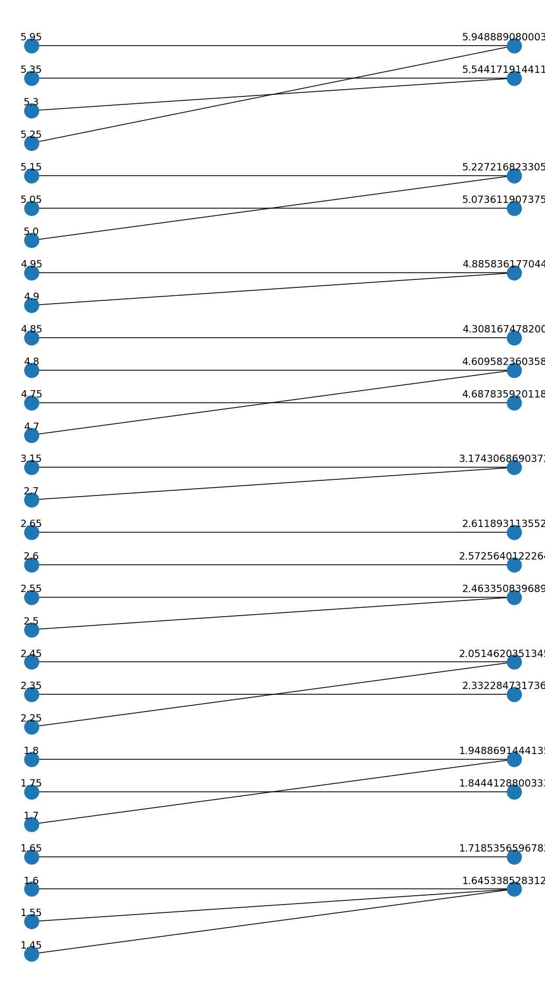

/home/shakkeel/anaconda3/envs/test_imly/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


In [217]:
# labels = dict((n, "(" + n + "," + d['_type'] + ")") for n,d in B.nodes(data=True))
labels = dict((n, d) for n,d in B.nodes(data=True))
pos = {node:[0, i] for i,node in enumerate(bin_labels['x'])}
pos.update({node:[1, i] for i,node in enumerate(bin_labels['new_bins'])})
nx.draw(B, pos, with_labels=False)
for p in pos:  # raise text positions
    pos[p][1] += 0.25
nx.draw_networkx_labels(B, pos)

plt.show()

In [188]:
B.nodes(data=True)

NodeDataView({1.45: {'bipartite': 0}, 1.55: {'bipartite': 0}, 1.6: {'bipartite': 0}, 1.65: {'bipartite': 0}, 1.7: {'bipartite': 0}, 1.75: {'bipartite': 0}, 1.8: {'bipartite': 0}, 2.25: {'bipartite': 0}, 2.35: {'bipartite': 0}, 2.45: {'bipartite': 0}, 2.5: {'bipartite': 0}, 2.55: {'bipartite': 0}, 2.6: {'bipartite': 0}, 2.65: {'bipartite': 0}, 2.7: {'bipartite': 0}, 3.15: {'bipartite': 0}, 4.7: {'bipartite': 0}, 4.75: {'bipartite': 0}, 4.8: {'bipartite': 0}, 4.85: {'bipartite': 0}, 4.9: {'bipartite': 0}, 4.95: {'bipartite': 0}, 5.0: {'bipartite': 0}, 5.05: {'bipartite': 0}, 5.15: {'bipartite': 0}, 5.25: {'bipartite': 0}, 5.3: {'bipartite': 0}, 5.35: {'bipartite': 0}, 5.95: {'bipartite': 0}, 1.645338528312387: {'bipartite': 1}, 1.7185356596782182: {'bipartite': 1}, 1.9488691444135626: {'bipartite': 1}, 1.8444128800333301: {'bipartite': 1}, 2.0514620351345583: {'bipartite': 1}, 2.332284731736415: {'bipartite': 1}, 2.463350839689115: {'bipartite': 1}, 2.5725640122264766: {'bipartite': 1}, 

In [198]:
labels_as_dict = dict((val['label'], val['x']) for key, val in bin_labels.iterrows() )

In [199]:
labels_as_dict

{'AQ': 1.45,
 'AI': 1.55,
 'AC': 1.6,
 'N': 1.65,
 'AV': 1.7,
 'B': 1.75,
 'BS': 1.8,
 'AJ': 2.25,
 'BD': 2.35,
 'O': 2.45,
 'AK': 2.5,
 'AD': 2.55,
 'D': 2.6,
 'AW': 2.65,
 'AU': 2.7,
 'F': 3.15,
 'CM': 4.7,
 'H': 4.75,
 'BJ': 4.8,
 'I': 4.85,
 'BQ': 4.9,
 'T': 4.95,
 'BG': 5.0,
 'U': 5.05,
 'AX': 5.15,
 'CD': 5.25,
 'J': 5.3,
 'AY': 5.35,
 'AF': 5.95}

In [212]:
new_bins_df = bin_labels.loc[:,('new_labels','new_bins')].drop_duplicates()

In [213]:
new_bins_df

,new_labels,new_bins
0,A,1.645339
3,B,1.718536
4,E,1.948869
5,D,1.844413
7,F,2.051462
8,G,2.332285
10,H,2.463351
12,I,2.572564
13,J,2.611893
14,K,3.174307


In [215]:
labels_as_dict.update(dict((val['new_labels'], val['new_bins']) for key, val in new_bins_df.iterrows() ))

In [216]:
labels_as_dict

{'AQ': 1.45,
 'AI': 1.55,
 'AC': 1.6,
 'N': 4.687835920118968,
 'AV': 1.7,
 'B': 1.7185356596782182,
 'BS': 1.8,
 'AJ': 2.25,
 'BD': 2.35,
 'O': 2.45,
 'AK': 2.5,
 'AD': 2.55,
 'D': 1.8444128800333301,
 'AW': 2.65,
 'AU': 2.7,
 'F': 2.0514620351345583,
 'CM': 4.7,
 'H': 2.463350839689115,
 'BJ': 4.8,
 'I': 2.5725640122264766,
 'BQ': 4.9,
 'T': 5.948889080003596,
 'BG': 5.0,
 'U': 5.05,
 'AX': 5.15,
 'CD': 5.25,
 'J': 2.611893113552761,
 'AY': 5.35,
 'AF': 5.95,
 'A': 1.645338528312387,
 'E': 1.9488691444135626,
 'G': 2.332284731736415,
 'K': 3.1743068690372707,
 'M': 4.609582360358926,
 'L': 4.308167478200794,
 'P': 4.885836177044713,
 'R': 5.227216823305954,
 'Q': 5.073611907375348,
 'S': 5.544171914411104}

In [189]:
dict((n, d) for n,d in B.nodes(data=True))

{1.45: {'bipartite': 0},
 1.55: {'bipartite': 0},
 1.6: {'bipartite': 0},
 1.65: {'bipartite': 0},
 1.7: {'bipartite': 0},
 1.75: {'bipartite': 0},
 1.8: {'bipartite': 0},
 2.25: {'bipartite': 0},
 2.35: {'bipartite': 0},
 2.45: {'bipartite': 0},
 2.5: {'bipartite': 0},
 2.55: {'bipartite': 0},
 2.6: {'bipartite': 0},
 2.65: {'bipartite': 0},
 2.7: {'bipartite': 0},
 3.15: {'bipartite': 0},
 4.7: {'bipartite': 0},
 4.75: {'bipartite': 0},
 4.8: {'bipartite': 0},
 4.85: {'bipartite': 0},
 4.9: {'bipartite': 0},
 4.95: {'bipartite': 0},
 5.0: {'bipartite': 0},
 5.05: {'bipartite': 0},
 5.15: {'bipartite': 0},
 5.25: {'bipartite': 0},
 5.3: {'bipartite': 0},
 5.35: {'bipartite': 0},
 5.95: {'bipartite': 0},
 1.645338528312387: {'bipartite': 1},
 1.7185356596782182: {'bipartite': 1},
 1.9488691444135626: {'bipartite': 1},
 1.8444128800333301: {'bipartite': 1},
 2.0514620351345583: {'bipartite': 1},
 2.332284731736415: {'bipartite': 1},
 2.463350839689115: {'bipartite': 1},
 2.5725640122264

<IPython.core.display.Javascript object>


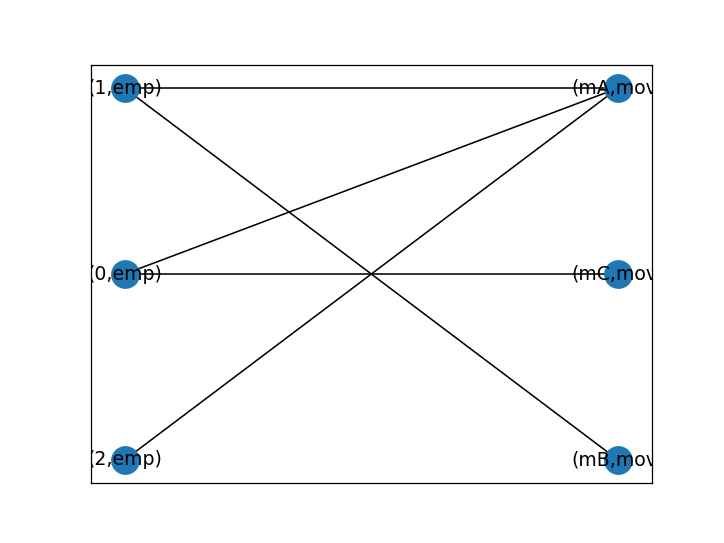

In [190]:
import networkx as nx
from networkx.algorithms import bipartite
%matplotlib notebook
import matplotlib.pyplot as plt

BG = nx.Graph()
employees = [str(i) for i in range(3)]
movies = ["mA", "mB", "mC"]
BG.add_nodes_from(employees, bipartite=0, _type='emp')
BG.add_nodes_from(movies, bipartite=1, _type='mov')
edges = [("0", "mA"), ("0", "mC"), ("1", "mA"),("1", "mB"), ("2", "mA")]
BG.add_edges_from(edges)
labels = dict((n, "(" + n + "," + d['_type'] + ")") for n,d in BG.nodes(data=True))

# Setting up pos for drawing bipartite graph. See the reference for more info
X, Y = bipartite.sets(BG)
pos = dict()
pos.update( (n, (1, i)) for i, n in enumerate(X) ) # put nodes from X at x=1
pos.update( (n, (2, i)) for i, n in enumerate(Y) ) # put nodes from Y at x=2

plt.figure()
edges = BG.edges()
nx.draw_networkx(BG, pos, edges=edges, labels=labels)

In [191]:
labels

{'0': '(0,emp)',
 '1': '(1,emp)',
 '2': '(2,emp)',
 'mA': '(mA,mov)',
 'mB': '(mB,mov)',
 'mC': '(mC,mov)'}

In [140]:
bin_labels

,label,x,freq,new_bins,new_index,new_labels
0,AQ,1.45,1,1.645339,0,A
1,AI,1.55,9,1.645339,0,A
2,AC,1.60,3,1.645339,0,A
3,N,1.65,22,1.718536,1,B
4,AV,1.70,15,1.948869,4,E
5,B,1.75,31,1.844413,3,D
6,BS,1.80,1,1.948869,4,E
7,AJ,2.25,2,2.051462,5,F
8,BD,2.35,10,2.332285,6,G
9,O,2.45,38,2.051462,5,F
